### Intended as a script which generates a .cvs report in one run

In [1]:
import tensorflow as tf;
import numpy as np;
import matplotlib.pyplot as plt;
print(tf.__version__);
import pandas as pd;

from sklearn.preprocessing import StandardScaler;
from sklearn.metrics import mean_squared_error;

2.6.0


In [2]:
pd.set_option('display.max_columns', 300);
pd.set_option('display.max_rows', 300);
tf.keras.backend.set_floatx('float64');

In [3]:
from tensorflow.python.client import device_lib

def get_available_gpus():
    local_device_protos = device_lib.list_local_devices()
    return [x.name for x in local_device_protos if x.device_type == 'GPU']

get_available_gpus()

['/device:GPU:0']

In [4]:
MONTHS = 72;
SPLIT = 60; # 2014-2018: training, 2019: testing.
# BATCH_SIZE = 19; # used in NN_v1
BATCH_SIZE = 30;
WINDOW_SIZE = 3;

TEST_LENGTH = MONTHS - SPLIT;

### Data preparation

In [5]:
multi_data = pd.read_csv('../data/zri_acs_bikeshare_merged.csv', index_col = 0);
zip_ids = multi_data.index.unique();

multi_data.drop(["City", "State", "Metro", "CountyName", "year", "month", "datetime"],\
                 axis = 1, inplace = True);

multi_data.head()

,zri,percent_white,percent_black,percent_asian,percent_hispanic,percent_native_am,percent_other_race,percent_0_17,percent_18_39,percent_40_64,percent_65+,percent_rental_units_vacant,percent_rental_units_occupied,percent_graduate_deg,percent_bachelors,percent_associates,percent_highschool,percent_less_highschool,percent_commute_public_transport,percent_commute_less_30,percent_buildings_less_10_units,percent_buildings_10_19_units,percent_buildings_20_49_units,percent_buildings_50+_units,percent_commute_30_to_59,percent_commute_60_to_89,percent_commute_90_more,percent_new_city,percent_new_unit,percent_units_owner_occupied,median_building_age,income_per_capita,poverty_rate,total_pop,percent_workforce_unemployed,percent_work_from_home,median_age,percent_female,gini_index,percent_not_us_citizen,bs_total_stations,bs_total_systems,has_bike_sharing
zip,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1013,928.0,0.728315,0.020951,0.013732,0.219830,0.0,0.004959,0.230010,0.311464,0.309663,0.148864,0.068131,0.931869,0.028046,0.056892,0.259500,0.384872,0.225671,0.023499,0.741732,0.890613,0.030177,0.034856,0.044355,0.227721,0.017344,0.013031,0.108543,0.040940,0.443651,62.0,20475.25,0.191440,22343.583333,0.104130,0.009346,36.416667,0.509533,0.420742,0.056062,0.0,0.0,0
1013,931.0,0.727052,0.021179,0.013708,0.220867,0.0,0.004917,0.229526,0.311552,0.310406,0.148516,0.067207,0.932793,0.028179,0.057377,0.259450,0.384586,0.225073,0.023365,0.740587,0.889943,0.030154,0.035083,0.044820,0.227757,0.017701,0.013401,0.108828,0.040926,0.441963,62.0,20517.50,0.192359,22296.166667,0.104147,0.009839,36.433333,0.508816,0.420483,0.056165,0.0,0.0,0
1013,934.0,0.725788,0.021408,0.013685,0.221904,0.0,0.004874,0.229041,0.311641,0.311150,0.148168,0.066283,0.933717,0.028313,0.057863,0.259400,0.384301,0.224475,0.023230,0.739441,0.889273,0.030131,0.035311,0.045285,0.227792,0.018058,0.013771,0.109112,0.040912,0.440275,62.0,20559.75,0.193277,22248.750000,0.104165,0.010332,36.450000,0.508100,0.420225,0.056267,0.0,0.0,0
1013,929.0,0.724525,0.021636,0.013661,0.222940,0.0,0.004832,0.228557,0.311729,0.311894,0.147820,0.065359,0.934641,0.028446,0.058348,0.259350,0.384016,0.223877,0.023096,0.738295,0.888603,0.030108,0.035538,0.045750,0.227828,0.018415,0.014142,0.109397,0.040897,0.438587,62.0,20602.00,0.194196,22201.333333,0.104182,0.010825,36.466667,0.507383,0.419967,0.056370,0.0,0.0,0
1013,929.0,0.723261,0.021864,0.013638,0.223977,0.0,0.004789,0.228072,0.311818,0.312638,0.147472,0.064435,0.935565,0.028579,0.058833,0.259299,0.383730,0.223279,0.022961,0.737149,0.887934,0.030086,0.035766,0.046215,0.227864,0.018772,0.014512,0.109682,0.040883,0.436898,62.0,20644.25,0.195114,22153.916667,0.104199,0.011318,36.483333,0.506666,0.419708,0.056472,0.0,0.0,0


In [6]:
FEATURES = multi_data.shape[1] - 1;

In [7]:
# for x, y in dataset_train:
#     print(np.array(x), np.array(y))

### Utility functions

In [8]:
@tf.autograph.experimental.do_not_convert
def windowed_dataset(series, window_size, batch_size, shuffle_buffer):
    dataset = tf.data.Dataset.from_tensor_slices(series); #(43,)
    dataset = dataset.window(window_size + 1, shift=1, drop_remainder=True);
    dataset = dataset.flat_map(lambda window: window.batch(window_size + 1)); #(13,43)
    dataset = dataset.shuffle(shuffle_buffer)\
                     .map(lambda window: (window[:-1, 1:], window[-1][0]));
    dataset = dataset.batch(batch_size).prefetch(1);
    return dataset;

In [9]:
def plot_series(time, series, format="-", start=0, end=None):
    plt.plot(time[start:end], series[start:end], format)
    plt.xlabel("Time Frame")
    plt.ylabel("ZRI")
    plt.grid(True)

### Neural network center

In [10]:
def NN_model(dataset, termination, test = None):
    class myCallbacks(tf.keras.callbacks.Callback):
        def on_epoch_end(self, epoch, logs={}):
            mse = logs.get("mse");
            if(mse < termination):
                print("\nGot an mse at {:.4f} in round {} and stopped training\n".format(mse, epoch));
                self.model.stop_training = True;
            
    tf.keras.backend.clear_session();
    # dataset = windowed_dataset(x_train, window_size, batch_size, shuffle_buffer_size)

    callback = myCallbacks();
    
    model = tf.keras.models.Sequential([
#         tf.keras.layers.Lambda(lambda x: tf.expand_dims(x, axis=-1),
#                           input_shape=[None]),
#       tf.keras.layers.Conv1D(filters=32, kernel_size=3,
#                           strides=1, padding="causal",
#                           activation="relu",
#                           input_shape=[None, WINDOW_SIZE, FEATURES+1]),
        tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(16, return_sequences=True, input_shape = [None, WINDOW_SIZE, FEATURES])),
        #tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(16, return_sequences=True)),
        # tf.keras.layers.SimpleRNN(8, return_sequences=True),
        #  tf.keras.layers.SimpleRNN(16, return_sequences=True),
        tf.keras.layers.Dense(8, activation="relu"),
    #   tf.keras.layers.Dense(16, activation="relu"),
        tf.keras.layers.Dense(1)
        # tf.keras.layers.Lambda(lambda x: x * 2.0)
    ]);
    
    optimizer = tf.keras.optimizers.SGD(learning_rate=3e-4, momentum=0.9)
    model.compile(loss=tf.keras.losses.Huber(),
                  optimizer="adam",
                  metrics=["mae", "mse"])

    model.build((None,WINDOW_SIZE,FEATURES))
    # model.summary()

    if not test: history = model.fit(dataset, epochs=500, callbacks = [callback], verbose = 0);
    else: history = model.fit(dataset, epochs=500, validation_data=test,\
                              callbacks=[callback], verbose = 0);
    return model;

In [11]:
def NN_forecast(model, series_transformed):
    forecast = []
    results = []
    for time in range(MONTHS - WINDOW_SIZE):
        forecast.append(model.predict(series_transformed[np.newaxis, time:time + WINDOW_SIZE, 1:]))

    results = [float(x[-1][0]) for x in forecast];
    actual = list(series_transformed[WINDOW_SIZE:, 0]);
    
    return results, actual; #, pure_forecast;

In [12]:
@tf.autograph.experimental.do_not_convert
def NN_test(ZONE, termination=0, plot=False):
    '''
    Input: ZONE
    Output: the RMSE of a NN model on the predicted train, partially predicted test, and complete predicted test.
    '''
    # Collection of data
    series_frame = multi_data[multi_data.index == ZONE];
    # series_frame.sort_values("datetime", ascending = True, inplace = True);
    
    # Standardization
    scaler = StandardScaler();
    series_transformed = scaler.fit_transform(series_frame);
    
    # Train test split
    series_train = series_transformed[:SPLIT];
    series_test = series_transformed[SPLIT-WINDOW_SIZE:];
    
    # Window the training set to make input of the NN
    dataset_train = windowed_dataset(series_train, WINDOW_SIZE, BATCH_SIZE, 60);
    # dataset_test = windowed_dataset(series_test, WINDOW_SIZE, BATCH_SIZE, 60);
    
    model = NN_model(dataset_train, termination);
    
    time_train = list(range(SPLIT));
    time_test = list(range(SPLIT, MONTHS));
    
    # Forecasting
    # results, actual, pure_forecast = NN_forecast(model, series_transformed);
    results, actual = NN_forecast(model, series_transformed);
    
    # Compute MSE
    MSE_train = mean_squared_error(actual[:-TEST_LENGTH], results[:-TEST_LENGTH])**0.5 * scaler.var_[0]**0.5;
    MSE_pure = mean_squared_error(actual[-TEST_LENGTH:], results[-TEST_LENGTH:])**0.5 * scaler.var_[0]**0.5;
    # MSE_pure = mean_squared_error(actual[-TEST_LENGTH:], pure_forecast[-TEST_LENGTH:])**0.5 * scaler.var_[0]**0.5;
    
    if plot: # If the plot option is selected, plot the graph.
        time_actual = range(WINDOW_SIZE, MONTHS);
        plt.figure(figsize=(10, 6))
        plot_series(time_actual, actual);
        plot_series(time_actual, results);
        # plot_series(time_test, pure_forecast);
        plt.show();

    return MSE_train, MSE_pure,\
        np.array(results[-TEST_LENGTH:]) * scaler.var_[0]**0.5 + scaler.mean_[0];

### The script


Got an mse at 0.0097 in round 46 and stopped training



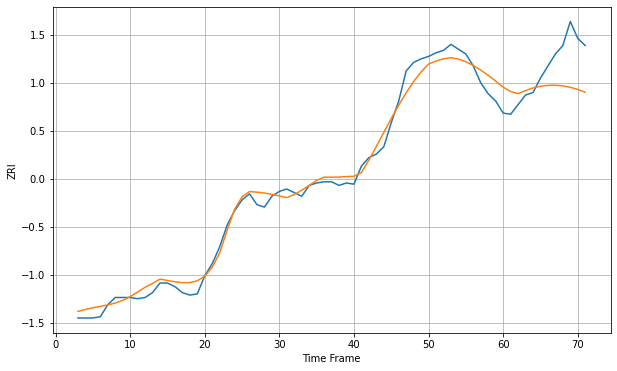

Wall time: 7.76 s
1013 7.515019546083644 27.838496869092708 [1120.54203066 1116.92613329 1115.11485363 1117.644566   1119.85875466
 1121.2366457  1121.97696363 1122.10046389 1121.57830508 1120.40867255
 1118.61961252 1116.27422965]

Got an mse at 0.0096 in round 32 and stopped training



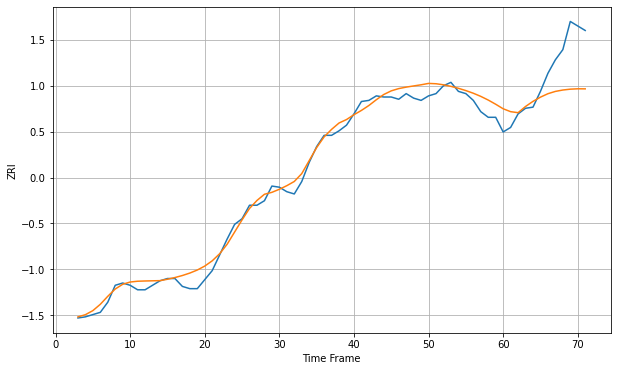

Wall time: 6.2 s
1020 7.1054285720245485 32.22528764048468 [1135.56777583 1132.99069417 1132.08661369 1137.58263852 1142.12840875
 1145.86904231 1148.91930432 1150.9617027  1152.19086538 1152.94952804
 1153.28064226 1153.22658544]

Got an mse at 0.0099 in round 95 and stopped training



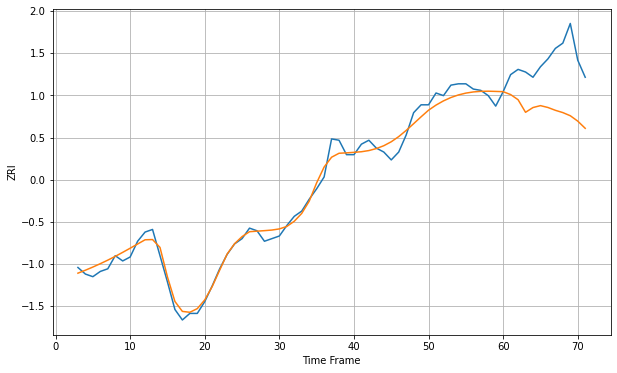

Wall time: 9.51 s
1040 6.106689545299262 38.87739471523239 [1112.01649982 1109.80385045 1105.89061437 1096.29081585 1099.918066
 1101.37224712 1099.9643506  1097.80788844 1096.06887423 1093.66707792
 1089.55659292 1084.08120369]

Got an mse at 0.0099 in round 102 and stopped training



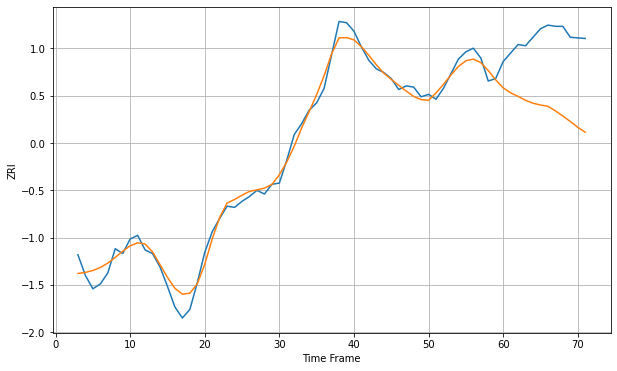

Wall time: 9.87 s
1085 7.395466081345561 59.979955512908184 [1150.42202937 1146.26603922 1143.35123103 1140.11723246 1137.7357491
 1136.2533835  1135.18384132 1131.44401874 1127.17293928 1122.7035848
 1117.93470065 1113.84964213]

Got an mse at 0.0100 in round 93 and stopped training



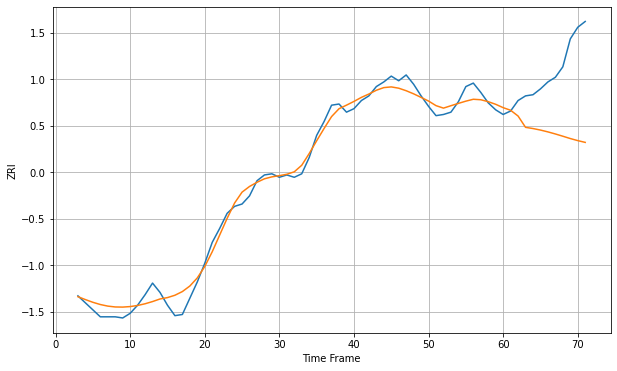

Wall time: 8.42 s
1104 7.605918385745576 56.63165088449907 [1118.88408753 1116.628067   1111.67349926 1101.95072994 1100.91654128
 1099.60584622 1098.02944803 1096.24262123 1094.31364663 1092.30818367
 1090.53665399 1089.00742814]

Got an mse at 0.0099 in round 60 and stopped training



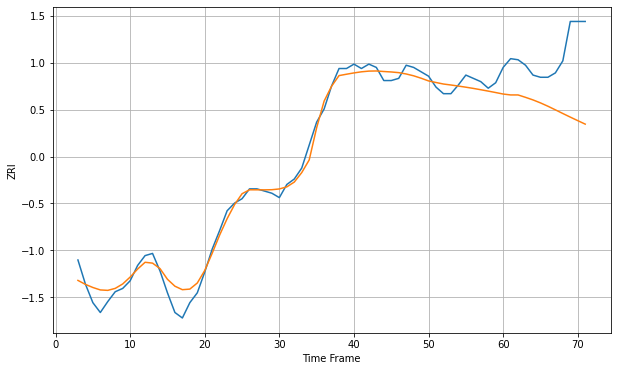

Wall time: 8.81 s
1108 8.768998471841494 52.81279087235599 [1173.67308245 1172.84907631 1172.84227825 1170.6492115  1168.30230507
 1165.58471662 1162.52854542 1159.22949025 1155.87429022 1152.58161688
 1149.35584345 1146.16582076]

Got an mse at 0.0100 in round 169 and stopped training



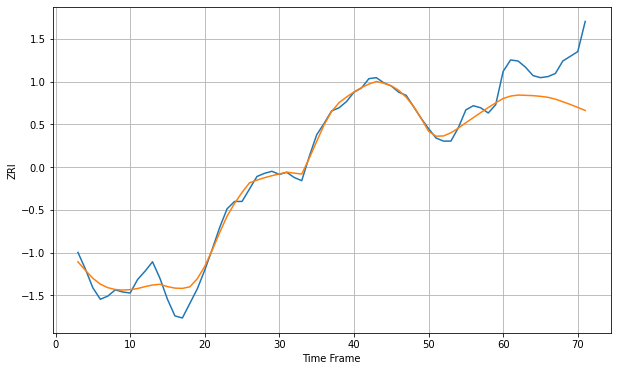

Wall time: 10.9 s
1109 8.561352199967255 40.05937319832037 [1162.95602246 1165.28086757 1166.25711654 1165.99400136 1165.68759348
 1165.04830237 1164.1193878  1162.33079965 1159.85631427 1157.20587523
 1154.39177967 1151.42163135]

Got an mse at 0.0096 in round 95 and stopped training



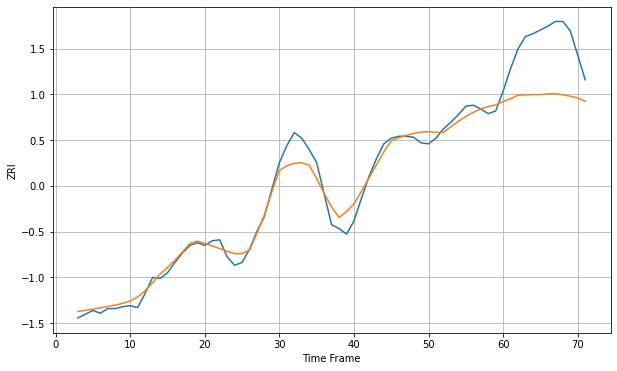

Wall time: 9.33 s
1420 10.204567353995158 58.35338373135536 [1240.91474435 1244.05390994 1247.64733744 1248.01461255 1248.30798408
 1248.31881481 1249.03190661 1249.21510546 1248.06596786 1246.59638776
 1244.67442957 1241.24854107]

Got an mse at 0.0098 in round 72 and stopped training



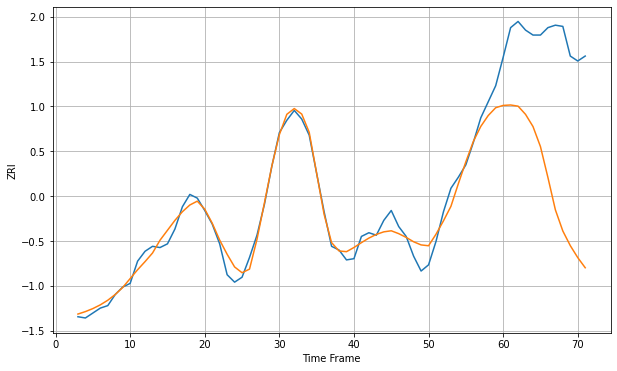

Wall time: 8.97 s
1440 7.671792030248975 119.41190902214683 [1176.04951109 1176.39605052 1175.45390097 1168.80134342 1158.9562433
 1142.71390871 1117.74898182 1091.54803112 1074.40107213 1062.54846955
 1052.86302183 1044.6590617 ]

Got an mse at 0.0099 in round 46 and stopped training



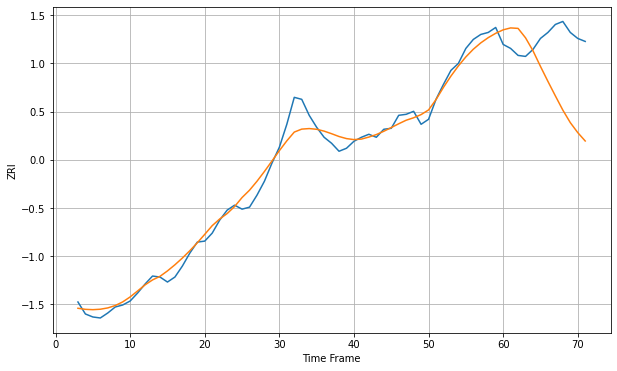

Wall time: 10.1 s
1453 9.51411592045738 61.171141788061405 [1333.61567942 1335.53708639 1335.06450682 1325.61881645 1312.64373471
 1297.01323471 1282.00116332 1267.43385095 1253.22490501 1240.68052984
 1230.67182554 1222.27919803]

Got an mse at 0.0099 in round 76 and stopped training



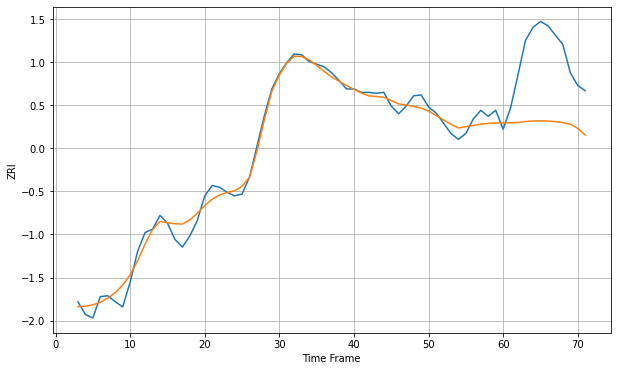

Wall time: 8.79 s
1545 9.798573933259211 80.5745332243747 [1508.22149662 1508.43998369 1508.78613475 1509.89054002 1510.52989083
 1510.73513636 1510.51033242 1509.83166477 1508.65512416 1506.93981641
 1501.77927916 1494.02579011]

Got an mse at 0.0098 in round 53 and stopped training



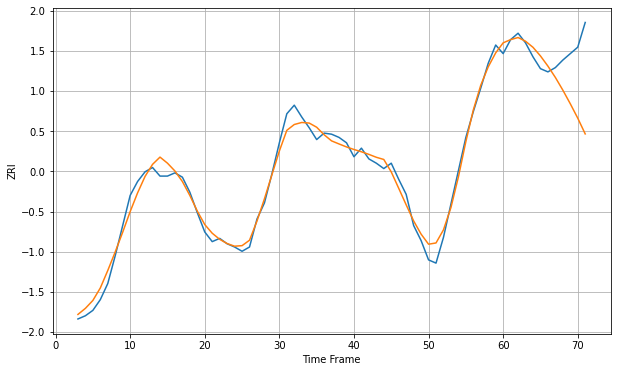

Wall time: 9.94 s
1550 7.964035652797103 39.307769741377335 [1243.03460919 1246.01382212 1247.97790915 1244.52579969 1238.86613148
 1230.84459794 1221.36655062 1210.82155928 1199.01902819 1186.32050606
 1172.93644112 1158.25145728]

Got an mse at 0.0099 in round 140 and stopped training



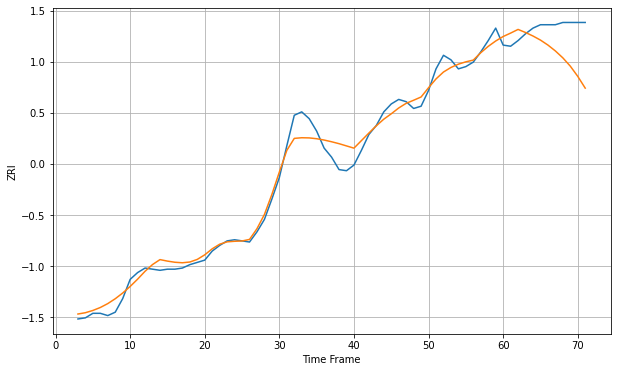

Wall time: 12.1 s
1602 8.816807497416132 28.11161690812474 [1397.57492961 1400.60554436 1403.85564894 1401.13091583 1398.02593987
 1394.43070593 1390.04361601 1384.83292958 1378.73192431 1371.4037702
 1362.38866924 1351.97787841]

Got an mse at 0.0100 in round 49 and stopped training



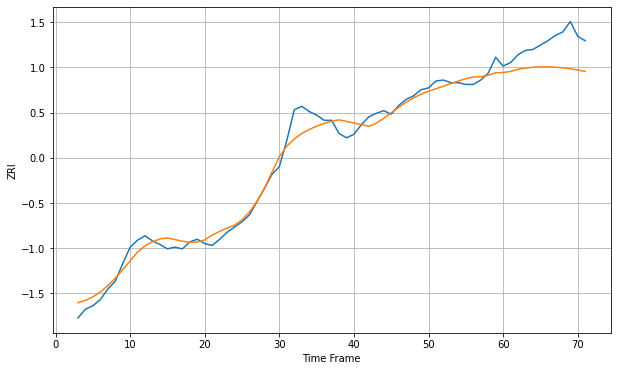

Wall time: 7.87 s
1603 10.631434634882995 30.86438969728541 [1293.62280848 1294.83974034 1297.3579955  1298.74617388 1299.6299949
 1300.06127685 1300.07875007 1299.70580151 1298.95791963 1297.85872157
 1296.4582634  1294.84497068]

Got an mse at 0.0097 in round 32 and stopped training



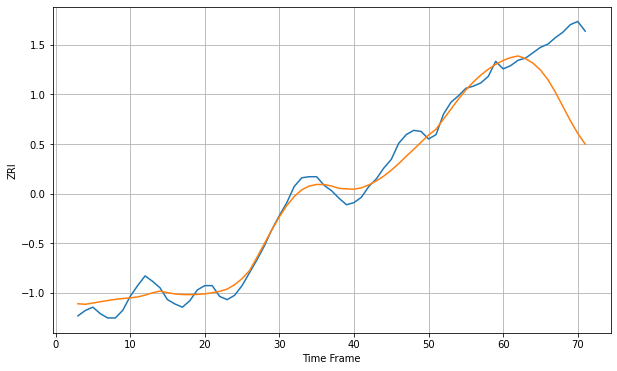

Wall time: 8.86 s
1604 9.055654044011717 56.77931899589906 [1351.84553048 1354.47294181 1356.01344482 1353.49480353 1349.34048004
 1343.00480416 1334.00451046 1322.43359926 1309.29476913 1296.13139176
 1284.18776098 1274.22335385]

Got an mse at 0.0097 in round 32 and stopped training



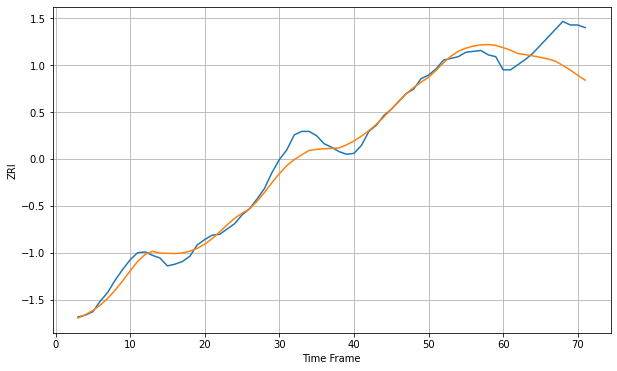

Wall time: 7.39 s
1605 9.540271199189368 35.811571719600956 [1324.21264945 1321.27468081 1317.4436194  1316.23920774 1314.81685936
 1313.17727097 1311.32960566 1308.90815969 1303.98092557 1298.78013933
 1292.83701604 1287.25007293]

Got an mse at 0.0096 in round 47 and stopped training



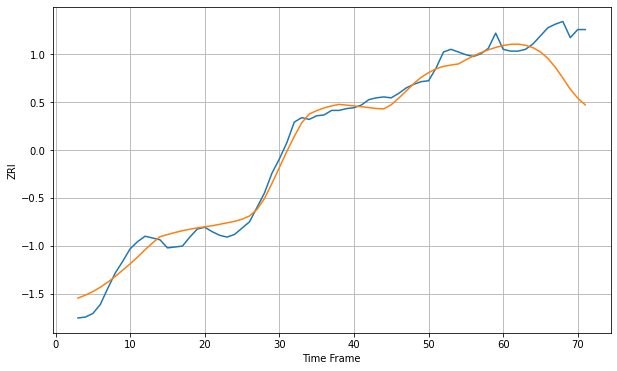

Wall time: 10.2 s
1610 11.236992706292837 44.79303977889356 [1324.27832661 1325.55880656 1325.77255995 1324.50479294 1321.81178845
 1317.13198221 1309.88322946 1299.95014706 1288.05902326 1275.64635975
 1265.60751852 1258.18780481]

Got an mse at 0.0099 in round 178 and stopped training



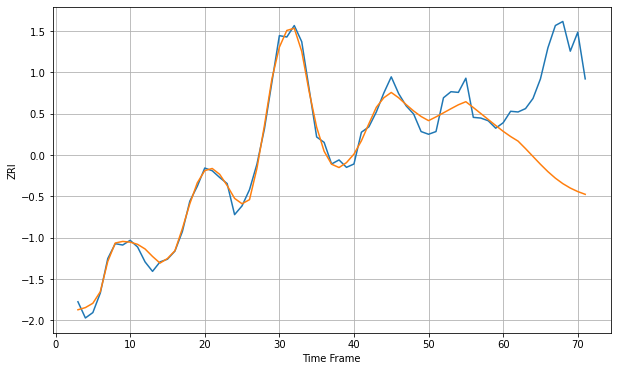

Wall time: 12.2 s
1702 12.647438430918868 157.7324027637495 [2264.3784165  2256.62961384 2249.84751746 2238.74053468 2227.11036314
 2215.53325865 2204.64553183 2194.9991895  2186.89488289 2180.34261481
 2175.15597935 2171.07463435]

Got an mse at 0.0099 in round 80 and stopped training



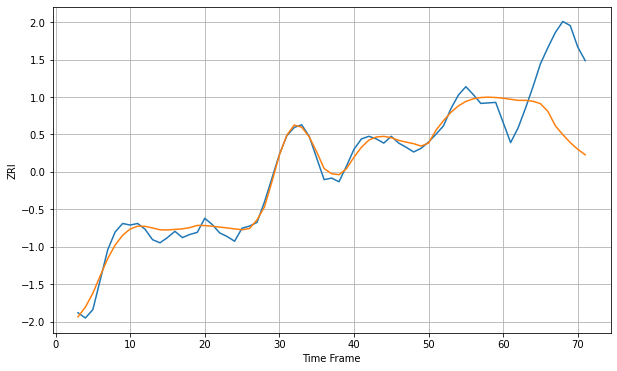

Wall time: 9.41 s
1752 13.422390656515296 139.57779380861226 [2074.93568458 2072.97471176 2070.87434471 2070.88124184 2069.19450194
 2064.57708652 2049.6655024  2022.05439009 2005.22430412 1989.88169652
 1977.14324784 1966.60085552]

Got an mse at 0.0100 in round 238 and stopped training



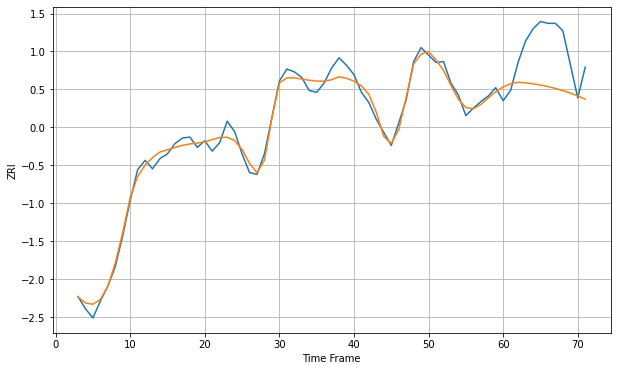

Wall time: 13 s
1757 7.568937849326436 47.051729508302316 [1456.84575122 1460.16968072 1461.80539307 1461.11742895 1460.12633632
 1458.83214259 1457.1914775  1455.18161924 1452.84082784 1450.2252477
 1447.16499191 1443.68984431]

Got an mse at 0.0099 in round 147 and stopped training



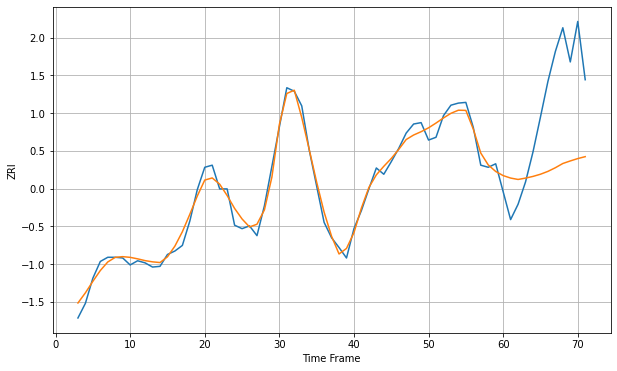

Wall time: 11.6 s
1760 11.179161334253369 117.78655642627713 [2278.08568791 2274.55118318 2272.54648954 2274.48235274 2276.90527403
 2280.03135821 2284.11612669 2289.36453764 2295.42811486 2299.08650797
 2302.47603873 2305.21437184]

Got an mse at 0.0099 in round 148 and stopped training



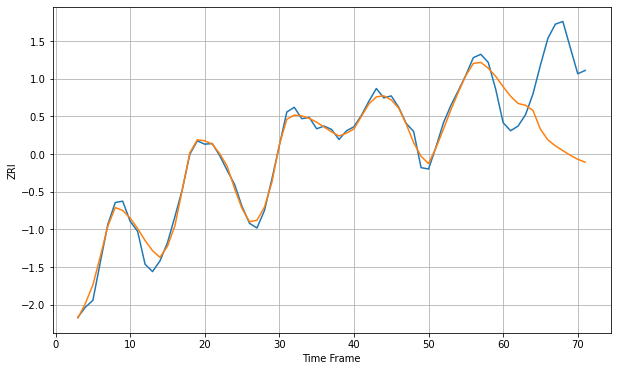

Wall time: 11.1 s
1801 10.084603731857397 119.1778591756596 [2256.65607742 2242.44666456 2231.69555605 2229.07109852 2221.23551652
 2193.22287078 2177.31705995 2168.53133473 2161.39199429 2154.47071796
 2148.50138274 2144.13252904]

Got an mse at 0.0099 in round 117 and stopped training



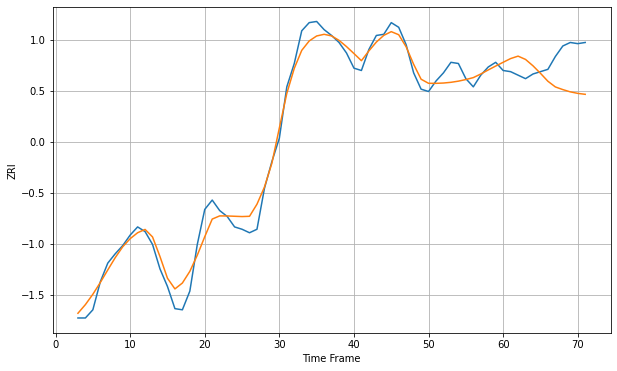

Wall time: 11.1 s
1830 9.888915185519165 26.646486876457928 [1633.0337727  1636.21210003 1638.30510528 1635.47953073 1630.00901211
 1623.59130071 1616.77828126 1611.91701969 1609.63205866 1607.69447066
 1606.40749345 1605.59675608]

Got an mse at 0.0099 in round 55 and stopped training



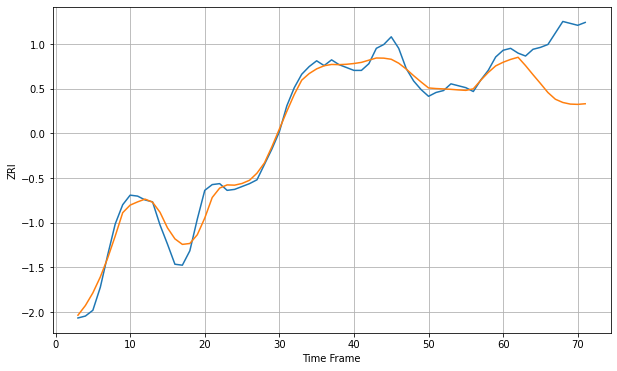

Wall time: 8.25 s
1832 10.205858134861861 56.249145909577365 [1574.51228193 1577.46420712 1579.67697662 1571.01204    1561.55064853
 1552.38131927 1542.95851012 1535.96400079 1532.56956602 1530.89365765
 1530.60004329 1531.24653169]

Got an mse at 0.0098 in round 124 and stopped training



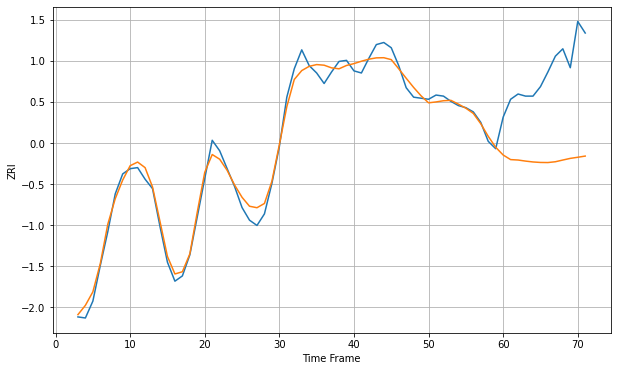

Wall time: 11.9 s
1841 7.9058304057055215 85.62289180987624 [1555.99998001 1551.62318033 1551.21859165 1550.20400275 1549.38116187
 1548.91429108 1548.82348665 1549.58319757 1551.21318077 1552.78916864
 1553.84011628 1554.97788361]

Got an mse at 0.0099 in round 196 and stopped training



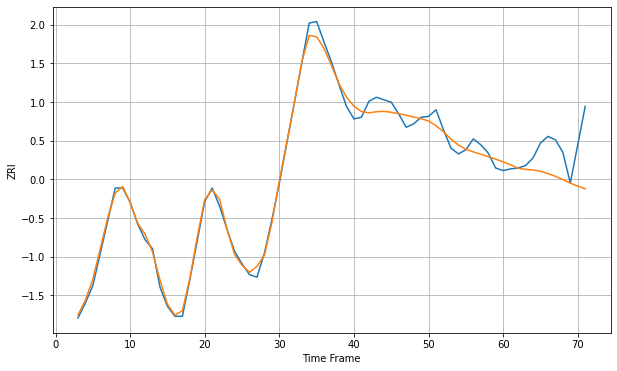

Wall time: 12.7 s
1843 8.336242088103422 39.54744901006594 [1682.51258387 1678.97430818 1674.76835946 1673.41281366 1672.78692881
 1671.25749391 1668.37251469 1665.12761444 1661.2121645  1656.96091411
 1653.26329537 1649.97523371]

Got an mse at 0.0098 in round 146 and stopped training



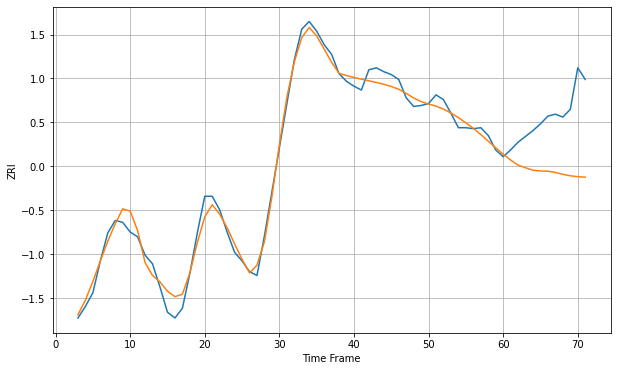

Wall time: 12 s
1844 9.5474579473587 60.468734339734006 [1669.58896368 1663.55904822 1658.19213939 1655.53944313 1652.96891763
 1652.22136591 1652.02604628 1650.6874476  1648.70198903 1647.23673593
 1646.28691075 1645.7775989 ]

Got an mse at 0.0099 in round 177 and stopped training



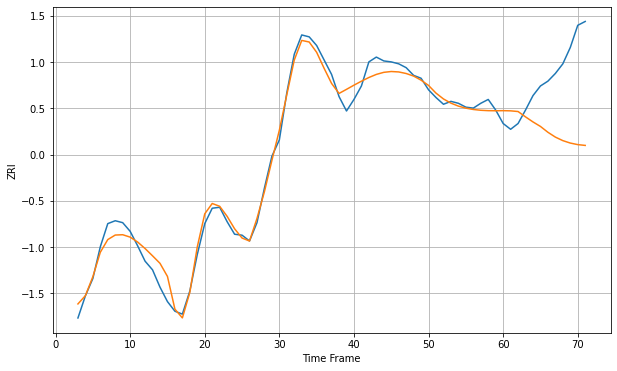

Wall time: 11.4 s
1845 9.697755038381459 69.89243190617213 [1807.34668103 1807.15505889 1806.44591979 1800.88212875 1795.64242664
 1790.96031387 1784.89725985 1779.88038845 1776.21762849 1773.68884554
 1772.08359822 1771.2439269 ]

Got an mse at 0.0100 in round 145 and stopped training



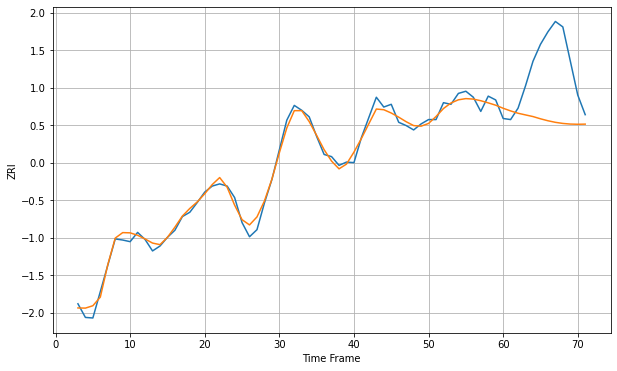

Wall time: 11.8 s
1850 10.586589545659365 108.50804495878045 [1983.76473545 1978.89141818 1974.6041392  1971.5381115  1968.52755877
 1964.42967556 1960.83955089 1957.95647266 1955.92019246 1954.76496109
 1954.40085616 1954.6343167 ]

Got an mse at 0.0099 in round 141 and stopped training



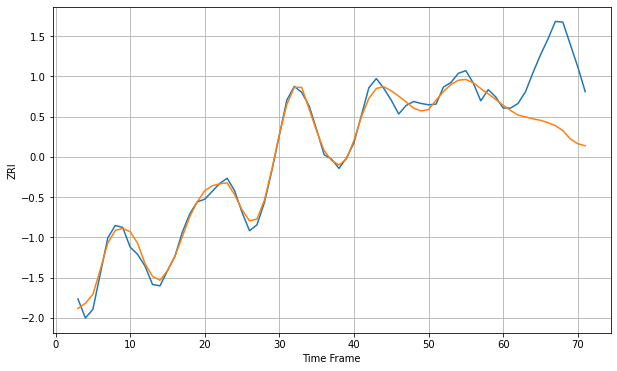

Wall time: 10.6 s
1851 10.234334166943187 102.79714813094503 [1989.34002931 1981.33099801 1974.30663052 1971.51770621 1968.56006695
 1966.38771048 1962.69662696 1958.09791748 1950.74622274 1937.91703861
 1930.71552894 1927.4407276 ]

Got an mse at 0.0098 in round 66 and stopped training



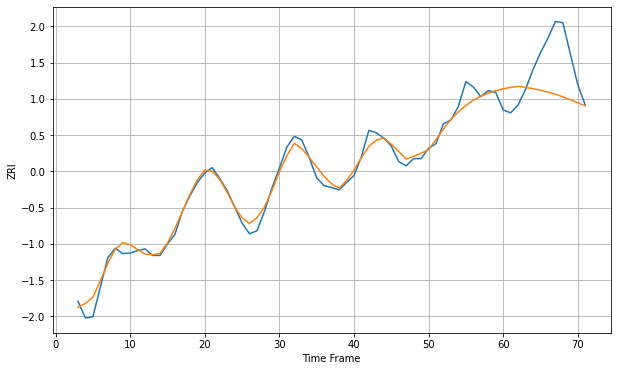

Wall time: 8.73 s
1852 12.293789657552129 66.81660138068213 [2000.01115183 2002.36096833 2004.11816605 2002.40674574 2000.2208683
 1997.56593576 1994.46570376 1990.96231645 1986.65914914 1981.8740176
 1976.78825901 1971.72427284]

Got an mse at 0.0100 in round 149 and stopped training



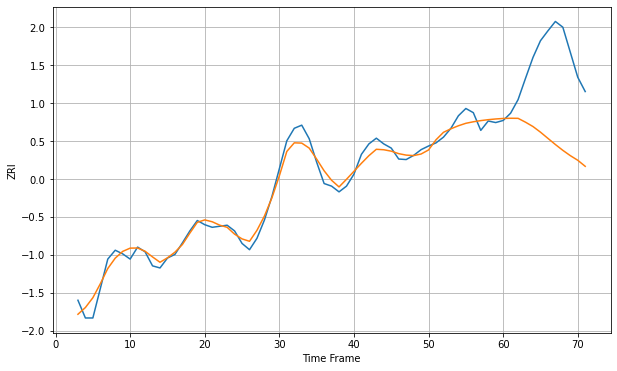

Wall time: 10.5 s
1854 14.977470289922152 157.16322372630597 [2015.86547187 2016.24458747 2016.10444163 2008.67709925 2000.34119313
 1989.58857172 1977.68540336 1965.87528532 1954.69116309 1944.54012651
 1935.64773799 1924.02546922]

Got an mse at 0.0099 in round 215 and stopped training



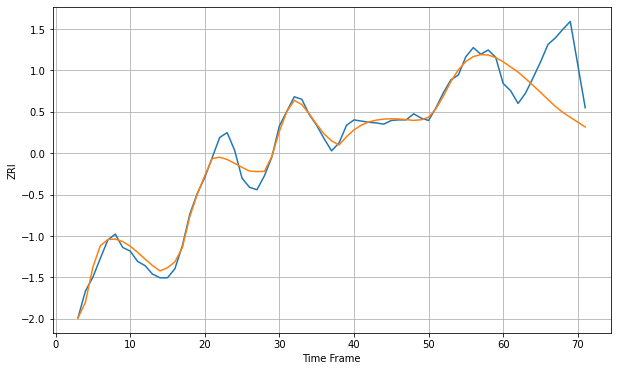

Wall time: 12.5 s
1876 13.082529916005202 83.22002593622604 [2186.661115   2178.20108029 2169.71864258 2158.9735215  2147.92486723
 2136.41830008 2124.65474357 2113.07548315 2103.38866866 2095.23339551
 2087.27490811 2079.30269693]

Got an mse at 0.0100 in round 166 and stopped training



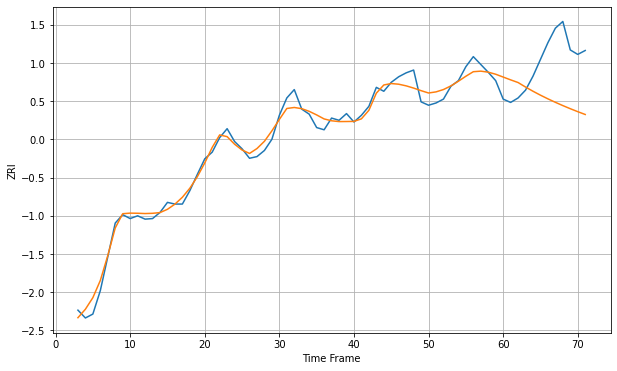

Wall time: 12 s
1880 13.929820874278688 88.4940760680046 [2216.46811429 2211.43446995 2206.65139224 2198.59722349 2191.0432108
 2184.00658921 2177.4228108  2171.21773347 2165.34006892 2159.76106707
 2154.460818   2149.41748346]

Got an mse at 0.0100 in round 123 and stopped training



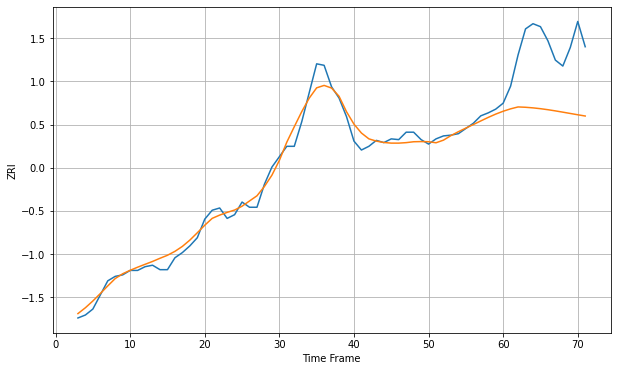

Wall time: 9.94 s
1902 10.817867813467075 87.34577959448833 [1751.18171341 1754.42088802 1756.97751785 1756.53042052 1755.73243683
 1754.6288217  1753.2564764  1751.67127809 1749.95469236 1748.19352186
 1746.45284631 1744.76635207]

Got an mse at 0.0100 in round 161 and stopped training



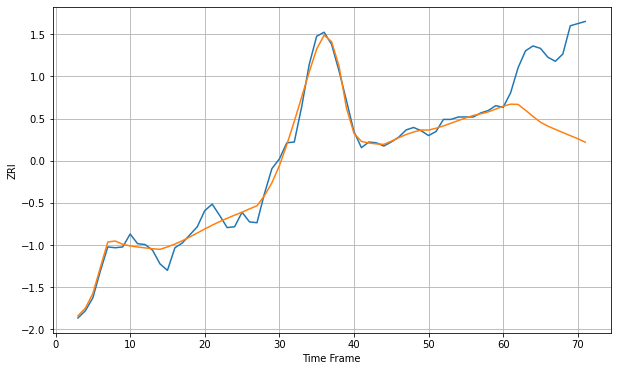

Wall time: 12.3 s
1905 10.253363383355074 95.18976688558712 [1757.31092168 1759.86545494 1759.59433307 1752.33155707 1744.72705405
 1737.53415057 1732.63783901 1728.66982003 1724.74652144 1720.89389782
 1717.13706847 1712.78655238]

Got an mse at 0.0100 in round 93 and stopped training



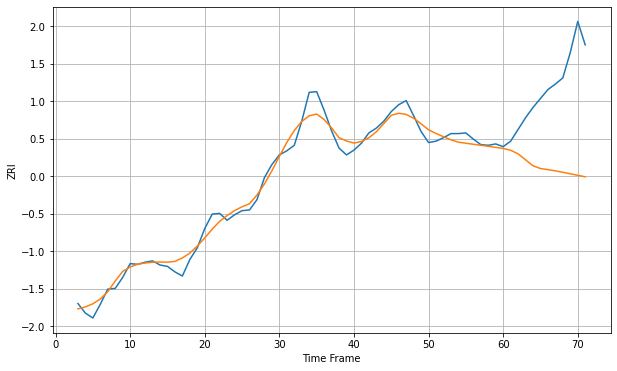

Wall time: 9.1 s
1915 12.404406336244282 125.46971918019825 [1815.40068487 1812.85830101 1807.59302068 1798.94968823 1790.2559743
 1786.24219644 1784.64812052 1782.80453048 1780.75686064 1778.57998661
 1776.36905248 1774.21420347]

Got an mse at 0.0099 in round 114 and stopped training



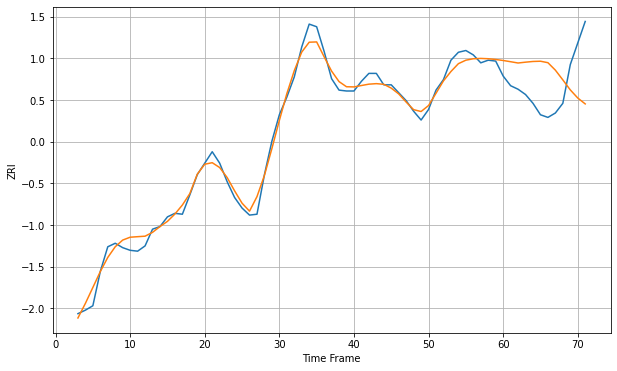

Wall time: 11.8 s
1930 8.758833180807512 49.750176258547704 [1784.66720903 1783.25989647 1781.80641983 1782.75380138 1783.54708308
 1783.82926796 1782.16311034 1773.67532591 1762.6306556  1751.24289578
 1742.04434887 1735.3243477 ]

Got an mse at 0.0099 in round 105 and stopped training



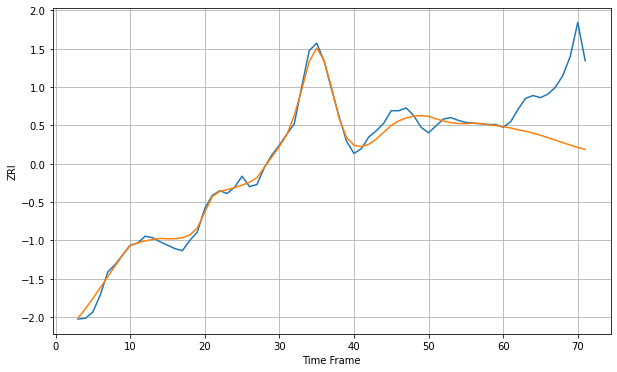

Wall time: 10.1 s
1960 9.324244326095732 88.71603551864483 [1794.92862969 1792.97311576 1790.38421153 1788.32090817 1785.61861633
 1782.44209635 1778.96764152 1775.35758864 1771.74094049 1768.19492239
 1764.7412806  1761.93931949]

Got an mse at 0.0100 in round 179 and stopped training



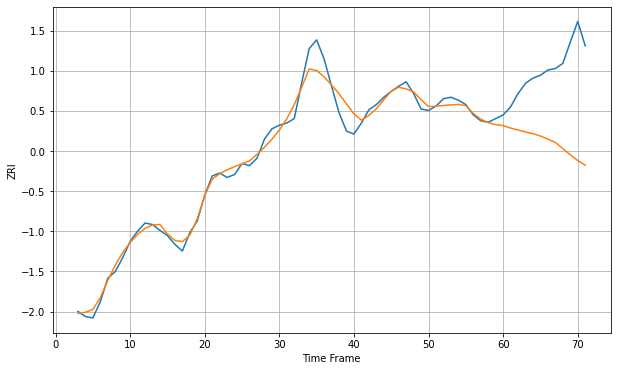

Wall time: 12.6 s
1970 12.122977330488036 107.37107081611389 [1822.47549017 1819.05654917 1816.54152376 1813.7516814  1811.48081138
 1808.26298803 1804.17047974 1799.44896782 1791.32340365 1782.62734948
 1774.97632272 1768.63728423]

Got an mse at 0.0099 in round 139 and stopped training



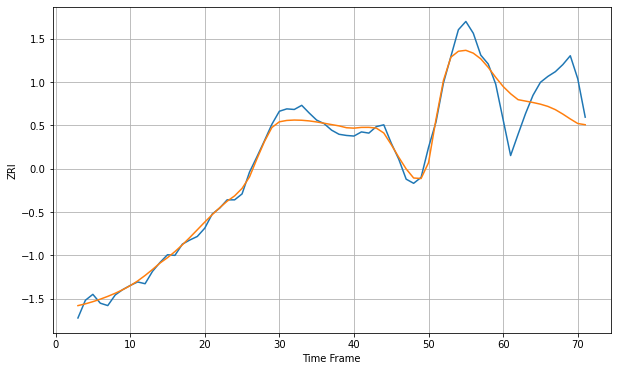

Wall time: 11.7 s
2026 13.708594963034837 64.95568993021016 [2254.89569195 2242.60613308 2232.59777293 2230.19850761 2227.77752398
 2224.97298145 2221.18971439 2215.68512743 2208.20988425 2199.93722088
 2192.24315917 2190.18950029]

Got an mse at 0.0098 in round 66 and stopped training



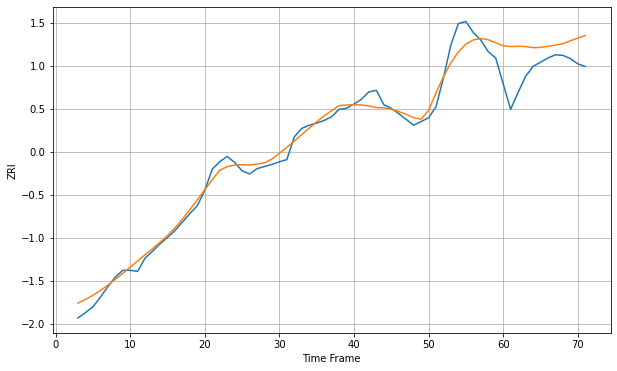

Wall time: 8.66 s
2062 16.942699922301458 57.89577102538025 [2209.1020895  2207.64496692 2208.05529301 2207.60510708 2205.56165242
 2205.99552716 2208.19189344 2210.25361223 2212.99044713 2218.44833573
 2223.50367956 2228.3760313 ]

Got an mse at 0.0099 in round 73 and stopped training



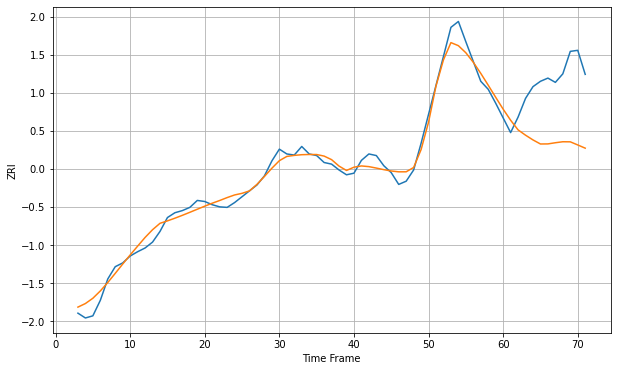

Wall time: 9.53 s
2072 14.959124110997621 112.94169781616377 [1946.84393001 1926.14889258 1908.0646121  1898.14908793 1889.25428207
 1881.66329434 1881.81691481 1884.00726684 1885.84934111 1885.70231639
 1879.86233386 1873.83962347]

Got an mse at 0.0099 in round 144 and stopped training



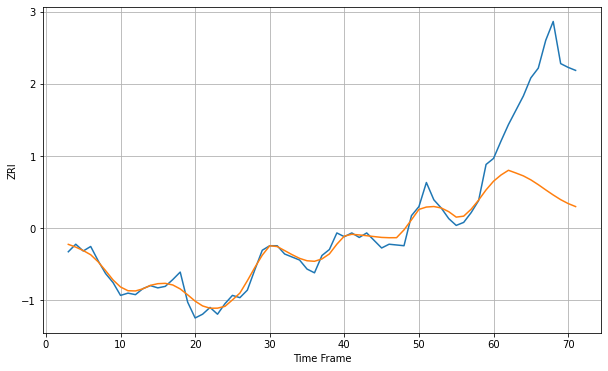

Wall time: 12 s
2111 10.476765844319223 146.63864729475756 [2823.69970667 2831.95560009 2838.24594436 2834.63049409 2830.80217863
 2825.54588382 2819.14089217 2812.19000619 2805.46247069 2799.22945993
 2794.05346597 2790.0405059 ]

Got an mse at 0.0100 in round 112 and stopped training



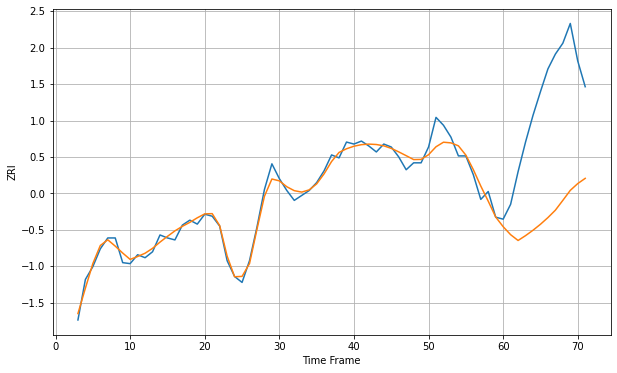

Wall time: 10.8 s
2113 7.478271049287141 119.59594611417859 [2586.39659719 2578.29984784 2572.43801086 2577.32249085 2582.77155541
 2588.83218348 2595.58410505 2603.08552704 2613.0051199  2623.14398148
 2630.00591198 2635.27980544]

Got an mse at 0.0097 in round 210 and stopped training



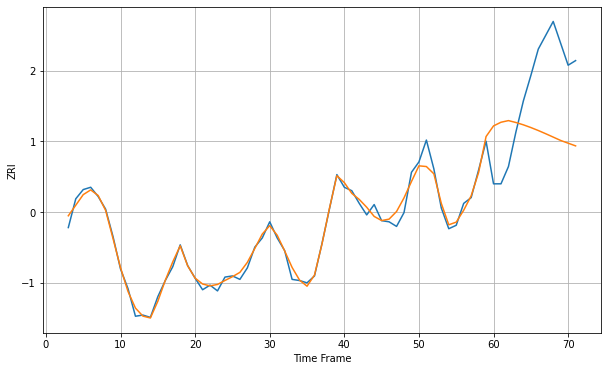

Wall time: 12.8 s
2114 5.570850002328058 63.960917072379765 [2808.29410146 2811.47387517 2812.89756681 2811.24913198 2809.23032574
 2806.88946823 2804.2860046  2801.49149952 2798.58273349 2795.64994349
 2793.29923102 2790.95470875]

Got an mse at 0.0100 in round 143 and stopped training



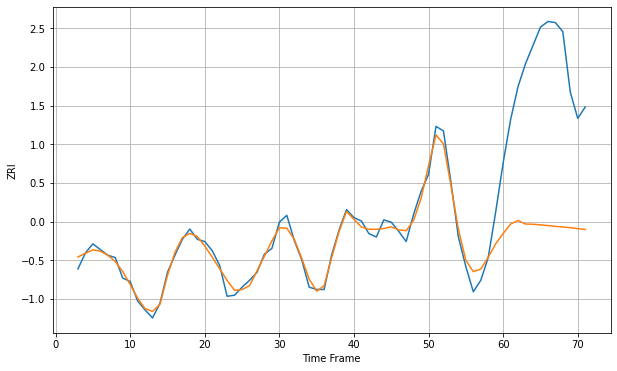

Wall time: 11.2 s
2115 6.84924555937151 138.05746458009483 [2891.02234091 2899.39081986 2902.45527909 2899.3736619  2899.17091783
 2898.66558068 2898.01997716 2897.35511774 2896.76101517 2896.20278179
 2895.36815478 2894.61725062]

Got an mse at 0.0099 in round 124 and stopped training



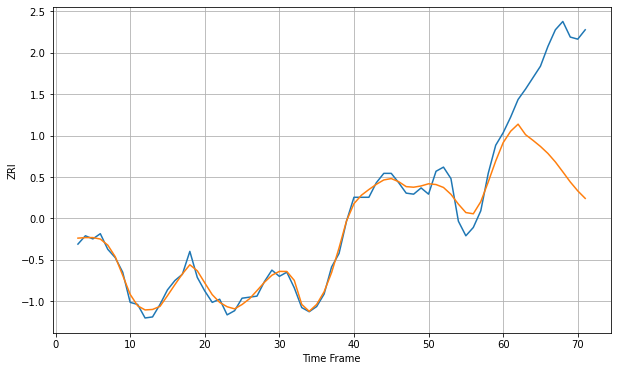

Wall time: 9.98 s
2116 7.713107401575369 102.82437454797493 [2812.50558893 2823.45268221 2830.28191552 2820.20395783 2814.72995307
 2808.88169803 2802.15177371 2793.96890773 2784.43463985 2774.71745615
 2766.17209233 2758.94755982]

Got an mse at 0.0100 in round 167 and stopped training



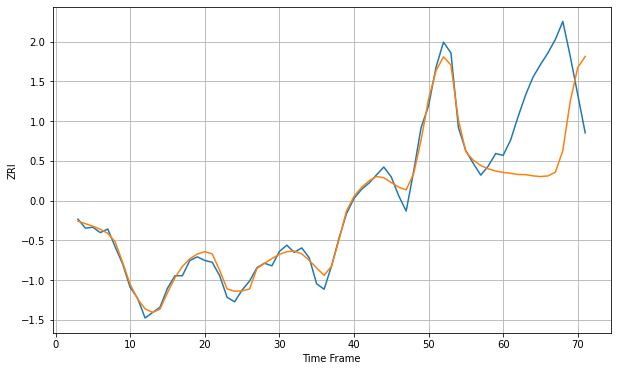

Wall time: 12.7 s
2118 8.154593605040292 97.08114979141054 [2933.97304364 2933.05165095 2931.66264037 2931.56902547 2930.14548486
 2929.4085613  2930.09657331 2934.25606479 2958.2924436  3013.48750965
 3050.78497868 3063.0180507 ]

Got an mse at 0.0099 in round 160 and stopped training



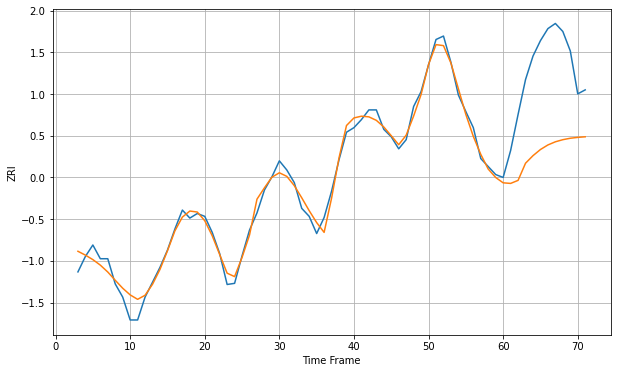

Wall time: 10.8 s
2119 14.64118431758723 147.1860916508366 [2773.61627264 2772.57079827 2777.88803903 2807.84469906 2821.04246258
 2831.79883872 2839.76827184 2845.27789853 2848.96494571 2851.48796099
 2852.98133117 2854.03194003]

Got an mse at 0.0099 in round 142 and stopped training



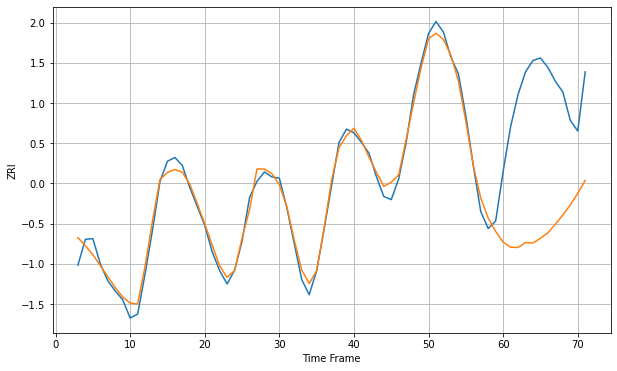

Wall time: 11.4 s
2120 13.296693336494064 216.87877056554208 [3068.36963904 3060.45138623 3059.98138548 3067.7689074  3067.14545774
 3074.62471948 3083.27077886 3097.00457433 3111.50442749 3127.53443043
 3145.98787309 3166.50925301]

Got an mse at 0.0100 in round 201 and stopped training



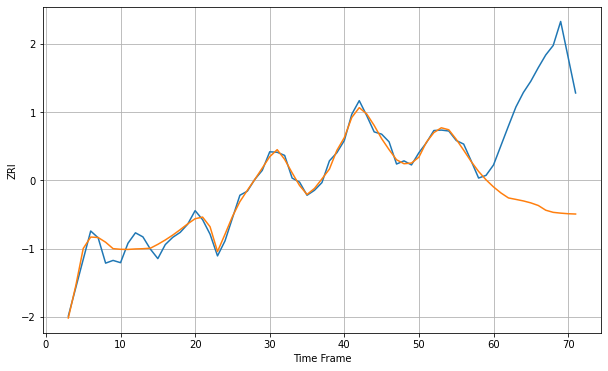

Wall time: 12.8 s
2121 14.236883875573234 277.9408931572958 [2363.3804144  2350.02568016 2339.06659791 2335.8214046  2332.4486315
 2328.14121092 2322.36295484 2311.95037014 2307.21409248 2305.47581476
 2304.16444344 2303.5176897 ]

Got an mse at 0.0099 in round 136 and stopped training



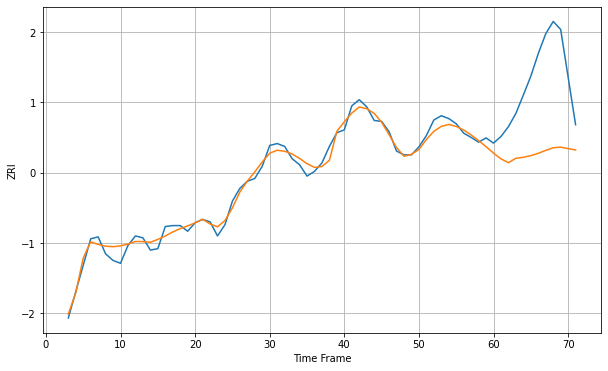

Wall time: 11 s
2122 14.016968099905508 165.7132039041449 [2386.75352433 2374.50093632 2366.49423775 2375.7557518  2377.8915084
 2381.36264475 2386.33050258 2392.54206904 2398.09731995 2399.36175487
 2396.29639162 2393.49747623]

Got an mse at 0.0100 in round 158 and stopped training



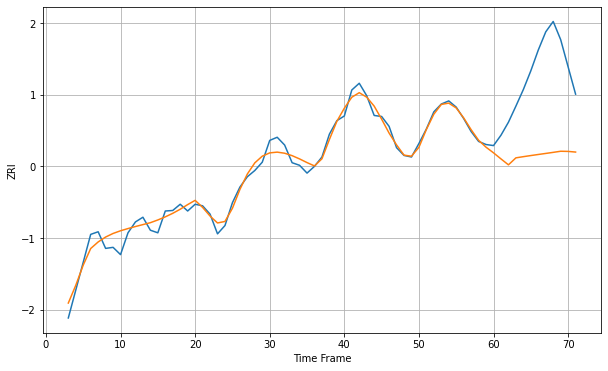

Wall time: 11.4 s
2124 14.50455839653505 159.75539419958582 [2293.00757819 2281.29658526 2269.91359211 2283.3650666  2285.63918425
 2287.78179165 2289.83897595 2291.86559508 2293.92250989 2296.07316427
 2295.75786682 2294.50625843]

Got an mse at 0.0098 in round 129 and stopped training



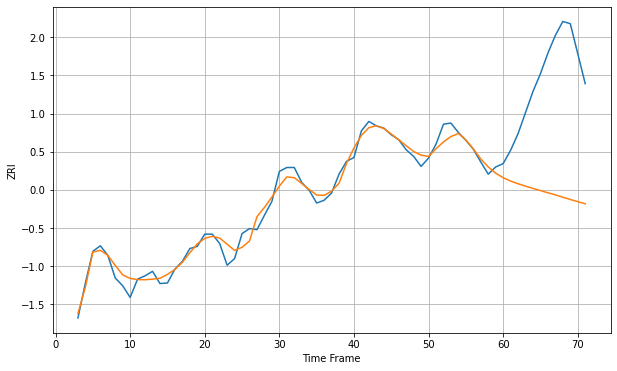

Wall time: 12.3 s
2125 14.281909094141783 217.630409848767 [2478.57091534 2472.51269599 2467.66540951 2463.39319743 2459.31799667
 2455.3590562  2451.48626022 2447.67891704 2443.50871638 2439.43762588
 2435.4931779  2431.70106134]

Got an mse at 0.0100 in round 98 and stopped training



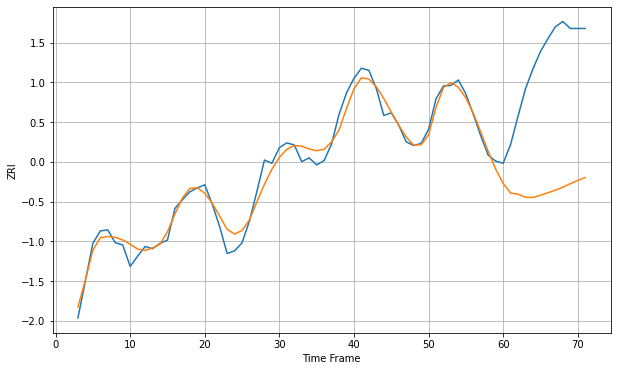

Wall time: 10 s
2126 17.545626297836492 243.44124685867675 [2249.54334809 2231.4965779  2229.39113379 2223.77731991 2223.4466825
 2227.43799894 2232.20785164 2236.8389121  2242.57650027 2249.01141275
 2255.02967102 2260.46932117]

Got an mse at 0.0099 in round 183 and stopped training



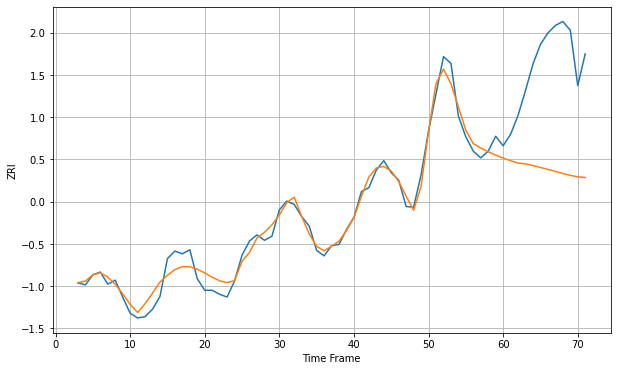

Wall time: 12 s
2127 14.102867565389612 160.87735068993368 [2842.81862344 2838.84760788 2835.18771983 2834.20129289 2831.61478894
 2828.87035719 2825.97291134 2822.95805589 2819.9325368  2817.12987807
 2814.94826053 2813.9050401 ]

Got an mse at 0.0099 in round 83 and stopped training



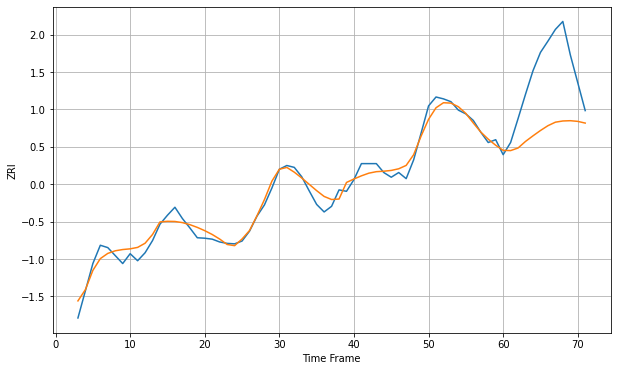

Wall time: 10.9 s
2128 16.247752190585363 130.7638665761588 [2469.28169644 2468.75406015 2474.32046627 2488.33660994 2500.23360466
 2511.5667549  2521.81490814 2529.31030788 2531.89059886 2532.4867589
 2531.04246029 2527.40644505]

Got an mse at 0.0100 in round 228 and stopped training



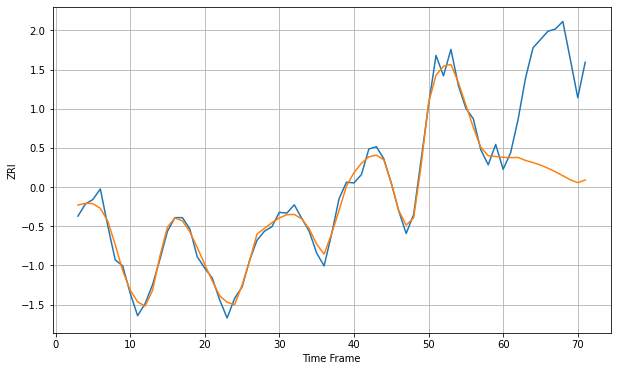

Wall time: 12.7 s
2129 10.508812842560122 141.03146671101305 [2792.00815554 2791.48036863 2791.75361236 2787.76388414 2784.96456746
 2781.65481199 2777.54940393 2772.75707332 2767.53763868 2762.21905071
 2758.37542022 2761.85680688]

Got an mse at 0.0100 in round 220 and stopped training



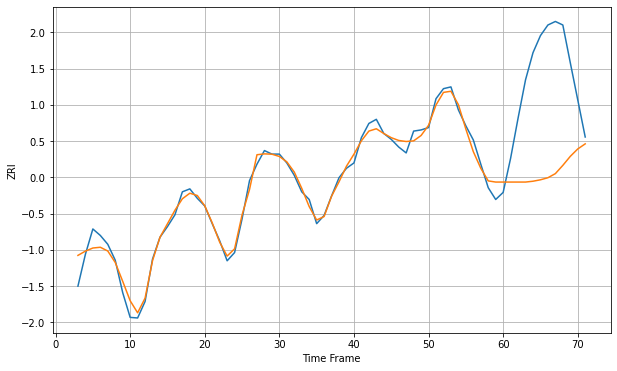

Wall time: 12.5 s
2130 13.412480549199755 176.51223525086837 [2638.57085994 2638.57085994 2638.57085994 2638.57085994 2639.9789079
 2642.40735214 2645.91162785 2652.88456402 2666.89007635 2682.17291631
 2694.72752934 2703.37118578]

Got an mse at 0.0100 in round 111 and stopped training



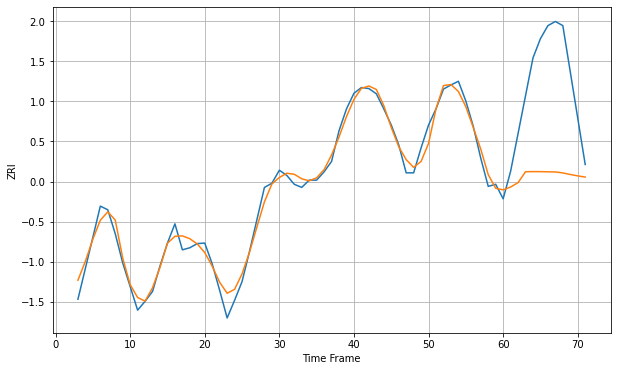

Wall time: 11.5 s
2131 16.567036682916417 191.3272915678919 [2384.31680812 2389.75909426 2398.20308018 2419.13030413 2419.38151259
 2419.28407948 2419.00247563 2418.70912088 2416.86239752 2413.79640665
 2411.14648976 2408.86797885]

Got an mse at 0.0100 in round 174 and stopped training



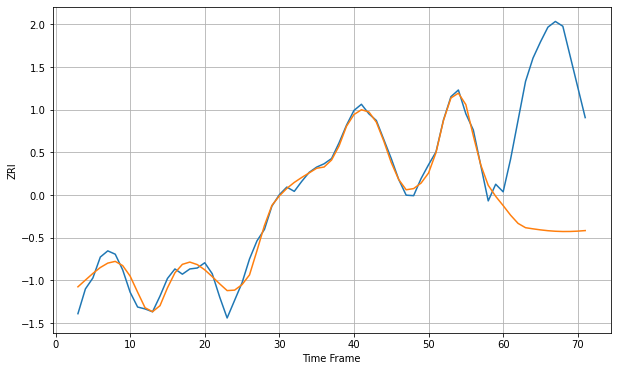

Wall time: 12 s
2132 18.29667930626601 327.46084887433165 [2344.18243598 2323.90724048 2306.71666144 2297.68515522 2295.28592311
 2293.11871612 2291.38010224 2290.20888926 2289.67143359 2289.76672638
 2290.44442907 2291.6259735 ]

Got an mse at 0.0100 in round 170 and stopped training



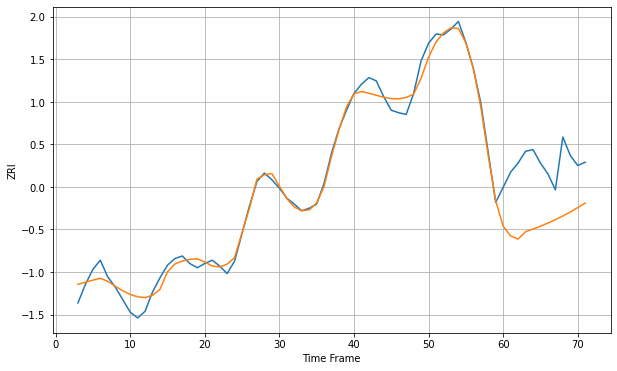

Wall time: 11.8 s
2134 10.225698374524077 72.52125978576439 [2555.56735759 2543.97633258 2540.27482258 2548.97002416 2552.16122513
 2555.57541447 2559.28721473 2563.34648168 2567.77799023 2572.5844401
 2577.75382006 2583.26966243]

Got an mse at 0.0100 in round 126 and stopped training



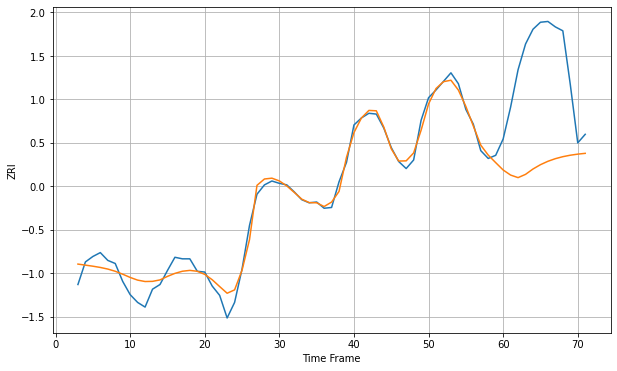

Wall time: 9.7 s
2135 11.969777236800697 134.90960308951335 [2708.15726964 2701.62408302 2698.34240125 2702.52741113 2709.42084331
 2714.96890505 2719.33710558 2722.70674168 2725.25392443 2727.14403047
 2728.52850742 2729.5423246 ]

Got an mse at 0.0099 in round 119 and stopped training



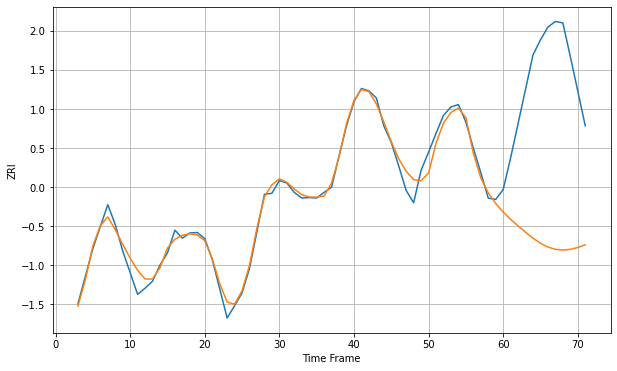

Wall time: 11.3 s
2136 16.771964362652778 355.39892918949243 [2320.40360399 2304.91408321 2291.09761278 2277.69116453 2265.0037809
 2254.22076609 2246.21260265 2241.37652958 2239.82362353 2241.3141604
 2245.29129075 2251.0259857 ]

Got an mse at 0.0098 in round 86 and stopped training



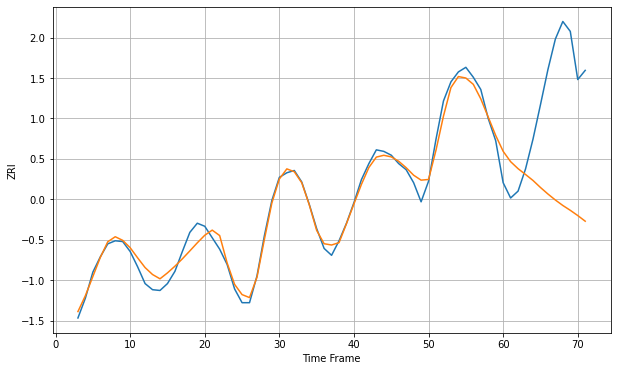

Wall time: 9.36 s
2138 10.509947198596508 151.04919365493342 [2562.10462592 2548.53852828 2539.35469698 2531.79083752 2523.93293351
 2514.76158207 2506.2312106  2498.35811209 2491.20417635 2484.87141357
 2478.03503772 2470.63157132]

Got an mse at 0.0098 in round 121 and stopped training



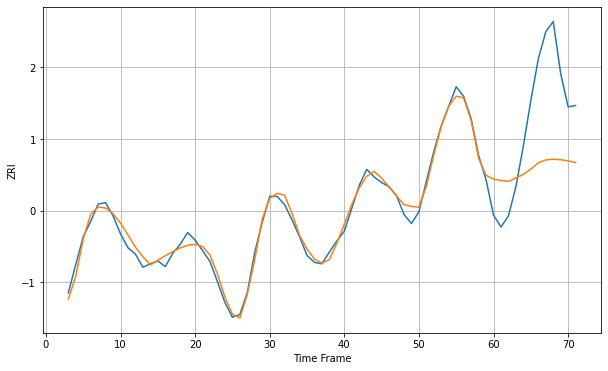

Wall time: 10.9 s
2139 9.047894540153147 110.00595119954461 [2634.05267569 2631.92781251 2630.65626399 2635.77097594 2640.7352264
 2648.46170413 2657.31808769 2661.603478   2662.60638181 2661.90690105
 2660.17562845 2657.76272844]

Got an mse at 0.0098 in round 69 and stopped training



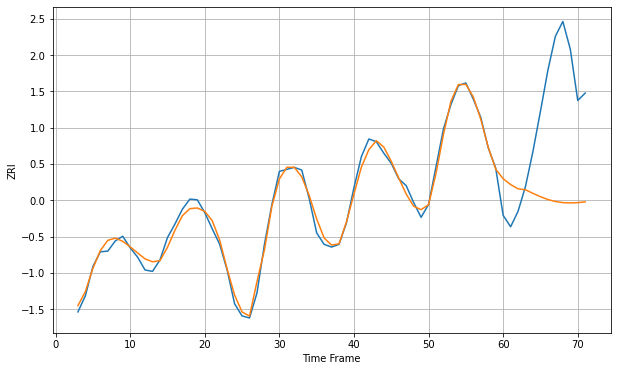

Wall time: 9.59 s
2140 8.837370102823947 157.3197773594738 [2566.22149984 2557.56649112 2551.22674655 2549.78513903 2544.49108044
 2539.5206181  2535.38318841 2532.44326604 2530.80418575 2530.33290405
 2530.78148859 2531.90790637]

Got an mse at 0.0099 in round 110 and stopped training



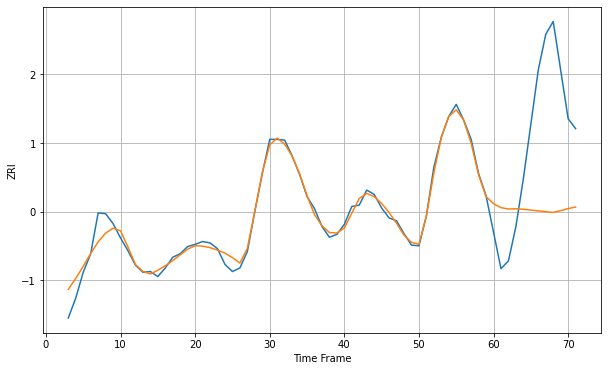

Wall time: 9.6 s
2141 10.799168258381258 149.87136583098243 [2552.96142397 2547.42033623 2545.52569105 2545.82326511 2545.14029779
 2543.97642127 2542.90340304 2541.74484046 2540.7730927  2543.16837573
 2546.11464275 2548.24090841]

Got an mse at 0.0098 in round 119 and stopped training



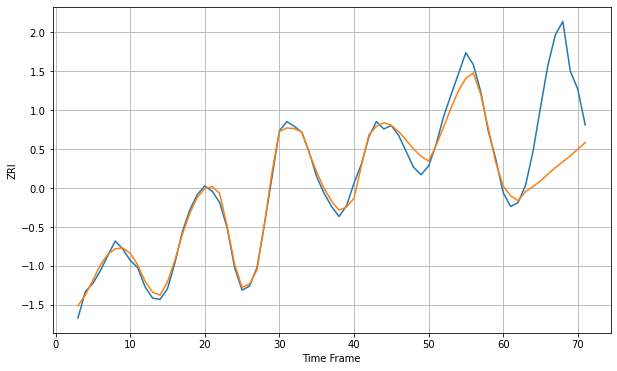

Wall time: 11.7 s
2143 11.457964350725241 112.722483806749 [2434.13819849 2419.14116768 2411.77797637 2425.58067988 2432.88546038
 2441.60859402 2451.77122458 2461.87324499 2470.3028934  2479.53101106
 2489.32962138 2499.50117108]

Got an mse at 0.0099 in round 124 and stopped training



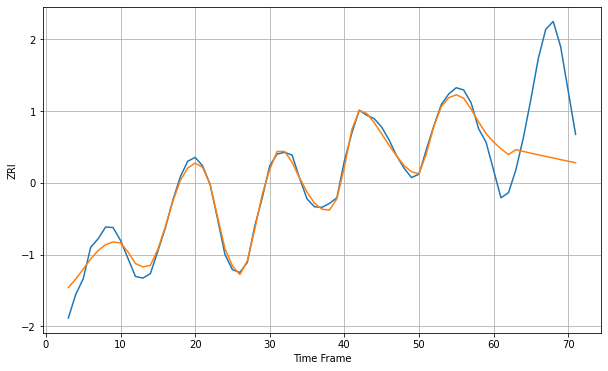

Wall time: 10.3 s
2144 13.584502909394974 136.68847567219427 [2595.38004936 2583.30325583 2572.917106   2581.77970304 2578.59558771
 2575.49563624 2572.51675031 2569.67723653 2566.95058462 2564.01371105
 2561.17974582 2558.42654558]

Got an mse at 0.0100 in round 187 and stopped training



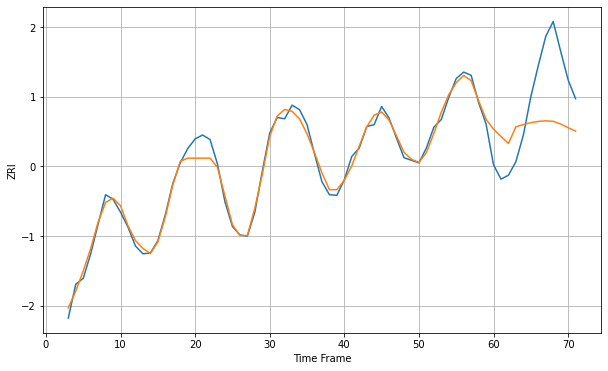

Wall time: 12.1 s
2145 10.646403670369658 83.1674648167472 [2394.84298658 2383.84265618 2373.03338847 2398.58190263 2402.1236072
 2404.99775199 2407.00613949 2407.85181766 2407.10978964 2402.88903244
 2397.33297196 2391.87931022]

Got an mse at 0.0100 in round 141 and stopped training



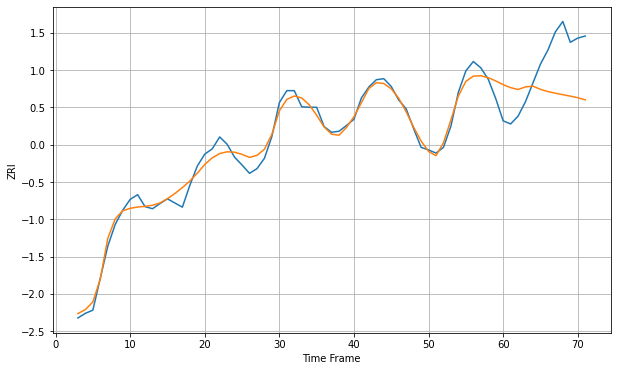

Wall time: 11.4 s
2148 14.858740987017535 88.73512779902522 [2265.55374976 2259.80391173 2256.22573727 2261.18556032 2262.62348346
 2256.49987341 2252.25010223 2249.09018587 2246.19785528 2243.48305613
 2240.43282438 2236.37891439]

Got an mse at 0.0099 in round 94 and stopped training



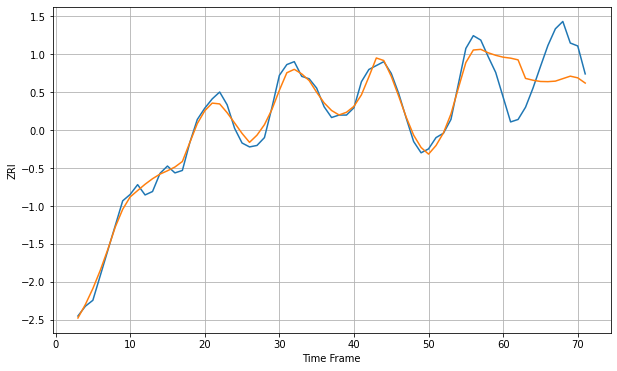

Wall time: 8.99 s
2149 15.101234338660827 82.99075360583167 [2333.12047561 2331.15112568 2327.64767898 2289.79884979 2286.07742709
 2283.54589268 2283.18777554 2284.23955332 2289.32364841 2294.39677156
 2290.97702292 2280.3084703 ]

Got an mse at 0.0100 in round 180 and stopped training



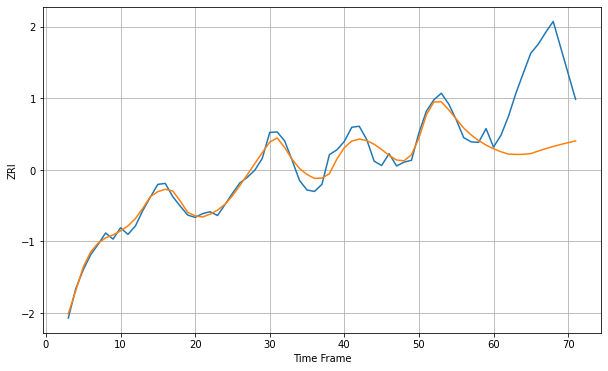

Wall time: 12.1 s
2150 16.14955310726406 171.51148289378037 [2375.35327747 2369.0705633  2364.10305914 2363.38265267 2363.59729115
 2365.24105543 2370.57251234 2375.63222002 2380.25558594 2384.45988208
 2388.3065882  2391.87583451]

Got an mse at 0.0100 in round 142 and stopped training



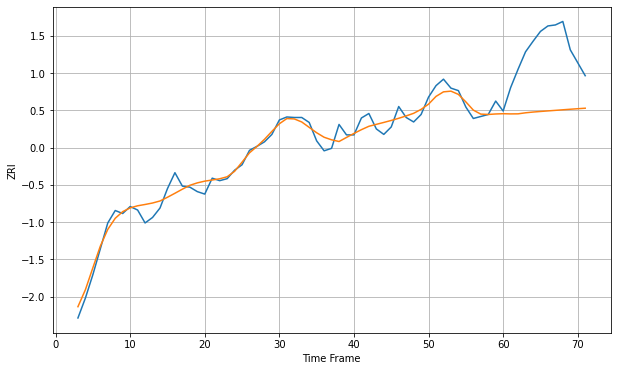

Wall time: 10.6 s
2151 16.462667587171758 125.56585610361549 [2355.59864064 2355.18786493 2355.33009638 2357.41565365 2358.89816924
 2360.09756887 2361.21526538 2362.33294511 2363.45725307 2364.56159746
 2365.6179996  2366.61971401]

Got an mse at 0.0099 in round 82 and stopped training



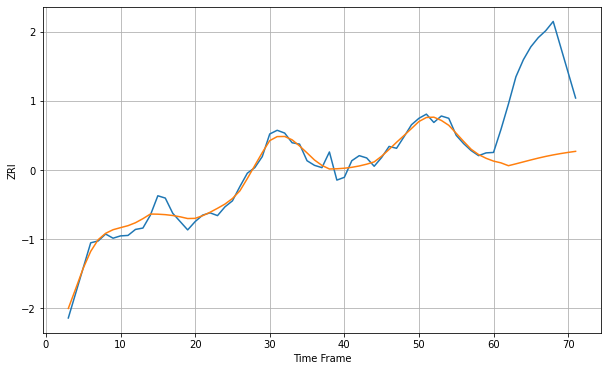

Wall time: 9.85 s
2152 14.653829083250093 202.3906502589037 [2424.19350816 2420.36344645 2414.21664844 2418.28318394 2422.47020039
 2426.68957715 2430.71041523 2434.38058991 2437.64356236 2440.51819128
 2443.06289811 2445.34415732]

Got an mse at 0.0098 in round 144 and stopped training



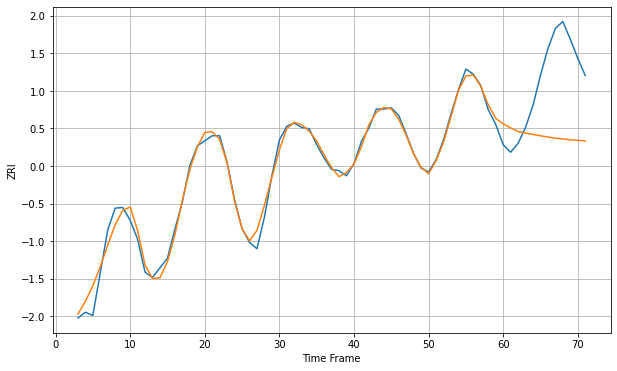

Wall time: 11 s
2155 11.434151138895487 111.77568514588319 [2379.82561993 2373.39494732 2367.66432349 2365.18365441 2362.98175741
 2360.98753934 2358.97302025 2357.28897456 2355.89718493 2354.74292582
 2353.76048414 2352.87863761]

Got an mse at 0.0100 in round 92 and stopped training



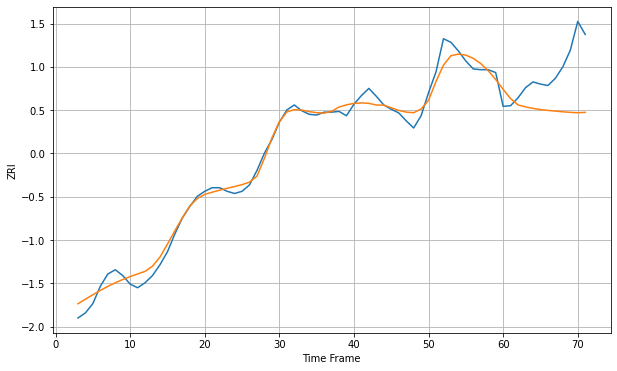

Wall time: 9.85 s
2169 11.329277494282408 62.25633219900556 [2003.63355136 1990.80324719 1981.97151272 1979.31077056 1977.20119598
 1975.60946224 1974.4007274  1973.43743483 1972.50318073 1971.70798375
 1971.1901482  1971.69453058]

Got an mse at 0.0100 in round 105 and stopped training



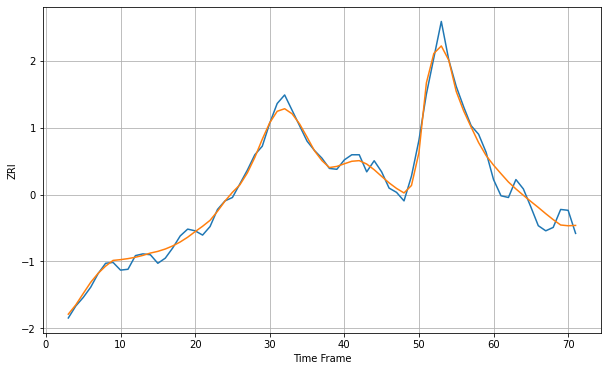

Wall time: 9.68 s
2170 7.92048378953707 16.286853933579067 [1923.86756343 1913.86919681 1904.08791633 1896.02773843 1888.57353147
 1881.37881761 1874.36314478 1867.05003072 1860.10061299 1853.80134491
 1852.92255792 1853.31721527]

Got an mse at 0.0100 in round 115 and stopped training



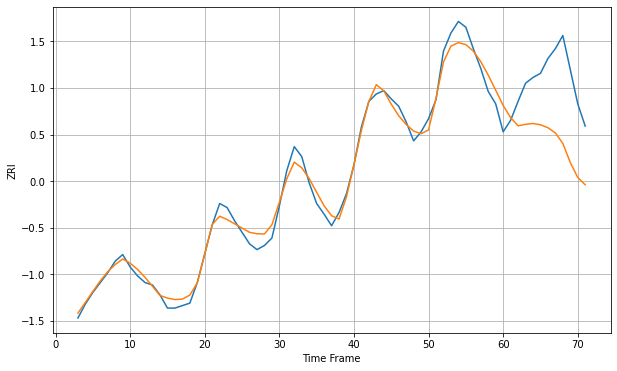

Wall time: 10.2 s
2171 10.502545568220672 77.4225414413399 [2198.05730167 2183.32425078 2173.29626122 2175.10599641 2176.12080164
 2174.55074915 2171.02954237 2164.62597137 2151.92860542 2128.78161993
 2110.58959729 2101.67456889]

Got an mse at 0.0100 in round 149 and stopped training



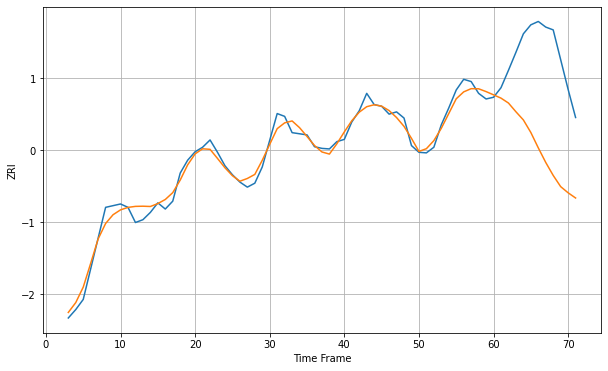

Wall time: 10.7 s
2176 13.059369005061294 172.41271534046305 [2271.36166014 2265.48631149 2256.75998542 2241.22805555 2226.65916816
 2204.31723545 2176.92027736 2150.92824553 2127.82154178 2107.89190294
 2096.89652711 2087.65513653]

Got an mse at 0.0099 in round 71 and stopped training



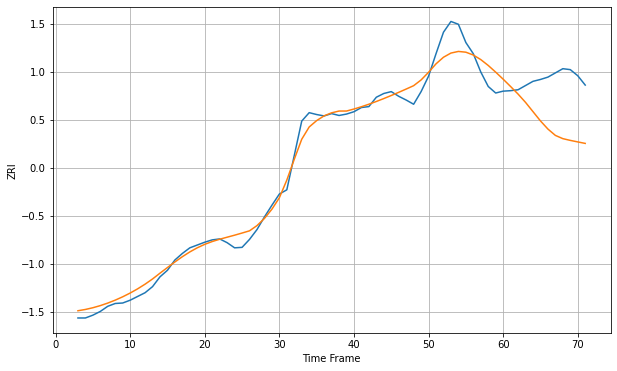

Wall time: 9.39 s
2184 22.125391457823092 102.14735634736985 [2220.60239736 2204.86486399 2188.7172154  2170.97693044 2151.19213098
 2131.37434235 2113.95994151 2100.38058949 2093.44567164 2089.70501665
 2086.45203511 2083.26033232]

Got an mse at 0.0099 in round 165 and stopped training



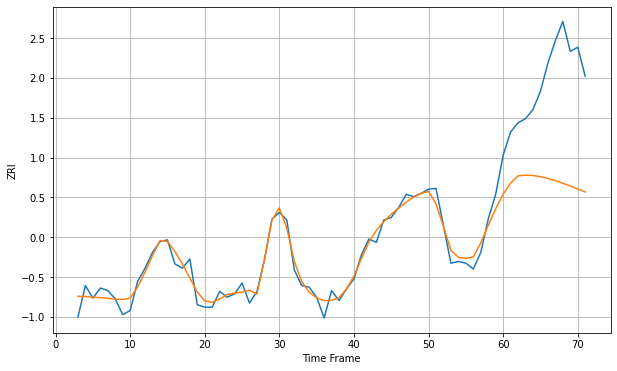

Wall time: 11 s
2210 10.11325512047887 126.53198110061389 [2877.01685098 2890.26359186 2899.20402213 2899.94228572 2899.52056273
 2898.15550302 2896.04093328 2893.34854185 2890.23429485 2886.84296632
 2883.30750715 2879.74444862]

Got an mse at 0.0099 in round 73 and stopped training



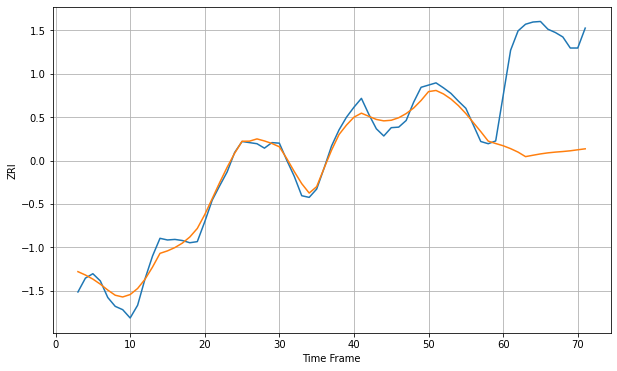

Wall time: 9.11 s
2215 15.559775446723673 207.3776412894056 [2362.34142165 2357.10015816 2350.8139622  2342.67183603 2345.17932162
 2347.56822746 2349.48404013 2350.83601679 2351.89697394 2353.2006937
 2355.03458988 2356.79534846]

Got an mse at 0.0098 in round 93 and stopped training



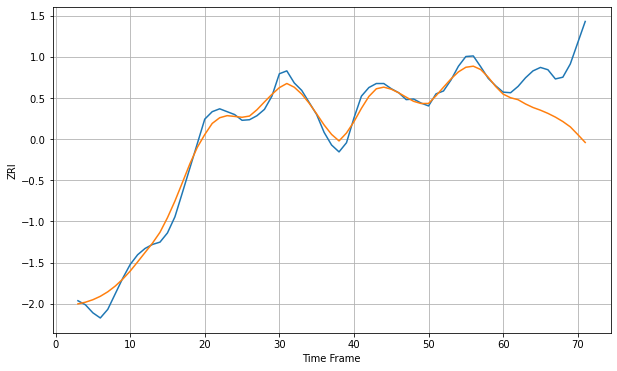

Wall time: 10 s
2301 14.186068607168599 95.84958447212807 [1651.55603628 1645.23238414 1641.84492412 1634.4209437  1628.30928765
 1623.59942495 1618.07284833 1611.57109509 1603.86768628 1594.61974166
 1581.23610986 1567.4394274 ]

Got an mse at 0.0098 in round 42 and stopped training



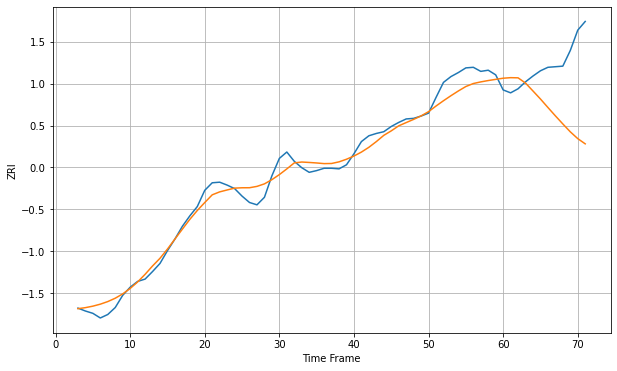

Wall time: 8.09 s
2302 16.24354419112788 102.24163390354671 [1721.17721559 1722.1446464  1721.86187826 1712.80775398 1699.1561802
 1685.36241255 1670.74505845 1656.35247897 1642.38246914 1628.8150887
 1617.08495986 1608.09404997]

Got an mse at 0.0098 in round 40 and stopped training



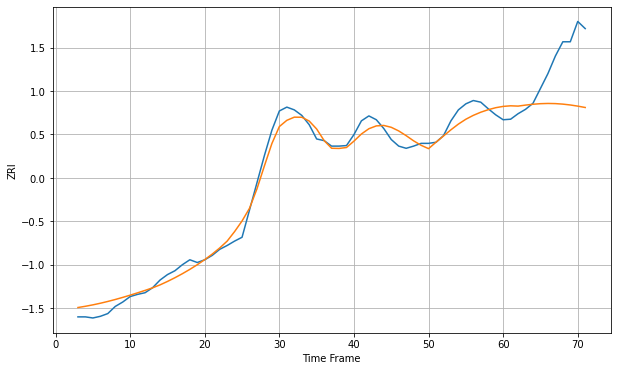

Wall time: 8.24 s
2360 15.794854977527223 83.26919821713446 [1793.31019863 1794.38989182 1793.85550453 1795.6922639  1797.22561702
 1798.26754386 1798.68491558 1798.41631676 1797.4699592  1795.90792061
 1793.82401635 1791.32145965]

Got an mse at 0.0098 in round 84 and stopped training



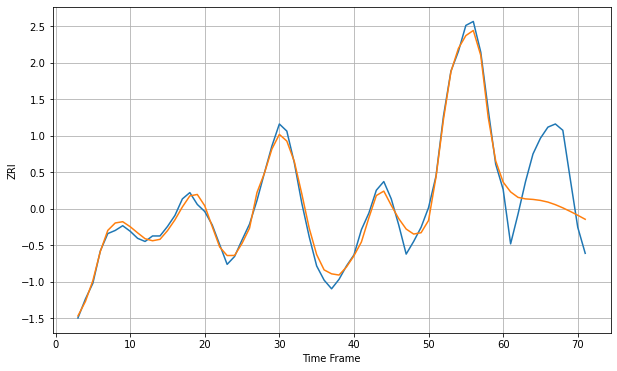

Wall time: 8.92 s
2445 9.21437834792726 63.14158926982815 [2799.29473606 2786.85684732 2779.90323842 2778.00754664 2777.34166832
 2776.07254889 2773.95537877 2770.68069891 2766.641839   2762.10885915
 2757.24654578 2752.15759683]

Got an mse at 0.0100 in round 107 and stopped training



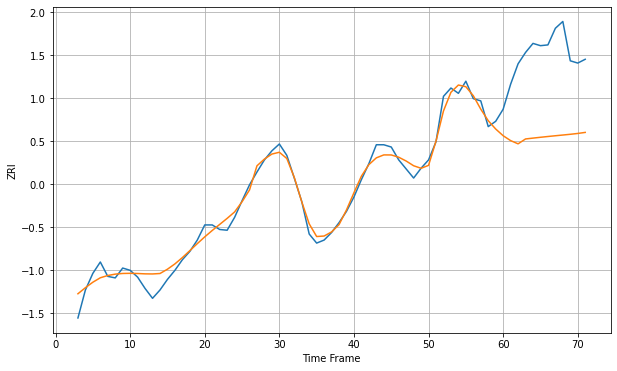

Wall time: 9.8 s
2446 11.132248979298225 110.3852746532164 [2877.95080914 2871.49026524 2867.23442141 2873.67600085 2874.79151768
 2875.88294382 2876.92102982 2877.90630848 2878.8631153  2879.84259886
 2880.94198775 2882.33176503]


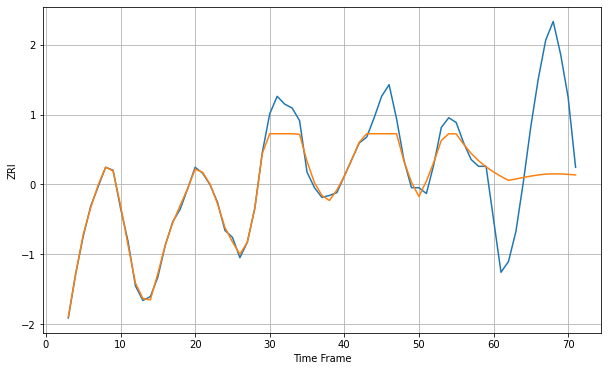

Wall time: 19.9 s
2451 12.942526200245018 91.04336310024289 [2428.18902872 2423.62866161 2419.59803708 2420.99018724 2422.49805987
 2423.95378574 2425.15312323 2425.93862442 2426.25468951 2426.14771565
 2425.73014735 2425.13626247]

Got an mse at 0.0099 in round 107 and stopped training



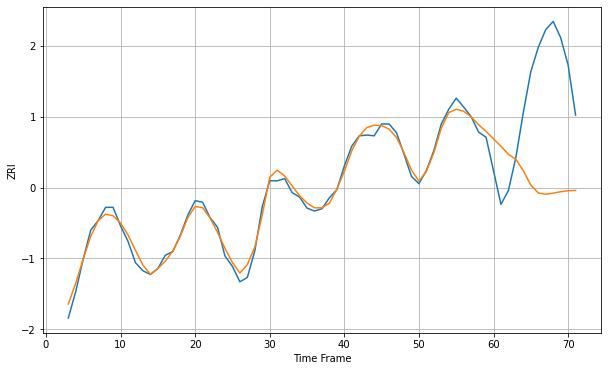

Wall time: 10.3 s
2453 8.043465350658103 149.05263380310183 [2415.94510776 2405.70352762 2394.92890192 2387.98603434 2372.48959935
 2353.18867092 2342.54627043 2340.72316365 2342.21982637 2344.15715176
 2345.49842699 2345.91020125]

Got an mse at 0.0100 in round 131 and stopped training



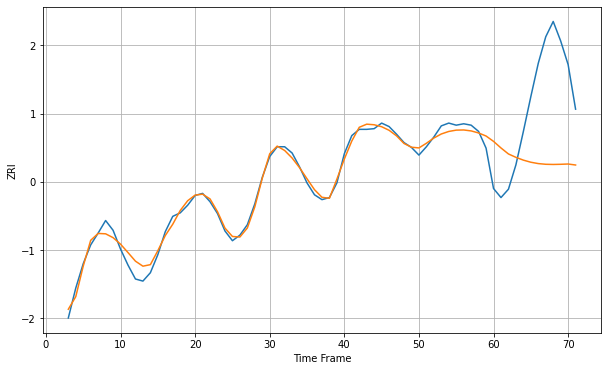

Wall time: 11 s
2458 8.647024170038057 121.69189656114374 [2556.73459746 2547.24541065 2538.64662902 2533.80169637 2529.77752154
 2526.76666806 2524.80800545 2523.81032506 2523.56674216 2523.79921713
 2524.19926204 2522.76673481]

Got an mse at 0.0100 in round 157 and stopped training



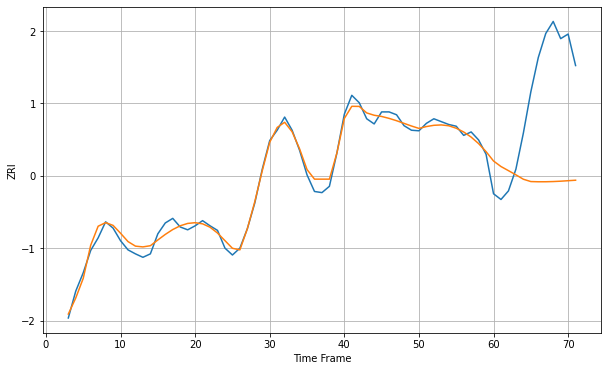

Wall time: 10.7 s
2460 10.51919247571763 182.39381685245303 [2606.23608013 2596.56623034 2589.37605291 2582.07329442 2574.38345131
 2570.3049978  2569.94912798 2569.97747973 2570.33101307 2570.9549435
 2571.8006322  2572.65576725]

Got an mse at 0.0100 in round 123 and stopped training



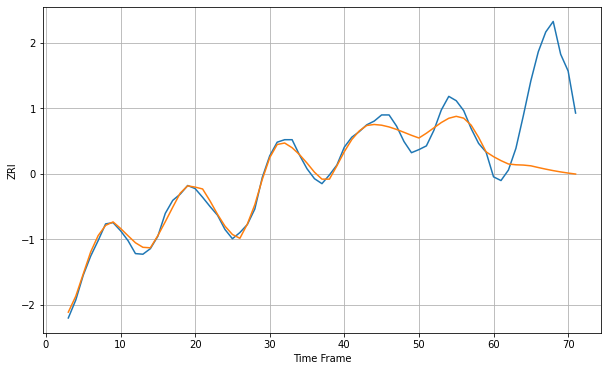

Wall time: 9.76 s
2472 11.253660344744443 142.37466137148087 [2383.60274566 2377.17557802 2371.75117927 2370.4857069  2370.00783908
 2368.80625463 2366.04156301 2363.4214724  2361.03819196 2358.93067996
 2357.09954688 2355.52278997]

Got an mse at 0.0098 in round 112 and stopped training



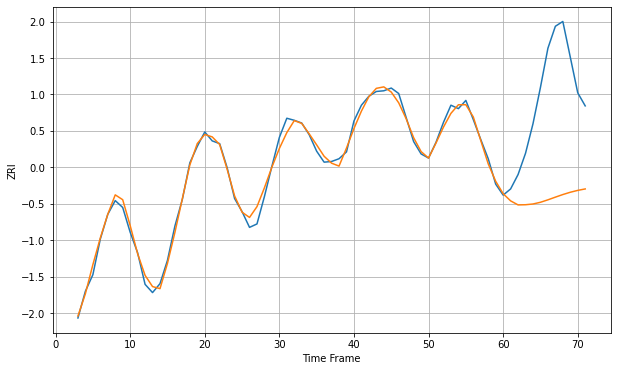

Wall time: 10.4 s
2474 8.291151085081443 157.46187050935 [2341.05774256 2330.62102955 2324.734474   2324.98795245 2326.05661875
 2328.55615324 2332.13298811 2336.04647272 2339.83119127 2343.16573516
 2345.89845605 2348.00659372]

Got an mse at 0.0096 in round 163 and stopped training



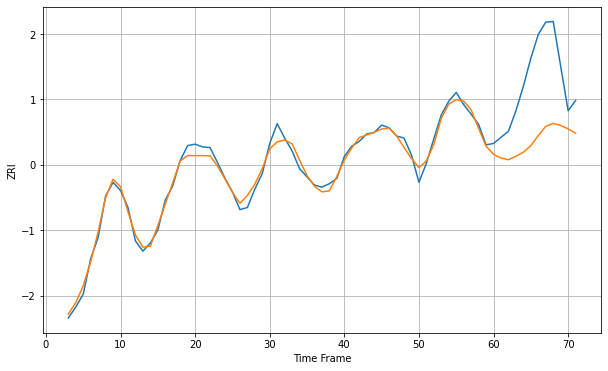

Wall time: 10.6 s
2476 8.719600530103602 96.4200349286674 [2266.00678389 2260.67030388 2258.16683269 2263.17052664 2269.18745148
 2278.84354208 2293.53535877 2307.09316824 2311.38240726 2308.53153815
 2303.42217956 2297.08656037]

Got an mse at 0.0099 in round 129 and stopped training



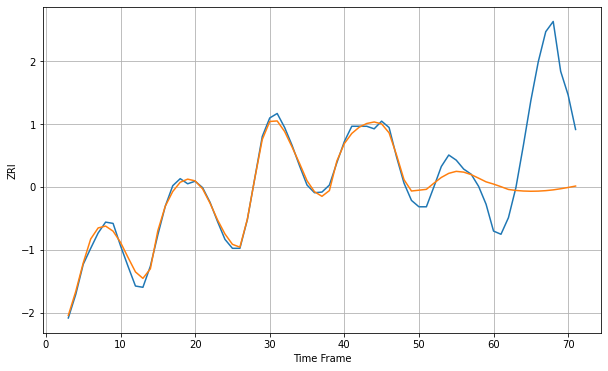

Wall time: 11 s
2478 11.148713530948202 150.82814214672442 [2472.52054222 2468.45425645 2464.11338526 2462.58536085 2461.65589826
 2461.30569031 2461.51238943 2462.24594881 2463.46621624 2465.2186319
 2467.23097091 2469.43043164]


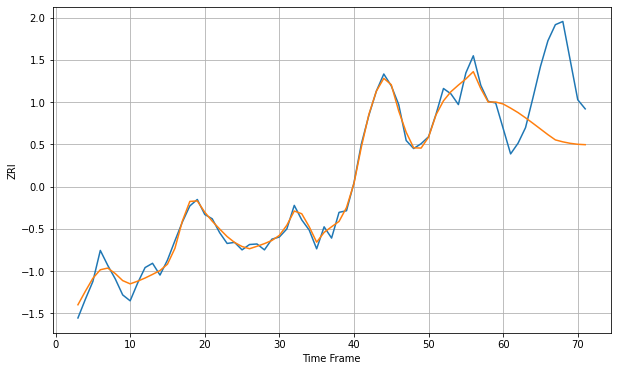

Wall time: 18.6 s
2494 13.62241451305062 126.23618767257081 [2841.08002687 2833.37939296 2825.01201096 2815.29250005 2805.01815217
 2794.47739219 2783.91034985 2774.13060814 2770.47734996 2767.72473272
 2765.9413937  2765.21894849]

Got an mse at 0.0100 in round 292 and stopped training



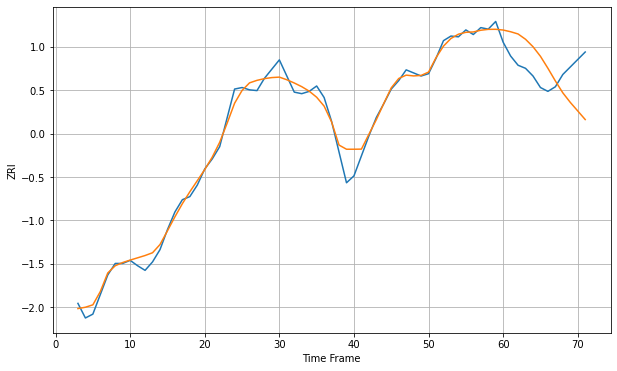

Wall time: 14.8 s
2703 10.848020138454254 44.086895336774255 [1445.84070212 1443.62759995 1440.71655059 1433.81968208 1424.13332671
 1411.63089006 1396.06786531 1379.52740831 1364.08336463 1351.64542252
 1340.49742639 1329.3198419 ]

Got an mse at 0.0100 in round 129 and stopped training



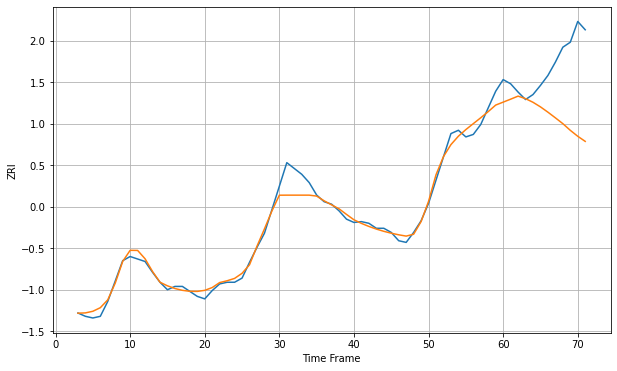

Wall time: 9.9 s
2721 9.646577282862882 73.7071008148551 [1077.86655421 1081.41939626 1085.11139557 1082.05728577 1077.69714753
 1072.17267775 1065.78331549 1058.97909135 1051.96830658 1043.9299955
 1036.76989366 1030.62139406]

Got an mse at 0.0094 in round 49 and stopped training



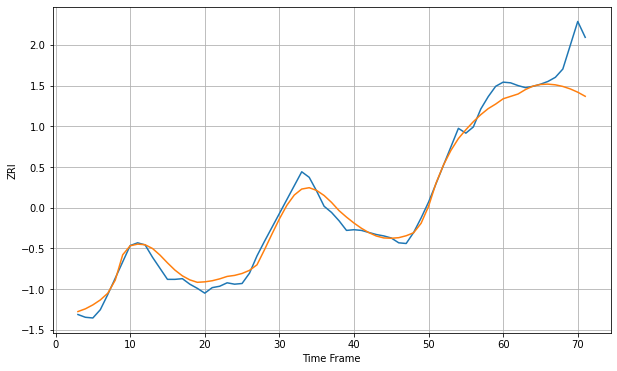

Wall time: 7.58 s
2723 11.549229843328602 44.480938827466055 [1156.87699918 1160.33889003 1163.81913304 1170.3057744  1175.22312688
 1177.61731357 1178.12578854 1177.10545503 1174.75607899 1171.17839561
 1166.41160477 1160.48170127]

Got an mse at 0.0099 in round 51 and stopped training



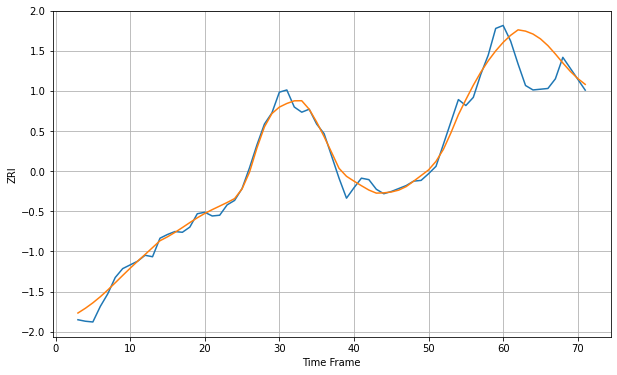

Wall time: 9.15 s
2740 10.8201684824532 43.77382543366793 [1280.2105538  1289.68700601 1297.09816703 1295.36927089 1291.43247711
 1284.94631864 1275.79807745 1264.52825938 1252.46047964 1241.116079
 1231.42973658 1223.55466835]

Got an mse at 0.0099 in round 65 and stopped training



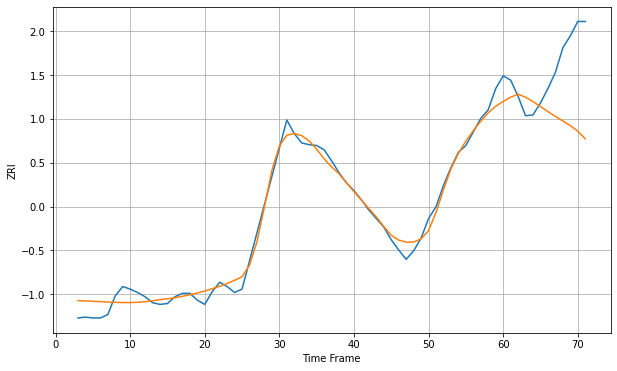

Wall time: 7.39 s
2746 10.0036675545504 70.59303118155663 [1117.87045706 1122.78500526 1126.43126397 1122.82264236 1117.69484058
 1111.86539207 1105.94495775 1100.27685306 1094.88107637 1089.39140086
 1082.89237195 1073.82318791]

Got an mse at 0.0100 in round 92 and stopped training



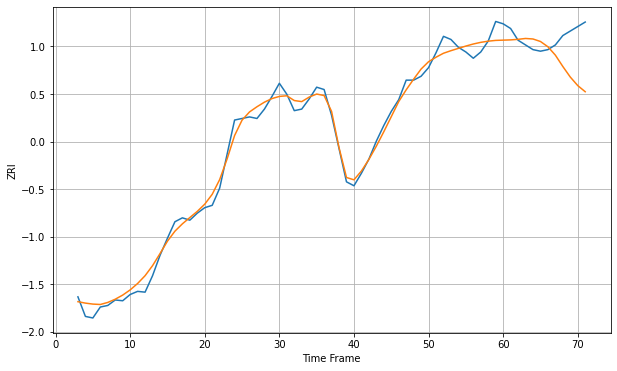

Wall time: 9.41 s
2780 10.194952112451093 40.715428395217074 [1395.12323856 1395.45041789 1396.15913931 1397.27678607 1396.60193526
 1393.40978691 1386.66801119 1375.9399965  1361.4407588  1347.9327697
 1337.02445696 1329.19056019]

Got an mse at 0.0100 in round 188 and stopped training



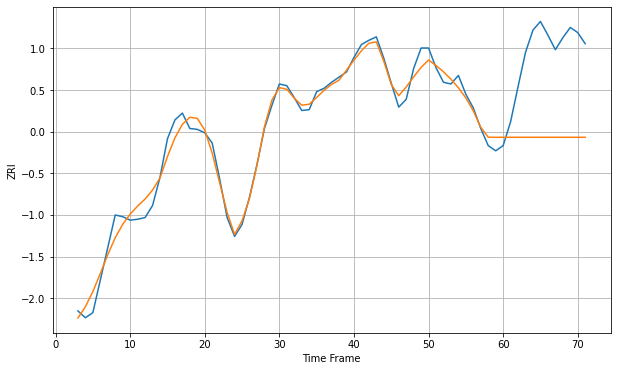

Wall time: 11.4 s
2840 10.892228606901961 103.79666506417912 [1824.75123461 1824.75123461 1824.75123461 1824.75123461 1824.75123461
 1824.75123461 1824.75123461 1824.75123461 1824.75123461 1824.75123461
 1824.75123461 1824.75123461]

Got an mse at 0.0100 in round 61 and stopped training



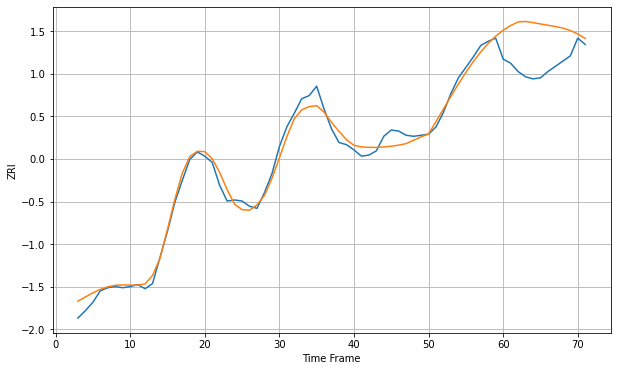

Wall time: 9.12 s
2860 7.306476999208455 38.47138953228144 [1227.50629709 1232.09758518 1235.52638809 1235.98017481 1234.87633069
 1233.59983874 1232.36431128 1231.14209933 1229.67984203 1227.37780852
 1223.99074406 1219.76671705]

Got an mse at 0.0100 in round 394 and stopped training



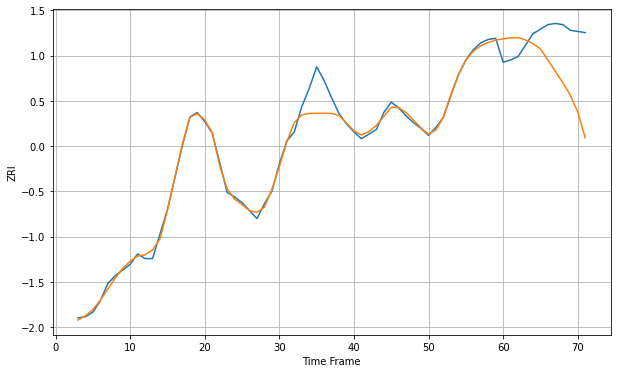

Wall time: 16.5 s
2861 7.924067126239873 44.25822831630665 [1196.60486704 1197.38557685 1197.62251861 1195.58578083 1192.38459016
 1187.72347095 1177.88413499 1167.9493767  1158.01645668 1147.25121026
 1132.36136233 1109.86384553]

Got an mse at 0.0099 in round 99 and stopped training



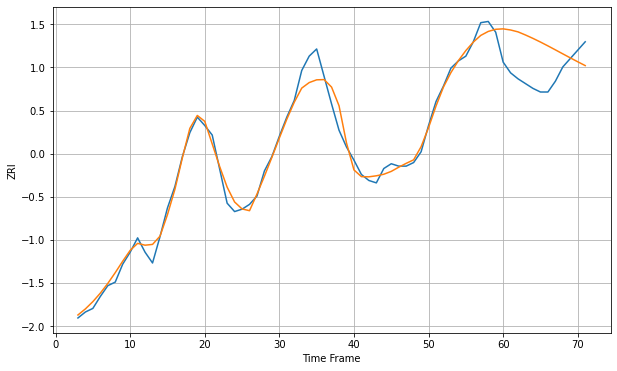

Wall time: 10.4 s
2863 7.620787407848449 31.013194341822476 [1227.81248026 1226.87183849 1225.28281185 1222.66916923 1219.83453355
 1216.79130089 1213.57825364 1210.25644092 1206.89484444 1203.55424727
 1200.2773849  1197.08724653]

Got an mse at 0.0099 in round 120 and stopped training



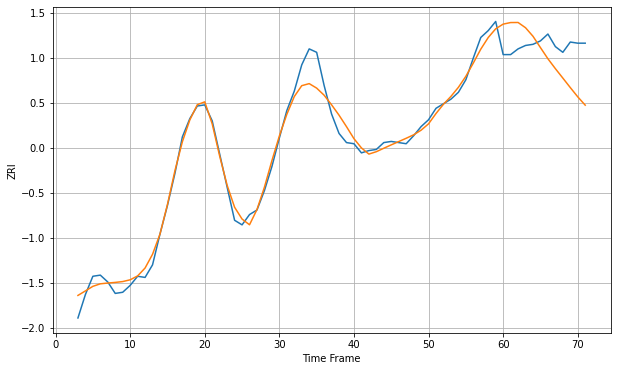

Wall time: 9.61 s
2864 8.848181078989526 29.498765084932366 [1285.67410826 1287.04686063 1287.10852156 1282.5161354  1275.02667772
 1265.12487347 1255.35895463 1246.70524912 1238.45718116 1230.14601979
 1222.03833895 1214.7523509 ]

Got an mse at 0.0098 in round 208 and stopped training



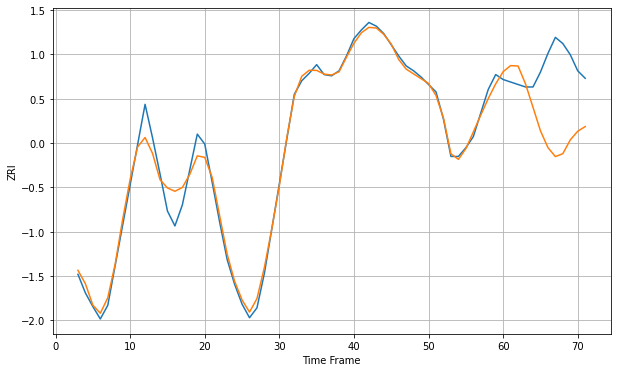

Wall time: 12.5 s
2891 7.558514370995207 53.541919047276465 [1210.31781151 1215.21459357 1214.88760238 1200.44758146 1181.66473917
 1162.68548472 1149.18251782 1141.8906409  1144.24032558 1155.3747399
 1162.35003319 1166.09827066]

Got an mse at 0.0100 in round 373 and stopped training



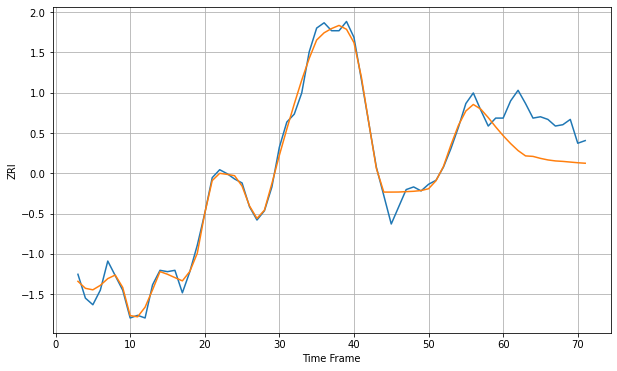

Wall time: 16.7 s
2893 6.028181517722017 29.755986367349045 [1218.72937596 1212.7645214  1207.46520441 1203.44909536 1203.06617342
 1201.57465096 1200.39455428 1199.64320808 1199.2865172  1198.77528367
 1198.27188649 1197.89391874]

Got an mse at 0.0099 in round 137 and stopped training



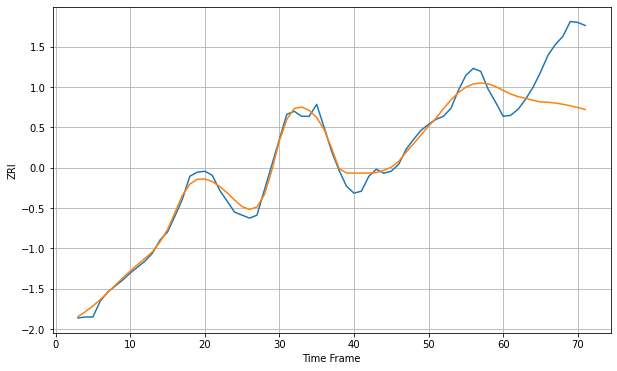

Wall time: 10.1 s
2895 7.523571987618437 53.30088459731845 [1093.9214228  1090.35305357 1087.67720416 1086.10633704 1084.01134911
 1082.42595225 1082.10491708 1081.28047906 1080.05143692 1078.51579987
 1076.74939455 1074.80208006]

Got an mse at 0.0099 in round 79 and stopped training



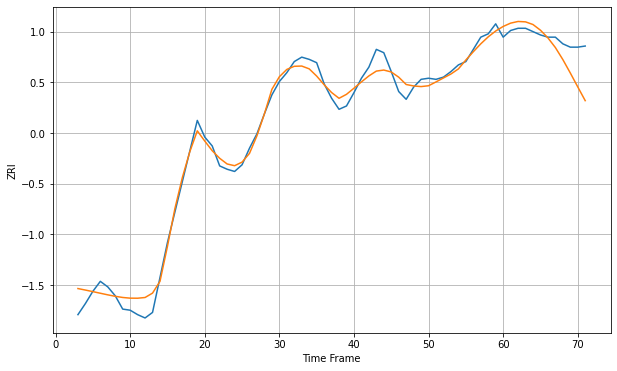

Wall time: 9.96 s
2904 8.490025706060166 19.997065980225948 [1248.64164776 1251.63527451 1253.14114681 1252.78549115 1250.38025943
 1245.27363131 1238.36164302 1229.64848835 1218.82568453 1206.74283166
 1194.20522063 1181.80127329]

Got an mse at 0.0098 in round 89 and stopped training



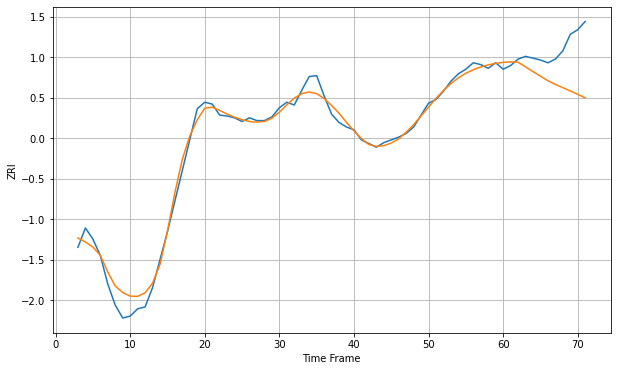

Wall time: 8.59 s
2905 8.796872160840758 39.96793683094293 [1277.52485069 1277.98694898 1277.61143176 1272.54095983 1267.41054581
 1262.36595056 1257.49576034 1253.40050352 1249.89929767 1246.30925259
 1242.61250053 1238.814987  ]

Got an mse at 0.0094 in round 33 and stopped training



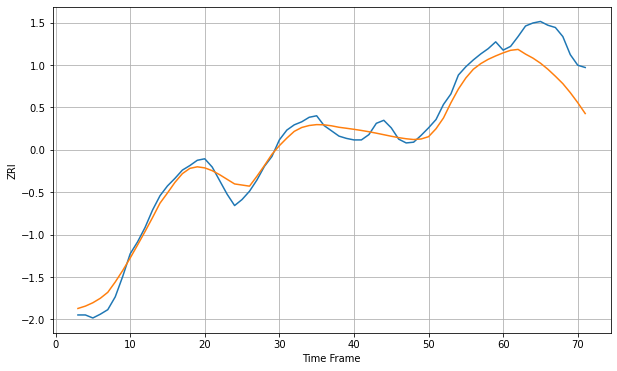

Wall time: 8.76 s
2906 12.302465799489475 47.55725923430416 [1547.37033226 1550.7899734  1551.95540375 1545.74370044 1540.3822955
 1533.73260746 1525.63944276 1516.4037658  1506.60612495 1494.65036832
 1481.3751966  1466.97196909]

Got an mse at 0.0099 in round 94 and stopped training



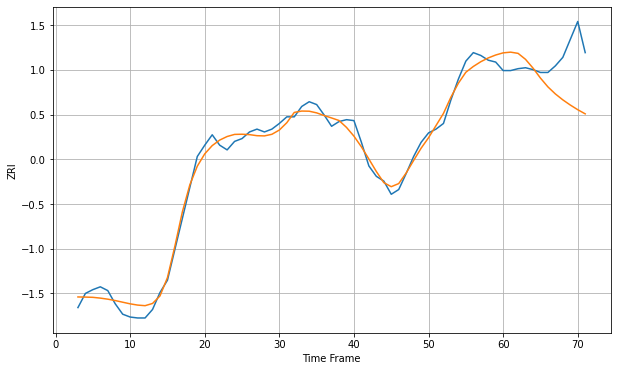

Wall time: 9.37 s
2907 8.00452416750602 42.84262214459386 [1270.75904667 1271.51109265 1270.22872676 1263.87577697 1254.63317918
 1244.05683954 1234.72753567 1227.25065588 1220.9732414  1215.50016051
 1210.55139486 1206.15704237]

Got an mse at 0.0100 in round 47 and stopped training



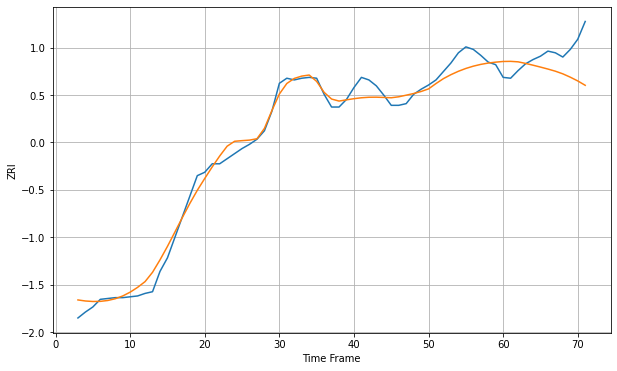

Wall time: 8.76 s
2908 11.062588534149969 31.026029512218482 [1279.771244   1279.91318106 1279.35351828 1277.49985055 1275.38078394
 1273.15881296 1270.83255362 1268.29194151 1265.17393358 1261.22857583
 1256.79424659 1251.64232953]

Got an mse at 0.0098 in round 60 and stopped training



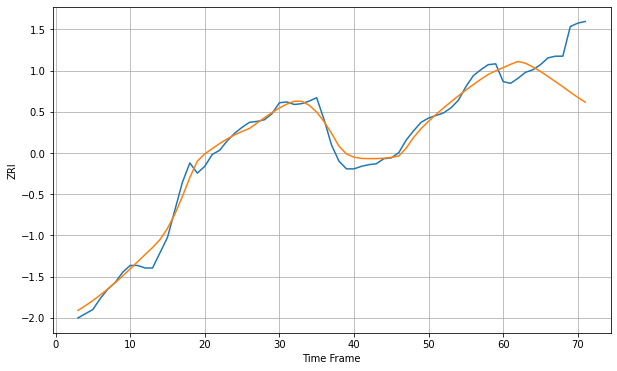

Wall time: 8.23 s
2909 9.487414986231325 47.224445282745165 [1250.53416121 1254.41013709 1257.78609038 1255.63583087 1251.2234037
 1246.0266704  1240.14126707 1234.04439568 1227.97531252 1221.5453667
 1215.4410991  1209.76917737]

Got an mse at 0.0099 in round 52 and stopped training



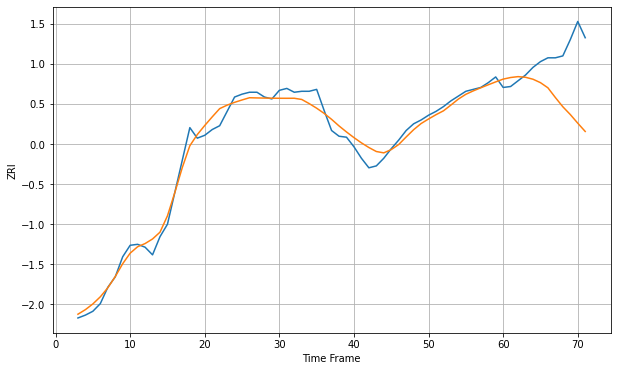

Wall time: 8.55 s
2910 8.703891760618411 52.75978097481235 [1213.71925918 1215.40047946 1216.32217992 1215.64584101 1213.61394212
 1210.02503316 1204.64301045 1194.47037044 1184.83114526 1176.69692571
 1167.65722295 1159.0043534 ]

Got an mse at 0.0098 in round 60 and stopped training



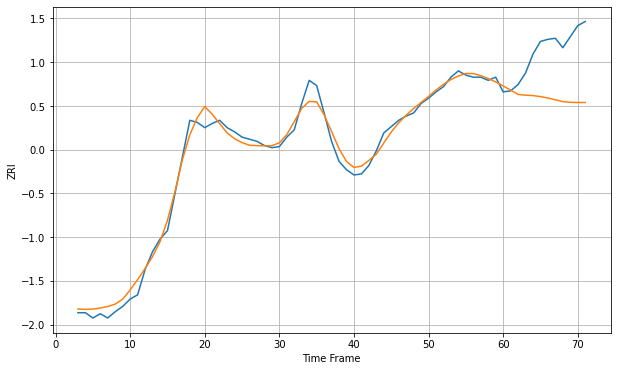

Wall time: 8.74 s
2914 7.264601081783641 49.332524410698 [1257.70771964 1253.72027869 1249.62064634 1248.88557097 1248.51763567
 1247.52897337 1246.15763538 1244.54476954 1242.77724348 1242.11884194
 1241.95797286 1241.93041751]

Got an mse at 0.0100 in round 71 and stopped training



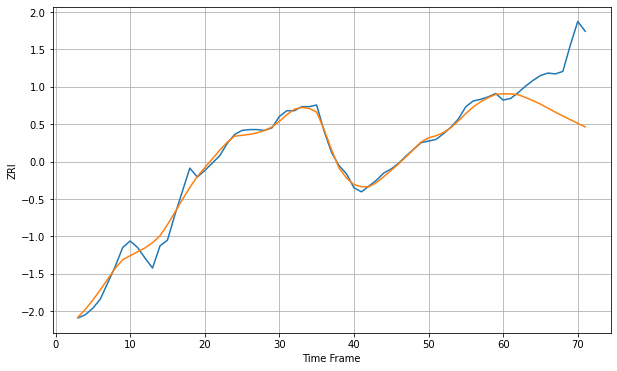

Wall time: 9.23 s
2920 8.156927281244204 62.20290876482122 [1236.73666725 1236.57877929 1235.57591916 1232.18912182 1228.32034323
 1224.14963294 1219.15443354 1214.2791723  1209.60844391 1205.11918754
 1200.70042299 1196.24184464]

Got an mse at 0.0098 in round 65 and stopped training



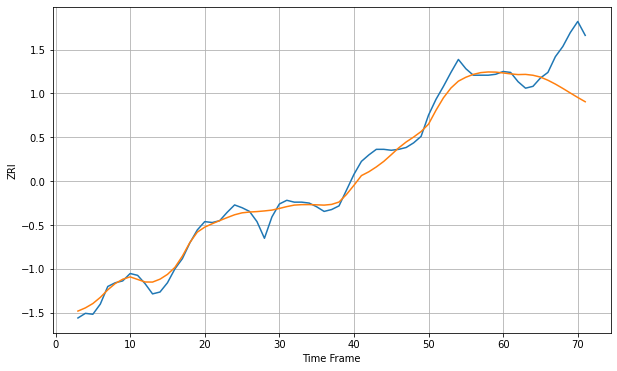

Wall time: 8.15 s
3038 9.310819898240533 40.34162015131772 [1364.45260597 1363.42025897 1362.6780491  1362.87324307 1361.9430282
 1359.98014116 1356.56940273 1352.42235151 1347.74167356 1342.82892203
 1337.97827512 1333.36451814]

Got an mse at 0.0098 in round 49 and stopped training



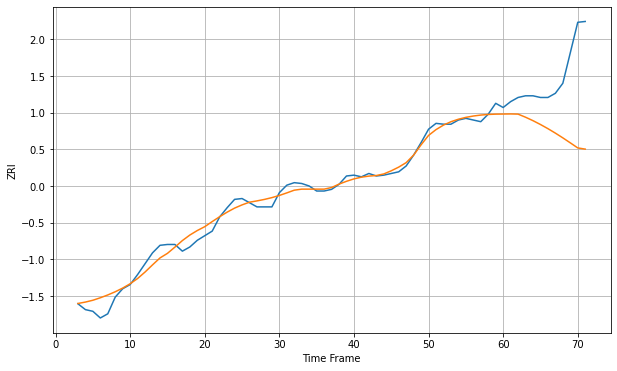

Wall time: 8.97 s
3060 8.418290041230392 75.72476893157028 [1428.14373772 1428.27252469 1428.05803216 1424.3701167  1420.22138012
 1415.64219607 1410.66396837 1405.31801729 1399.63981449 1393.67646815
 1387.60195882 1386.1637736 ]

Got an mse at 0.0095 in round 20 and stopped training



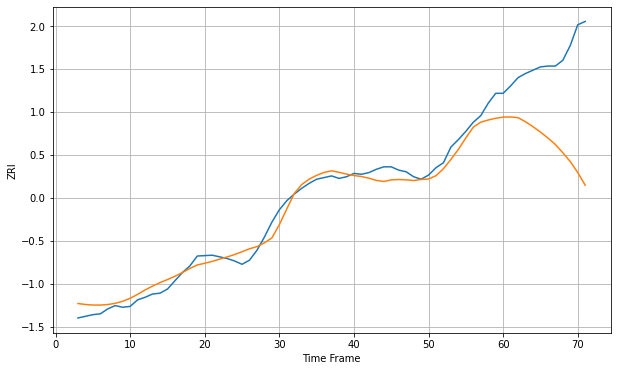

Wall time: 7.44 s
3102 10.584818854567754 107.69415019631204 [1275.21006587 1275.39036037 1274.51383731 1269.56011693 1263.62280481
 1257.05467563 1249.88864099 1242.08126619 1232.03463448 1221.28557929
 1208.06092343 1192.74475473]

Got an mse at 0.0092 in round 30 and stopped training



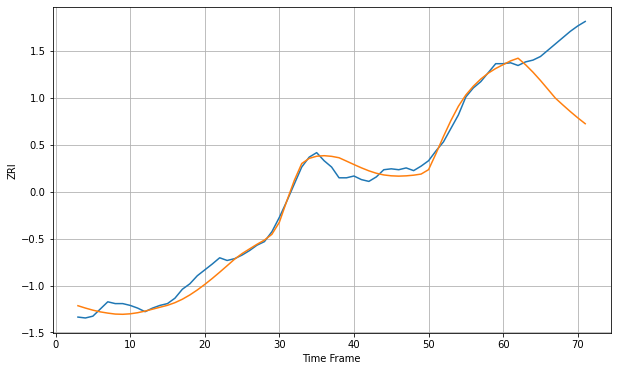

Wall time: 8.69 s
3103 8.93631953651778 60.19188770313588 [1278.93808918 1283.1323853  1286.13008205 1278.88078026 1270.54581927
 1261.33428321 1251.52470364 1241.67131289 1234.1124133  1226.7371361
 1219.7694241  1213.2176192 ]

Got an mse at 0.0097 in round 44 and stopped training



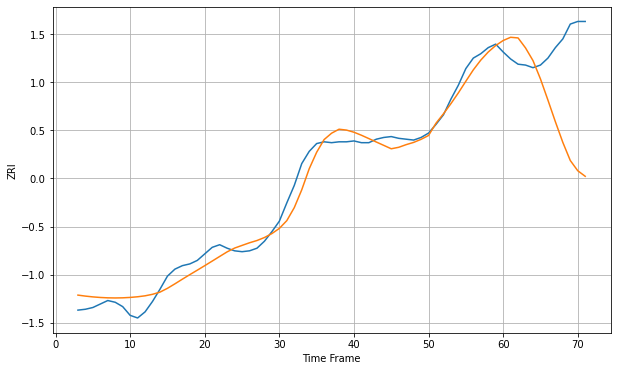

Wall time: 8.62 s
3104 12.17234776597105 96.3142469719107 [1302.15199445 1305.8602181  1305.11860054 1293.63903129 1279.1313861
 1258.12710282 1233.89298003 1209.04202423 1185.30867636 1164.56081271
 1152.83764383 1146.44502297]

Got an mse at 0.0099 in round 154 and stopped training



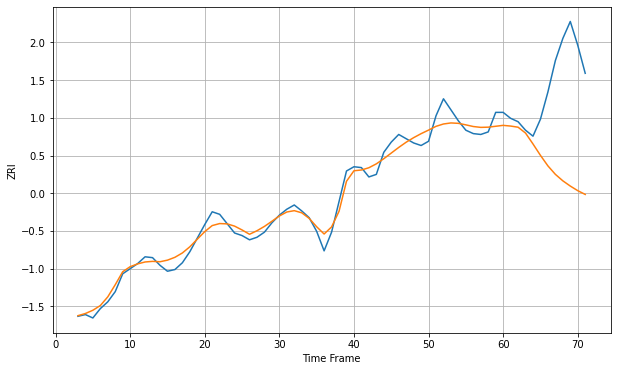

Wall time: 12.3 s
3301 9.625323610183237 109.16960369282431 [1295.70989307 1294.88189408 1293.544124   1286.63542451 1273.81410537
 1260.38679651 1248.01275297 1238.05164844 1230.43069355 1224.25976982
 1218.84282724 1214.42592216]

Got an mse at 0.0095 in round 27 and stopped training



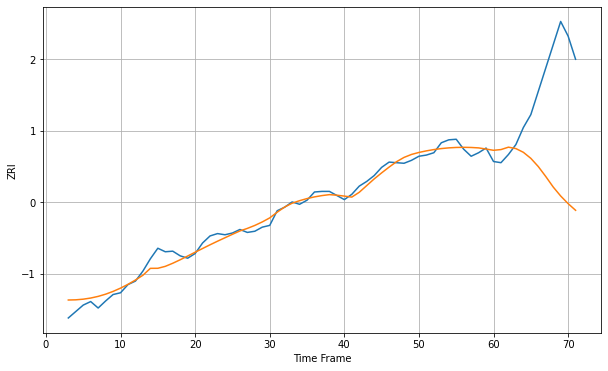

Wall time: 8.45 s
3820 11.349447149278221 171.98365176142113 [1380.1585054  1381.38274011 1385.48087182 1383.05816627 1376.71643206
 1366.41173544 1352.39116691 1335.45616756 1317.47793502 1302.16948293
 1289.12452758 1277.75220927]

Got an mse at 0.0100 in round 137 and stopped training



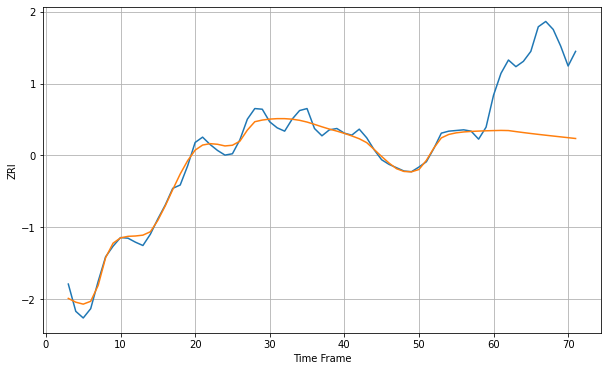

Wall time: 9.87 s
4101 9.934628606965369 124.61509552982272 [1672.85996282 1673.12699631 1672.89695034 1671.34552531 1669.87885481
 1668.48945558 1667.1662905  1665.89342364 1664.65204055 1663.42409734
 1662.19596374 1660.96101853]

Got an mse at 0.0100 in round 160 and stopped training



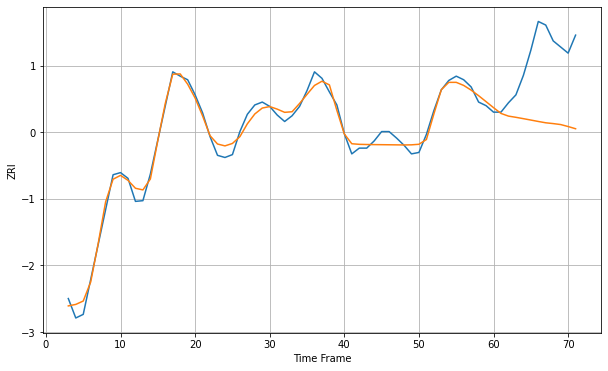

Wall time: 12 s
4102 9.737572960029798 93.20440652007674 [1648.24479478 1640.22613972 1636.50746098 1634.82156321 1632.94607285
 1631.01502125 1629.05115774 1627.20331274 1626.09311346 1624.75515366
 1622.00922497 1618.9470116 ]

Got an mse at 0.0100 in round 76 and stopped training



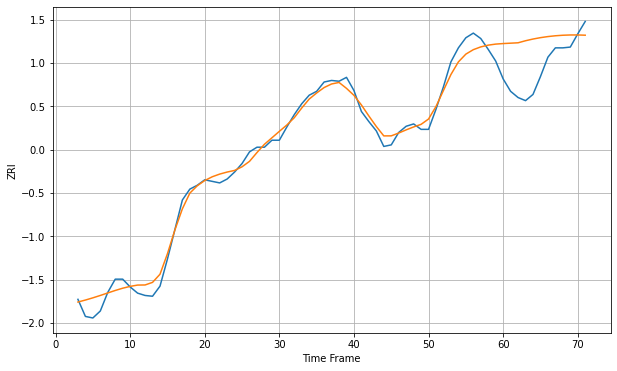

Wall time: 8.38 s
4103 10.942807024738029 46.748981708334945 [1616.53181032 1617.02802211 1617.53009595 1620.162743   1622.36147866
 1624.14565496 1625.53933923 1626.56698922 1627.24934604 1627.59927354
 1627.6185079  1627.29687205]

Got an mse at 0.0100 in round 317 and stopped training



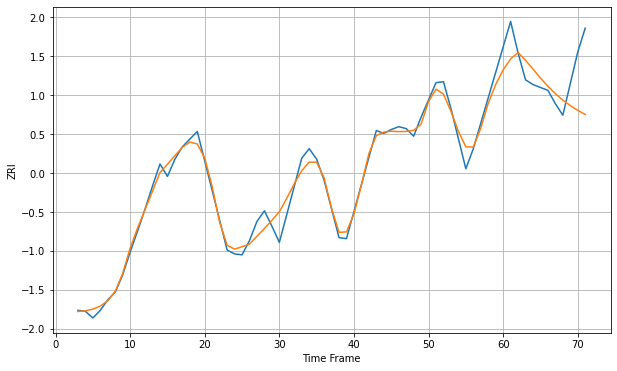

Wall time: 16.3 s
4210 8.77396640036948 36.11387281623771 [1062.39826239 1073.83516595 1080.51139567 1072.37084948 1063.25213834
 1053.96058396 1045.25167963 1037.51606705 1030.81629812 1025.04926111
 1020.0569607  1015.76483153]

Got an mse at 0.0099 in round 208 and stopped training



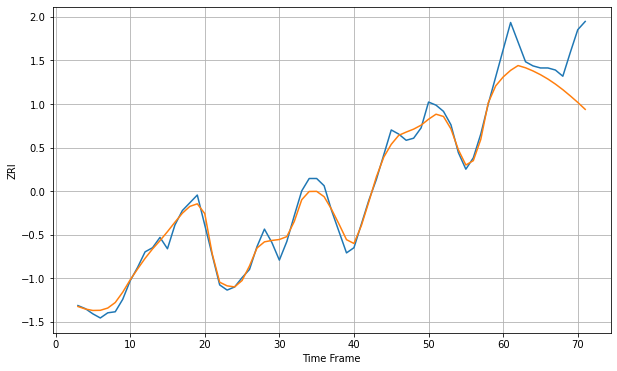

Wall time: 11.8 s
4240 7.30174131255561 38.59647261940837 [1045.25471877 1051.68475787 1056.32607462 1054.16103164 1051.10834541
 1047.49158459 1043.26464391 1038.41632781 1032.96255078 1026.97051378
 1020.67854511 1013.92504653]

Got an mse at 0.0100 in round 147 and stopped training



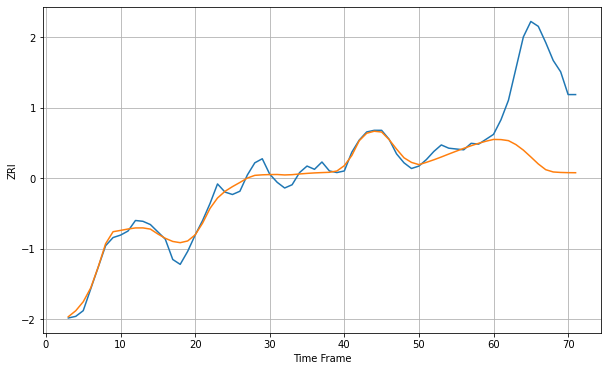

Wall time: 10.7 s
4401 8.81555822875256 117.23913556832554 [1121.78413228 1121.58673239 1120.28995236 1115.45077042 1108.62664194
 1100.24701718 1091.60465251 1084.53538086 1081.74101998 1081.14052792
 1080.87929375 1080.79631262]

Got an mse at 0.0100 in round 236 and stopped training



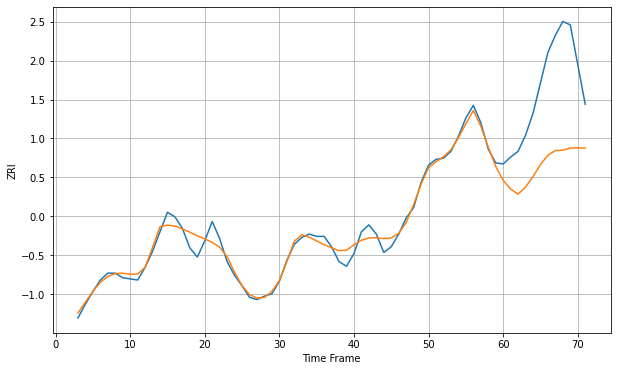

Wall time: 13 s
4901 6.228625347522664 71.4457046691507 [857.75209467 850.24530284 845.73027145 851.91008265 861.04264438
 871.49518196 879.61370851 883.63572372 884.0070296  885.85167951
 886.04628852 885.77978597]

Got an mse at 0.0099 in round 127 and stopped training



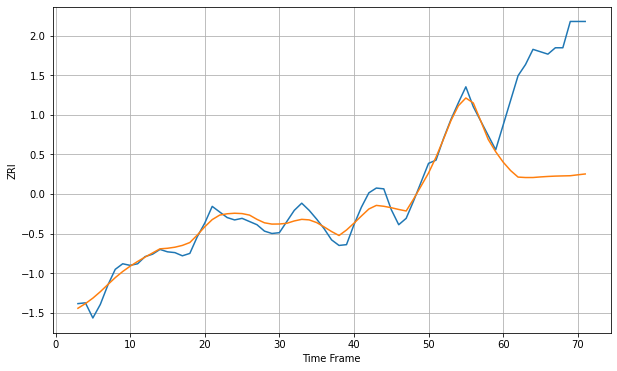

Wall time: 9.99 s
4937 10.45455151075505 153.60314115624482 [969.54033748 958.93321819 950.7480944  950.20488137 950.21856031
 950.95585453 951.55198285 951.9812393  952.23340504 952.46109826
 953.6039332  954.66882918]

Got an mse at 0.0100 in round 94 and stopped training



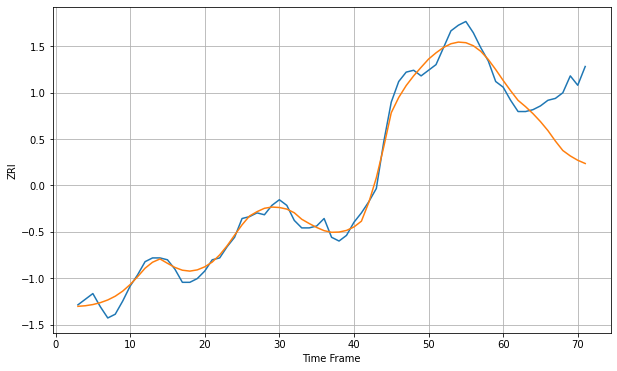

Wall time: 9.58 s
6010 4.664659252154944 25.766289155257635 [1066.57966805 1061.09225034 1055.95368468 1052.61262438 1048.88195979
 1044.6422538  1039.85483862 1034.27826251 1029.2350034  1026.34547636
 1024.03419904 1022.31477559]

Got an mse at 0.0099 in round 64 and stopped training



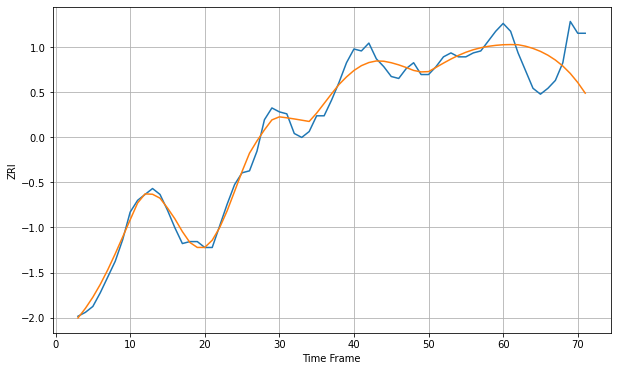

Wall time: 9.17 s
6040 4.479567310889745 17.960638683385614 [1189.16222121 1189.24368467 1189.16180066 1188.40839269 1187.28978896
 1185.77942131 1183.83224818 1181.3772555  1178.31883514 1174.54283943
 1169.94054911 1164.52368158]

Got an mse at 0.0099 in round 174 and stopped training



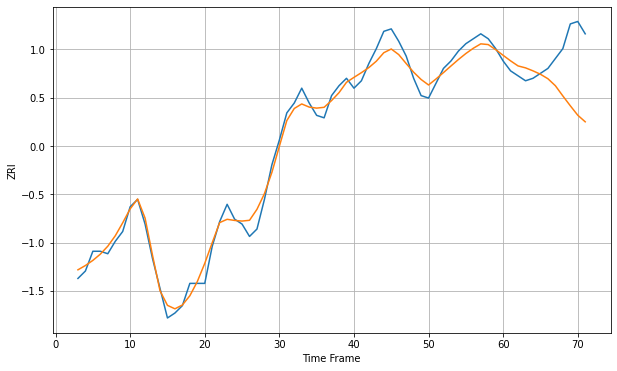

Wall time: 11.2 s
6051 3.8509949362221585 19.110374365284756 [1103.29337322 1101.0511245  1099.00373213 1098.22327751 1097.01453172
 1095.63687249 1093.82089805 1090.9926579  1086.86775479 1082.88417774
 1079.06462965 1076.39305292]

Got an mse at 0.0099 in round 59 and stopped training



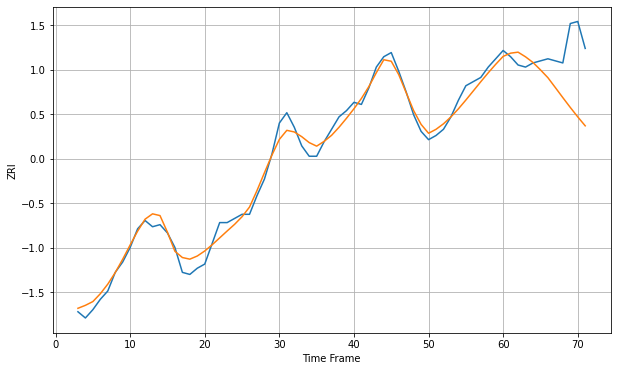

Wall time: 9.49 s
6053 3.9609697732382645 21.928709961106886 [1163.16404981 1164.71288917 1165.19421216 1162.94927649 1160.22078759
 1156.66367407 1152.87808115 1148.0949444  1143.26917744 1138.53727181
 1133.98540813 1129.67063023]

Got an mse at 0.0100 in round 132 and stopped training



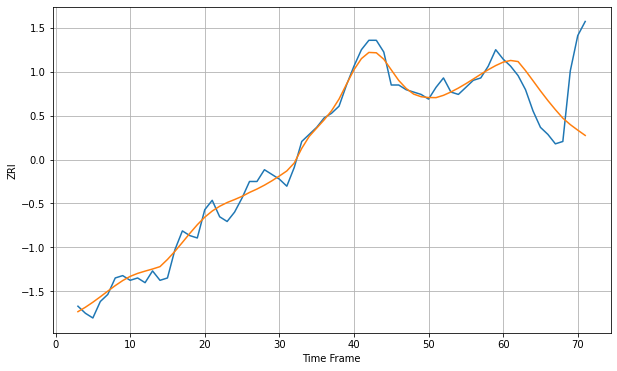

Wall time: 10.2 s
6082 3.7897492458697895 21.431318632152546 [1231.70957933 1232.42640865 1231.96015758 1228.1076054  1223.82769691
 1219.50082913 1215.37876748 1211.5302485  1207.92180097 1205.16662245
 1202.81663153 1200.56863952]

Got an mse at 0.0099 in round 172 and stopped training



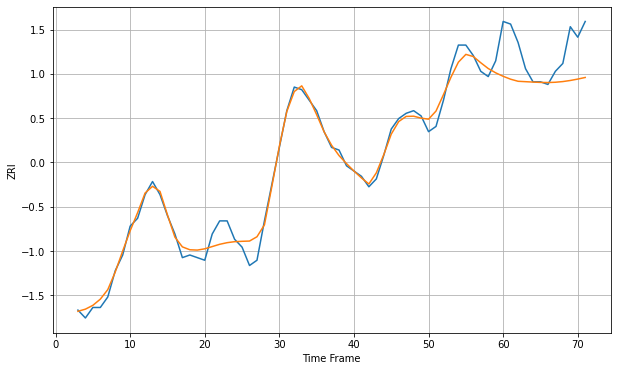

Wall time: 10.7 s
6106 3.3582063913575677 13.894613568224852 [1108.10674139 1106.99567809 1106.20531204 1106.05005155 1105.89910026
 1105.77741714 1105.72233306 1105.83709974 1106.09493317 1106.50670234
 1107.04550211 1107.65716908]

Got an mse at 0.0100 in round 83 and stopped training



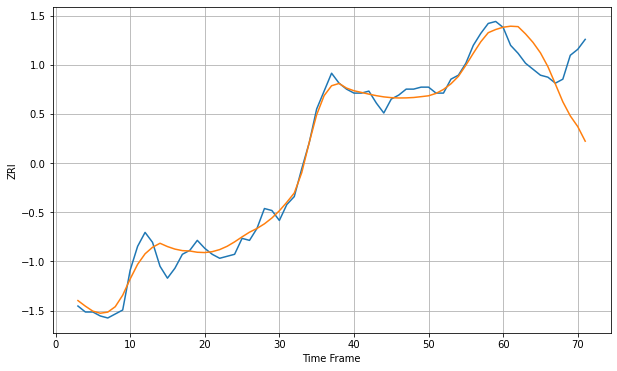

Wall time: 8.92 s
6108 4.8630280523862375 22.3742671213359 [1208.10814716 1208.61503305 1208.40588753 1204.74820325 1200.48706369
 1195.22375946 1188.28534267 1179.55785852 1170.62957339 1163.54366386
 1158.17221779 1150.84210333]

Got an mse at 0.0100 in round 165 and stopped training



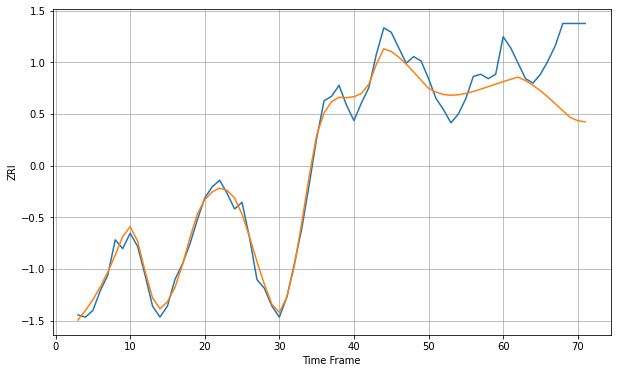

Wall time: 11.2 s
6112 4.864855827826158 27.361065171078856 [1132.6504314  1133.70098541 1134.68341691 1133.09383354 1131.00794771
 1128.50693405 1125.67252381 1122.61491678 1119.47339462 1116.40037874
 1114.98638769 1114.38968847]

Got an mse at 0.0099 in round 217 and stopped training



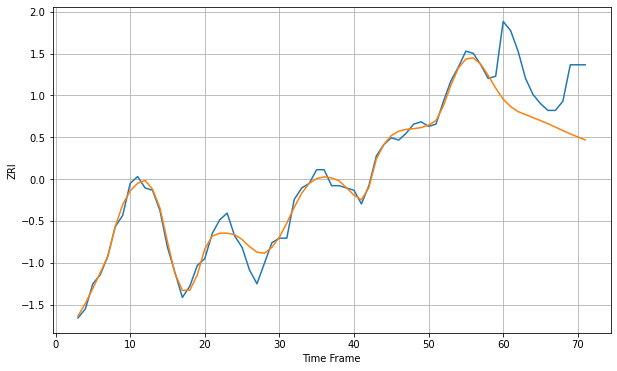

Wall time: 13 s
6114 3.6571036033307402 23.511416990660848 [1104.97461596 1101.6621325  1099.48363739 1098.1756102  1096.86071863
 1095.53367495 1094.19740447 1092.68223231 1091.19059299 1089.71379905
 1088.39116088 1087.06753398]

Got an mse at 0.0100 in round 177 and stopped training



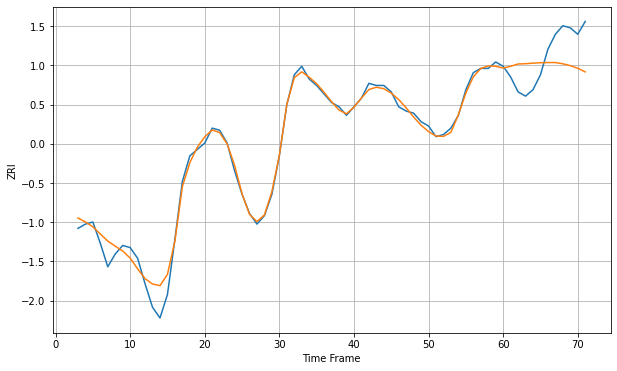

Wall time: 11.6 s
6119 3.7783810643253033 13.767333296018442 [1380.16180147 1380.99604882 1382.06222129 1382.20799124 1382.46429208
 1382.64649272 1382.74253796 1382.74299563 1382.15440698 1381.30056185
 1380.06907765 1378.35193773]

Got an mse at 0.0100 in round 187 and stopped training



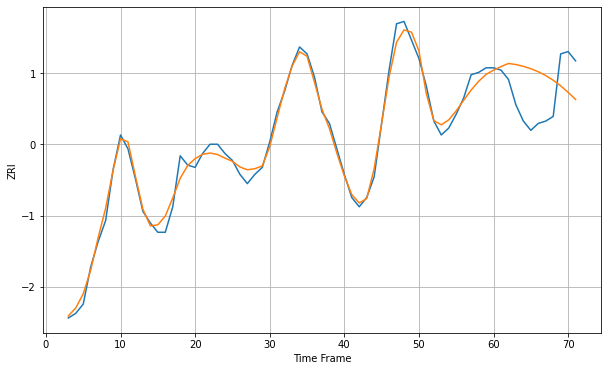

Wall time: 12 s
6320 3.2873264100664414 17.138559722292015 [1062.97427987 1064.51963588 1065.8713092  1065.40105327 1064.64127312
 1063.60426898 1062.28491079 1060.6504535  1058.64437391 1056.21666223
 1053.39352347 1050.35006105]

Got an mse at 0.0100 in round 275 and stopped training



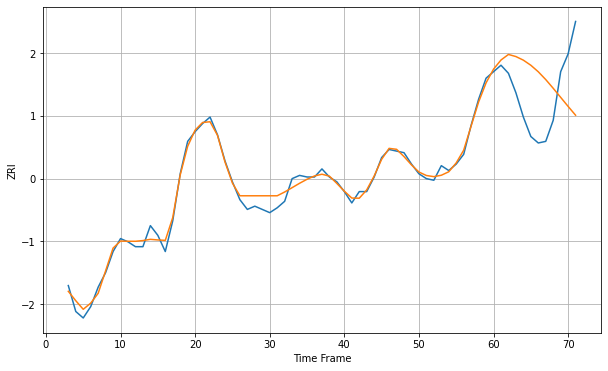

Wall time: 13.7 s
6360 3.8490720203503543 31.939668047353805 [1111.56638789 1117.20961349 1120.64194567 1119.34181882 1117.11536948
 1113.97526495 1109.94592835 1105.12775188 1099.75945738 1094.15850945
 1088.56959553 1083.12722154]

Got an mse at 0.0099 in round 80 and stopped training



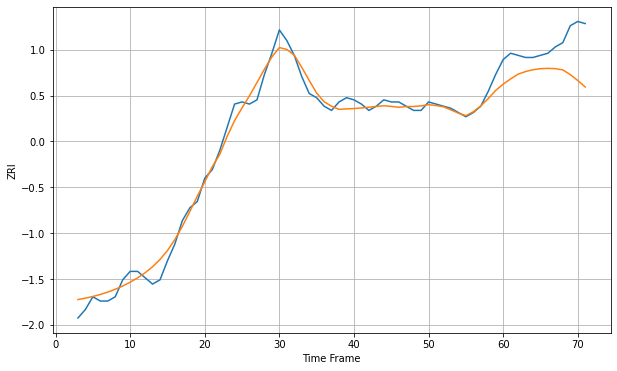

Wall time: 8.15 s
6401 3.978177269139704 15.830551877232336 [1223.39333912 1225.86709455 1228.11170917 1229.34058121 1230.21121182
 1230.69933329 1230.84924165 1230.71844693 1230.12453739 1227.90594504
 1225.13681346 1222.05867898]

Got an mse at 0.0100 in round 123 and stopped training



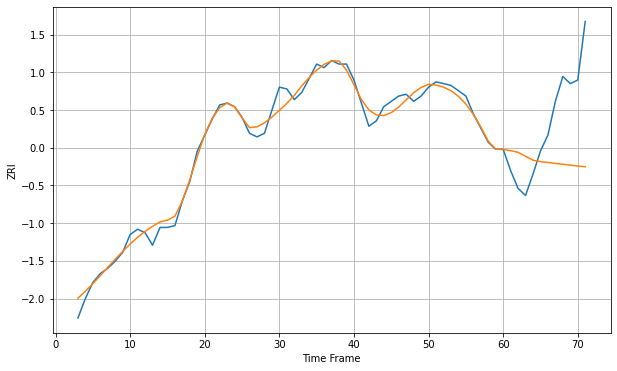

Wall time: 11 s
6405 4.328575379028208 36.7178205855974 [1297.90739391 1297.22744987 1296.31790207 1294.06168151 1291.87500181
 1291.0372943  1290.55596163 1290.0639394  1289.56362706 1289.0655774
 1288.5887278  1288.15510125]

Got an mse at 0.0099 in round 111 and stopped training



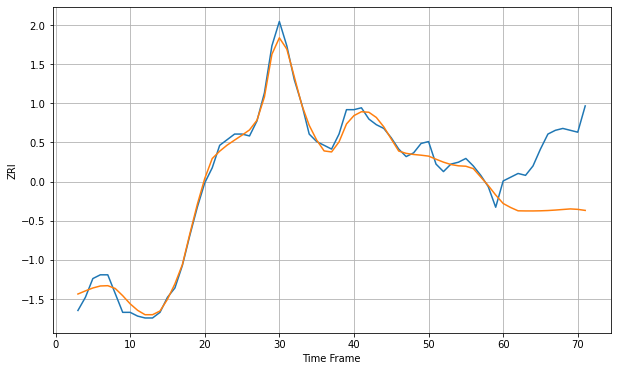

Wall time: 9.94 s
6418 3.8514747629015176 34.991571003406364 [1196.01712204 1193.87152315 1192.10090709 1192.03819031 1192.03588607
 1192.10581061 1192.25285338 1192.50274862 1192.80961315 1193.11445936
 1192.88092752 1192.31840247]

Got an mse at 0.0100 in round 117 and stopped training



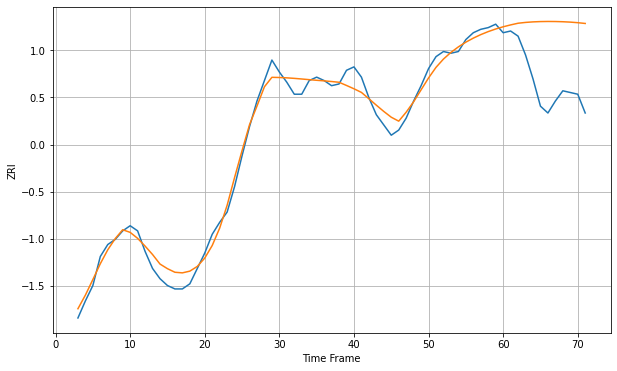

Wall time: 10.7 s
6450 5.527833442190723 37.51091516142295 [1164.47243462 1165.57952435 1166.55705631 1167.03493084 1167.34923848
 1167.52802435 1167.59329905 1167.55988109 1167.43344727 1167.20996149
 1166.87823743 1166.42465163]

Got an mse at 0.0098 in round 146 and stopped training



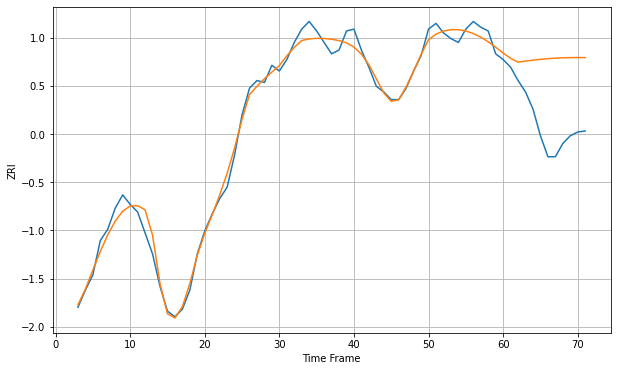

Wall time: 10.8 s
6451 4.579378581433888 34.99823822770695 [1140.42050597 1137.66462784 1135.65351714 1136.19801309 1136.69176362
 1137.12088574 1137.47287242 1137.74047935 1137.92387842 1138.02979142
 1138.06714026 1138.04049091]

Got an mse at 0.0100 in round 116 and stopped training



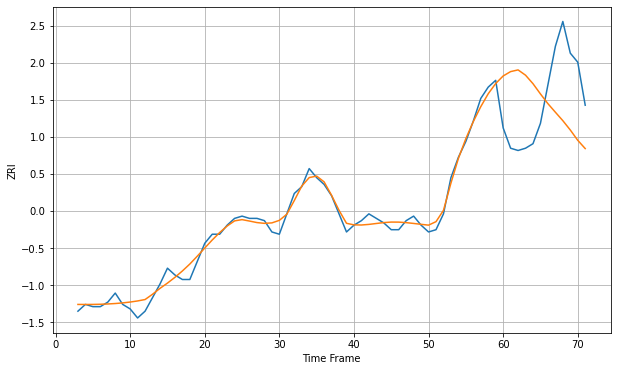

Wall time: 9.99 s
6457 2.9089106913958767 29.43567351891839 [1254.91929758 1256.85086935 1257.5998093  1255.26432784 1251.50708282
 1246.97817874 1242.685836   1238.90157573 1235.17284472 1231.04561155
 1226.49931083 1222.84072271]

Got an mse at 0.0099 in round 105 and stopped training



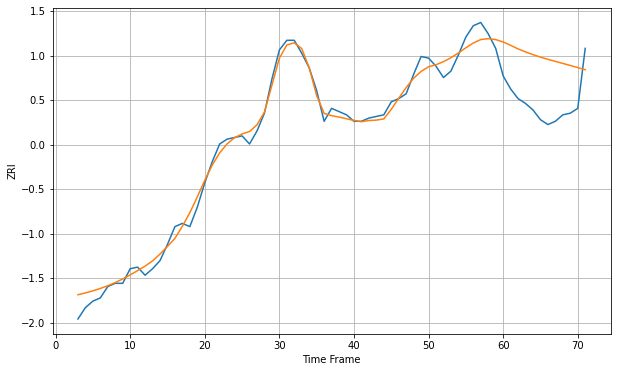

Wall time: 10.6 s
6460 5.204987410272597 30.874281617563714 [1457.96006116 1455.89674619 1453.68577258 1451.82744697 1450.12135355
 1448.60555588 1447.24310687 1445.96896762 1444.72143321 1443.45718045
 1442.15665312 1440.82452604]


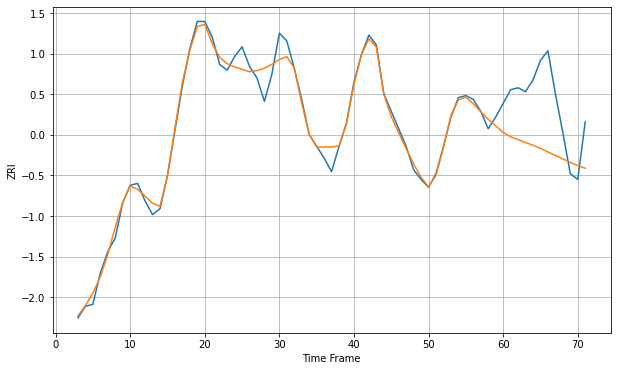

Wall time: 19.7 s
6484 4.579361870574309 28.66898121891901 [1418.12126298 1415.8331206  1414.48454958 1412.95941623 1411.52254082
 1409.93271989 1408.11697205 1406.30960466 1404.5271244  1402.78980329
 1401.12038783 1399.77954591]

Got an mse at 0.0100 in round 165 and stopped training



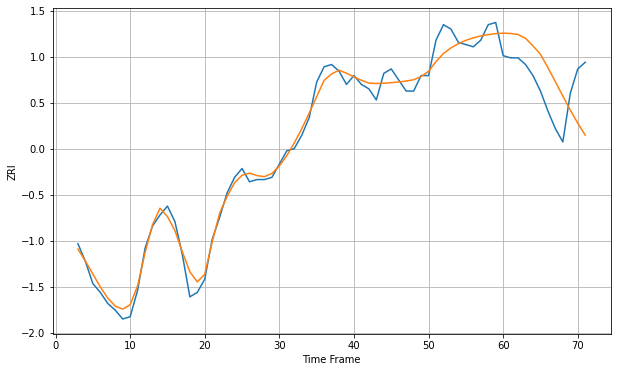

Wall time: 11.8 s
6489 4.350628329029897 18.121069623536346 [1258.18072964 1258.02513641 1257.55614228 1255.84182934 1252.41133627
 1248.62424791 1242.60925955 1236.22916011 1229.74428887 1223.42908234
 1217.49351405 1212.07623967]

Got an mse at 0.0100 in round 71 and stopped training



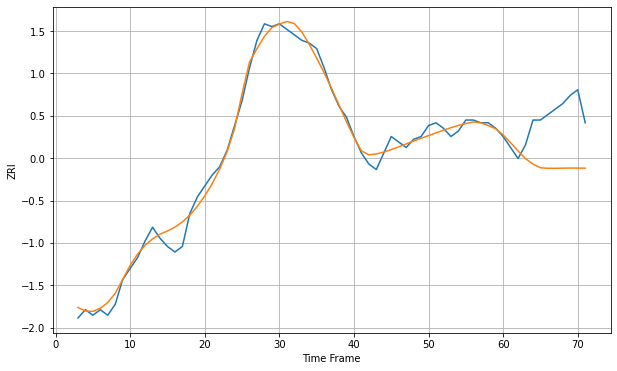

Wall time: 8.17 s
6492 3.0222507522831723 17.745301098680216 [1213.57637095 1210.73827139 1207.7497506  1204.96171805 1202.9658735
 1201.62975082 1201.45084685 1201.4433906  1201.49306907 1201.53071298
 1201.52716252 1201.48115228]

Got an mse at 0.0099 in round 90 and stopped training



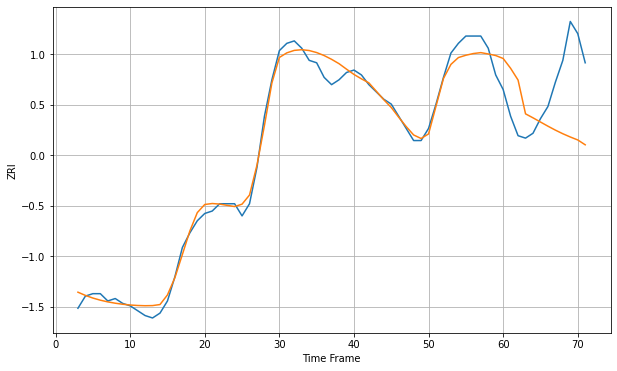

Wall time: 10.2 s
6511 3.8327111738846713 25.651822378077537 [1269.77659637 1265.73051228 1260.87817921 1246.98732537 1245.35014695
 1243.63054388 1241.91822791 1240.29181524 1238.8024943  1237.46421135
 1236.24946071 1234.2520814 ]

Got an mse at 0.0100 in round 109 and stopped training



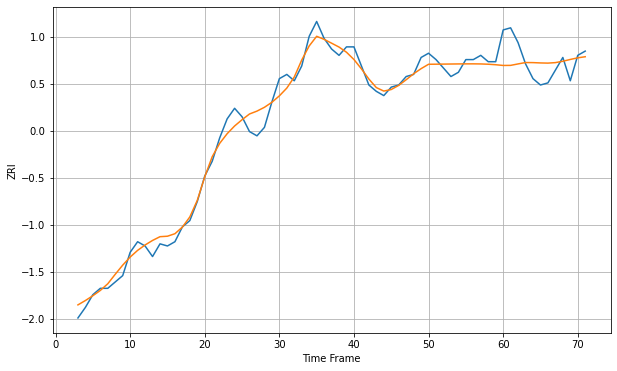

Wall time: 9.81 s
6512 4.3247675800432805 9.468342746620838 [1313.23062423 1313.26665948 1313.95225151 1314.60581195 1314.57173781
 1314.42026533 1314.33796099 1314.56744959 1315.20820685 1316.06536791
 1316.82977524 1317.34337623]

Got an mse at 0.0098 in round 130 and stopped training



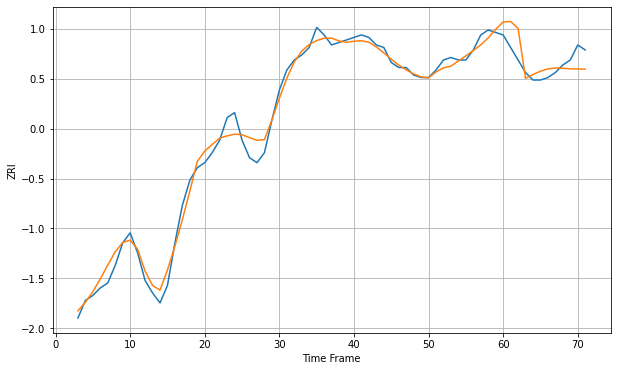

Wall time: 10.7 s
6513 3.5885753353988203 6.429119277653063 [1256.19908343 1256.3805872  1253.61128738 1233.68845085 1235.19841057
 1236.53368803 1237.43936211 1237.80656363 1237.69652438 1237.46384456
 1237.42544008 1237.34888749]

Got an mse at 0.0099 in round 62 and stopped training



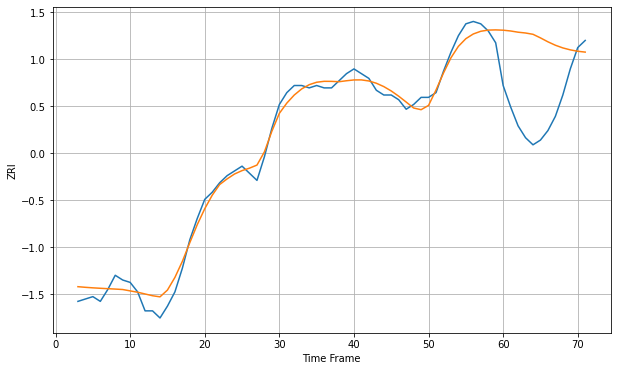

Wall time: 9.49 s
6515 3.830184693867214 31.47017696359486 [1245.32181749 1244.98950971 1244.47613357 1244.13837981 1243.59047216
 1242.0777239  1240.42315563 1238.97815852 1237.85089549 1237.02738803
 1236.43766168 1236.08227772]

Got an mse at 0.0099 in round 107 and stopped training



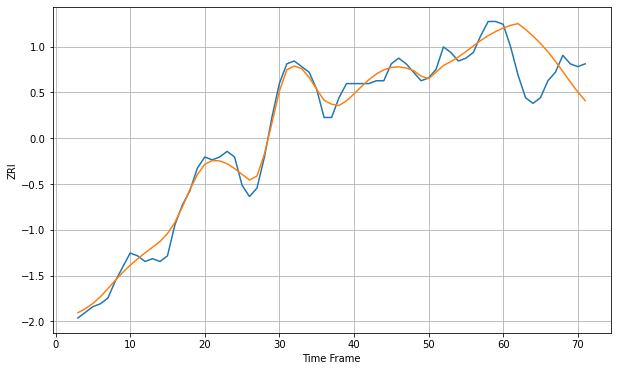

Wall time: 9.92 s
6516 3.227659533986427 14.027075340165034 [1270.69293938 1271.61259748 1272.23793667 1270.18905937 1267.85971227
 1265.23189611 1262.26830028 1258.9205347  1255.26218907 1251.57329069
 1248.05007049 1244.98360455]

Got an mse at 0.0098 in round 53 and stopped training



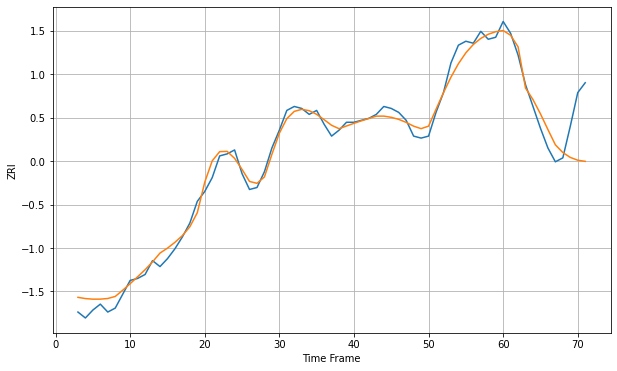

Wall time: 9.08 s
6519 4.141729416030031 16.519159374248574 [1289.41645344 1287.00555907 1281.17211652 1260.30896554 1254.46043827
 1247.26353319 1239.32265632 1231.60391007 1227.70209846 1225.22486927
 1223.80999447 1223.23139113]

Got an mse at 0.0100 in round 82 and stopped training



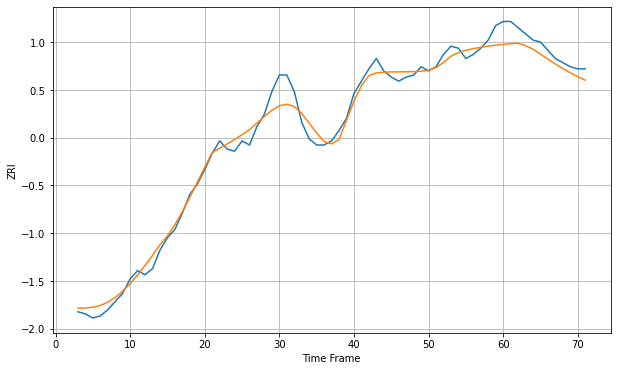

Wall time: 10.1 s
6604 4.723191889736281 6.280417186963107 [1344.82615235 1345.21787614 1345.45844357 1344.21596029 1342.5425195
 1340.13305801 1337.6990061  1335.33620129 1333.11156117 1331.06000392
 1329.18808791 1327.47889657]

Got an mse at 0.0100 in round 151 and stopped training



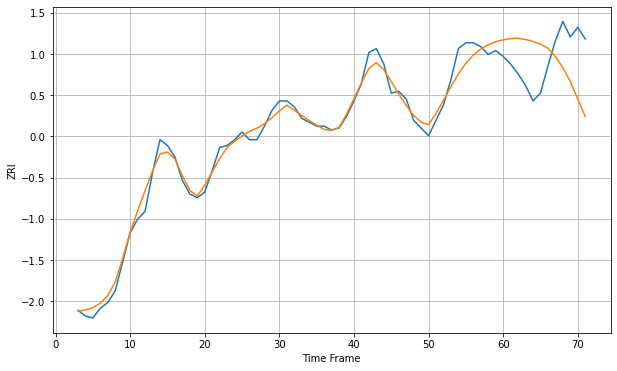

Wall time: 10.6 s
6605 4.364574217736 24.056723848952434 [1417.54778883 1418.14296363 1418.30314699 1417.70422167 1416.74156606
 1415.28283504 1413.15159921 1408.96119278 1403.12820999 1396.08937023
 1387.04646333 1377.88702157]

Got an mse at 0.0099 in round 46 and stopped training



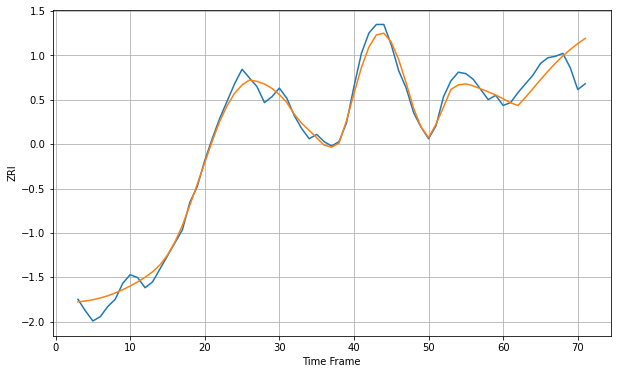

Wall time: 8.9 s
6606 5.69957466145214 14.917727255748282 [1415.6167018  1412.81282409 1410.99055399 1416.6964572  1422.72130581
 1428.79000959 1434.66836646 1440.1795885  1445.21815491 1449.74702161
 1453.78047174 1457.36326391]

Got an mse at 0.0100 in round 136 and stopped training



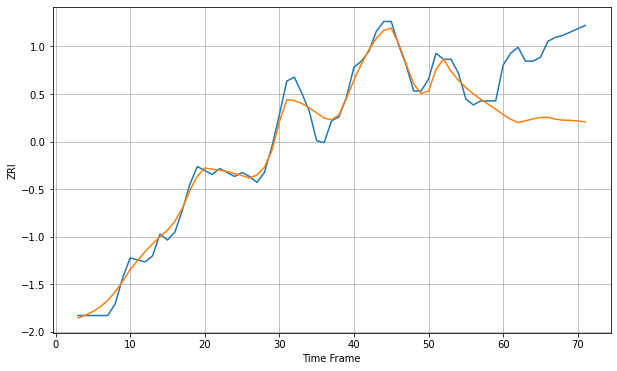

Wall time: 11.4 s
6607 4.8029939800826815 37.94167864808402 [1302.15171202 1299.83000396 1298.09935161 1299.03966733 1299.94691235
 1300.70221952 1300.79081319 1299.83312727 1299.33255093 1299.22452944
 1298.91831967 1298.45696783]

Got an mse at 0.0098 in round 58 and stopped training



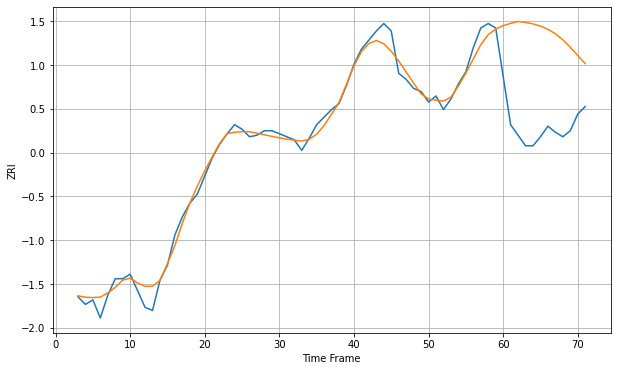

Wall time: 7.75 s
6608 5.666208599335532 63.07159796755166 [1374.53802264 1376.09320635 1377.34003947 1376.74069112 1375.74700972
 1374.2712474  1372.16300755 1369.21090293 1365.22924541 1360.27511967
 1354.80431571 1349.4207635 ]

Got an mse at 0.0099 in round 50 and stopped training



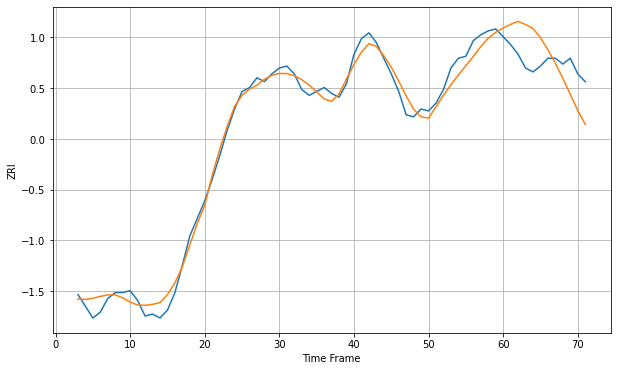

Wall time: 7.06 s
6610 4.670492910194658 15.434968339095896 [1332.49948032 1334.34611743 1335.82263514 1334.28732324 1332.17101202
 1327.4927815  1321.34119961 1314.41606948 1306.7032054  1298.4823263
 1290.28695417 1283.12757587]

Got an mse at 0.0099 in round 164 and stopped training



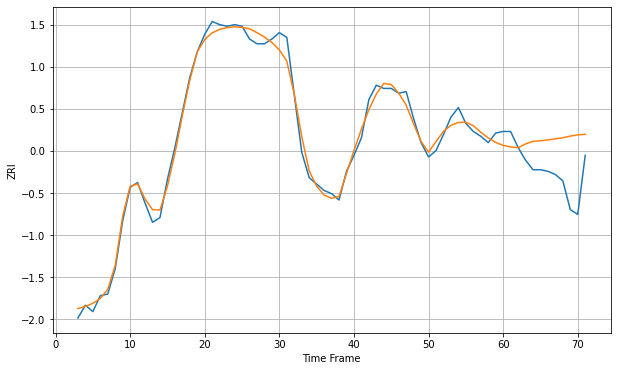

Wall time: 10.6 s
6614 4.795301956462243 24.70505032988618 [1475.23870896 1474.305387   1473.76658081 1476.17330182 1477.80344275
 1478.15941199 1478.69836817 1479.35925972 1480.04773241 1481.09395525
 1481.85001843 1482.18453442]

Got an mse at 0.0099 in round 156 and stopped training



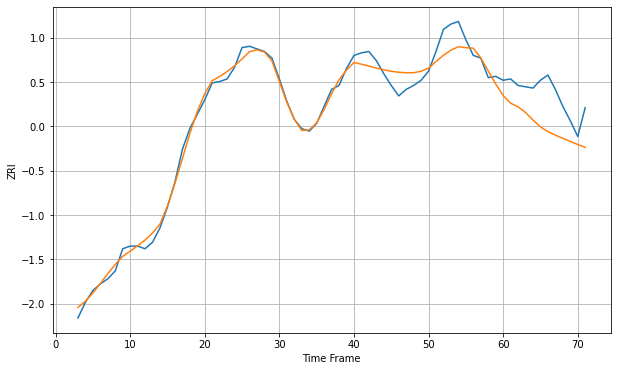

Wall time: 9.68 s
6615 7.164639746099498 25.700894295440293 [1458.32780045 1452.42108503 1449.64934976 1445.29895674 1439.54444525
 1434.28185668 1430.65819654 1427.96497866 1425.53953574 1423.16843718
 1420.8016658  1418.62988623]

Got an mse at 0.0099 in round 126 and stopped training



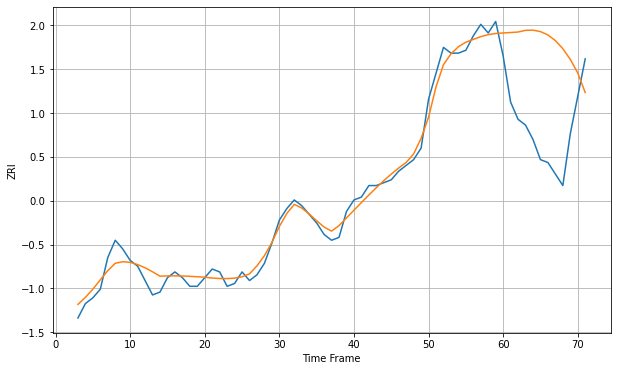

Wall time: 9.83 s
6704 3.220441841003626 33.311297586213634 [985.00235719 985.15887145 985.33376796 985.9166391  985.99000826
 985.48466049 984.31338015 982.35686182 979.54039766 975.83557011
 971.11422888 964.32899672]

Got an mse at 0.0099 in round 145 and stopped training



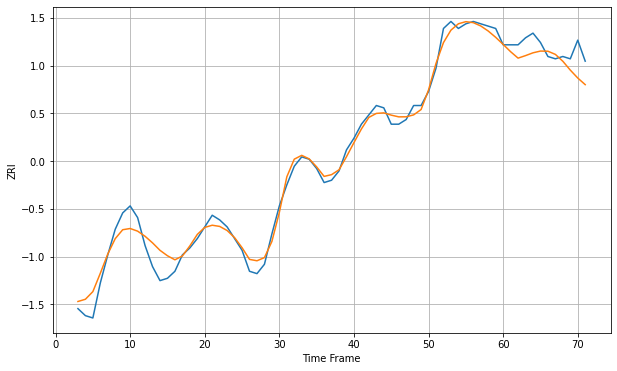

Wall time: 10.3 s
6705 4.4204400822539505 6.9793313088339755 [1006.17525982 1003.05022199 1000.2953521  1001.37239111 1002.57206003
 1003.32006573 1003.2565929  1001.89630399  998.96041892  995.17106788
  991.77914561  988.93905608]

Got an mse at 0.0099 in round 91 and stopped training



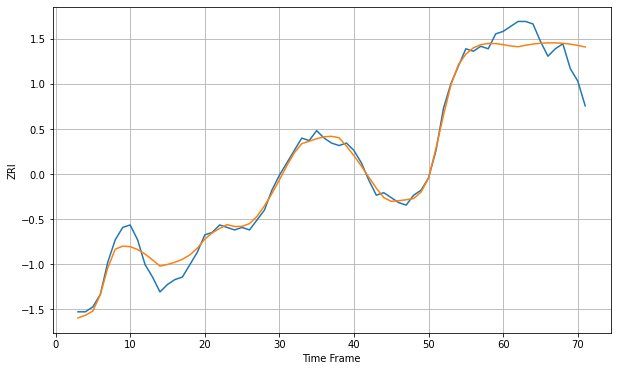

Wall time: 7.7 s
6708 3.411195452136868 10.218209752446553 [1008.66197527 1008.13716703 1007.80929256 1008.41654611 1008.89651277
 1009.21615513 1009.37546571 1009.37121939 1009.1998202  1008.8614185
 1008.36288484 1007.71815285]

Got an mse at 0.0100 in round 155 and stopped training



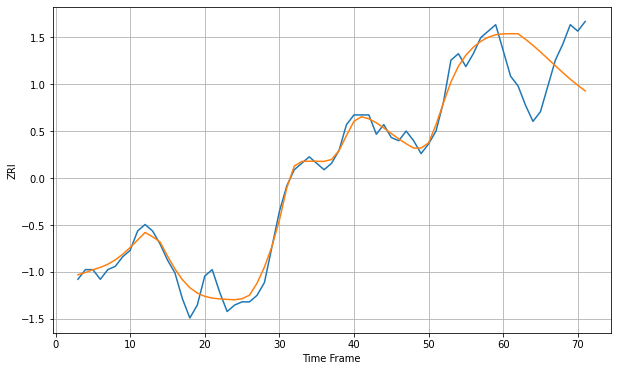

Wall time: 10.6 s
6710 3.0654518339443224 15.720814338380604 [921.15232321 921.19695173 921.17534459 919.47166292 917.58366893
 915.5481728  913.41649619 911.25253249 909.12482062 907.09436043
 905.20354129 903.47128364]

Got an mse at 0.0098 in round 86 and stopped training



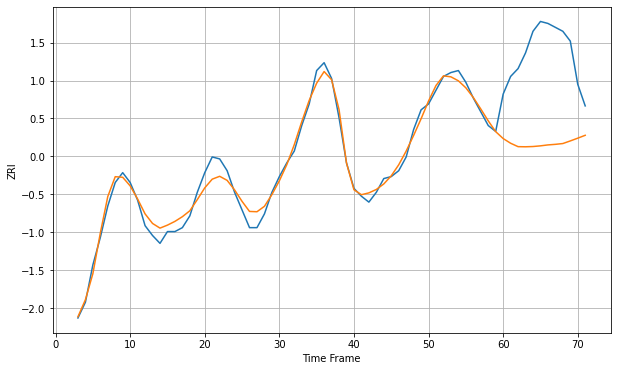

Wall time: 8.51 s
6770 4.1712365624783745 47.60836816349597 [1108.37618695 1105.98503289 1104.24516447 1104.18051433 1104.31259525
 1104.655841   1105.13188512 1105.42629163 1105.83032613 1107.16306979
 1108.56900483 1110.0311435 ]

Got an mse at 0.0099 in round 304 and stopped training



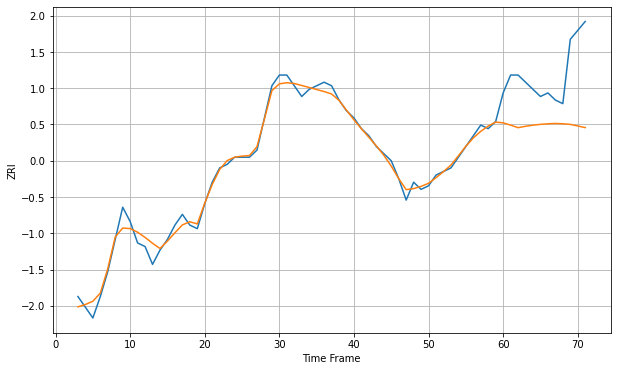

Wall time: 13.6 s
6790 1.862410471645734 16.103865993921236 [863.62051347 862.9836207  862.27065154 862.66005822 862.9698287
 863.20211854 863.36067668 863.45038718 863.36148102 863.18877292
 862.74889892 862.28845376]

Got an mse at 0.0099 in round 207 and stopped training



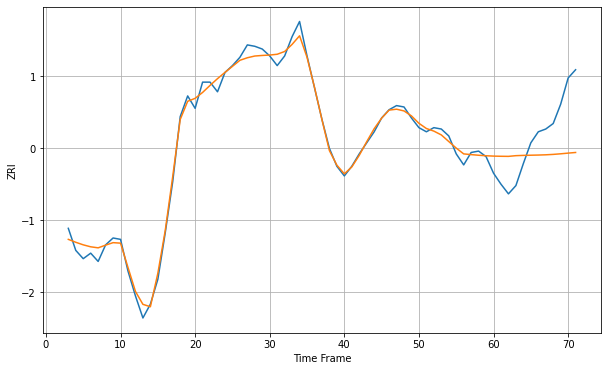

Wall time: 10.7 s
6810 4.7327073624610545 30.112266187294864 [1648.36931164 1648.24731561 1648.17958757 1648.68831576 1648.89000014
 1649.01948993 1649.13595329 1649.31469192 1649.61408731 1650.04181129
 1650.53846535 1651.00117861]

Got an mse at 0.0100 in round 193 and stopped training



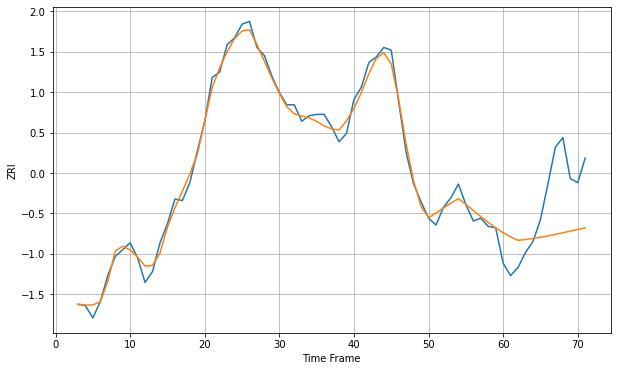

Wall time: 10 s
6824 5.282722111251758 38.261846555023524 [1834.33383466 1831.37488048 1828.83905679 1829.41787676 1830.16628567
 1831.05923277 1832.07439648 1833.18677093 1834.36684867 1835.58117334
 1836.79421942 1837.97103819]

Got an mse at 0.0100 in round 180 and stopped training



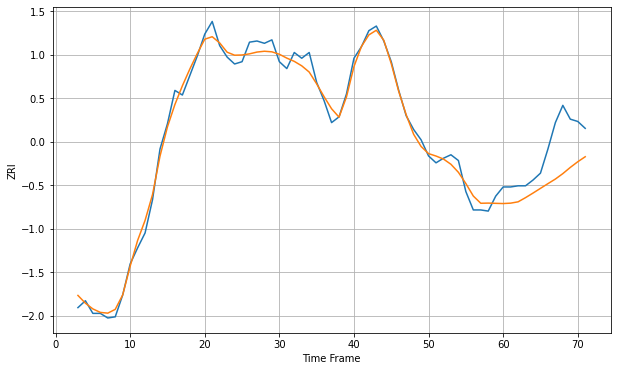

Wall time: 11.3 s
6825 6.8631803766007 30.90785031902491 [1629.56659366 1629.90940735 1631.05445701 1634.6999686  1638.66779908
 1642.77119593 1646.87131195 1650.88027104 1655.60785199 1661.00268423
 1665.92271169 1670.29004015]

Got an mse at 0.0100 in round 315 and stopped training



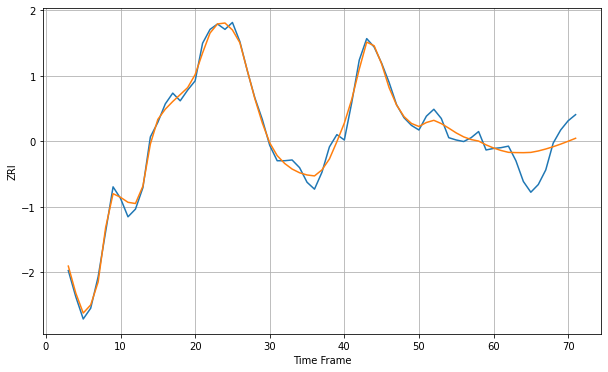

Wall time: 13.6 s
6830 8.38019111287321 27.31780319812109 [2313.5966884  2310.35940139 2307.93571966 2307.59766038 2307.49352236
 2307.84624131 2309.6990034  2312.26757846 2315.25845228 2318.63735937
 2322.33624077 2326.23232461]


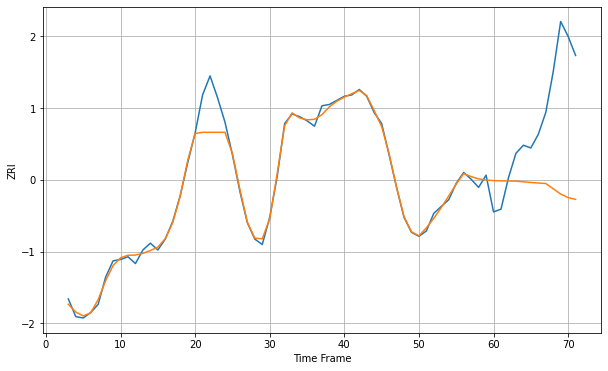

Wall time: 17.9 s
6851 7.864851114305824 67.99360029101143 [1814.00970909 1813.82079313 1813.7053339  1813.62706027 1813.11588217
 1812.6278981  1812.22812287 1811.84991328 1807.99677778 1804.12061816
 1801.50511393 1800.20513252]

Got an mse at 0.0098 in round 152 and stopped training



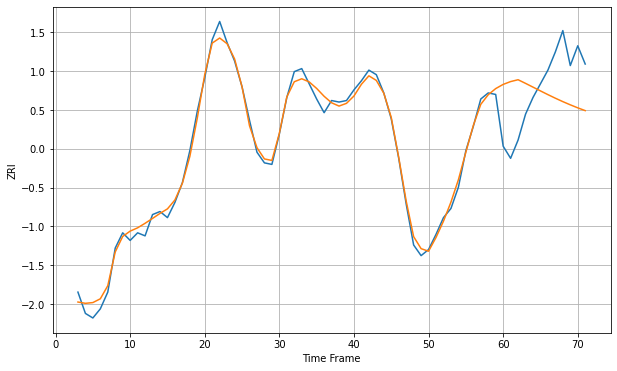

Wall time: 9.76 s
6854 4.3532304050599135 32.77586916169652 [1838.60216047 1840.46836121 1841.68210971 1839.28840211 1836.81385096
 1834.3272537  1831.88389679 1829.52650244 1827.28467411 1825.17488877
 1823.20171295 1821.35971681]

Got an mse at 0.0100 in round 179 and stopped training



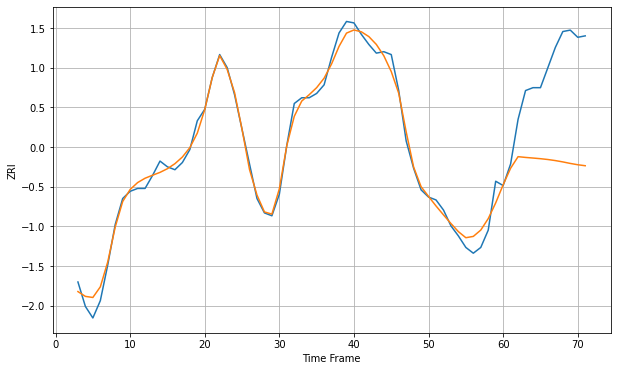

Wall time: 9.88 s
6855 5.816965611781725 65.00000744032599 [1798.54727402 1810.03704423 1818.06414232 1817.5433657  1817.11247345
 1816.65977485 1816.0888105  1815.34540745 1814.42539216 1813.36890846
 1812.46096906 1811.77265626]

Got an mse at 0.0100 in round 200 and stopped training



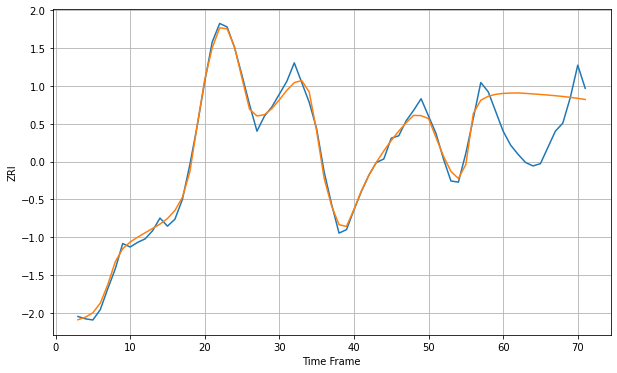

Wall time: 10.9 s
6902 6.1806693777148105 42.129645227638754 [2134.60251771 2134.88980251 2135.03515972 2134.61972492 2134.18037366
 2133.70928406 2133.19446025 2132.6201015  2131.96739837 2131.21593605
 2130.3459042  2129.34115743]

Got an mse at 0.0099 in round 161 and stopped training



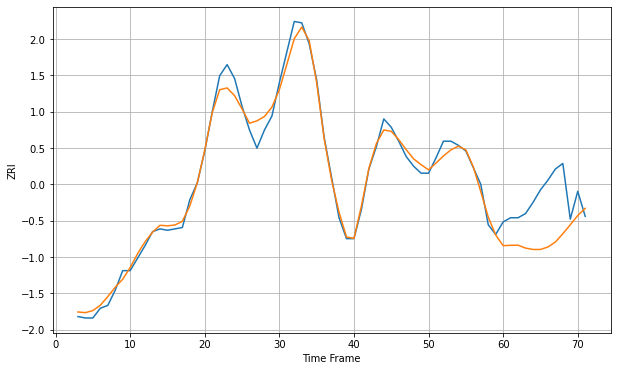

Wall time: 10.4 s
6906 5.938206712998048 32.427102127166165 [1898.92657531 1899.21170662 1899.27242365 1897.20271714 1896.21333701
 1896.21375862 1897.98166041 1901.55621991 1907.49798153 1913.96838768
 1920.59317728 1925.74675893]

Got an mse at 0.0098 in round 36 and stopped training



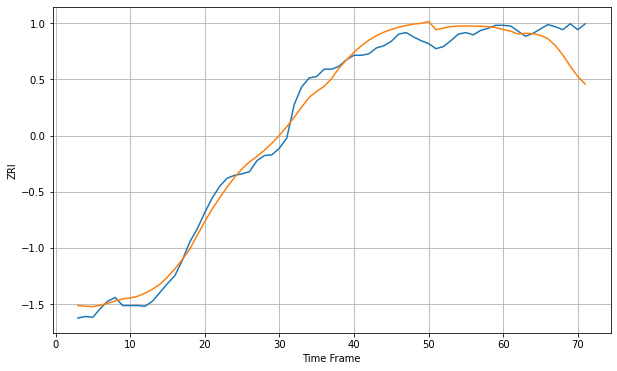

Wall time: 6.57 s
7002 14.749837974043976 37.24659209375634 [1828.28564723 1826.0500682  1822.17702008 1822.98321385 1822.55775798
 1820.36103786 1815.63040924 1806.40065976 1793.39781199 1777.99478993
 1764.01851736 1753.68726417]

Got an mse at 0.0099 in round 33 and stopped training



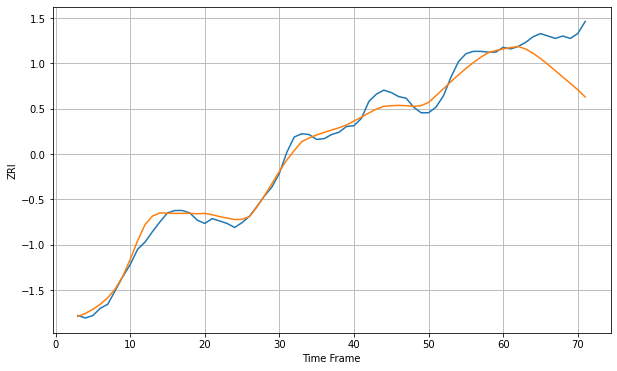

Wall time: 7.19 s
7003 9.603727667895471 44.28152003408261 [1645.00403244 1646.62268364 1648.06152936 1644.96055886 1639.72474446
 1633.1128699  1625.76112987 1618.02190684 1610.16683201 1602.39348189
 1594.47834182 1585.48797224]

Got an mse at 0.0099 in round 136 and stopped training



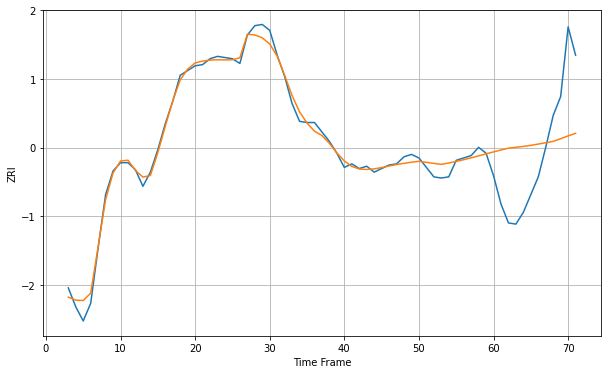

Wall time: 10.2 s
7030 5.550058655071 50.84391104551371 [2521.12458711 2522.73517886 2524.29801934 2525.00725214 2525.77963296
 2526.68430537 2527.74524328 2528.91139837 2530.064769   2532.28163188
 2534.68737654 2536.82350228]

Got an mse at 0.0099 in round 118 and stopped training



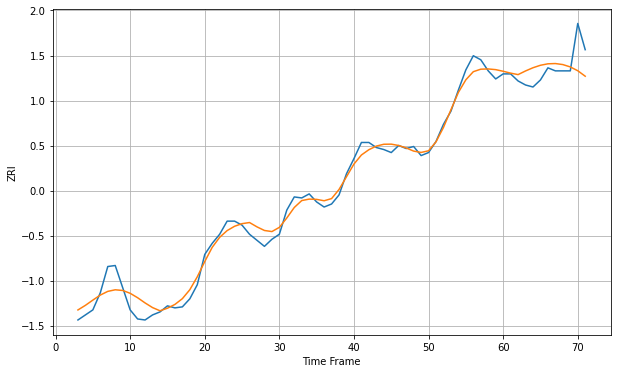

Wall time: 8.77 s
7055 9.218333347750072 17.86206678136552 [1738.60277329 1736.74686693 1735.29467306 1738.91621856 1742.09500493
 1744.55434258 1745.99758981 1746.2544062  1745.23798871 1742.9014023
 1739.12888244 1733.69535153]

Got an mse at 0.0098 in round 89 and stopped training



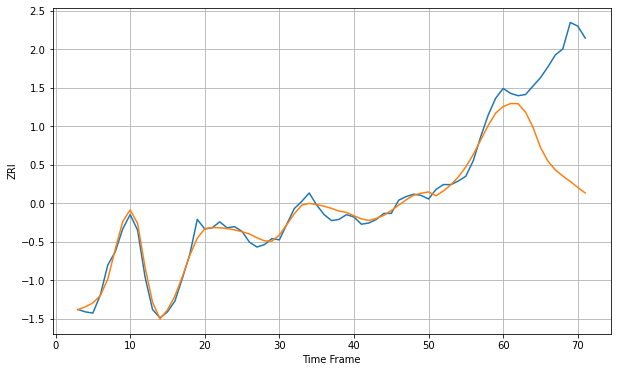

Wall time: 8.58 s
7093 5.375318962076384 83.60516277453893 [1972.99967936 1975.46124248 1975.37781089 1968.30186006 1955.74702578
 1938.98037143 1927.5377939  1920.14982802 1915.11057245 1910.62390313
 1905.63153922 1900.98035705]

Got an mse at 0.0095 in round 45 and stopped training



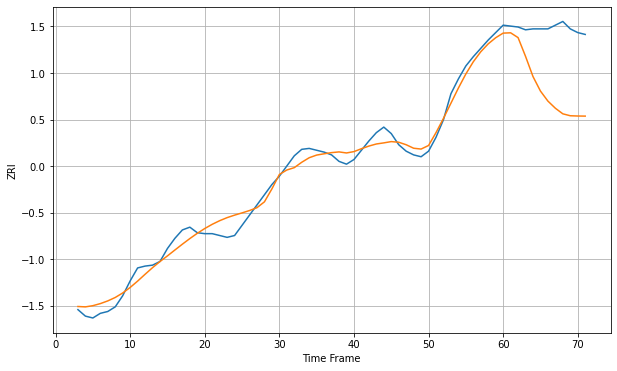

Wall time: 7.09 s
7109 9.556559542599107 68.88594761518216 [1610.42777462 1610.7608479  1605.57817228 1585.35165987 1563.54990999
 1547.88376952 1537.05847418 1529.33801386 1523.32404281 1521.24655536
 1520.96544801 1520.85731628]

Got an mse at 0.0087 in round 29 and stopped training



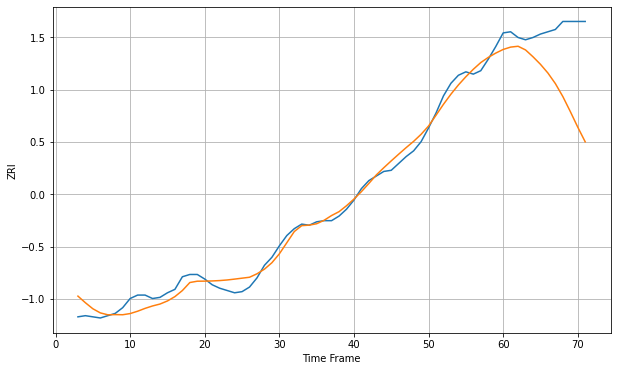

Wall time: 7.13 s
7111 7.045508443869913 54.08905271384006 [1428.55019262 1430.60306471 1431.34052489 1428.13854396 1422.16103784
 1415.57216876 1407.95577663 1398.71870096 1387.42312758 1374.35066284
 1360.69082901 1347.84143381]

Got an mse at 0.0100 in round 51 and stopped training



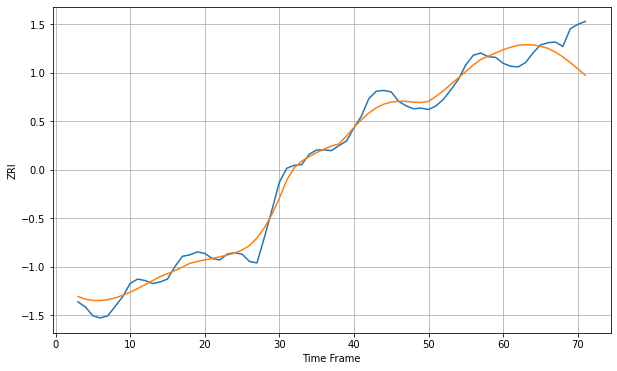

Wall time: 7.6 s
7201 11.945852965222038 34.36555192987753 [1758.39448371 1761.93170693 1764.53696088 1765.30308235 1764.92842428
 1763.30824903 1760.36724298 1755.30828156 1748.74228121 1740.98357287
 1732.46004095 1723.89653754]

Got an mse at 0.0099 in round 61 and stopped training



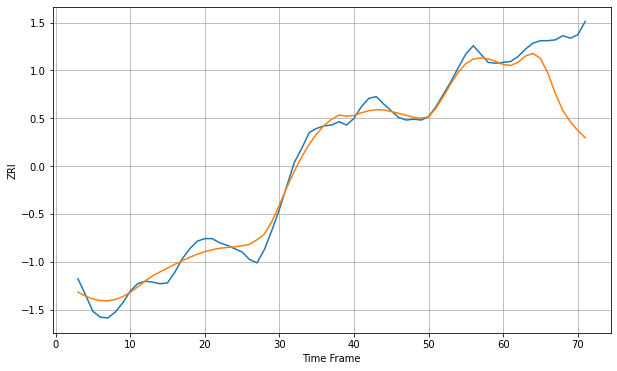

Wall time: 8.1 s
7202 10.692813854258858 68.84362065627043 [1691.46347238 1690.36190673 1694.10531464 1701.70668917 1704.75211001
 1698.81279897 1680.99990433 1656.557435   1636.47742058 1622.9163012
 1612.65017047 1603.89793229]

Got an mse at 0.0099 in round 30 and stopped training



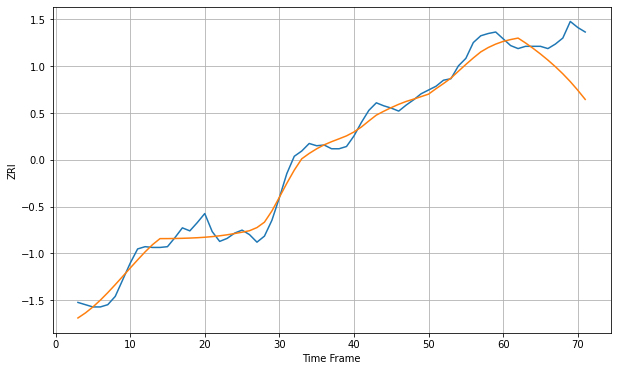

Wall time: 7.06 s
7206 11.879348003940827 45.73876111152031 [1717.5120122  1719.97166212 1721.94593234 1715.45777426 1708.41382349
 1700.83322192 1692.7112922  1683.98333778 1674.51115407 1664.12985436
 1652.75777166 1640.52463206]

Got an mse at 0.0099 in round 45 and stopped training



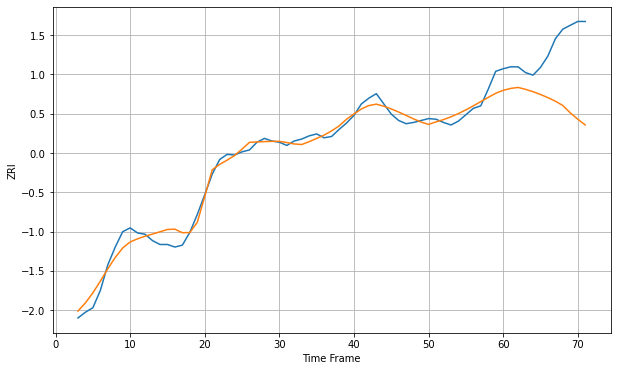

Wall time: 6.75 s
7302 12.266868716084584 92.61691651551233 [2477.23919052 2480.18766076 2481.76655505 2478.78262684 2475.11329683
 2470.76318362 2465.77204389 2460.23306671 2453.47427273 2441.95807862
 2432.10891345 2423.08766285]

Got an mse at 0.0099 in round 93 and stopped training



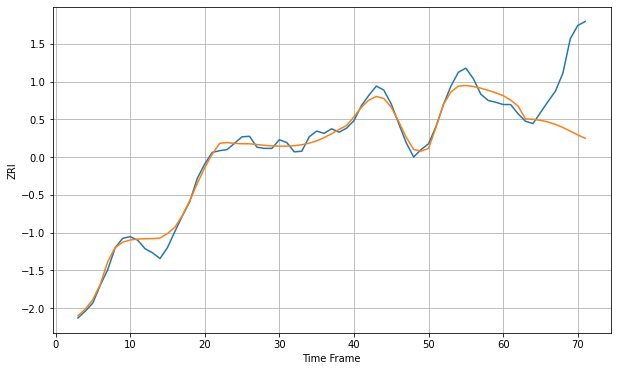

Wall time: 8.9 s
7960 12.177247330944077 98.60139454319771 [2236.50330462 2228.71271768 2218.42603954 2196.0618875  2195.34208053
 2193.64735277 2190.76594254 2186.56899875 2181.15552676 2174.91824178
 2168.45782758 2162.41896315]

Got an mse at 0.0099 in round 124 and stopped training



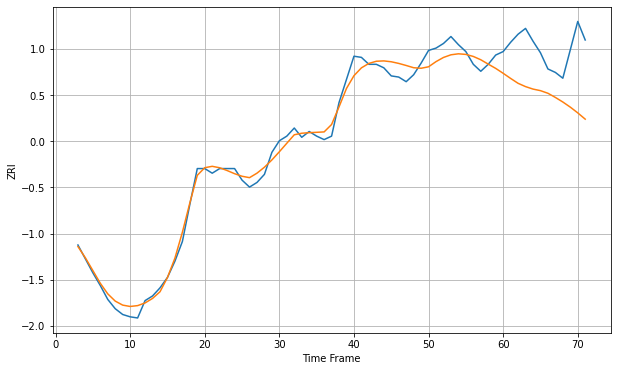

Wall time: 9.24 s
8901 7.4620594011870285 43.87607055961361 [1727.25726056 1722.82645299 1718.61195591 1715.7579597  1713.62404204
 1712.26988365 1710.01498582 1706.41316863 1702.46117459 1698.0359802
 1693.0820273  1687.65489   ]

Got an mse at 0.0100 in round 74 and stopped training



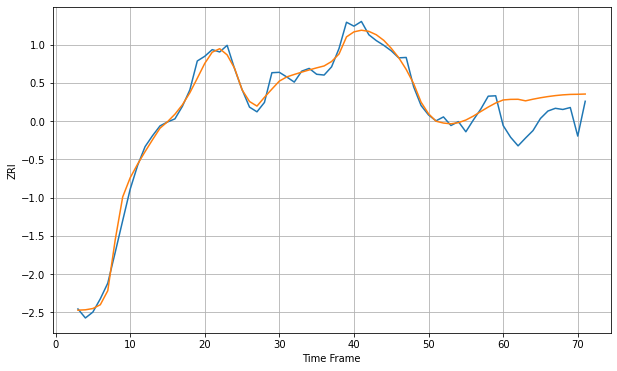

Wall time: 7.88 s
10001 19.086063502894582 72.35025573283524 [3720.32250735 3721.84903826 3722.06451306 3718.05849542 3722.30144816
 3725.92399651 3728.98769884 3731.4851651  3733.36243635 3734.53075677
 3734.87053942 3735.47291965]

Got an mse at 0.0100 in round 424 and stopped training



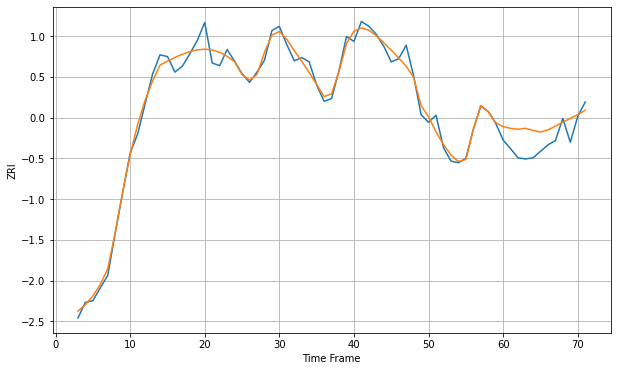

Wall time: 16.6 s
10002 14.814669005400557 36.18103448748362 [3465.92355023 3462.7276781  3461.00965602 3462.84765261 3458.87727674
 3455.98614204 3459.91233402 3466.76148304 3474.08733755 3481.24628442
 3488.09693815 3496.37776128]

Got an mse at 0.0100 in round 157 and stopped training



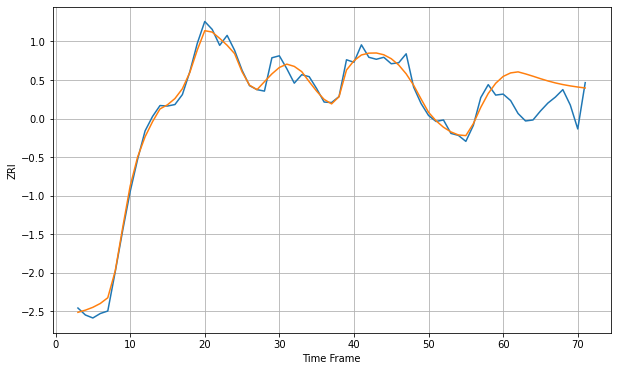

Wall time: 9.57 s
10003 14.331513503357163 60.445118468538276 [3698.51070651 3705.59012187 3707.6809074  3703.58781263 3698.9495282
 3694.02934738 3689.4437     3685.47176202 3682.17246552 3679.47175976
 3677.22910633 3675.28502296]

Got an mse at 0.0099 in round 116 and stopped training



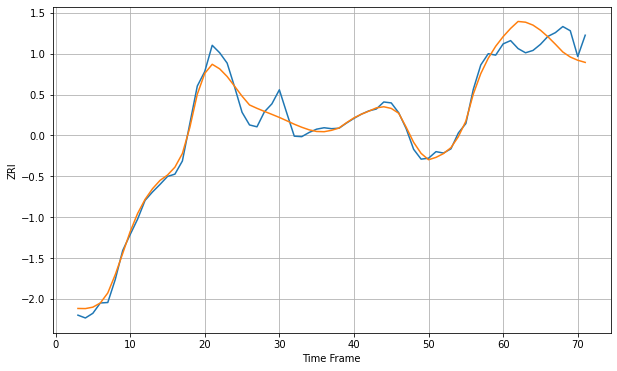

Wall time: 9.25 s
10005 17.748624728177575 43.29355711800626 [3716.50967887 3733.99357576 3748.84435302 3747.28741184 3741.04543025
 3730.2239327  3716.17828869 3700.30097827 3683.67819381 3672.94752377
 3666.08698966 3661.47511189]

Got an mse at 0.0099 in round 141 and stopped training



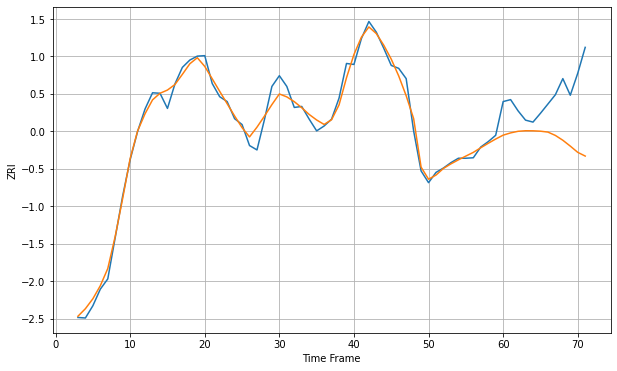

Wall time: 9.65 s
10009 16.056588570307753 102.47459219472641 [3671.25352807 3675.89588562 3679.14747924 3680.27784565 3680.15946774
 3679.37184586 3677.53383219 3670.69689914 3660.82832679 3648.81576599
 3636.06853913 3628.4519059 ]


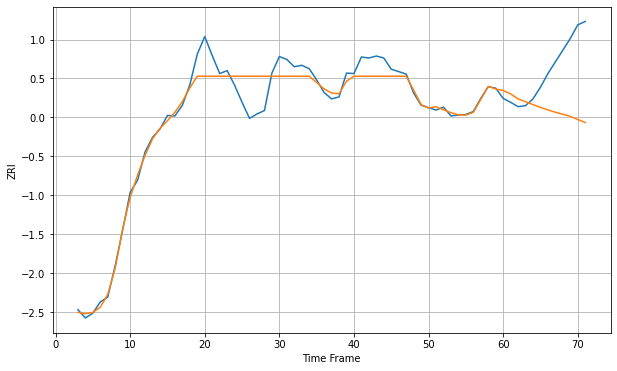

Wall time: 17.6 s
10010 27.88810911310897 109.05026996113071 [3675.23175576 3668.23487267 3657.95785823 3652.16739251 3646.24118607
 3640.51096448 3635.24085315 3630.55495108 3626.42683395 3622.2398023
 3615.62206427 3609.50386118]

Got an mse at 0.0099 in round 103 and stopped training



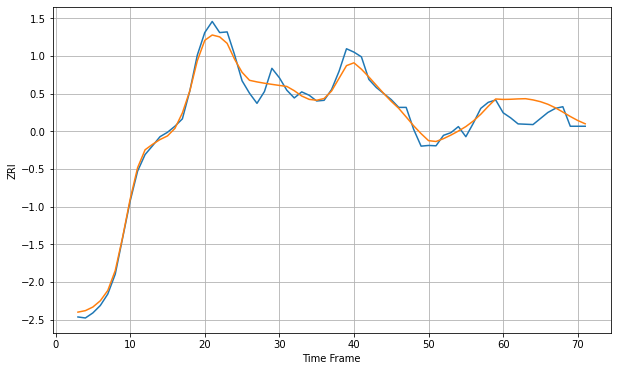

Wall time: 9.84 s
10011 21.563740034167573 46.313185131545104 [3826.6162703  3827.10421574 3828.1838339  3828.79645488 3825.23114232
 3819.93924103 3812.2306694  3801.77908342 3789.17846113 3776.0223012
 3764.07451498 3754.31392897]

Got an mse at 0.0100 in round 203 and stopped training



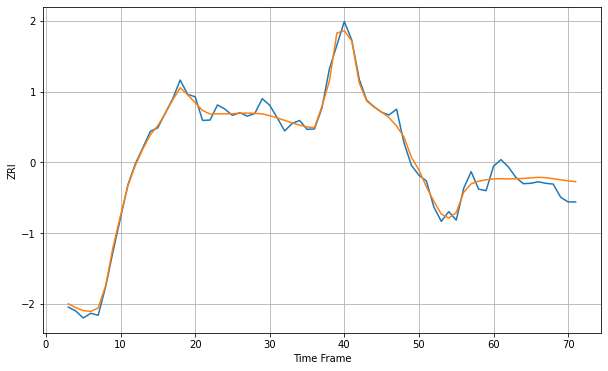

Wall time: 10.6 s
10012 16.664298662253213 33.0144905179576 [3539.14410172 3539.92323226 3539.22756793 3539.68781261 3540.59868337
 3541.88304695 3543.4505308  3542.53789267 3539.86606216 3537.05685776
 3534.37992716 3532.28607764]

Got an mse at 0.0099 in round 109 and stopped training



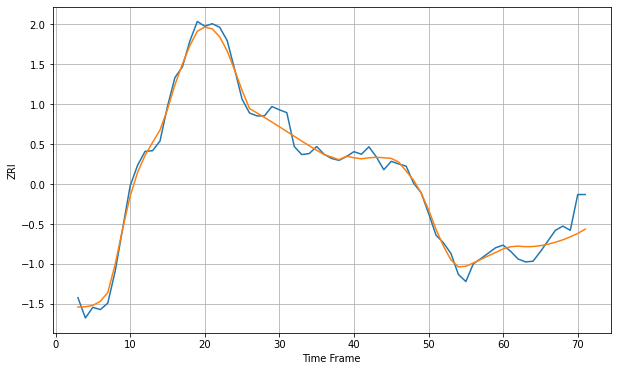

Wall time: 10 s
10013 23.84614810165803 55.06036264340221 [4430.27163774 4437.08685136 4438.96684231 4437.20059266 4437.71648977
 4440.31202296 4444.75879358 4450.871452   4458.54558655 4467.73055847
 4478.34827078 4491.57710734]

Got an mse at 0.0100 in round 219 and stopped training



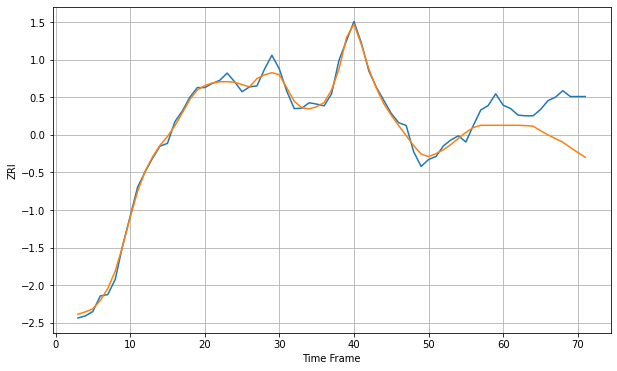

Wall time: 11.4 s
10014 21.57248018250801 107.2195134580319 [3771.51089581 3771.51089581 3771.51089581 3770.57339847 3769.13587685
 3755.96982946 3743.75053902 3733.12279019 3722.29559877 3707.24131154
 3692.62990663 3678.77058183]

Got an mse at 0.0100 in round 149 and stopped training



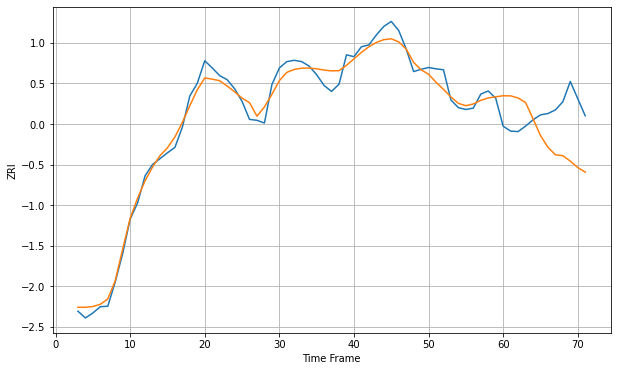

Wall time: 9.87 s
10016 20.123648693212754 100.31738209455773 [3582.4110919  3582.1594133  3577.49893338 3567.51404459 3531.50379126
 3494.56964965 3468.2538891  3451.62789114 3449.4962483  3437.55926803
 3423.36666904 3413.25800409]

Got an mse at 0.0100 in round 122 and stopped training



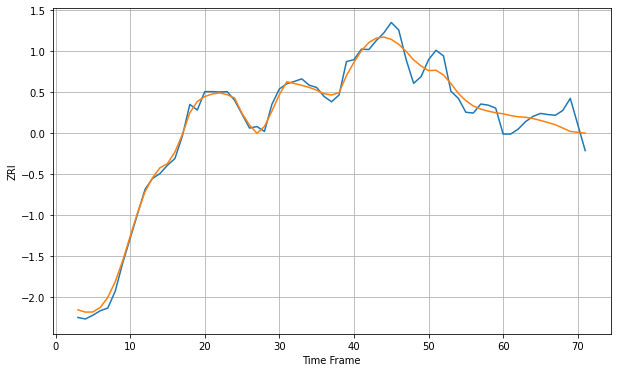

Wall time: 10.1 s
10017 21.236741428855456 41.41689599006392 [3497.96706862 3493.40043289 3490.02443544 3488.79949141 3485.33663533
 3480.33967787 3474.84360079 3468.76307387 3459.98250779 3451.04468344
 3448.69617318 3446.4463583 ]

Got an mse at 0.0100 in round 64 and stopped training



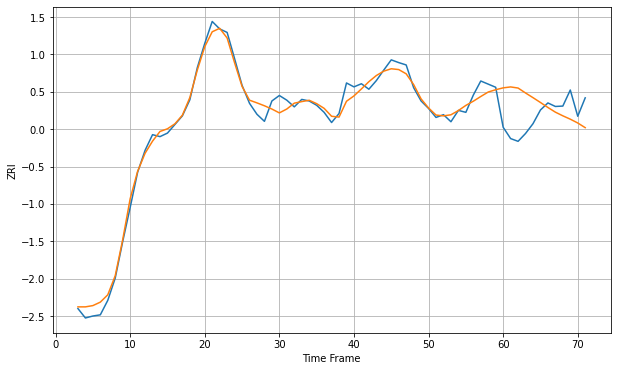

Wall time: 7.73 s
10018 18.219158035942588 78.57540433161199 [3689.49378603 3691.87126915 3689.03946537 3676.43367365 3664.4956986
 3652.15416383 3639.41981925 3627.47702175 3618.11304905 3609.53072016
 3599.80463206 3587.83869555]

Got an mse at 0.0099 in round 114 and stopped training



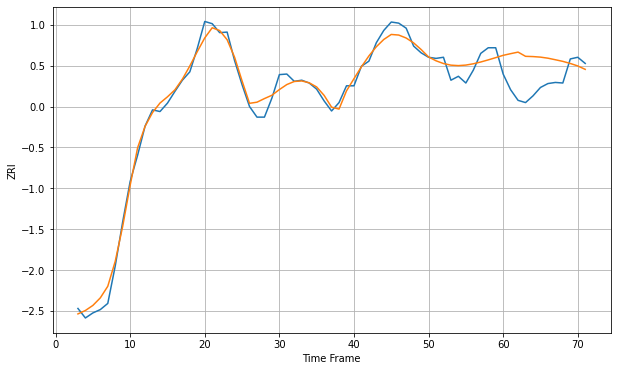

Wall time: 9.81 s
10019 14.831406663144742 52.46796948118543 [3633.44768618 3636.42001471 3639.2272101  3631.69124544 3631.23275814
 3630.26152352 3628.35754957 3625.56932793 3622.6635663  3618.92242452
 3614.50438503 3608.38725169]

Got an mse at 0.0100 in round 57 and stopped training



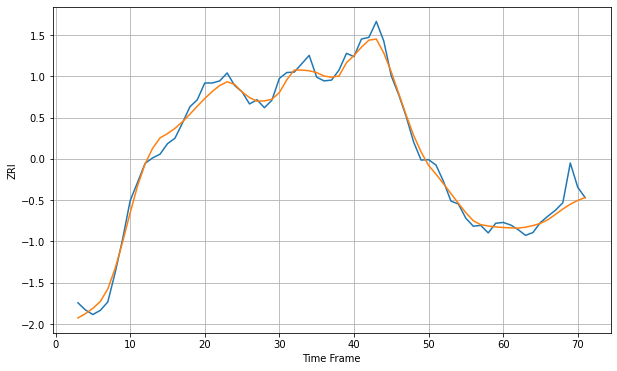

Wall time: 7.86 s
10021 18.825552962078188 31.563340203687506 [3104.92401244 3104.00759304 3103.24426846 3105.67395392 3109.48843176
 3114.7884258  3123.55894898 3136.11069766 3149.03764268 3160.46817688
 3169.62675354 3176.37199858]

Got an mse at 0.0100 in round 103 and stopped training



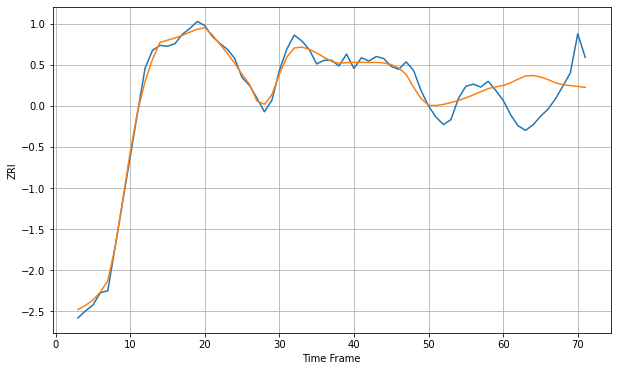

Wall time: 8.86 s
10022 17.904556399693295 86.7025371888291 [3987.75547769 3994.31129884 4003.14537514 4010.85556872 4011.95028356
 4008.48871186 4002.10963432 3994.27674597 3989.61822752 3987.51557502
 3985.36537926 3983.31515616]

Got an mse at 0.0100 in round 95 and stopped training



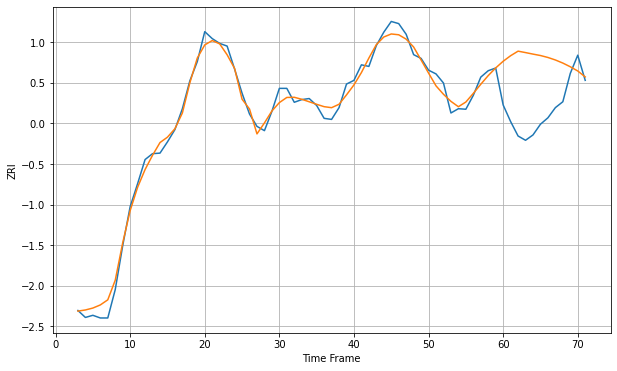

Wall time: 8.9 s
10023 14.114616787699111 108.00294803843691 [3596.6312072  3607.01057196 3615.51839618 3612.84646253 3610.01357982
 3607.36294729 3603.72797125 3599.04852032 3593.26353199 3586.34943632
 3578.4765559  3567.4108519 ]

Got an mse at 0.0100 in round 138 and stopped training



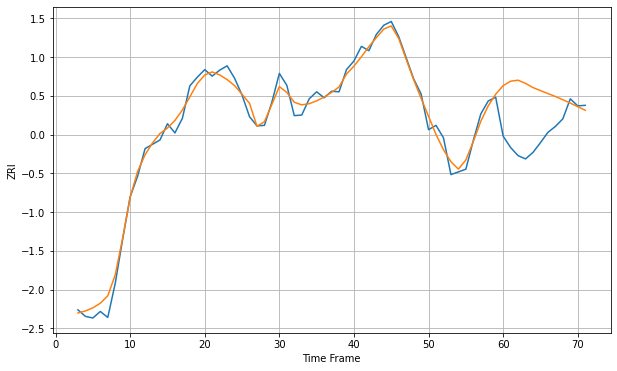

Wall time: 10.2 s
10024 14.271817389688248 89.40446911113622 [3471.40349173 3479.61671397 3481.45303131 3475.56086877 3467.85769716
 3462.16984645 3456.83883733 3451.30683877 3445.39525763 3439.11072808
 3432.55608054 3425.88228966]

Got an mse at 0.0100 in round 148 and stopped training



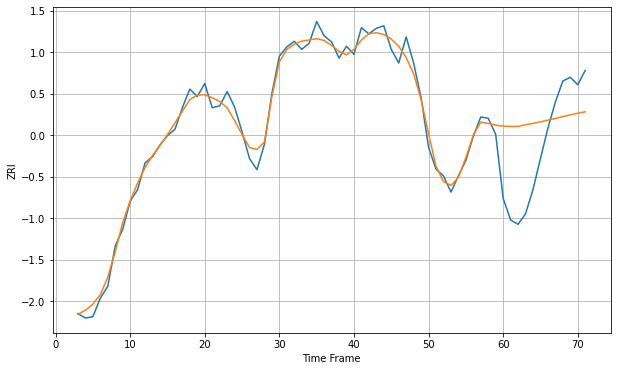

Wall time: 9.91 s
10025 13.616825957300618 96.19558578770567 [3625.30912041 3624.85029221 3624.8393383  3627.46294068 3629.76008859
 3632.18981346 3634.85500977 3637.69882581 3640.5990992  3643.42346274
 3646.05966267 3648.43014164]

Got an mse at 0.0100 in round 219 and stopped training



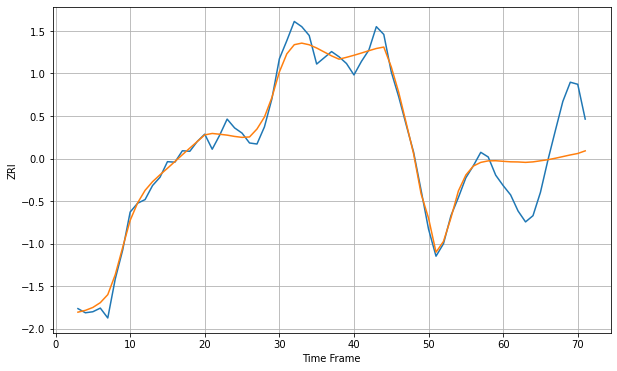

Wall time: 11.5 s
10027 18.24315175413047 90.35050567163427 [3006.70245437 3005.71286539 3005.4590628  3004.63160968 3005.60175704
 3007.69116066 3009.80442507 3012.62644001 3015.78035034 3018.9576478
 3021.75668021 3026.83779063]

Got an mse at 0.0099 in round 77 and stopped training



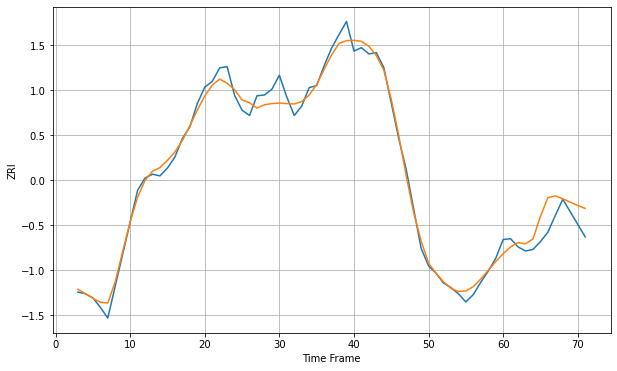

Wall time: 8.38 s
10028 20.139499315181713 43.99627463086295 [3014.43691088 3031.16227569 3041.31925621 3038.64030049 3050.34579151
 3105.57493806 3151.17374426 3155.29749234 3148.31735968 3139.92563424
 3131.99323441 3124.78368462]

Got an mse at 0.0100 in round 170 and stopped training



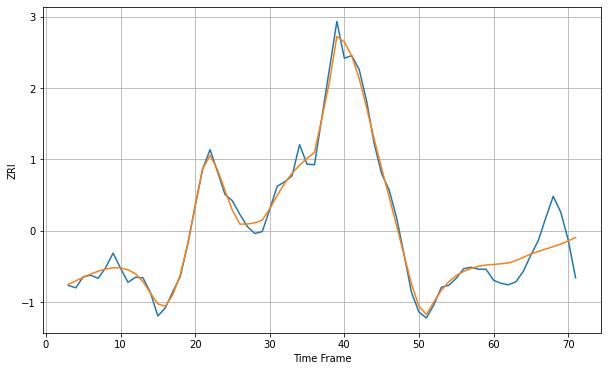

Wall time: 10.6 s
10029 14.379656013898593 51.47878667051385 [2798.43881396 2799.76710209 2801.56743447 2806.21107856 2812.91615051
 2819.10236167 2824.41521403 2829.20048737 2833.95865913 2838.92248858
 2845.14434617 2852.23986388]

Got an mse at 0.0100 in round 174 and stopped training



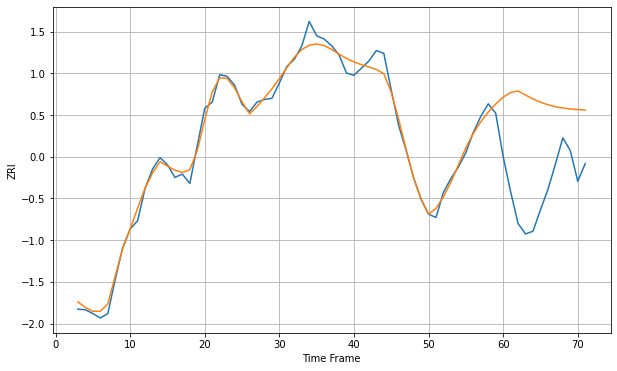

Wall time: 10.5 s
10031 13.966107374918549 166.61149436964257 [2813.05470305 2821.62993643 2824.35754369 2817.01764731 2809.95824723
 2803.98707699 2799.29641363 2795.78981113 2793.29317637 2791.61782211
 2790.55022502 2789.8214181 ]

Got an mse at 0.0100 in round 73 and stopped training



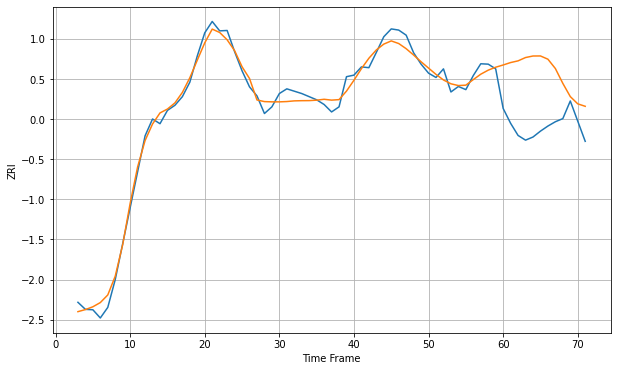

Wall time: 8.64 s
10036 19.170113263067186 147.8847233655347 [3596.87184313 3603.08585232 3607.42887355 3615.88936556 3619.82390055
 3619.94472735 3611.68402497 3587.81491354 3549.93020471 3516.18956569
 3497.66890028 3491.41956224]

Got an mse at 0.0100 in round 53 and stopped training



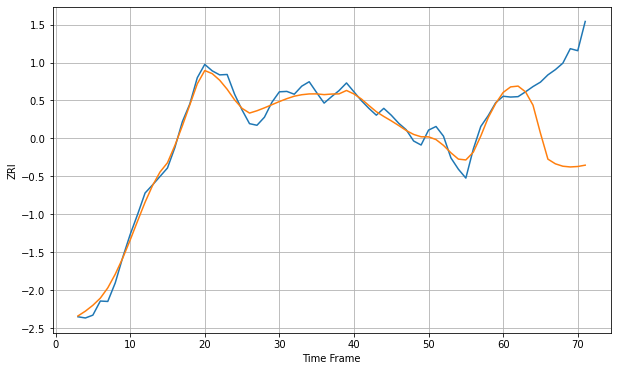

Wall time: 7.43 s
10038 18.143161148285277 199.75395822024169 [3899.46816042 3913.18172943 3915.19931683 3900.86481381 3867.85891476
 3798.31167842 3733.98500287 3722.42317255 3716.43639888 3714.61524516
 3715.72737146 3719.0280204 ]

Got an mse at 0.0099 in round 147 and stopped training



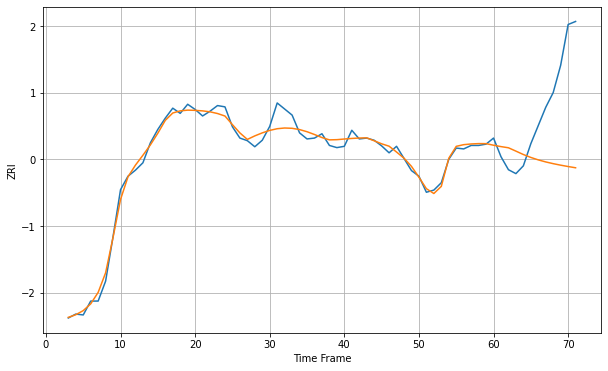

Wall time: 9.81 s
10065 15.286318655229806 166.13949333044513 [3955.50826549 3952.3220521  3949.61873121 3941.90307771 3934.05763196
 3927.31916664 3921.68075157 3916.96282787 3912.96915067 3909.48443029
 3906.373667   3903.48889606]

Got an mse at 0.0099 in round 112 and stopped training



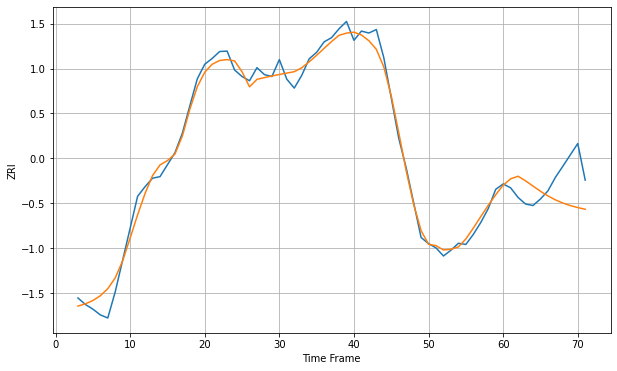

Wall time: 8.61 s
10075 23.270818466393585 78.28243325569402 [3065.89456499 3082.24443433 3089.14560236 3077.15065435 3063.53734078
 3049.99676648 3037.98419486 3027.7898059  3019.51131682 3012.9396342
 3007.67520578 3003.32504282]

Got an mse at 0.0100 in round 115 and stopped training



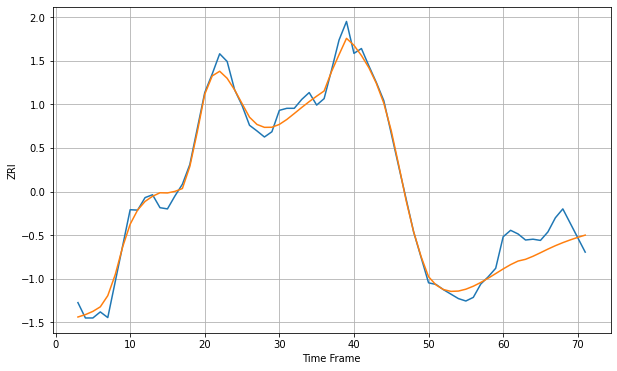

Wall time: 9.25 s
10128 20.911827044226943 57.78558424448978 [2839.38395373 2850.05021433 2858.91271584 2863.21387857 2870.7329302
 2879.48153344 2888.49673311 2896.91874825 2904.4834012  2911.30458845
 2917.50863569 2923.13037889]

Got an mse at 0.0100 in round 56 and stopped training



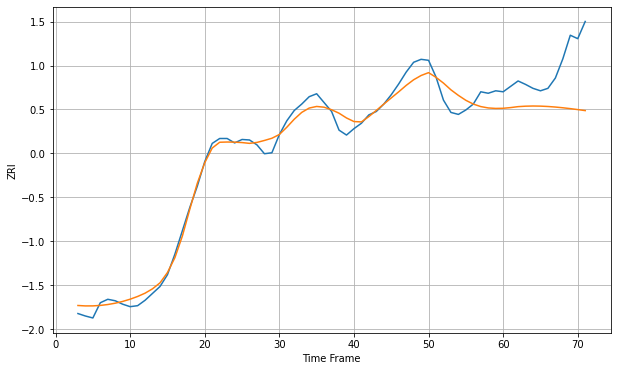

Wall time: 7.36 s
10302 19.450467665934287 91.5747264905229 [1833.44822025 1834.84478899 1836.78850123 1837.70817006 1838.05008254
 1837.82470088 1837.09758509 1835.9534549  1834.47463827 1832.73471776
 1830.79775011 1828.71851755]

Got an mse at 0.0099 in round 58 and stopped training



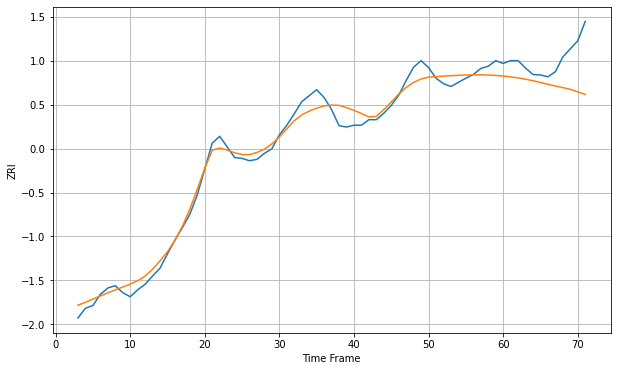

Wall time: 7.93 s
10303 19.326548190874405 67.72601772009655 [2037.6221938  2035.77314669 2033.64715812 2030.85994228 2027.45162317
 2023.66605568 2019.78075539 2016.0269236  2012.55121882 2008.82554202
 2003.31550519 1997.73677319]

Got an mse at 0.0099 in round 73 and stopped training



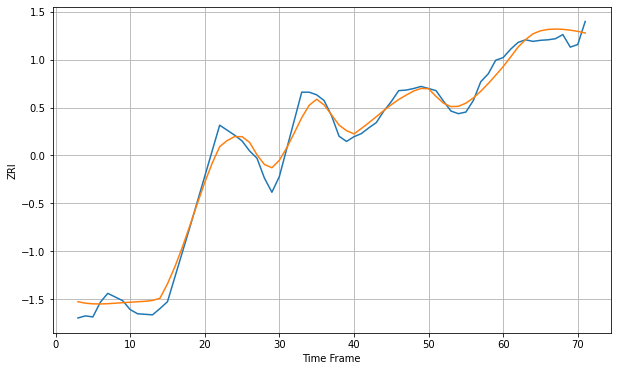

Wall time: 7.75 s
10304 19.40383242003053 18.588884980936605 [1915.67230821 1934.097624   1953.07416623 1967.36622068 1978.40199226
 1984.14653908 1986.78240256 1987.54222108 1986.98022352 1985.46595845
 1983.13379196 1979.92732671]

Got an mse at 0.0094 in round 94 and stopped training



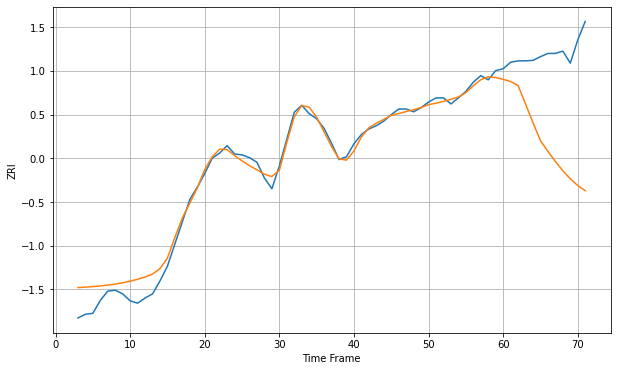

Wall time: 8.52 s
10305 21.418388809628055 209.1075505167779 [1924.06890992 1919.24930766 1910.7503986  1870.95357016 1830.48429352
 1791.74825927 1768.63740544 1746.77182637 1726.92750143 1709.56857633
 1694.80339875 1683.76535102]

Got an mse at 0.0100 in round 94 and stopped training



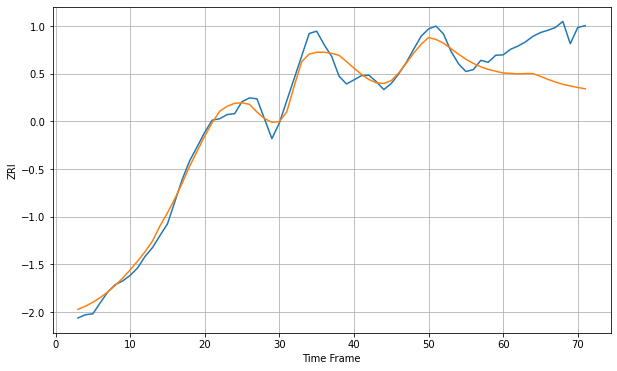

Wall time: 8.6 s
10306 19.86353958279193 97.91795312588754 [1874.74989529 1873.93204849 1872.82338797 1873.60433285 1873.48617035
 1867.49639197 1861.07394166 1855.3494816  1850.41013897 1846.80326757
 1843.574856   1840.70411971]

Got an mse at 0.0099 in round 66 and stopped training



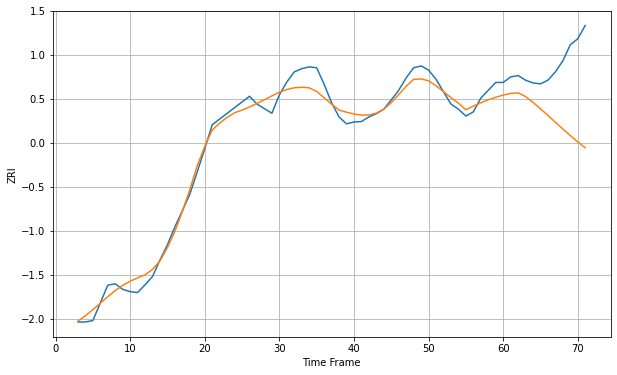

Wall time: 8.1 s
10310 19.836895168557795 132.0914627180266 [1909.48344532 1913.11976961 1914.36874254 1906.41121698 1893.73220697
 1879.84829111 1865.26566646 1850.43754362 1835.73624163 1821.45449397
 1807.81374894 1794.96669065]

Got an mse at 0.0099 in round 108 and stopped training



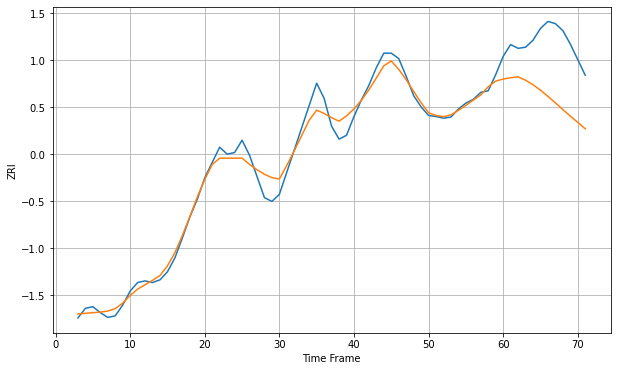

Wall time: 8.86 s
10312 17.49671411684526 106.69310912733977 [1764.75162717 1767.24104091 1768.94149453 1762.67615786 1754.25635577
 1744.10054353 1732.65380013 1720.46043658 1708.05467839 1695.86893429
 1684.19647216 1672.17362385]

Got an mse at 0.0100 in round 167 and stopped training



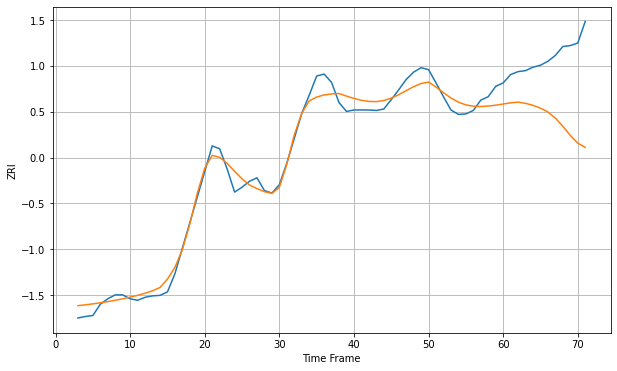

Wall time: 10.1 s
10314 19.371400416133174 135.55962370916194 [1817.14236846 1819.50660334 1820.96164082 1818.48340667 1814.46064711
 1808.76550657 1800.89826077 1788.46835142 1771.86885426 1753.23408018
 1737.59810429 1729.02590489]

Got an mse at 0.0099 in round 71 and stopped training



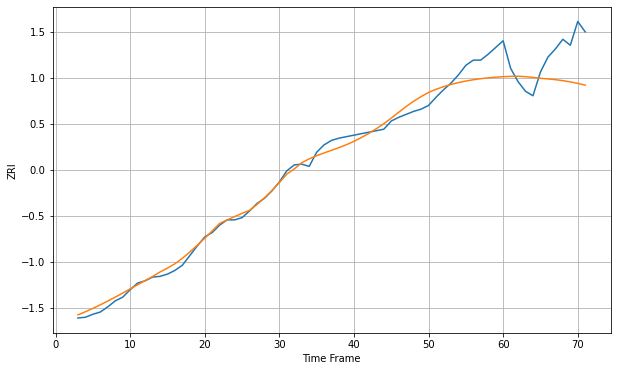

Wall time: 8.85 s
10453 11.238989912560156 44.49073377759216 [1638.67503162 1639.10850863 1639.31927879 1638.65862797 1637.73936171
 1636.5355191  1635.70078861 1634.69714194 1633.36618847 1631.69446233
 1629.6725545  1627.29595183]

Got an mse at 0.0099 in round 35 and stopped training



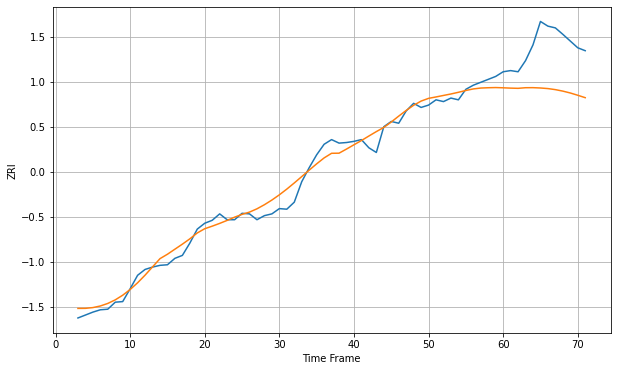

Wall time: 6.27 s
10455 14.358564669926169 79.46971047024927 [1863.57961583 1863.02165064 1862.66837207 1863.71267344 1863.80875702
 1863.249669   1862.24727099 1860.44502122 1857.89791242 1854.70262916
 1850.81451332 1846.68514663]

Got an mse at 0.0087 in round 23 and stopped training



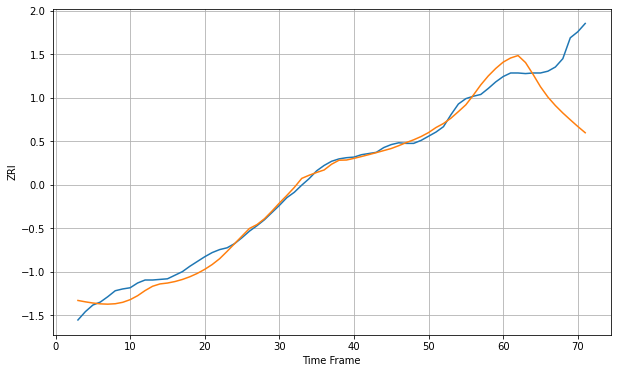

Wall time: 7.41 s
10456 11.999232186627456 88.91864859604568 [1812.16911792 1819.15411636 1823.21858056 1811.45689541 1791.87872473
 1771.00004586 1753.59442787 1739.40751254 1726.97936126 1715.53970642
 1704.40458131 1693.84780126]

Got an mse at 0.0086 in round 23 and stopped training



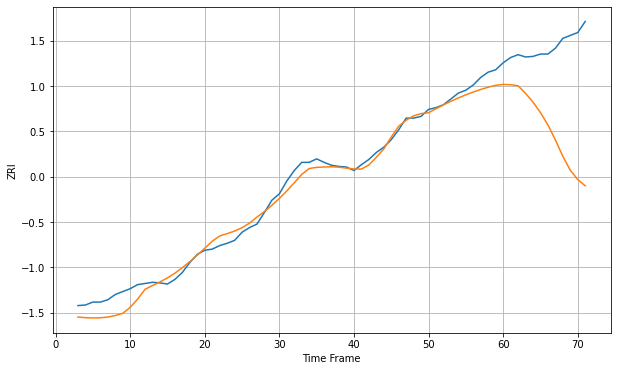

Wall time: 6.55 s
10457 15.361389341072703 159.2390606886763 [1826.84939016 1826.42935982 1824.51298303 1811.48205774 1796.52549397
 1778.52517824 1757.29913097 1731.58120369 1703.34157073 1679.48305514
 1663.51705716 1652.68243596]

Got an mse at 0.0097 in round 28 and stopped training



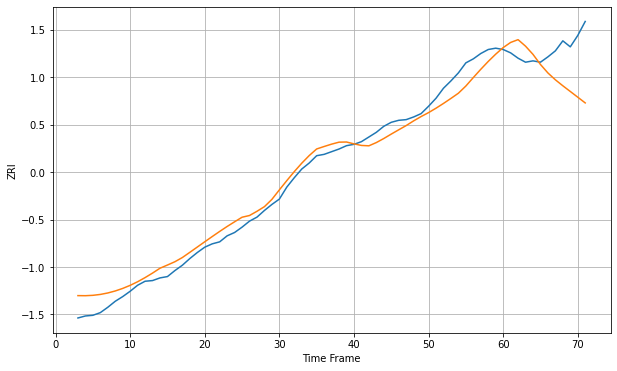

Wall time: 7.25 s
10458 16.212687501989972 55.20468499997888 [1759.83789661 1767.57926186 1771.76072489 1762.00753477 1749.71848544
 1734.62246434 1721.89712442 1711.64732946 1702.69716982 1694.16349124
 1685.62158527 1677.03246498]

Got an mse at 0.0096 in round 9 and stopped training



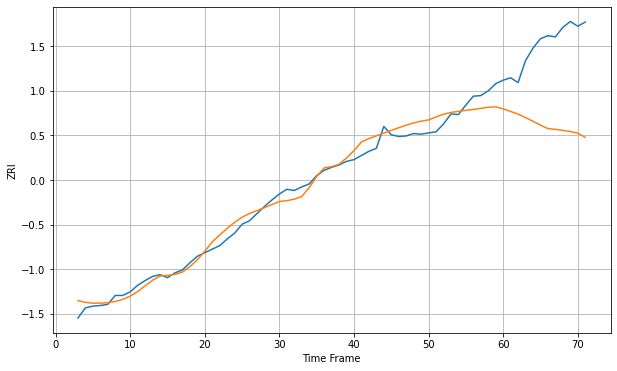

Wall time: 6.67 s
10459 14.566490105678547 140.78551976532464 [1781.62702811 1777.22667656 1772.84476556 1766.89229018 1760.6428309
 1754.26783178 1748.30183917 1747.1608588  1745.29121703 1743.48694117
 1740.5930185  1733.6037485 ]

Got an mse at 0.0097 in round 18 and stopped training



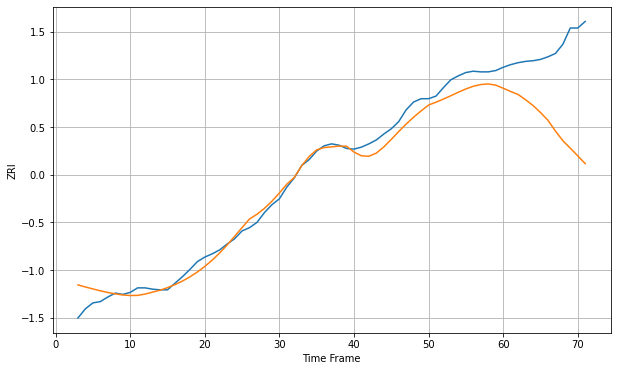

Wall time: 6.51 s
10460 15.306154526888864 123.76254408497333 [1777.0192886  1772.04446334 1767.46216714 1759.44979044 1750.64486689
 1739.96033691 1728.09193426 1711.69070733 1696.91347929 1685.31248545
 1673.67284568 1661.82385091]

Got an mse at 0.0094 in round 30 and stopped training



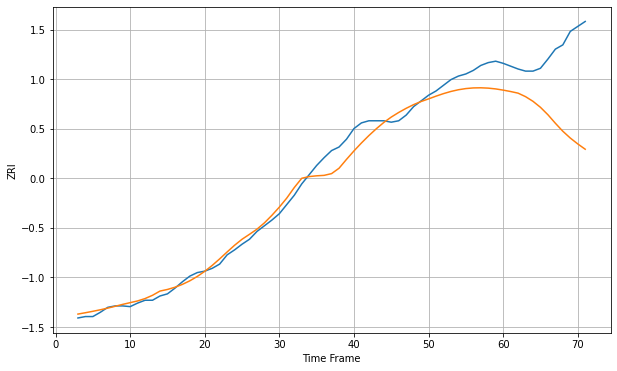

Wall time: 7.92 s
10461 15.115370892508293 101.81225409850755 [1797.2274078  1795.23680172 1792.94310635 1788.01712506 1781.42898846
 1772.97643198 1762.49829226 1750.48842506 1739.24090369 1729.64193219
 1721.37506006 1713.89200919]

Got an mse at 0.0088 in round 34 and stopped training



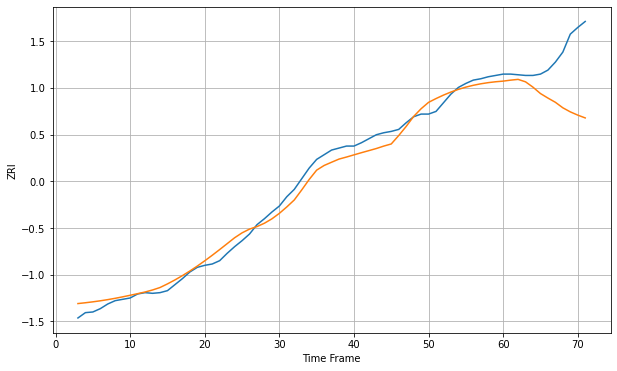

Wall time: 6.51 s
10462 12.177608201102569 74.02146037931543 [1799.46243974 1800.93176959 1802.08106264 1798.41348526 1790.36357694
 1780.82562768 1774.04859077 1767.70086015 1759.43586342 1753.32451025
 1748.45250748 1744.23086937]

Got an mse at 0.0098 in round 53 and stopped training



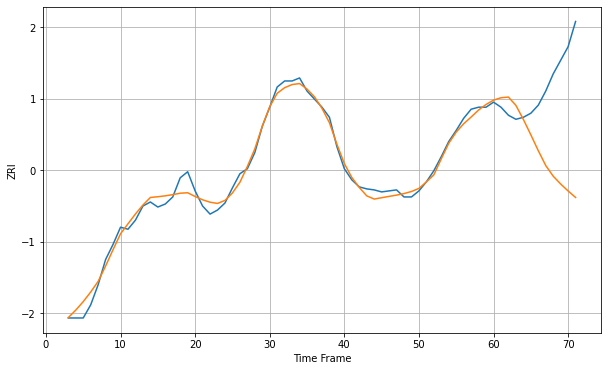

Wall time: 8.24 s
10463 6.640495914579095 84.06895362865188 [1801.97995178 1804.37742915 1805.02684538 1796.77807444 1782.8797431
 1767.61894    1751.88611851 1737.1413554  1726.5890048  1718.8380493
 1711.91075211 1705.50723559]

Got an mse at 0.0099 in round 62 and stopped training



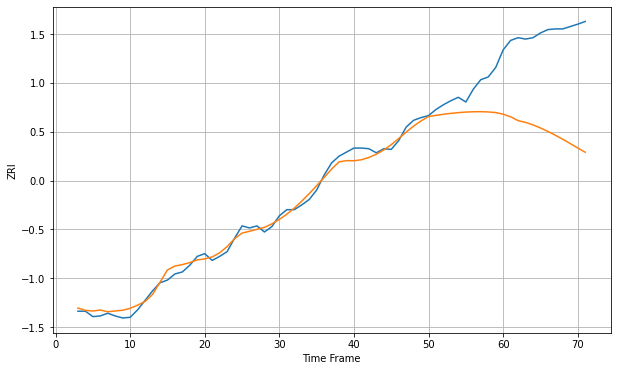

Wall time: 8.58 s
10465 16.180729799195905 147.94746851472777 [1835.05599092 1831.22208036 1825.54071752 1822.95174211 1819.25545865
 1814.72021872 1809.5783566  1803.96636255 1797.94953388 1791.60532069
 1785.11495401 1778.79985795]

Got an mse at 0.0086 in round 22 and stopped training



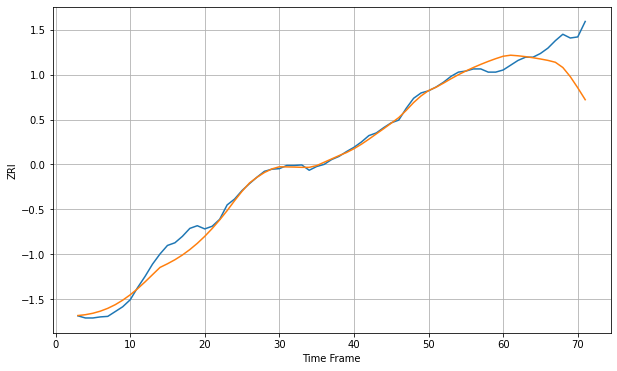

Wall time: 6.05 s
10466 13.190402474267064 59.94693415895975 [1918.78021058 1920.73092482 1919.61656427 1918.01657705 1915.98595918
 1913.64363018 1911.0064286  1907.47509734 1897.67192826 1880.52878732
 1859.61099922 1837.31089963]

Got an mse at 0.0090 in round 23 and stopped training



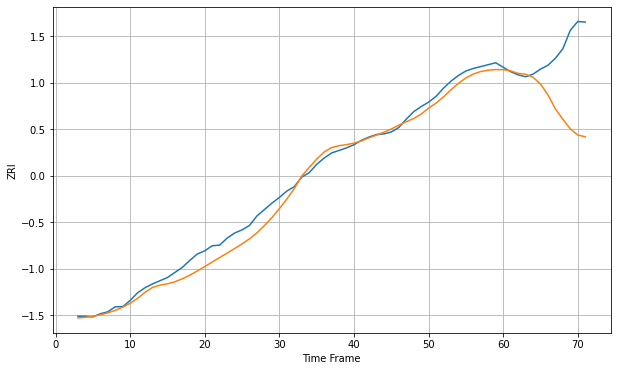

Wall time: 7.51 s
10467 13.32112875021743 95.71774926632644 [1785.10280065 1783.32072774 1779.27951619 1778.02136769 1773.13643398
 1762.70231942 1745.52448767 1723.42550084 1707.15119644 1691.97581593
 1682.24113283 1679.52520295]

Got an mse at 0.0095 in round 35 and stopped training



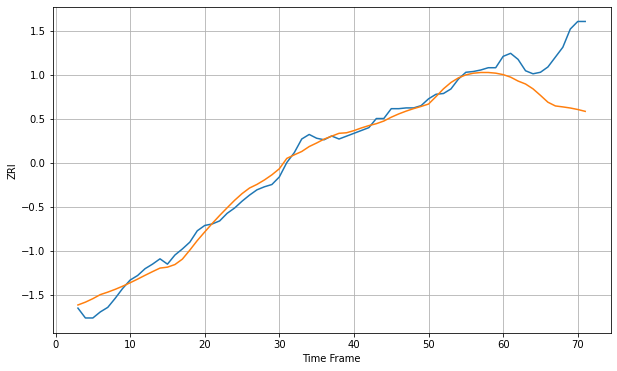

Wall time: 7.15 s
10468 9.633488596470942 67.6205310975191 [1536.92083499 1533.58713299 1528.43153297 1524.54354755 1518.16116003
 1509.55462317 1500.5169731  1495.60577575 1494.33876281 1492.88142054
 1490.91564058 1488.4616539 ]

Got an mse at 0.0091 in round 22 and stopped training



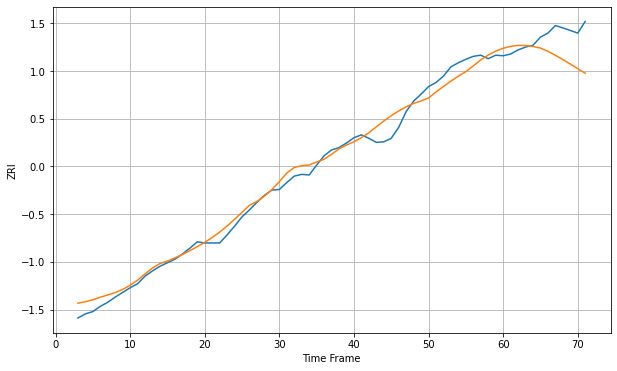

Wall time: 6.8 s
10469 14.586423599513703 43.138744275334176 [1912.89786818 1916.17514219 1917.85952385 1917.63232837 1916.06340054
 1913.26416825 1907.62233684 1900.89241549 1893.53406116 1885.7765422
 1877.84518761 1869.93259548]

Got an mse at 0.0094 in round 21 and stopped training



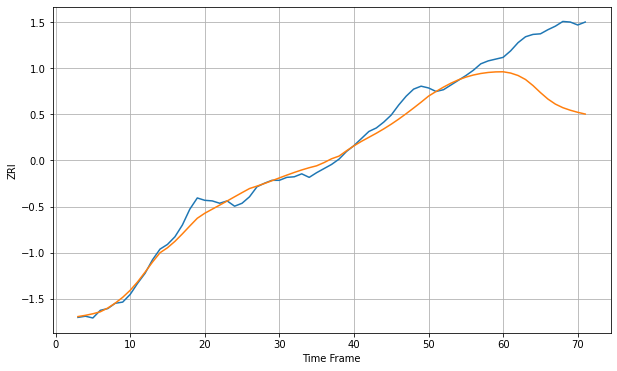

Wall time: 7.06 s
10470 13.264392521164677 111.73739519510005 [1849.48169341 1847.31849434 1843.137799   1836.33196301 1826.0546906
 1814.11754965 1803.13092794 1794.53849916 1788.46619231 1784.10610686
 1780.57741053 1777.61613138]

Got an mse at 0.0098 in round 46 and stopped training



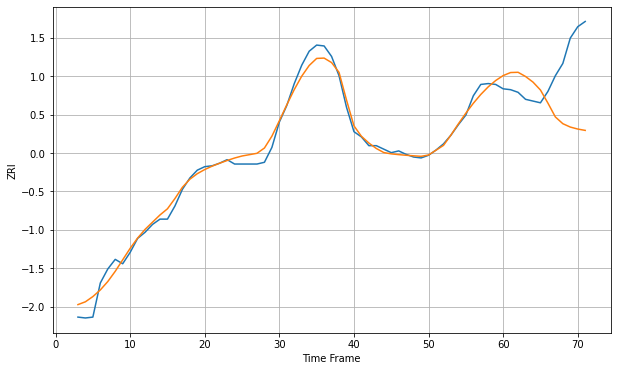

Wall time: 7.3 s
10471 8.474125247671617 64.02974952666393 [1865.13529208 1868.60409283 1868.89130023 1864.09847797 1857.67815928
 1848.63303943 1833.67563478 1817.8193076  1810.1212907  1806.26892901
 1804.00295801 1802.46186897]

Got an mse at 0.0090 in round 20 and stopped training



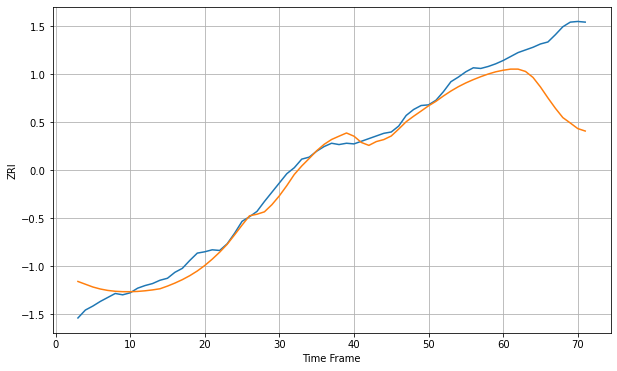

Wall time: 7.33 s
10472 15.140075022102016 101.39493275930572 [1812.30183837 1813.99626086 1814.00272274 1810.46051185 1801.46031696
 1787.02674863 1770.52211919 1754.85633509 1740.76266803 1732.59712397
 1724.17424652 1720.44842954]

Got an mse at 0.0097 in round 28 and stopped training



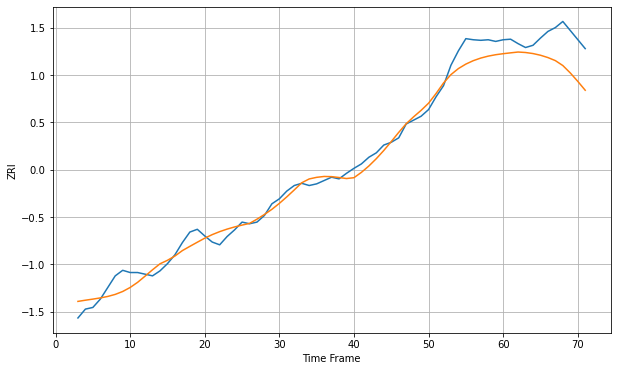

Wall time: 7.58 s
10473 17.542316094055007 51.65113560790403 [2012.83898785 2014.37426837 2015.85613895 2014.98899747 2013.09087663
 2010.08017404 2005.86535796 2000.34091593 1991.46282736 1978.11309195
 1962.98448458 1946.89486836]

Got an mse at 0.0098 in round 90 and stopped training



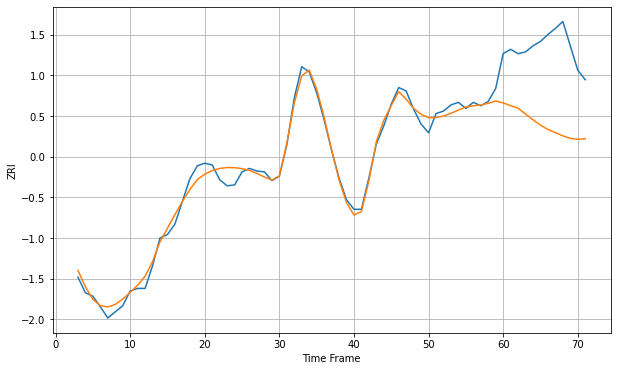

Wall time: 8.09 s
10528 8.194833620414935 90.74677160174342 [2470.35006285 2467.11229019 2464.29811418 2457.54436831 2450.91311038
 2444.8519398  2439.8038924  2436.1471383  2432.41528    2429.53221102
 2428.42719128 2429.11651548]

Got an mse at 0.0100 in round 132 and stopped training



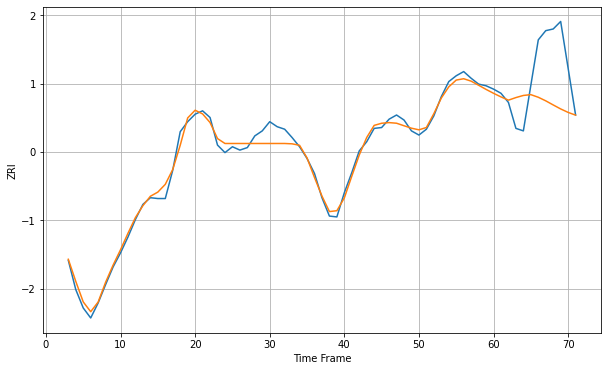

Wall time: 9.73 s
10543 8.004719521050465 55.64365535166462 [2424.00936203 2419.67371477 2415.7864134  2418.87715471 2421.41633903
 2422.38249646 2419.26005945 2414.96806693 2410.05443376 2405.27268462
 2401.13167013 2397.83294451]

Got an mse at 0.0100 in round 40 and stopped training



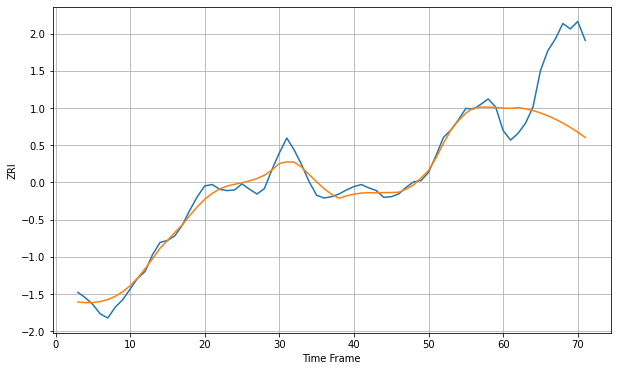

Wall time: 6.67 s
10562 11.420213715184786 101.5326871571741 [2109.34779698 2109.05874085 2110.04280583 2108.37793264 2105.7867843
 2102.32022775 2098.03669207 2092.99976514 2087.26194512 2080.83835582
 2073.70597885 2065.86599262]

Got an mse at 0.0100 in round 177 and stopped training



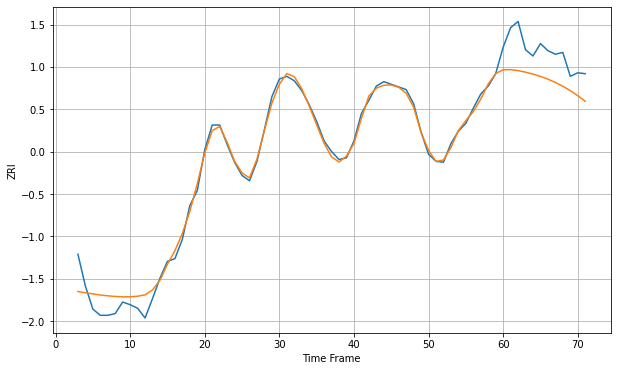

Wall time: 10.9 s
10573 9.674639952297062 33.944868143156036 [2266.45848055 2266.58605209 2265.48254987 2263.72078776 2261.5535667
 2258.92891269 2255.79456644 2252.09812952 2247.78997968 2242.8277334
 2237.18324033 2230.85394109]

Got an mse at 0.0100 in round 28 and stopped training



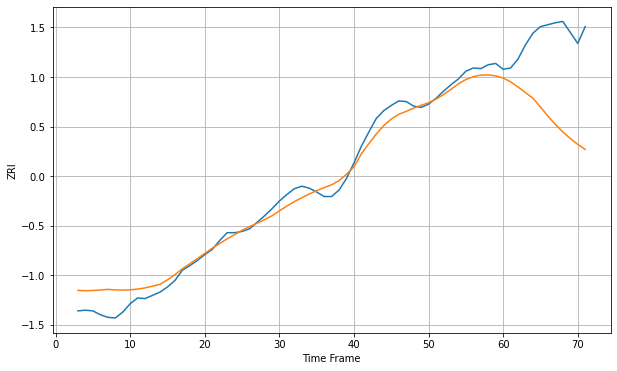

Wall time: 6.82 s
10701 17.36421293233828 127.56154864529896 [2023.39797072 2017.51252079 2009.5439011  2000.86140982 1992.12020531
 1978.61138767 1964.41342269 1951.56548541 1940.02195829 1929.75706811
 1920.7470904  1912.93199646]

Got an mse at 0.0099 in round 39 and stopped training



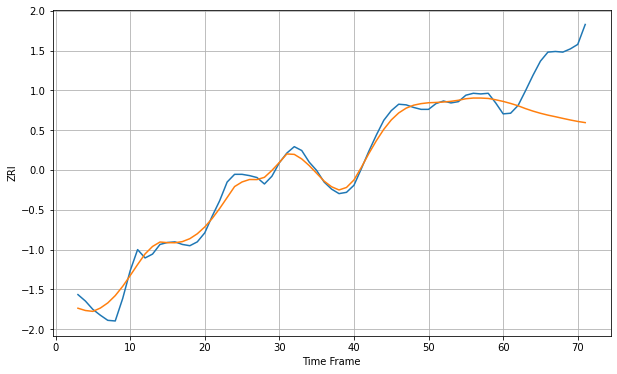

Wall time: 7.61 s
10703 11.669176545330128 87.27113523801466 [2123.36594273 2120.22075501 2116.59314909 2112.17785781 2108.28611312
 2104.91684834 2102.03396125 2099.57884482 2096.98162159 2094.4914552
 2092.25178974 2090.39791765]

Got an mse at 0.0099 in round 167 and stopped training



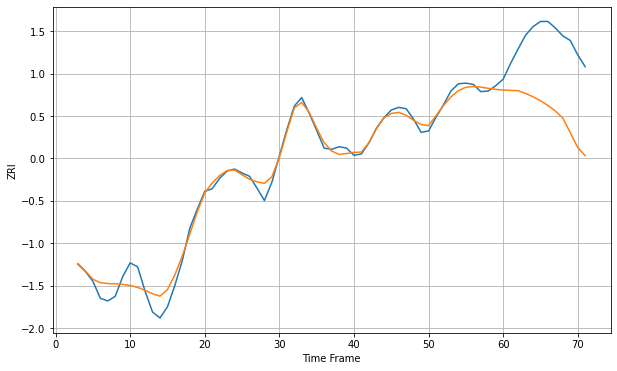

Wall time: 9.82 s
10704 12.604683384684499 110.33781685425049 [2179.54142607 2178.95623517 2178.51900951 2174.26923064 2169.19677801
 2163.15858224 2155.958548   2147.44445287 2136.64620558 2114.34069611
 2091.78818493 2079.44610521]

Got an mse at 0.0099 in round 44 and stopped training



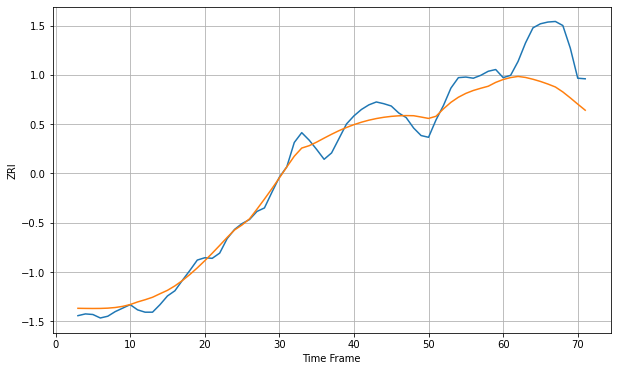

Wall time: 7 s
10705 17.791929718117103 77.3561594786216 [1987.78001772 1991.11109167 1993.07235096 1991.32854199 1988.19393311
 1984.4138641  1979.93654194 1974.87349377 1966.30179474 1956.05816702
 1945.24914778 1934.77025751]

Got an mse at 0.0099 in round 42 and stopped training



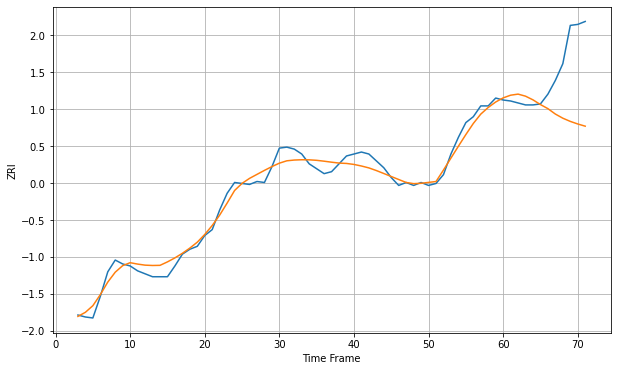

Wall time: 7.74 s
10940 8.077062070176694 54.71794251460375 [1435.15159107 1437.89859931 1439.00355218 1436.90560488 1433.14676408
 1428.36693749 1424.198527   1418.68517206 1414.46864689 1411.2169509
 1408.58233278 1406.34840757]

Got an mse at 0.0099 in round 72 and stopped training



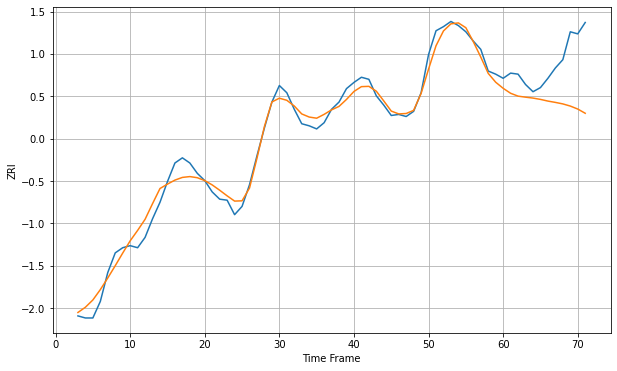

Wall time: 7.78 s
10960 8.861068174274257 43.646814489388994 [1844.30516343 1839.49260846 1836.71587138 1835.7256296  1834.84447984
 1833.56731529 1831.93698524 1830.6583032  1829.19889947 1827.10947314
 1824.22913831 1820.13926897]

Got an mse at 0.0099 in round 144 and stopped training



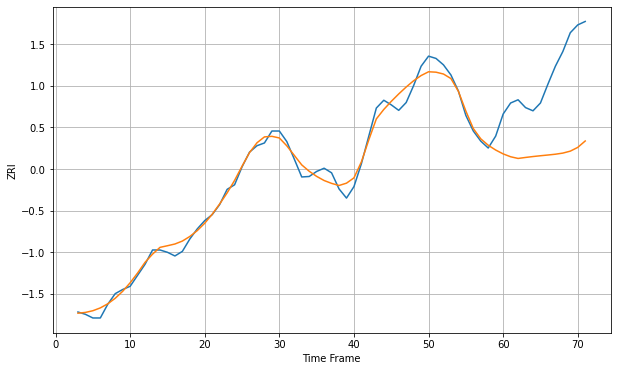

Wall time: 9.66 s
10977 16.075907669523144 179.581902519586 [2020.21533864 2013.97211787 2010.29478834 2012.46563284 2014.43183604
 2016.16499897 2017.77149557 2019.50783795 2021.93001041 2026.20421078
 2034.36374145 2048.31083053]

Got an mse at 0.0099 in round 71 and stopped training



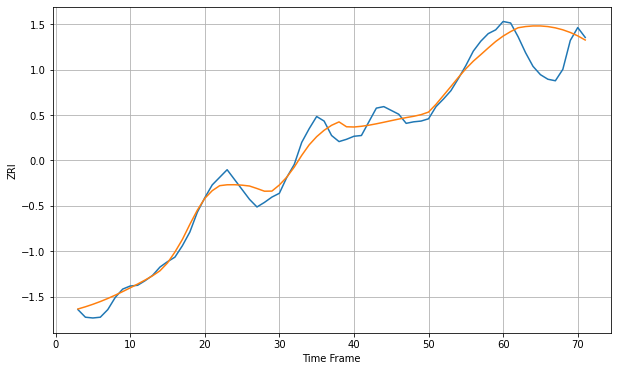

Wall time: 7.82 s
11001 12.500484591336205 42.15929537171518 [2181.80684084 2187.66737338 2192.71693142 2194.30344109 2195.09714246
 2195.09527532 2194.27362218 2192.59523449 2190.02333823 2186.52822708
 2182.07514758 2176.59559661]

Got an mse at 0.0099 in round 123 and stopped training



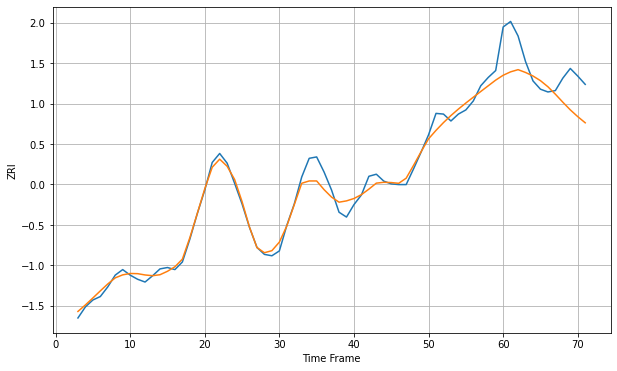

Wall time: 9.21 s
11003 11.088704148288837 45.12455427741642 [2215.16213247 2220.1144961  2223.27660878 2219.20331044 2214.08894986
 2207.35467125 2198.53334534 2187.78850559 2176.19151948 2165.10891956
 2155.30005805 2146.40756331]

Got an mse at 0.0100 in round 115 and stopped training



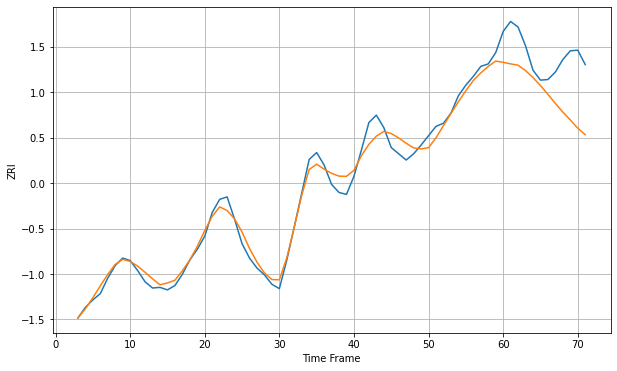

Wall time: 9.45 s
11010 13.879162979045892 72.62158188585163 [2383.57504976 2381.03464668 2378.93499425 2370.33346304 2359.12717855
 2346.28305677 2332.27828147 2317.63631377 2303.88993905 2291.20339298
 2278.0323945  2267.5776574 ]

Got an mse at 0.0100 in round 31 and stopped training



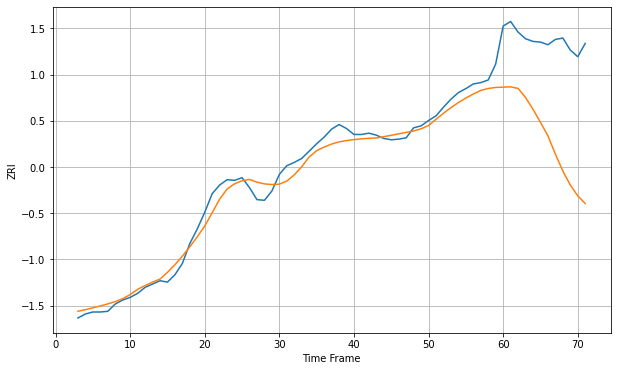

Wall time: 6.39 s
11050 13.768613199366158 155.34506490932156 [2568.20005605 2568.64532417 2566.28376949 2552.63548778 2534.95997408
 2515.29799366 2494.94681886 2467.47722452 2442.14492415 2420.89122106
 2404.8343287  2393.11674531]

Got an mse at 0.0099 in round 426 and stopped training



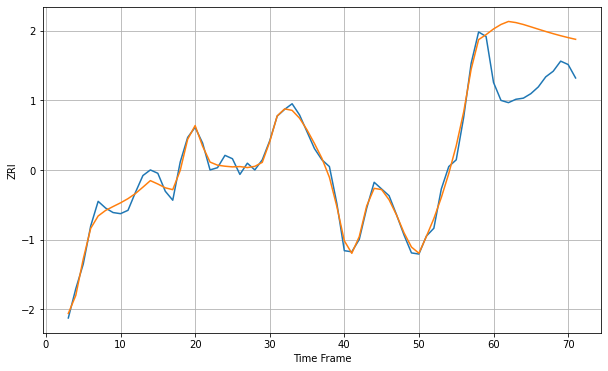

Wall time: 17.3 s
11101 5.891675594612482 51.90436253276072 [2535.69102488 2539.69981259 2542.38076144 2541.37791204 2539.68220306
 2537.62033695 2535.50634171 2533.44416681 2531.48946459 2529.67048792
 2527.9972554  2526.46459734]

Got an mse at 0.0099 in round 271 and stopped training



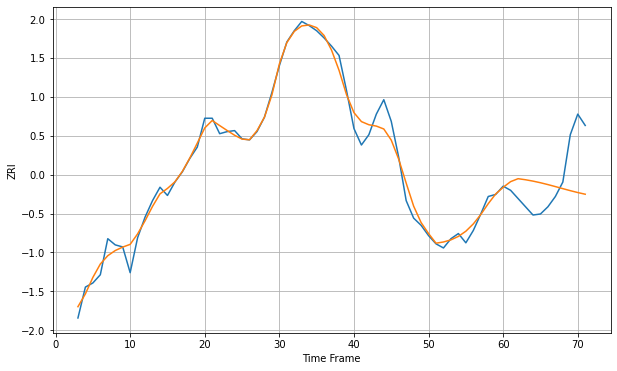

Wall time: 12.5 s
11102 9.18318417185094 37.58649151848092 [2186.91243429 2192.42855434 2195.28711539 2194.25554262 2192.93156441
 2191.35044309 2189.55628969 2187.61541545 2185.61769646 2183.66261413
 2181.83705843 2180.19793168]

Got an mse at 0.0099 in round 116 and stopped training



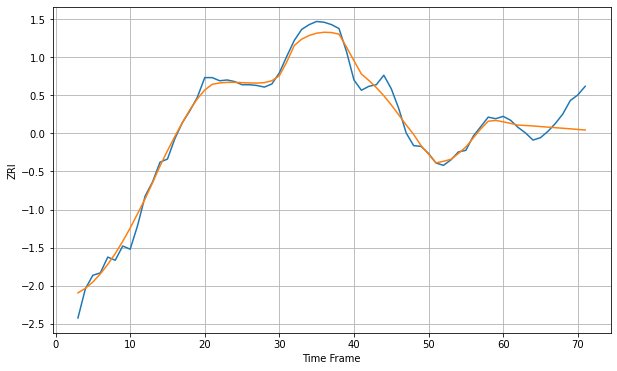

Wall time: 9.45 s
11103 10.611075712300186 24.653377310090107 [2147.10559319 2145.06812392 2142.92586864 2142.44713185 2141.83496623
 2141.11298196 2140.37552628 2139.6431725  2138.93271409 2138.22371655
 2137.46113731 2136.72061284]

Got an mse at 0.0100 in round 121 and stopped training



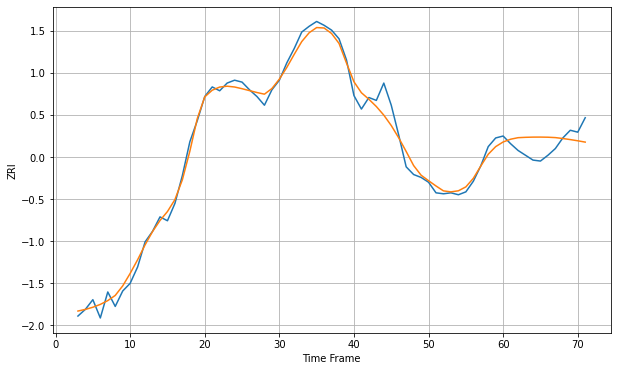

Wall time: 9.14 s
11104 8.609807590245886 15.996747304855438 [2097.83149771 2100.68599986 2102.28292854 2102.66072837 2102.86286115
 2102.89564526 2102.76129364 2102.36717563 2101.41200105 2100.30043526
 2099.04941245 2097.6797577 ]

Got an mse at 0.0100 in round 74 and stopped training



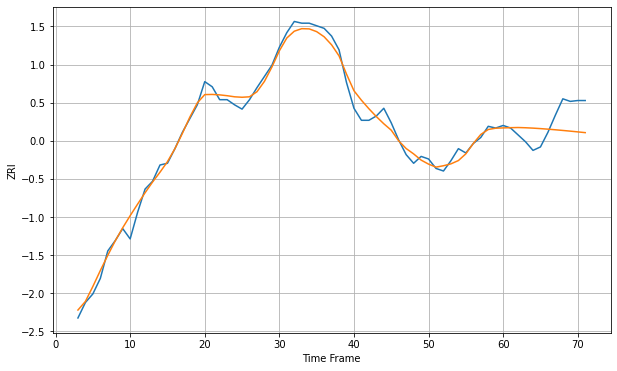

Wall time: 7.74 s
11105 8.98710637384832 24.250277369955885 [2184.14046185 2184.42231788 2184.59948448 2184.3272581  2183.89360069
 2183.33481255 2182.6846618  2181.96672336 2181.19481521 2180.37811899
 2179.52599579 2178.65010919]

Got an mse at 0.0100 in round 232 and stopped training



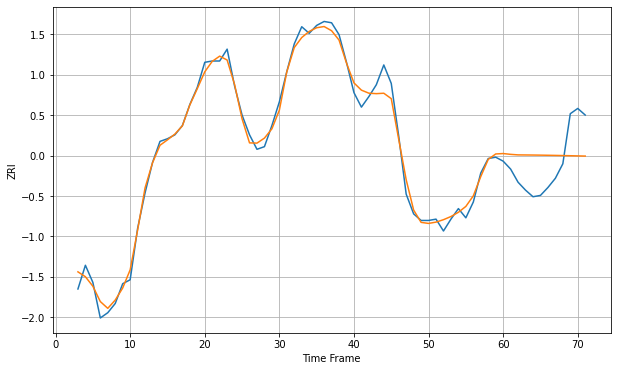

Wall time: 11.9 s
11106 6.167618457612285 24.929614058963296 [2139.77256683 2139.15701994 2138.75484497 2138.70081876 2138.63821625
 2138.5595169  2138.46621563 2138.36050566 2138.24480652 2138.12145434
 2137.99253975 2137.8598521 ]

Got an mse at 0.0100 in round 258 and stopped training



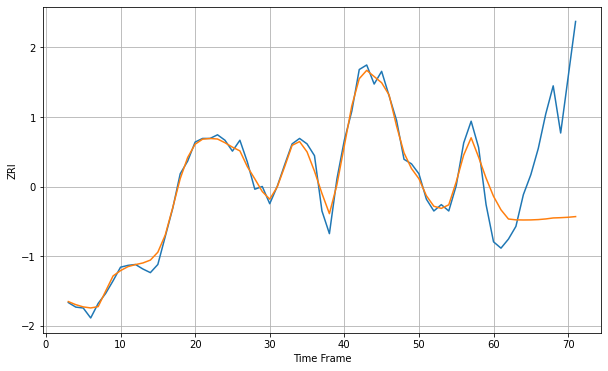

Wall time: 12.7 s
11201 8.925343899062726 103.19583070373874 [2889.17819517 2874.26765137 2864.14211084 2863.21081158 2863.06585916
 2863.14383544 2863.49979447 2864.21110999 2865.31100193 2865.60856387
 2866.06081141 2866.79807381]

Got an mse at 0.0098 in round 155 and stopped training



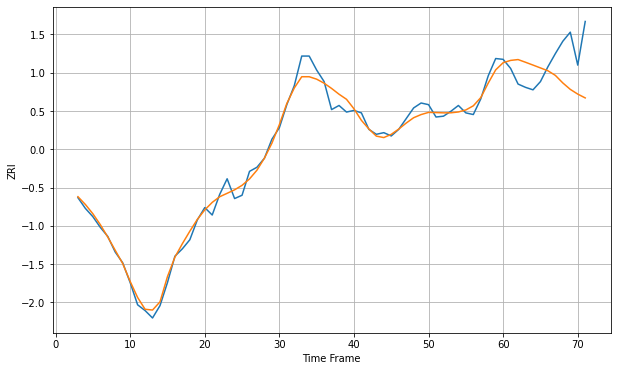

Wall time: 10 s
11203 9.347389299821652 41.90284593145375 [2152.91756836 2155.72472901 2156.74135221 2153.45622934 2150.05539858
 2146.59469716 2143.13643932 2137.521312   2128.3503747  2120.54572844
 2114.8061031  2110.18061319]

Got an mse at 0.0099 in round 41 and stopped training



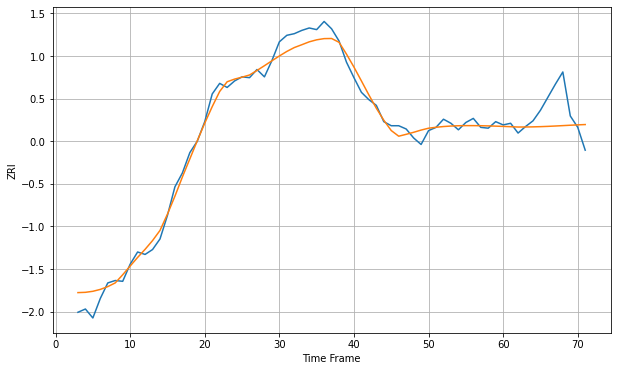

Wall time: 7.24 s
11204 11.185423903324134 28.74951363812085 [1996.1776704  1995.80948886 1995.41274948 1995.45747561 1995.61116185
 1995.87038598 1996.22505164 1996.65602777 1997.13386281 1997.62023618
 1998.07260808 1998.45083907]

Got an mse at 0.0100 in round 286 and stopped training



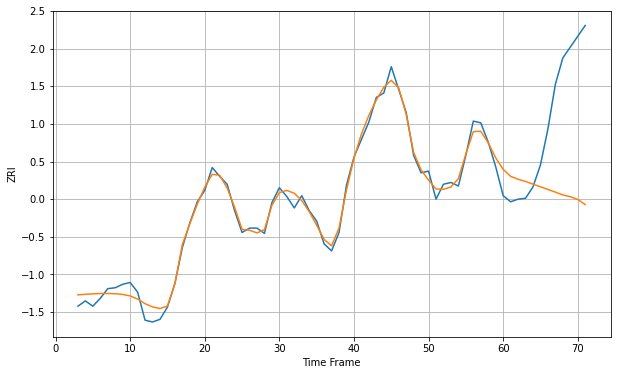

Wall time: 12.5 s
11205 7.975496080563968 112.87343944581063 [2815.02219325 2807.01050985 2803.67020804 2801.23056209 2798.12295198
 2795.08567969 2792.08236848 2789.02439819 2785.77223842 2783.85493585
 2780.66995255 2774.81778862]

Got an mse at 0.0099 in round 168 and stopped training



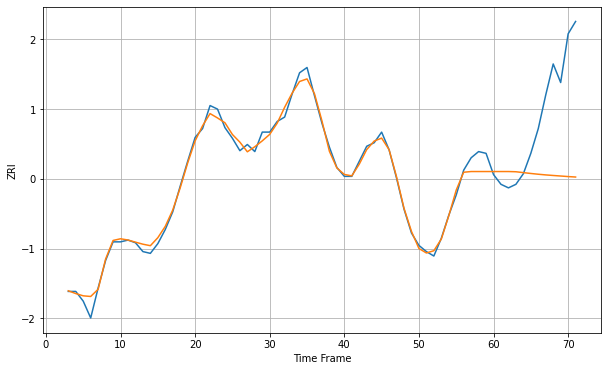

Wall time: 10.5 s
11206 7.477276509052306 89.45778088753465 [2545.44900489 2545.44900489 2545.44900489 2545.20438111 2544.22051455
 2543.26453765 2542.39053732 2541.63241951 2540.99561663 2540.38274673
 2539.76689233 2539.2357142 ]

Got an mse at 0.0100 in round 44 and stopped training



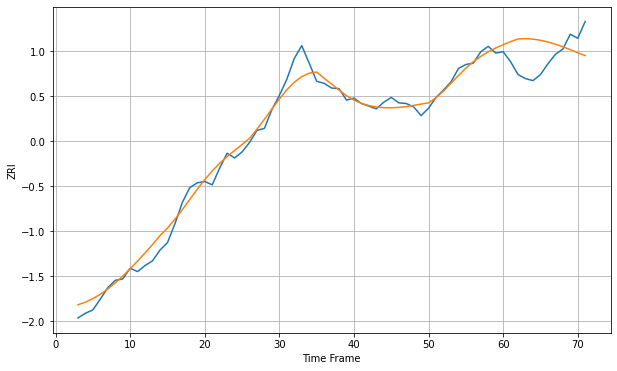

Wall time: 7.7 s
11207 13.217344710234762 39.41228897174315 [2272.3729878  2276.9734222  2281.09203823 2281.42610815 2280.72149946
 2279.03480497 2276.46604891 2273.17096169 2269.32127723 2265.04970548
 2260.43550632 2256.18032878]

Got an mse at 0.0099 in round 63 and stopped training



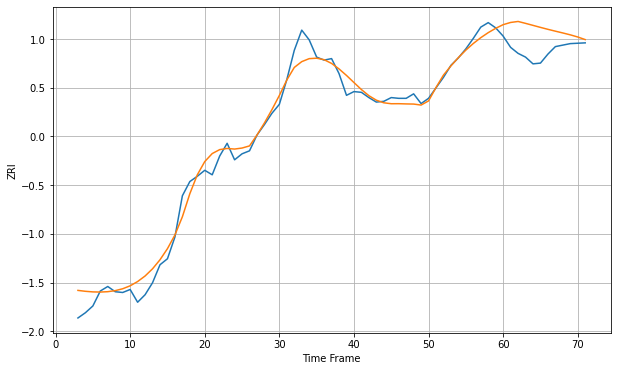

Wall time: 7.73 s
11208 14.42938945228851 31.732111595374036 [2267.27443221 2270.21848964 2271.54401346 2269.01108119 2266.33451905
 2263.64745835 2261.05560714 2258.59753734 2256.20529246 2253.69690187
 2250.82723817 2247.37484597]

Got an mse at 0.0100 in round 83 and stopped training



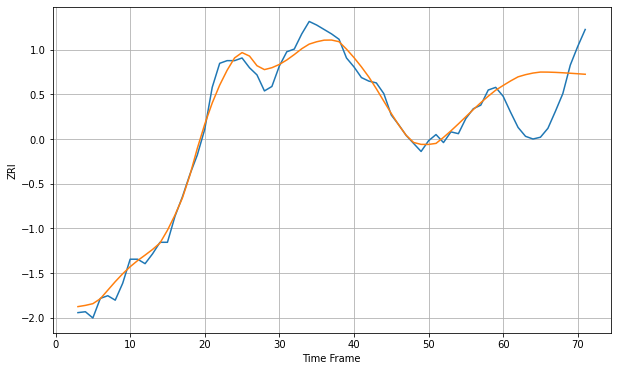

Wall time: 8.34 s
11209 10.487446923241244 50.21633345112495 [2094.13394899 2099.21767994 2103.81772697 2106.2531517  2108.06194857
 2109.18726671 2109.11388824 2108.81938142 2108.37929724 2107.85399648
 2107.28691678 2106.70281108]

Got an mse at 0.0098 in round 35 and stopped training



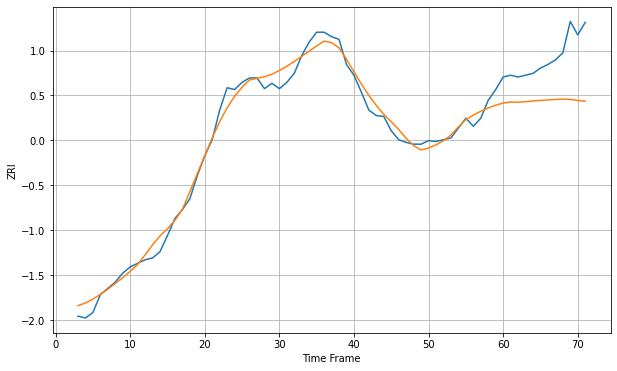

Wall time: 7.18 s
11210 9.752112055322003 52.06542474695685 [1930.95822106 1932.07847951 1931.77423423 1932.4823517  1933.19089451
 1933.84113168 1934.40756293 1934.89671892 1935.33197358 1934.98932799
 1933.86621014 1932.88260506]

Got an mse at 0.0100 in round 253 and stopped training



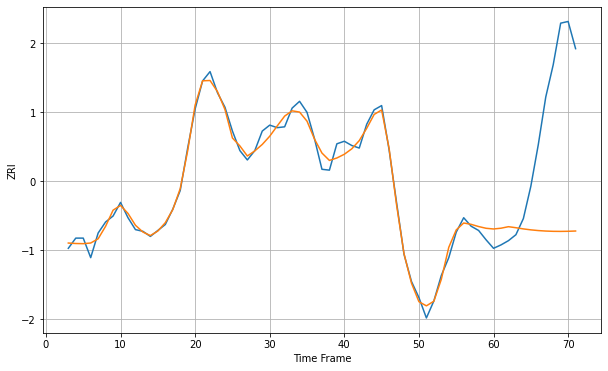

Wall time: 11.8 s
11211 7.931491427828764 142.7886457116426 [2728.74875739 2729.65719174 2731.44305688 2730.24029726 2728.8390497
 2727.71991607 2726.87895744 2726.30736721 2725.99064655 2725.90919602
 2726.03945455 2726.3553329 ]

Got an mse at 0.0099 in round 122 and stopped training



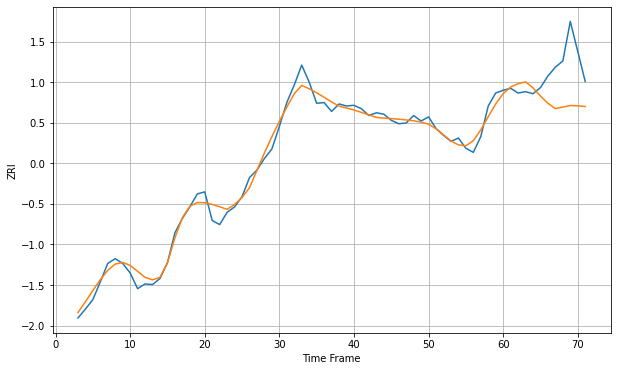

Wall time: 9.18 s
11212 11.057219988467374 52.79184657521567 [2154.03733381 2163.73460327 2168.67656844 2171.42770004 2162.71428564
 2150.462804   2139.99524857 2132.18399339 2134.4012513  2136.68009584
 2136.23491557 2135.27181348]

Got an mse at 0.0099 in round 89 and stopped training



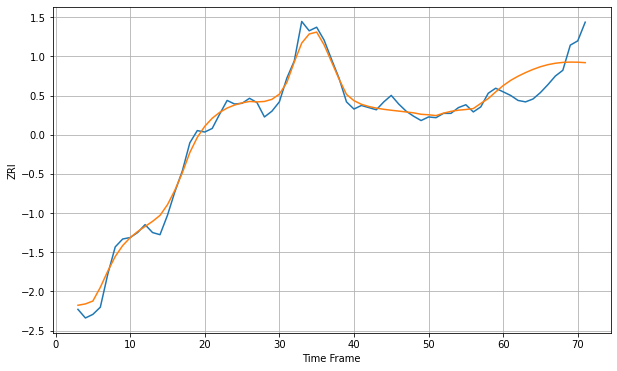

Wall time: 7.88 s
11213 10.917326751353942 31.799297978038783 [2312.62288051 2319.88144235 2325.76933097 2330.77121925 2335.22445028
 2338.95024947 2341.82508155 2343.81753909 2344.98240231 2345.42577885
 2345.26975487 2344.63090078]

Got an mse at 0.0097 in round 33 and stopped training



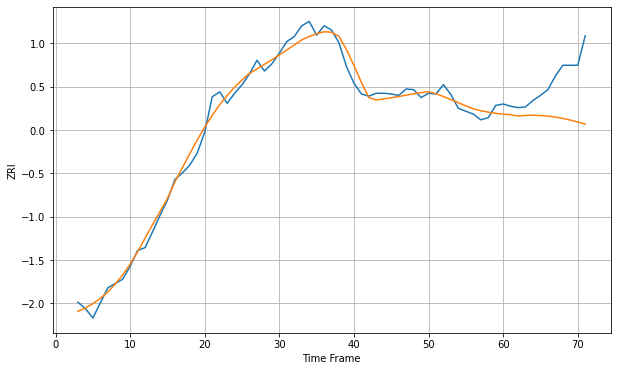

Wall time: 7.47 s
11214 11.122787195341308 57.1086755484334 [2065.87240698 2065.07468582 2063.33208556 2064.11937996 2064.36785053
 2064.0164757  2063.10122752 2061.80534971 2059.97119629 2057.67201563
 2054.98989325 2052.00656152]

Got an mse at 0.0100 in round 228 and stopped training



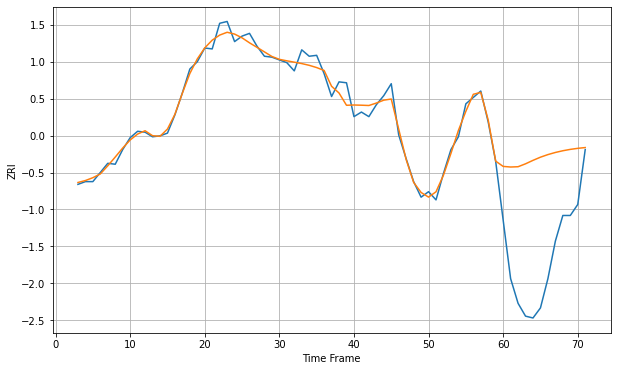

Wall time: 11.1 s
11215 7.57500979423083 117.90757846317868 [2544.61746296 2543.95539741 2544.27121787 2547.45452597 2551.22945196
 2554.69586497 2557.53527684 2559.85357576 2561.73443007 2563.22293606
 2564.36522725 2565.2116536 ]

Got an mse at 0.0100 in round 129 and stopped training



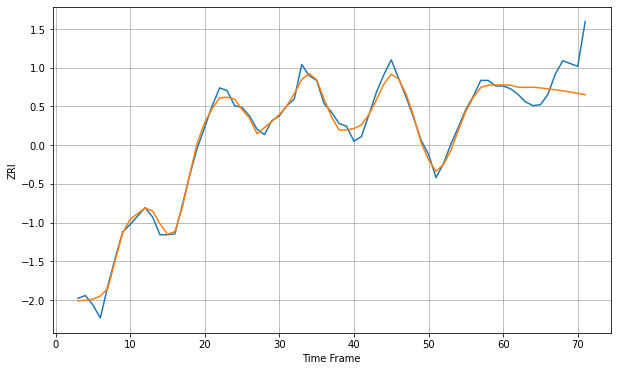

Wall time: 9.31 s
11216 6.789986685597227 29.267942749407723 [2507.1526435  2506.80825041 2504.79106409 2504.45503478 2504.73723235
 2503.9359878  2502.9944359  2501.97201024 2500.8193701  2499.5372485
 2498.15252831 2496.69886944]


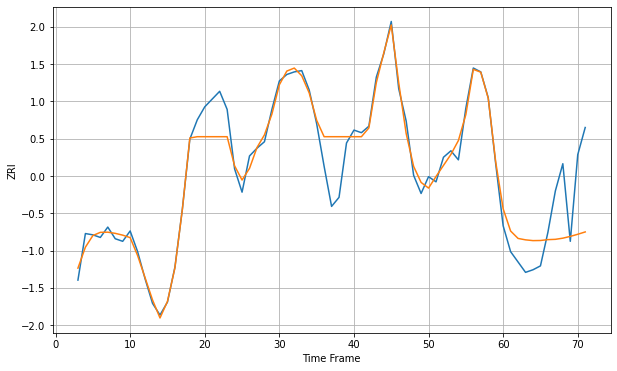

Wall time: 17.2 s
11217 13.358954746007289 38.033939967614955 [2804.15292606 2786.95545855 2781.22899564 2780.13277318 2779.54191966
 2779.63510399 2780.29595144 2780.53194807 2781.43019594 2782.79878042
 2784.44468177 2786.25595024]

Got an mse at 0.0099 in round 152 and stopped training



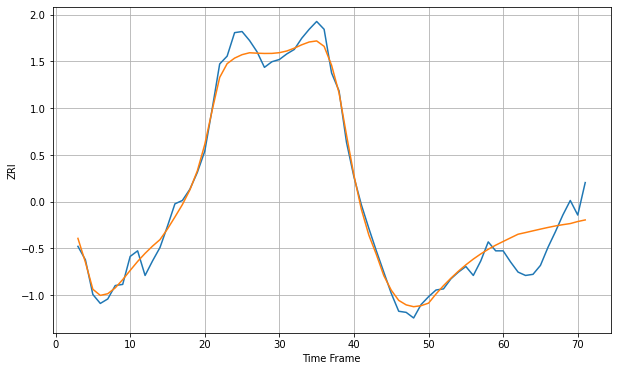

Wall time: 9.25 s
11218 8.624735459778961 25.348287164072183 [2043.36972635 2046.62548311 2049.85099617 2051.33598716 2052.88216269
 2054.41570633 2055.88775451 2057.24112467 2058.37862196 2059.38120045
 2061.20166706 2062.62260057]

Got an mse at 0.0100 in round 33 and stopped training



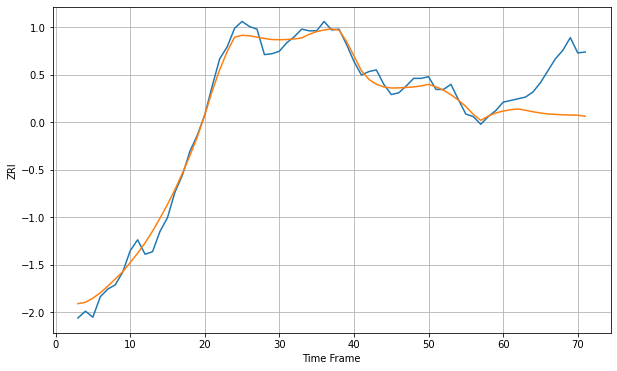

Wall time: 7.8 s
11219 9.971431992915003 53.5813014132456 [2100.58387839 2102.11885669 2103.00885581 2101.51348203 2099.71098589
 2098.29935863 2097.07606269 2096.61494347 2096.14933694 2095.8644861
 2095.67089083 2094.37311673]

Got an mse at 0.0100 in round 114 and stopped training



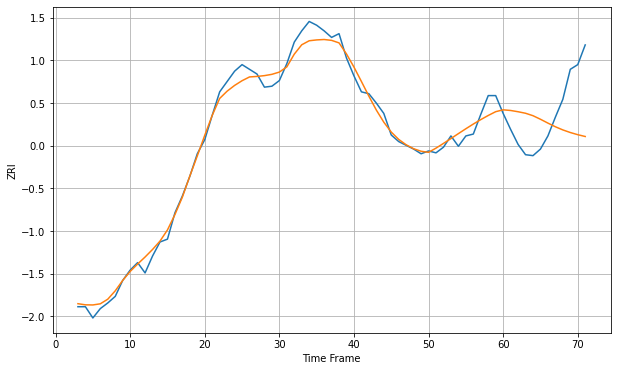

Wall time: 8.61 s
11220 9.115448727816945 47.777334814817706 [2068.83633286 2068.13478805 2066.79117469 2065.17761759 2062.56494235
 2058.78151092 2054.68390153 2050.78149562 2047.42557799 2044.64680103
 2042.33797103 2040.4069721 ]

Got an mse at 0.0100 in round 287 and stopped training



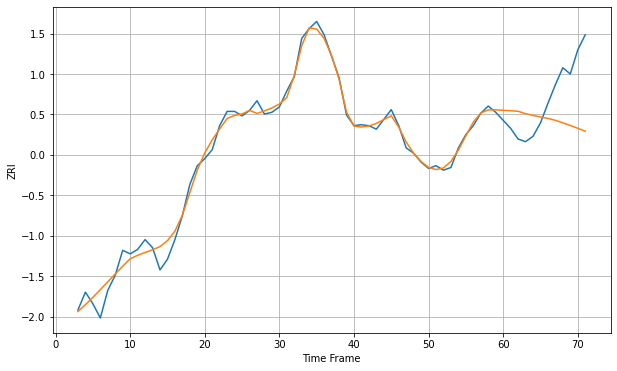

Wall time: 13.5 s
11221 8.678142739991488 51.319908522783706 [2446.24292363 2445.73502491 2445.11796805 2442.44857765 2440.52059611
 2438.72683849 2437.07236101 2434.97168271 2432.13812314 2429.16276069
 2426.02069634 2422.68608242]

Got an mse at 0.0100 in round 128 and stopped training



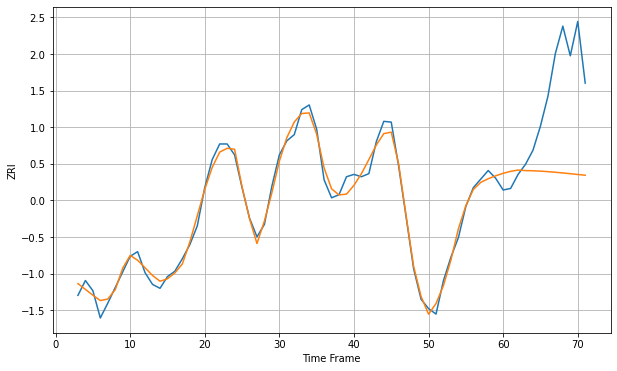

Wall time: 8.81 s
11222 9.325272273788732 111.12588622330647 [2736.42495216 2738.90677885 2740.5603272  2739.89358245 2739.64817419
 2739.17533527 2738.52344622 2737.73523186 2736.8484817  2735.89756917
 2734.91529551 2733.93459909]

Got an mse at 0.0099 in round 60 and stopped training



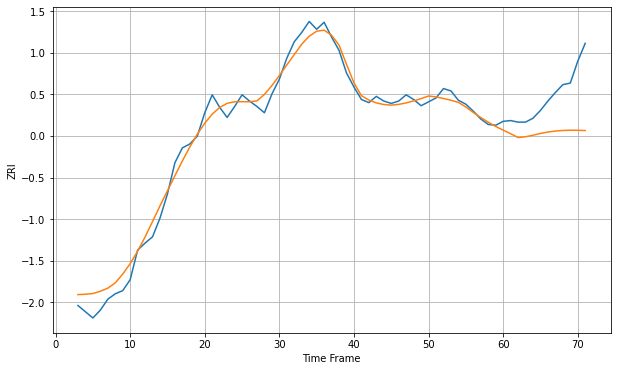

Wall time: 7.58 s
11223 12.420075768018943 53.17484722593294 [1995.69809281 1991.1657622  1986.27086025 1987.24513173 1989.19080594
 1991.51156051 1993.30091354 1994.55329258 1995.30715875 1995.62145948
 1995.5617119  1995.19341745]

Got an mse at 0.0097 in round 37 and stopped training



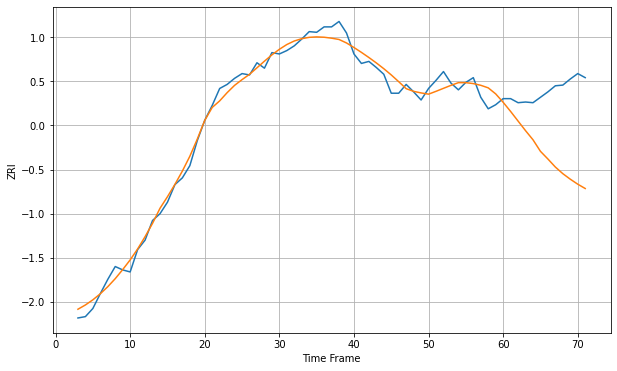

Wall time: 7.65 s
11224 12.417357959192325 103.71174430143414 [2104.61087509 2091.09327758 2076.85993431 2062.70912336 2049.22900544
 2032.16982636 2020.81669114 2008.92441666 1999.14666151 1990.99805393
 1983.62319011 1977.2484948 ]

Got an mse at 0.0099 in round 117 and stopped training



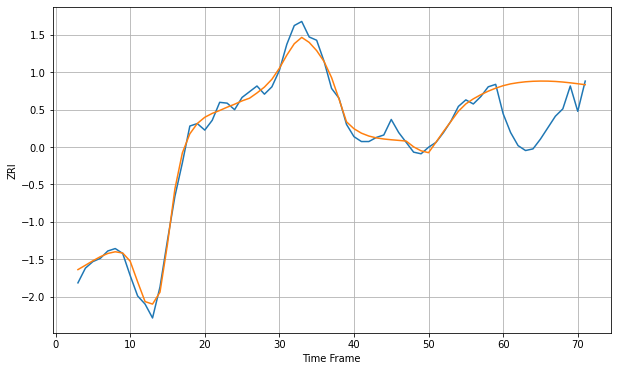

Wall time: 8.86 s
11225 9.441645425127863 55.503320315082775 [2311.37477161 2313.61417019 2315.08962275 2316.15532931 2316.77465461
 2317.03526997 2316.96244921 2316.5569987  2315.84305839 2314.88436335
 2313.76687337 2312.57383792]

Got an mse at 0.0099 in round 46 and stopped training



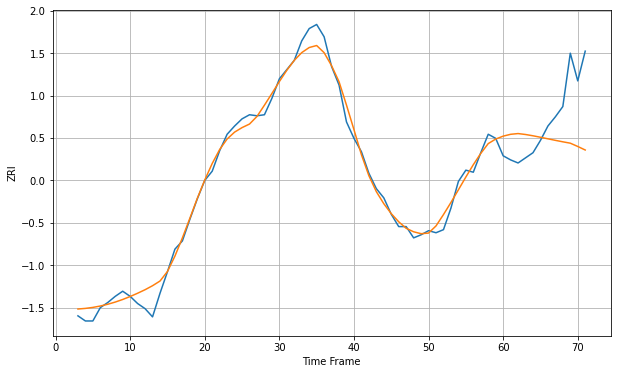

Wall time: 7.02 s
11226 8.950584957260029 46.12866806937707 [2044.14147987 2045.9424375  2046.66082803 2045.75180339 2044.49811509
 2043.06038547 2041.55313109 2040.05555512 2038.62302442 2037.29240865
 2034.08635125 2030.64461215]

Got an mse at 0.0097 in round 32 and stopped training



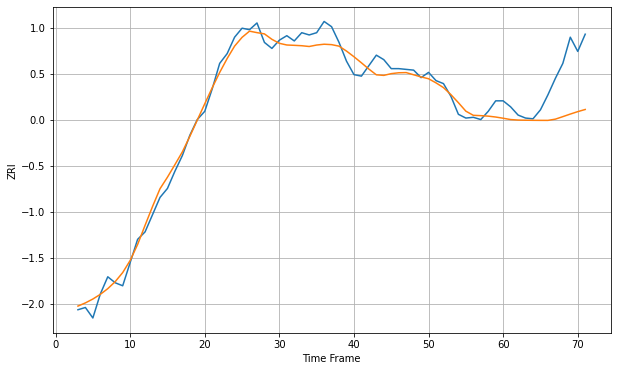

Wall time: 6.64 s
11228 12.48772185862261 55.820673753079575 [2087.76380951 2085.98418603 2085.31725107 2085.12666497 2084.99342961
 2084.91320959 2084.88416419 2086.54204377 2089.89606893 2093.32060146
 2096.57499198 2099.45167975]

Got an mse at 0.0100 in round 68 and stopped training



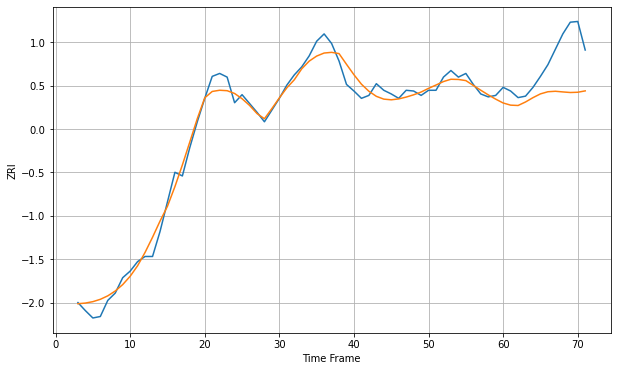

Wall time: 7.47 s
11229 12.353402801217467 53.53839762975771 [2055.65545091 2052.70085995 2052.22655867 2057.03399546 2062.94930019
 2068.08447994 2071.00969311 2071.66486904 2070.76046556 2069.96907427
 2070.31411178 2072.18986119]

Got an mse at 0.0099 in round 33 and stopped training



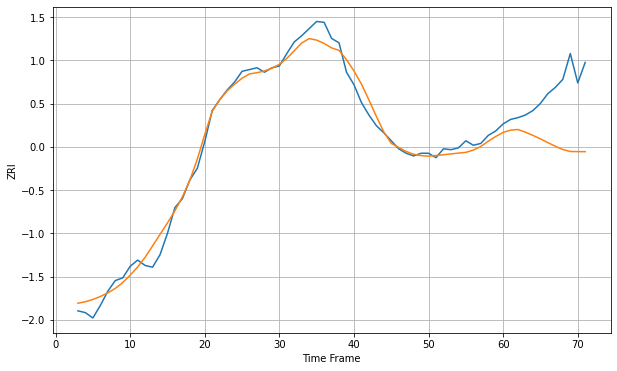

Wall time: 6.58 s
11230 10.139934190003661 61.166693586493736 [1960.40567499 1962.97472435 1963.65463348 1960.58148044 1957.04160484
 1953.09122358 1948.92170747 1944.84091987 1941.16416327 1939.00964947
 1938.80957875 1938.75936536]

Got an mse at 0.0099 in round 396 and stopped training



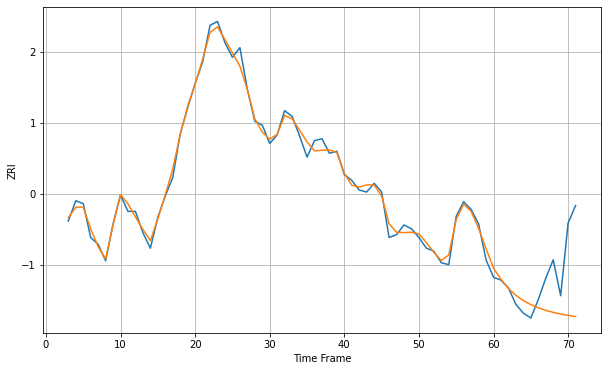

Wall time: 15.3 s
11231 6.32175991151135 47.605927015429366 [2715.44128961 2703.77168794 2694.4403117  2687.26751773 2681.91782505
 2677.77653678 2674.51580161 2671.89809343 2669.76766073 2668.0301054
 2666.63235514 2665.54657875]

Got an mse at 0.0099 in round 142 and stopped training



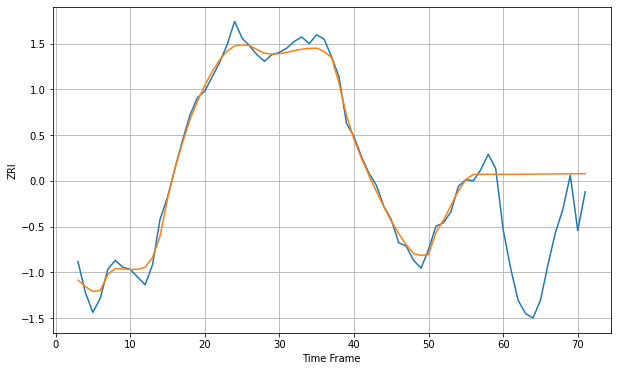

Wall time: 10.2 s
11232 7.801908590651425 82.63605326745764 [2136.8582137  2136.85014979 2136.853108   2136.9244285  2136.99507146
 2137.06500937 2137.13398959 2137.20149245 2137.26675348 2137.32885345
 2137.38685642 2137.43995292]

Got an mse at 0.0099 in round 45 and stopped training



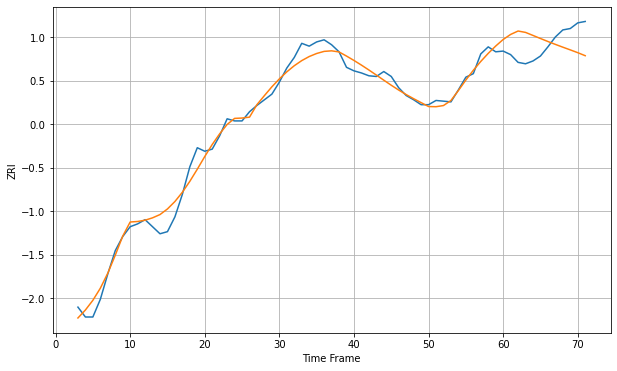

Wall time: 6.89 s
11233 12.183808616035707 32.652225335455185 [2329.4171646  2336.59775413 2341.44184643 2339.49120344 2335.186914
 2330.84610099 2326.59275159 2322.49450979 2318.55230808 2314.69242836
 2310.75362783 2306.45844132]

Got an mse at 0.0100 in round 52 and stopped training



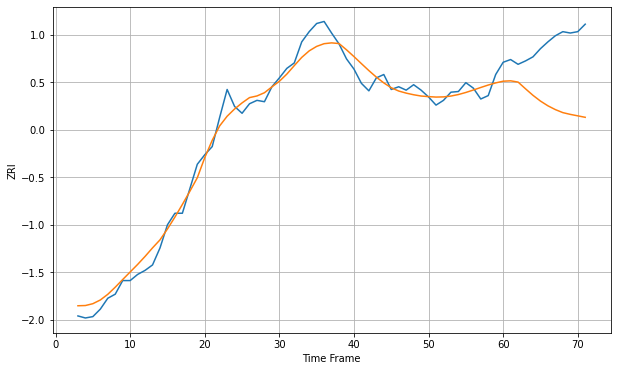

Wall time: 7.71 s
11234 15.396583725536447 89.65205303660606 [2070.16422284 2070.72405256 2068.87346856 2058.95823461 2049.36976229
 2040.94318981 2033.97971983 2028.39607661 2023.95836141 2021.3760647
 2019.23433137 2017.06296917]

Got an mse at 0.0099 in round 57 and stopped training



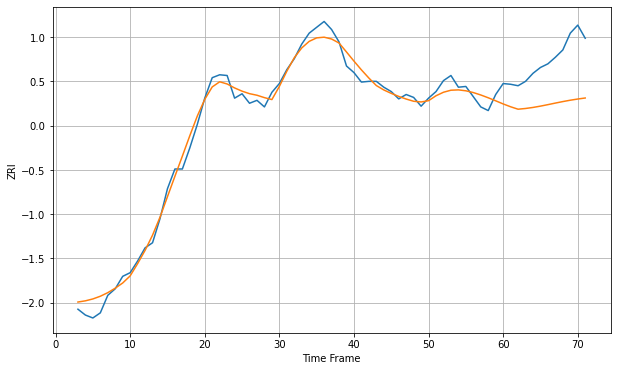

Wall time: 7.18 s
11235 11.454682840091941 62.28199888485853 [2084.08443163 2080.19724814 2076.86623046 2077.85247281 2079.27224738
 2081.06769634 2083.11301883 2085.2437904  2087.30218643 2089.17548243
 2090.80949152 2092.1983362 ]

Got an mse at 0.0100 in round 72 and stopped training



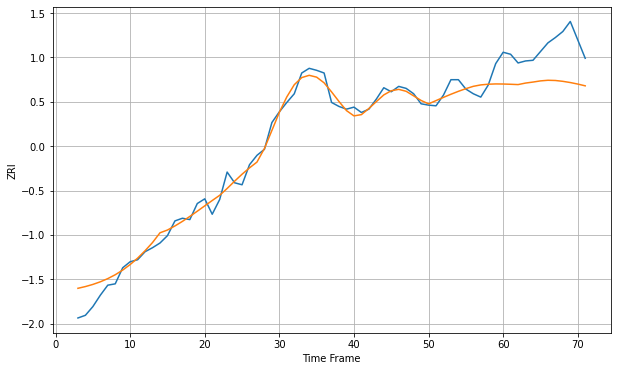

Wall time: 7.46 s
11236 14.241078123612432 55.179742521871475 [2092.5365238  2092.16418328 2091.69861552 2093.95457581 2095.46531094
 2097.20246845 2098.14202989 2097.81955239 2096.55652414 2094.74786953
 2092.47464995 2089.82798791]

Got an mse at 0.0100 in round 106 and stopped training



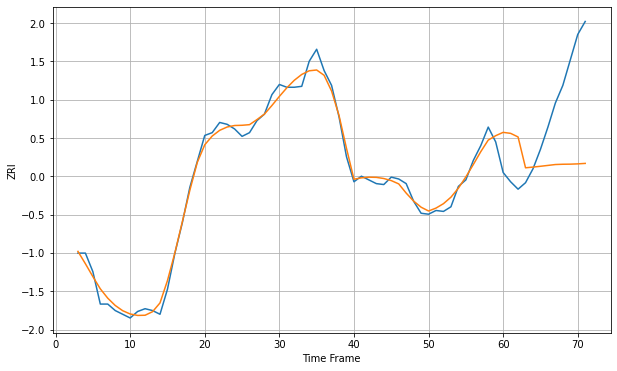

Wall time: 9.02 s
11237 7.692173041944501 80.29707715914152 [2460.32062752 2459.24611367 2455.35087495 2422.07975689 2422.84567405
 2423.70820351 2424.64376199 2425.60177688 2425.90472156 2426.00909137
 2426.30746911 2426.81820786]

Got an mse at 0.0100 in round 279 and stopped training



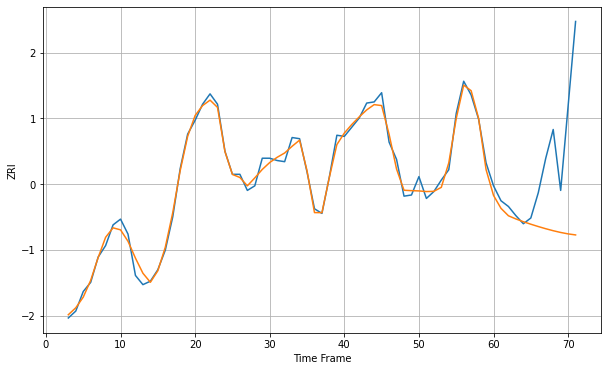

Wall time: 12.4 s
11238 5.4714263116689175 71.20448276894139 [2694.64196575 2683.39959655 2676.91854627 2674.16385457 2671.76740801
 2669.5872041  2667.55571786 2665.65854279 2663.92275718 2662.40280887
 2661.16290202 2660.26067187]

Got an mse at 0.0097 in round 34 and stopped training



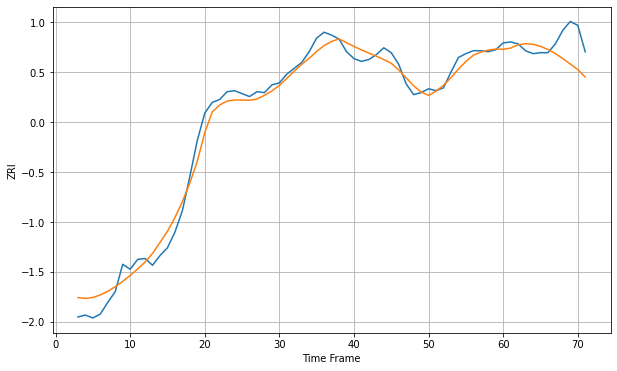

Wall time: 7.12 s
11354 10.324866819201768 22.098672437047625 [2117.4392997  2118.71750727 2122.10928517 2123.25818326 2122.61580484
 2120.5314498  2117.31560025 2113.10721263 2107.83249564 2102.41016762
 2096.69210069 2088.98803626]

Got an mse at 0.0099 in round 57 and stopped training



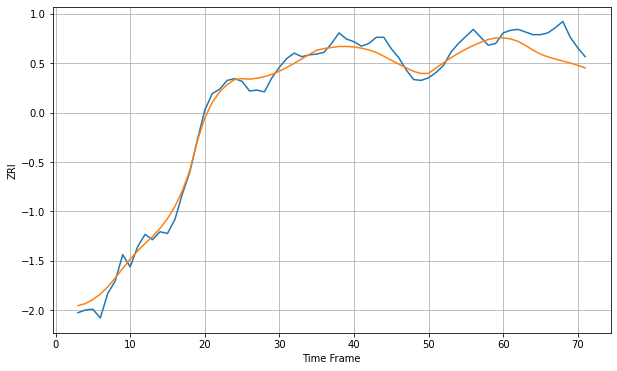

Wall time: 7.67 s
11355 9.981081544260293 23.80518146687131 [2181.39767686 2180.19171937 2177.41351479 2172.75895197 2167.44520912
 2162.9160145  2159.74915905 2157.2583605  2154.9976585  2152.75695511
 2150.09198686 2147.22784943]

Got an mse at 0.0098 in round 29 and stopped training



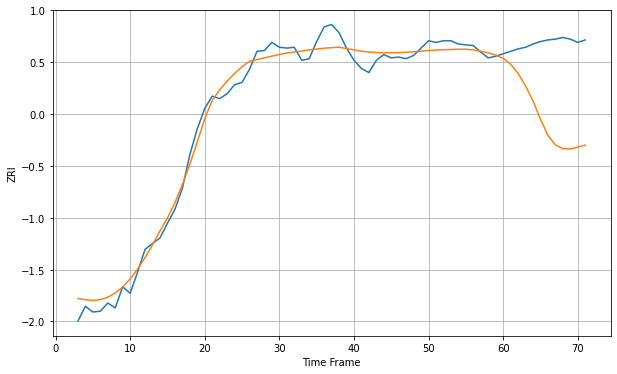

Wall time: 6.68 s
11356 12.3688797212397 99.15028707618336 [2196.51944058 2189.1648749  2178.13909931 2162.47151289 2144.31748414
 2121.64361873 2101.8651437  2090.19999564 2085.49988699 2085.16453644
 2087.39137026 2089.89630506]

Got an mse at 0.0099 in round 52 and stopped training



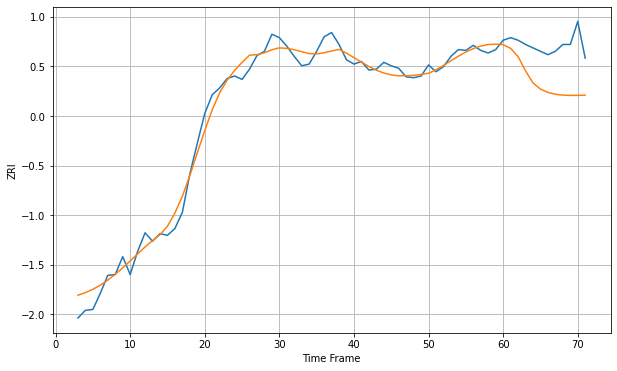

Wall time: 8.08 s
11357 11.575547382881979 46.711128628099274 [2227.82988851 2223.41372972 2213.79388885 2197.07886662 2182.86854998
 2175.65345025 2171.73476105 2169.57799084 2168.56240682 2168.23500305
 2168.28934186 2168.53282408]

Got an mse at 0.0099 in round 52 and stopped training



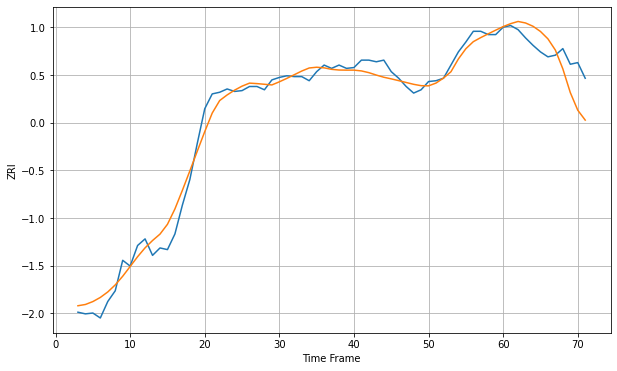

Wall time: 6.98 s
11358 12.370761919371894 28.573301134713738 [2219.69125453 2223.2692741  2225.93468489 2224.10758468 2220.11360997
 2213.79962098 2204.84043055 2191.18005884 2168.43942753 2139.62580941
 2118.24623394 2106.20403032]

Got an mse at 0.0098 in round 51 and stopped training



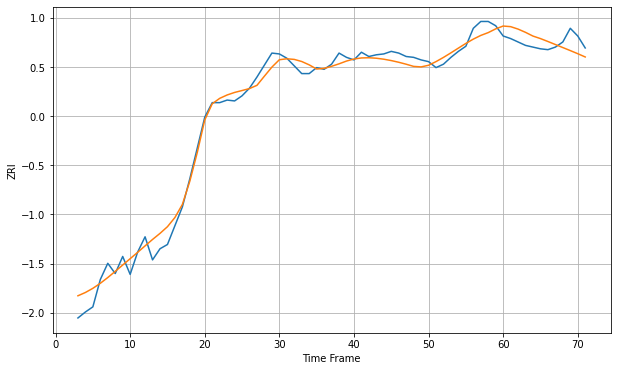

Wall time: 7.35 s
11360 10.852058153839197 14.326254704773621 [2285.64353592 2284.93218831 2282.07213016 2278.25652711 2273.88901875
 2270.96368264 2267.55596506 2264.01014535 2260.47027006 2256.91646265
 2253.27848073 2249.45074623]

Got an mse at 0.0098 in round 37 and stopped training



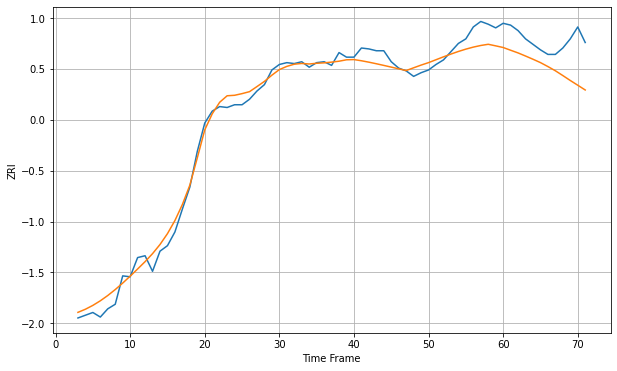

Wall time: 6.64 s
11361 10.472863917573088 33.00827721117244 [2182.54980236 2179.56445536 2176.62716035 2173.23328729 2169.72074733
 2166.05357564 2161.71553754 2157.12747198 2151.89164278 2146.49108147
 2141.33736818 2136.13399053]

Got an mse at 0.0100 in round 56 and stopped training



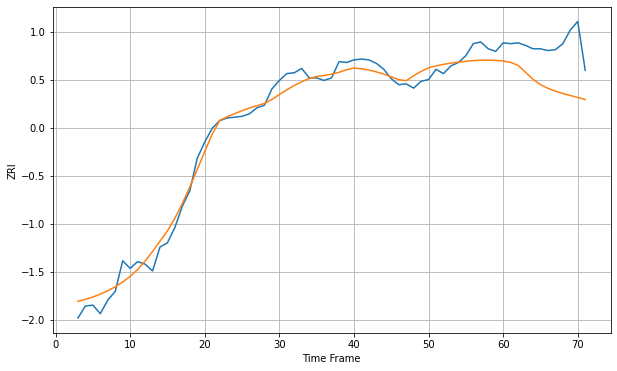

Wall time: 7.86 s
11364 11.335972531306712 48.58855050724688 [2230.66780813 2229.10207736 2225.64490457 2217.56625392 2209.25662087
 2203.08750364 2198.69686841 2195.40867066 2192.73994686 2190.3711447
 2188.07103393 2185.64586646]

Got an mse at 0.0099 in round 84 and stopped training



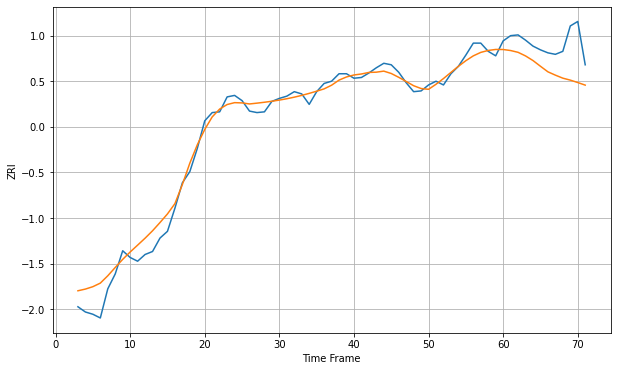

Wall time: 8.43 s
11365 13.767592444722393 38.4932531274931 [2228.44350971 2227.0802608  2224.68169318 2219.86292949 2213.66907458
 2206.01711698 2198.57425656 2194.12284106 2190.08389795 2187.46498881
 2184.23399301 2180.75319472]

Got an mse at 0.0100 in round 93 and stopped training



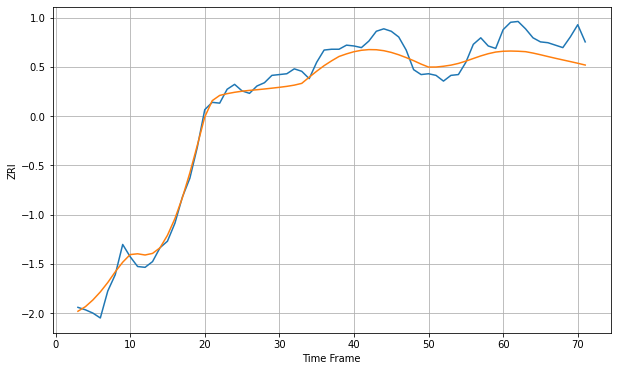

Wall time: 7.94 s
11366 13.174067232690684 27.91914554713154 [2200.54000124 2200.79340684 2200.54485552 2200.02820879 2198.31563257
 2196.26607326 2194.06872575 2191.93695697 2189.90867197 2187.90520055
 2185.83938751 2183.64881103]

Got an mse at 0.0100 in round 36 and stopped training



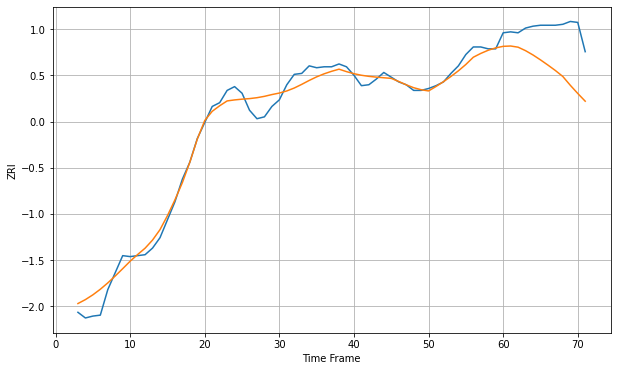

Wall time: 7.69 s
11367 9.725544801035428 44.362189567322694 [2064.65394938 2065.00695802 2063.76661543 2060.08033877 2055.52752115
 2050.34635765 2044.82433043 2039.05966619 2032.71829298 2023.42643744
 2014.76799999 2006.55947945]

Got an mse at 0.0098 in round 27 and stopped training



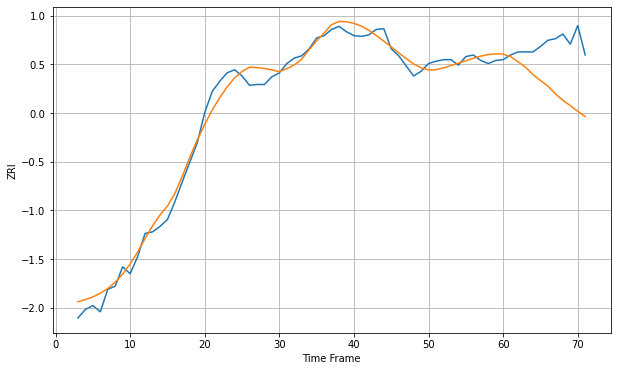

Wall time: 6.75 s
11368 11.774440059181098 60.562430351450146 [2220.18656794 2216.8499176  2210.2951906  2203.31769105 2193.71602813
 2186.03839898 2178.93451234 2168.94468163 2160.67666882 2153.79125272
 2146.38791655 2139.67958905]

Got an mse at 0.0099 in round 30 and stopped training



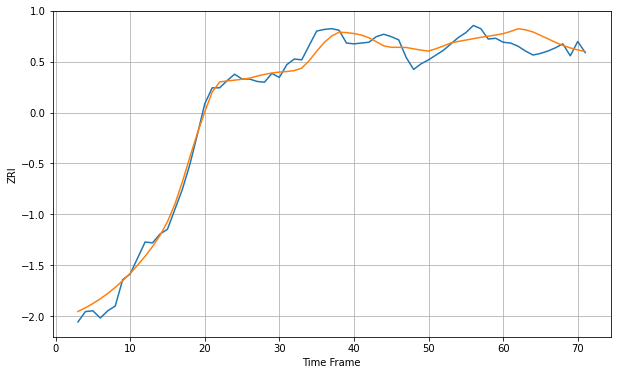

Wall time: 7.34 s
11369 11.561090656465241 16.713090298255935 [2255.75602785 2258.50718752 2261.88864453 2260.56623444 2257.82370971
 2253.60509992 2249.34783943 2244.93272111 2241.04497708 2237.94734096
 2235.45903335 2233.26537984]

Got an mse at 0.0100 in round 55 and stopped training



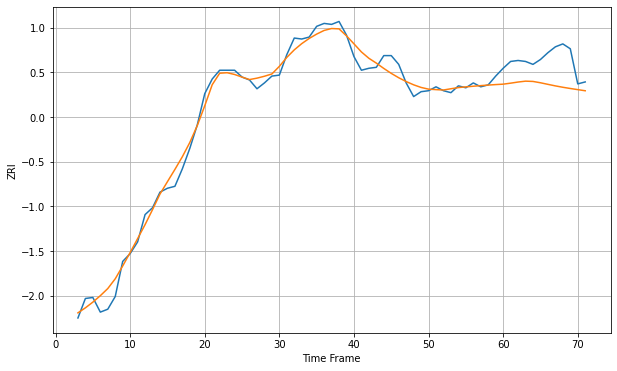

Wall time: 7.17 s
11370 8.743207237424931 27.297447582078636 [2145.71732112 2146.74240622 2147.90045661 2148.79637438 2148.51536173
 2147.14633563 2145.53019273 2143.94988909 2142.53493379 2141.27958336
 2140.11404125 2138.95805811]

Got an mse at 0.0100 in round 102 and stopped training



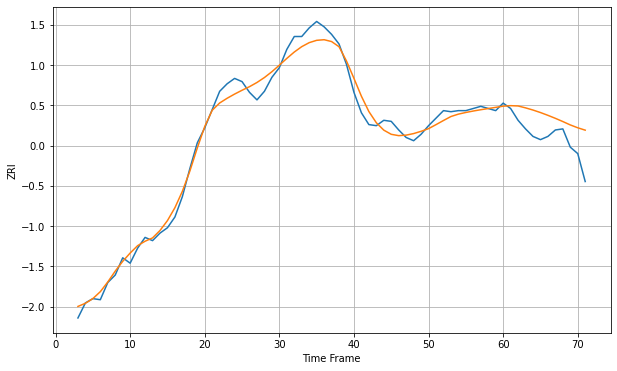

Wall time: 8.98 s
11372 8.041512616373314 21.71348464716158 [1987.13533597 1987.62905658 1987.3379237  1985.58417191 1983.55049062
 1981.2227146  1978.6233775  1975.83262332 1972.83923747 1969.69126286
 1967.0411391  1964.82188054]

Got an mse at 0.0099 in round 90 and stopped training



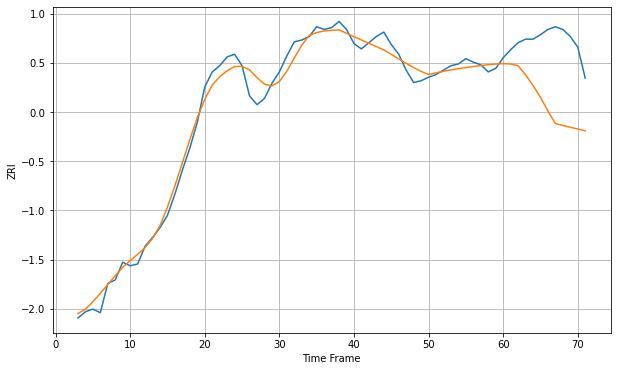

Wall time: 7.72 s
11373 10.902732029561104 73.68479409633447 [2155.38276956 2154.9204087  2153.04545921 2142.7893777  2130.72983676
 2117.35365939 2101.83950501 2087.67946376 2085.45442474 2083.45361645
 2081.50792213 2079.50030082]

Got an mse at 0.0099 in round 132 and stopped training



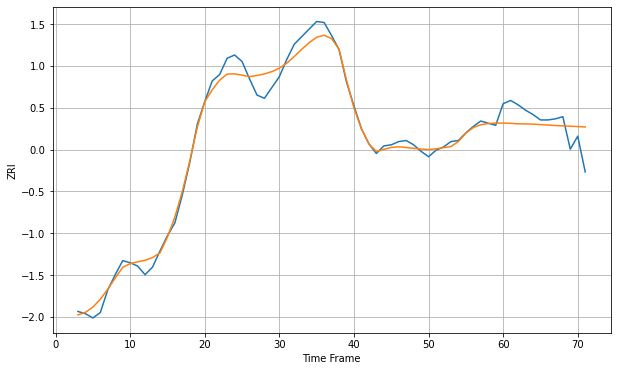

Wall time: 9.63 s
11374 7.8390527614562036 17.60672074456009 [1999.09560337 1998.89017253 1998.38531691 1998.29123806 1998.12962532
 1997.71324247 1997.28075053 1996.8845959  1996.53172086 1996.21175458
 1995.89413561 1995.52700576]

Got an mse at 0.0099 in round 113 and stopped training



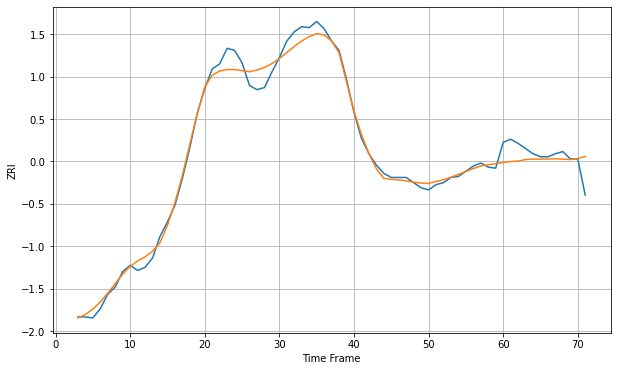

Wall time: 9.11 s
11375 7.624807994570891 15.17788042567555 [1988.44324152 1989.41840262 1989.87050204 1991.30209335 1991.74956086
 1991.80923836 1991.84287154 1992.05622061 1991.76662482 1991.30889665
 1992.32876607 1994.3356594 ]

Got an mse at 0.0099 in round 51 and stopped training



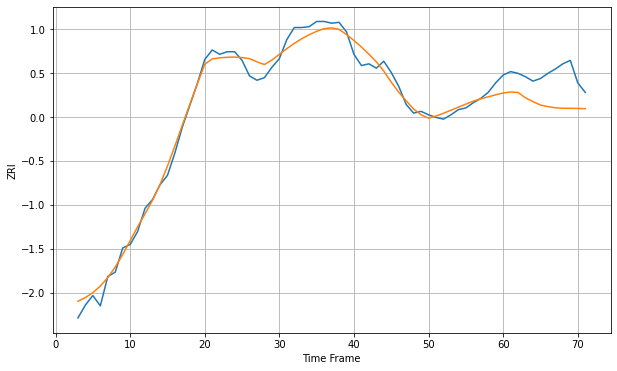

Wall time: 7.36 s
11377 9.716319648274196 34.19154702684516 [2121.22741017 2122.39529016 2121.8536858  2115.60283976 2111.26491991
 2107.32065947 2105.44982314 2104.13227908 2103.61463544 2103.52693971
 2103.40560557 2103.10475159]

Got an mse at 0.0097 in round 52 and stopped training



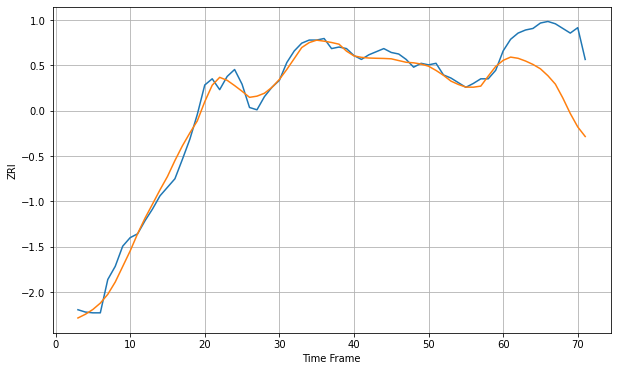

Wall time: 8.13 s
11378 10.42382111953493 73.65278541977347 [2148.82701845 2153.01694983 2151.48426133 2147.94127221 2143.53793954
 2137.88683124 2128.97864264 2118.11296324 2100.23586198 2080.20023443
 2062.88897543 2050.54388202]

Got an mse at 0.0100 in round 46 and stopped training



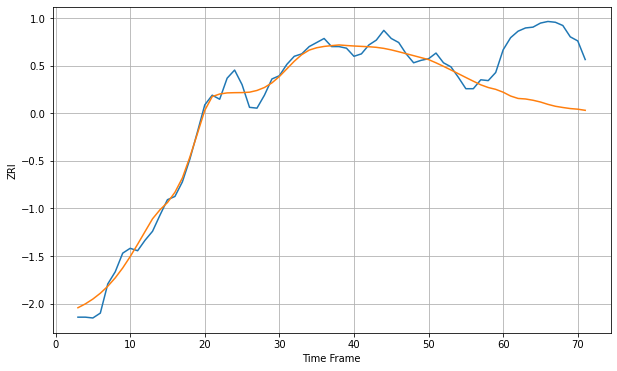

Wall time: 8.28 s
11379 11.338667135454475 86.82431468156642 [2095.69601476 2090.96116072 2087.98078284 2087.32495455 2085.75298666
 2083.58631904 2080.67685559 2078.32080956 2076.81042095 2075.49061648
 2074.72465114 2073.32457564]

Got an mse at 0.0099 in round 35 and stopped training



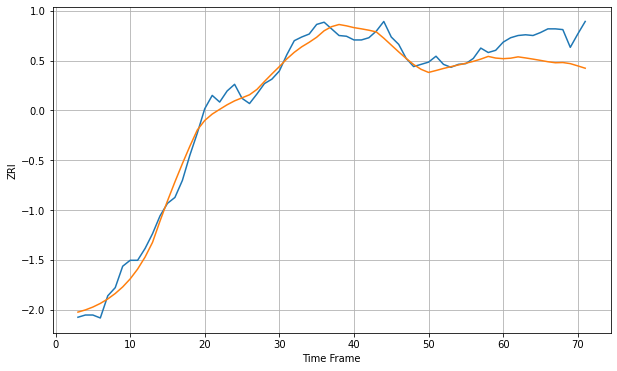

Wall time: 6.5 s
11385 12.987061451495324 38.63347712131467 [2149.68073747 2150.32596083 2152.1513393  2150.68982476 2149.08655938
 2147.36546082 2145.54337385 2144.16567932 2144.46785706 2142.98453494
 2139.93196775 2136.75980883]

Got an mse at 0.0099 in round 30 and stopped training



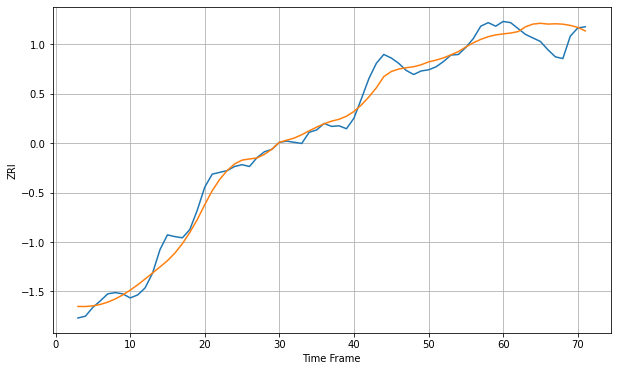

Wall time: 7.29 s
11412 16.5797762182229 30.68883051955335 [2193.87704728 2195.33777028 2197.81215711 2205.99296804 2210.54899199
 2211.89134362 2210.55796154 2211.06492737 2210.42980544 2208.30196182
 2204.99162439 2199.04314123]

Got an mse at 0.0090 in round 27 and stopped training



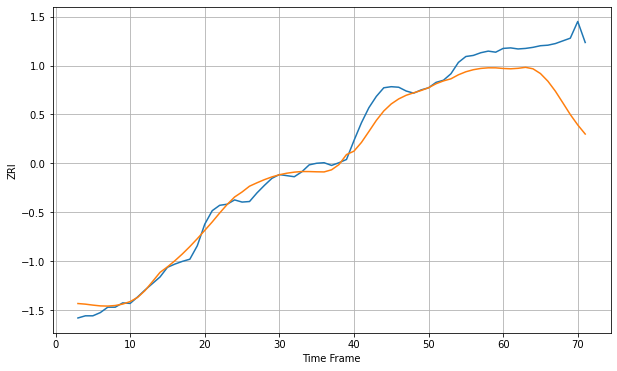

Wall time: 6.71 s
11413 18.73595939846822 100.35509443378426 [2203.82497337 2203.20237236 2204.10621094 2205.91561355 2203.19480242
 2194.38217803 2180.1531904  2161.67349094 2140.15444469 2118.35920627
 2099.05886083 2082.19044615]

Got an mse at 0.0096 in round 21 and stopped training



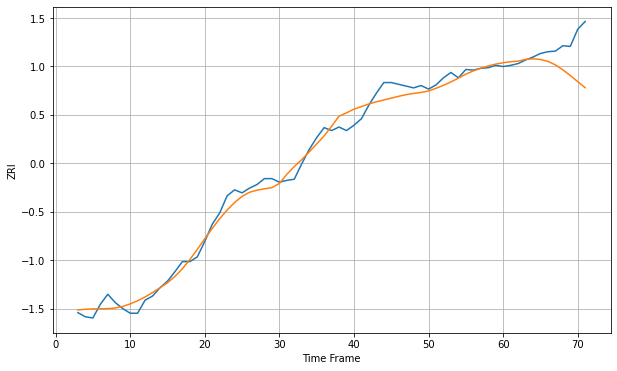

Wall time: 6.51 s
11414 13.701442602357647 46.02057638899472 [2198.39618643 2200.10043949 2201.14465783 2204.06201097 2205.07184574
 2203.96946454 2200.75241429 2194.80484766 2186.49610566 2176.82630375
 2166.42393411 2156.18422909]

Got an mse at 0.0098 in round 45 and stopped training



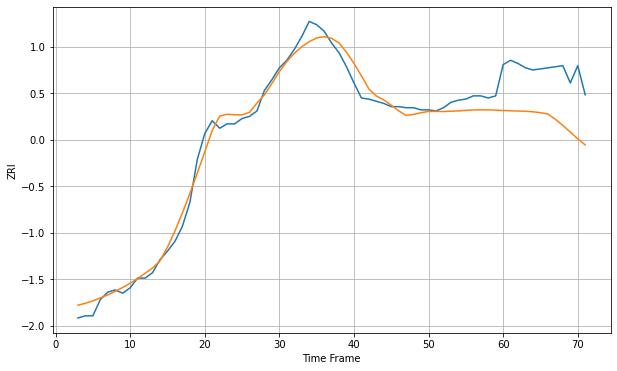

Wall time: 7.01 s
11415 9.032657080798666 47.28455811083188 [1907.42807617 1907.12807615 1906.93479934 1906.74474258 1906.21574722
 1905.42078833 1904.15660313 1899.29485711 1893.66361448 1887.37802014
 1881.21581944 1875.50735972]

Got an mse at 0.0099 in round 42 and stopped training



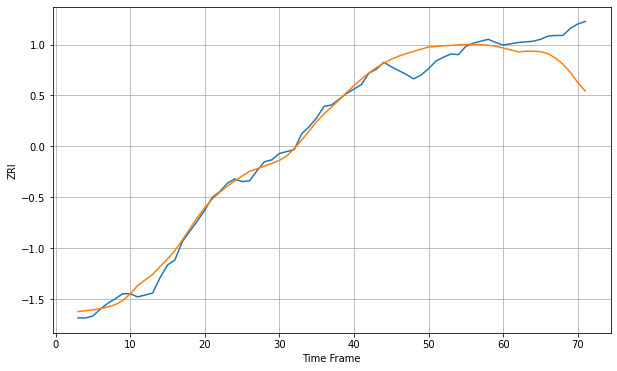

Wall time: 8.38 s
11416 14.370005819194311 50.15570839112324 [2169.33689482 2166.43079991 2163.36557315 2164.2080475  2164.41796079
 2163.69486388 2160.64247622 2153.62169561 2143.99922811 2131.32076057
 2115.26202107 2102.0617256 ]

Got an mse at 0.0090 in round 22 and stopped training



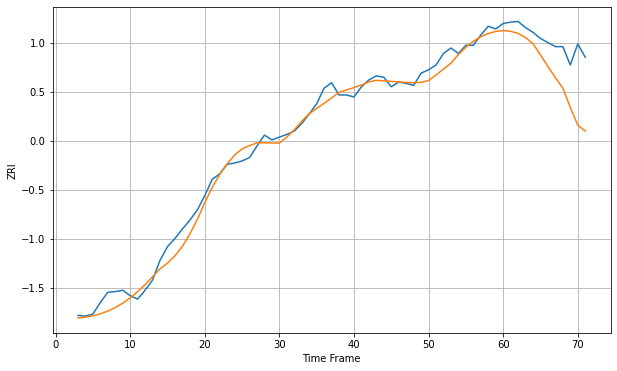

Wall time: 5.73 s
11417 12.844380418718838 56.74335847599827 [2113.67697473 2112.47080713 2109.52662027 2103.23541723 2094.1983216
 2077.75932561 2060.75539995 2044.38769746 2028.88228636 2000.64041957
 1974.70716372 1965.97652183]

Got an mse at 0.0099 in round 48 and stopped training



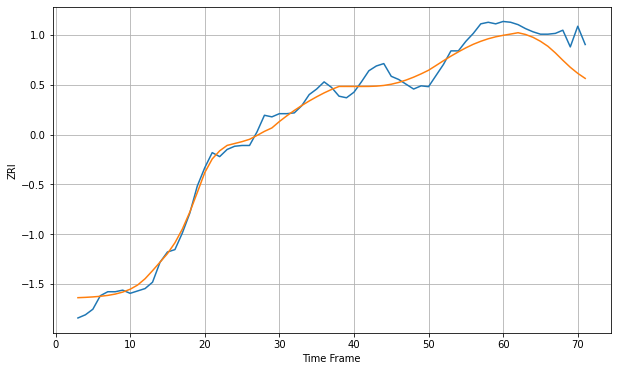

Wall time: 8.21 s
11418 12.063111974385354 27.48120897289945 [2063.56247704 2065.141911   2066.84423092 2064.6373518  2061.07729541
 2056.05666934 2049.77596789 2041.45755705 2032.1803177  2023.35845717
 2015.73301974 2009.36172833]

Got an mse at 0.0100 in round 17 and stopped training



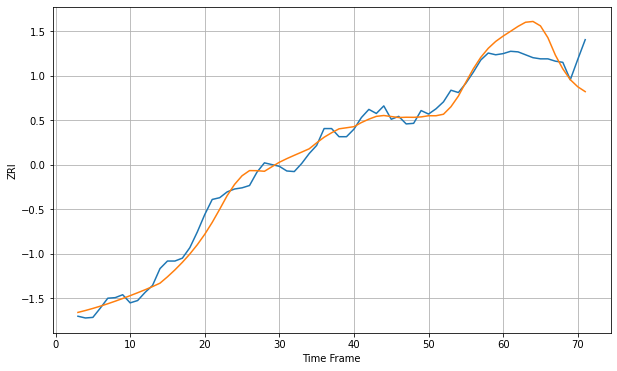

Wall time: 6.71 s
11419 15.31944706954192 46.58346289387524 [2214.19192329 2222.48963622 2230.9185819  2237.986741   2239.3410564
 2231.74661196 2211.35672838 2181.41435874 2157.69027457 2139.15554179
 2126.95618828 2118.56916759]

Got an mse at 0.0098 in round 32 and stopped training



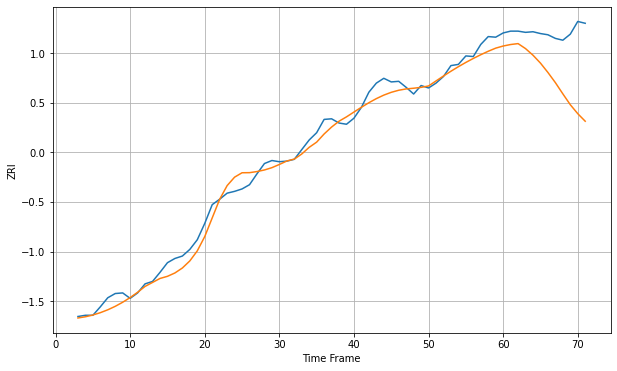

Wall time: 6.74 s
11420 14.41298073509891 84.77020691907339 [2159.37263184 2161.86326751 2163.37754033 2155.10590203 2144.18939102
 2131.13216399 2115.64910134 2098.82700143 2080.2977382  2062.3185528
 2047.4893819  2034.99040647]

Got an mse at 0.0097 in round 33 and stopped training



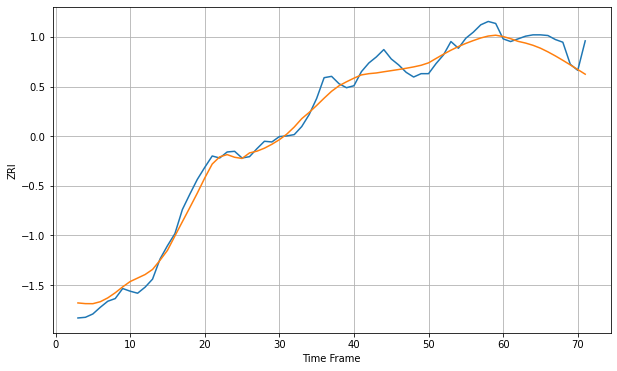

Wall time: 7.75 s
11421 13.99604735622381 20.809920983856827 [2136.45045758 2133.29275758 2129.30492667 2126.7373701  2123.4023665
 2119.06752846 2113.59143778 2107.5147701  2100.97494627 2094.14081349
 2087.19789197 2080.21140181]

Got an mse at 0.0093 in round 25 and stopped training



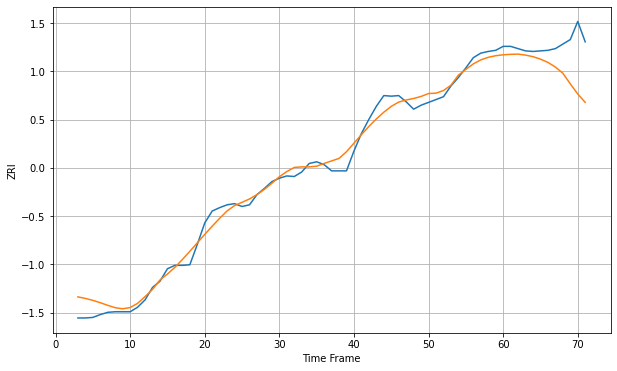

Wall time: 7.05 s
11422 15.14344063278726 57.03129904878504 [2214.08575389 2214.91205838 2215.33868093 2213.55051669 2210.79096454
 2206.48381135 2200.64878099 2192.49675829 2181.49282258 2162.77122914
 2144.79322427 2130.02561274]

Got an mse at 0.0100 in round 40 and stopped training



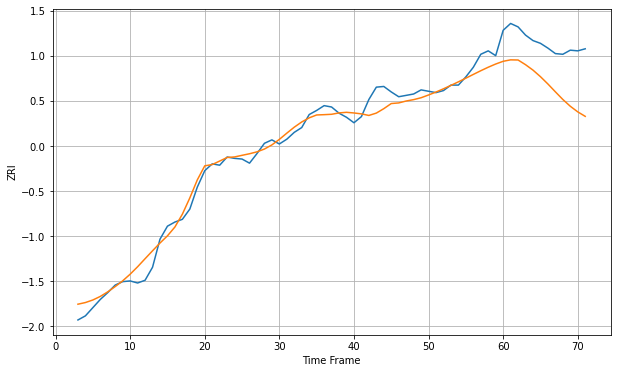

Wall time: 6.72 s
11423 13.546632701238032 63.181259191389486 [2060.74192635 2062.8612496  2062.64613823 2055.79443048 2047.85860656
 2038.29970232 2027.61061929 2016.17408011 2005.00296148 1995.10183979
 1986.90233825 1980.35806919]

Got an mse at 0.0100 in round 79 and stopped training



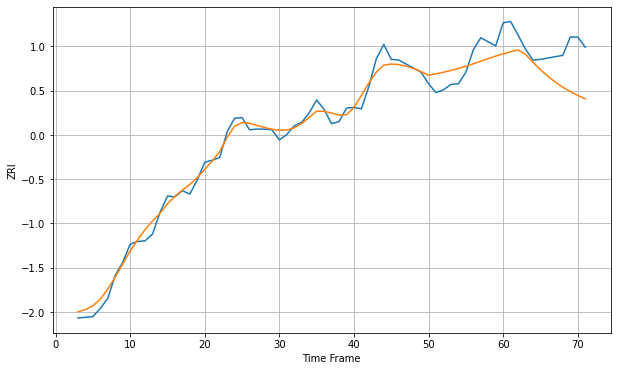

Wall time: 8.53 s
11426 13.5860920620302 49.17177873394917 [2118.19793329 2121.26255205 2123.94242914 2117.3867762  2105.76872707
 2094.84132505 2084.96699283 2076.30499949 2068.82935984 2062.38683125
 2056.76085154 2051.7246198 ]

Got an mse at 0.0100 in round 55 and stopped training



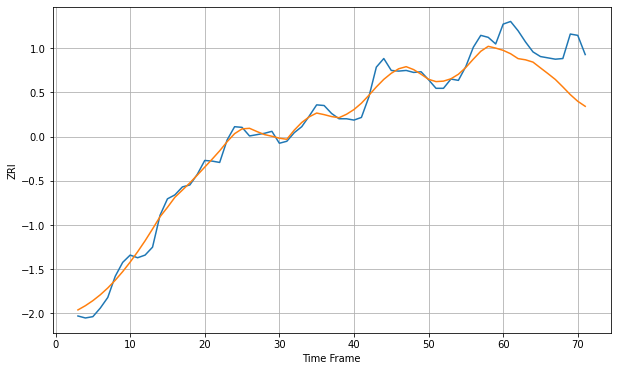

Wall time: 7.73 s
11427 12.501751610964076 53.794527919719506 [2139.37389827 2134.22707558 2126.8752524  2125.052124   2121.5890373
 2112.8739314  2104.26298693 2095.32095452 2084.147328   2072.49594411
 2062.40863684 2054.81257545]

Got an mse at 0.0100 in round 84 and stopped training



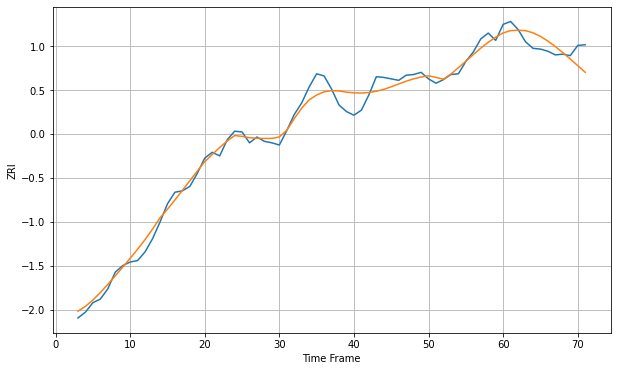

Wall time: 7.4 s
11428 11.531098399893091 17.949644792297946 [2069.24374663 2072.38934958 2072.94131761 2072.36465297 2069.4108035
 2064.44701346 2057.9759425  2050.44583124 2042.15421895 2033.32012113
 2024.18284797 2015.0216518 ]

Got an mse at 0.0099 in round 65 and stopped training



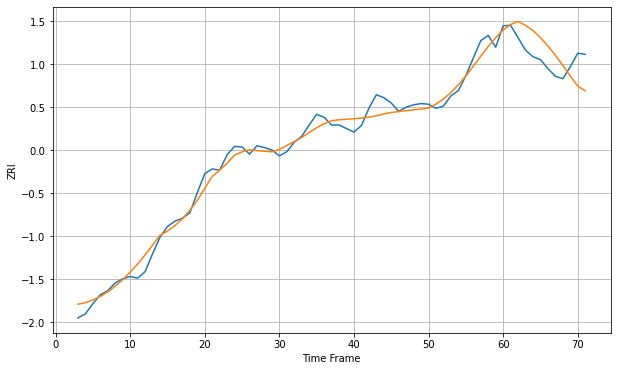

Wall time: 8.76 s
11429 13.825064389127865 36.71246311979422 [2152.05105019 2161.20905087 2166.35658519 2159.66961887 2151.18411104
 2139.0618798  2125.16966392 2109.50745404 2092.307566   2074.59421525
 2057.45008118 2049.55987095]

Got an mse at 0.0081 in round 21 and stopped training



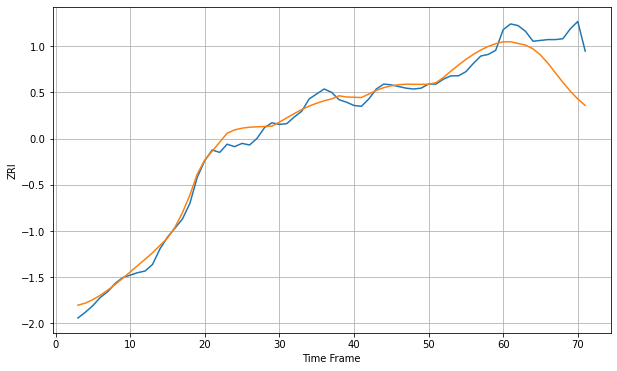

Wall time: 6.54 s
11432 9.003492834434917 46.542796615956874 [2001.2063014  2001.35182464 1999.32981548 1997.34760708 1992.80175138
 1985.35823366 1975.29529321 1963.66817393 1952.16235587 1941.39623954
 1931.93107056 1923.99074233]

Got an mse at 0.0099 in round 42 and stopped training



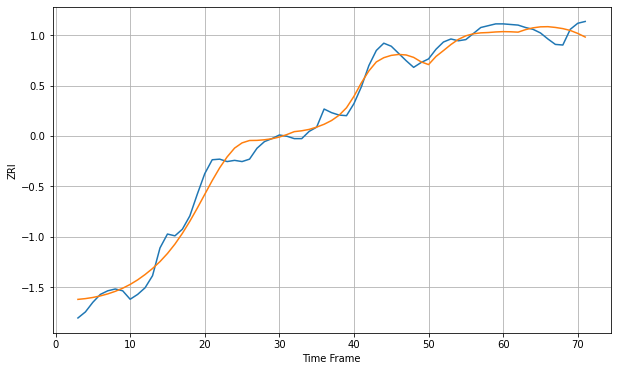

Wall time: 7.2 s
11433 16.198313852779055 16.982586574365268 [2195.16586164 2194.92234247 2194.29462311 2198.46894946 2201.43164428
 2203.09865353 2203.36634659 2202.10938231 2200.16253989 2197.10052107
 2192.21318609 2186.21628387]

Got an mse at 0.0097 in round 24 and stopped training



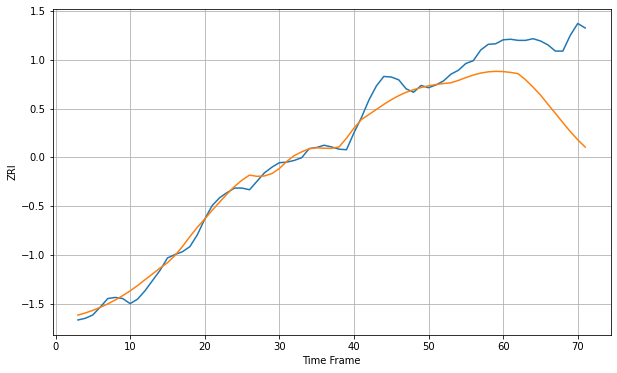

Wall time: 6.44 s
11434 18.90667413621817 124.94070196408336 [2138.60026531 2137.1831238  2134.94313609 2124.24589369 2111.22674685
 2097.13255386 2080.64368709 2064.56166376 2048.24614741 2032.23830227
 2017.6165557  2004.66135006]

Got an mse at 0.0094 in round 22 and stopped training



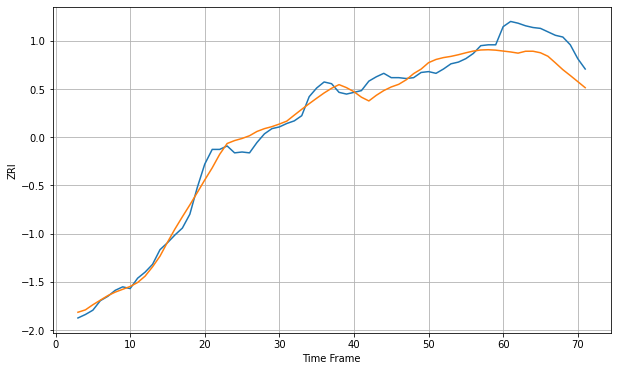

Wall time: 7.78 s
11435 9.932674412019933 30.726249346377827 [1983.76922537 1982.72683711 1981.35406506 1983.54959668 1983.57286702
 1981.79926338 1977.77390875 1970.13679796 1962.25404029 1955.46027925
 1948.44907478 1941.36430796]

Got an mse at 0.0091 in round 33 and stopped training



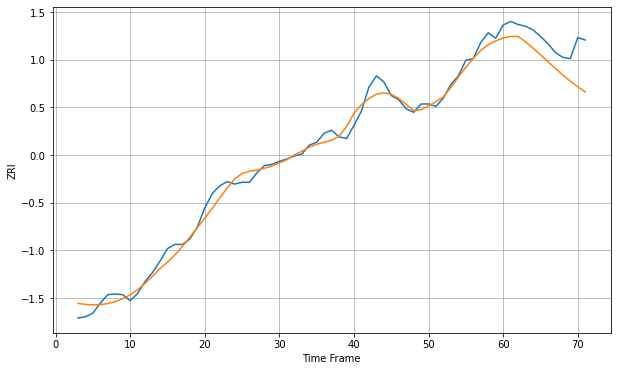

Wall time: 6.58 s
11436 12.620428914458525 43.109290428527 [2118.34575659 2120.96249793 2120.95302692 2111.92213126 2101.51941473
 2090.31737604 2078.80885293 2067.40331589 2056.42507517 2046.11941681
 2036.65888954 2028.14287463]

Got an mse at 0.0098 in round 27 and stopped training



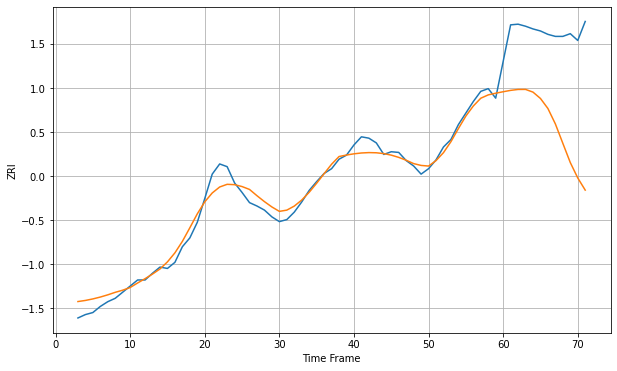

Wall time: 7.49 s
11542 12.518501581834544 141.46224325004144 [2355.42344632 2357.4368502  2358.80180427 2358.86955944 2354.86827552
 2345.52231637 2330.73428277 2307.9707811  2279.41901823 2251.06347589
 2228.37309477 2210.44872427]

Got an mse at 0.0100 in round 130 and stopped training



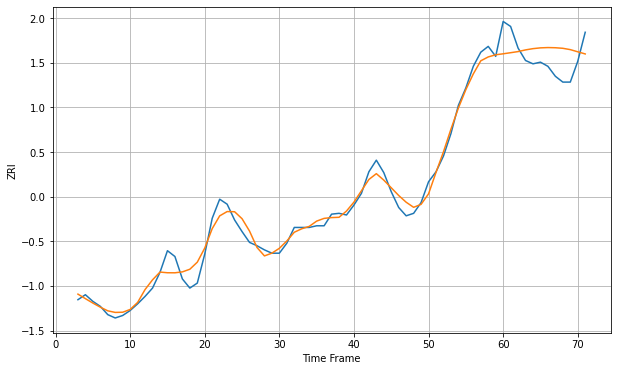

Wall time: 9.35 s
11550 10.090655425182042 27.40985994777641 [2249.06732708 2250.38282911 2251.7389327  2253.76564973 2255.27399407
 2256.21861339 2256.57435226 2256.36339729 2255.69579063 2254.09585385
 2251.48514887 2248.89095411]

Got an mse at 0.0100 in round 43 and stopped training



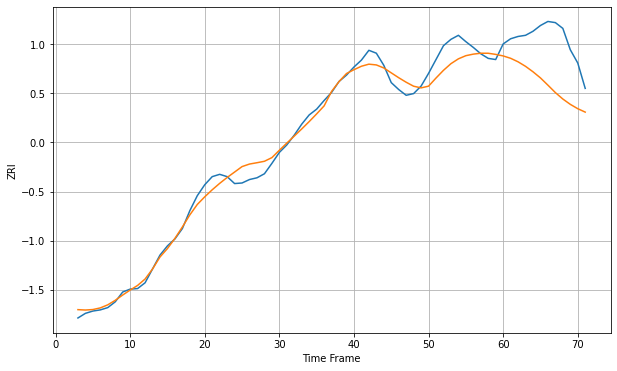

Wall time: 7.49 s
11561 16.596996981777636 80.83328875247652 [2478.24647876 2474.1610808  2468.04486051 2460.21749914 2450.77764613
 2440.14094946 2427.58897401 2414.71216344 2403.57269901 2394.31089924
 2386.79937851 2380.85676504]

Got an mse at 0.0100 in round 166 and stopped training



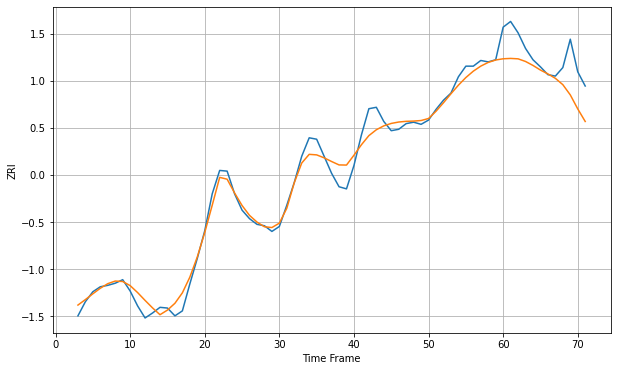

Wall time: 10.2 s
11563 13.445039333338377 39.22342627644691 [2292.39042842 2292.90278952 2292.32038189 2288.60582399 2283.01570129
 2276.48970696 2271.06944874 2264.82808034 2255.90068162 2241.46648764
 2221.72908668 2204.01982332]

Got an mse at 0.0099 in round 120 and stopped training



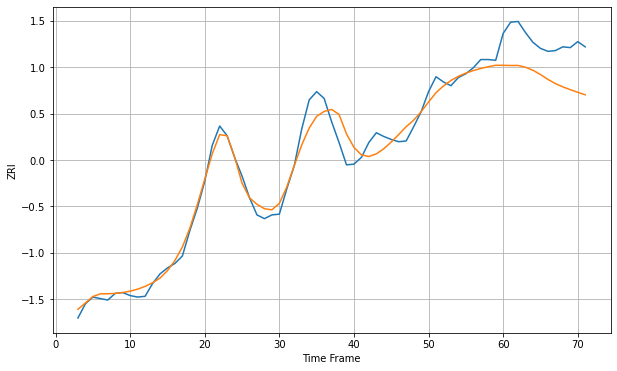

Wall time: 9.53 s
11580 14.495860510699817 51.2730697194298 [2201.29706579 2201.038718   2201.08559531 2198.71555729 2194.6006315
 2188.95299626 2182.40411407 2176.82192074 2172.44558398 2168.67834265
 2165.18258643 2161.81776012]

Got an mse at 0.0100 in round 65 and stopped training



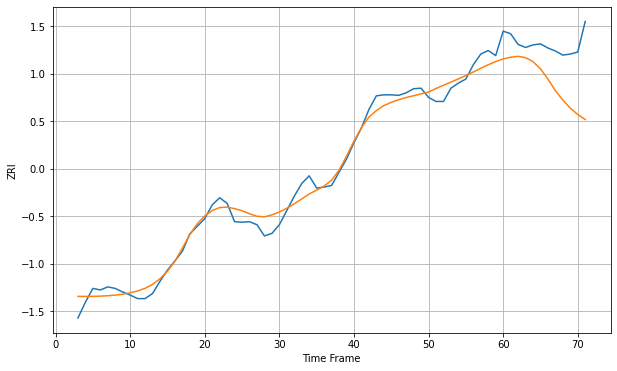

Wall time: 7.2 s
11590 17.879565486806744 86.81019044768156 [2555.45846398 2558.80322188 2560.64045895 2557.94438603 2550.24796733
 2536.04692126 2515.98906326 2493.24486928 2474.6908615  2459.05882551
 2446.27044158 2436.50735729]

Got an mse at 0.0089 in round 50 and stopped training



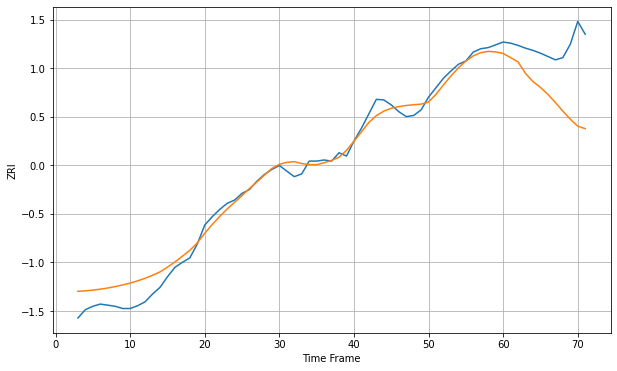

Wall time: 7.89 s
11691 20.16114832776126 97.09768018805798 [2192.43410602 2184.97504067 2177.29103926 2156.49938466 2141.91930273
 2131.44739018 2118.89059444 2104.3042541  2088.85054715 2074.23109822
 2061.75877526 2057.33768446]

Got an mse at 0.0100 in round 23 and stopped training



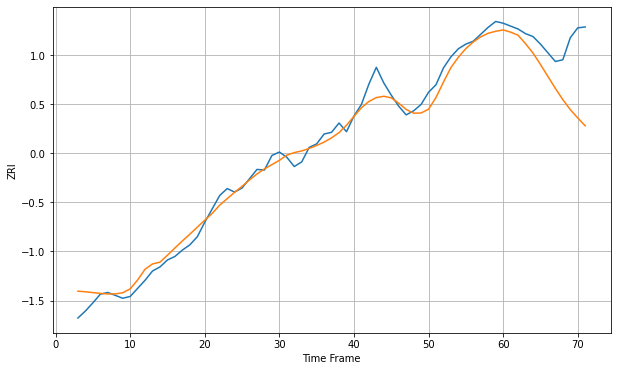

Wall time: 6.84 s
11692 16.79581547269269 81.5074430091525 [2196.43284733 2192.64066326 2187.27421856 2172.75538628 2156.57505886
 2136.88867087 2116.27998096 2095.68618988 2076.25868522 2059.04445521
 2044.73373119 2031.12924582]

Got an mse at 0.0098 in round 47 and stopped training



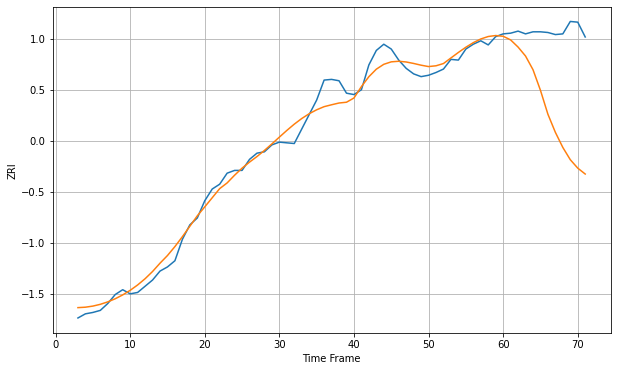

Wall time: 7.57 s
11694 14.241716357951724 128.35082902376064 [2155.53785316 2150.26405422 2139.86532705 2126.87144585 2107.08064482
 2077.16228903 2042.45348839 2016.19919996 1994.30059134 1976.51983937
 1964.29564534 1955.74952159]

Got an mse at 0.0099 in round 130 and stopped training



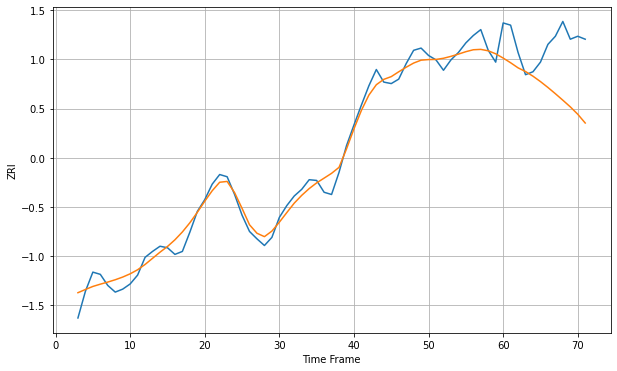

Wall time: 9.45 s
11758 12.928024935515294 70.19098146791326 [2414.50521792 2408.16376795 2401.26844379 2396.27596133 2389.96305571
 2382.69864523 2374.74659917 2366.29583771 2357.522812   2348.52189191
 2338.51927026 2326.67874518]

Got an mse at 0.0099 in round 119 and stopped training



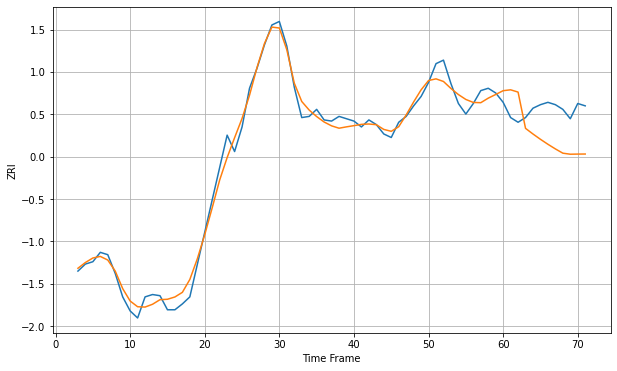

Wall time: 8.96 s
12047 7.553355031010203 30.737277237377928 [1140.9363432  1141.68175775 1139.73834173 1108.79032113 1103.97054559
 1099.44670432 1095.21137146 1091.25266583 1087.61821909 1086.73029068
 1086.84178966 1086.89208989]


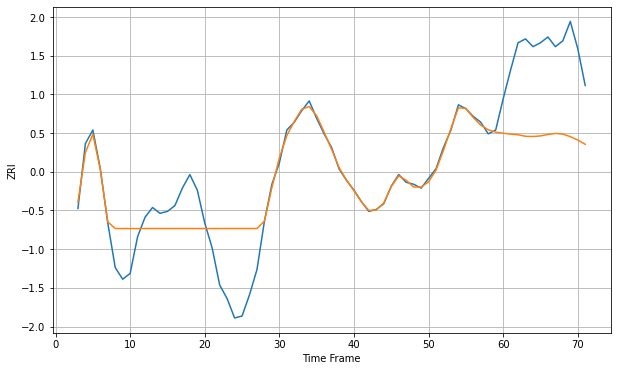

Wall time: 17 s
12180 14.398817410413745 44.88728746980713 [1000.32873625  999.86576627  999.52601495  998.7563108   998.64965621
  998.93435775  999.67939026 1000.22468301  999.88315384  998.58468494
  996.81846979  994.62066663]

Got an mse at 0.0099 in round 159 and stopped training



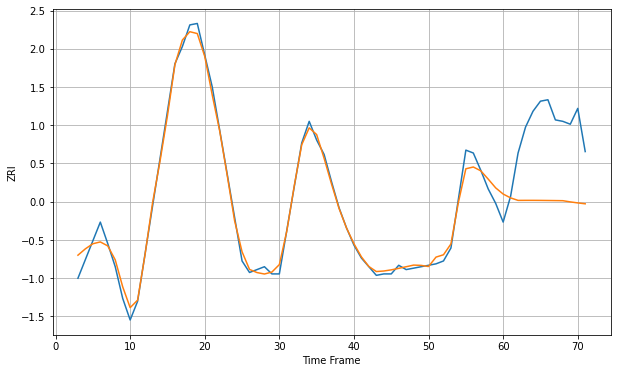

Wall time: 10.9 s
12182 5.128713912970522 51.84860110445308 [998.4937252  995.81567735 994.07916553 994.10238027 994.10417778
 994.06990794 994.01084207 993.94922282 993.87114991 993.03609416
 992.32810125 991.71145529]

Got an mse at 0.0099 in round 123 and stopped training



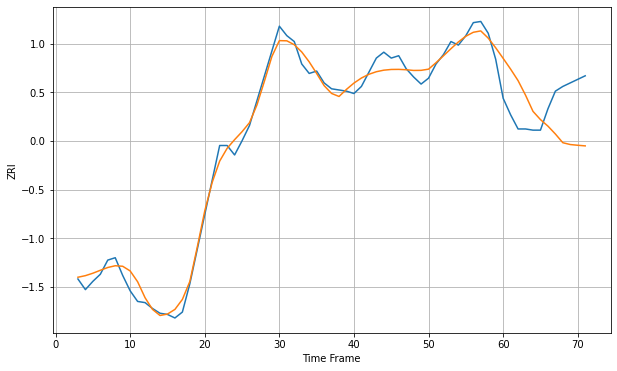

Wall time: 8.91 s
12189 7.55319446922186 39.38426256397125 [1129.7705942  1120.65368211 1110.92285352 1098.60578221 1084.89999709
 1077.948444   1072.41945122 1065.73994316 1058.36018467 1056.81693251
 1056.19940661 1055.67621623]

Got an mse at 0.0098 in round 189 and stopped training



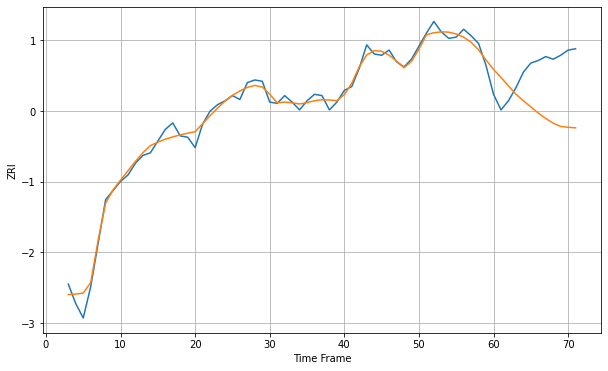

Wall time: 10.5 s
12202 5.1453453255529515 40.10819617656099 [1100.14248315 1093.97173951 1087.45430083 1081.13846697 1076.02808257
 1071.28630426 1066.56730196 1062.36685725 1058.78678011 1056.27997965
 1055.64806165 1055.19556891]

Got an mse at 0.0100 in round 61 and stopped training



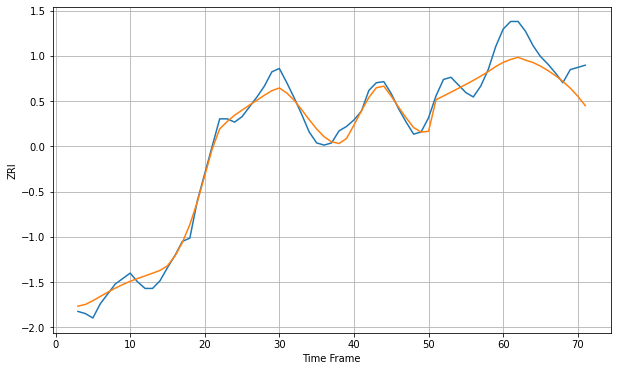

Wall time: 7.79 s
12203 8.49169754999573 23.441231107033097 [1283.60274946 1286.27221586 1288.21826859 1285.65529727 1283.49158801
 1280.17659597 1276.15537026 1271.5297867  1266.2381329  1260.07261252
 1252.74422142 1244.1335057 ]

Got an mse at 0.0099 in round 51 and stopped training



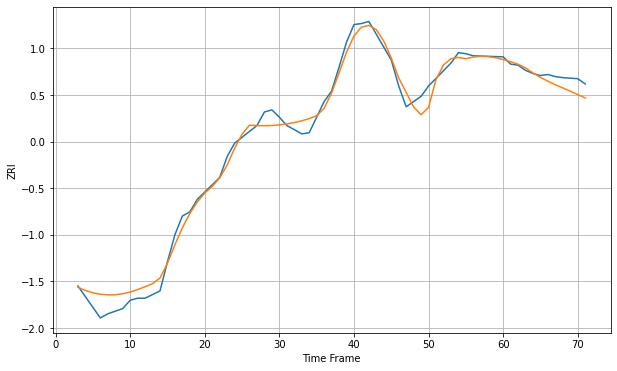

Wall time: 7.61 s
12206 9.13074932245282 8.133606152783445 [1234.39413707 1232.30051967 1229.88437736 1226.32814785 1221.54198982
 1217.25210098 1213.53135296 1210.20827457 1207.07015435 1203.96634135
 1200.76583066 1197.51283396]


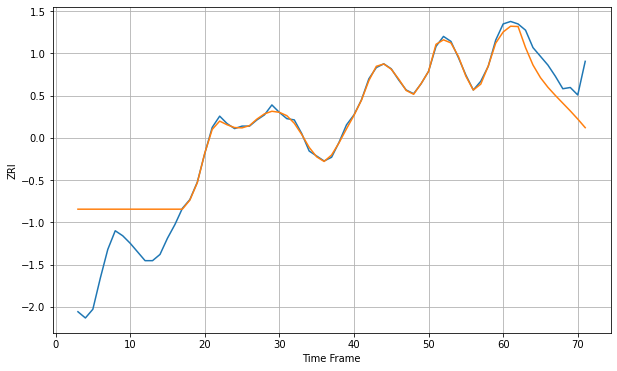

Wall time: 17.5 s
12208 24.12851290491314 20.400703556726317 [1290.5431151  1295.18088964 1294.93072923 1278.01709322 1264.03475546
 1253.90886688 1246.18349905 1239.6143796  1233.39202862 1227.19375583
 1220.66847173 1213.75738338]

Got an mse at 0.0100 in round 62 and stopped training



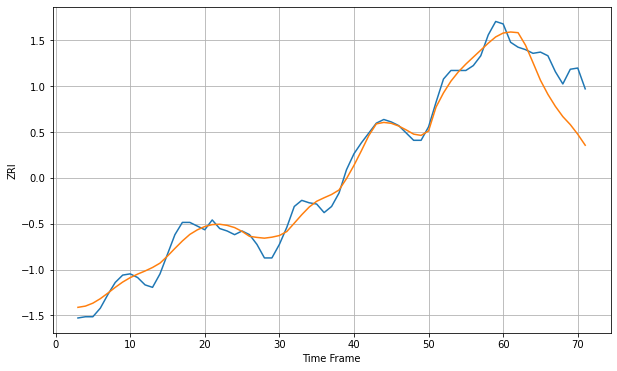

Wall time: 7.81 s
12209 7.761862447667217 29.502927557431786 [1187.55093578 1188.40453609 1187.84359295 1177.5931018  1163.42778118
 1149.02454859 1137.50580259 1127.71518259 1119.35690089 1112.82571667
 1104.94761389 1095.99553637]

Got an mse at 0.0100 in round 166 and stopped training



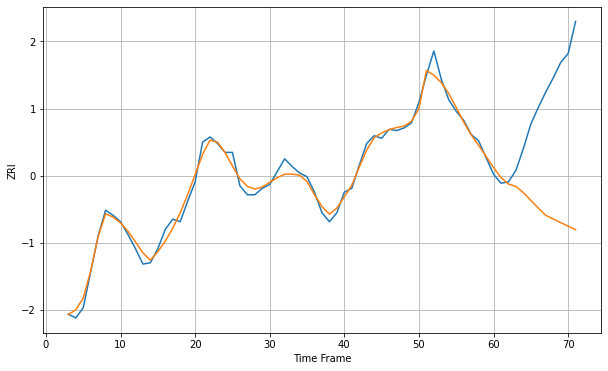

Wall time: 10.1 s
12210 5.2919962403516445 87.69154180697797 [1046.26009711 1038.39597321 1033.34061563 1031.46803248 1026.66968977
 1020.64917745 1014.5845846  1009.02478027 1006.0762874  1003.30363997
 1000.5752327   997.80521675]

Got an mse at 0.0099 in round 171 and stopped training



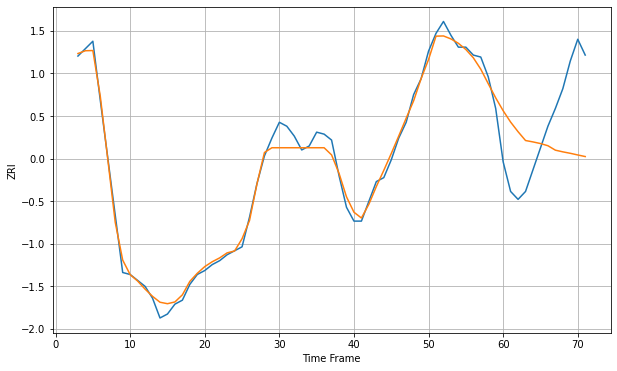

Wall time: 10.1 s
12303 4.168092474710153 33.84391501501812 [1018.84977116 1013.10188047 1008.22203888 1003.77298927 1003.06277592
 1002.24702182 1001.14010758  998.89124577  998.03865331  997.30604525
  996.46679594  995.66207472]

Got an mse at 0.0097 in round 139 and stopped training



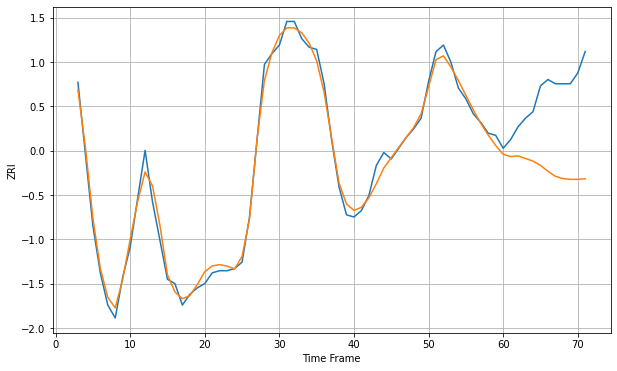

Wall time: 9.6 s
12304 3.7397501626145195 36.5908561201717 [1013.17143396 1012.12073288 1012.4079325  1011.2194943  1010.009247
 1008.02441799 1005.29354563 1002.92935415 1001.85811251 1001.49629838
 1001.51479632 1001.78351202]

Got an mse at 0.0097 in round 96 and stopped training



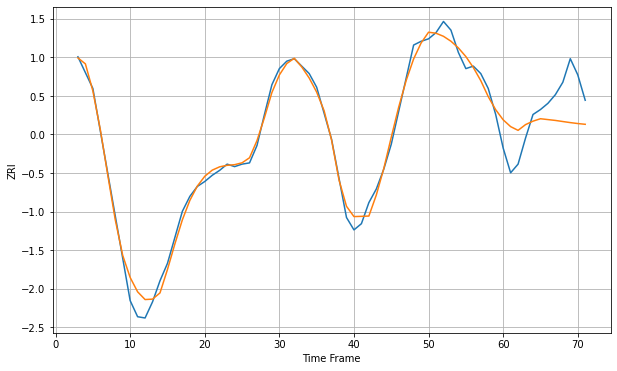

Wall time: 8.1 s
12306 6.5456316030007 27.42310432046156 [1059.73608443 1054.2406536  1051.22697269 1055.86048554 1058.63824096
 1060.59292903 1059.90822634 1059.22736024 1058.34687644 1057.47583307
 1056.72919904 1056.11186641]

Got an mse at 0.0100 in round 176 and stopped training



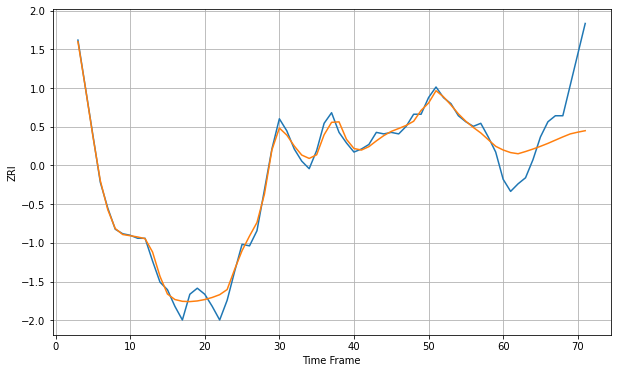

Wall time: 10.4 s
12307 4.66458686567356 30.550980593561214 [955.36654511 953.64897287 952.88064784 954.3488145  955.99046779
 957.79063815 959.72935126 961.88267815 964.01159747 966.00159964
 967.14032202 968.11719753]

Got an mse at 0.0100 in round 266 and stopped training



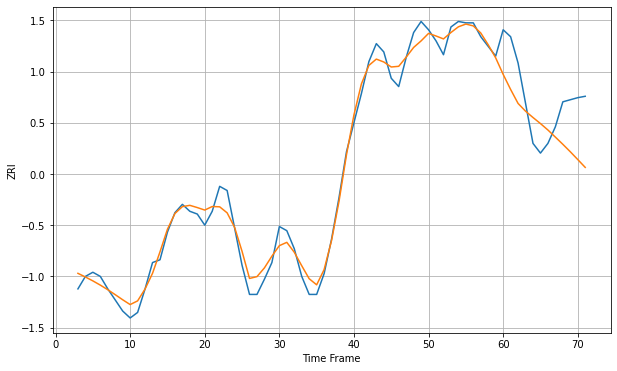

Wall time: 11.9 s
12401 7.566954390753787 30.678875588577228 [1409.82472148 1398.94158676 1388.83591174 1383.25694449 1378.67934938
 1374.31445646 1369.66852231 1364.53553227 1359.34768674 1353.97048885
 1348.35549449 1342.68217021]

Got an mse at 0.0097 in round 33 and stopped training



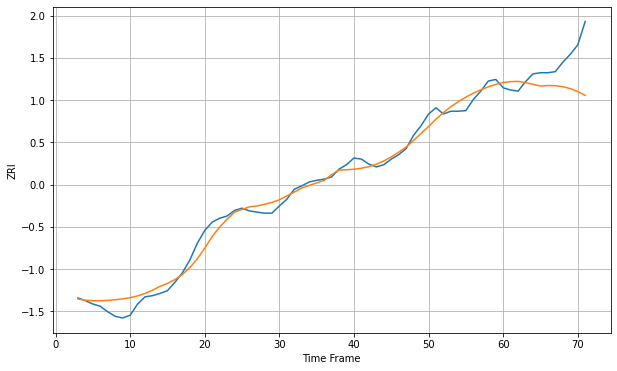

Wall time: 7.43 s
12508 14.324143042177527 52.43190854475762 [1592.37758088 1594.02410887 1594.48464375 1592.32305158 1589.16722053
 1586.18894449 1587.00195877 1586.77941269 1585.02040929 1581.52020549
 1576.28733573 1569.49088693]

Got an mse at 0.0099 in round 114 and stopped training



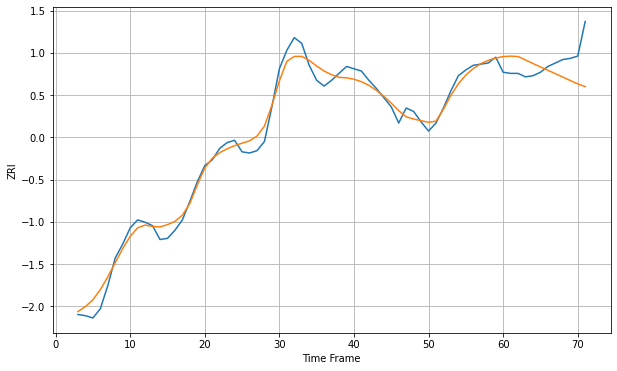

Wall time: 8.93 s
12550 7.674699805438561 21.281529503626302 [1415.56505836 1415.95172538 1415.61609065 1412.58039847 1409.53905393
 1406.57178201 1403.66673806 1400.75541369 1397.75832675 1394.80360524
 1391.88098621 1389.52012668]

Got an mse at 0.0099 in round 31 and stopped training



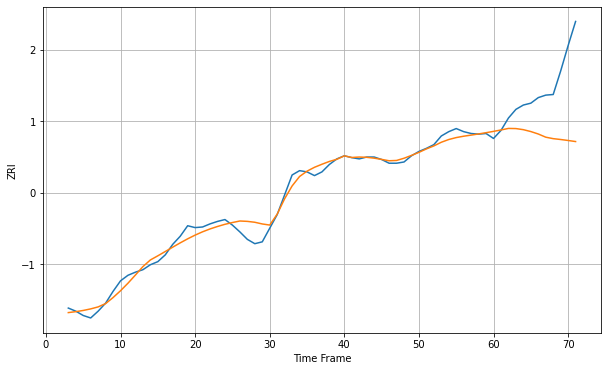

Wall time: 6.88 s
12590 10.901333630311361 87.36775406474338 [1501.43972197 1503.70959263 1506.20278741 1505.97702559 1504.19526649
 1501.15831563 1497.19753726 1492.06329538 1489.68672524 1488.31437576
 1486.72929844 1485.00579769]

Got an mse at 0.0098 in round 42 and stopped training



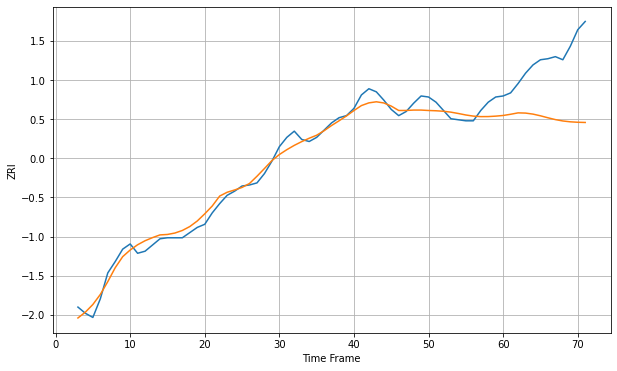

Wall time: 6.71 s
12601 7.45834334399499 58.85022659238504 [1228.15604078 1229.31877839 1230.67607818 1230.46818799 1229.47212762
 1227.84451092 1225.93398264 1224.17113849 1222.85022497 1222.02883835
 1221.59884871 1221.3988285 ]

Got an mse at 0.0098 in round 95 and stopped training



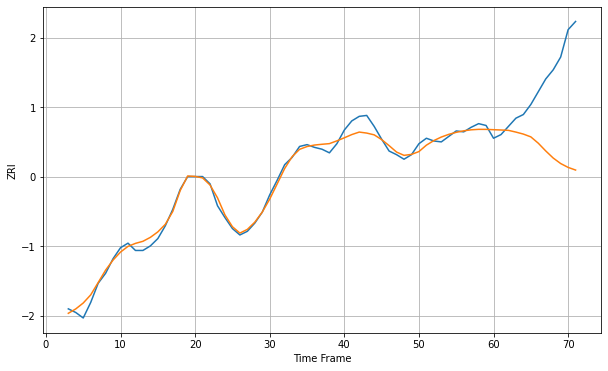

Wall time: 8.69 s
12603 6.500054652921826 83.5591652899932 [1399.36862813 1399.03802591 1398.64459392 1396.74560808 1394.5604055
 1391.5021734  1384.55642037 1376.07120326 1368.30942844 1362.27736718
 1358.04407065 1355.13664155]

Got an mse at 0.0100 in round 165 and stopped training



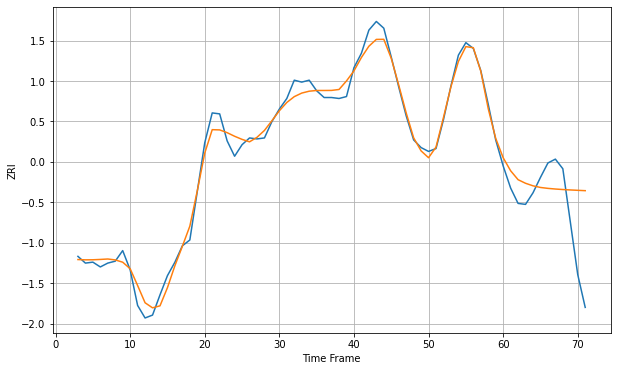

Wall time: 9.39 s
12866 9.173277224170349 47.63478208461901 [1692.47052136 1678.93611369 1669.6515491  1665.91880211 1663.27515295
 1661.57410462 1660.62696577 1659.94690117 1659.42098131 1658.98729312
 1658.60188489 1658.23497057]

Got an mse at 0.0099 in round 223 and stopped training



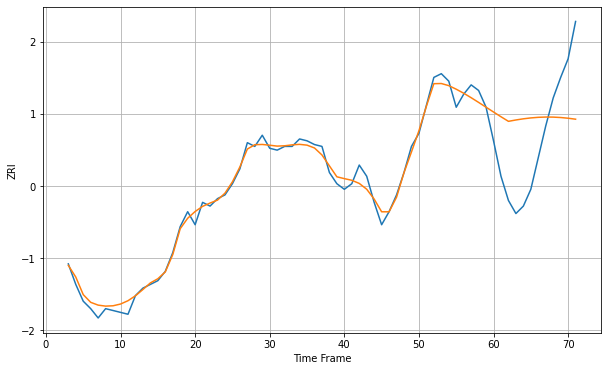

Wall time: 11.9 s
13203 3.8135980177229234 34.219984530879124 [901.45097903 898.90253727 896.44417441 897.17809466 897.79834827
 898.2788945  898.59856697 898.74328975 898.70729753 898.4931555
 898.11255086 897.59213057]

Got an mse at 0.0100 in round 164 and stopped training



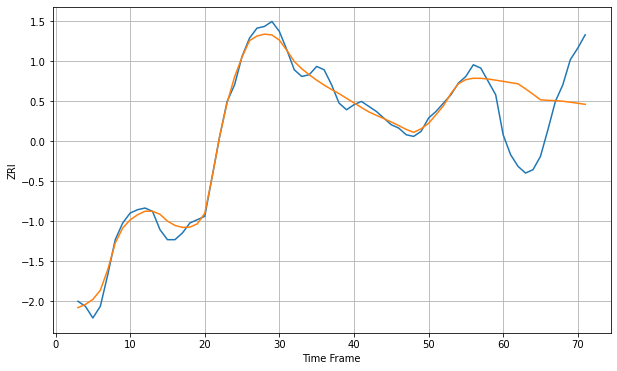

Wall time: 9.74 s
13204 4.77658449961267 35.37851508797924 [911.04150591 910.28858455 909.55406915 906.54470169 903.3555067
 900.00146812 899.65205115 899.50136245 899.10770554 898.54741485
 897.90236725 897.25641732]

Got an mse at 0.0099 in round 410 and stopped training



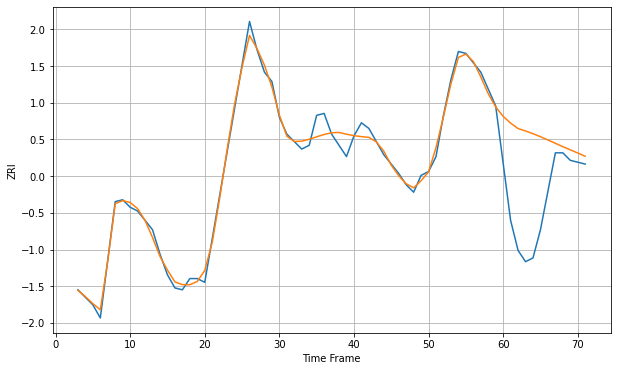

Wall time: 15.8 s
13205 3.8467611116972895 40.89815765141643 [928.46445669 924.81542275 921.9257375  920.6415367  919.19463028
 917.59235777 915.85291311 914.05804292 912.30236344 910.60016972
 908.90219673 907.16637944]

Got an mse at 0.0099 in round 166 and stopped training



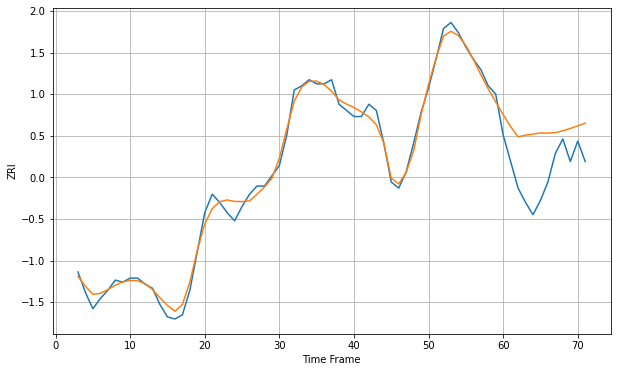

Wall time: 9.92 s
13206 3.548768306614183 22.544057317132204 [892.9316302  887.10568121 882.01808738 882.91806577 883.41166506
 883.96078833 883.87762013 884.14680874 885.0095372  886.17713448
 887.46311036 888.75642344]

Got an mse at 0.0099 in round 151 and stopped training



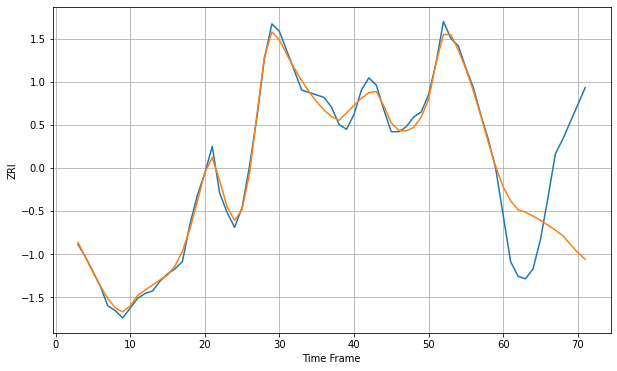

Wall time: 9.61 s
13208 2.6984506140515663 37.007214663872574 [869.48563638 863.86690297 860.13305464 859.17067166 857.58551832
 855.83926239 853.90524967 851.79862292 849.59095116 846.08909483
 842.71701104 839.94674818]

Got an mse at 0.0100 in round 280 and stopped training



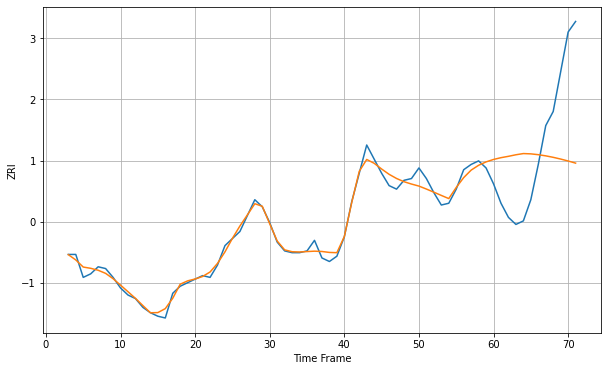

Wall time: 13 s
13440 3.3275582251091693 41.802354074704105 [755.81726454 756.82391408 757.59249056 758.47120384 759.1522389
 758.98272217 758.51812862 757.85778245 757.02381261 756.0407649
 754.93533524 753.73537538]

Got an mse at 0.0100 in round 152 and stopped training



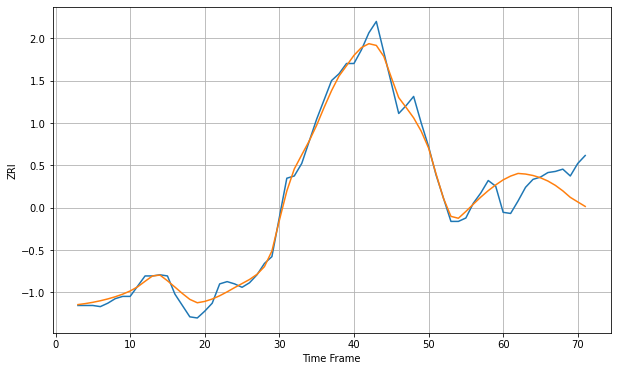

Wall time: 9.6 s
13501 7.020852507524578 23.653014088525275 [838.56690955 841.90119443 844.22779887 843.68108102 842.42488091
 840.41166031 837.54398116 833.71733308 828.88802915 823.18305118
 819.16010675 815.18287544]

Got an mse at 0.0099 in round 100 and stopped training



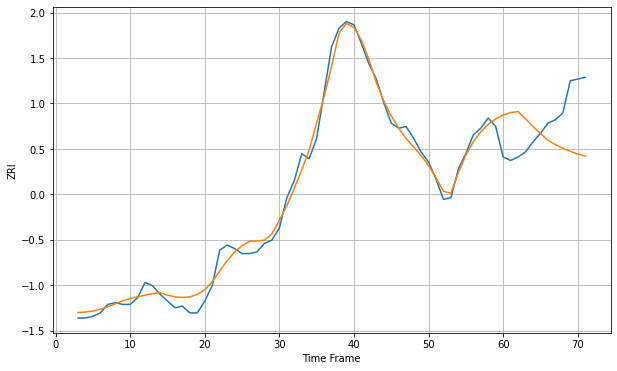

Wall time: 8.23 s
13502 5.081263525783423 27.671805927117543 [829.79684186 831.21154416 831.81748507 827.43895536 823.07136158
 818.86377438 814.8961615  812.32848467 810.17937815 808.32685451
 806.78552861 805.56506557]

Got an mse at 0.0100 in round 216 and stopped training



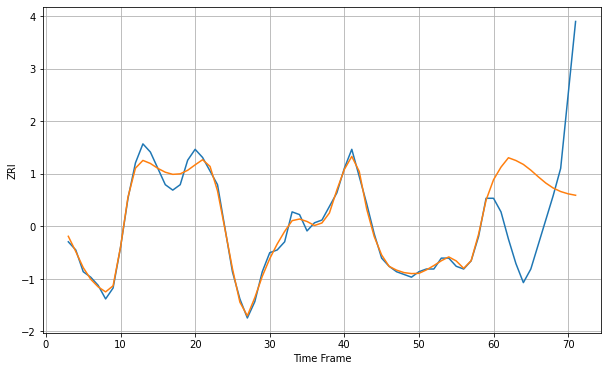

Wall time: 12.3 s
13601 2.2687060862980624 31.812222009597136 [856.81139189 861.45368916 864.90336083 863.88498204 862.44858706
 860.33012858 857.90011747 855.61234696 853.77059704 852.47787843
 851.63995182 851.10726048]

Got an mse at 0.0100 in round 411 and stopped training



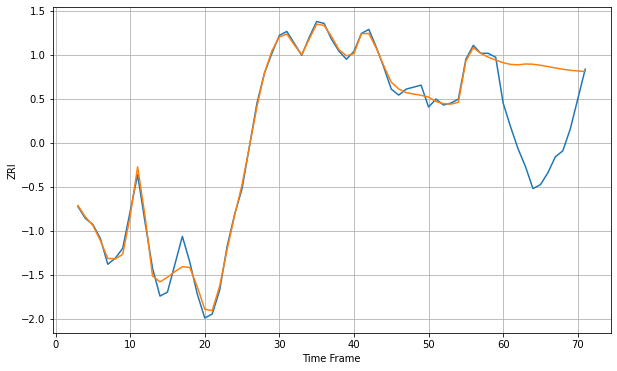

Wall time: 15.8 s
13760 3.231040510255668 41.76705727198205 [892.26855675 891.42094235 891.20029279 891.63735553 891.50233113
 890.99838076 890.31941258 889.61350954 888.98074482 888.47647768
 888.11670297 887.88819877]

Got an mse at 0.0099 in round 167 and stopped training



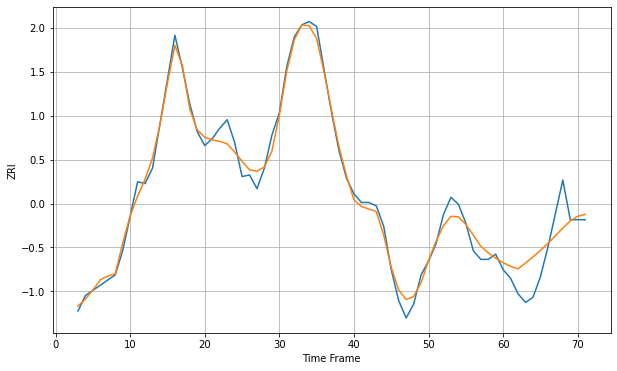

Wall time: 11 s
13903 5.148263396221223 14.54965081291882 [830.04361084 827.9465205  826.50221311 829.88368156 833.45137922
 837.1906503  841.25601182 845.64769656 850.12930368 854.33929651
 856.96532237 858.10757013]

Got an mse at 0.0100 in round 127 and stopped training



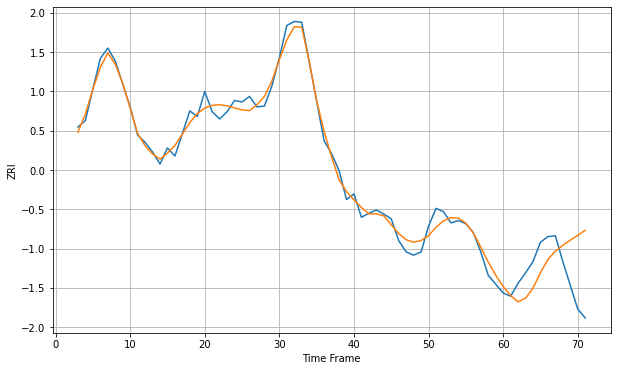

Wall time: 8.32 s
14020 9.769762760810345 49.20503340208118 [1207.03059068 1195.83816322 1188.03526956 1192.56769704 1204.95095851
 1224.13740274 1240.69787494 1250.91202341 1258.21894841 1264.54731595
 1270.53347258 1276.87332858]


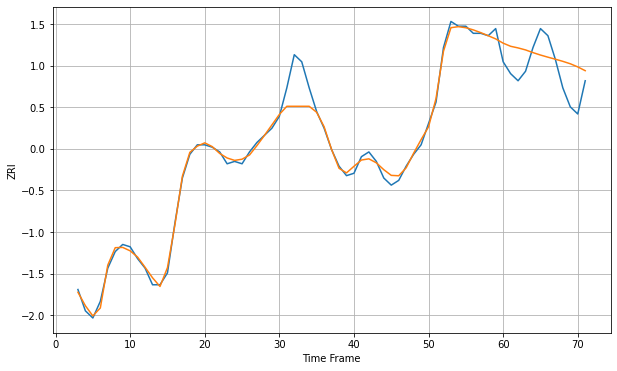

Wall time: 18.1 s
14043 4.389615114488726 11.348753978058394 [964.8536588  963.53790847 962.84821739 962.00384766 960.87114526
 959.84965033 958.94365264 958.09102874 957.18807284 956.1668714
 954.84266125 953.24941014]

Got an mse at 0.0100 in round 402 and stopped training



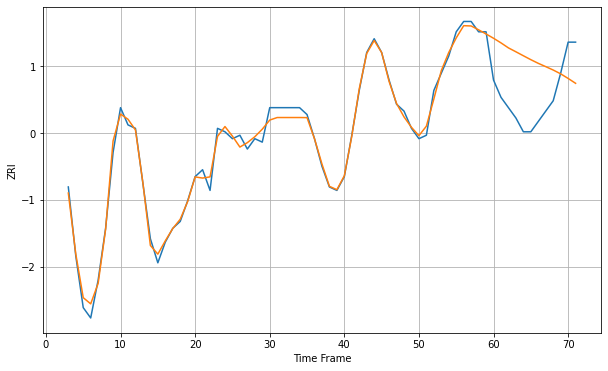

Wall time: 15.6 s
14150 1.8288196094579443 15.200592603351039 [896.12980033 894.78882071 893.33366489 892.20637138 891.05366166
 889.91647959 888.85486803 887.89554339 886.91413584 885.80980282
 884.4770803  883.06425233]

Got an mse at 0.0099 in round 194 and stopped training



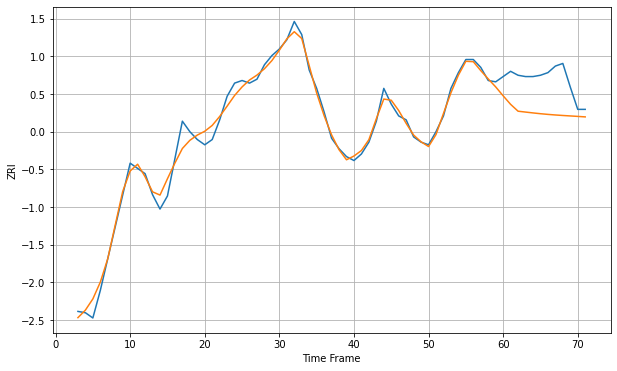

Wall time: 10.4 s
14201 5.715561094898881 26.583703421022694 [925.32816252 918.82664372 913.59670017 912.94278191 912.28994575
 911.69084223 911.16982366 910.72578244 910.34133533 909.9899056
 909.64007312 909.26058664]

Got an mse at 0.0100 in round 180 and stopped training



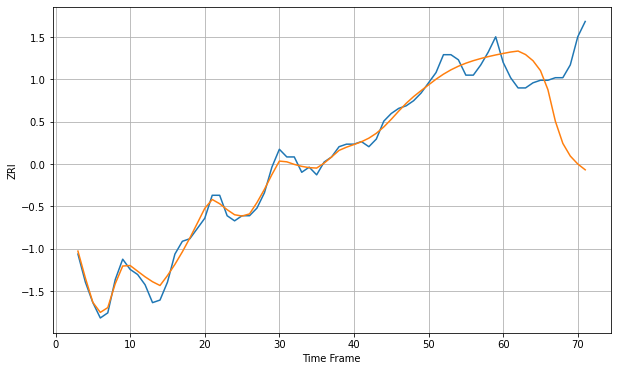

Wall time: 10.4 s
14206 3.0706751745341365 26.863015513622134 [811.48550389 812.040574   812.42854853 811.05869987 808.64583838
 804.78354058 797.31769634 784.95366298 776.30787862 771.34471968
 768.2447039  765.9689011 ]

Got an mse at 0.0099 in round 82 and stopped training



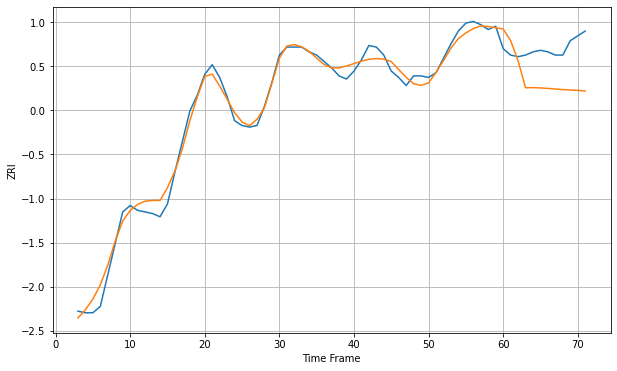

Wall time: 8.13 s
14207 4.906093087736218 23.5512078138328 [825.30370767 818.07929365 805.49582463 788.5834841  788.64991371
 788.48759222 788.17357333 787.78753787 787.42322759 787.15991884
 786.95730996 786.58280579]

Got an mse at 0.0097 in round 173 and stopped training



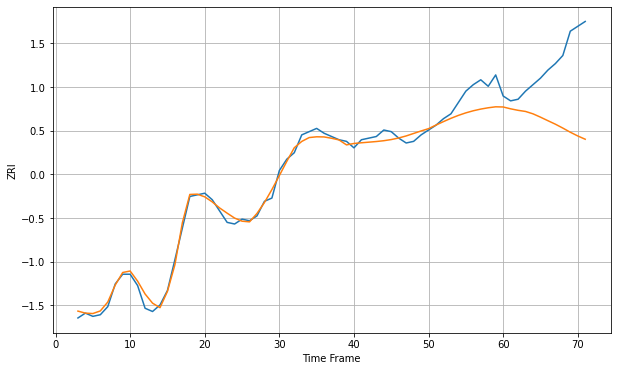

Wall time: 10.5 s
14208 5.773992754023476 40.113095835701436 [797.22004187 796.08812857 795.16265767 794.45815533 792.99181601
 790.94607129 788.75398581 786.60214359 784.19466171 781.64587106
 779.34241427 777.31107256]


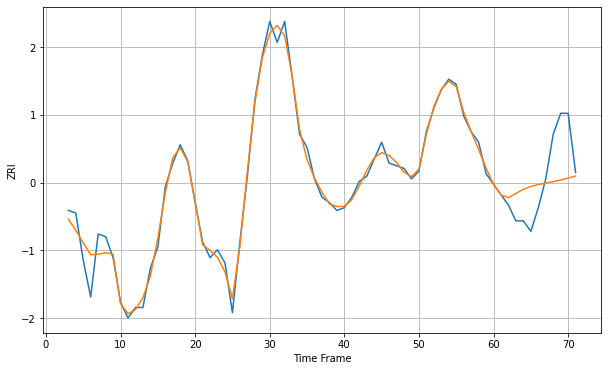

Wall time: 17.6 s
14209 3.625680161854628 13.605230652313873 [1040.96932773 1036.89799245 1035.83587107 1037.48720902 1039.03087464
 1040.130513   1040.87609593 1041.42368433 1041.93178773 1042.57086694
 1043.33072601 1044.06748571]

Got an mse at 0.0099 in round 130 and stopped training



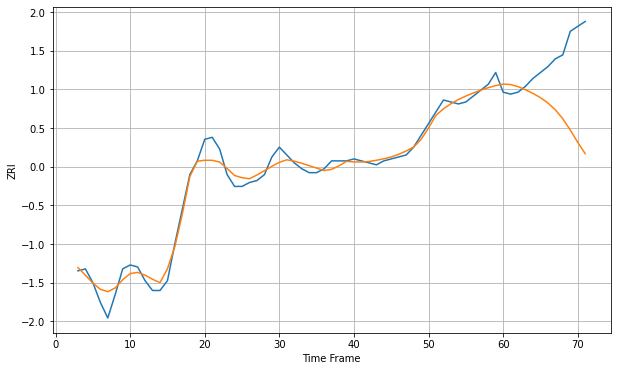

Wall time: 9.33 s
14210 4.255616686640075 32.80170557583979 [792.13210658 791.86894754 790.81281396 789.19751881 787.36716611
 785.190239   782.48395798 778.98787526 774.40907938 768.69265018
 762.42405695 756.65988065]

Got an mse at 0.0100 in round 78 and stopped training



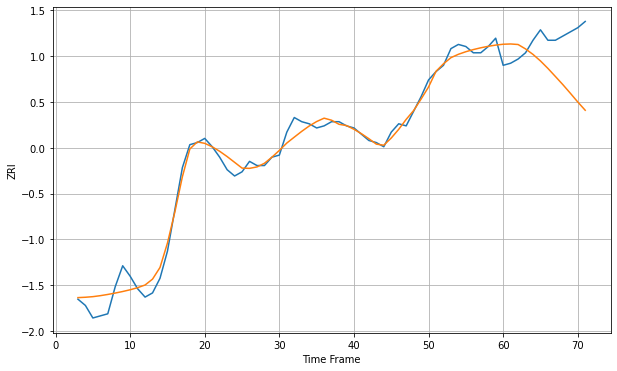

Wall time: 8.36 s
14211 4.260345458734062 21.336447689605258 [794.09005422 794.22192512 793.96565244 791.84885984 789.22791383
 786.09566303 782.51640723 778.66099286 774.76199542 770.65460596
 766.44277711 762.47689634]

Got an mse at 0.0099 in round 166 and stopped training



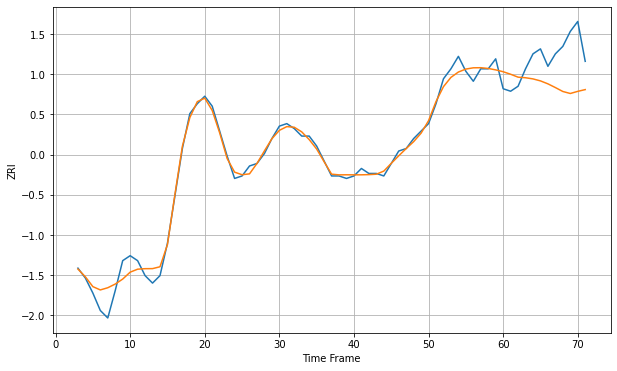

Wall time: 9.77 s
14212 3.147250628804762 14.379838892276512 [780.8284363  779.81434124 778.64654741 778.41379948 777.94886651
 777.15310542 775.96401    774.47353087 772.89907127 772.0930076
 772.94766546 773.65705523]

Got an mse at 0.0099 in round 124 and stopped training



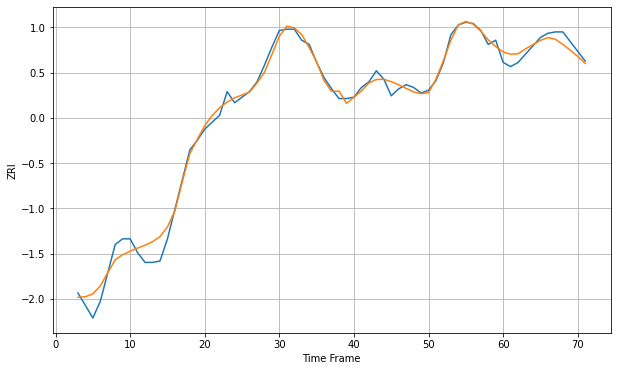

Wall time: 8.75 s
14213 6.060642689169823 5.55433124339546 [872.61151022 870.95635866 871.26389131 874.82883541 877.85218081
 880.90193471 882.90575461 881.70226203 877.9874347  873.82743626
 869.34950569 864.34533204]

Got an mse at 0.0100 in round 140 and stopped training



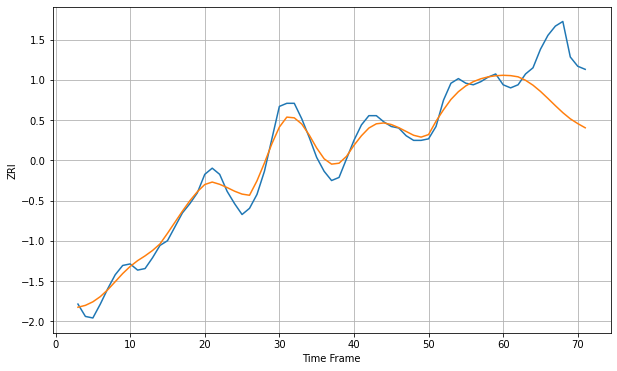

Wall time: 9.71 s
14214 6.0636329091765155 33.213580616332415 [926.14815901 925.92883836 925.15984812 922.90371095 919.7391085
 915.72470036 911.17009534 906.46624719 901.95346515 897.97177759
 894.8713737  892.14781254]

Got an mse at 0.0099 in round 66 and stopped training



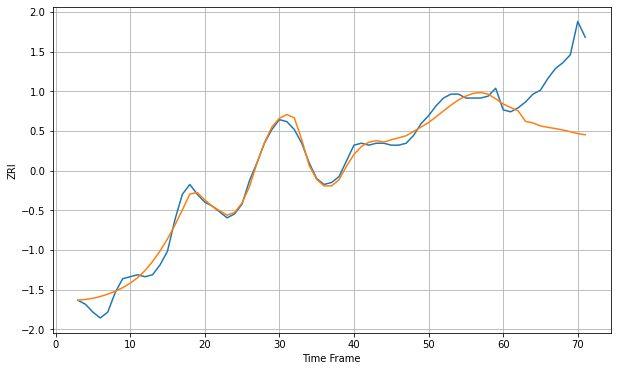

Wall time: 7.76 s
14215 3.882985353485852 29.789022401456705 [776.97838985 775.20073397 773.50197149 768.10502804 767.32344818
 765.8003887  765.09634496 764.4439761  763.74198193 762.84996404
 761.91187023 761.31217113]

Got an mse at 0.0100 in round 115 and stopped training



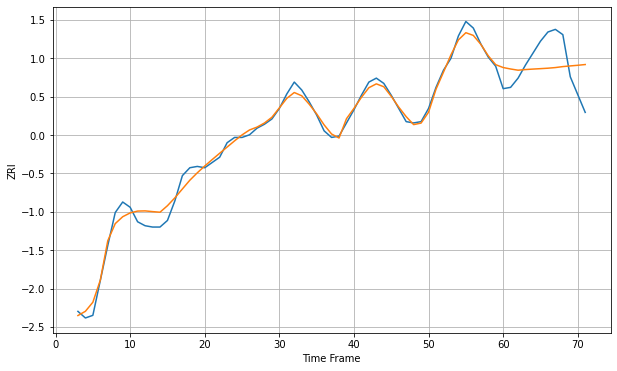

Wall time: 9.14 s
14216 5.222074435874426 20.70627204027925 [1042.04635563 1040.93253227 1040.01110446 1040.49728075 1040.87127322
 1041.18998987 1041.53603483 1042.01723826 1042.75005507 1043.26321538
 1043.75220909 1044.31885537]

Got an mse at 0.0100 in round 176 and stopped training



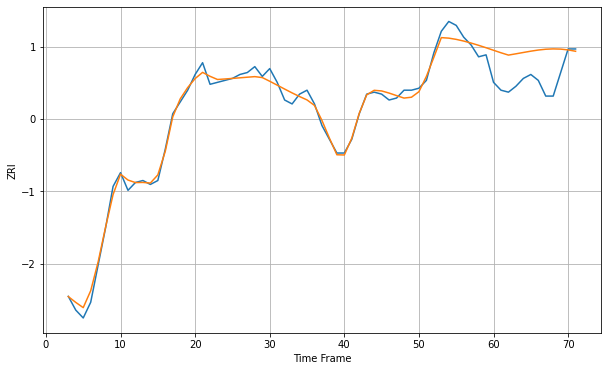

Wall time: 10.6 s
14217 3.2767843118656805 16.082100524585858 [900.33097021 899.05518311 897.87296382 898.52692423 899.2059595
 899.87316197 900.45278918 900.85907052 901.02765714 900.92128189
 900.52096278 899.82064377]

Got an mse at 0.0100 in round 330 and stopped training



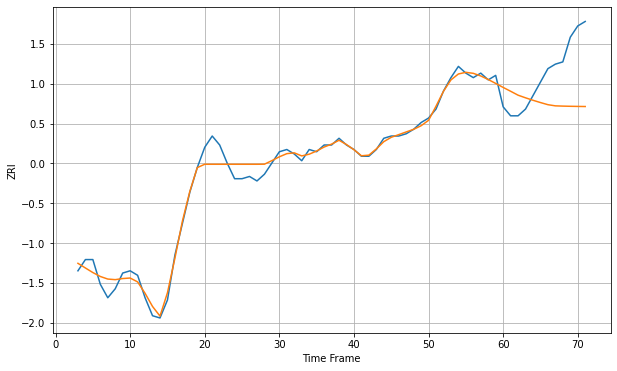

Wall time: 14.2 s
14218 3.6349663211122794 20.500718473855308 [823.63540321 821.93289968 820.1810153  819.01238987 817.91874232
 816.8999902  815.9510237  815.43255302 815.31594383 815.2390101
 815.18249541 815.13465733]

Got an mse at 0.0100 in round 238 and stopped training



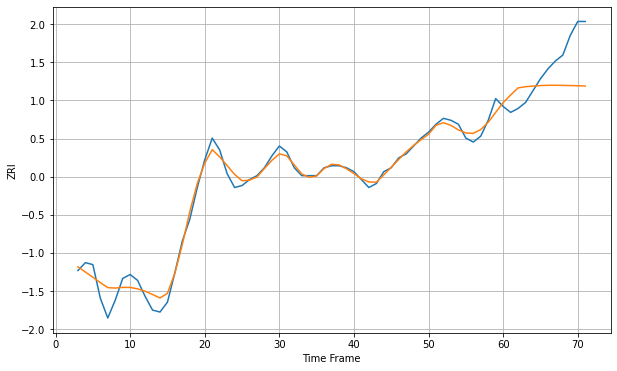

Wall time: 12.4 s
14220 4.002231434491561 17.06159000094017 [809.94067501 813.78407389 817.389738   818.00292644 818.30838421
 818.58807321 818.70902429 818.72331307 818.67077494 818.58048869
 818.47424031 818.36925318]

Got an mse at 0.0100 in round 153 and stopped training



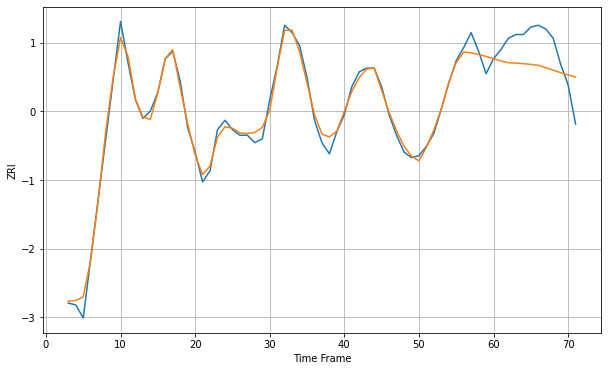

Wall time: 10.3 s
14221 3.8418482081891843 15.712902909982116 [1146.02655792 1144.85262145 1143.86169186 1143.66826526 1143.37088035
 1142.98625898 1142.52714757 1141.21848052 1139.86419469 1138.52945375
 1137.35353632 1136.24320705]

Got an mse at 0.0099 in round 169 and stopped training



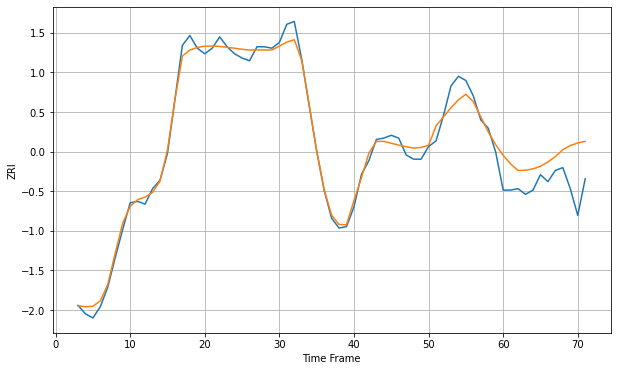

Wall time: 9.33 s
14222 5.898329425939541 23.181577513133263 [1082.70542543 1076.63777733 1071.9484977  1072.13215244 1073.11799624
 1074.99030791 1078.04119134 1081.86193411 1086.7476506  1089.69803648
 1091.51908034 1092.67938016]

Got an mse at 0.0099 in round 175 and stopped training



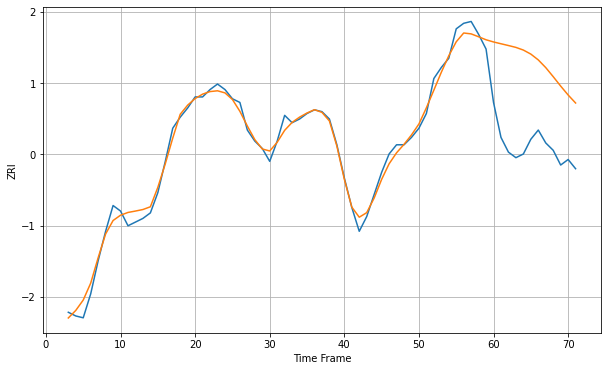

Wall time: 10.2 s
14224 3.939799599283781 45.65686851626724 [981.86702389 980.88392706 979.92180582 978.91048949 977.46078058
 975.2719211  972.11187212 967.93307862 963.00821349 957.89540274
 953.05272666 948.70251482]

Got an mse at 0.0099 in round 422 and stopped training



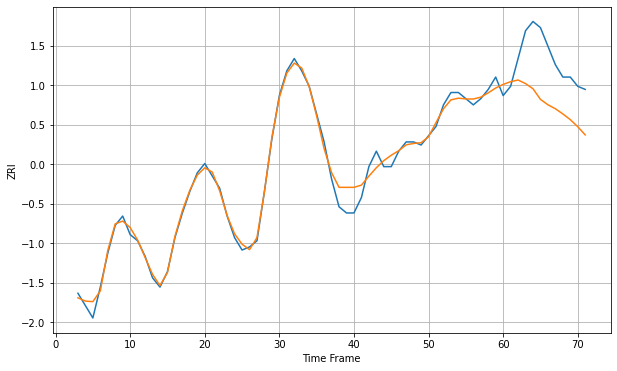

Wall time: 16.6 s
14225 2.48154456875066 14.87147583919906 [862.62486738 863.50245902 864.04321792 862.87873113 861.21780502
 857.77797847 856.03105248 854.74091779 853.0738523  851.2115171
 848.93030959 846.2705381 ]

Got an mse at 0.0100 in round 327 and stopped training



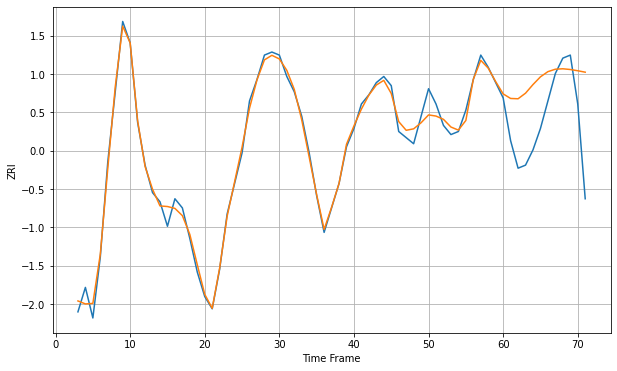

Wall time: 13.9 s
14228 2.4422784483470843 18.176884845978734 [1094.3080419  1092.81229482 1092.70978575 1094.53960251 1097.35992456
 1099.88730748 1101.58399008 1102.38319307 1102.51935385 1102.28356197
 1101.87852785 1101.40720132]

Got an mse at 0.0099 in round 142 and stopped training



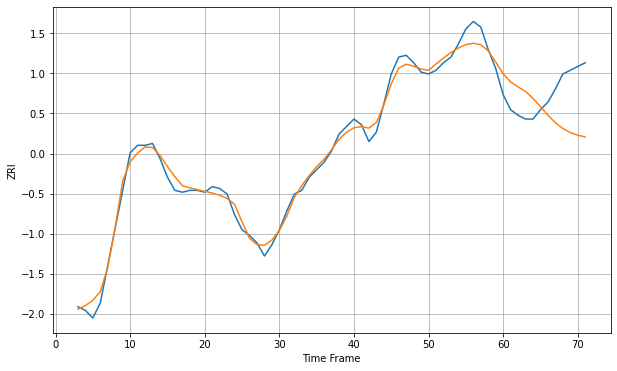

Wall time: 9.5 s
14301 4.182343532006636 22.59535359484186 [651.17497092 646.78439548 644.12787067 641.66472071 638.03300433
 633.60322282 629.05612395 625.06273918 621.97828184 619.81532995
 618.39254568 617.48561265]

Got an mse at 0.0099 in round 275 and stopped training



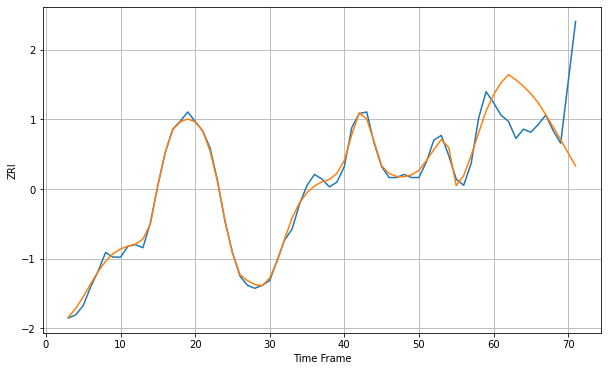

Wall time: 12.3 s
14607 3.8985898162849053 35.294132902732244 [1084.07538244 1091.66633457 1096.90785034 1093.58808589 1089.5532754
 1084.68173896 1078.86043951 1071.24622804 1063.3211474  1055.21890617
 1046.74694507 1038.42994372]

Got an mse at 0.0100 in round 322 and stopped training



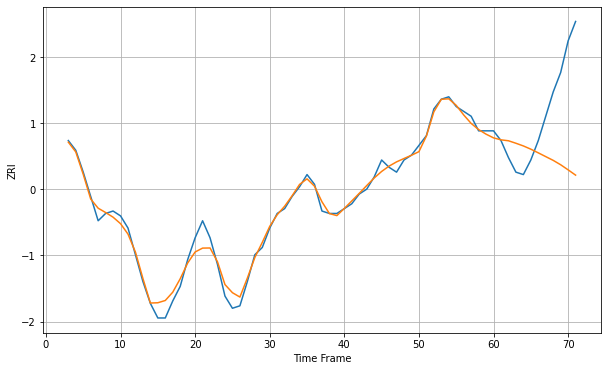

Wall time: 13.8 s
14609 3.028865456357958 28.437239793728253 [829.10382817 828.29154493 827.91416875 826.89380719 825.78383129
 824.45577662 822.94111143 821.38908237 819.84668226 818.03763985
 815.94333763 813.77507593]

Got an mse at 0.0100 in round 266 and stopped training



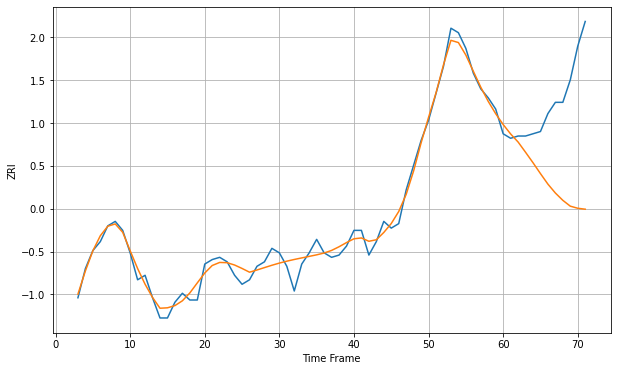

Wall time: 12.6 s
14611 3.8790162618503943 41.301466295070234 [872.12798432 867.92827681 864.3423475  859.78778855 855.12109182
 850.27489742 845.58479881 841.62735684 838.37155036 835.77507263
 834.84252806 834.42278992]

Got an mse at 0.0099 in round 188 and stopped training



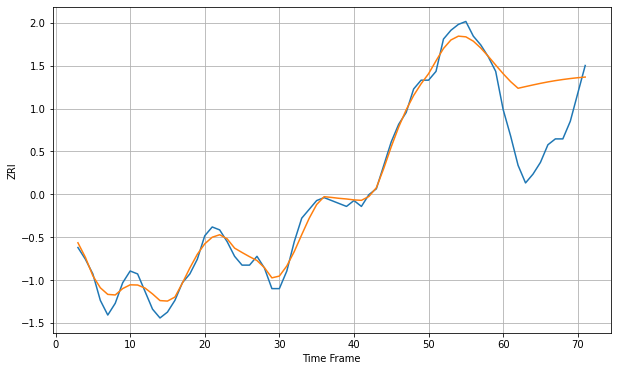

Wall time: 10.9 s
14613 2.879118349856836 21.255767958908375 [772.20946667 769.50558296 767.24354899 767.81452455 768.37870661
 768.91667646 769.40974214 769.84625623 770.2260901  770.55658979
 770.83962577 771.06012258]

Got an mse at 0.0099 in round 120 and stopped training



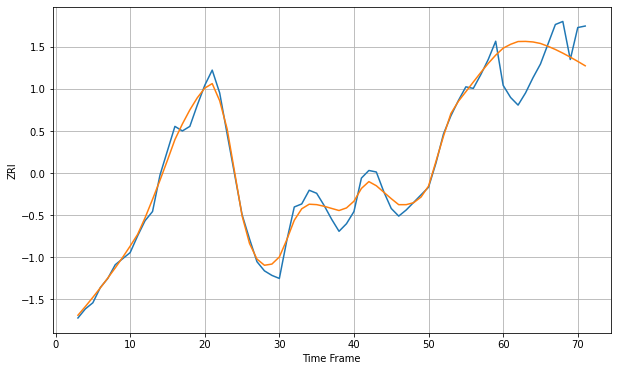

Wall time: 9.15 s
14620 5.680851516978221 24.73124898687765 [1099.42900268 1101.97953479 1103.80722305 1103.88623617 1103.5200612
 1102.52772942 1100.68334584 1098.58255034 1096.16306017 1093.54489679
 1090.73999441 1087.85387981]


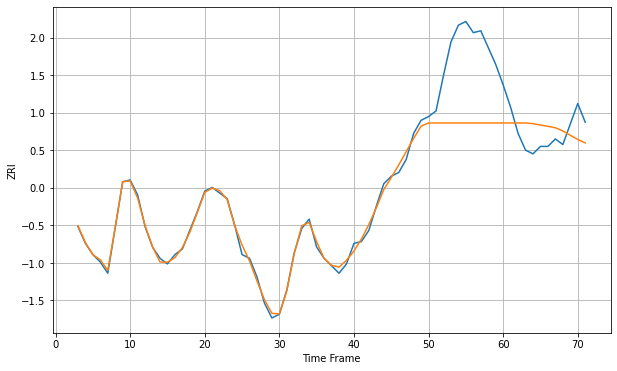

Wall time: 18.4 s
14621 16.696154016098586 12.45228251272014 [798.56782891 798.56782891 798.56782891 798.56782891 798.19040933
 797.45579547 796.76922647 796.00915143 794.28742121 791.97748832
 789.75802161 787.87197395]

Got an mse at 0.0099 in round 136 and stopped training



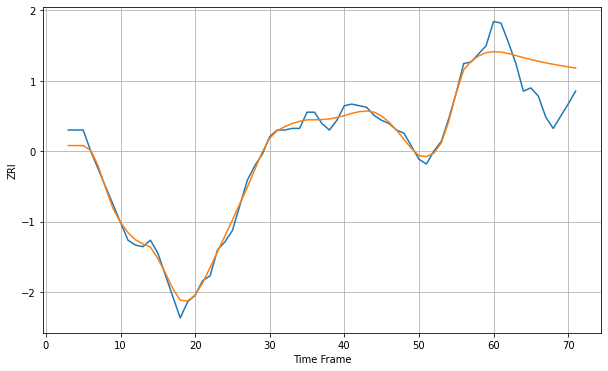

Wall time: 9.53 s
14701 4.030964386774828 22.95975511441788 [668.36193663 668.11133505 667.19947219 665.95473971 664.70005749
 663.50992308 662.4279612  661.46121692 660.58676541 659.76752763
 658.97180821 658.1863067 ]

Got an mse at 0.0100 in round 164 and stopped training



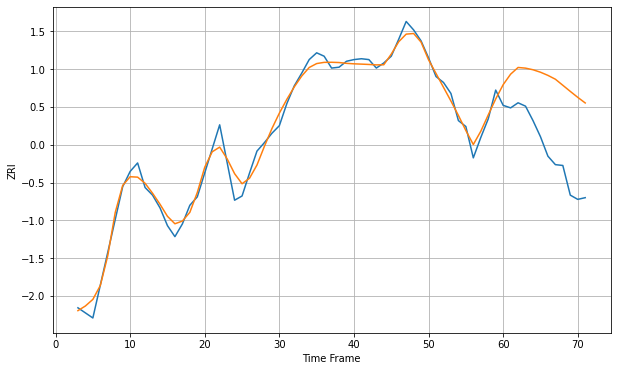

Wall time: 10.7 s
14850 9.757453081977479 84.43101465629925 [1569.36815617 1581.78280291 1589.68888597 1588.91038571 1587.00415912
 1584.09717126 1580.35894305 1575.83265917 1568.67123935 1561.44513968
 1554.42908368 1547.80929605]

Got an mse at 0.0099 in round 46 and stopped training



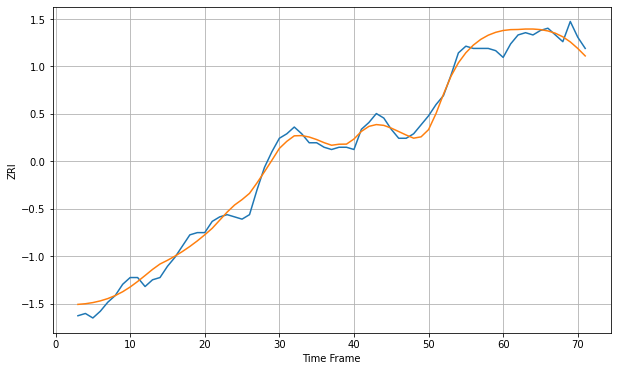

Wall time: 6.96 s
15202 3.954535552772822 5.207791472059935 [844.9851357  845.36191069 845.4286674  845.62929895 845.62919477
 845.37352917 844.78501952 843.75870369 842.16725952 839.90487032
 836.98965823 833.65982664]

Got an mse at 0.0099 in round 81 and stopped training



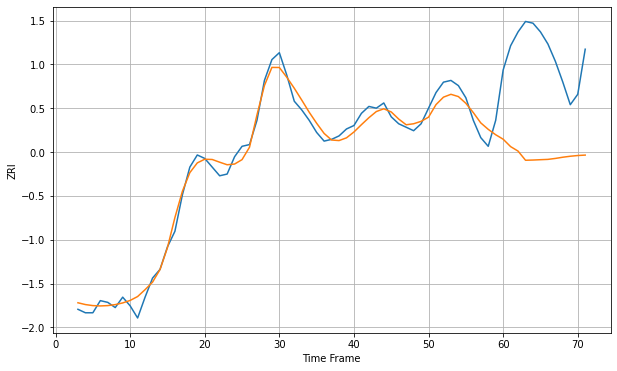

Wall time: 8.38 s
15206 5.179129753758015 59.910019788832244 [1054.10153786 1049.81956831 1047.23577356 1041.95786947 1042.08418588
 1042.27709936 1042.46005369 1043.01462814 1043.70948668 1044.27194916
 1044.68617575 1044.93589929]

Got an mse at 0.0100 in round 107 and stopped training



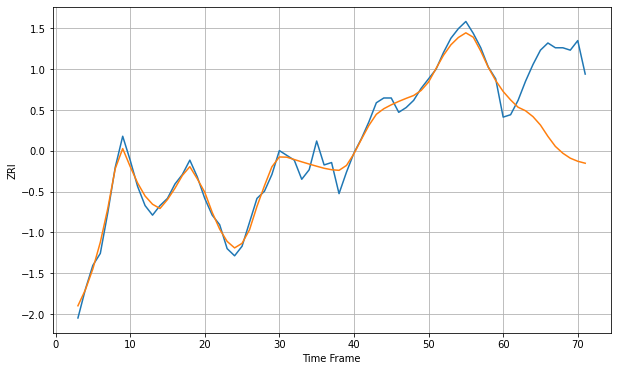

Wall time: 8.5 s
15210 3.366879790504361 32.81175199118593 [872.73088877 869.18736657 866.13244308 864.65500532 862.19672073
 858.68291181 853.94776214 849.74803475 846.90215078 844.823254
 843.53640145 842.71465184]

Got an mse at 0.0099 in round 47 and stopped training



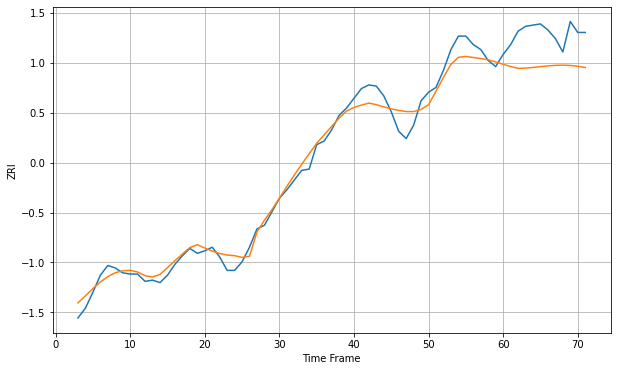

Wall time: 8.12 s
15212 8.430436774343626 27.79548646209003 [954.95396346 953.13461008 951.5415626  951.76475356 952.32310211
 952.97656158 953.59147924 954.02940647 954.17355403 953.94432548
 953.30359266 952.25320354]

Got an mse at 0.0100 in round 90 and stopped training



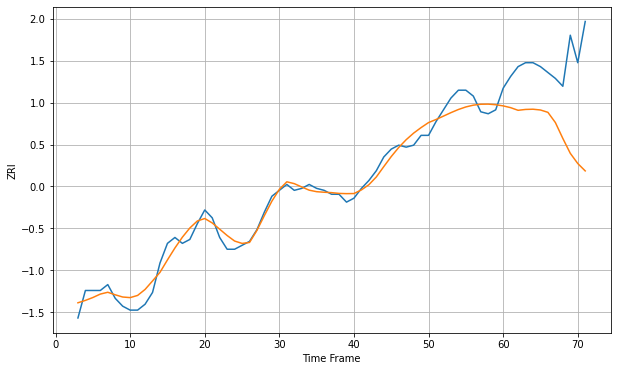

Wall time: 7.82 s
15216 4.468617713317783 36.6392439505223 [903.01007339 902.11112684 900.75927864 901.19778398 901.31441155
 900.91788768 899.72100663 894.52355541 886.44086133 878.85382123
 873.66794749 869.89641978]

Got an mse at 0.0099 in round 222 and stopped training



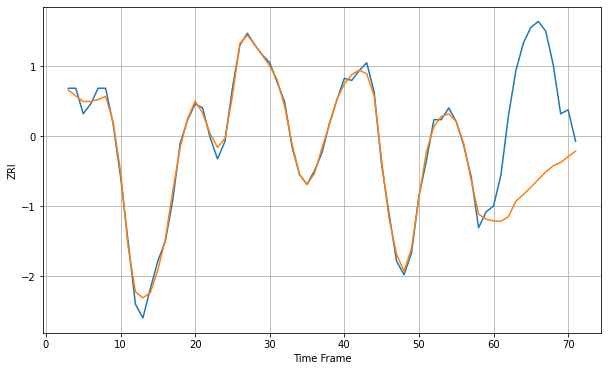

Wall time: 12.2 s
15217 3.2369593726387076 54.5577928949224 [1176.44195289 1176.31497379 1178.60476057 1186.52131154 1189.87486233
 1193.6038883  1197.52220487 1201.35643941 1204.49989357 1206.25203031
 1209.2070318  1211.92806311]

Got an mse at 0.0100 in round 116 and stopped training



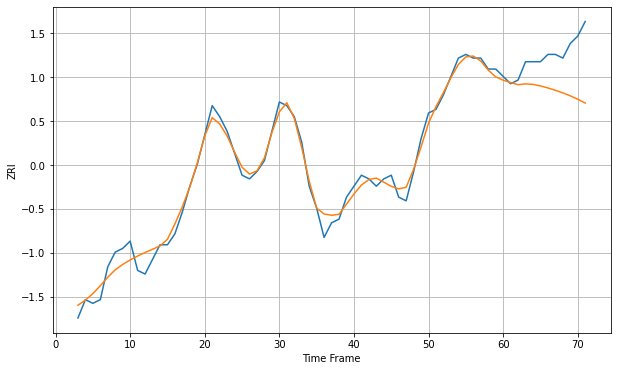

Wall time: 9.12 s
15221 2.4262037536149705 10.765396011851873 [896.96001288 896.32080889 895.72324957 895.95239861 895.81101451
 895.39271221 894.83411456 894.19837312 893.48698748 892.68147846
 891.76255492 890.71447035]

Got an mse at 0.0100 in round 274 and stopped training



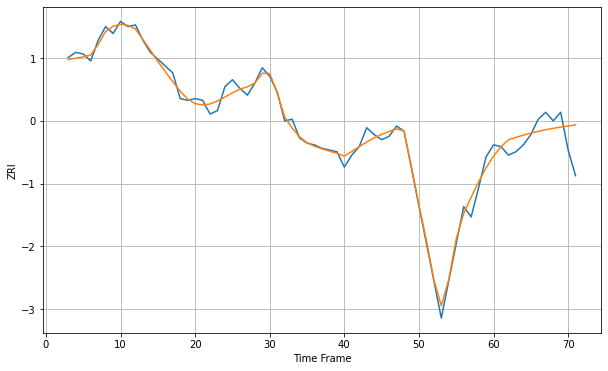

Wall time: 12.9 s
16365 3.695403692921097 11.364876514397002 [849.46592628 854.9068926  858.94977074 860.3743518  861.6740978
 862.85433471 863.91365082 864.8465461  865.65480877 866.36032929
 867.01123361 867.68030588]

Got an mse at 0.0099 in round 128 and stopped training



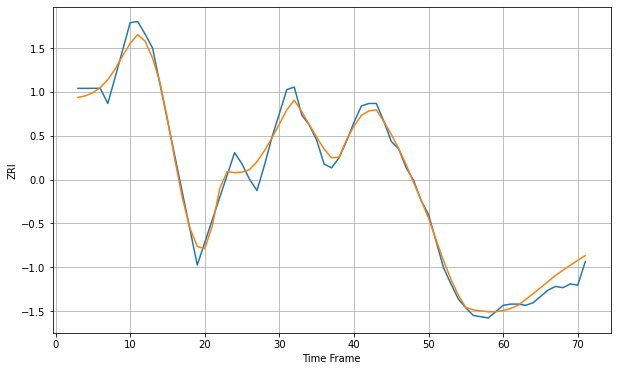

Wall time: 9.06 s
16502 7.585735867200173 9.546407317116966 [642.82584605 644.4925711  647.0205986  651.53612734 656.2391249
 660.99671601 665.76882824 670.59533234 674.81092513 678.81721989
 682.67028438 686.40692683]

Got an mse at 0.0099 in round 126 and stopped training



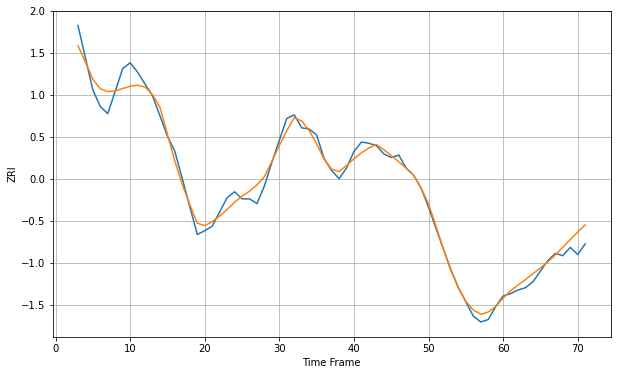

Wall time: 10.2 s
16503 7.439749635304683 8.39471123890082 [604.1012494  610.36733746 615.2836625  619.87483457 624.78549047
 629.63312209 634.83341128 640.6891085  647.11430653 653.69699098
 660.04621759 666.01731679]

Got an mse at 0.0099 in round 161 and stopped training



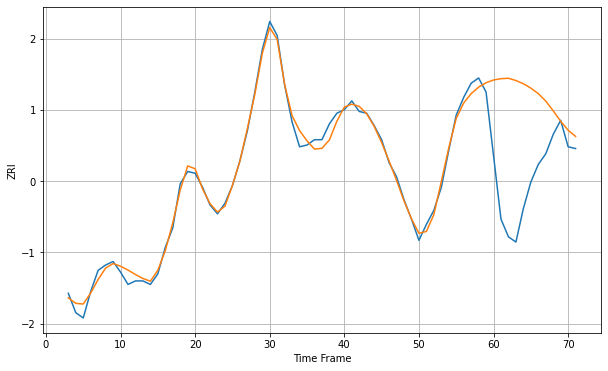

Wall time: 9.94 s
17013 3.587871687250454 54.215150748460196 [1031.83669038 1032.59497117 1032.80943669 1031.54131056 1029.72049122
 1027.24521753 1024.11898934 1019.90908544 1014.39436036 1008.46400684
 1003.37671685  999.8815805 ]

Got an mse at 0.0099 in round 37 and stopped training



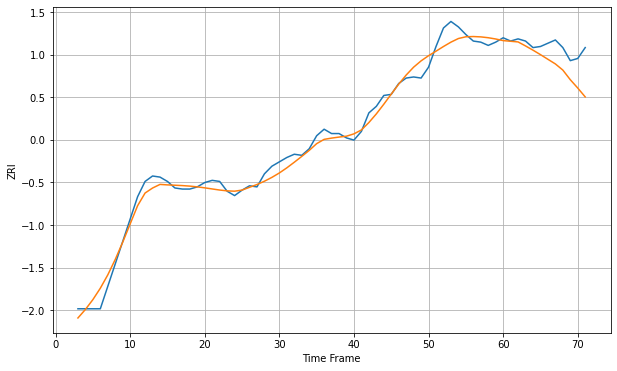

Wall time: 7.68 s
17022 7.652454036654223 18.988486997878756 [886.41098987 885.808764   885.19851468 881.51288565 877.62483266
 873.51949619 869.24040945 864.97960109 859.33444303 850.47285084
 842.82722133 834.66722312]

Got an mse at 0.0100 in round 292 and stopped training



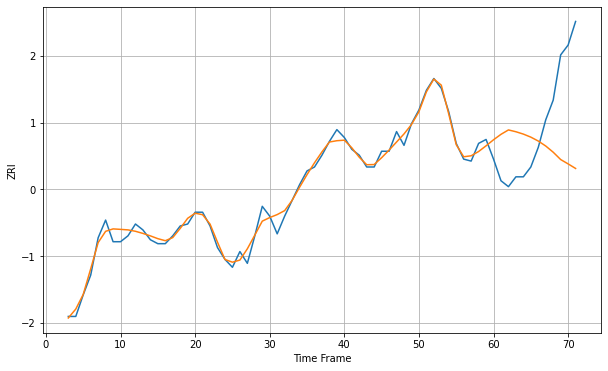

Wall time: 13 s
17401 3.279259942973848 36.14158477534013 [819.83862752 822.60908402 824.84624868 823.92050027 822.72379167
 821.17766698 819.18803778 816.66000278 813.51133319 809.78456545
 807.56859734 805.25351658]

Got an mse at 0.0099 in round 228 and stopped training



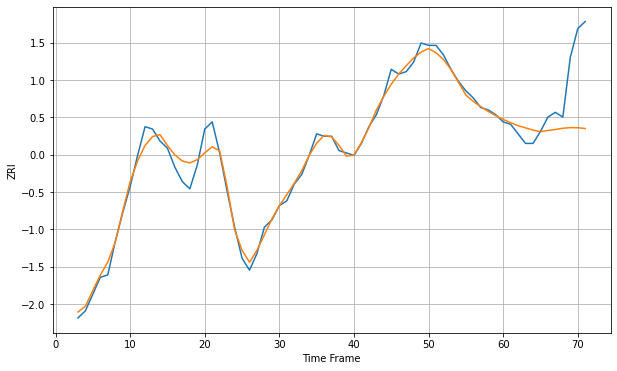

Wall time: 11.6 s
17404 3.553409009500437 19.950314554206393 [858.06230003 856.65870208 855.41692368 854.49292507 853.59550919
 852.89203276 853.4340639  853.82131139 854.33289232 854.59954663
 854.55741023 854.24183424]

Got an mse at 0.0100 in round 104 and stopped training



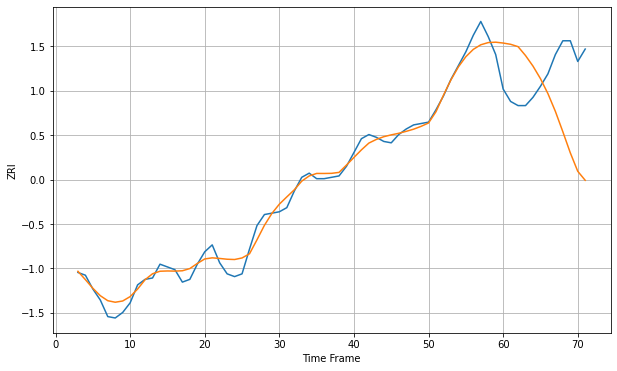

Wall time: 8.88 s
17512 6.064988978743661 53.82390187784672 [1045.35091839 1044.43821804 1042.73252304 1036.27499211 1028.62175404
 1019.53779502 1008.6973484   995.80904348  981.05126773  965.7638145
  952.36223221  945.82438937]

Got an mse at 0.0099 in round 93 and stopped training



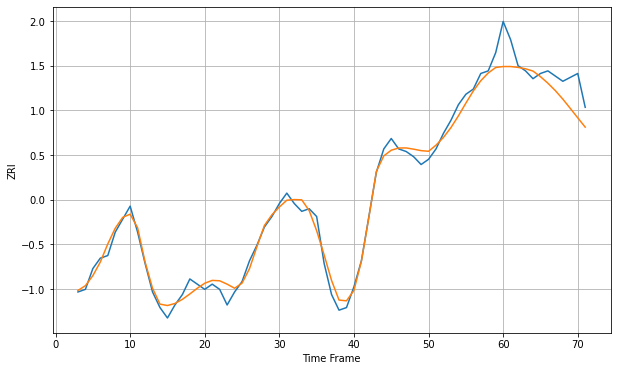

Wall time: 8.33 s
17522 2.9417698278536304 9.176370935728647 [852.66592131 852.66810566 852.34075673 851.80445711 850.92736123
 848.7895561  846.25743496 843.39581201 840.1394111  836.58082673
 832.94722634 829.36426823]

Got an mse at 0.0099 in round 42 and stopped training



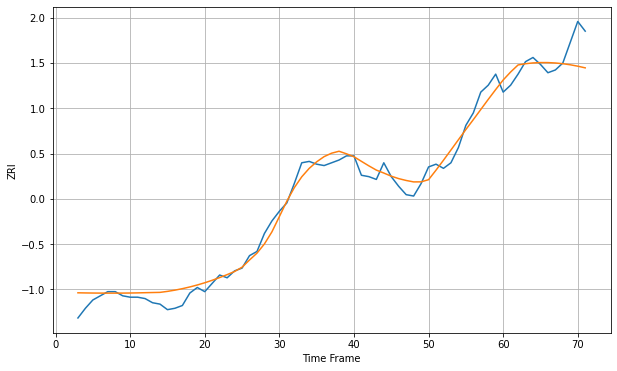

Wall time: 7.55 s
17543 7.02984256728208 13.89399387709542 [1113.74437949 1119.51332597 1124.61473256 1125.50990507 1126.07209947
 1126.33402977 1126.31780631 1126.03845157 1125.50691237 1124.73333365
 1123.73069624 1122.51841545]

Got an mse at 0.0099 in round 57 and stopped training



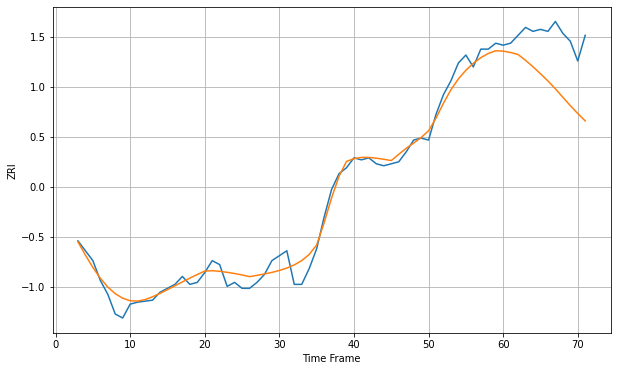

Wall time: 7.42 s
17552 4.696507740139987 25.337545468074282 [976.991153   976.30212187 975.27789119 972.34791343 969.07730741
 965.56538744 961.90854314 957.96137458 953.65347821 949.44482847
 945.43172149 941.68480807]

Got an mse at 0.0100 in round 58 and stopped training



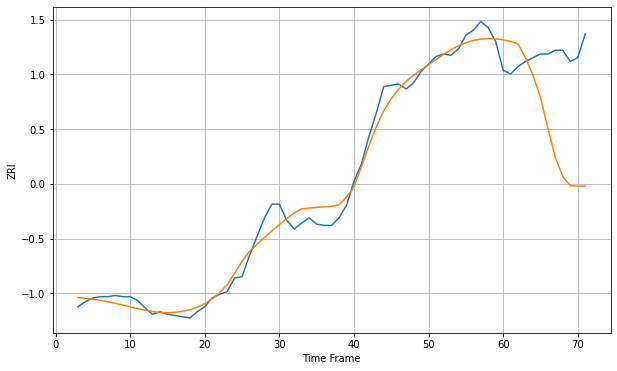

Wall time: 7.07 s
17602 8.304090224843769 70.26901402573532 [1093.32538034 1091.97907454 1090.05583157 1078.91566332 1065.13676142
 1047.23906714 1022.79443713  999.23342031  983.90016358  976.80227513
  976.41783258  976.32223672]

Got an mse at 0.0093 in round 21 and stopped training



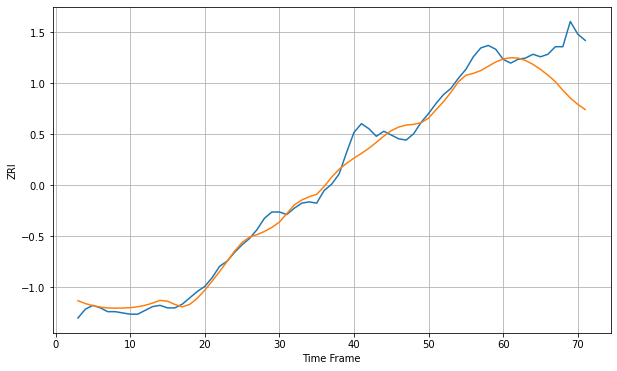

Wall time: 6.79 s
17603 7.878103933108273 31.89604641741859 [1136.28667463 1137.25261596 1136.97396728 1135.02019626 1132.00549093
 1128.04736248 1123.50324615 1118.2774725  1111.47516216 1105.3324312
 1100.29135506 1096.17629961]

Got an mse at 0.0100 in round 209 and stopped training



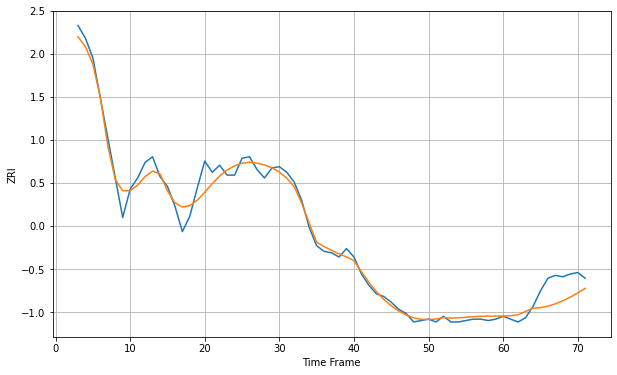

Wall time: 11.2 s
17701 6.215186756535192 12.273190875296192 [767.15854379 767.44326291 768.11075697 770.47522265 772.67755906
 773.15233254 774.20995582 775.85250853 778.01349756 780.62664212
 783.60508244 786.7953247 ]

Got an mse at 0.0098 in round 41 and stopped training



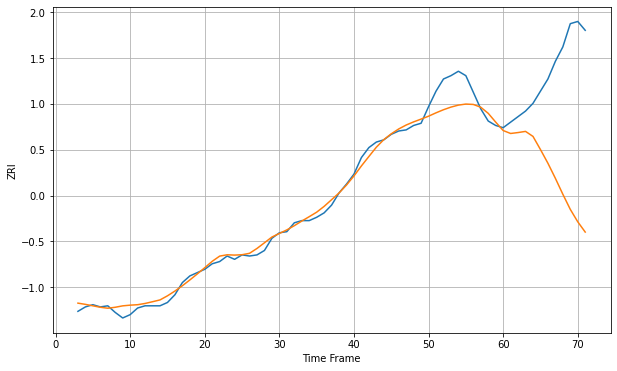

Wall time: 7.06 s
18018 9.034827737255004 105.37852108974238 [1084.43471162 1081.75791622 1082.59521191 1083.63995236 1079.10303777
 1067.24028275 1054.85644248 1041.23548827 1026.84509609 1013.16375845
 1001.92726297  992.64988534]

Got an mse at 0.0099 in round 34 and stopped training



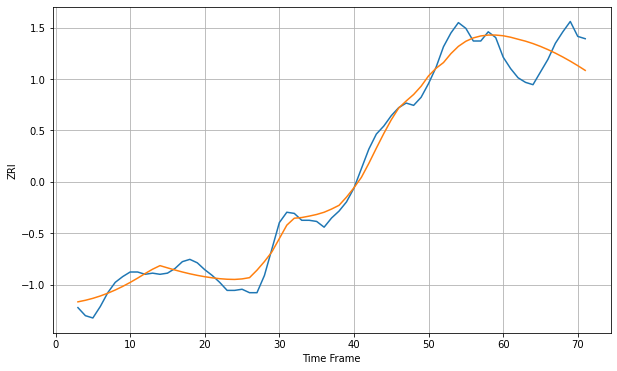

Wall time: 7.93 s
18042 9.079056853952853 26.61998520302579 [1148.56509532 1147.28998254 1145.54507065 1143.84860427 1141.7554607
 1139.30204415 1136.52111441 1133.4388103  1130.07448425 1126.44291791
 1122.55800147 1118.4367947 ]

Got an mse at 0.0100 in round 104 and stopped training



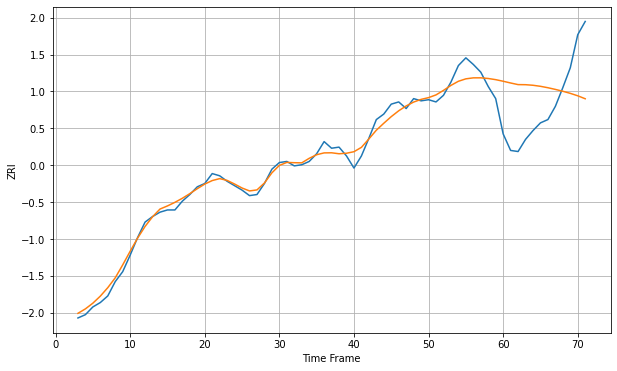

Wall time: 8.68 s
18102 6.507290236996909 45.254952937797306 [1104.76948251 1103.17946309 1101.71599292 1101.63087625 1101.11674445
 1100.17531867 1098.88399712 1097.36072802 1095.67472952 1093.78693415
 1091.56748468 1088.87489718]

Got an mse at 0.0100 in round 436 and stopped training



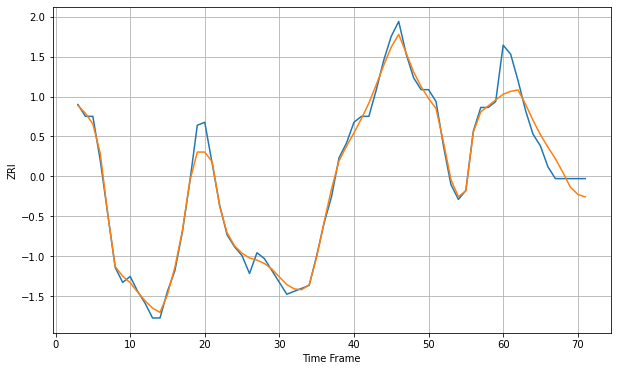

Wall time: 17.4 s
18232 2.5986947777517186 7.360666544746338 [786.45405775 787.4265979  787.90546095 783.08621839 777.6820072
 772.80313594 768.61625064 764.73679478 760.1117376  755.16492384
 752.70148177 751.81532374]

Got an mse at 0.0100 in round 207 and stopped training



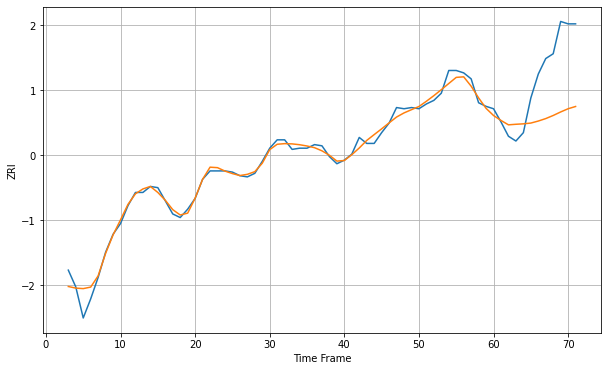

Wall time: 11.2 s
18951 5.219323197069616 43.86733510789482 [1349.34369489 1345.21242803 1341.53994075 1342.01488975 1342.37503459
 1343.02123922 1344.70904272 1346.77573038 1349.3702266  1352.31990151
 1355.00529325 1356.88335669]

Got an mse at 0.0096 in round 41 and stopped training



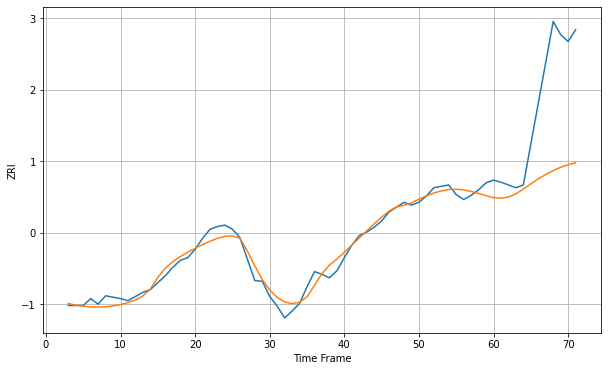

Wall time: 7.82 s
19007 10.062211220662155 127.2886306750163 [1224.6771119  1223.91765577 1225.58184912 1230.15392298 1237.1295566
 1244.49067886 1251.8036708  1258.12394052 1263.79624333 1268.53886984
 1272.2672455  1275.05046674]

Got an mse at 0.0100 in round 204 and stopped training



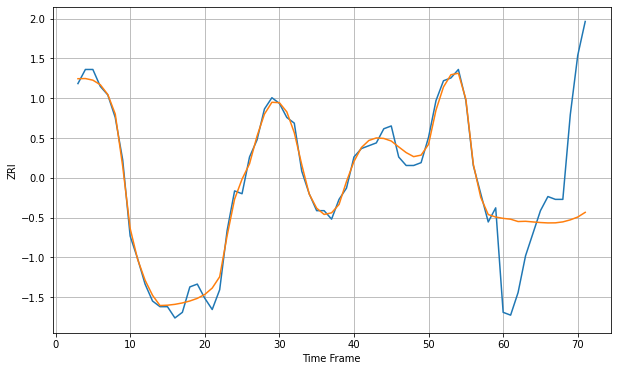

Wall time: 11 s
19103 2.803919864707405 32.31804531342347 [1679.26934544 1678.98281779 1678.15178817 1678.23802943 1678.00912548
 1677.79852092 1677.66044174 1677.68869692 1678.02852499 1678.74067723
 1679.74320134 1681.40387281]

Got an mse at 0.0100 in round 110 and stopped training



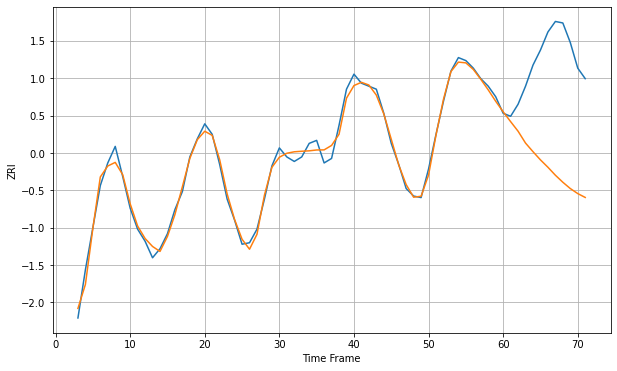

Wall time: 9.43 s
19104 4.1983016466281216 72.27687888469896 [1271.00035191 1264.45843549 1258.08174438 1250.19623744 1244.48744252
 1239.04068563 1234.14392515 1228.85111121 1224.17806104 1219.99439875
 1216.64628953 1214.08131433]

Got an mse at 0.0100 in round 261 and stopped training



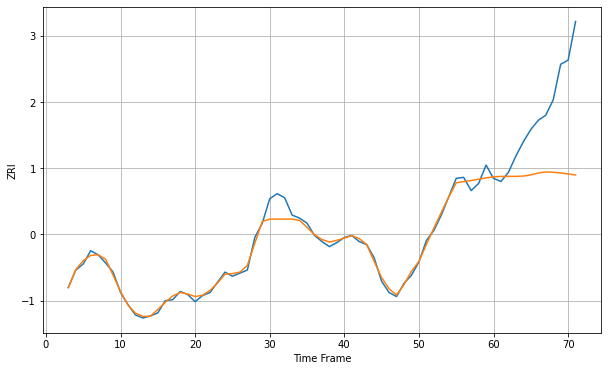

Wall time: 12.7 s
19106 6.091804189607143 71.25784165970244 [1767.52096309 1767.90243139 1767.99070752 1767.96626485 1768.28359626
 1769.44901799 1771.25866882 1772.2645923  1772.05081074 1771.30018019
 1770.3476506  1769.34040087]

Got an mse at 0.0099 in round 199 and stopped training



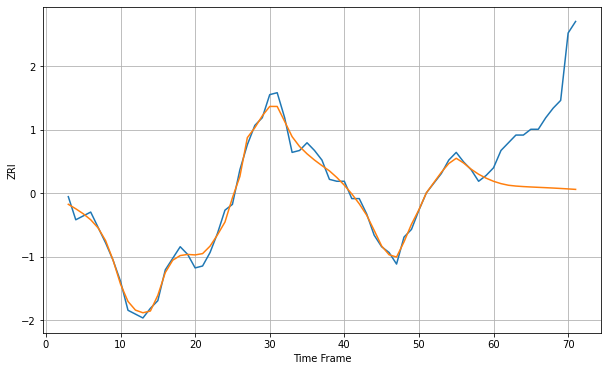

Wall time: 11.5 s
19107 3.362932621628592 44.1157703650468 [1563.98771286 1562.77512896 1561.93470491 1561.51339746 1561.2455551
 1561.03426617 1560.85201714 1560.67263569 1560.4785691  1560.26355989
 1560.03063565 1559.78809893]

Got an mse at 0.0099 in round 100 and stopped training



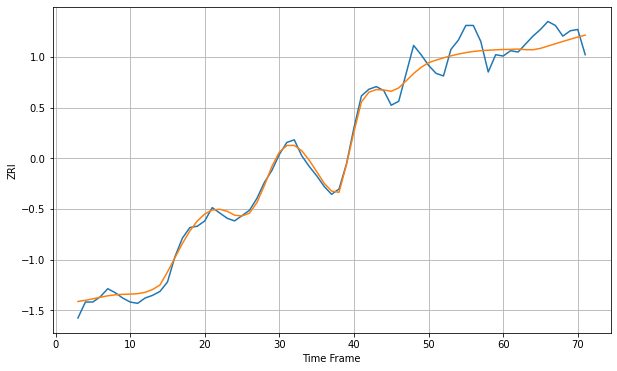

Wall time: 8.74 s
19120 7.279608955501998 9.97341514792877 [ 992.90539995  993.00696501  993.24073904  992.80295999  992.7285101
  993.7717946   995.50860651  997.23728914  998.95224877 1000.64596141
 1002.26025291 1003.72831161]


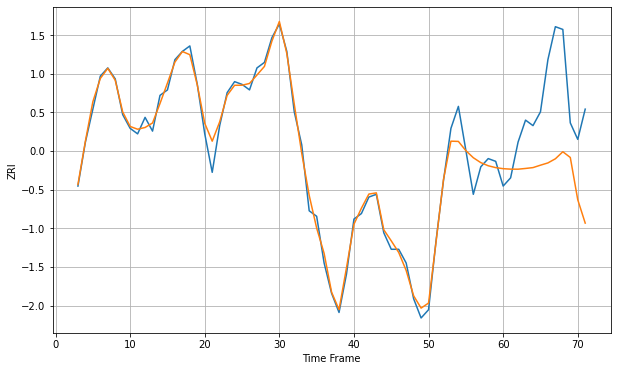

Wall time: 18.1 s
19121 3.5949809333496727 27.585522753783547 [1342.33046537 1342.16203551 1342.14363007 1342.41228101 1342.72204887
 1343.60111273 1344.4255201  1345.92708808 1348.48884805 1346.40948564
 1331.03512185 1322.52488639]

Got an mse at 0.0098 in round 55 and stopped training



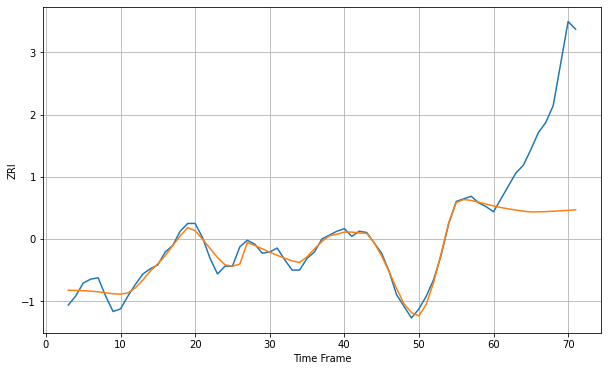

Wall time: 8.34 s
19123 5.164921892573479 78.29430123769714 [1544.5449189  1543.29247061 1542.25736774 1541.31835099 1540.46649671
 1539.90395938 1539.96876692 1540.1435762  1540.4075575  1540.74278876
 1541.13451574 1541.57174147]

Got an mse at 0.0099 in round 154 and stopped training



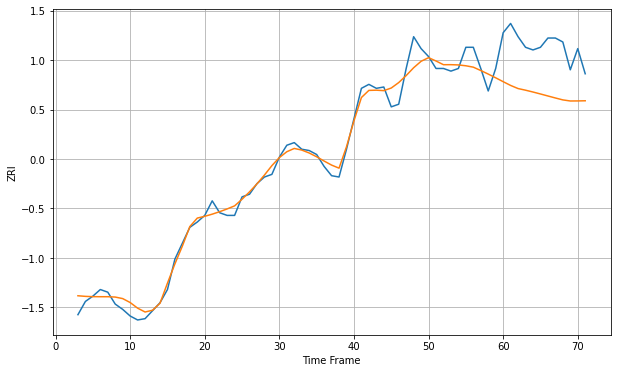

Wall time: 9.81 s
19124 7.196056956810839 37.43051090675449 [957.02450503 954.18664385 951.82529797 950.59021965 949.21183332
 947.73717153 946.21824782 944.70901727 943.26074048 942.43698095
 942.47662817 942.59696314]

Got an mse at 0.0099 in round 103 and stopped training



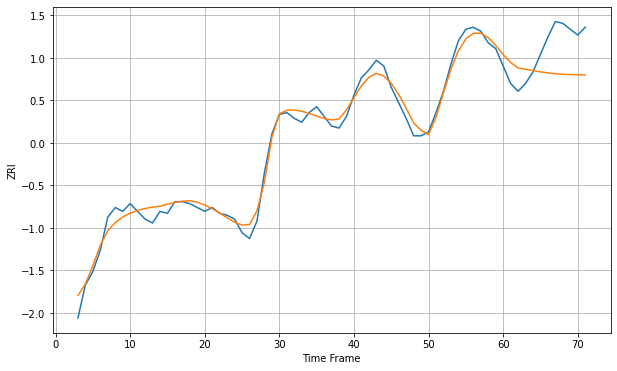

Wall time: 8.64 s
19128 4.152833791556515 17.72442647787421 [1253.9112478  1249.85533795 1247.02441633 1246.35981945 1245.66670471
 1245.01121665 1244.44980823 1244.02089953 1243.73656251 1243.57822037
 1243.49629003 1243.37573241]

Got an mse at 0.0099 in round 108 and stopped training



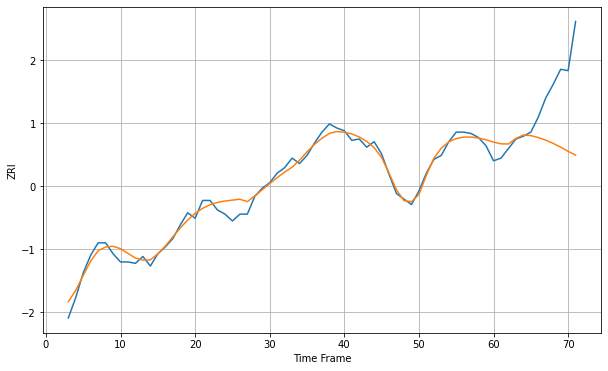

Wall time: 9.13 s
19130 5.005771187533766 40.4807607175774 [1529.71963797 1528.4577812  1528.32716997 1532.45975787 1534.88813954
 1534.49492834 1533.03743175 1531.15528371 1528.77916683 1525.97850474
 1522.96434222 1520.18185552]

Got an mse at 0.0099 in round 149 and stopped training



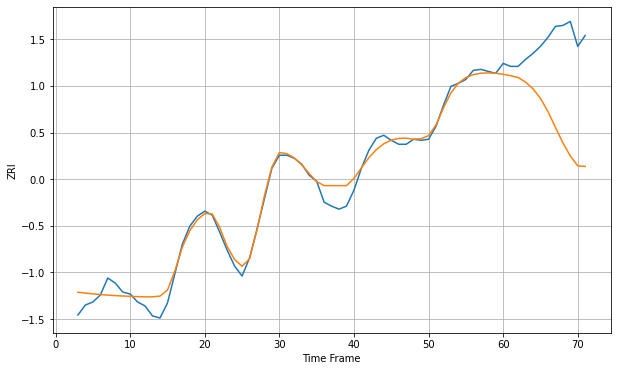

Wall time: 10.5 s
19131 9.21029552195675 83.63078767746933 [1158.1035563  1156.67658336 1154.91785514 1150.32165452 1143.5548952
 1133.96988072 1120.9105626  1105.05933859 1089.57051121 1076.31983614
 1066.38508748 1065.81839078]

Got an mse at 0.0100 in round 234 and stopped training



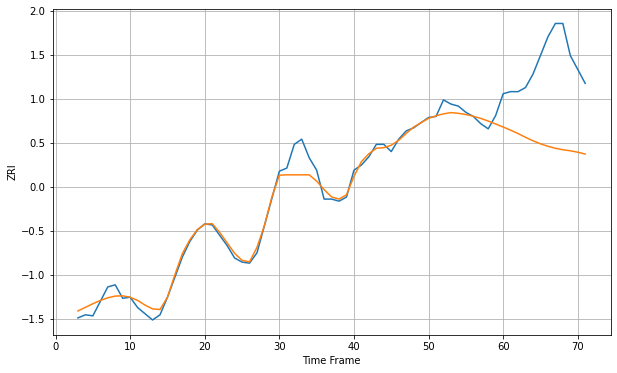

Wall time: 12 s
19139 8.3804509551787 80.73138559595125 [1111.76682912 1108.70977531 1105.44025225 1101.80857531 1098.42504767
 1095.53149028 1093.1374151  1091.22214175 1089.76525833 1088.7722191
 1087.37671604 1085.60679924]

Got an mse at 0.0099 in round 107 and stopped training



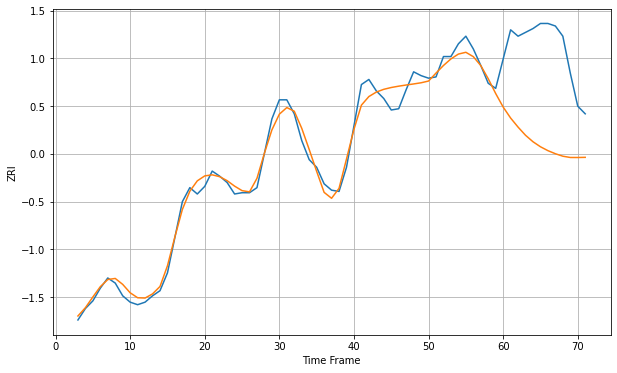

Wall time: 8.95 s
19140 6.943514412624215 77.08883362046991 [981.32632979 972.68942427 965.54916204 959.13668941 954.04968132
 950.11195646 947.05779879 944.64641498 942.69583471 941.69173852
 941.67570965 941.79395756]

Got an mse at 0.0100 in round 117 and stopped training



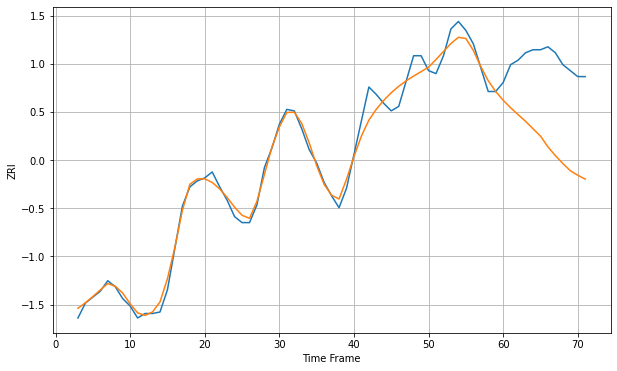

Wall time: 9.1 s
19141 6.228457640454313 56.185366257088326 [963.13692679 958.09914291 953.51545367 948.99984595 944.01304724
 939.08497286 931.85939098 925.98530524 920.67349014 915.82991871
 912.81981714 910.18926755]

Got an mse at 0.0100 in round 187 and stopped training



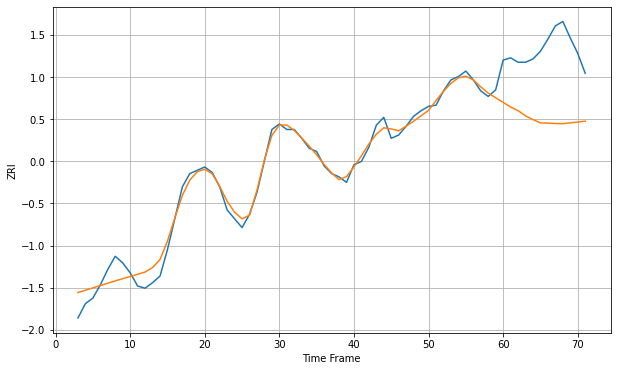

Wall time: 10.6 s
19143 7.568155622008955 63.87267682661017 [1109.60866301 1105.36986537 1102.10719039 1097.37284917 1093.97192175
 1090.96189922 1090.77813527 1090.40077479 1090.32533211 1090.99595748
 1091.73905233 1092.55552539]

Got an mse at 0.0100 in round 161 and stopped training



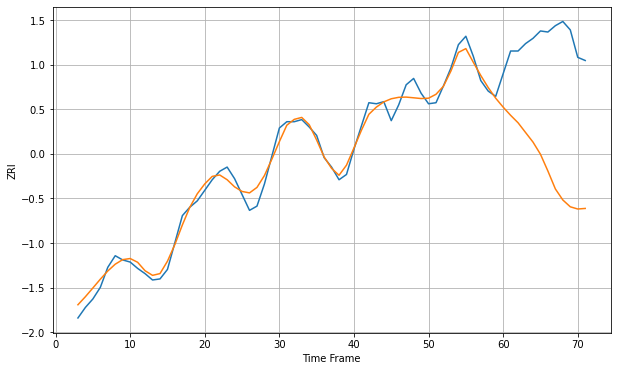

Wall time: 10.4 s
19144 7.856722753964973 121.81910259356106 [1049.80820162 1042.06628564 1034.980551   1025.80772974 1016.6951818
 1005.1807273   989.22961377  972.28432597  961.82873821  955.3587144
  953.27102433  953.80383563]

Got an mse at 0.0100 in round 247 and stopped training



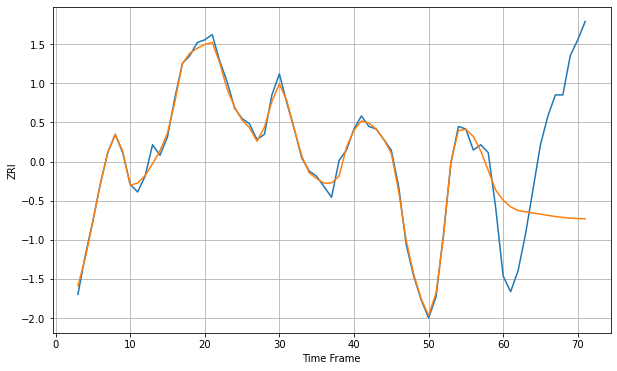

Wall time: 12.5 s
19146 2.502309158666264 43.92689139473101 [1481.87980121 1479.36475069 1477.94544616 1477.46340255 1477.00563713
 1476.5531941  1476.10562414 1475.68325624 1475.31924549 1475.04357916
 1474.8714896  1474.80374124]


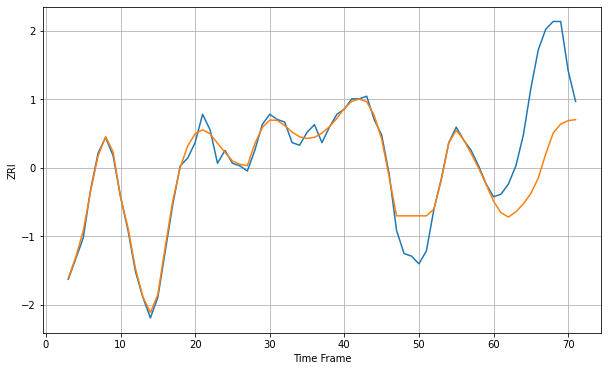

Wall time: 18 s
19147 4.756802788988326 31.10153318220878 [1419.29141675 1414.84029915 1413.13899873 1415.17738618 1418.27990834
 1422.27652607 1428.26850611 1437.63512096 1445.74282819 1449.18471666
 1450.53044261 1450.91608139]

Got an mse at 0.0099 in round 154 and stopped training



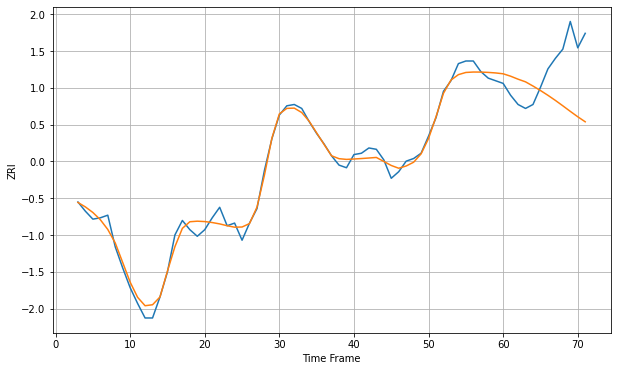

Wall time: 10.3 s
19148 5.356491720260317 36.97476664227103 [1264.29904345 1262.46885011 1260.19671447 1258.1852595  1255.0055326
 1251.60971608 1247.97042172 1244.09708347 1239.99466942 1235.78044087
 1231.69450732 1227.86626443]

Got an mse at 0.0099 in round 102 and stopped training



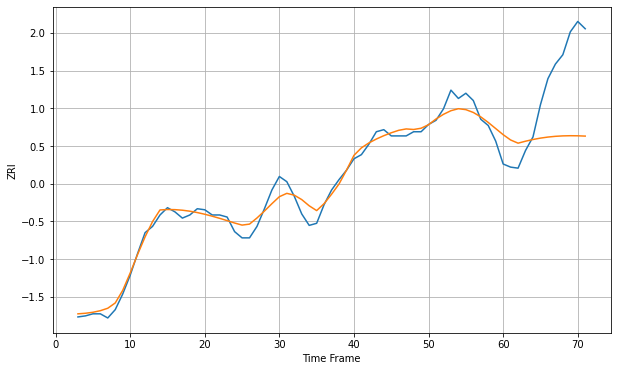

Wall time: 8.57 s
19401 7.872014784906715 64.48714253361645 [1219.1887697  1214.08730489 1211.02497687 1212.90233915 1214.5459975
 1215.87689915 1216.88893332 1217.59752939 1218.02164972 1218.18220009
 1218.10377487 1217.81557192]

Got an mse at 0.0099 in round 181 and stopped training



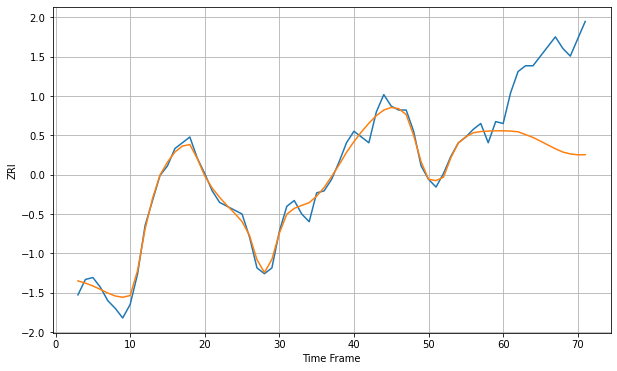

Wall time: 11.4 s
19464 3.9228776171268214 46.45279752255674 [1097.21365732 1097.07321493 1096.69821105 1095.2672176  1093.75391917
 1091.85690892 1089.83414557 1087.89208573 1086.17363682 1085.19831676
 1084.74627554 1084.80935902]

Got an mse at 0.0099 in round 174 and stopped training



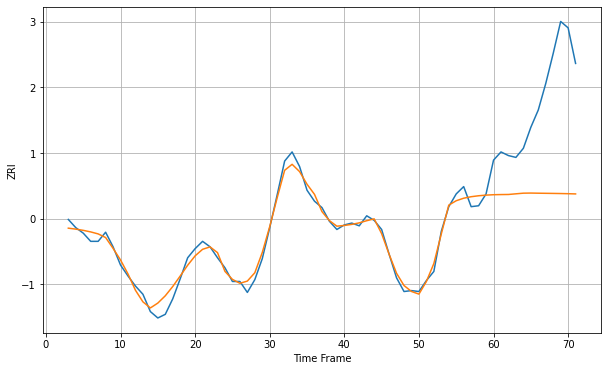

Wall time: 9.6 s
20001 7.2519658119731965 111.83564875762296 [2310.09826855 2310.2665418  2310.36472386 2311.089108   2311.78844455
 2311.91224228 2311.76169119 2311.64534873 2311.53054721 2311.39251501
 2311.21308476 2310.97862889]

Got an mse at 0.0099 in round 75 and stopped training



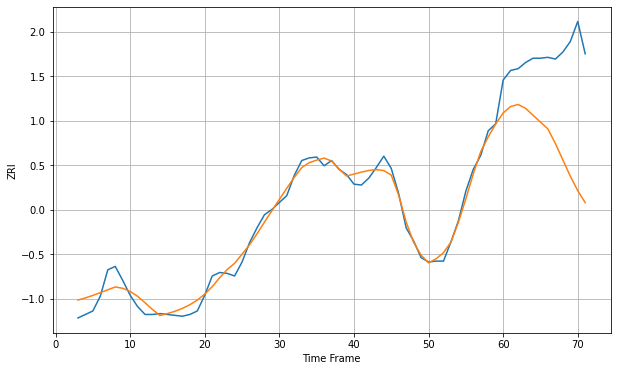

Wall time: 8.79 s
20002 9.376485644639011 107.36899470942092 [2163.39567466 2170.68141874 2173.05000116 2168.74488323 2160.77011522
 2153.05766004 2145.0818001  2128.48877034 2109.86043331 2091.11511824
 2074.54698262 2060.88271452]

Got an mse at 0.0100 in round 208 and stopped training



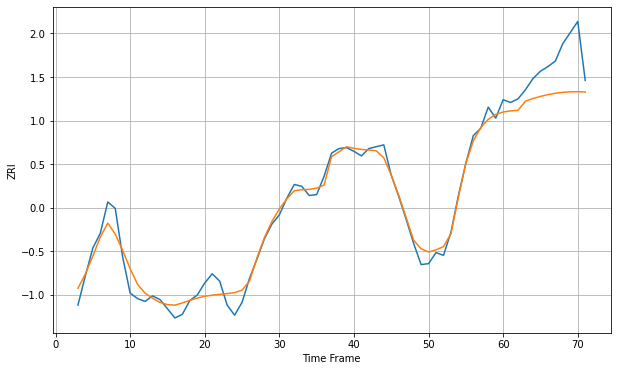

Wall time: 11.5 s
20003 10.67003374616917 37.49630954840416 [2307.69177356 2308.8641178  2309.5161838  2319.55654608 2322.29386426
 2324.62302887 2326.53713699 2328.0136082  2329.03455725 2329.59933889
 2329.72728891 2329.45320499]

Got an mse at 0.0099 in round 176 and stopped training



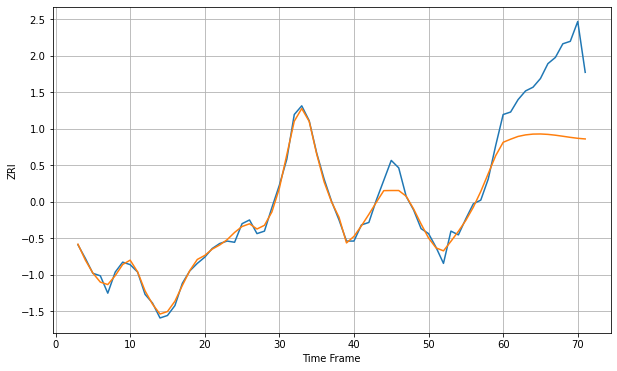

Wall time: 10.6 s
20005 5.547630794005981 55.542554669364165 [2272.60335843 2275.09471284 2277.33121762 2278.57215124 2279.21001388
 2279.31126458 2278.97792344 2278.32511372 2277.48051466 2276.59220685
 2275.8210891  2275.30389052]

Got an mse at 0.0100 in round 295 and stopped training



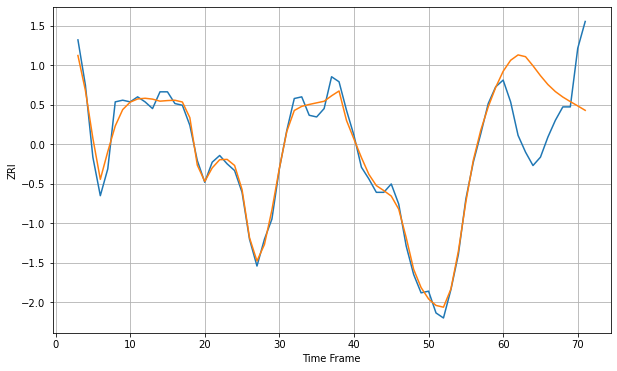

Wall time: 13.4 s
20007 5.240180939564889 38.11048719179536 [2174.26233659 2180.81957287 2184.03776159 2182.97419564 2177.54098126
 2171.64999719 2166.34913322 2162.14376863 2158.88754283 2156.1635463
 2153.59589982 2150.94737528]

Got an mse at 0.0099 in round 257 and stopped training



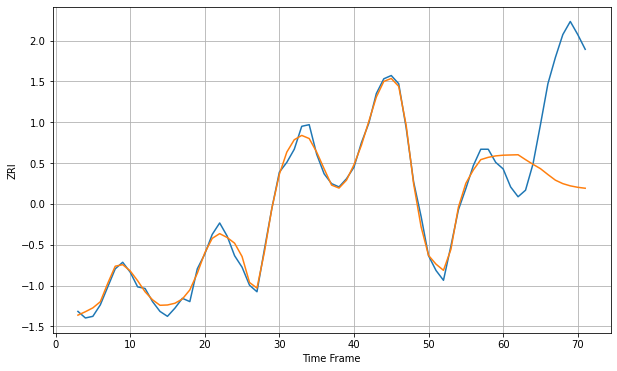

Wall time: 12 s
20008 3.6979405067463613 61.29925531341155 [2053.36283475 2053.50483005 2053.63565642 2050.64578386 2047.80415036
 2045.13959533 2041.55190152 2038.13218944 2036.00587439 2034.65168144
 2033.76754832 2033.18991494]

Got an mse at 0.0098 in round 170 and stopped training



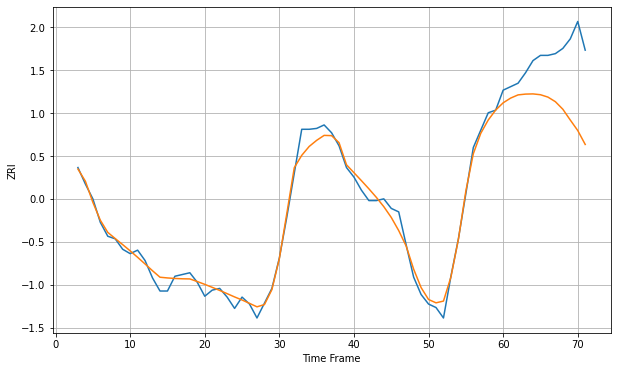

Wall time: 10.5 s
20009 9.186305794638871 65.28099414190754 [2332.44001361 2337.86312487 2341.56066963 2342.4666765  2342.6877549
 2341.75005202 2339.02663548 2333.74091562 2325.07224646 2312.61958516
 2300.56505779 2284.56515895]

Got an mse at 0.0100 in round 254 and stopped training



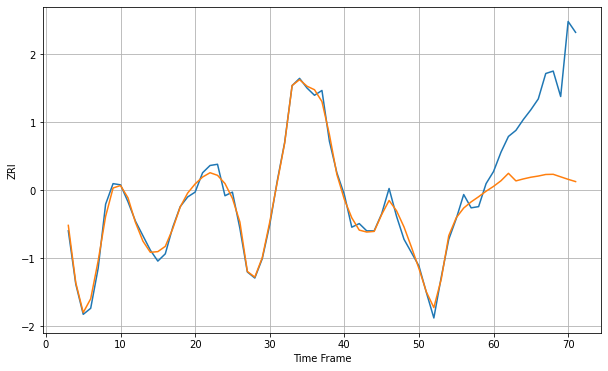

Wall time: 12.6 s
20010 5.237904563319726 72.92089763408505 [2125.72735744 2130.3828706  2136.52818673 2130.26734202 2131.89996289
 2133.2886837  2134.27473463 2135.56983495 2135.71490144 2133.63066979
 2131.56819044 2129.69551602]

Got an mse at 0.0100 in round 255 and stopped training



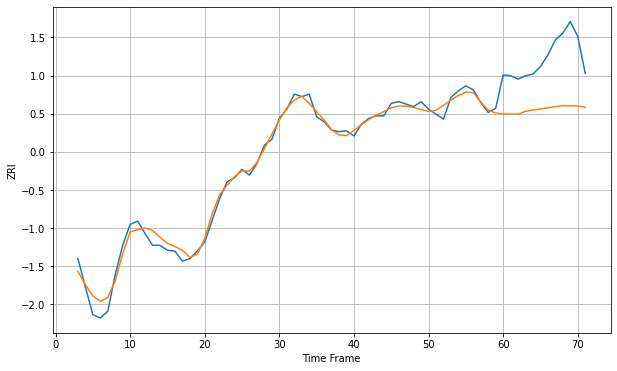

Wall time: 12.1 s
20011 7.994309324809251 63.92694189029333 [1890.34671175 1890.10002841 1889.91714914 1893.49521583 1894.91994516
 1896.28107161 1897.62361609 1898.96844207 1900.23730948 1899.98629358
 1899.80498709 1898.0606982 ]

Got an mse at 0.0100 in round 182 and stopped training



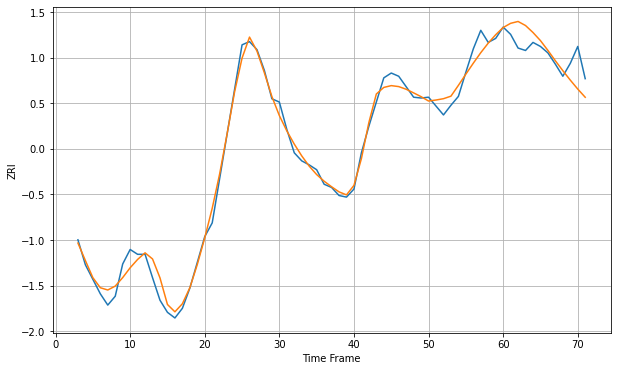

Wall time: 10.5 s
20019 10.98039912273349 22.868325524869515 [1710.46305264 1715.69474323 1718.00037571 1712.95367    1704.29915548
 1694.24251816 1682.05390681 1669.22987635 1656.92806898 1645.20340766
 1634.11883974 1623.92013949]

Got an mse at 0.0099 in round 117 and stopped training



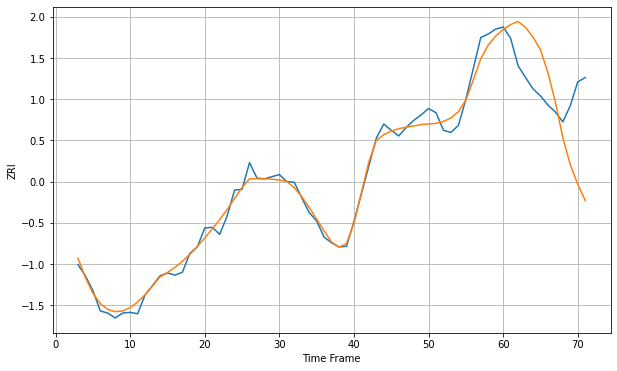

Wall time: 8.83 s
20020 10.71675178861967 82.06523084293141 [1674.45416007 1681.42763135 1685.86091107 1677.48267289 1663.66946663
 1645.58473276 1613.08935722 1571.17788445 1520.48970591 1482.15483329
 1454.18695266 1431.31973775]

Got an mse at 0.0100 in round 69 and stopped training



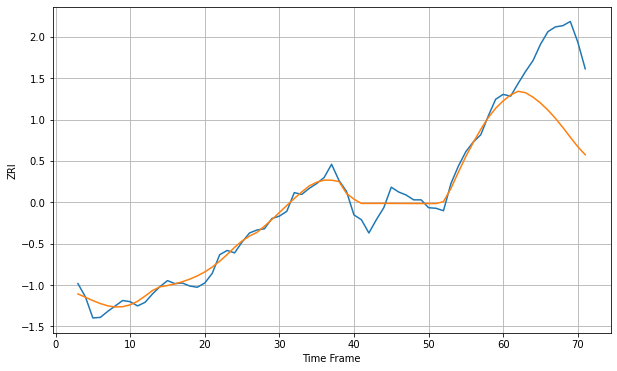

Wall time: 8.36 s
20024 14.029775910619835 119.18556299006634 [2337.15853313 2347.0620993  2353.09132964 2350.77055756 2343.41600069
 2333.76093367 2322.00745408 2308.39046244 2293.14927722 2276.9368684
 2261.27276056 2247.86933581]

Got an mse at 0.0099 in round 158 and stopped training



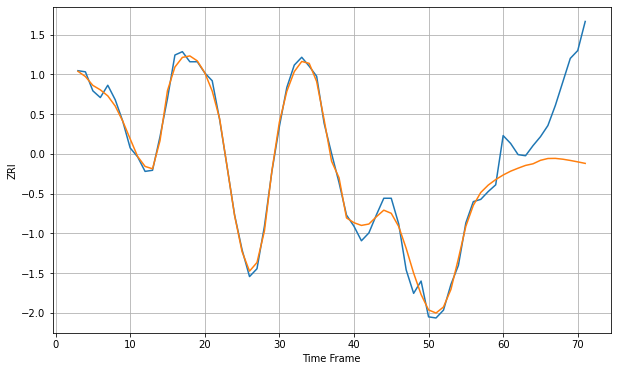

Wall time: 10.7 s
20037 6.651765650443657 61.22415359328153 [2384.76524906 2388.18021745 2390.86756382 2393.34206891 2394.78723647
 2397.8978477  2399.52982401 2399.63547876 2398.89879121 2397.78879717
 2396.51256051 2395.15819353]

Got an mse at 0.0099 in round 44 and stopped training



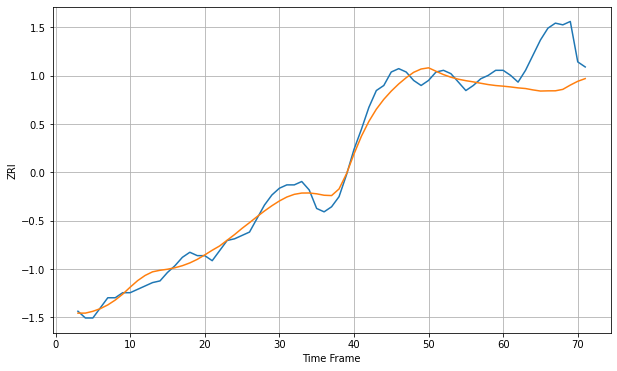

Wall time: 7.1 s
20109 5.484740369271665 25.2941026443286 [1450.59178529 1450.13338892 1449.57450055 1449.19069569 1448.37059873
 1447.70136498 1447.81304519 1447.84188681 1448.69666987 1451.23006365
 1453.48294622 1455.08763986]

Got an mse at 0.0099 in round 118 and stopped training



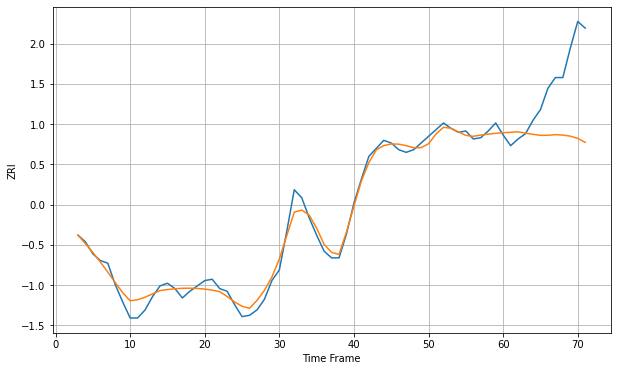

Wall time: 9.8 s
20110 5.50413328175309 45.514762297316985 [1405.6948896  1406.01403847 1406.38882951 1405.36575668 1404.49940689
 1403.7242194  1403.79871688 1404.21535482 1403.94809933 1403.12256098
 1401.45531043 1398.45500599]

Got an mse at 0.0099 in round 89 and stopped training



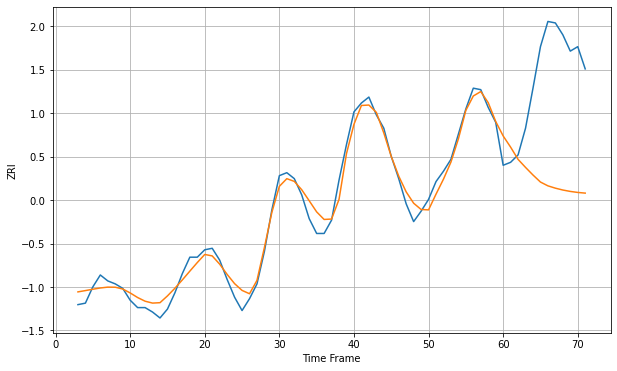

Wall time: 8.21 s
20147 6.378941265331664 78.68144731439006 [1612.79374362 1605.22421808 1596.98239053 1591.55781197 1586.42651278
 1581.68831735 1579.12674056 1577.55670322 1576.30917142 1575.36044103
 1574.67680624 1574.21940183]

Got an mse at 0.0097 in round 64 and stopped training



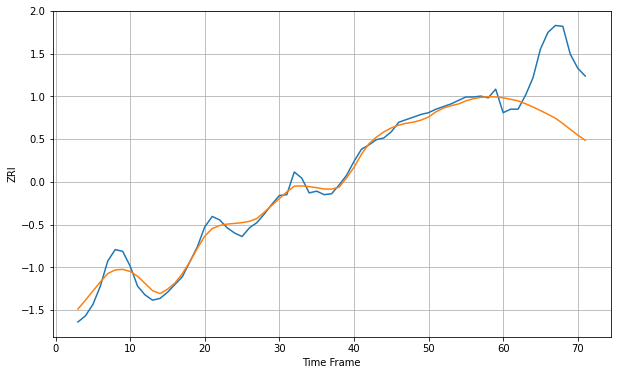

Wall time: 7.57 s
20175 8.663627788638708 69.51474381581097 [1638.05807477 1636.39377303 1634.4965829  1631.25555747 1627.51107711
 1623.43669629 1619.13909075 1614.6711186  1608.55203254 1601.80168992
 1595.28186621 1589.31960361]

Got an mse at 0.0100 in round 122 and stopped training



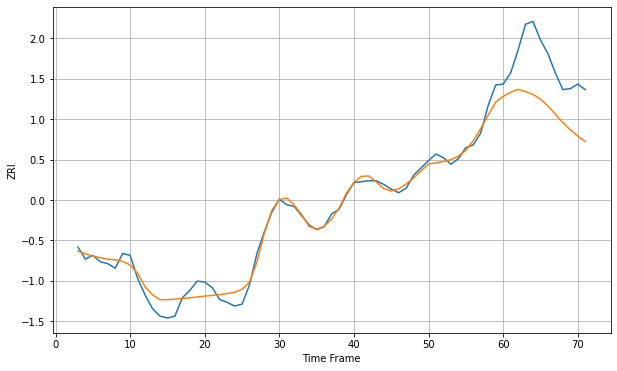

Wall time: 9.3 s
20176 8.403554304472411 52.50301611611994 [1610.54149984 1615.18415316 1618.24669866 1615.73287611 1612.80306908
 1607.66069741 1600.20211423 1591.26061163 1582.31790084 1574.38295533
 1567.56588514 1561.60462012]


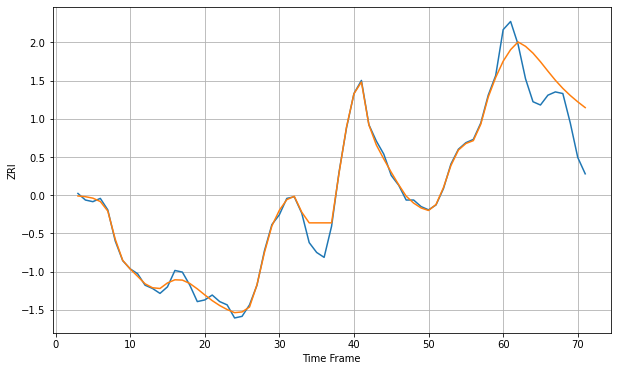

Wall time: 18.7 s
20740 4.535622868710258 22.33194384281257 [1651.72422625 1658.79253217 1663.49038739 1660.82692854 1656.67149555
 1651.40974458 1645.66965317 1640.11861588 1635.15043416 1630.80678671
 1626.94569906 1623.4123541 ]

Got an mse at 0.0100 in round 144 and stopped training



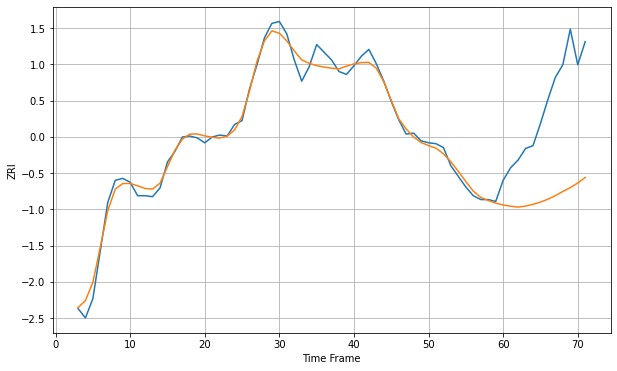

Wall time: 10.4 s
20814 7.782566128720729 101.59089745166288 [1945.37649439 1944.08927816 1943.16010284 1944.20673883 1946.03213834
 1948.37907412 1951.37434105 1955.09959427 1959.39306229 1963.38403821
 1968.18342681 1973.88312735]

Got an mse at 0.0099 in round 92 and stopped training



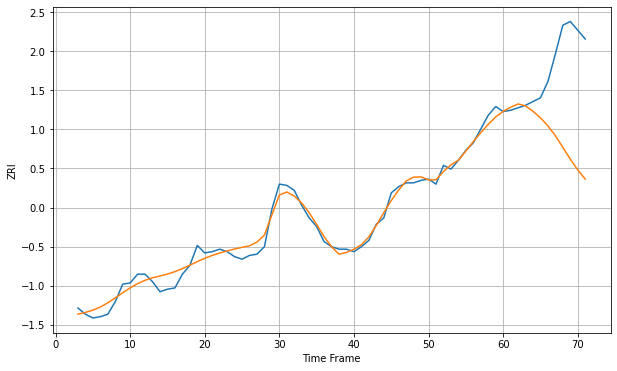

Wall time: 8.28 s
20850 5.821225046723495 66.1432430569284 [1852.09611399 1855.43437591 1858.05773161 1856.53867441 1852.2244284
 1846.97484346 1840.54341563 1832.68500678 1823.37577092 1814.01776301
 1805.28877685 1798.03043962]

Got an mse at 0.0098 in round 90 and stopped training



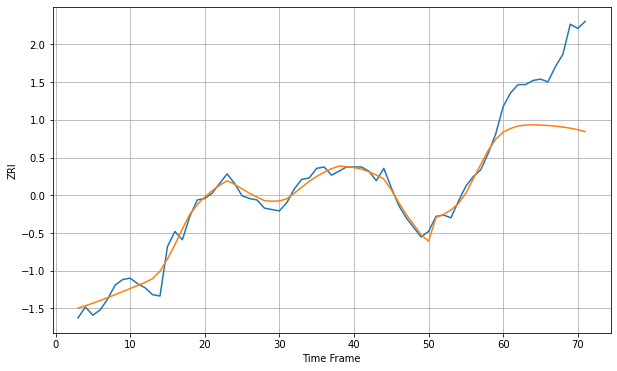

Wall time: 8.97 s
20852 5.418823189510842 48.54021602973034 [1772.39553486 1775.00217949 1776.86125466 1777.51840275 1777.74086215
 1777.52124189 1777.19973785 1776.73996728 1776.1063924  1775.26139058
 1774.15784615 1772.72915327]

Got an mse at 0.0100 in round 52 and stopped training



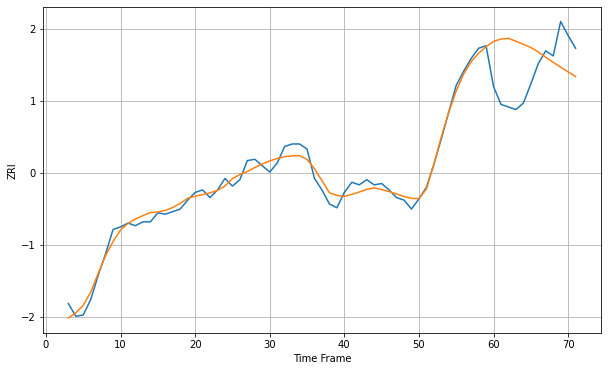

Wall time: 7.75 s
20878 5.516779852474271 35.698799821236214 [1706.32939372 1708.24494447 1708.78825547 1706.52760474 1704.09212068
 1701.58358095 1698.13986784 1693.94101139 1689.96945195 1686.18088117
 1682.50967103 1678.87285279]

Got an mse at 0.0100 in round 210 and stopped training



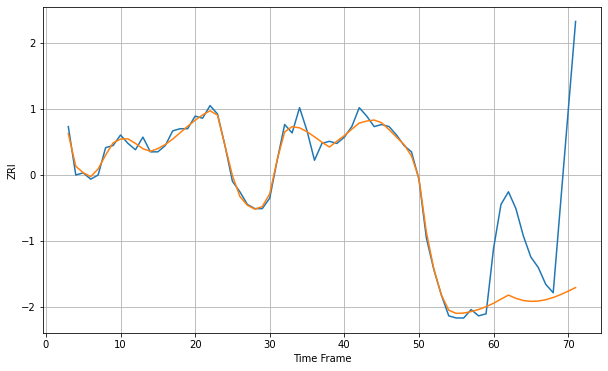

Wall time: 11.5 s
20902 3.038085031766948 53.11053630689097 [1724.00160691 1725.96403973 1727.88392073 1726.31020277 1725.32012387
 1724.9051508  1725.03867715 1725.67205496 1726.73180916 1728.12174879
 1729.73203271 1731.45354735]

Got an mse at 0.0100 in round 131 and stopped training



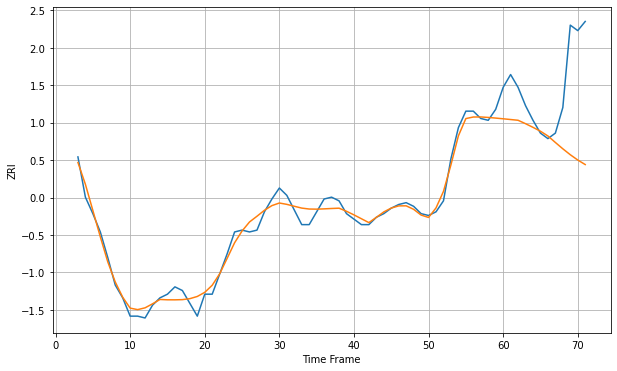

Wall time: 10.2 s
20906 4.173734792814981 38.7285761008333 [1569.82591807 1569.42234379 1569.01512692 1567.15330592 1565.15467923
 1563.03344014 1560.43767436 1556.8844093  1553.42125045 1550.18596295
 1547.29584917 1544.82191754]

Got an mse at 0.0098 in round 60 and stopped training



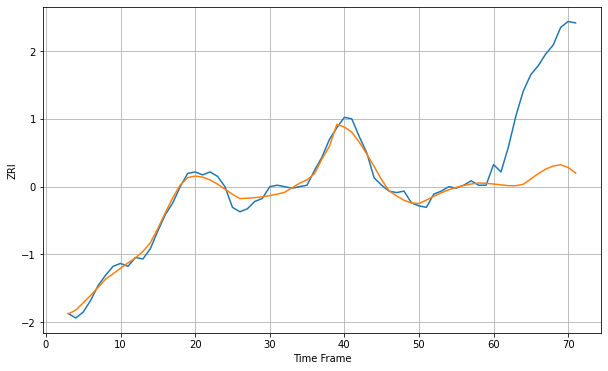

Wall time: 7.45 s
20910 4.024791113624575 70.23224348122893 [1710.78824949 1710.24422625 1709.6768453  1709.65627183 1710.65867003
 1714.24161717 1717.86117772 1720.89221592 1723.04078207 1723.83760366
 1722.05094752 1718.27085603]

Got an mse at 0.0100 in round 168 and stopped training



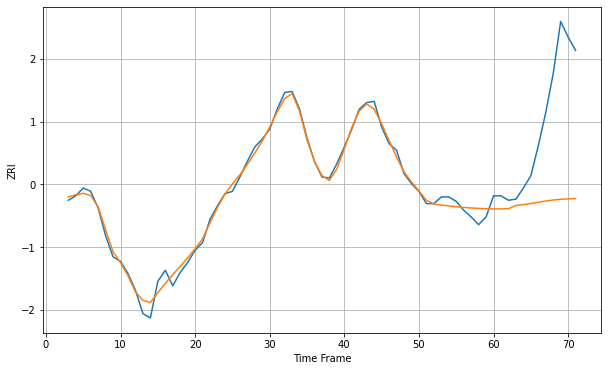

Wall time: 10.3 s
21043 5.3532100299262835 85.52530328824352 [1554.18935952 1554.19128296 1554.42450018 1557.31048765 1558.10494016
 1559.09989958 1560.22035984 1561.32337466 1562.24740294 1562.87795998
 1563.20707153 1563.57166367]

Got an mse at 0.0099 in round 67 and stopped training



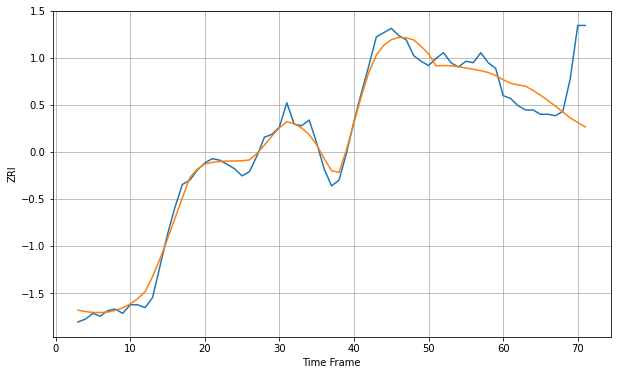

Wall time: 8.58 s
21044 6.505185907824719 31.07727953689586 [1642.1688087  1639.65973837 1638.50021373 1637.61271953 1634.66777781
 1631.30526863 1627.63411639 1623.72372005 1619.60767512 1615.47697838
 1612.27553729 1609.15636753]

Got an mse at 0.0100 in round 118 and stopped training



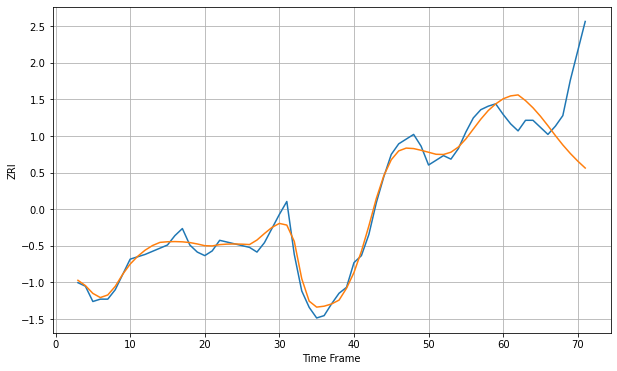

Wall time: 8.65 s
21046 6.428754824135281 50.86929040064958 [1658.26670447 1660.7289915  1661.58807754 1656.71935163 1650.626595
 1643.44518263 1635.41661041 1627.03868582 1619.04979346 1611.83647459
 1605.32918013 1599.43509741]

Got an mse at 0.0098 in round 78 and stopped training



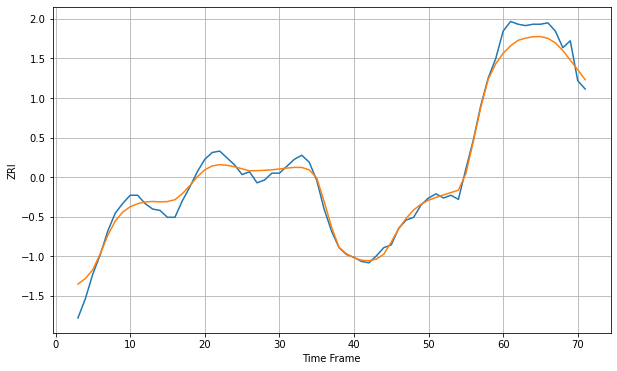

Wall time: 8.48 s
21061 6.21818792824448 11.027944806762214 [1446.92893895 1452.36481384 1456.33501947 1457.91793038 1458.93193743
 1459.05946725 1457.7772279  1454.48624809 1448.94653777 1441.95624747
 1434.94604342 1427.80966064]

Got an mse at 0.0096 in round 31 and stopped training



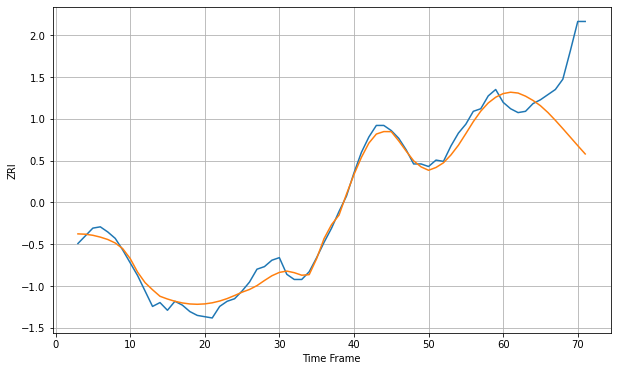

Wall time: 6.57 s
21117 6.036210863212322 47.76354375818152 [1352.80641565 1353.88106858 1353.23283036 1350.80751589 1347.48192102
 1343.36094692 1338.07206775 1331.97454694 1325.52393313 1318.89793091
 1312.26829846 1305.78391765]

Got an mse at 0.0099 in round 134 and stopped training



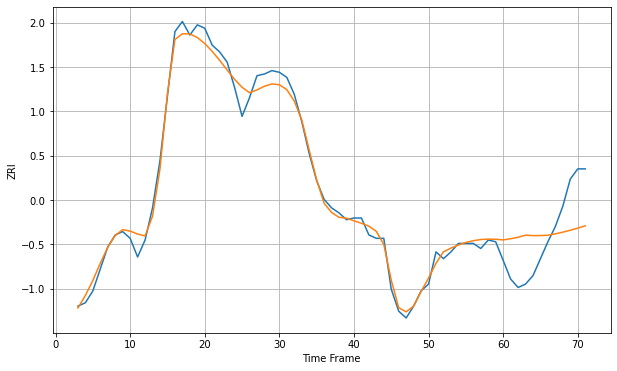

Wall time: 10 s
21202 5.107280323489861 23.634770932554197 [1244.07872167 1244.77766572 1245.6369934  1246.86352772 1246.62515381
 1246.64193331 1246.82292478 1247.65458644 1248.65048201 1249.78478697
 1251.03195084 1252.36337745]

Got an mse at 0.0100 in round 159 and stopped training



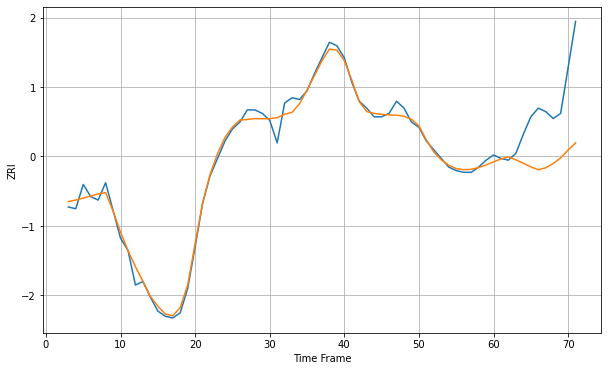

Wall time: 9.87 s
21204 3.865144259026439 31.5816331676697 [1297.0350732  1298.67631059 1299.89755311 1298.19352794 1296.21932658
 1294.15431477 1292.50637388 1293.61204573 1296.02283335 1299.30944219
 1303.87405821 1307.93296514]

Got an mse at 0.0100 in round 382 and stopped training



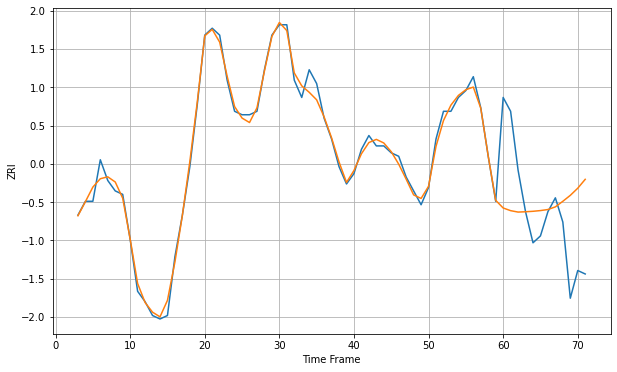

Wall time: 15.6 s
21217 2.020858721569647 19.074763839890817 [1037.06715998 1036.29328747 1035.88499056 1035.97528557 1036.1091088
 1036.31689662 1036.62082475 1037.39050366 1038.99728609 1040.71305064
 1042.77793172 1045.34361198]

Got an mse at 0.0099 in round 116 and stopped training



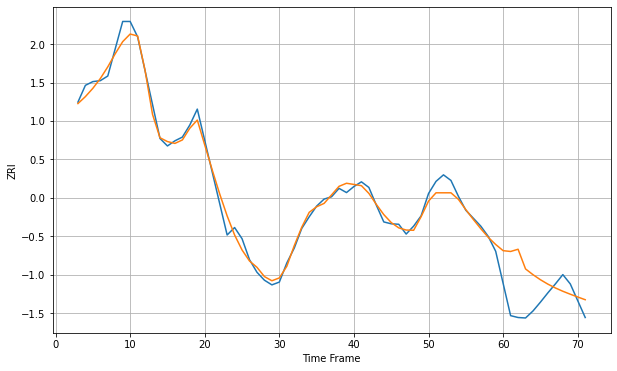

Wall time: 9.73 s
21231 15.270365633945394 75.5333655385916 [1773.34876632 1771.64398253 1776.42200989 1734.2041294  1721.8591694
 1710.98301147 1701.54297664 1693.40103081 1686.31361071 1679.95656913
 1673.99049031 1668.15573323]

Got an mse at 0.0099 in round 189 and stopped training



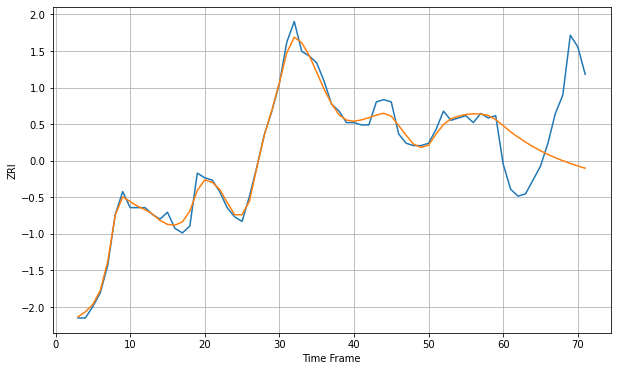

Wall time: 10.6 s
22030 3.0261591603529614 30.283248441059573 [1726.72709022 1723.96726407 1721.6763894  1719.49286334 1717.54476444
 1715.7593245  1714.15951873 1712.71971853 1711.41691753 1710.23169125
 1709.14817086 1708.15359579]


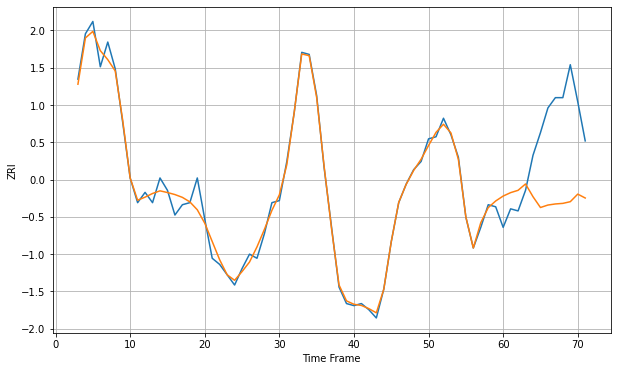

Wall time: 18.4 s
22031 3.7443090115476867 37.4835983717252 [1804.20694205 1805.87149064 1806.99328888 1810.08619982 1803.89834628
 1798.64538674 1799.84499666 1800.37260038 1800.65377735 1801.47286213
 1805.15070922 1803.26610011]

Got an mse at 0.0098 in round 72 and stopped training



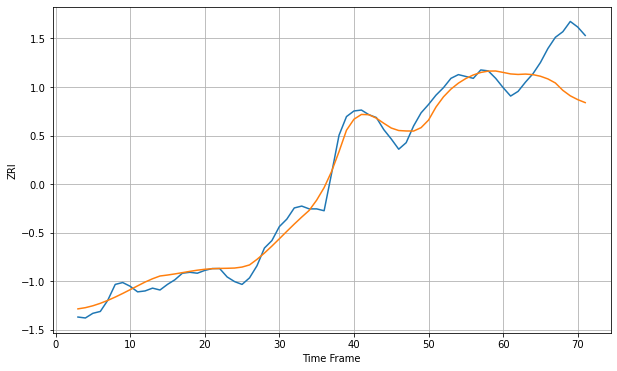

Wall time: 8.39 s
22033 10.443727504832832 46.97238039472626 [1823.35624382 1821.73157781 1821.18393903 1821.57019793 1820.95994602
 1819.24733708 1816.37813765 1812.03138478 1804.13049435 1798.24765049
 1794.16570377 1790.95826076]

Got an mse at 0.0100 in round 177 and stopped training



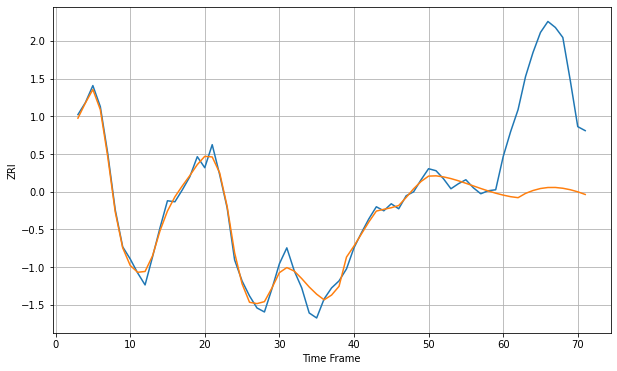

Wall time: 9.85 s
22102 7.654809694076124 117.63477660867197 [2035.66290798 2034.08755976 2033.09120828 2037.36866602 2040.23584251
 2042.23756359 2043.24162377 2043.28272802 2042.49952422 2041.02764998
 2038.94322695 2036.3053313 ]

Got an mse at 0.0100 in round 264 and stopped training



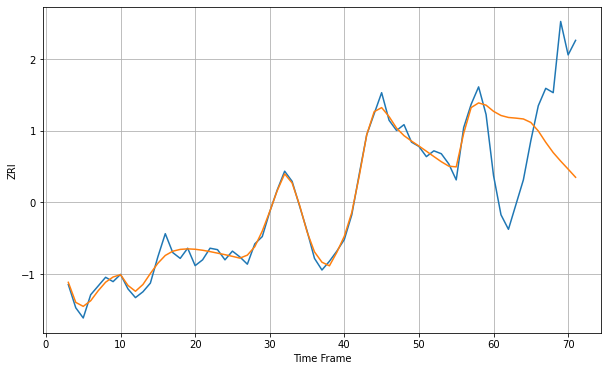

Wall time: 12.3 s
22180 4.85797486987711 61.68022235804549 [1873.17816707 1870.30957089 1868.95286774 1868.49762522 1867.92155455
 1865.52638821 1859.67362704 1851.86177395 1844.79182398 1838.92647469
 1833.41104608 1827.78991086]

Got an mse at 0.0100 in round 225 and stopped training



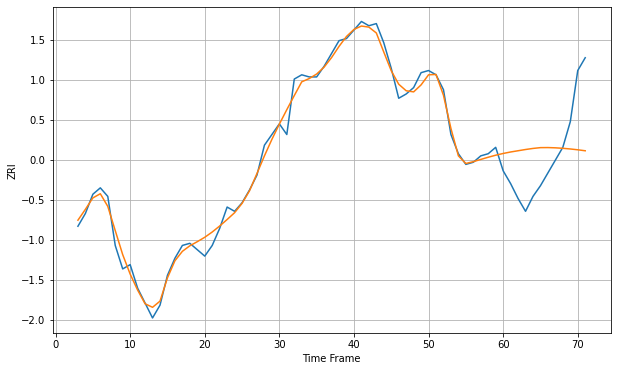

Wall time: 11.6 s
22191 3.710624875492857 22.493107370872757 [1475.11571192 1475.81420781 1476.39414347 1476.97745002 1477.47832756
 1477.85187331 1477.88259864 1477.76411805 1477.5384563  1477.22759418
 1476.84268781 1476.3839052 ]

Got an mse at 0.0098 in round 23 and stopped training



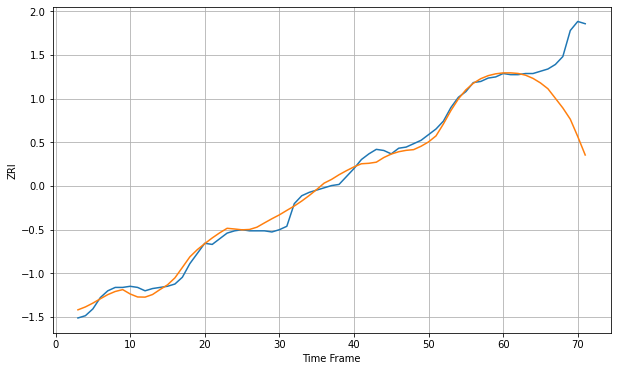

Wall time: 6.49 s
22192 5.571385443939619 52.69979311631293 [1457.54933005 1457.57952081 1457.05816614 1455.53627255 1452.71147873
 1448.70470519 1443.55658452 1435.08527203 1426.57388583 1416.63554864
 1401.32372539 1385.00419248]

Got an mse at 0.0100 in round 201 and stopped training



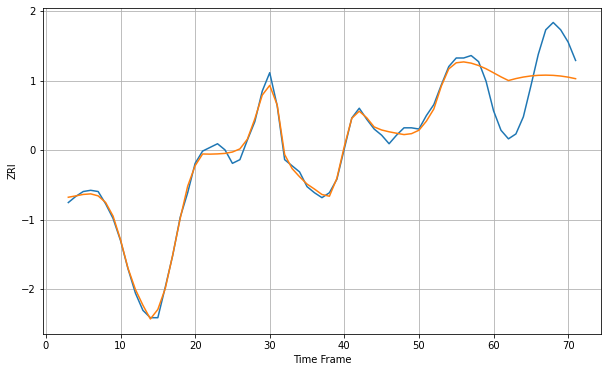

Wall time: 11 s
22201 4.241329451904516 34.49601581700463 [2144.92276596 2141.5998338  2138.59530265 2140.20122062 2141.4496808
 2142.33095212 2142.84888171 2143.01035223 2142.81912693 2142.27404842
 2141.37095863 2140.10582446]

Got an mse at 0.0099 in round 48 and stopped training



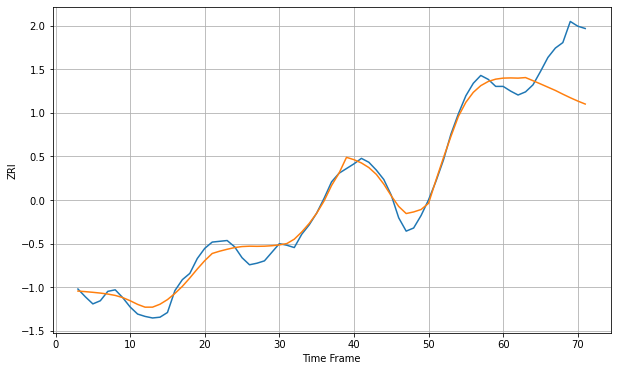

Wall time: 7.31 s
22202 10.665292487089868 56.40935138725435 [2169.58237082 2169.83767436 2169.57254813 2170.27838819 2166.30237088
 2162.19154763 2158.00840789 2153.83200827 2149.07584237 2144.51738128
 2140.28403612 2136.44299624]

Got an mse at 0.0100 in round 157 and stopped training



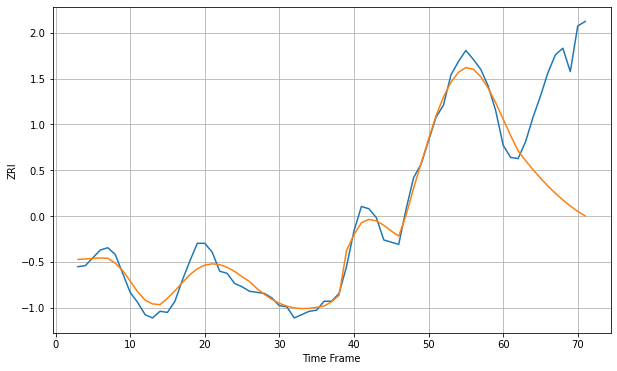

Wall time: 9.95 s
22203 8.72702265038473 102.3766045170469 [2092.45018855 2077.72891587 2064.04709429 2055.22977137 2047.05482903
 2039.46052076 2032.40247714 2025.86645461 2019.8701356  2014.45478662
 2009.67003357 2005.55705159]

Got an mse at 0.0100 in round 161 and stopped training



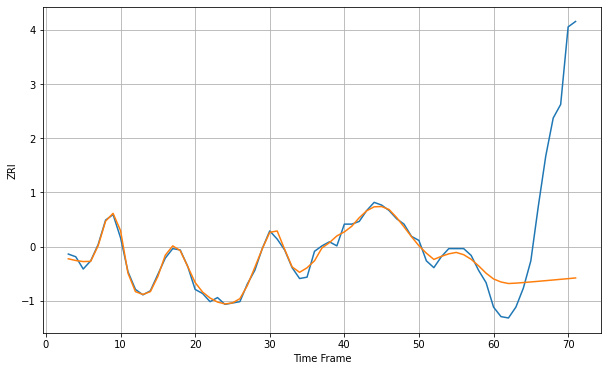

Wall time: 9.47 s
22204 3.2857179830636905 97.5625188122867 [1777.7051371  1775.45751281 1774.33975147 1774.61702391 1775.04414575
 1775.49139535 1775.95815402 1776.43983966 1776.9308814  1777.42667631
 1777.9245931  1778.42404656]

Got an mse at 0.0100 in round 247 and stopped training



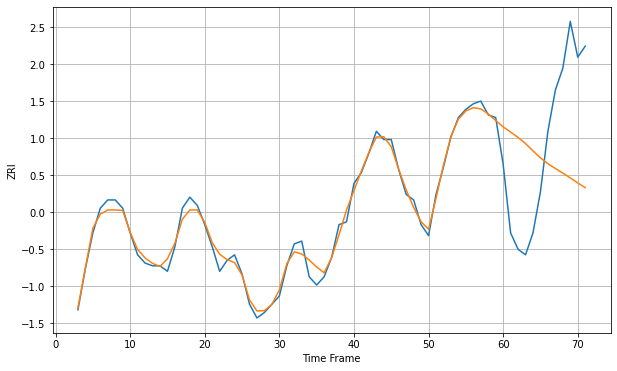

Wall time: 11.8 s
22206 2.5375959977888627 36.851026871963356 [1889.60126378 1887.70529717 1885.74930599 1883.52805442 1880.86408109
 1878.29889019 1876.19126604 1874.44053321 1872.77473419 1871.02117842
 1869.19469395 1867.45800421]

Got an mse at 0.0100 in round 125 and stopped training



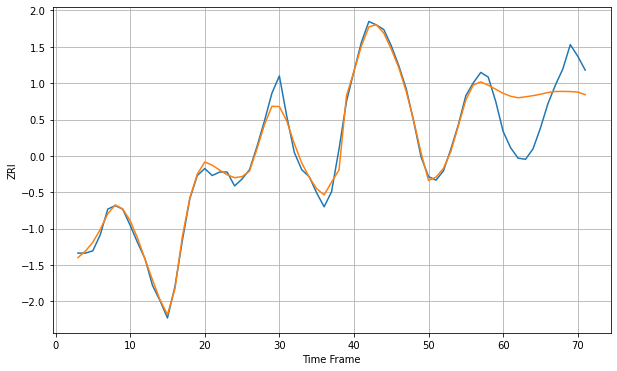

Wall time: 8.91 s
22209 6.20381118302836 35.585798580978775 [2261.96834521 2259.43859259 2258.12153378 2258.93297638 2259.93131889
 2261.15752438 2262.65438747 2263.54493953 2263.62054965 2263.47803168
 2263.04597982 2260.77474002]


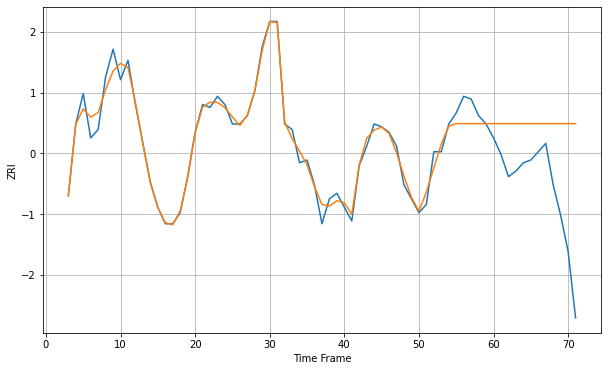

Wall time: 16.8 s
22303 3.4046991634656925 28.824829420247873 [1728.13902842 1728.13902842 1728.13902842 1728.13902842 1728.13902842
 1728.13902842 1728.13902842 1728.13902842 1728.13902842 1728.13902842
 1728.13902842 1728.11747056]

Got an mse at 0.0099 in round 123 and stopped training



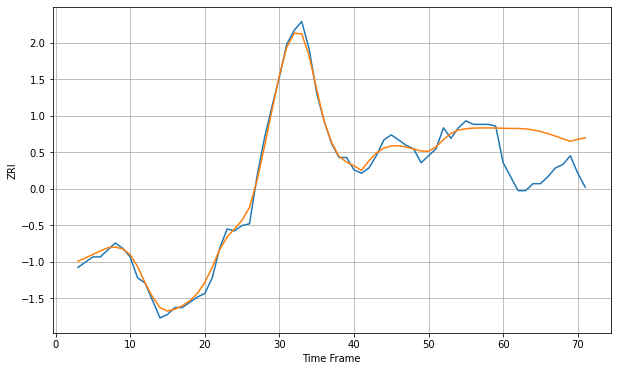

Wall time: 9.72 s
22304 3.4879923890873905 25.714274762573673 [1597.76601388 1597.65417445 1597.68405747 1597.40166609 1596.81681282
 1595.89126215 1594.7035232  1593.29128744 1591.70580085 1590.36149899
 1591.40433381 1592.31795113]

Got an mse at 0.0099 in round 315 and stopped training



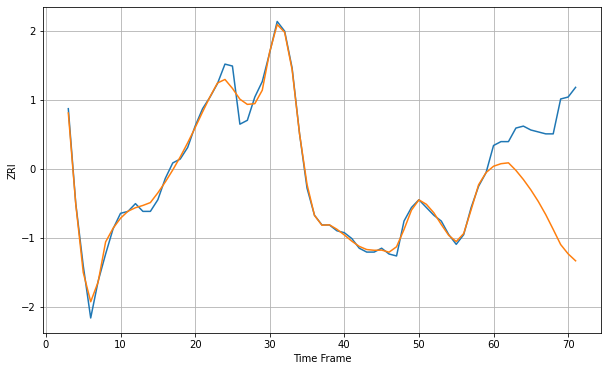

Wall time: 13.8 s
22305 3.604157316585049 48.48298901912114 [1757.28665578 1758.60698552 1759.05741106 1755.16608292 1750.45120694
 1745.11636181 1739.1193813  1732.32180027 1724.70102992 1716.88572068
 1712.08591906 1708.50526362]


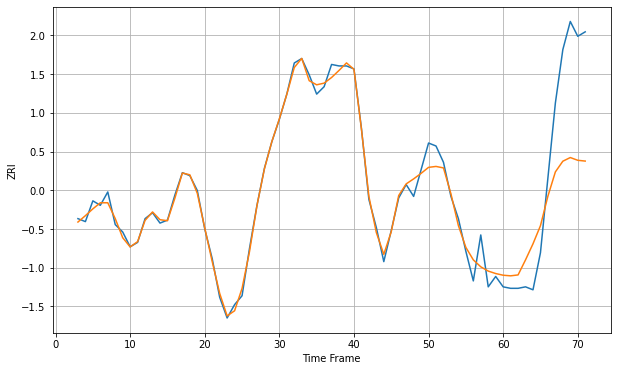

Wall time: 18.2 s
22312 5.695324006585536 52.30914322870376 [1698.83508819 1698.4270769  1699.0325017  1709.19589374 1720.02086413
 1732.23639692 1752.18111858 1768.52849577 1775.7362844  1778.21325114
 1776.36076448 1775.82944812]

Got an mse at 0.0099 in round 49 and stopped training



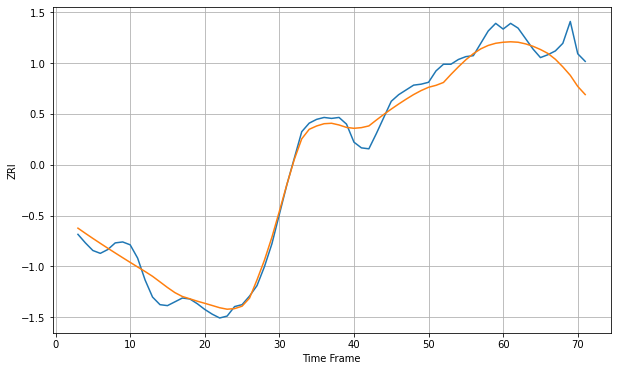

Wall time: 7.22 s
22901 11.044436816613182 24.503674423341373 [1265.14066198 1265.60990738 1265.15155917 1263.4392013  1260.88004853
 1257.50024019 1253.37733105 1247.20449854 1239.2344166  1230.30921907
 1218.65313864 1210.08563612]

Got an mse at 0.0098 in round 45 and stopped training



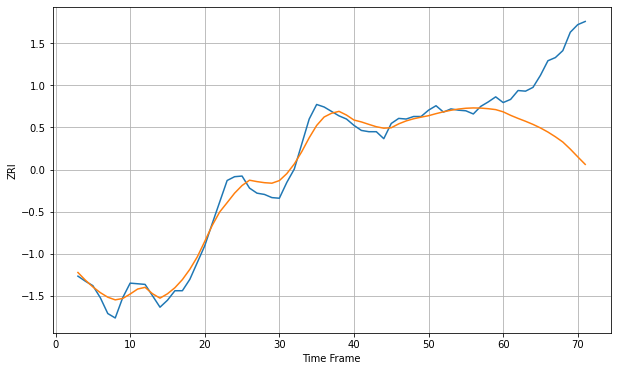

Wall time: 7.72 s
22903 14.484948597008978 126.78962600448256 [1413.38455213 1407.85042136 1402.98823623 1398.46453065 1393.54888582
 1387.95234195 1381.46378513 1374.00722429 1365.70731736 1354.54707929
 1342.3419718  1330.42945342]

Got an mse at 0.0099 in round 79 and stopped training



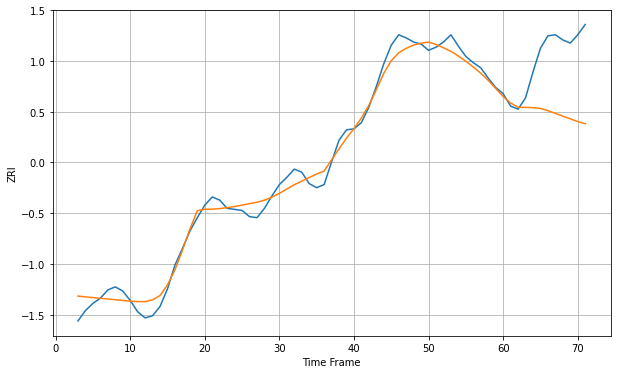

Wall time: 7.89 s
23220 9.261712374913698 59.739621269080665 [1152.19384276 1146.03848817 1141.8244138  1141.69959753 1141.46717134
 1140.70147537 1138.574547   1135.97451423 1133.24145438 1130.68904824
 1127.97778499 1125.93841029]

Got an mse at 0.0100 in round 78 and stopped training



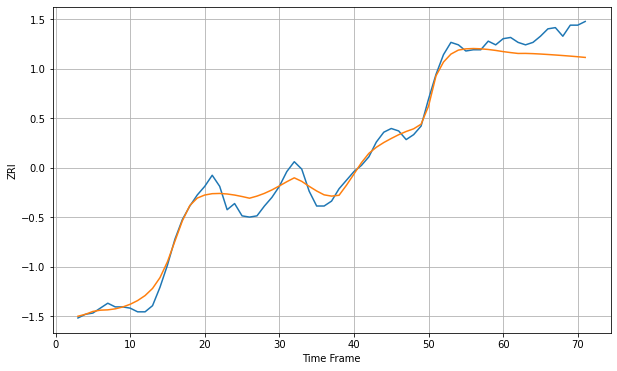

Wall time: 8.8 s
23223 7.4069382751056185 18.272569117857312 [1132.50660427 1131.70229455 1131.00400195 1131.0383892  1130.84477932
 1130.53290802 1130.15739723 1129.74439483 1129.30413004 1128.83583814
 1128.32945253 1127.76831829]

Got an mse at 0.0100 in round 67 and stopped training



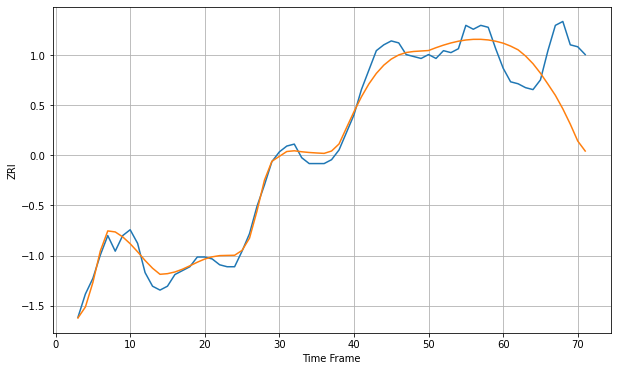

Wall time: 8.16 s
23294 5.08192199748721 30.71908570156433 [1085.85444078 1084.34515994 1082.44240099 1079.27412269 1075.31749535
 1070.42173668 1064.83035353 1059.05088976 1052.11578555 1044.24750084
 1035.57614699 1030.43536475]

Got an mse at 0.0098 in round 103 and stopped training



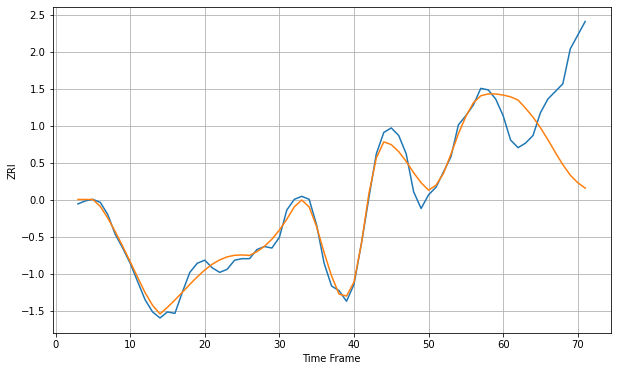

Wall time: 8.05 s
23451 5.3425773546724535 54.953387083252814 [1200.5982633  1199.43057781 1197.30679448 1192.00788423 1186.08135673
 1179.10567625 1171.24622547 1162.80563923 1154.80831587 1147.91572765
 1142.94466121 1139.4166522 ]

Got an mse at 0.0100 in round 92 and stopped training



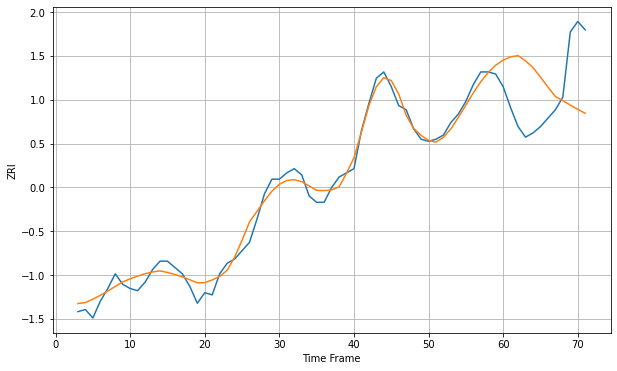

Wall time: 9.51 s
23452 4.205986751715452 28.146948882176183 [1209.63017319 1211.16449556 1211.7739615  1209.25473312 1206.06538579
 1201.52519985 1196.84446489 1192.30081932 1190.33303266 1188.25293503
 1186.20465571 1184.3397086 ]

Got an mse at 0.0100 in round 193 and stopped training



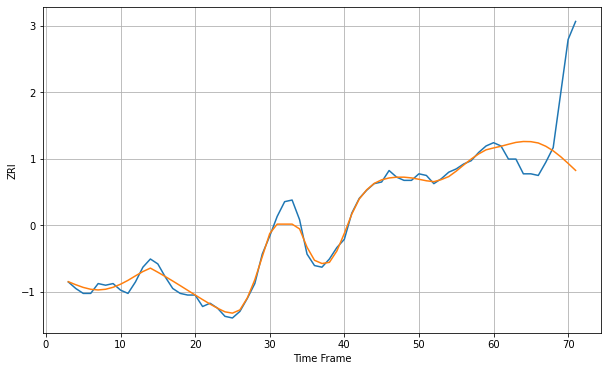

Wall time: 10.1 s
23454 3.939873566229422 37.56502470427487 [1158.78841321 1159.82339322 1161.03690384 1162.17761437 1162.7253851
 1162.6311066  1161.82142928 1159.83698834 1157.02638152 1153.45932013
 1149.36474529 1145.09411165]

Got an mse at 0.0100 in round 136 and stopped training



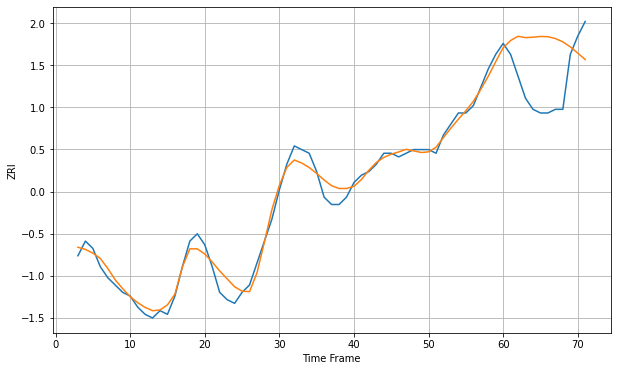

Wall time: 9.51 s
23503 2.374473071941495 14.483276516382688 [831.81111873 833.8030227  834.95404592 834.58061026 834.700421
 834.90246147 834.83408982 834.33829794 833.41874722 832.06726152
 830.35424243 828.59596361]

Got an mse at 0.0100 in round 147 and stopped training



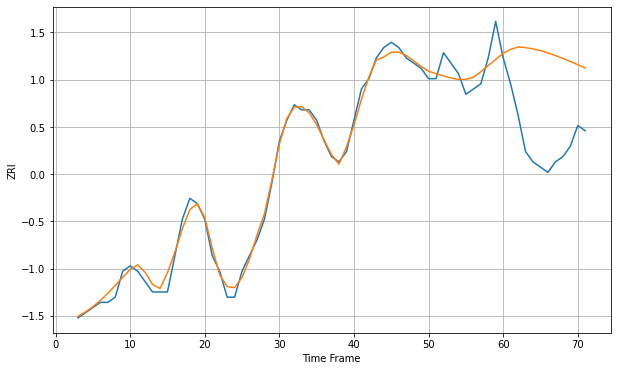

Wall time: 9.54 s
23518 1.762831759054579 16.931388073260432 [824.87341339 825.63225244 826.11091001 825.9680871  825.72853022
 825.39051068 824.96268342 824.46057182 823.90266156 823.30699604
 822.68892827 822.06022954]

Got an mse at 0.0099 in round 85 and stopped training



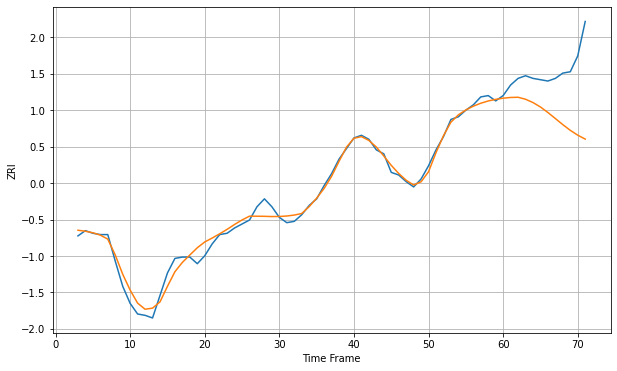

Wall time: 8 s
23602 4.94326709181448 38.53151995617595 [1001.03344445 1001.58764384 1001.73915367 1000.24347869  997.73864855
  994.39668825  990.2129942   985.6563044   981.04606474  976.75696633
  973.09648148  970.13386902]

Got an mse at 0.0099 in round 36 and stopped training



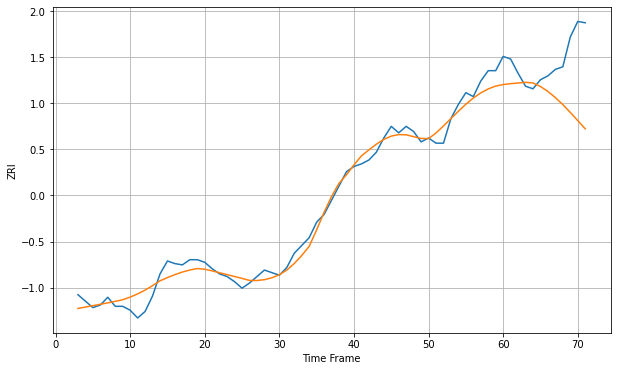

Wall time: 7.96 s
23666 7.060396859404129 39.137618854946496 [1050.27030481 1050.98674523 1051.46044005 1051.98212827 1051.4938707
 1048.78495329 1044.9400558  1040.22398368 1034.77268044 1028.76534364
 1022.44393266 1016.09612116]

Got an mse at 0.0100 in round 127 and stopped training



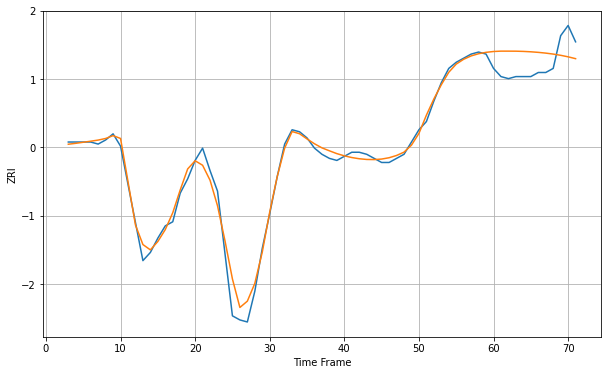

Wall time: 9.04 s
23803 3.9952396145675744 11.134861447168467 [930.26985172 930.44645749 930.44222463 930.42279104 930.31330932
 930.12143901 929.84666461 929.48058489 929.0076688  928.40791782
 927.66322863 926.76710262]

Got an mse at 0.0099 in round 59 and stopped training



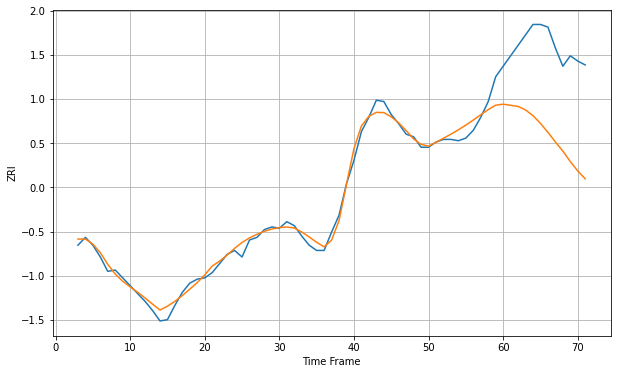

Wall time: 8.79 s
23831 5.489737284627098 67.99528705091292 [1074.94362126 1074.10848549 1073.25696629 1070.57661715 1066.19541901
 1060.28104807 1053.40604372 1046.09948966 1039.07562317 1031.04471657
 1023.87998908 1017.81229804]

Got an mse at 0.0100 in round 144 and stopped training



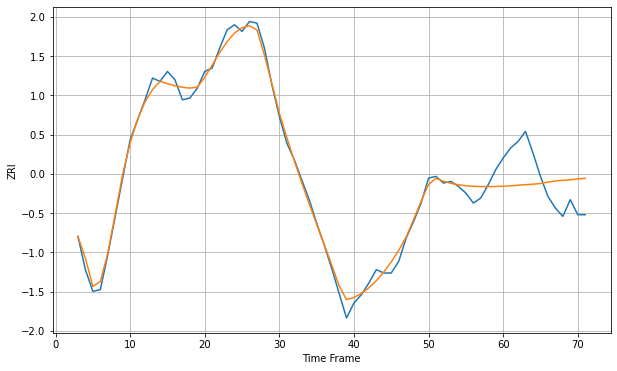

Wall time: 9.07 s
26003 4.30521185896122 19.935142039656398 [815.11431625 815.33737637 815.7017959  815.99406512 816.33352533
 816.67979662 817.55078301 818.22353057 818.65996699 818.92609222
 819.48612192 819.85778756]

Got an mse at 0.0099 in round 349 and stopped training



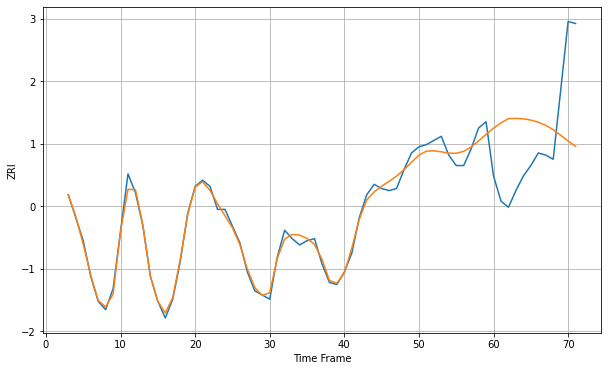

Wall time: 15 s
26505 3.068111586859816 34.12111087157672 [960.89347826 963.4248995  965.48319239 965.6053542  965.37988759
 964.7784454  963.7556539  962.24648027 960.21459433 957.53194089
 954.75777436 952.18111902]

Got an mse at 0.0099 in round 50 and stopped training



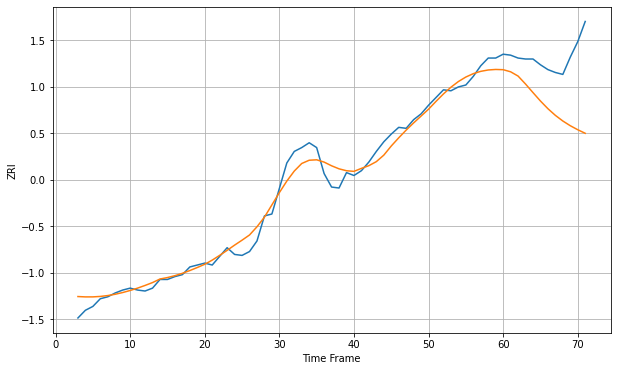

Wall time: 6.73 s
27513 9.918968468912672 55.630185284767705 [1184.9044809  1182.7253508  1178.28904347 1170.00794325 1161.11270409
 1152.37010549 1144.38926651 1137.45825687 1131.60236978 1126.69638371
 1122.53153974 1118.83590242]

Got an mse at 0.0100 in round 127 and stopped training



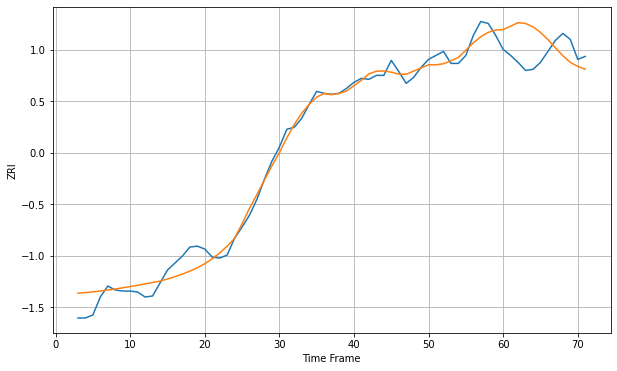

Wall time: 9.33 s
27560 9.934799182385548 27.697450945005826 [1327.87550176 1331.27450238 1334.83524626 1333.97342498 1330.64624043
 1325.10833006 1317.84538114 1309.67041422 1301.68422267 1294.98476789
 1291.10229464 1288.1205009 ]

Got an mse at 0.0097 in round 38 and stopped training



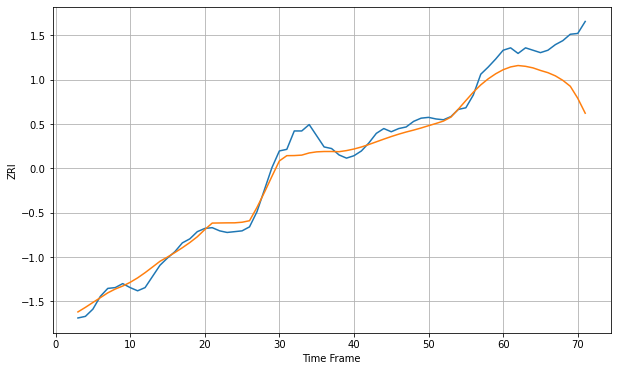

Wall time: 7.32 s
27606 11.551340146066897 51.380163339036216 [1172.62114    1176.11081575 1177.86149038 1176.87117226 1174.92578032
 1171.71954003 1168.93843446 1164.94214808 1159.32446498 1151.91945336
 1136.89188198 1118.232432  ]

Got an mse at 0.0099 in round 40 and stopped training



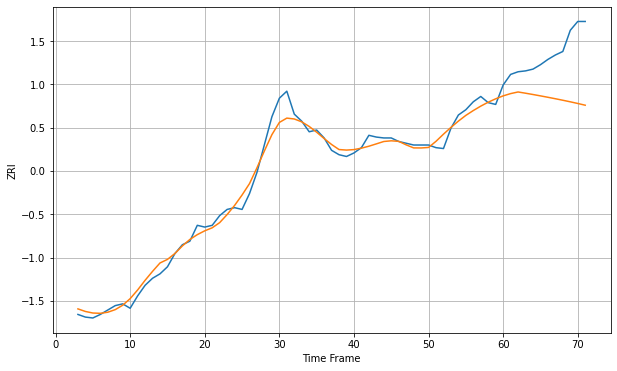

Wall time: 6.91 s
27609 8.97511293029392 54.335779906571666 [1121.67531087 1124.25355012 1126.10451279 1124.7040416  1123.22323897
 1121.68100401 1120.08559873 1118.43703131 1116.72844671 1114.94701939
 1113.07567632 1111.09741051]

Got an mse at 0.0100 in round 45 and stopped training



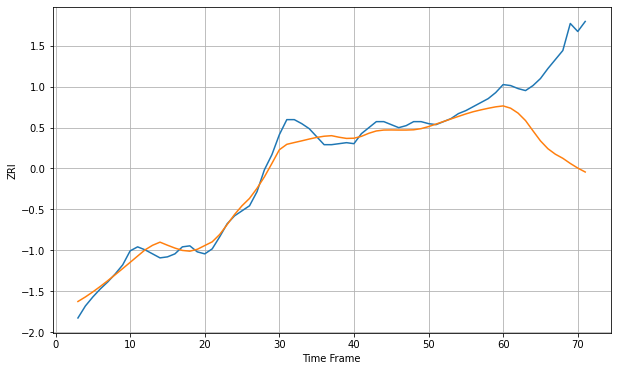

Wall time: 7.41 s
27612 8.648473456653214 89.4340536713226 [1078.69027001 1076.41967551 1071.4989305  1064.06320005 1053.81068161
 1043.81350411 1035.961194   1030.48216416 1026.40020163 1021.26866997
 1016.66667091 1012.72523472]

Got an mse at 0.0098 in round 36 and stopped training



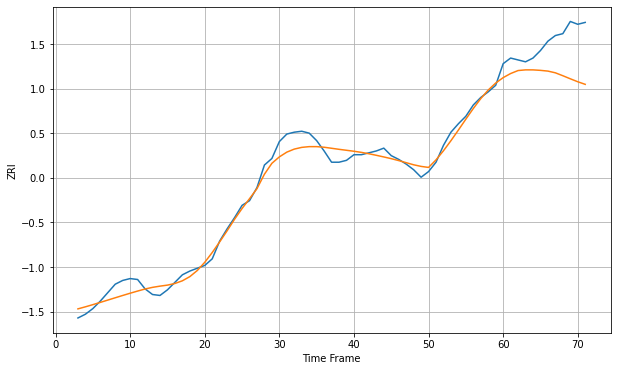

Wall time: 6.42 s
27613 8.524351984177791 38.454845600497585 [1133.1332371  1137.50035951 1140.69216327 1141.41065002 1141.39790594
 1140.89315056 1140.10042178 1138.27429638 1135.17173183 1131.90662171
 1128.75232383 1125.99151493]

Got an mse at 0.0099 in round 47 and stopped training



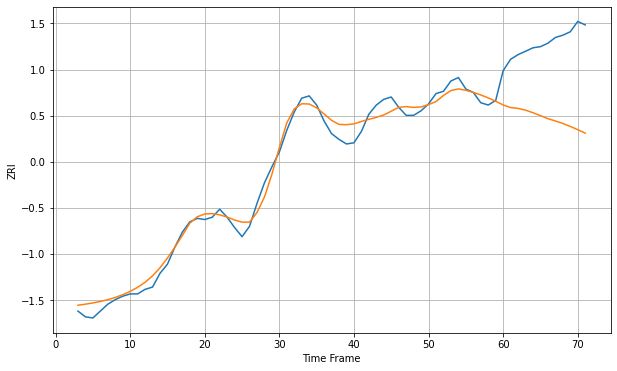

Wall time: 8.26 s
27615 7.508970191309281 67.50645542665396 [1100.08172006 1097.7908986  1097.09558127 1095.53381273 1093.26354426
 1090.75841522 1088.06037855 1086.10924118 1083.91928472 1081.30634639
 1078.47389183 1075.46999862]

Got an mse at 0.0099 in round 95 and stopped training



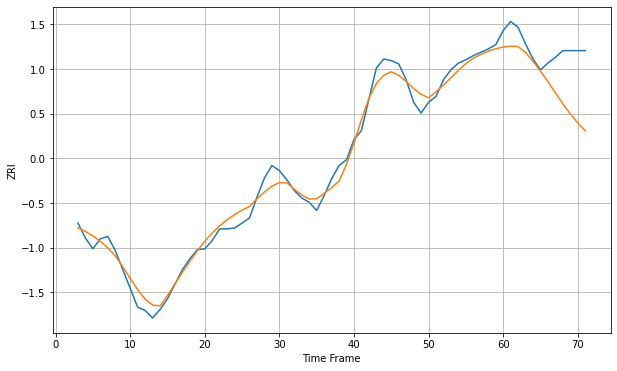

Wall time: 8.21 s
27703 11.003306545040923 50.72689074853123 [1100.33569267 1101.36321246 1100.85434717 1093.82680875 1083.23922775
 1071.37525589 1058.75643922 1045.3804103  1032.15307598 1020.01458835
 1009.19162922  999.73475544]

Got an mse at 0.0100 in round 116 and stopped training



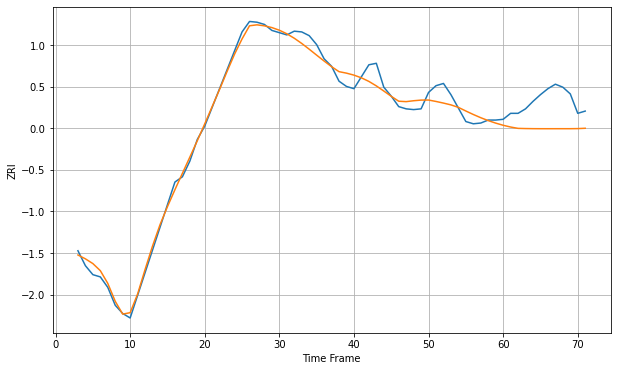

Wall time: 9.34 s
27705 10.539028691691481 38.23681419118945 [1205.0119139  1202.66253282 1200.86130268 1200.60960894 1200.46917249
 1200.40849314 1200.39778137 1200.41053201 1200.42477334 1200.42387465
 1200.5555008  1200.99028014]

Got an mse at 0.0098 in round 48 and stopped training



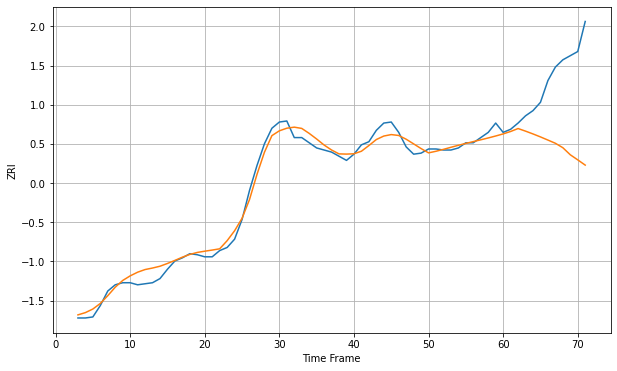

Wall time: 7.91 s
27707 6.885780452914906 68.9234790468039 [1038.53753421 1040.88109612 1043.71981142 1041.21388459 1038.51391955
 1035.64405606 1032.60011598 1029.5130246  1025.24037393 1018.40391001
 1013.50490382 1008.44727863]

Got an mse at 0.0097 in round 34 and stopped training



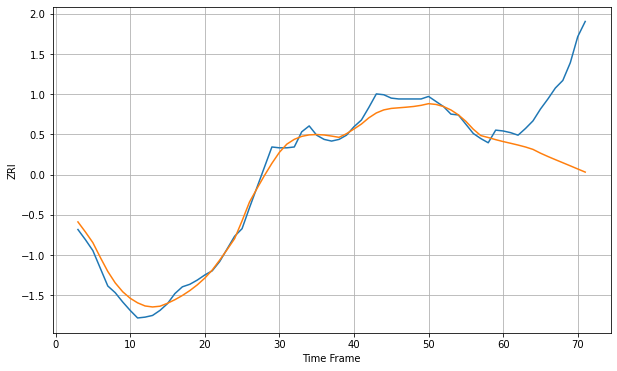

Wall time: 6.86 s
27713 9.268515369922566 90.33188270459763 [1047.43527561 1045.38431899 1043.28200821 1040.96008774 1038.1240717
 1033.66706928 1029.68966969 1025.9545649  1022.29018027 1018.60515462
 1014.8832528  1011.17223115]

Got an mse at 0.0100 in round 54 and stopped training



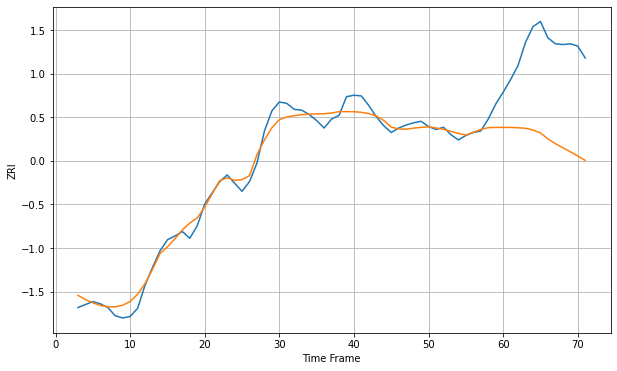

Wall time: 8.77 s
28202 11.716876532378636 124.31227136331479 [1486.842655   1486.73007144 1486.34061261 1485.61492025 1483.28263
 1479.50090605 1471.3657727  1464.97167219 1459.60765726 1454.13060259
 1448.36114169 1442.57401379]

Got an mse at 0.0098 in round 65 and stopped training



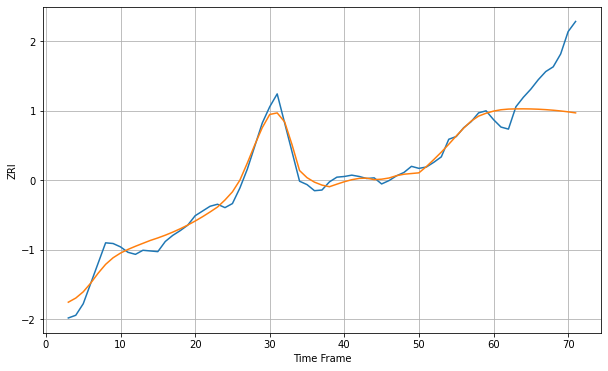

Wall time: 7.42 s
28210 11.445109699682625 65.43889671881358 [1281.58578746 1283.58540344 1284.55283889 1284.84839178 1284.91824846
 1284.7584811  1284.36731179 1283.74434584 1282.89020031 1281.80664031
 1280.49711528 1278.96745607]

Got an mse at 0.0100 in round 85 and stopped training



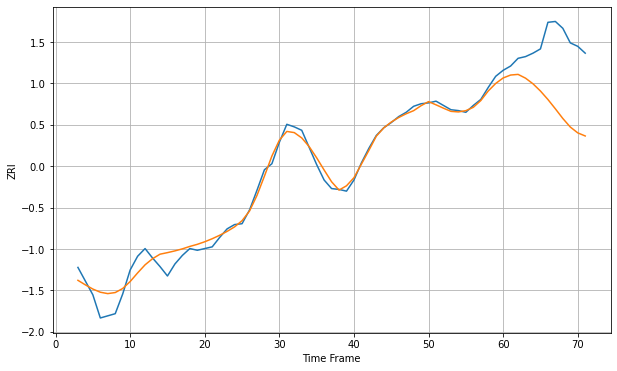

Wall time: 8.8 s
28216 10.070596853553656 72.81379418818055 [1269.07659634 1272.48442827 1273.23904285 1268.83840908 1262.25757511
 1253.81077569 1243.95567477 1233.05561231 1221.76907167 1211.82677508
 1204.99480461 1201.37919137]

Got an mse at 0.0095 in round 41 and stopped training



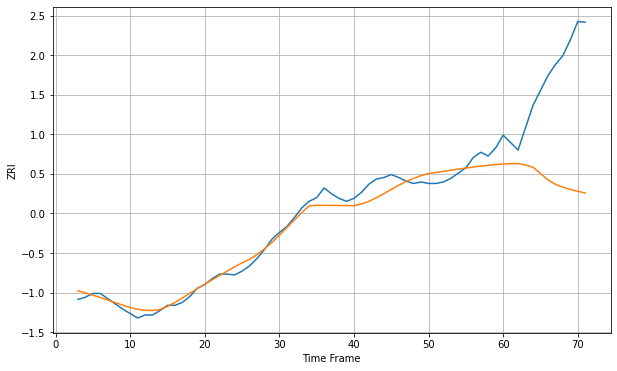

Wall time: 7.04 s
28262 10.801839194284383 143.4241195225145 [1044.16551613 1044.66346423 1044.73788533 1042.8590388  1039.92017373
 1031.4473812  1022.83455035 1016.90030246 1013.0050658  1010.05349449
 1007.50682617 1005.16202643]

Got an mse at 0.0100 in round 47 and stopped training



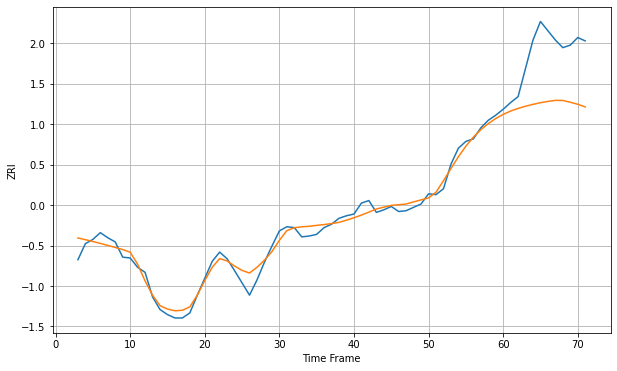

Wall time: 7.99 s
28269 8.757848076805672 64.75512582699982 [1150.02221796 1153.92871355 1157.05160051 1159.63311267 1161.87984313
 1163.7885015  1165.36429534 1166.61440216 1166.46085599 1164.3866483
 1161.97148193 1158.87206769]

Got an mse at 0.0097 in round 57 and stopped training



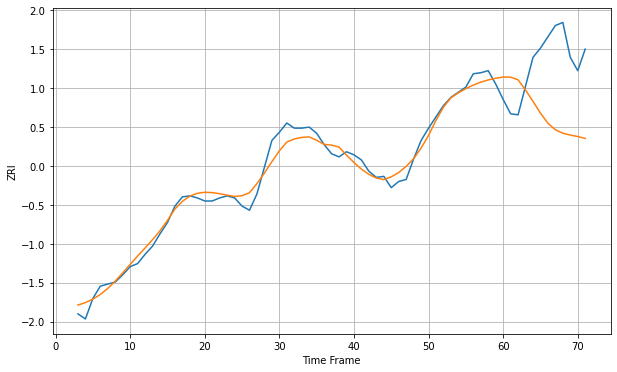

Wall time: 7.34 s
28273 8.211847096452868 67.86092980077483 [1215.78078113 1215.68460122 1213.11766933 1203.14348928 1192.12028619
 1180.61833422 1170.80706121 1164.46030363 1161.03847855 1159.25167534
 1157.82227912 1156.00779724]

Got an mse at 0.0098 in round 35 and stopped training



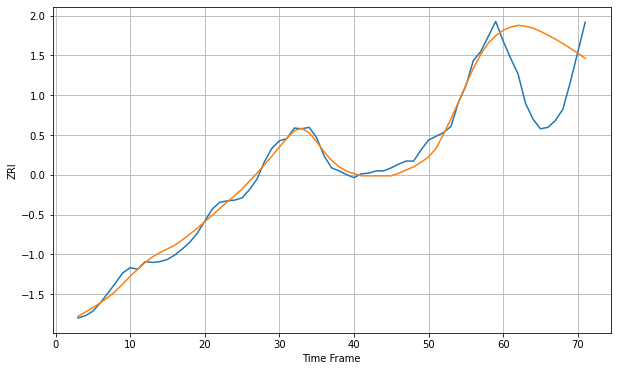

Wall time: 6.98 s
28277 9.08639032693335 85.2063961253496 [1424.21657226 1428.58037811 1430.87922748 1429.55459772 1427.22101488
 1422.83711621 1417.90020432 1412.46628681 1406.59373331 1400.34011638
 1393.76171144 1386.91432202]

Got an mse at 0.0098 in round 243 and stopped training



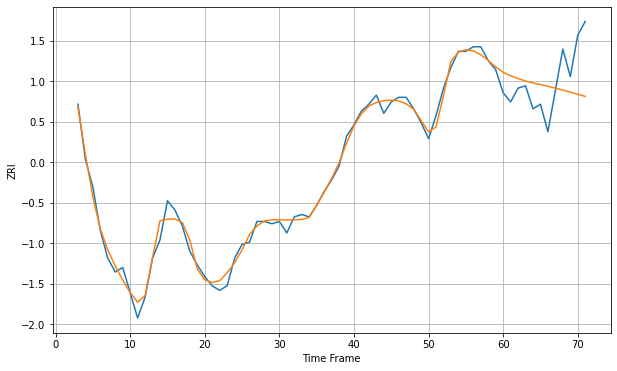

Wall time: 12 s
29205 3.125215822542773 15.562948827635708 [828.86185466 827.37812606 826.14826717 825.0690189  824.26492335
 823.54551123 822.78525434 821.9830141  821.14013892 820.25994999
 819.34740688 818.40895795]

Got an mse at 0.0100 in round 40 and stopped training



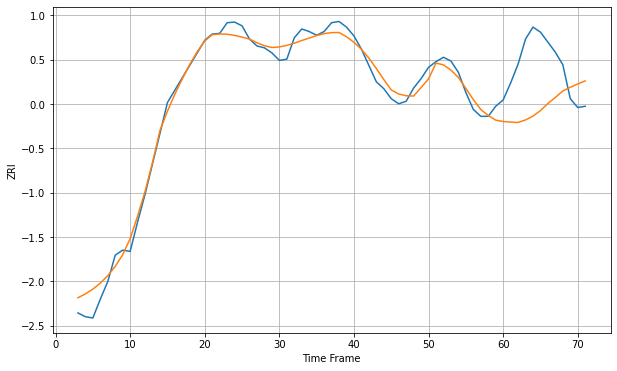

Wall time: 7.9 s
29403 14.9909923215423 84.48704615197188 [1788.77081852 1787.73803872 1787.26626836 1791.24084355 1797.33259279
 1806.18346496 1817.49137489 1827.08206839 1837.41332916 1843.19548251
 1848.57248061 1853.35984326]

Got an mse at 0.0100 in round 76 and stopped training



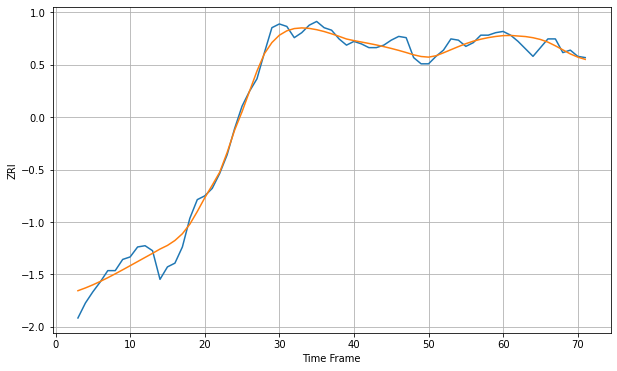

Wall time: 7.69 s
29414 7.838225024019331 6.111771839166155 [1328.63080196 1328.78998712 1328.32445615 1327.88460142 1326.95544665
 1325.54055151 1323.4112656  1320.45482566 1317.22656497 1313.96926426
 1311.39346268 1309.57253651]

Got an mse at 0.0099 in round 96 and stopped training



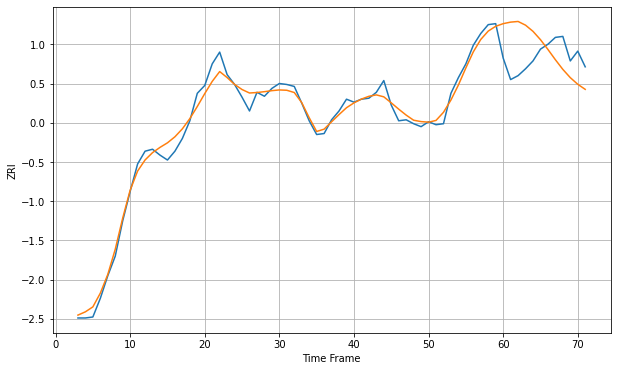

Wall time: 8.11 s
29464 7.96855726113621 34.54313644363033 [1573.98451013 1575.55676989 1576.22883944 1572.45878033 1566.15895085
 1557.69334298 1547.72965662 1537.23713446 1527.38433582 1518.96366482
 1512.21132841 1507.0272227 ]

Got an mse at 0.0098 in round 46 and stopped training



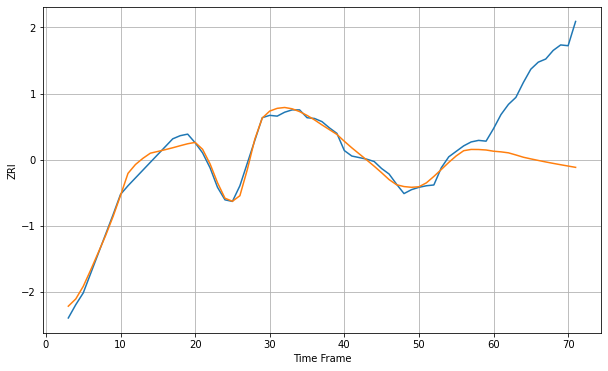

Wall time: 7.28 s
29607 7.705760613072458 119.18503499155324 [985.16395745 984.32276433 983.08535141 980.3582846  977.45648936
 975.34463621 973.36208109 971.42742988 969.60001169 967.87153338
 966.19547039 964.52332935]

Got an mse at 0.0100 in round 117 and stopped training



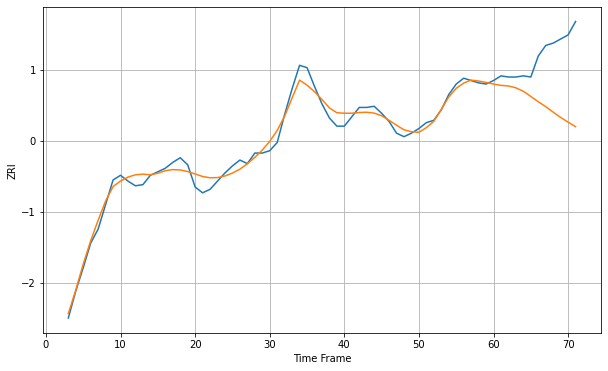

Wall time: 8.61 s
29615 6.329455465585378 47.061665471189 [1000.96755079  999.88602258  999.3324391   997.75683875  994.8236561
  990.371614    985.86678285  981.65789104  976.95435851  972.44687933
  968.37902512  964.57602429]

Got an mse at 0.0096 in round 35 and stopped training



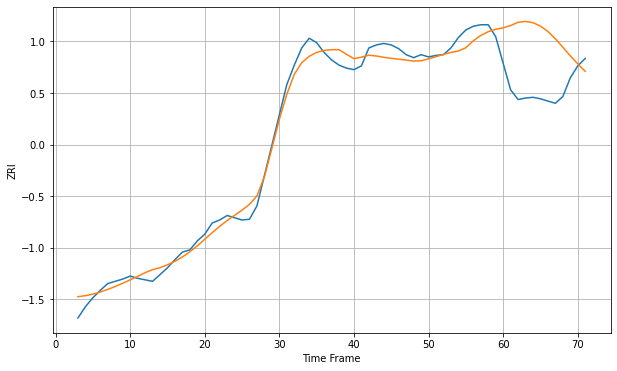

Wall time: 7.31 s
30024 12.358373437724357 77.35371047459432 [1491.84683061 1494.9071376  1499.35083823 1500.38349155 1498.73057632
 1494.22448637 1486.99442622 1477.27975788 1465.96238886 1454.47976973
 1443.72787488 1433.70430326]


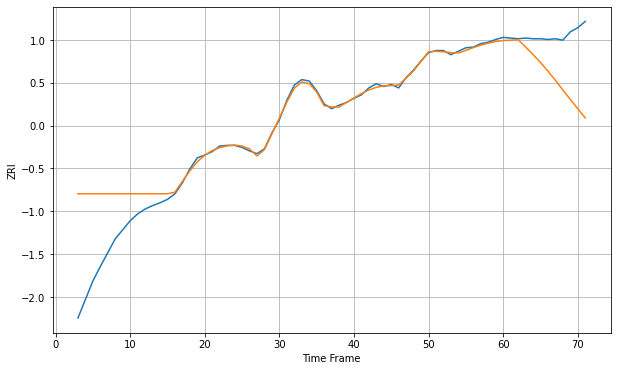

Wall time: 17.4 s
30043 41.961752421432095 67.90653144274992 [1296.39328893 1296.9628186  1297.55585993 1287.30302493 1276.21814876
 1264.78838704 1252.32764069 1239.01261746 1225.07187547 1211.48559947
 1197.99429946 1184.73451923]

Got an mse at 0.0098 in round 39 and stopped training



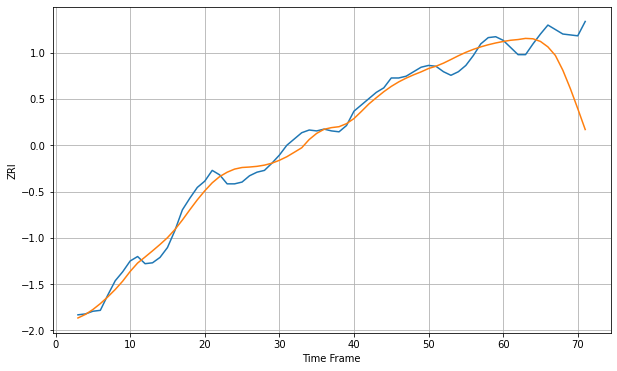

Wall time: 7.28 s
30044 9.407088467200284 48.724091470430196 [1142.68318388 1144.04426174 1144.84454454 1146.12956324 1145.69054659
 1142.75099365 1136.65913384 1127.11367232 1110.65558873 1090.31476417
 1067.84121063 1044.56118951]

Got an mse at 0.0100 in round 102 and stopped training



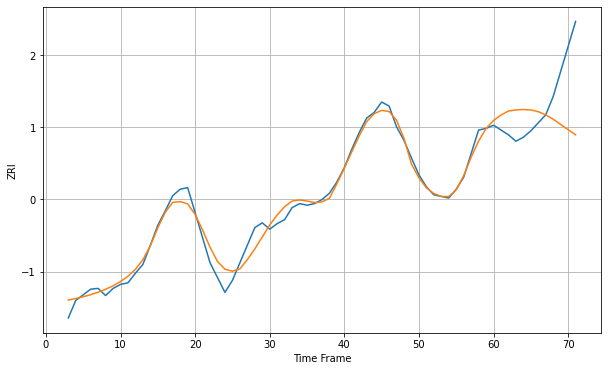

Wall time: 8.47 s
30046 10.211142630456482 58.448296472089034 [1060.94064336 1067.72086404 1072.81337807 1074.11154894 1074.64952572
 1074.15857859 1071.9544403  1067.97928359 1062.47048502 1055.9981874
 1049.40948591 1043.07265941]

Got an mse at 0.0099 in round 50 and stopped training



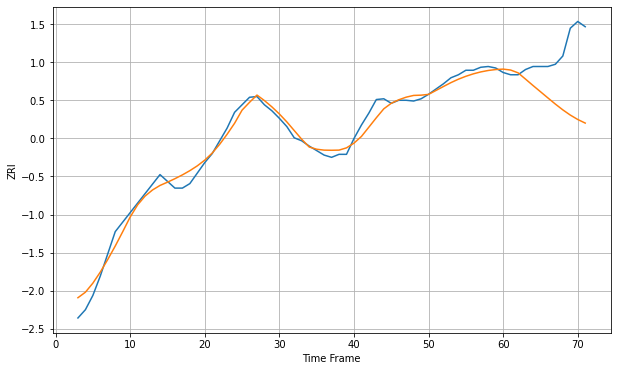

Wall time: 7.07 s
30080 10.22089650172105 69.90122788469206 [1255.52269846 1254.30536596 1250.56494374 1242.20225445 1233.70748645
 1225.43549458 1217.13745239 1208.93736555 1201.21185333 1194.30496551
 1188.4204466  1183.62825801]

Got an mse at 0.0096 in round 20 and stopped training



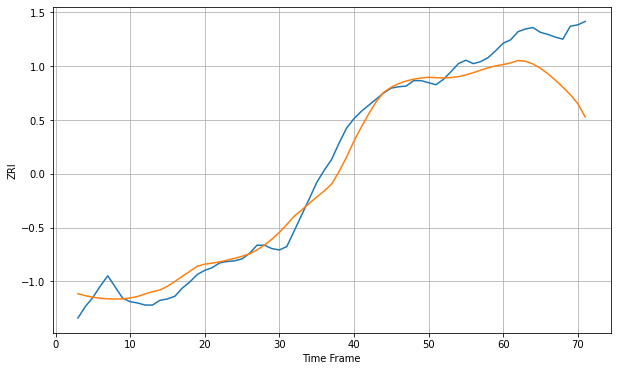

Wall time: 6.65 s
30093 18.140822897723144 74.94616097998964 [1133.66075257 1136.02677584 1139.64003704 1138.48912029 1134.50675229
 1128.15773012 1120.05139025 1110.70611847 1100.45583457 1089.4978681
 1076.24669932 1056.56791056]

Got an mse at 0.0100 in round 34 and stopped training



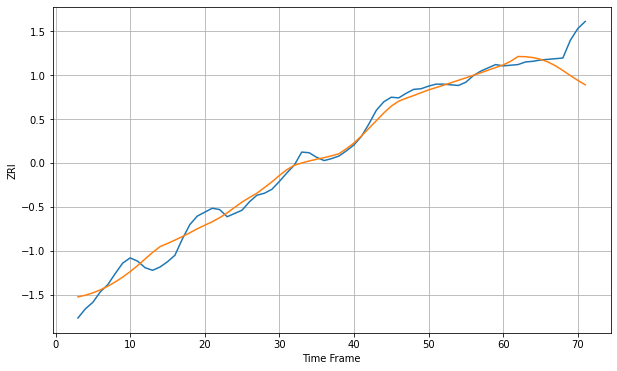

Wall time: 7.33 s
30096 13.201769394849544 40.139429631631934 [1278.4446089  1284.01039926 1291.35012808 1291.04833369 1289.6929142
 1287.12011883 1283.02654831 1277.20873561 1269.98677819 1262.25926189
 1254.85826921 1248.04802287]

Got an mse at 0.0096 in round 32 and stopped training



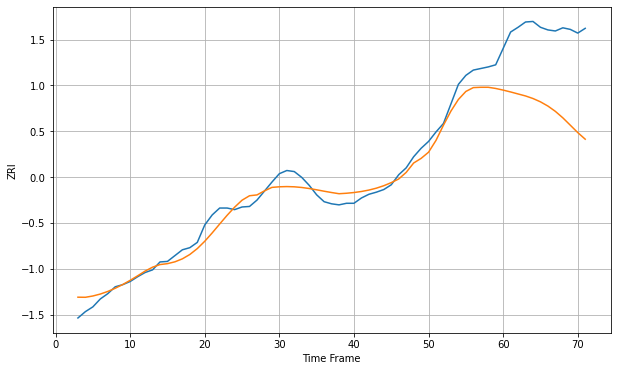

Wall time: 7.06 s
30097 19.646400015852002 152.99242984582563 [1429.14830176 1425.63601946 1421.83205632 1418.07880516 1413.21841819
 1406.94633869 1398.94301573 1388.8920335  1376.6766697  1362.76280377
 1348.77668475 1336.25658006]

Got an mse at 0.0099 in round 92 and stopped training



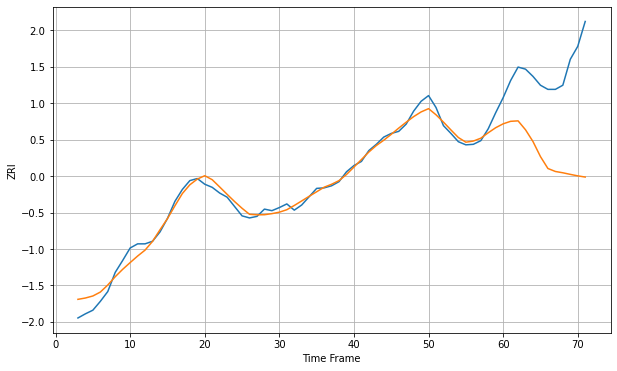

Wall time: 8.48 s
30305 13.086689723118779 169.95798426581067 [1679.52858412 1684.37558809 1685.24773981 1667.99354735 1645.34037135
 1616.33642578 1593.35732608 1587.61763366 1585.1011092  1582.02158175
 1579.16611293 1576.83370085]

Got an mse at 0.0098 in round 74 and stopped training



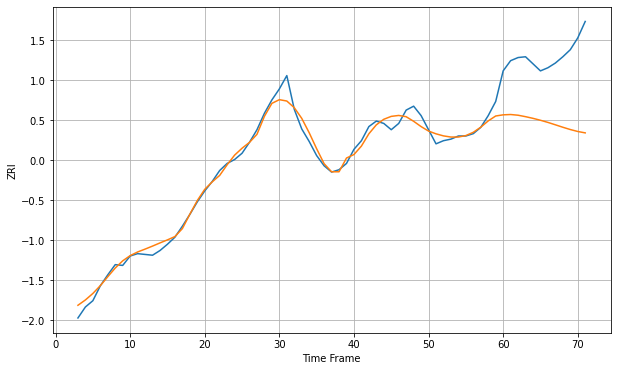

Wall time: 8.38 s
30306 8.9297211833785 87.44688512413379 [1435.96716989 1436.37654633 1435.47931886 1433.62145789 1431.50150245
 1429.04700685 1426.3166705  1423.25562286 1420.14979215 1417.23160392
 1414.75212503 1412.95712585]

Got an mse at 0.0094 in round 41 and stopped training



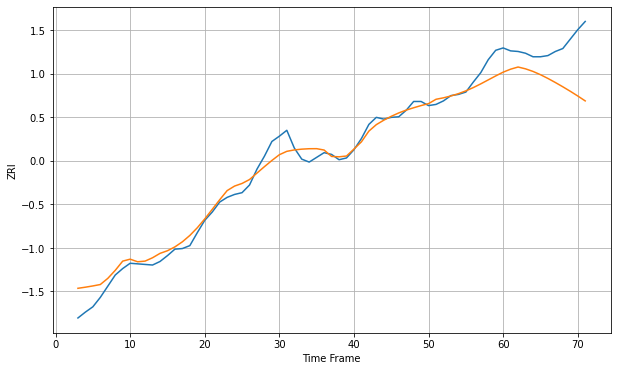

Wall time: 6.93 s
30308 17.344166852960154 66.4148464056387 [1609.81616409 1614.88686305 1618.57015265 1615.47413613 1611.08397247
 1605.53784192 1599.14692011 1592.22504615 1584.94431737 1577.3300187
 1569.34274095 1560.962548  ]

Got an mse at 0.0099 in round 36 and stopped training



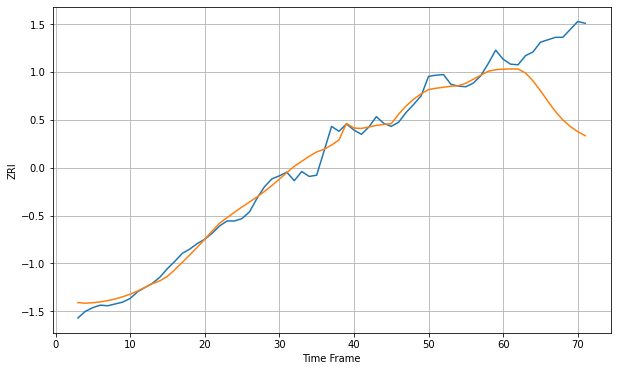

Wall time: 7.44 s
30309 13.811166728366318 109.89325213887838 [1639.78522013 1640.17264585 1640.08531134 1633.52679127 1620.53458651
 1604.56215192 1587.10045076 1570.51530329 1556.66916217 1545.81688548
 1537.3784625  1530.73070763]

Got an mse at 0.0100 in round 64 and stopped training



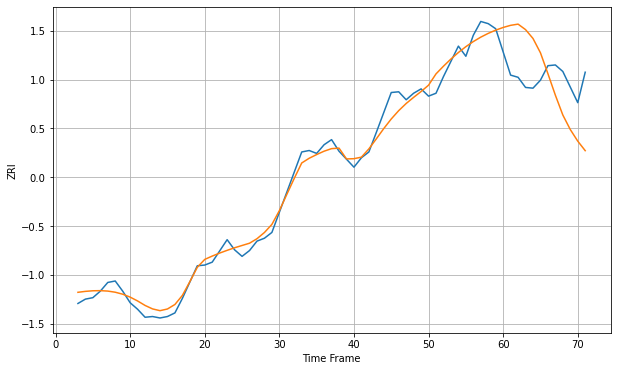

Wall time: 7.67 s
30310 12.062149761993648 62.677243542100214 [1195.73020479 1198.65772548 1200.32565781 1192.76068916 1180.54034788
 1160.77183637 1131.97916087 1102.2791266  1074.95111854 1054.91188458
 1038.9252348  1025.79064057]

Got an mse at 0.0095 in round 51 and stopped training



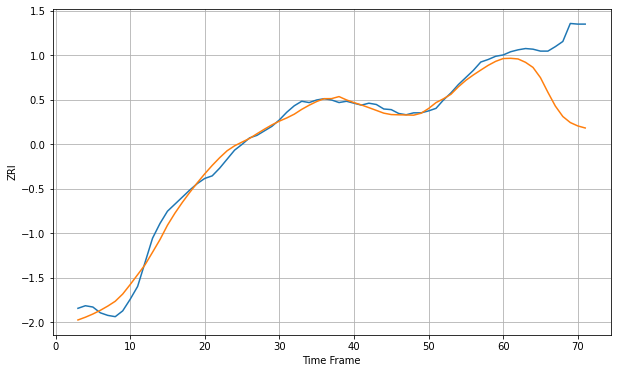

Wall time: 7.55 s
30318 11.137425264901449 93.3191333380502 [1439.40978749 1439.81219072 1438.80800024 1433.56876748 1425.66166389
 1409.7344652  1386.91718392 1365.48283495 1349.30651574 1339.90490099
 1334.66509851 1331.44125957]

Got an mse at 0.0099 in round 52 and stopped training



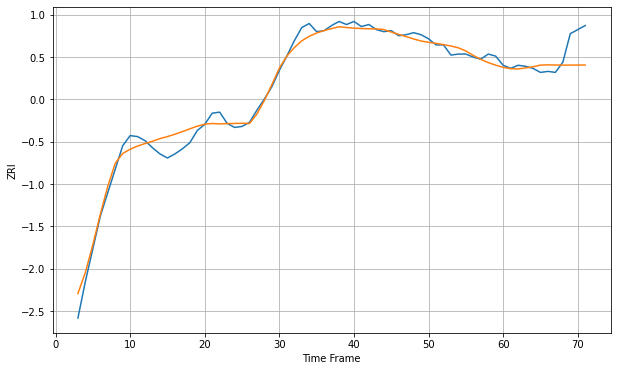

Wall time: 7.68 s
30319 8.161814931742128 17.8745026067328 [1565.92241198 1564.69777137 1564.39406106 1565.39844552 1566.50321702
 1568.16442768 1568.42024993 1568.25142888 1568.15808613 1568.16926671
 1568.24126396 1568.27240263]

Got an mse at 0.0100 in round 26 and stopped training



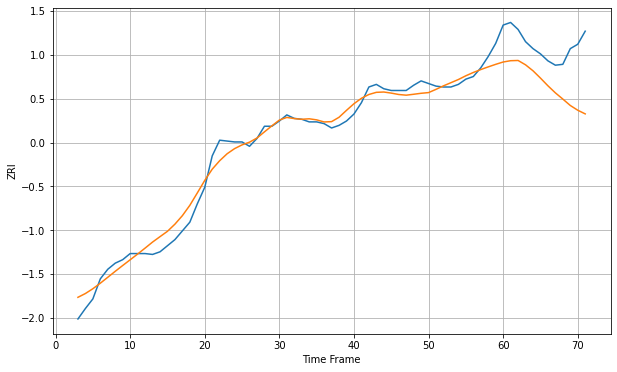

Wall time: 7.62 s
30324 10.648724631644736 49.567233748228524 [1487.65705376 1489.14541718 1489.42201502 1484.44379232 1477.5952741
 1469.21653417 1460.39081861 1452.273435   1445.15557707 1437.80666685
 1432.35849922 1428.16336889]

Got an mse at 0.0098 in round 45 and stopped training



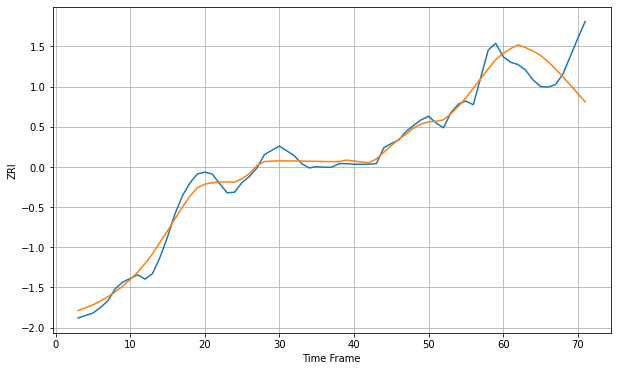

Wall time: 7.57 s
30326 13.66261795789054 56.41618250535185 [1662.41389925 1670.3335152  1676.59240847 1671.92889891 1666.20206969
 1659.26697921 1649.15402685 1637.02896338 1624.05413761 1610.46190149
 1596.54891747 1582.64077447]

Got an mse at 0.0098 in round 58 and stopped training



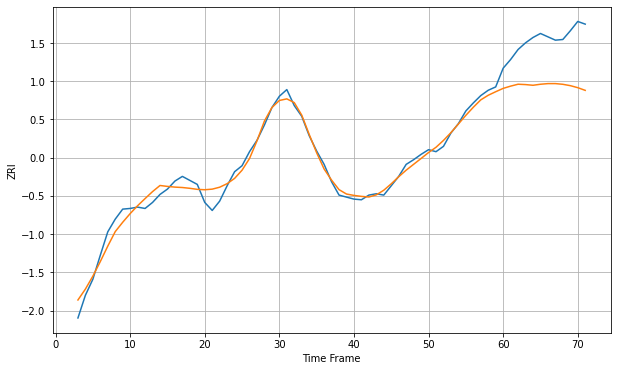

Wall time: 7.72 s
30328 10.758677961722691 70.74102904155367 [1507.7814928  1511.16574748 1514.01523014 1513.48524349 1512.44807293
 1513.98582508 1514.94397237 1514.95949764 1513.9073104  1511.8853279
 1508.86620074 1504.83662061]

Got an mse at 0.0098 in round 50 and stopped training



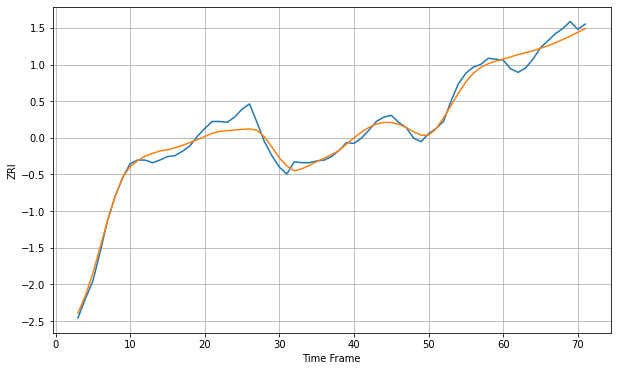

Wall time: 7.42 s
30329 8.289314669100088 11.542171409639872 [1484.20028877 1486.5729871  1489.23975743 1491.3422545  1493.64465427
 1496.32976188 1499.32158546 1502.67376845 1506.39721933 1510.43774398
 1514.66579244 1518.90166343]

Got an mse at 0.0100 in round 46 and stopped training



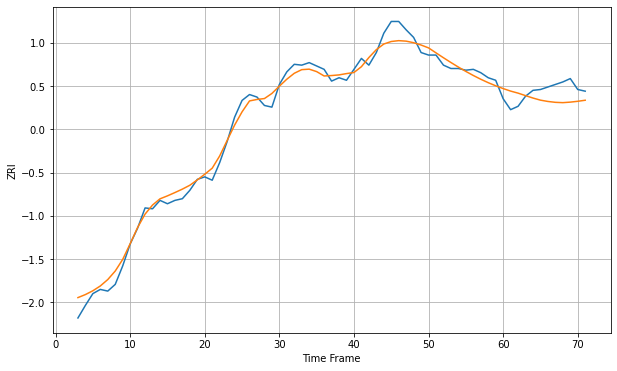

Wall time: 7.63 s
30338 9.66955591902254 17.278644217273122 [1439.11199893 1436.11336201 1433.67793103 1430.70920516 1427.84133538
 1425.32040476 1423.76828799 1422.72786518 1422.35072402 1422.96879719
 1423.96391601 1425.22126732]

Got an mse at 0.0100 in round 90 and stopped training



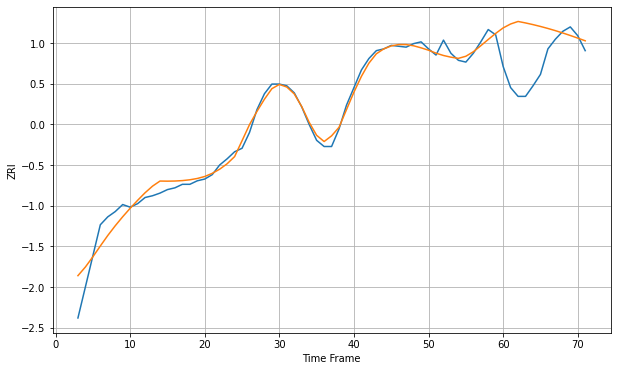

Wall time: 7.74 s
30339 10.393610113367373 50.06296236101791 [1420.86673705 1425.32540239 1428.19379792 1426.5180288  1424.62135018
 1422.52555    1420.23668002 1417.75477066 1415.08600071 1412.25023058
 1409.27993701 1406.21234236]

Got an mse at 0.0100 in round 50 and stopped training



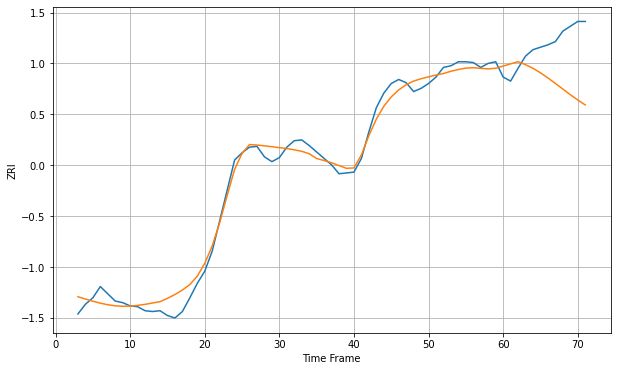

Wall time: 8.14 s
30341 11.319462826412357 57.24983364882565 [1372.62189911 1375.41631897 1378.09731322 1374.36265807 1369.88302664
 1364.29199973 1357.91145164 1351.14685394 1344.13696461 1337.11880246
 1330.54949195 1324.43812148]

Got an mse at 0.0099 in round 64 and stopped training



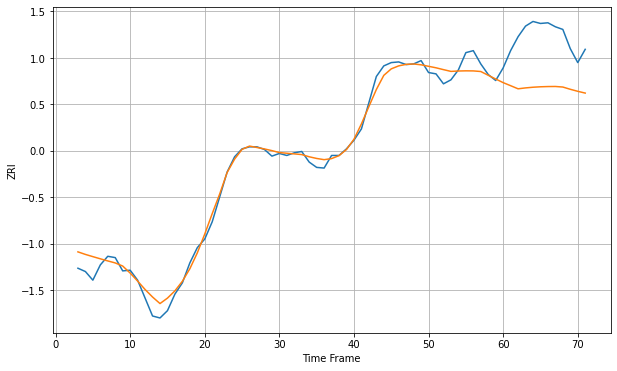

Wall time: 7.86 s
30345 12.588951198933023 77.42395860524859 [1467.79726613 1463.18764433 1458.48266114 1459.83684412 1460.85617616
 1461.52258139 1461.87728206 1461.98844982 1461.14656406 1457.75675997
 1454.71717092 1452.02703918]

Got an mse at 0.0096 in round 26 and stopped training



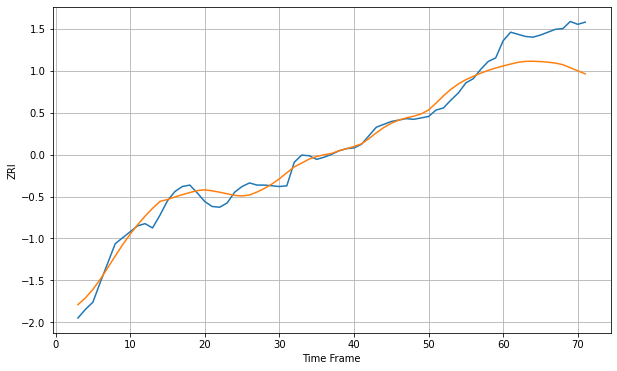

Wall time: 7.09 s
30350 11.05272578937271 48.892846919361276 [1316.74150217 1319.35253858 1321.86520128 1323.14407116 1323.2978416
 1322.85849303 1322.0295152  1320.79011291 1318.50891959 1314.30110398
 1309.97507342 1305.65402186]

Got an mse at 0.0099 in round 26 and stopped training



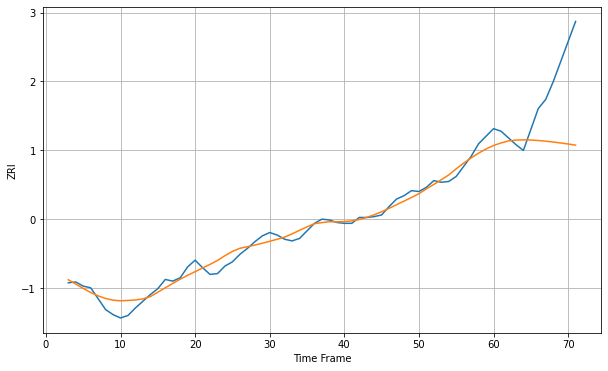

Wall time: 6.3 s
30605 8.125936041148083 68.47504014295318 [881.9230296  884.91453093 887.36924456 888.34395057 888.63083935
 888.43392316 887.8757043  887.06046884 886.06388519 884.9333225
 883.6923007  882.34510773]

Got an mse at 0.0100 in round 127 and stopped training



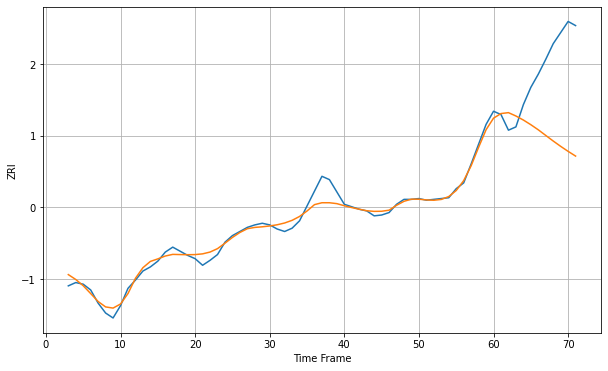

Wall time: 9.27 s
30606 8.160854842447899 90.92579843535107 [962.58934231 968.19117561 969.30097658 965.22544442 960.32919951
 954.66016481 948.45856359 941.63936412 934.85184606 928.37640211
 922.28524465 916.56541714]

Got an mse at 0.0099 in round 56 and stopped training



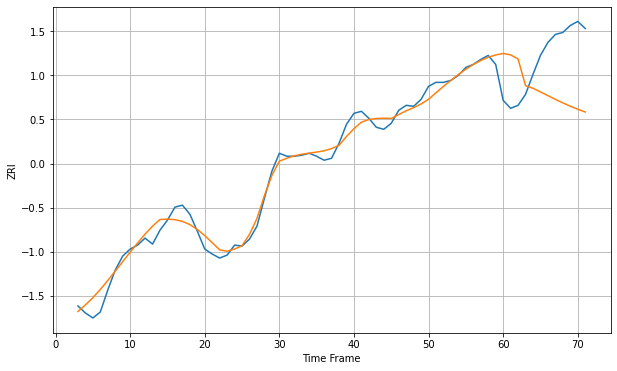

Wall time: 7.81 s
31401 8.50667693992259 59.26293546446455 [1396.91586721 1395.55204572 1391.38270014 1364.66892497 1362.07765745
 1358.46355123 1354.68861138 1350.96542254 1347.42520239 1344.12954235
 1341.09713566 1338.32425536]

Got an mse at 0.0099 in round 314 and stopped training



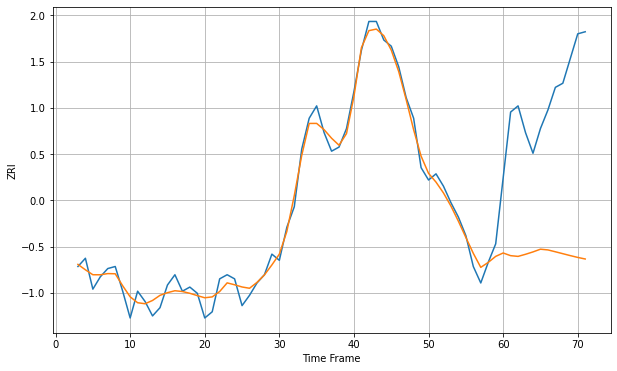

Wall time: 13.3 s
32204 4.646735752843388 77.31441393848733 [988.56198196 987.2621751  986.9110626  987.92815214 989.08215934
 990.40338835 990.05193286 989.14989383 988.21857704 987.28645817
 986.40949709 985.64036589]

Got an mse at 0.0099 in round 57 and stopped training



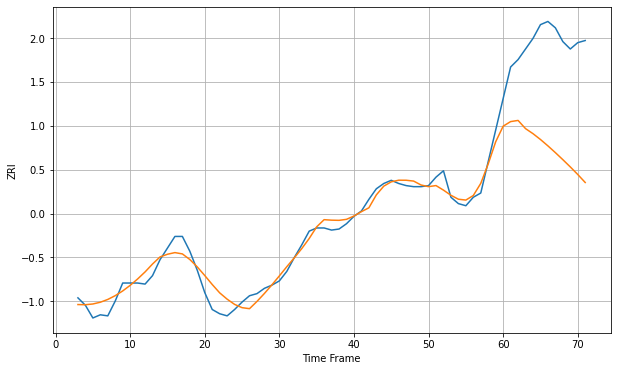

Wall time: 8.1 s
32205 8.854797110025464 99.22473052060616 [959.10930322 963.44350954 964.54801194 956.80641787 952.04971851
 946.55025292 940.5140392  934.13781097 927.50342814 920.65124262
 913.49881316 905.93685034]

Got an mse at 0.0100 in round 50 and stopped training



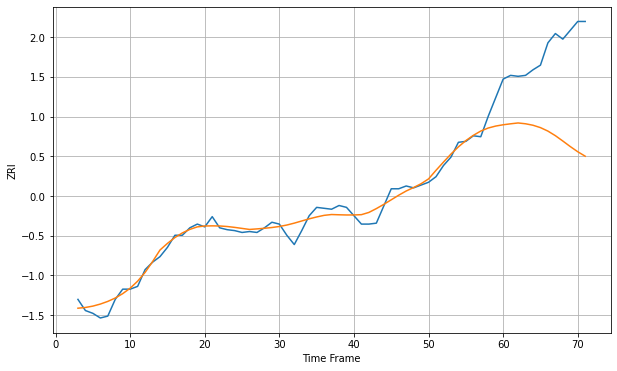

Wall time: 7.61 s
32207 8.482291555485142 94.80381685492387 [972.85527848 973.89664365 974.81012355 973.93218925 972.34900339
 969.79126248 966.05815472 961.13372426 955.3633934  949.39723624
 943.83589401 939.02949151]


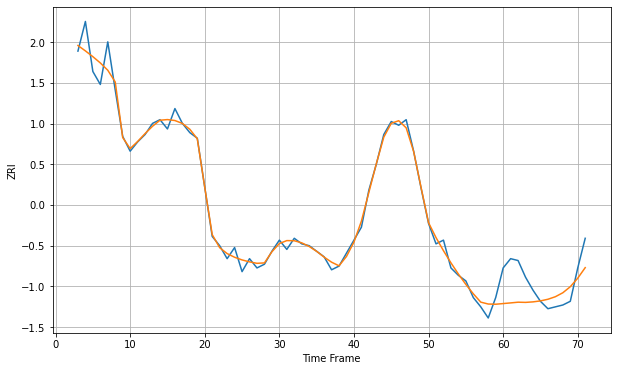

Wall time: 18.8 s
32209 4.398150020206009 13.268096074771297 [799.77310852 800.12889064 800.51474688 800.41278896 800.68447473
 801.21734425 802.09532481 803.47130576 805.60761662 808.86792149
 813.4746033  819.16077851]

Got an mse at 0.0100 in round 36 and stopped training



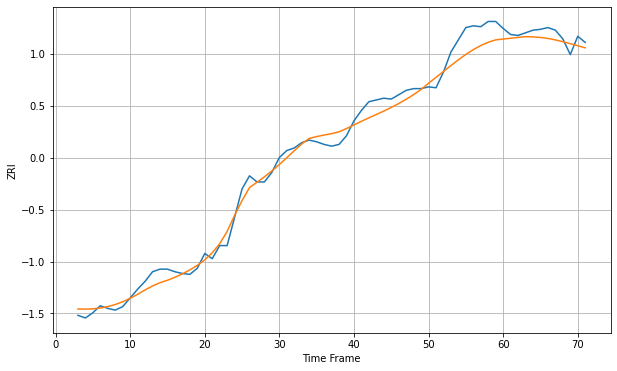

Wall time: 6.75 s
32224 11.960565630700572 8.842793333149078 [1314.85225312 1315.73127559 1316.73195119 1317.57575919 1317.29890819
 1316.70953481 1315.54693521 1313.87407173 1311.82669063 1309.54519693
 1307.16859632 1304.78901074]

Got an mse at 0.0092 in round 29 and stopped training



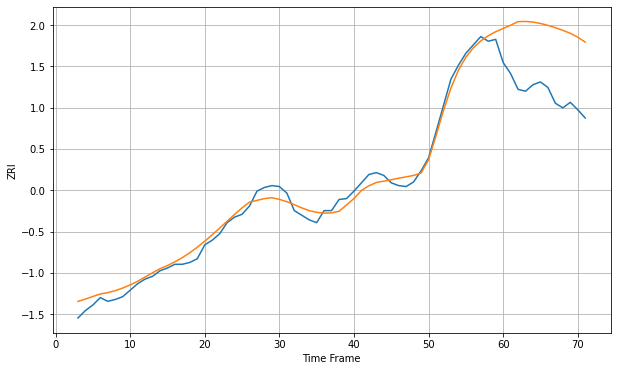

Wall time: 7.18 s
32225 7.996604435802369 70.89067529924633 [1188.78185776 1192.26887891 1196.19627164 1196.33804072 1195.68641244
 1194.17901239 1192.12311003 1189.61636131 1186.745411   1183.55050229
 1179.37623434 1174.05920469]

Got an mse at 0.0097 in round 25 and stopped training



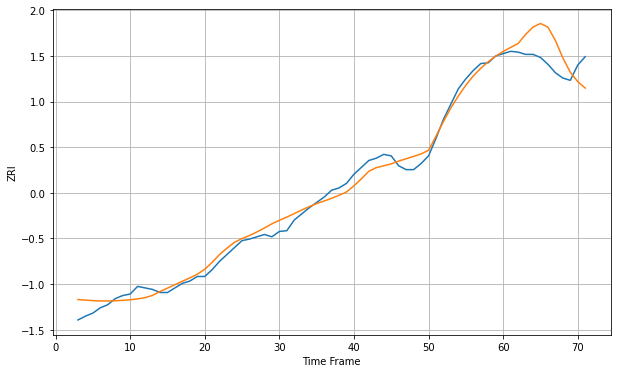

Wall time: 6.9 s
32246 10.427479619127187 30.59732662579268 [1336.83822598 1342.08832572 1347.19213187 1359.04681959 1368.78877995
 1373.5217355  1368.72637897 1351.26869221 1328.40923337 1309.62107578
 1297.31884727 1288.86050248]

Got an mse at 0.0097 in round 46 and stopped training



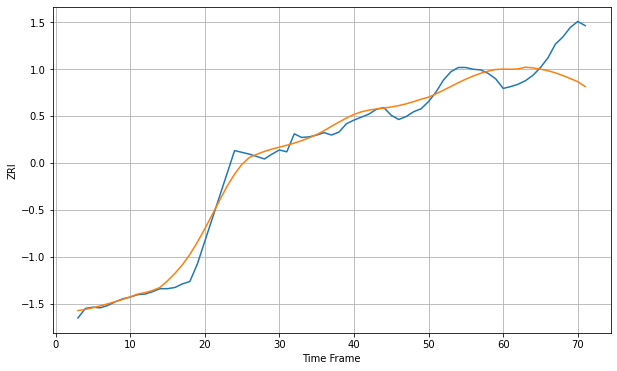

Wall time: 7.15 s
32250 15.605199612006873 56.260137570338586 [1402.26927069 1401.99720783 1402.54756811 1405.53619896 1404.2893863
 1402.27293246 1399.57329233 1396.03922205 1391.51039141 1386.4992656
 1381.19508397 1373.06368493]

Got an mse at 0.0096 in round 58 and stopped training



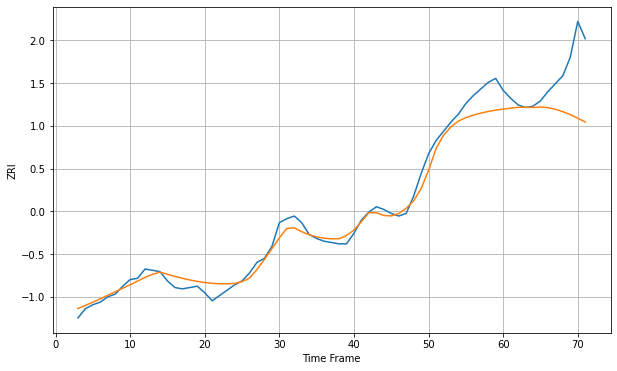

Wall time: 7.75 s
32256 7.596902072870364 32.56642150942201 [1207.81390759 1208.51291932 1209.14986847 1209.1934202  1209.03950953
 1209.3803876  1208.90672532 1207.68067774 1205.8577137  1203.58762441
 1200.96018087 1198.00635253]

Got an mse at 0.0098 in round 28 and stopped training



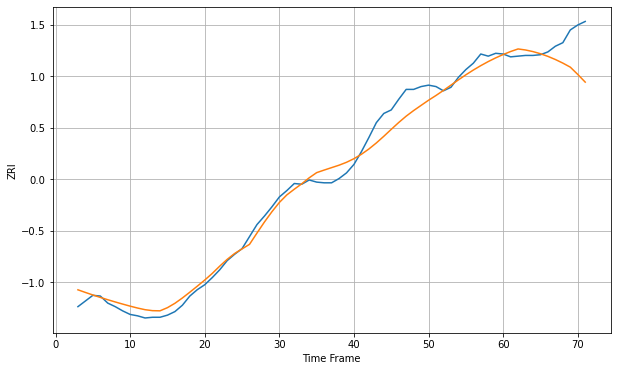

Wall time: 7.26 s
32701 14.674512072398642 37.03370226228307 [1177.25694491 1181.53212296 1185.16302166 1183.69464881 1181.41958874
 1178.41100985 1174.66853626 1170.24352185 1165.17082736 1159.45134386
 1149.16355228 1138.29530983]

Got an mse at 0.0093 in round 28 and stopped training



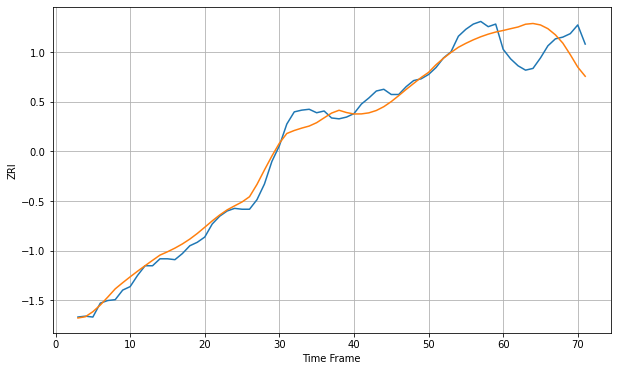

Wall time: 6.75 s
32703 10.629025569646023 35.74900285240957 [1314.62994951 1316.68609191 1318.65180787 1321.82756374 1322.68090667
 1321.00523343 1316.67613557 1309.67171591 1300.09556316 1286.80283524
 1272.51768409 1261.95433594]

Got an mse at 0.0097 in round 32 and stopped training



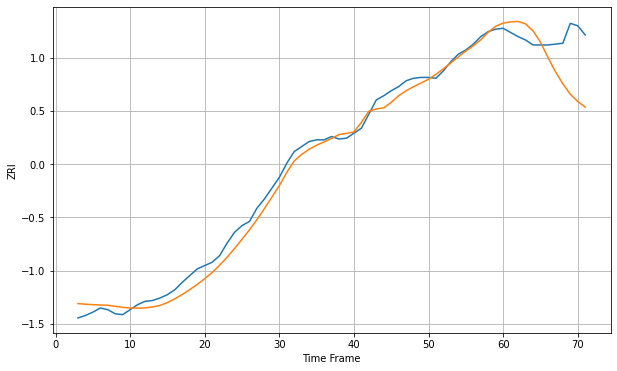

Wall time: 7.46 s
32714 10.062273168256686 48.2383962080568 [1253.26932558 1254.72132182 1255.21312103 1252.3715161  1243.99621283
 1230.28773391 1212.17834142 1194.98594045 1180.38409578 1167.74442744
 1158.9983408  1152.44023089]

Got an mse at 0.0097 in round 45 and stopped training



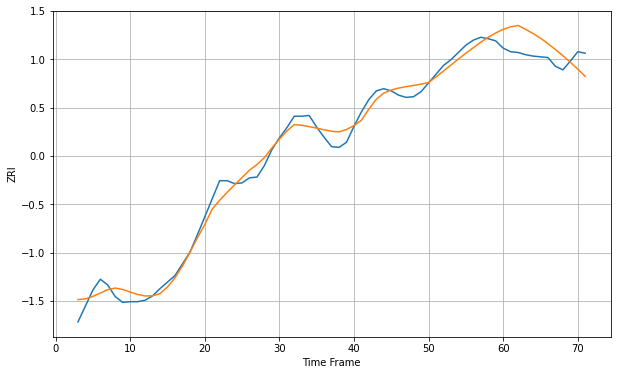

Wall time: 8.09 s
32771 11.810335119530288 27.368178357252972 [1236.90655575 1240.37534586 1242.27670054 1236.97259943 1231.192277
 1224.78663049 1217.19983251 1209.09465561 1200.58118325 1191.58237809
 1182.07095616 1171.9871835 ]

Got an mse at 0.0100 in round 35 and stopped training



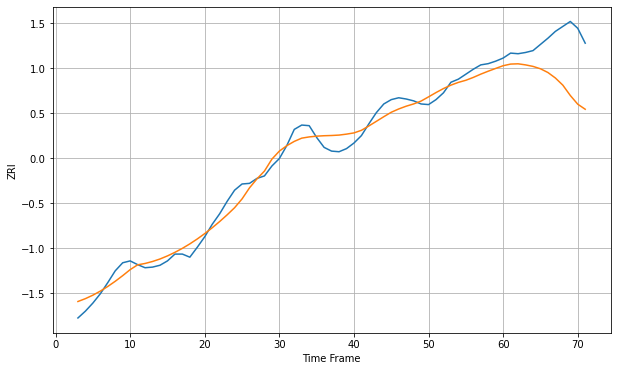

Wall time: 6.67 s
32792 14.610099958644893 71.61352690047691 [1282.6648672  1285.30020371 1285.7426164  1284.00874556 1281.56286089
 1277.731009   1271.71289517 1262.86765551 1251.33295979 1234.67786174
 1220.6178702  1212.48739967]

Got an mse at 0.0100 in round 64 and stopped training



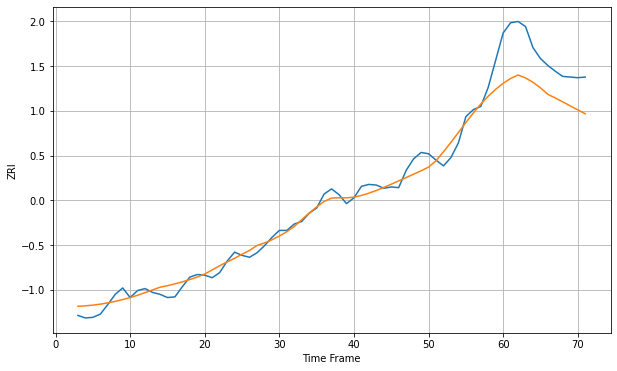

Wall time: 7.44 s
32801 13.371335646748884 61.63007409928695 [1581.21256309 1588.79347056 1594.21652268 1589.59013554 1582.79504461
 1574.12018521 1563.91725276 1558.21567882 1552.13059109 1545.87246467
 1539.64867009 1533.56745513]

Got an mse at 0.0099 in round 64 and stopped training



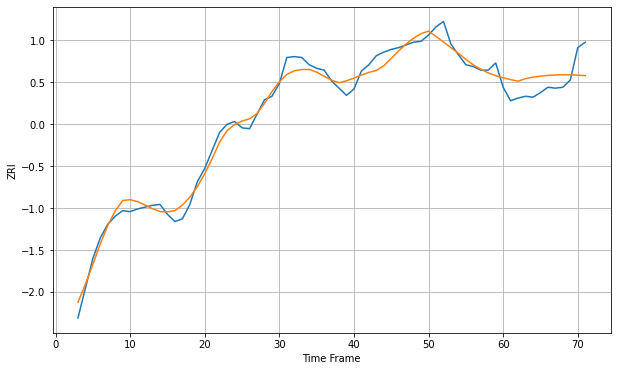

Wall time: 8.07 s
32803 9.284672907763076 20.705752664109415 [1481.49077319 1479.47459183 1477.78230284 1480.53549473 1482.21402044
 1483.30899896 1484.13776589 1484.63899038 1484.82000545 1484.728001
 1484.4166103  1483.9259426 ]

Got an mse at 0.0095 in round 21 and stopped training



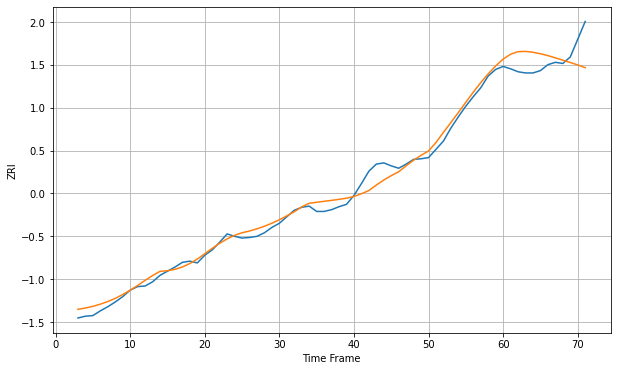

Wall time: 7.22 s
32810 11.59891644853894 33.73690079942008 [1428.44755839 1436.64723523 1441.00919855 1441.372451   1439.97007644
 1437.42958827 1434.28395329 1430.54210345 1426.63669616 1422.69217483
 1418.54593377 1413.97539553]

Got an mse at 0.0094 in round 25 and stopped training



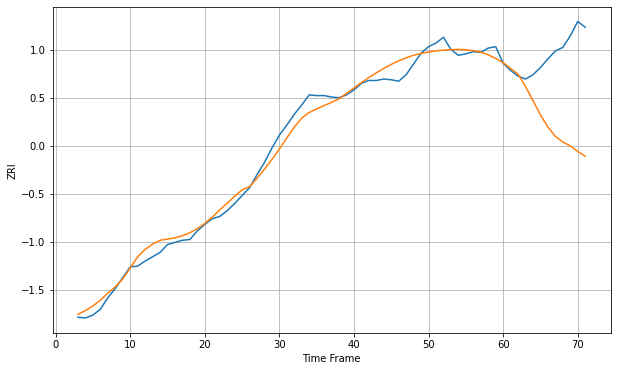

Wall time: 7.94 s
32811 12.044228132787312 105.73783723724176 [1325.87998073 1317.63115808 1309.78196521 1292.79102753 1272.92085514
 1253.20546408 1236.21063995 1223.32333355 1215.53533296 1210.07987255
 1202.45778575 1195.88158079]

Got an mse at 0.0099 in round 40 and stopped training



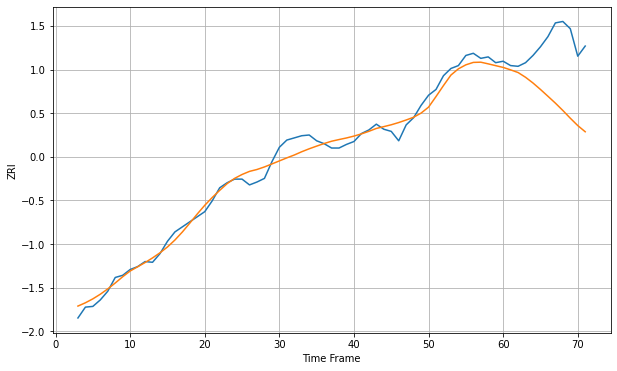

Wall time: 6.36 s
32812 10.888252737891808 80.78851769950379 [1391.45335276 1388.08136637 1384.39996915 1377.82642499 1369.91562135
 1360.99243593 1351.60134191 1342.08641587 1331.94324477 1321.23446346
 1311.0580396  1302.49684089]

Got an mse at 0.0098 in round 39 and stopped training



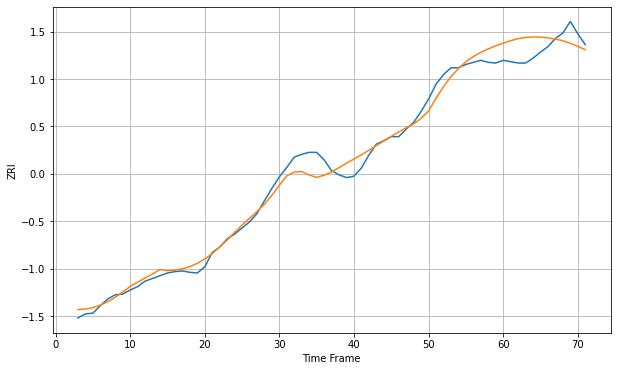

Wall time: 8.19 s
32822 13.087797467672374 24.927331505767505 [1349.13991193 1352.7668731  1355.83298246 1357.57427627 1358.24444329
 1357.99988008 1356.94102228 1355.16417453 1352.77655859 1348.93494754
 1344.41720247 1339.6389173 ]

Got an mse at 0.0099 in round 33 and stopped training



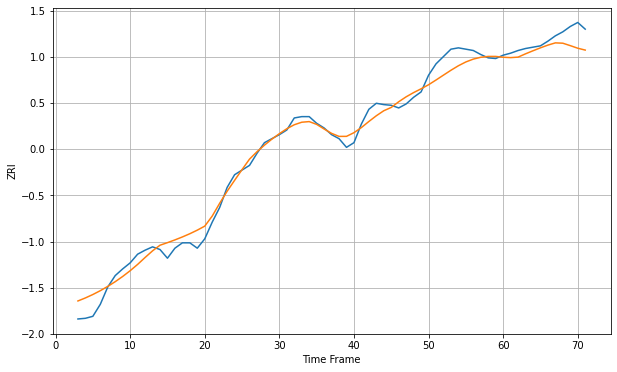

Wall time: 6.62 s
32825 14.494839510078402 18.218190536597618 [1286.93009187 1286.37327336 1287.11131325 1292.04370134 1296.607548
 1301.02019999 1305.08982228 1308.45231872 1307.94630419 1304.30056685
 1300.44612294 1297.64120581]

Got an mse at 0.0096 in round 24 and stopped training



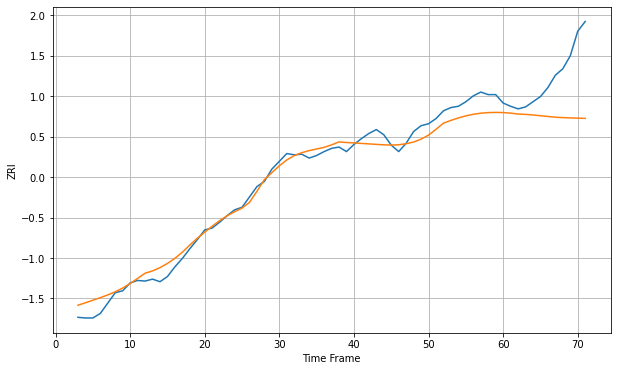

Wall time: 7.3 s
32835 14.676241427546607 72.67952742478069 [1267.26609973 1266.45157738 1264.9723172  1264.48975887 1263.56229679
 1262.41211173 1261.22919829 1260.12476658 1259.48271827 1259.04567205
 1258.67064901 1258.32820162]

Got an mse at 0.0087 in round 58 and stopped training



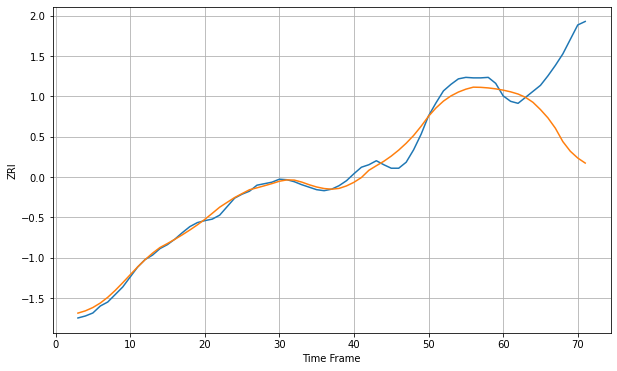

Wall time: 7.54 s
32837 13.59197809953946 146.95101395808894 [1562.40853103 1559.03971233 1554.61154345 1548.00537078 1537.98085673
 1523.50421163 1506.88974557 1486.10546643 1459.3788592  1440.03712778
 1426.40855792 1416.34114085]

Got an mse at 0.0095 in round 34 and stopped training



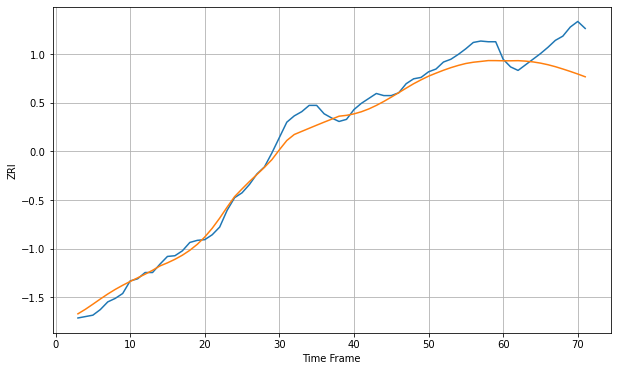

Wall time: 7.11 s
32839 14.170436442842744 39.995484008239735 [1324.76214955 1324.77072945 1324.95480795 1324.31400497 1323.16205072
 1321.44319846 1319.15396468 1316.33146511 1313.03399101 1309.54535044
 1305.84962951 1301.89053279]

Got an mse at 0.0091 in round 25 and stopped training



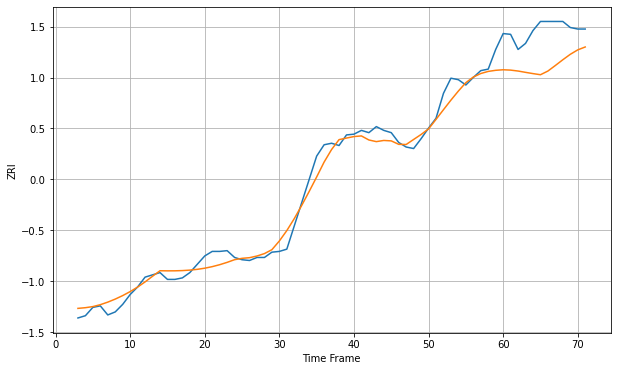

Wall time: 7.5 s
32935 12.347072181869684 48.15620438448369 [1172.15385237 1171.68727093 1170.463286   1168.72601193 1167.06823276
 1165.5804864  1170.45774414 1177.81270761 1185.38774337 1192.5741388
 1198.43860317 1202.26511447]

Got an mse at 0.0100 in round 87 and stopped training



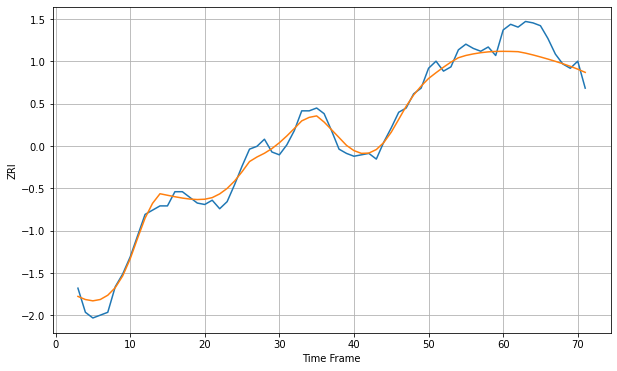

Wall time: 7.52 s
33009 5.81038968335356 15.218088075278166 [1638.94670811 1638.87065009 1638.69958444 1637.67744504 1636.40663104
 1634.98932673 1633.48364598 1631.89737622 1630.20931619 1628.38417894
 1626.37492606 1624.12004541]

Got an mse at 0.0100 in round 426 and stopped training



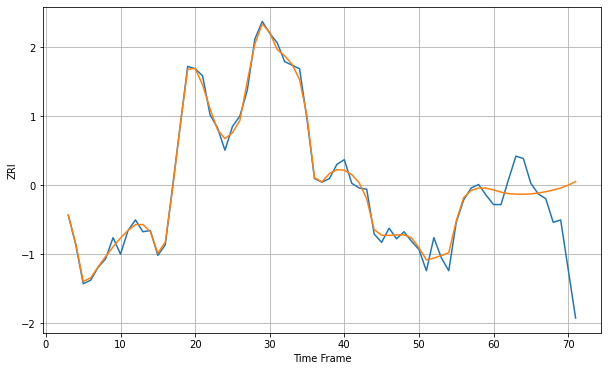

Wall time: 17.4 s
33010 5.667204913341173 43.12424399707183 [1777.40134124 1775.53128441 1774.23917925 1773.82081714 1773.73846847
 1774.04913982 1774.76991196 1775.88785038 1777.33936032 1778.98292056
 1781.43541534 1784.49630992]

Got an mse at 0.0100 in round 212 and stopped training



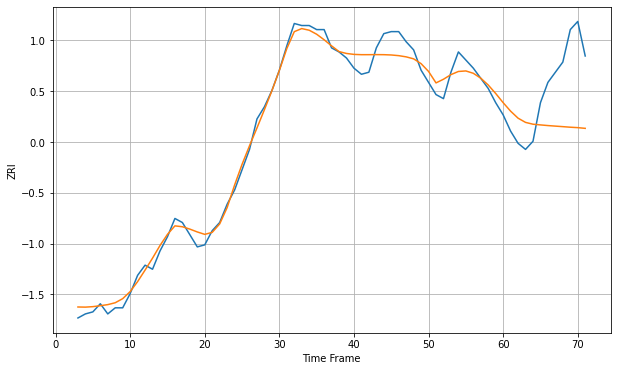

Wall time: 10.9 s
33020 4.8770425836644336 27.587903913270075 [1349.01232187 1344.8319634  1341.37741108 1339.30609526 1338.40964052
 1338.06597685 1337.74098829 1337.47307237 1337.20710816 1336.929782
 1336.72145947 1336.36906822]

Got an mse at 0.0099 in round 22 and stopped training



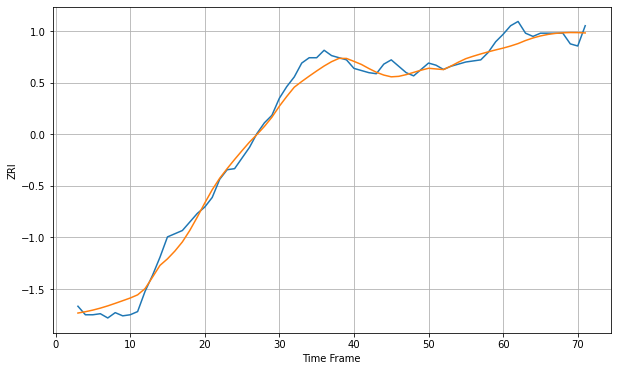

Wall time: 6.91 s
33024 8.498515353440661 10.53802568836922 [1523.02898502 1524.99327317 1527.26973644 1530.13833496 1532.53066818
 1534.42654452 1535.84067283 1536.81056674 1537.38496748 1537.61538273
 1537.55101849 1537.23638357]

Got an mse at 0.0099 in round 76 and stopped training



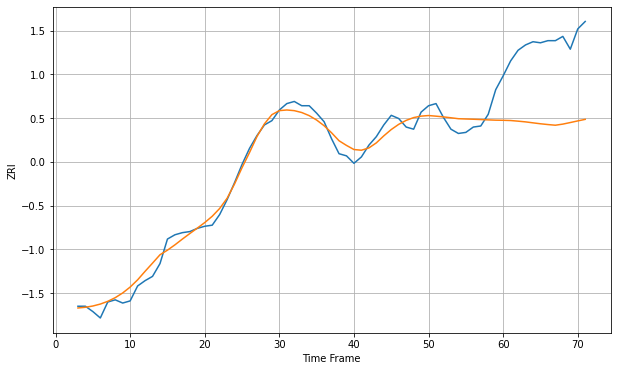

Wall time: 8.04 s
33025 8.50986979046219 74.07881557070225 [1543.34074259 1543.12600587 1542.52625428 1541.8543768  1540.95049087
 1540.07671496 1539.34381286 1538.72492228 1539.7633305  1541.23307329
 1542.76452279 1544.22102686]

Got an mse at 0.0100 in round 485 and stopped training



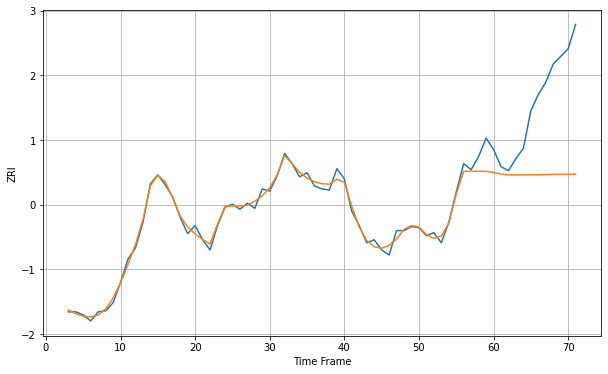

Wall time: 16.8 s
33062 6.335087439764574 82.7808332299112 [1585.32716973 1583.8220465  1582.85736111 1582.86473561 1582.89254204
 1582.946584   1583.03152325 1583.15100884 1583.30768875 1583.4475086
 1583.50422273 1583.66158239]

Got an mse at 0.0094 in round 37 and stopped training



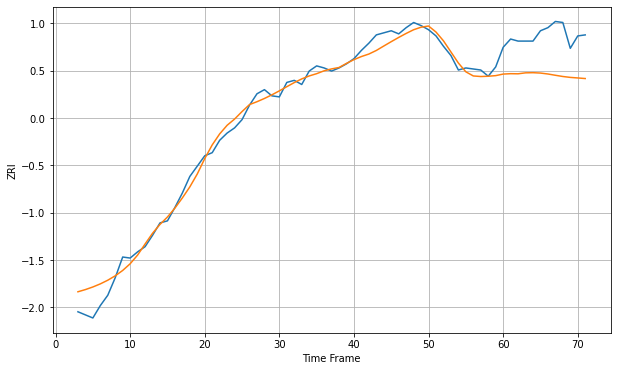

Wall time: 7.2 s
33065 8.960165434801757 38.77536374852119 [1508.07863253 1508.45364116 1508.34442182 1509.27019545 1509.41365597
 1509.05811865 1508.15674971 1506.91020008 1505.73724096 1504.85944185
 1504.32445517 1503.75238915]

Got an mse at 0.0097 in round 34 and stopped training



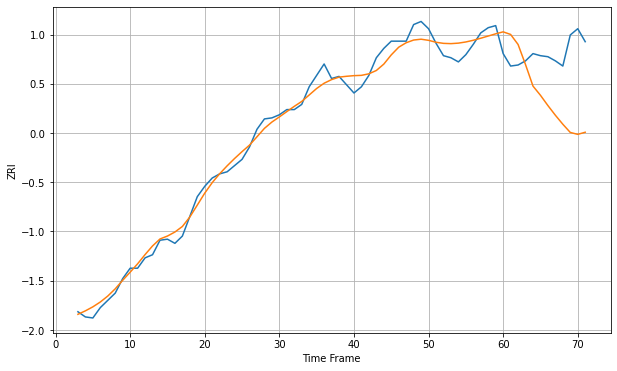

Wall time: 6.8 s
33066 8.626798055526086 57.152342397932685 [1464.9826338  1462.48166775 1452.81778591 1433.36634572 1412.66874668
 1403.79884586 1393.87736222 1384.54308782 1375.8735628  1367.94101442
 1366.11646368 1368.14691823]

Got an mse at 0.0100 in round 135 and stopped training



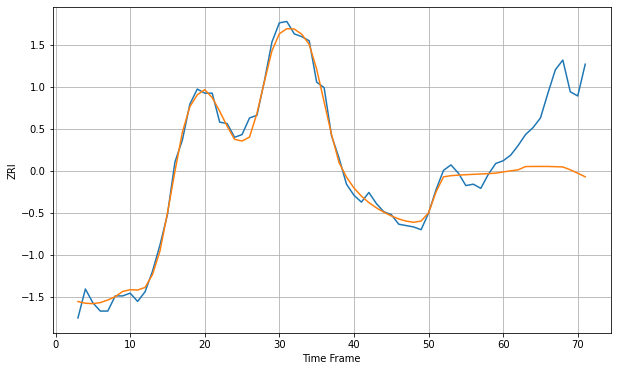

Wall time: 10.4 s
33125 5.624917041223415 49.86512553185499 [1684.89121554 1685.6971043  1686.38992707 1688.80347368 1688.86089463
 1688.88261822 1688.86151043 1688.71179404 1688.50484461 1686.46019282
 1683.95552049 1681.36505479]

Got an mse at 0.0094 in round 40 and stopped training



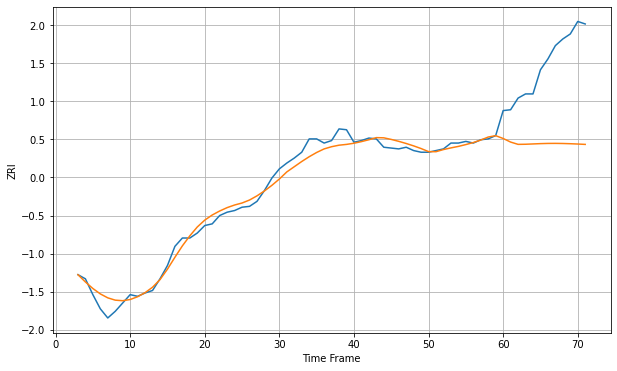

Wall time: 6.93 s
33126 8.881286217695212 100.24068766237775 [1643.50423949 1639.2014024  1636.44112153 1636.57829346 1636.95179919
 1637.32869153 1637.57102884 1637.62547368 1637.49646342 1637.21923936
 1636.84044129 1636.40666844]

Got an mse at 0.0098 in round 225 and stopped training



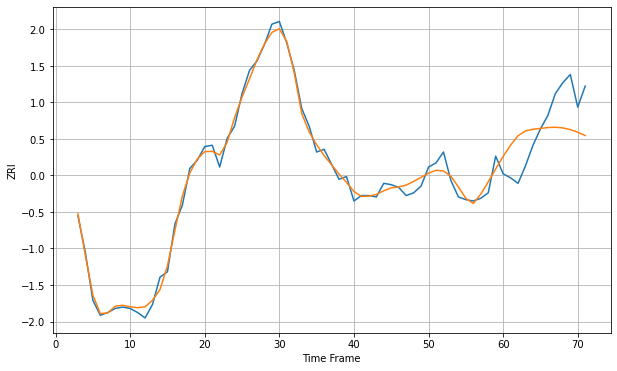

Wall time: 11.7 s
33127 4.987665586110781 25.602101530032883 [1748.76410025 1757.10166767 1764.01210305 1767.52654902 1768.74329663
 1769.36890311 1770.01036594 1770.23555563 1769.74303306 1768.47086349
 1766.53856464 1764.13033068]

Got an mse at 0.0100 in round 85 and stopped training



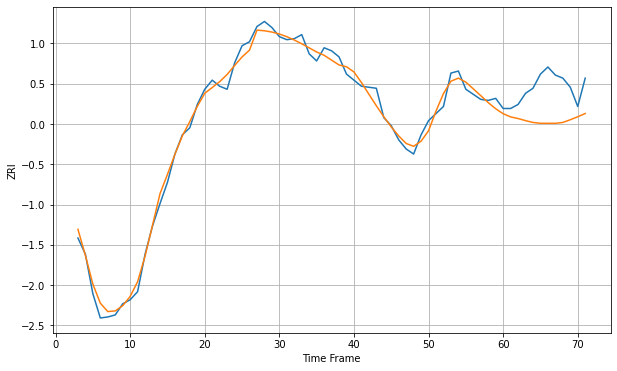

Wall time: 8.45 s
33130 7.230888752026209 34.35043671801982 [1744.84088316 1741.68918902 1740.07601052 1738.01455668 1736.2017511
 1735.38039496 1735.38039496 1735.38039496 1736.20179951 1738.89986181
 1741.85078758 1745.03444966]


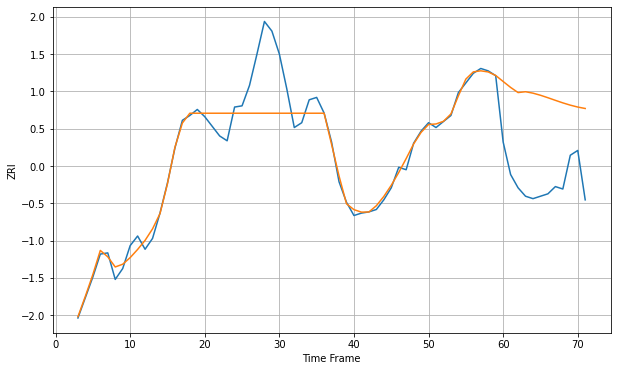

Wall time: 18.1 s
33131 18.012273522152974 71.610062579125 [2285.20274811 2280.27640472 2276.01089836 2276.70534965 2275.51341557
 2273.78092915 2271.72854956 2269.56172494 2267.45919325 2265.56854393
 2263.9962159  2262.79991191]

Got an mse at 0.0099 in round 281 and stopped training



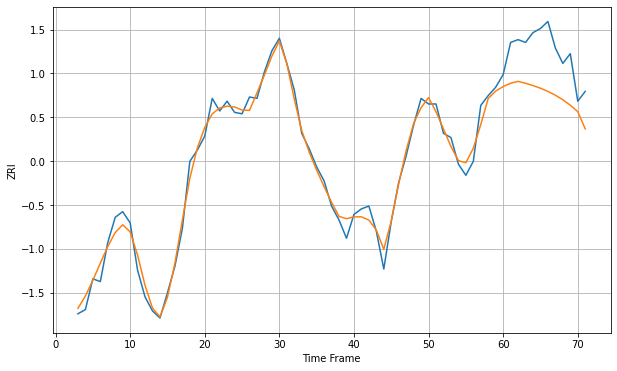

Wall time: 13.3 s
33132 6.509760969883889 32.09806950103189 [2038.48278126 2040.82992793 2042.18495836 2040.81203014 2039.18770792
 2037.26779211 2034.99055921 2032.27601008 2029.02628732 2025.13219555
 2020.49962703 2008.26172521]

Got an mse at 0.0100 in round 158 and stopped training



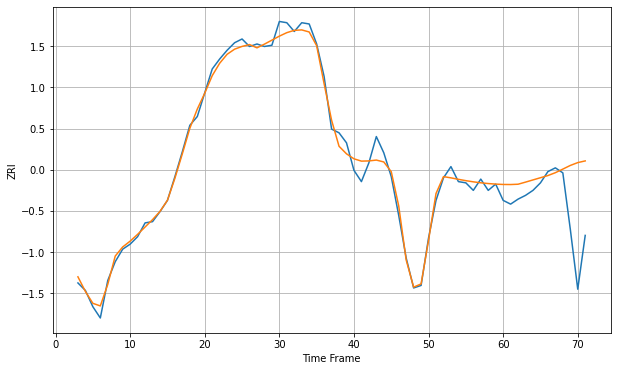

Wall time: 9.32 s
33133 5.878698678810006 37.811720873245676 [1988.71742395 1988.66127297 1988.90759494 1990.58983517 1992.34405395
 1994.10043937 1995.84239395 1998.13349785 2000.98951117 2003.90887259
 2006.18550206 2007.54206571]

Got an mse at 0.0100 in round 440 and stopped training



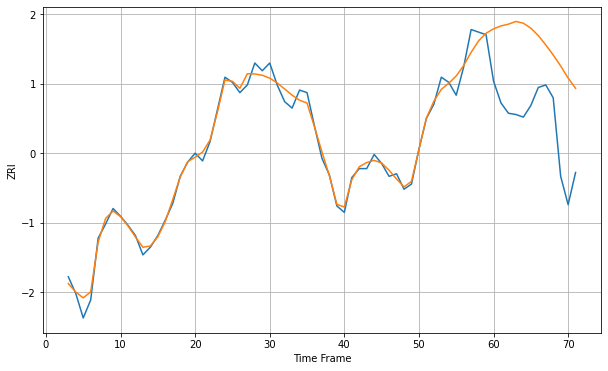

Wall time: 17 s
33134 5.800126328808618 63.99758830843117 [2110.53765055 2112.83485902 2114.19413623 2116.27914974 2114.93168661
 2111.07060874 2105.3259965  2098.07077425 2090.26211086 2081.70856664
 2072.32736687 2064.36814843]

Got an mse at 0.0100 in round 234 and stopped training



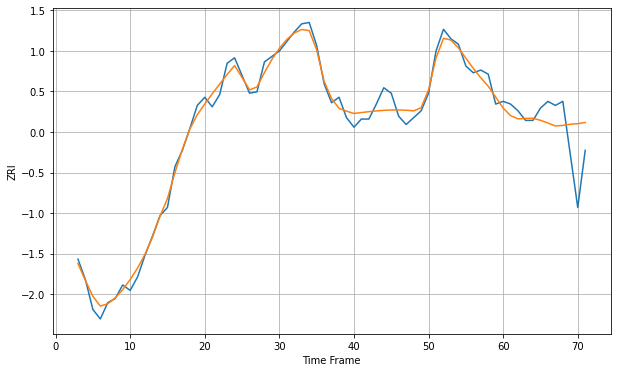

Wall time: 12.6 s
33135 5.916222332052338 21.820212977355062 [1722.0417455  1716.4943057  1714.14994525 1714.48251773 1714.58419132
 1713.08219982 1711.08246868 1708.91482789 1709.3004406  1710.18898585
 1710.58483099 1711.46519639]

Got an mse at 0.0100 in round 111 and stopped training



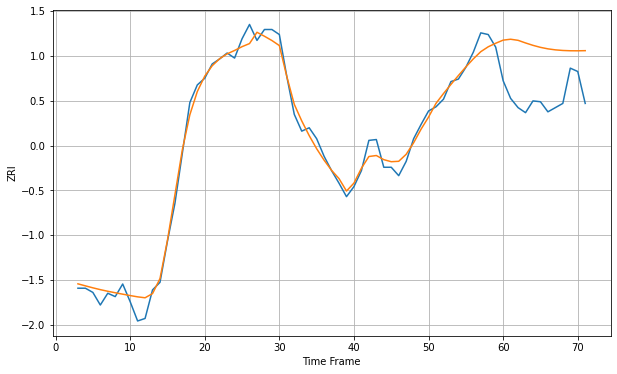

Wall time: 8.93 s
33137 10.721434724946901 63.55792148529681 [2272.34737228 2273.41875852 2272.12119615 2268.99132647 2266.13637173
 2263.75032796 2261.96942253 2260.7681329  2260.04693381 2259.69889506
 2259.63967189 2259.81327645]

Got an mse at 0.0099 in round 275 and stopped training



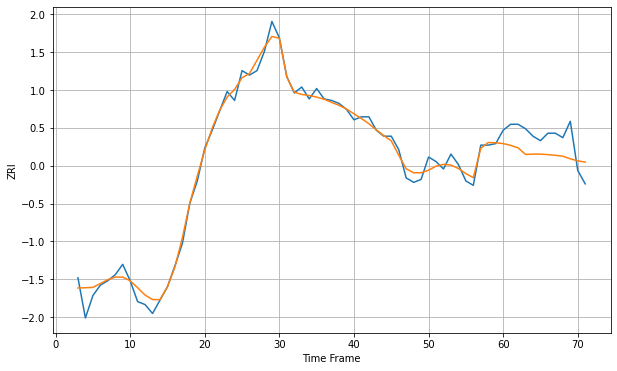

Wall time: 13.4 s
33138 5.144660256485298 14.502478369814682 [1695.03209724 1693.84806268 1692.19326418 1687.75364412 1687.95769652
 1687.97351404 1687.62552231 1687.18915824 1686.58153933 1684.81159005
 1683.45336609 1682.59695135]

Got an mse at 0.0099 in round 310 and stopped training



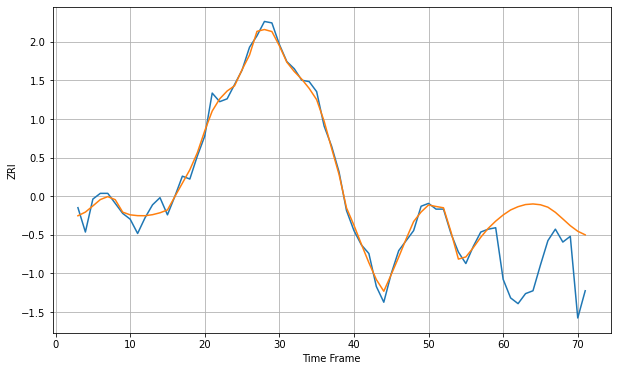

Wall time: 13.7 s
33139 4.922893989344614 46.428011556370215 [2010.9013101  2014.41313458 2016.69877293 2018.18407255 2018.60344812
 2018.04281653 2016.33593125 2012.76232077 2008.14714039 2003.42255087
 1999.55007318 1997.03344223]


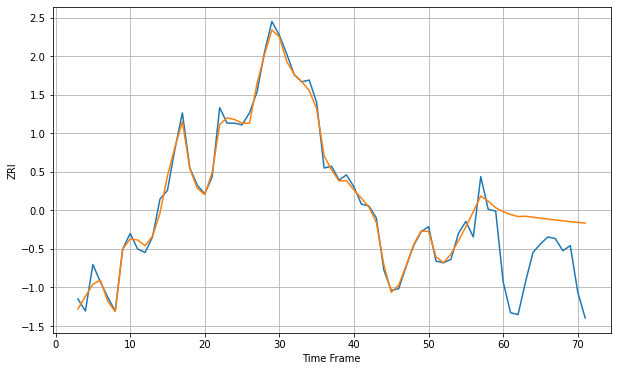

Wall time: 17.6 s
33140 4.706495982488391 36.063444158530956 [2305.66362301 2304.02536218 2302.83871533 2303.00819851 2302.44312467
 2301.89013666 2301.35392035 2300.83919968 2300.35009108 2299.88938609
 2299.45804079 2299.05502674]

Got an mse at 0.0100 in round 132 and stopped training



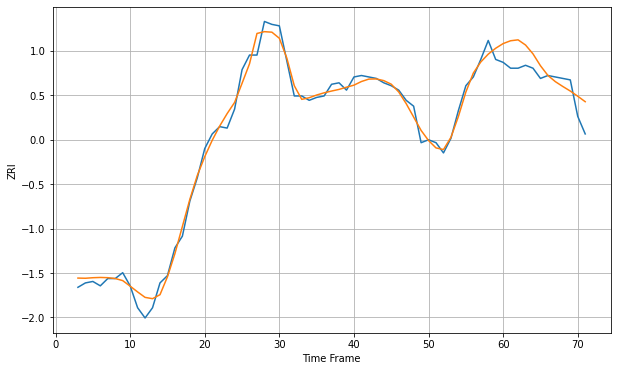

Wall time: 8.84 s
33141 5.580281291325236 13.03106557899282 [1866.86668982 1868.79470828 1869.41562067 1865.88445412 1859.81826045
 1851.70041273 1845.0503584  1840.78903091 1837.47652676 1834.36250303
 1830.81083187 1827.07214106]

Got an mse at 0.0099 in round 154 and stopped training



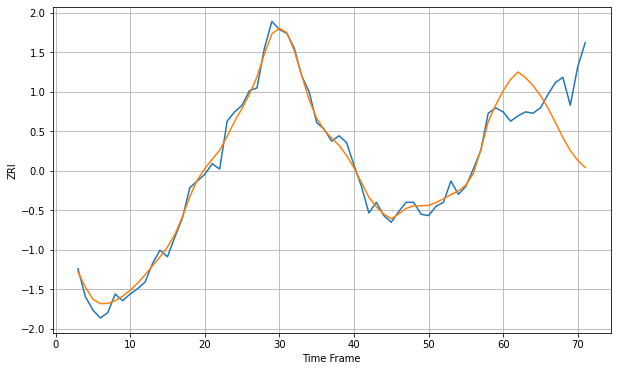

Wall time: 9.67 s
33142 5.617061301563697 42.323983683992104 [1691.00890638 1699.38276677 1705.04328042 1700.74090339 1694.77166918
 1687.29622004 1677.98742597 1667.06416414 1655.79036191 1645.92894866
 1638.43505461 1633.18223927]

Got an mse at 0.0099 in round 218 and stopped training



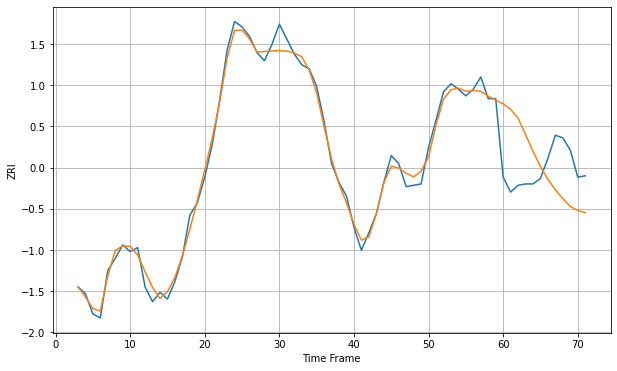

Wall time: 11.2 s
33145 5.829962944034535 38.80878550198609 [2072.16049204 2068.09198326 2061.62000566 2049.49473183 2037.09065661
 2025.85691155 2016.37681751 2008.69163628 2002.12102417 1996.38150963
 1993.47362656 1991.82564787]

Got an mse at 0.0100 in round 278 and stopped training



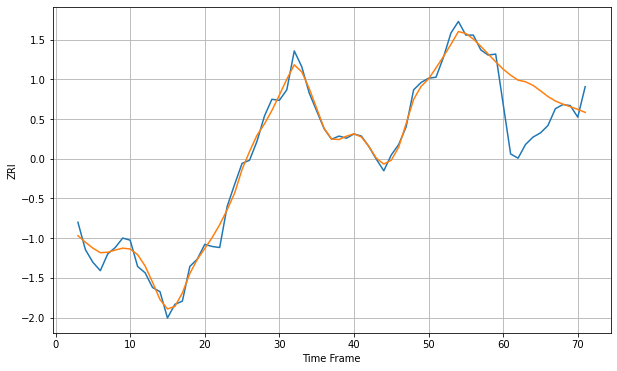

Wall time: 11.9 s
33147 7.435130735945995 42.11169883152832 [1965.68127347 1959.92189748 1955.19258554 1953.6225081  1950.25203997
 1945.10385145 1939.63763708 1935.36457517 1932.35831084 1929.91916029
 1927.41049826 1924.53163447]


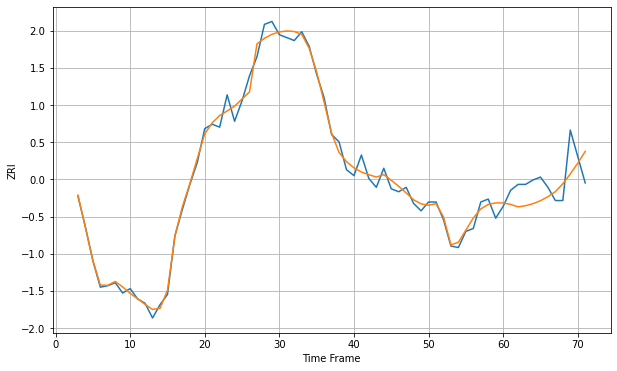

Wall time: 18.1 s
33150 5.0668491408819945 14.855205310216821 [1610.36475298 1609.38138426 1607.70035587 1608.46023996 1609.84856611
 1611.89725095 1614.63361523 1618.06523337 1623.4571259  1630.09825507
 1637.45977921 1645.47214466]

Got an mse at 0.0099 in round 329 and stopped training



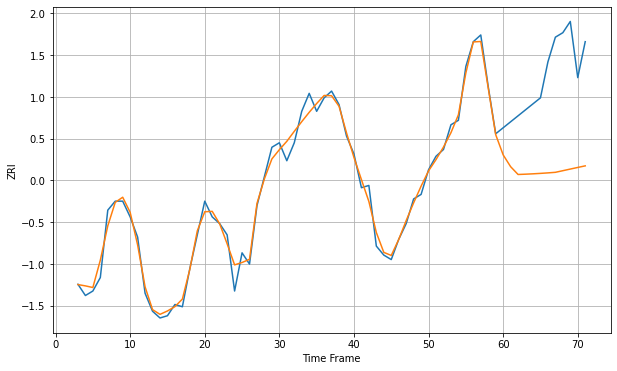

Wall time: 13.7 s
33157 3.7480504592213437 43.738505064335556 [1763.61260606 1758.35775044 1754.88092139 1755.01259418 1755.17475459
 1755.36790257 1755.59121245 1755.84272425 1756.56473945 1757.29303956
 1758.01003871 1758.71798245]

Got an mse at 0.0099 in round 455 and stopped training



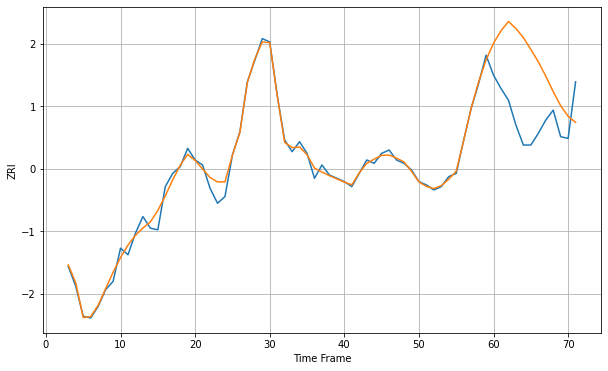

Wall time: 17.4 s
33160 3.681980331331415 39.2299234527584 [2077.23836681 2084.73028917 2090.31476525 2086.087556   2080.58679274
 2073.52406173 2066.07246567 2057.48536128 2048.1082153  2039.66413242
 2033.29074967 2029.64606057]

Got an mse at 0.0100 in round 229 and stopped training



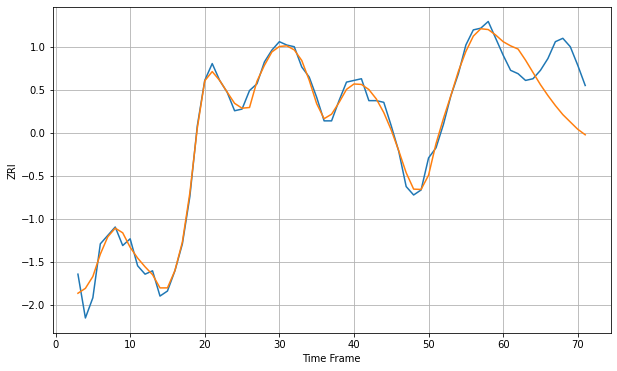

Wall time: 11.6 s
33161 4.94554204506431 27.360678243264818 [1530.0042379  1527.52367339 1525.62469402 1519.03679392 1511.73191628
 1504.47797328 1498.03233617 1492.10116357 1486.71426786 1482.34266119
 1478.01069523 1474.74603183]

Got an mse at 0.0100 in round 44 and stopped training



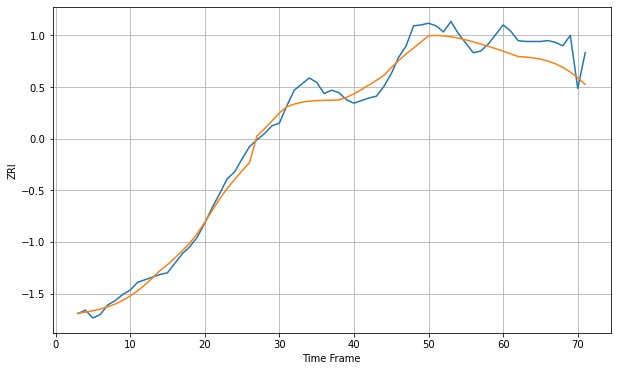

Wall time: 6.95 s
33178 11.103559886276594 25.881488048884904 [2031.88181925 2028.77812215 2025.6958965  2025.08801621 2024.12656701
 2022.66660286 2020.48090516 2017.38377128 2013.23442799 2007.90497111
 2001.32867695 1993.64666886]

Got an mse at 0.0099 in round 402 and stopped training



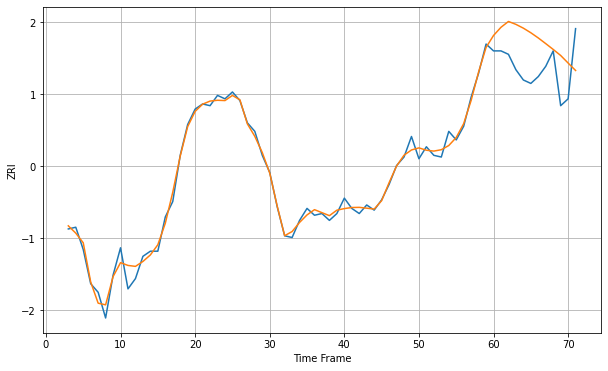

Wall time: 15.5 s
33180 3.9109089216258295 21.817781671411716 [2039.99809067 2044.79207819 2048.18673762 2046.49387032 2044.27400285
 2041.59525878 2038.55045009 2035.24184196 2031.84547276 2028.32297392
 2023.8953503  2019.55592123]

Got an mse at 0.0099 in round 35 and stopped training



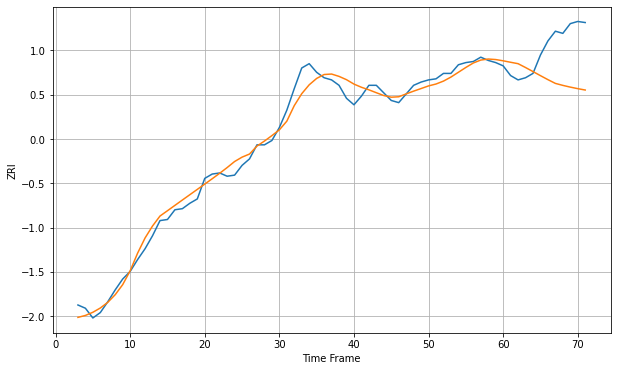

Wall time: 7.08 s
33186 8.070455980811587 38.67921891649217 [1588.64221254 1587.29455031 1585.98701688 1582.43540323 1578.70338157
 1574.92498474 1571.24066746 1567.76588779 1565.93652763 1564.33432874
 1562.91702866 1561.64160644]

Got an mse at 0.0100 in round 106 and stopped training



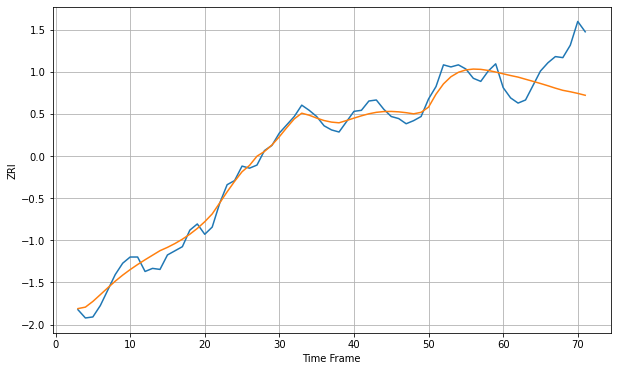

Wall time: 9.07 s
33196 8.243655595152816 35.26559325901294 [1602.34090499 1600.66175398 1599.14441387 1597.08309328 1595.05932761
 1592.97599893 1590.77875985 1588.44410428 1586.34663029 1584.96959144
 1583.37326295 1581.55812292]

Got an mse at 0.0100 in round 92 and stopped training



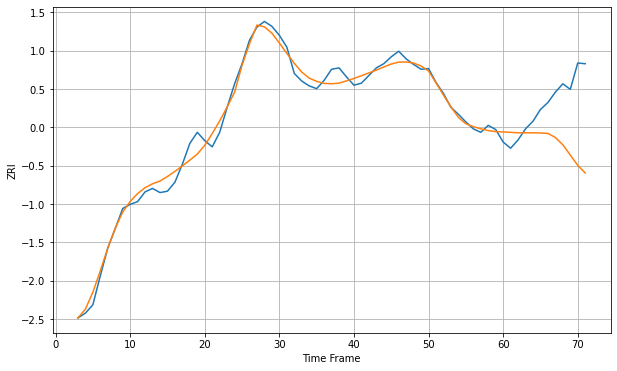

Wall time: 8.71 s
33301 10.963162609415177 77.4558663555843 [1746.52251202 1745.97433621 1745.29559264 1745.33768365 1745.28665116
 1745.02893644 1744.47061405 1738.53301243 1728.00016879 1713.17025866
 1698.31492183 1687.30898584]

Got an mse at 0.0098 in round 33 and stopped training



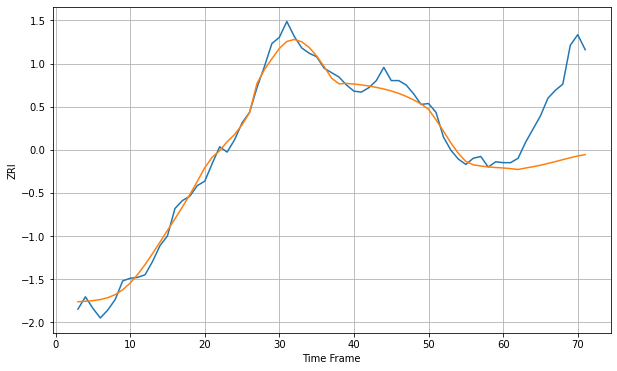

Wall time: 6.43 s
33304 9.36836195880355 78.842360614772 [1550.00039934 1549.24039888 1548.2582977  1549.91920144 1551.38469947
 1553.11812162 1555.07970626 1557.1893389  1559.4200448  1561.5894881
 1563.58523345 1565.13000209]

Got an mse at 0.0100 in round 72 and stopped training



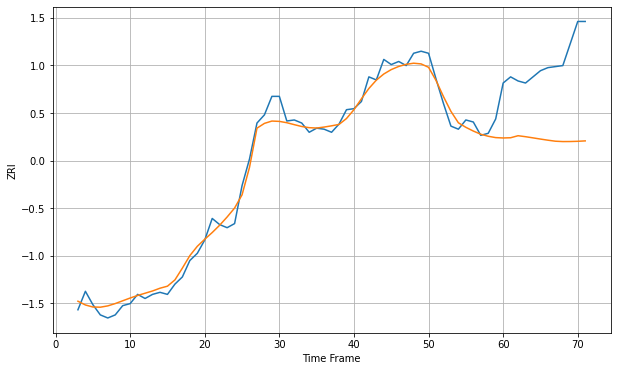

Wall time: 8.28 s
33305 8.981981391623687 77.47803269447236 [1493.44479747 1493.66364274 1495.6416313  1494.68006866 1493.54339423
 1492.37807528 1491.27665522 1490.28795375 1489.93946657 1489.9848308
 1490.20125804 1490.60311605]

Got an mse at 0.0099 in round 38 and stopped training



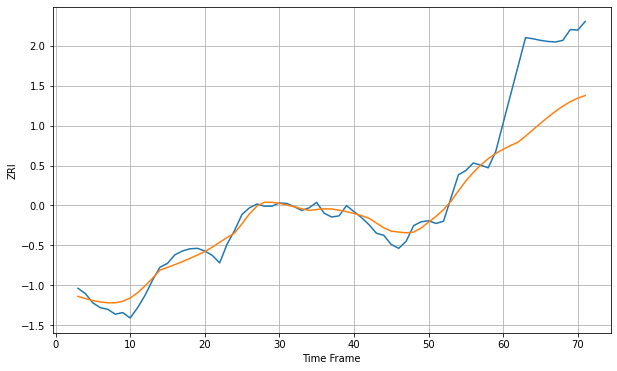

Wall time: 6.36 s
33308 15.456944791542245 135.350263056978 [1620.34450598 1627.31291401 1633.55903576 1644.64763751 1656.52778736
 1668.26311132 1679.68846047 1690.47007196 1700.19093697 1708.45871888
 1715.02466593 1719.85044777]

Got an mse at 0.0099 in round 50 and stopped training



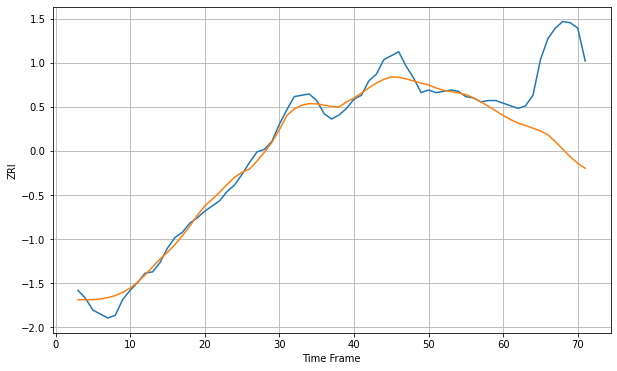

Wall time: 7.58 s
33311 6.853712923834426 66.94070183872508 [1377.70966981 1374.554265   1371.88716372 1370.00859712 1368.00954662
 1365.90158842 1362.97225012 1357.79258476 1352.00412539 1346.29066719
 1341.39813255 1337.55697095]

Got an mse at 0.0097 in round 87 and stopped training



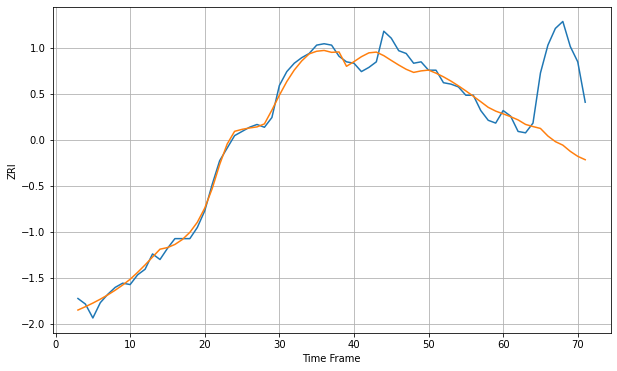

Wall time: 8.25 s
33312 5.9716022876686266 52.00969965844496 [1427.62723319 1425.60499413 1423.28887989 1420.04313265 1418.50841925
 1417.15394511 1411.70631516 1407.67995024 1405.15786203 1400.69239869
 1397.12307353 1394.67777849]

Got an mse at 0.0100 in round 41 and stopped training



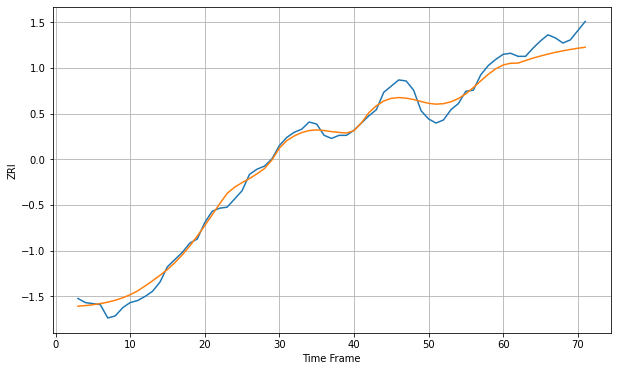

Wall time: 6.69 s
33313 8.197073170685963 13.522206897640277 [1434.61859312 1436.26528979 1436.44277669 1438.95352191 1441.24096422
 1443.31905377 1445.19913823 1446.89009455 1448.39848987 1449.72854032
 1450.88180423 1451.85670557]

Got an mse at 0.0091 in round 23 and stopped training



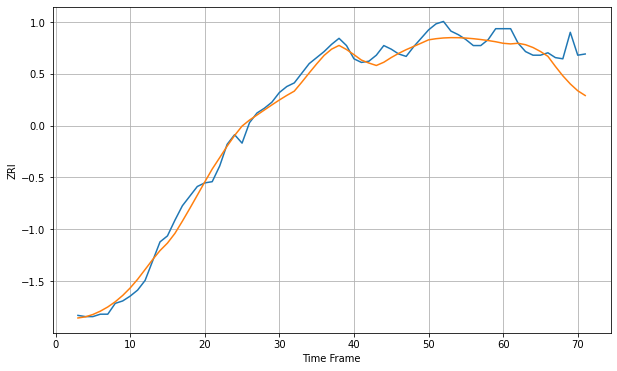

Wall time: 7.63 s
33324 6.671457906357973 19.468045060476438 [1560.89117844 1560.36955581 1560.902072   1559.70191661 1557.38298399
 1554.08070747 1550.05388098 1541.70064281 1533.89397501 1527.13668769
 1521.47072532 1517.51856737]

Got an mse at 0.0096 in round 32 and stopped training



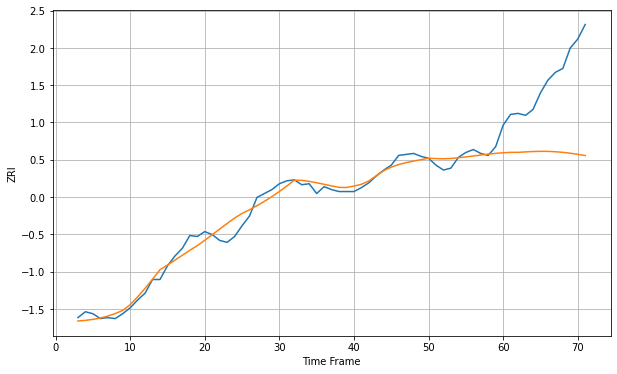

Wall time: 6.5 s
33334 7.247085095486253 78.27608243896758 [1320.71854095 1321.11046078 1321.10942925 1321.59426796 1321.97025679
 1322.15981331 1322.10033245 1321.75785571 1321.1297026  1320.23971405
 1319.12948302 1317.84875283]

Got an mse at 0.0100 in round 86 and stopped training



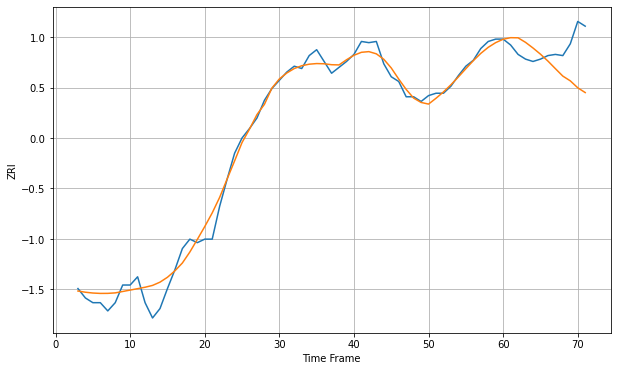

Wall time: 8.3 s
33401 8.299220637855695 26.480170715143515 [1517.89745671 1519.22204455 1519.10092422 1515.24769811 1510.45801049
 1505.19729945 1499.35400812 1492.89821233 1486.56197002 1482.52696759
 1476.62904494 1472.56797976]

Got an mse at 0.0099 in round 97 and stopped training



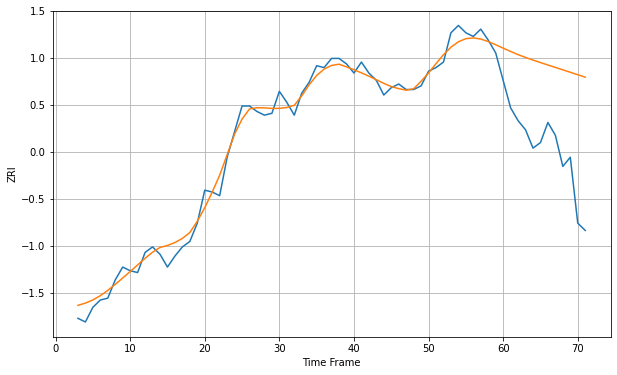

Wall time: 8.27 s
33404 4.834747149465787 49.3621684205705 [1495.61135441 1493.81514755 1492.05408897 1490.53088771 1489.0973638
 1487.72720222 1486.39504588 1485.07851833 1483.76079594 1482.43292418
 1481.09510102 1479.75642677]

Got an mse at 0.0100 in round 83 and stopped training



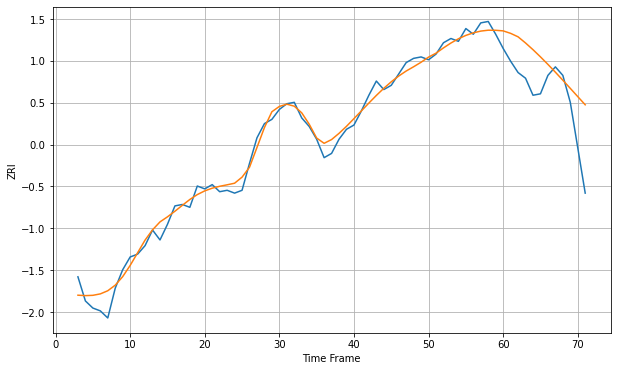

Wall time: 8.28 s
33407 5.947317163283981 27.168286960267523 [1512.36726945 1510.62028345 1508.1779104  1503.83848809 1499.10884152
 1494.0555116  1488.74852375 1483.24653035 1477.59593367 1471.84192665
 1466.04105332 1460.26719041]

Got an mse at 0.0100 in round 124 and stopped training



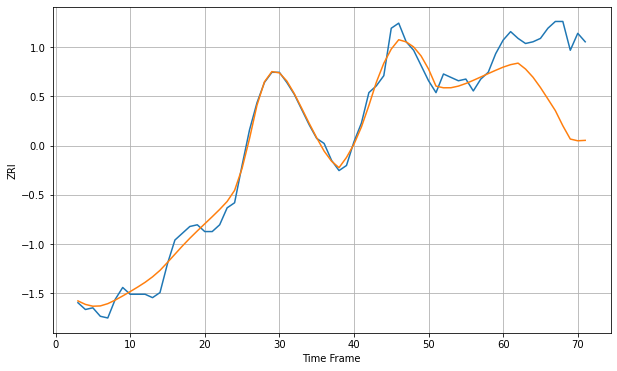

Wall time: 9.38 s
33413 5.5879359812159946 41.64181327787474 [1452.04215481 1453.51527669 1454.40577898 1450.92986497 1446.09284715
 1440.00924462 1433.22955201 1426.35327529 1417.45385427 1409.59846473
 1408.57680289 1408.830351  ]

Got an mse at 0.0099 in round 147 and stopped training



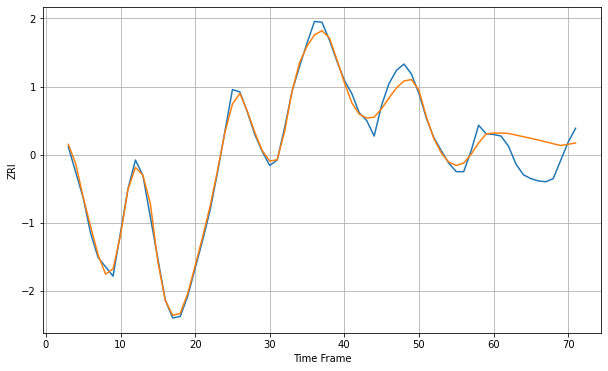

Wall time: 9.11 s
33414 9.124926268324403 35.38708177758306 [1737.85294326 1737.78733178 1737.41452175 1735.26603106 1733.17729963
 1731.06697295 1728.86325497 1726.53591943 1724.07060466 1721.82137852
 1723.38599026 1725.03644294]

Got an mse at 0.0100 in round 108 and stopped training



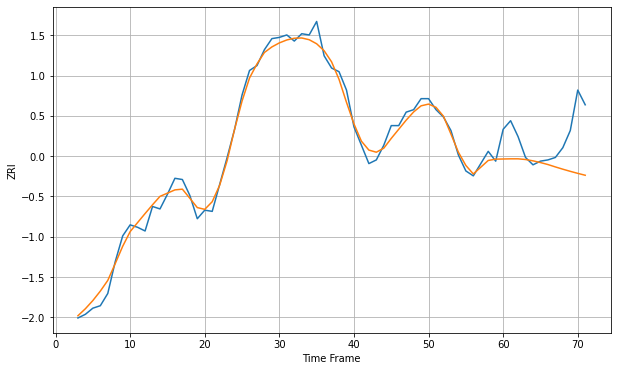

Wall time: 8.7 s
33418 6.304614896932283 30.71242891082408 [1679.7567652  1679.88628471 1679.89161126 1679.33575536 1678.24110592
 1676.85081802 1675.23495222 1673.27998459 1671.4256634  1669.67654605
 1668.03157751 1666.48528576]

Got an mse at 0.0100 in round 113 and stopped training



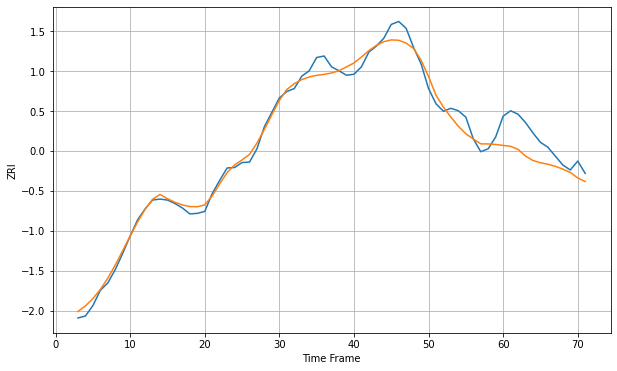

Wall time: 8.6 s
33432 15.807128625311167 46.86549323245175 [1927.77484576 1925.91116876 1919.79936742 1906.17239585 1897.12835165
 1892.66601771 1889.52560552 1885.41177567 1879.64530618 1873.07936807
 1861.70570592 1854.58808816]

Got an mse at 0.0099 in round 138 and stopped training



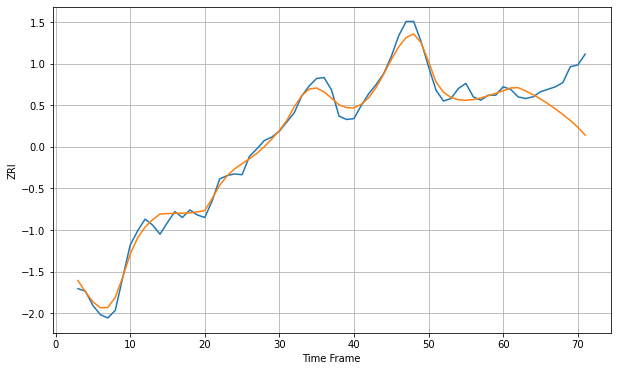

Wall time: 9.11 s
33433 9.263029445031295 42.55273809503597 [1763.24667763 1766.59197646 1766.9954303  1763.12418292 1758.61554622
 1753.51053828 1747.84489249 1741.65282355 1734.97586486 1727.8806189
 1719.73932407 1710.25091096]

Got an mse at 0.0100 in round 217 and stopped training



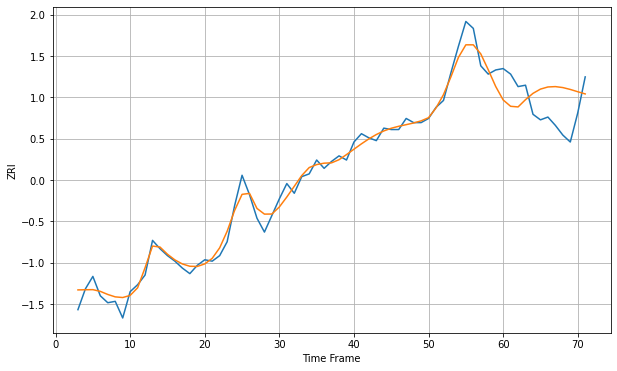

Wall time: 11.6 s
33435 6.335832236133023 23.007001977685228 [1703.35600018 1698.77551129 1698.31602762 1703.5832953  1708.10728741
 1711.18023968 1712.72343349 1712.99058062 1712.29022054 1710.93769741
 1709.28854087 1707.70323736]

Got an mse at 0.0099 in round 82 and stopped training



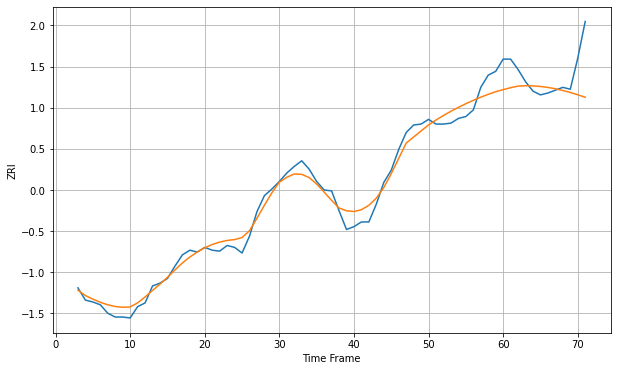

Wall time: 8.35 s
33436 9.625410868581145 29.546807207079045 [1534.57284881 1536.6190852  1538.35944505 1538.71556822 1538.56583286
 1537.95288093 1536.91510811 1535.48630359 1533.69600422 1531.57127171
 1529.13997413 1526.43328361]

Got an mse at 0.0100 in round 222 and stopped training



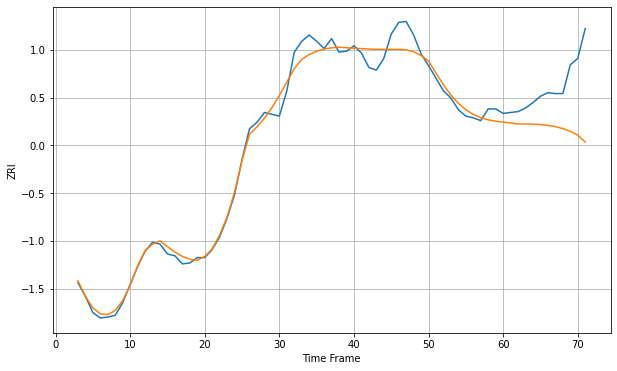

Wall time: 11 s
33444 10.886626199138473 53.964062258155316 [1665.27646075 1664.40377681 1663.24718554 1663.24186181 1663.09361612
 1662.64281979 1661.73216079 1660.29607148 1658.15331005 1655.22061568
 1650.77098965 1643.38885538]

Got an mse at 0.0099 in round 315 and stopped training



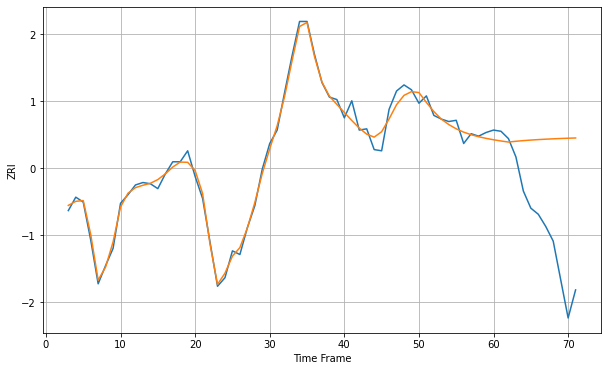

Wall time: 13.6 s
33460 5.448739171513267 77.23012385109337 [1497.04283622 1496.05771886 1495.16791693 1495.81421413 1496.35115569
 1496.80207055 1497.18776082 1497.52440586 1497.82260821 1498.08728256
 1498.31798448 1498.50933035]

Got an mse at 0.0100 in round 88 and stopped training



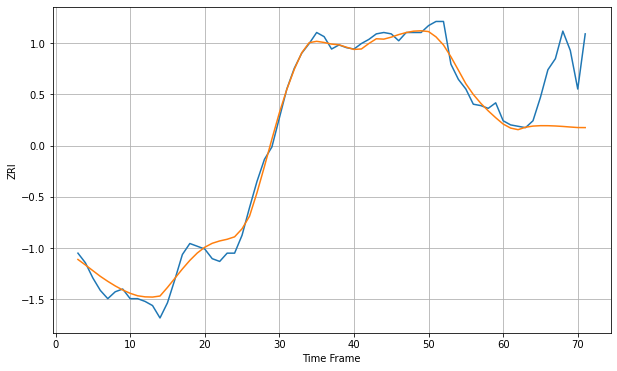

Wall time: 8.55 s
33461 6.889605127520514 38.450703710190766 [1421.62815625 1418.69640247 1417.53795357 1419.30768826 1420.14049309
 1420.43419965 1420.41818065 1420.2147951  1419.88428492 1419.45973362
 1419.07886473 1419.04141283]

Got an mse at 0.0100 in round 87 and stopped training



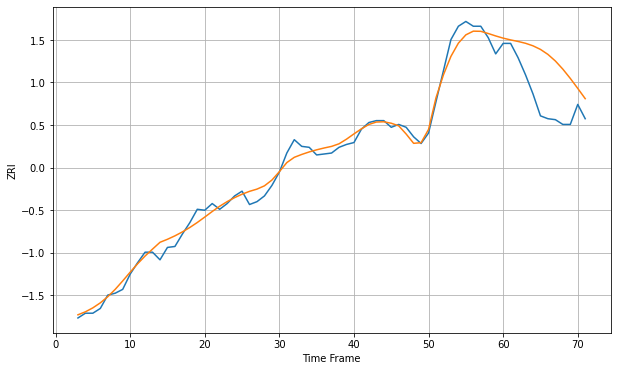

Wall time: 7.67 s
33510 8.197363782806695 44.33592855989445 [1282.5170061  1280.6423924  1279.03001773 1277.11636365 1274.45811302
 1270.69231011 1265.45447961 1258.52498294 1250.00063788 1240.27791459
 1229.80014704 1219.02688126]

Got an mse at 0.0100 in round 49 and stopped training



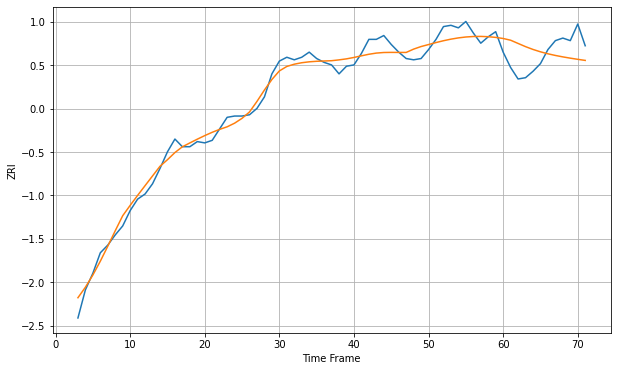

Wall time: 8.1 s
33511 6.584010106884139 17.69119883833075 [1280.67924598 1279.33363664 1276.81048477 1274.30572015 1272.10752213
 1270.25431613 1268.70954746 1267.40850366 1266.28684724 1265.29117575
 1264.38077322 1263.526082  ]

Got an mse at 0.0098 in round 37 and stopped training



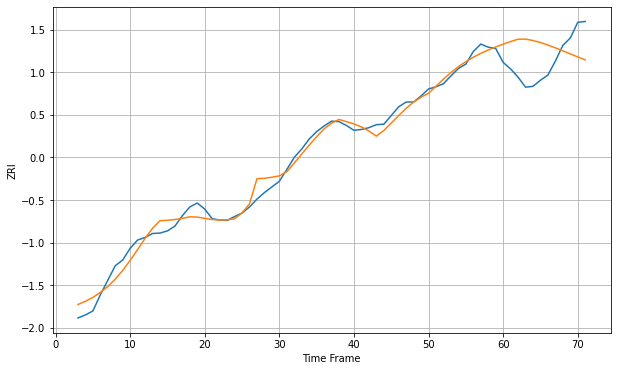

Wall time: 7.65 s
33602 17.62080806599111 73.80689248657511 [1883.87885271 1889.87816195 1895.24748586 1895.5140311  1892.29965754
 1887.6274632  1881.87141462 1875.40213764 1868.54574409 1861.5600935
 1854.60679774 1847.73698789]

Got an mse at 0.0100 in round 56 and stopped training



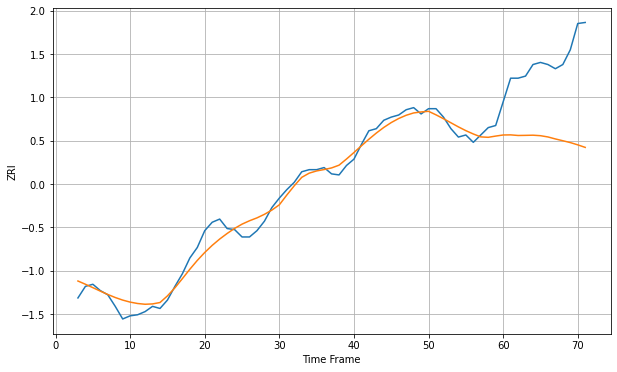

Wall time: 7.03 s
33604 8.588745420745038 75.88185572693052 [1002.98375398 1003.09339458 1002.51560958 1002.62972698 1002.78753939
 1002.31374745 1001.12063085  999.22187431  997.51200457  995.76107108
  993.60308058  991.18552823]

Got an mse at 0.0098 in round 63 and stopped training



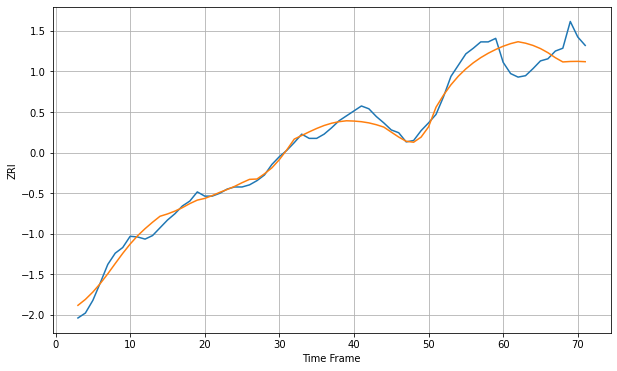

Wall time: 7.76 s
33606 11.133171205366509 34.01315819159194 [1547.81361965 1551.52685186 1554.22109932 1552.16184031 1548.98173043
 1544.51292682 1538.6675657  1531.51335815 1525.53055342 1526.19141912
 1526.35717898 1525.87747856]

Got an mse at 0.0099 in round 55 and stopped training



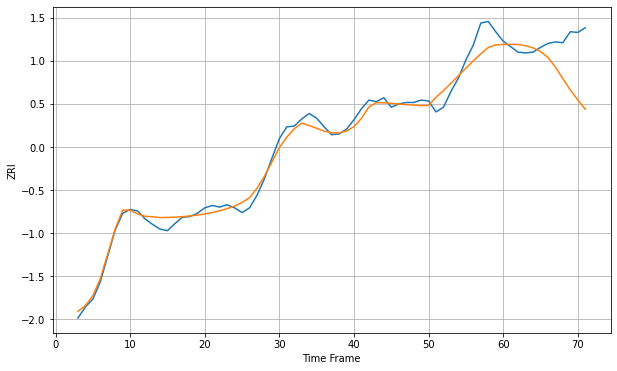

Wall time: 7.15 s
33607 11.125313333982655 47.65277552379935 [1448.70331024 1448.87858942 1448.76597696 1447.23057124 1444.48541451
 1439.90002142 1432.26493951 1419.98224936 1405.2143431  1390.86413218
 1378.39390733 1366.43603932]

Got an mse at 0.0100 in round 64 and stopped training



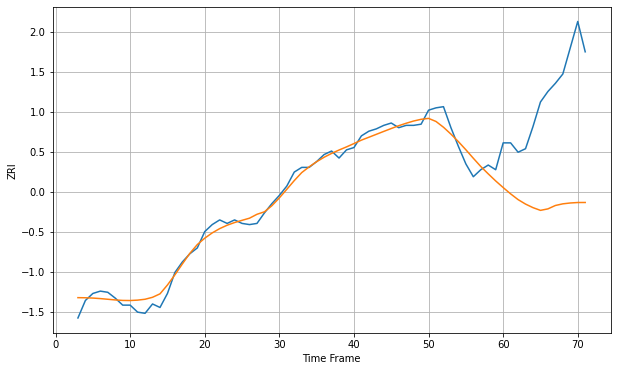

Wall time: 7.19 s
33612 6.723255559580414 96.84305060163923 [963.73851661 958.32841502 953.40686518 949.5642885  946.51472392
 944.18588158 945.45701515 948.35817733 949.77621403 950.50482151
 950.9016821  950.9325125 ]

Got an mse at 0.0098 in round 46 and stopped training



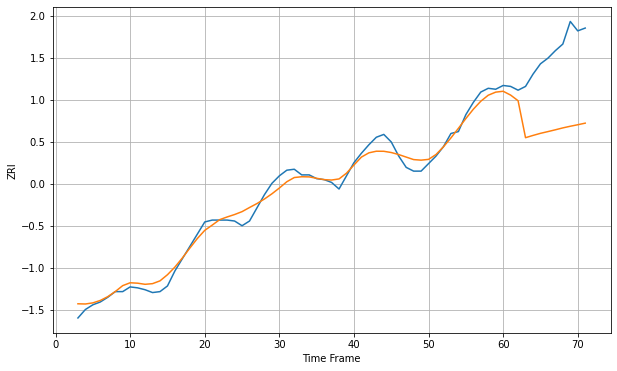

Wall time: 6.9 s
33613 7.886480434862481 74.46202013048187 [1192.84804992 1188.79011418 1182.81041831 1143.53025735 1145.92046909
 1148.14863348 1149.99870993 1151.91842727 1153.93119393 1155.68155706
 1157.27892814 1158.96703864]

Got an mse at 0.0097 in round 31 and stopped training



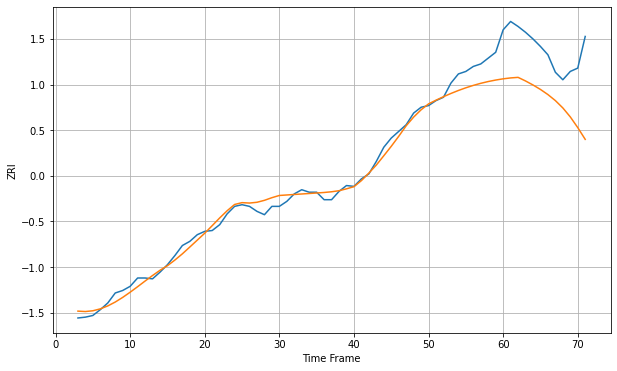

Wall time: 6.93 s
33615 10.316854307578094 63.80720067878574 [1260.12821819 1261.21330906 1261.88512306 1257.55890719 1252.7495457
 1247.37276665 1241.2273953  1233.98409233 1225.19596982 1214.41777848
 1201.57812718 1187.44963906]

Got an mse at 0.0099 in round 73 and stopped training



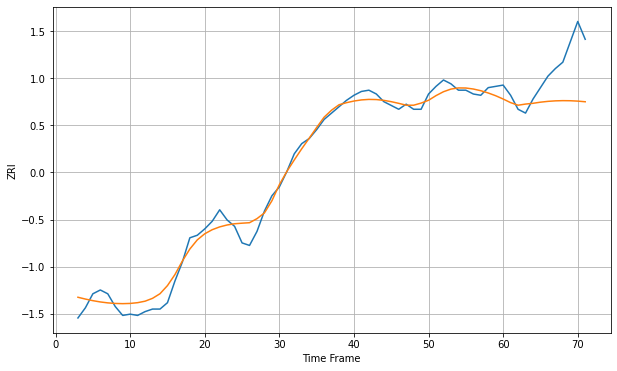

Wall time: 7.63 s
33617 7.018391404094888 29.965657176881223 [1066.06375734 1063.22063982 1061.184465   1062.09139029 1062.6900396
 1063.57618181 1064.21551732 1064.61569959 1064.77817952 1064.70605275
 1064.40873133 1063.90363091]

Got an mse at 0.0098 in round 72 and stopped training



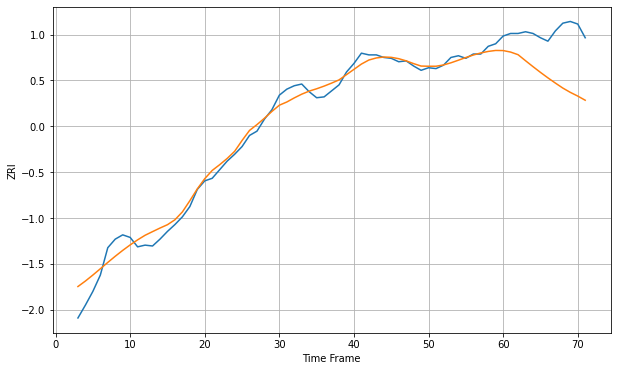

Wall time: 8.06 s
33626 10.552182023585933 54.885952195172 [1439.0382095  1437.284777   1434.2255583  1427.18892628 1420.28991677
 1413.59371387 1407.19581743 1401.10410689 1395.27608999 1390.27677139
 1385.93559655 1381.07754327]

Got an mse at 0.0098 in round 57 and stopped training



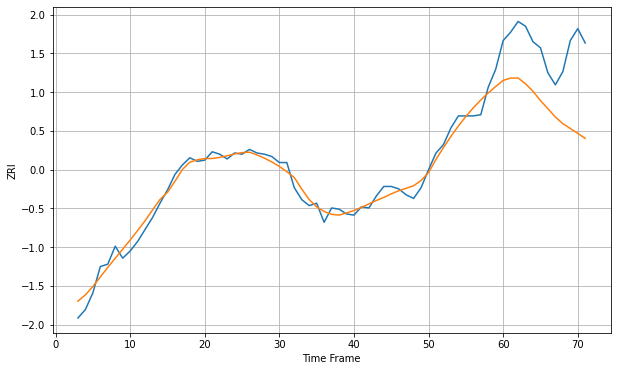

Wall time: 7.05 s
33634 6.444084425710129 53.028036897422496 [1218.69450651 1220.61119213 1220.76706686 1215.8873734  1209.636893
 1201.84311199 1195.05917092 1188.06113808 1182.55217091 1178.50089911
 1174.41991167 1170.17553867]

Got an mse at 0.0095 in round 23 and stopped training



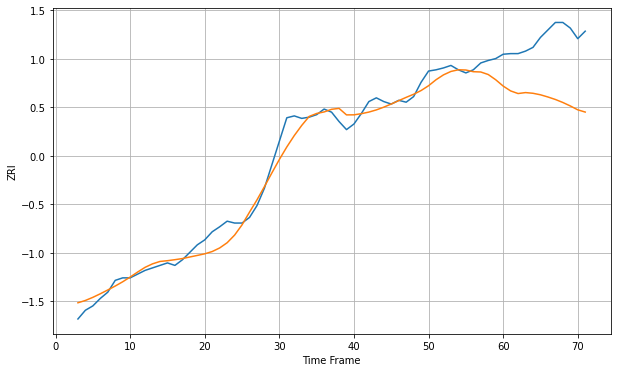

Wall time: 7.39 s
33701 16.654368966931788 98.97174953714607 [1312.92099366 1305.12524456 1300.89598579 1302.43745294 1301.30931265
 1298.90176535 1295.36809808 1291.37747286 1286.55590279 1280.99901867
 1274.76289108 1271.16113182]

Got an mse at 0.0095 in round 53 and stopped training



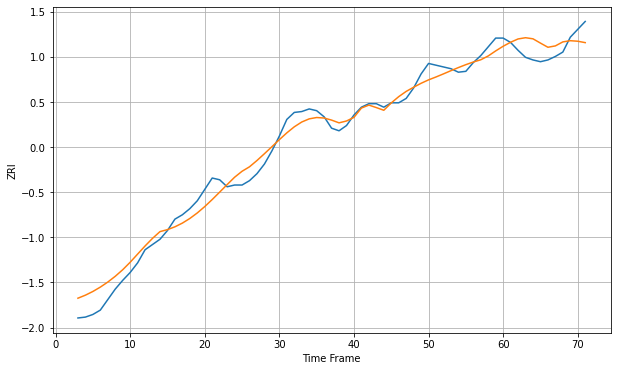

Wall time: 7.25 s
33702 12.339018708375248 16.002526777253028 [1172.65885414 1177.23806434 1181.01065179 1182.4232309  1181.16276607
 1176.2596393  1171.51008774 1173.05242657 1177.63473876 1179.00636335
 1178.40233532 1176.7977189 ]

Got an mse at 0.0100 in round 57 and stopped training



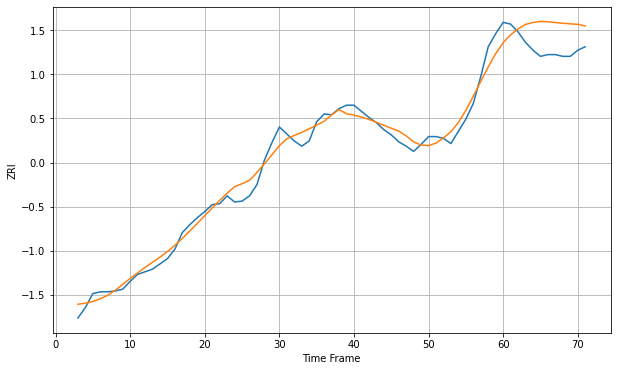

Wall time: 7.56 s
33705 10.151099877090765 30.01346833888553 [1325.57262219 1334.70094234 1341.53743926 1346.59496655 1348.88166144
 1350.00860673 1349.69051301 1348.78695947 1347.94804067 1347.2945783
 1346.72290938 1344.82329946]

Got an mse at 0.0099 in round 52 and stopped training



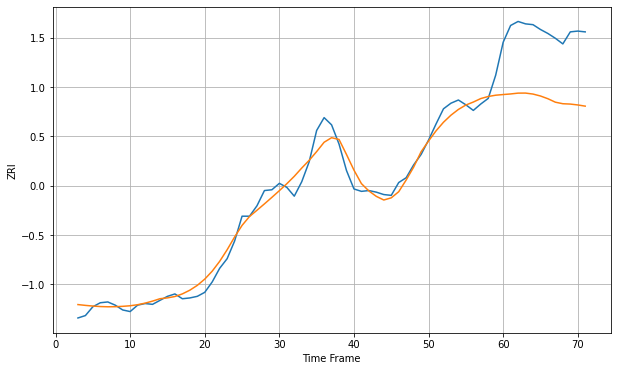

Wall time: 7.12 s
33706 11.751646489646511 84.23654785494334 [1480.80358335 1481.55117943 1482.57550032 1482.63601817 1481.4134067
 1478.99993503 1475.57739496 1471.26335391 1469.35045575 1468.92070001
 1467.83066202 1466.33848759]

Got an mse at 0.0091 in round 18 and stopped training



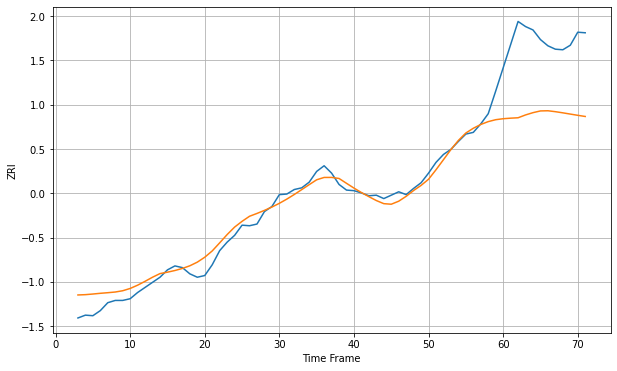

Wall time: 6.97 s
33708 16.84867391308958 132.79910581089905 [1531.11654588 1532.09257284 1532.80742542 1537.80826095 1541.84043567
 1544.88254269 1545.197625   1543.56431207 1541.52846265 1539.3320307
 1537.15400389 1535.10043752]

Got an mse at 0.0100 in round 35 and stopped training



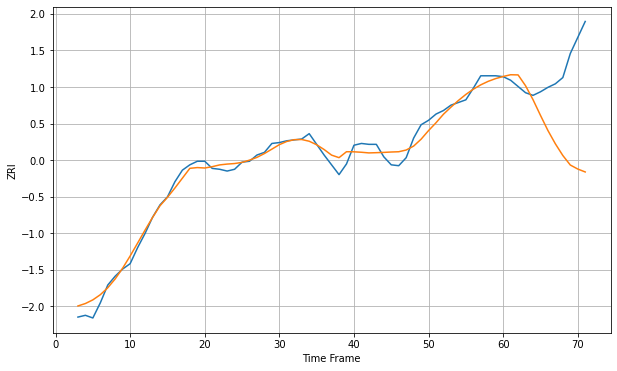

Wall time: 6.88 s
33712 8.22862877562523 82.4682513760655 [1147.19680942 1149.16503931 1148.98323471 1136.83677876 1121.23682599
 1103.58201795 1086.56233485 1071.57265788 1058.46473415 1047.78643894
 1043.27463693 1039.98156644]

Got an mse at 0.0097 in round 42 and stopped training



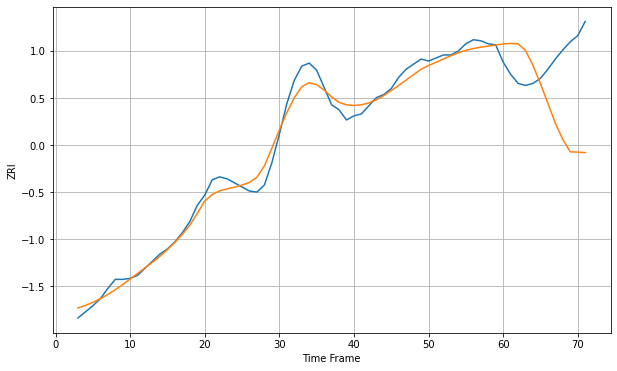

Wall time: 7.61 s
33716 8.717413298770099 69.99330294644417 [1195.83868089 1196.33068631 1196.05128982 1189.43462938 1174.71094127
 1156.7081649  1137.39843384 1117.78846136 1101.69558576 1089.61174682
 1089.30733982 1088.87486939]

Got an mse at 0.0099 in round 47 and stopped training



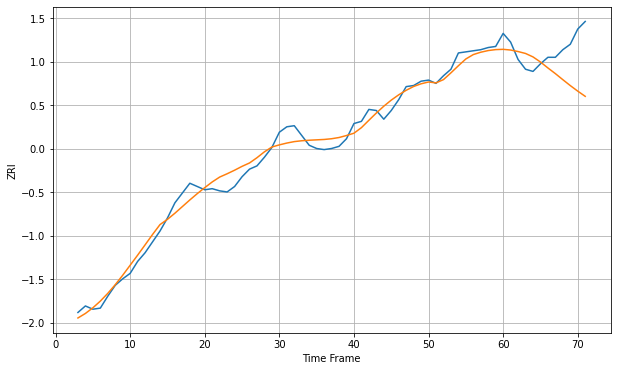

Wall time: 7.07 s
33755 7.790897331969385 30.64572467745436 [1086.33807109 1085.6925871  1084.29929296 1082.52745481 1079.36240433
 1074.66630018 1069.18425037 1063.95740639 1058.38623119 1052.94483624
 1047.83014183 1043.0495768 ]

Got an mse at 0.0099 in round 65 and stopped training



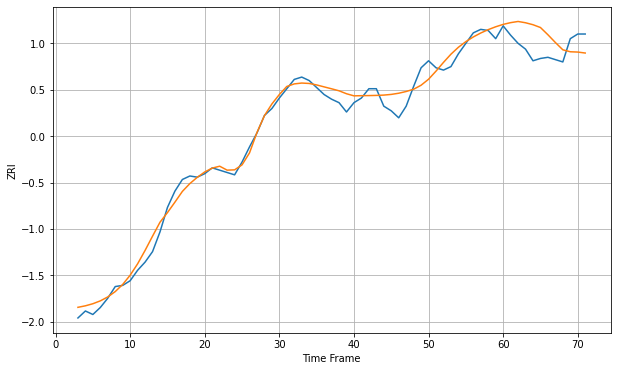

Wall time: 7.69 s
33756 7.6443342516299735 18.226928717337586 [1144.27660152 1145.77295901 1146.78757918 1145.6742268  1143.99286716
 1141.59160105 1135.36662478 1128.71336866 1122.43727107 1120.74978927
 1120.49597266 1119.66684509]

Got an mse at 0.0094 in round 52 and stopped training



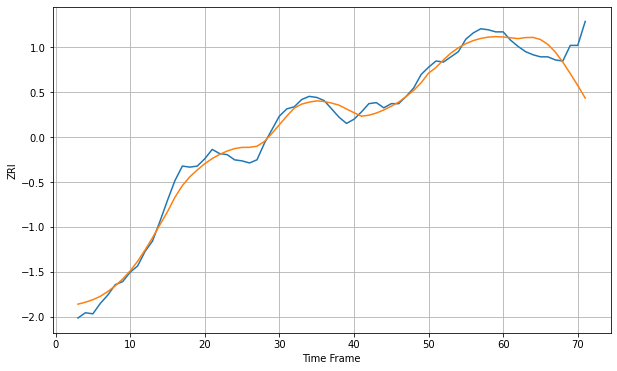

Wall time: 7.11 s
33771 7.7705255982316555 26.873903185237065 [1168.08772389 1167.32727762 1166.50706842 1167.49559085 1167.6827705
 1165.64417436 1160.94625174 1153.53685198 1143.85896015 1132.88063233
 1121.48330284 1109.35702431]

Got an mse at 0.0099 in round 62 and stopped training



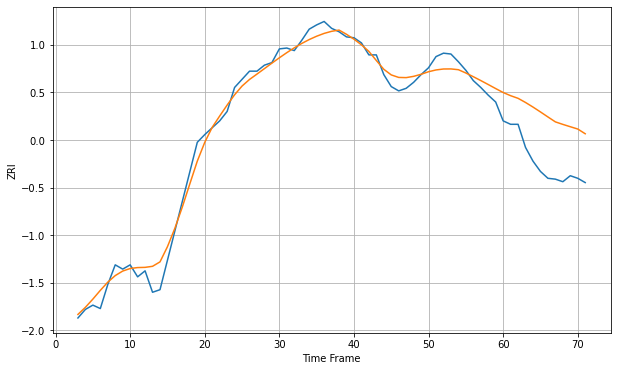

Wall time: 8.52 s
33907 11.205212970141012 56.69453960658488 [1253.11190863 1249.39156605 1246.31007358 1241.4617722  1236.11130284
 1230.42948615 1224.58508255 1218.82925896 1215.89867317 1213.17303067
 1210.48941945 1204.97044258]

Got an mse at 0.0099 in round 68 and stopped training



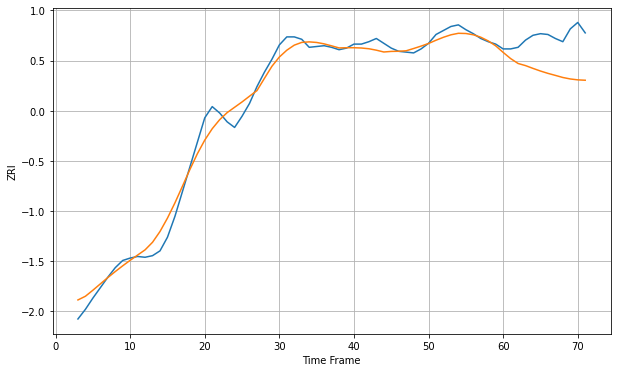

Wall time: 8.08 s
33916 11.559356664097427 45.14425287680055 [1139.66813829 1131.95419725 1125.81995519 1123.16297948 1119.68937027
 1116.39645412 1113.49138998 1110.96262704 1108.34615227 1106.500867
 1105.38400567 1104.91189308]

Got an mse at 0.0099 in round 34 and stopped training



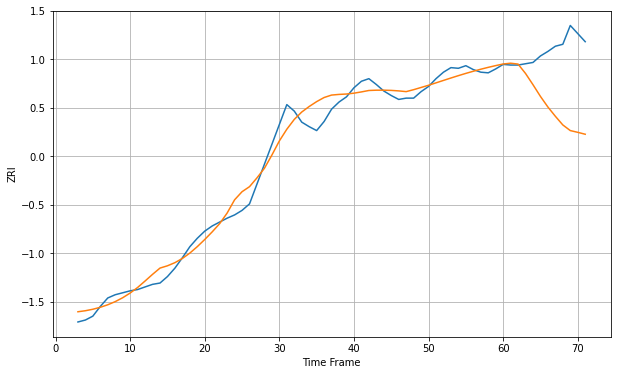

Wall time: 7.05 s
33973 16.07256339279633 95.54299317629973 [1110.60064465 1111.82586234 1110.4668351  1095.99312882 1078.69074842
 1060.61855995 1044.27981799 1029.99150078 1016.66886991 1007.9887624
 1005.29354003 1002.3436763 ]

Got an mse at 0.0100 in round 195 and stopped training



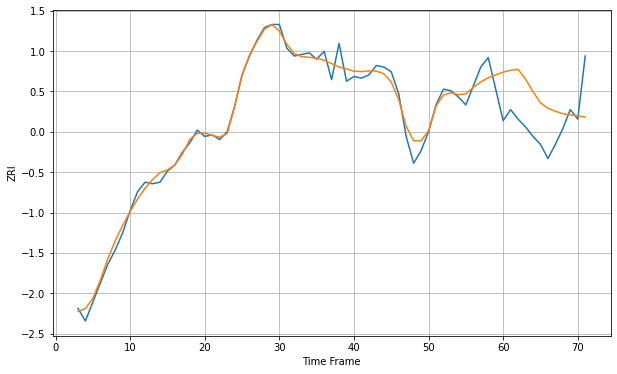

Wall time: 10.4 s
34203 5.1522191053441855 25.878962383040673 [1506.83490885 1507.90921072 1508.56197311 1502.30543529 1494.30683396
 1487.36356323 1483.79337864 1481.98824123 1480.42833589 1479.62947527
 1479.02751355 1478.28558259]

Got an mse at 0.0100 in round 183 and stopped training



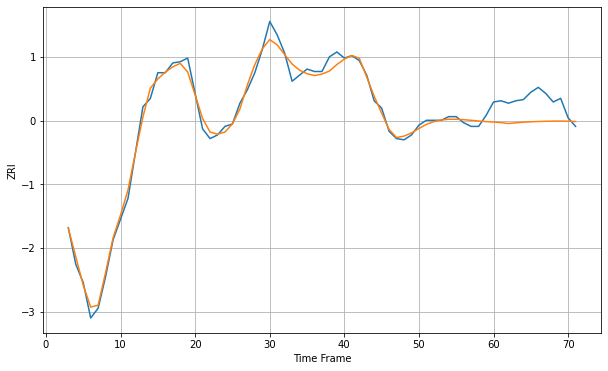

Wall time: 10.5 s
34207 5.3813025810129504 18.352445797744952 [1175.59620437 1175.09813739 1174.39591818 1174.94669648 1175.41331787
 1175.76902609 1176.0258457  1176.20791718 1176.32957118 1176.37132944
 1176.27526371 1175.9896883 ]

Got an mse at 0.0100 in round 197 and stopped training



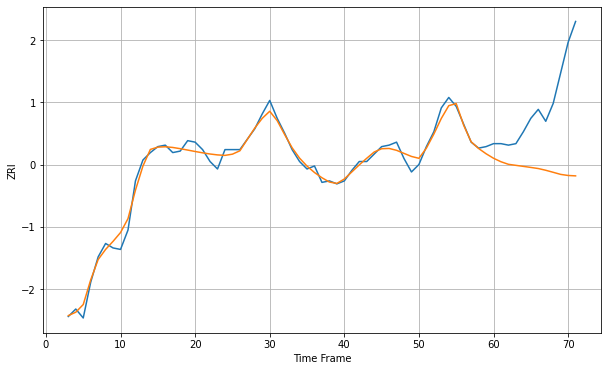

Wall time: 11.3 s
34208 4.226856277393557 50.3413656681353 [1190.19565335 1187.84695662 1186.12391467 1185.43027573 1184.74321465
 1184.03736996 1183.29351361 1182.13069578 1180.76362872 1179.3666814
 1178.63325479 1178.37389563]

Got an mse at 0.0099 in round 155 and stopped training



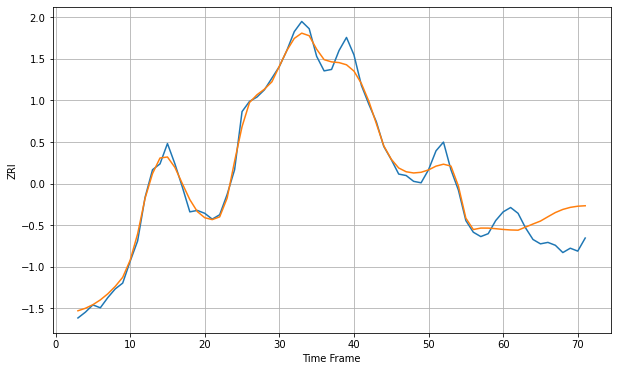

Wall time: 9.45 s
34210 5.614283397063168 20.031894217015065 [1273.91334742 1273.55685798 1273.40174197 1275.52041896 1277.65118037
 1279.6658122  1282.64571659 1285.53668522 1287.67890655 1289.09607315
 1289.89419893 1290.20666662]

Got an mse at 0.0100 in round 183 and stopped training



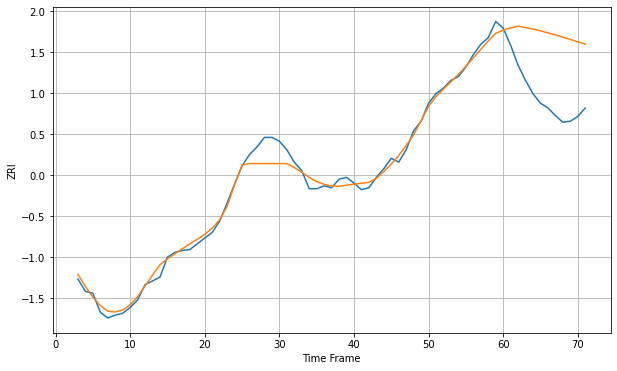

Wall time: 10.8 s
34232 8.40649662378222 67.76153112059755 [1511.93002779 1514.19307574 1516.03499672 1514.63654208 1512.97879407
 1511.1023267  1509.04431482 1506.83929164 1504.51960274 1502.11536385
 1499.65405912 1497.16000871]

Got an mse at 0.0098 in round 38 and stopped training



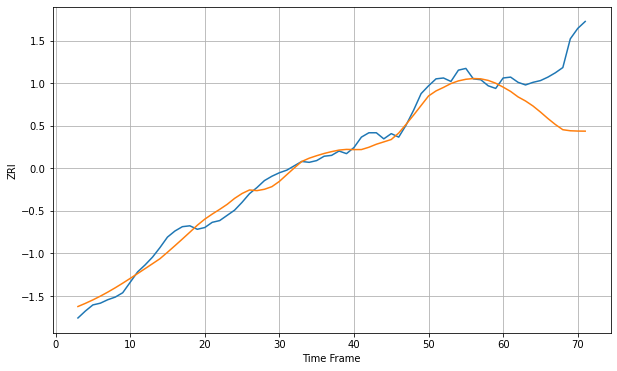

Wall time: 7.54 s
34683 9.269823328726758 67.69354674907966 [1120.48545947 1115.53738128 1109.24261695 1104.53837418 1098.78774231
 1091.8378933  1084.37371729 1077.49357283 1071.51029471 1070.30093718
 1069.96228628 1069.85593136]

Got an mse at 0.0099 in round 45 and stopped training



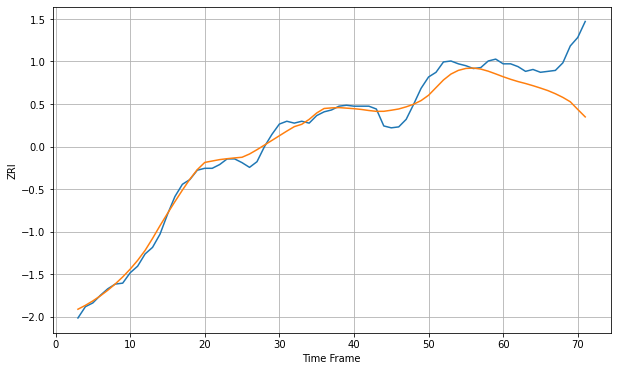

Wall time: 7.77 s
34698 8.713387183604244 44.226877694632144 [1234.28549561 1231.55237641 1229.14285615 1227.07680056 1224.7621064
 1222.24975691 1219.55300631 1216.22778312 1212.34996107 1207.69208069
 1199.54511648 1191.61129885]

Got an mse at 0.0100 in round 296 and stopped training



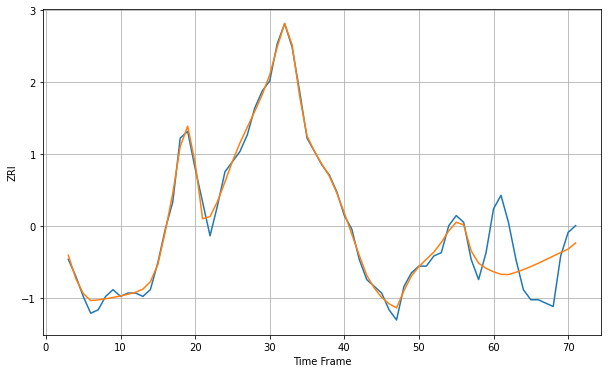

Wall time: 13.1 s
37040 2.089731895435148 12.406317756071774 [734.31736437 733.55321312 733.47911041 734.16049282 734.95539981
 735.85590694 736.84415122 737.89287659 738.96790666 740.0322129
 741.05036765 742.84849531]

Got an mse at 0.0099 in round 311 and stopped training



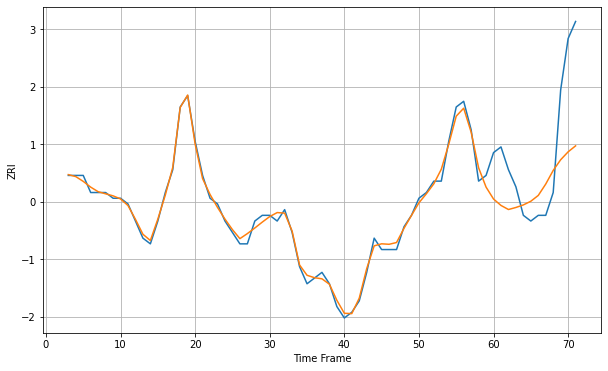

Wall time: 13.6 s
37042 0.89916050549681 10.51467824789949 [713.86279699 712.73620494 712.02166584 712.37799496 712.828677
 713.47040049 714.49414139 716.48954389 718.87807389 720.74996694
 722.13354261 723.18681311]

Got an mse at 0.0099 in round 212 and stopped training



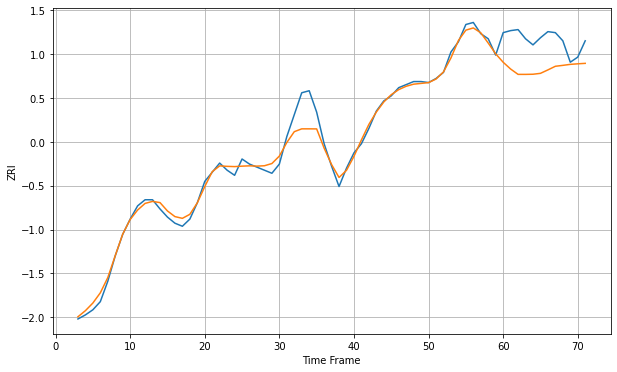

Wall time: 11.1 s
37075 8.632737542453079 30.391922583716127 [1113.97253774 1107.31356319 1102.05411349 1102.0419067  1102.18697057
 1103.061371   1106.44918184 1110.00684459 1110.89894004 1111.88166942
 1112.41711604 1112.87165391]

Got an mse at 0.0100 in round 79 and stopped training



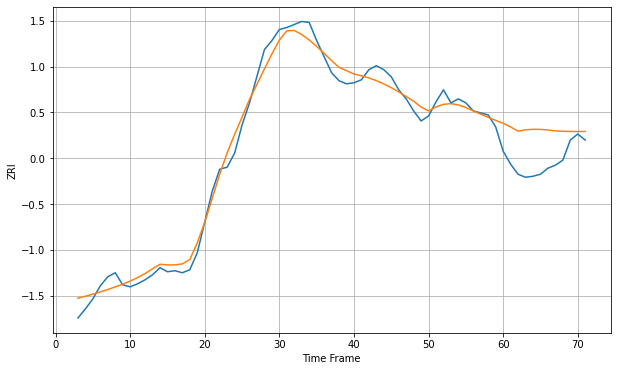

Wall time: 8.54 s
37076 9.654961656901165 34.10560708993398 [1117.62740363 1114.03430585 1109.87300508 1111.15363578 1111.71025152
 1111.61770388 1111.02723123 1110.10461612 1109.76209204 1109.56918417
 1109.47853918 1109.56281388]

Got an mse at 0.0099 in round 58 and stopped training



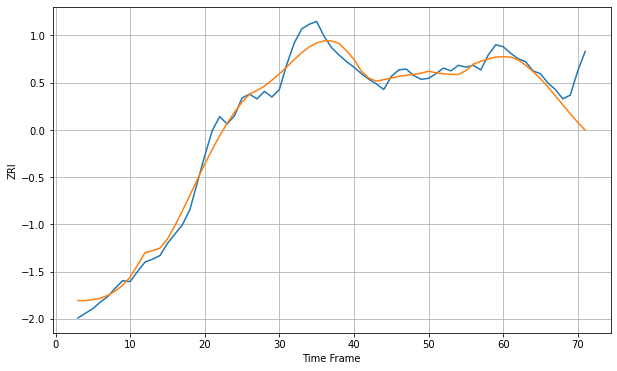

Wall time: 7.32 s
37115 10.718914411284837 30.135996085324134 [1149.23524169 1148.77555197 1145.91225002 1140.15906775 1133.36435065
 1125.59894236 1116.87981283 1107.22099001 1097.48853672 1087.9544945
 1078.84045187 1070.32902746]

Got an mse at 0.0099 in round 82 and stopped training



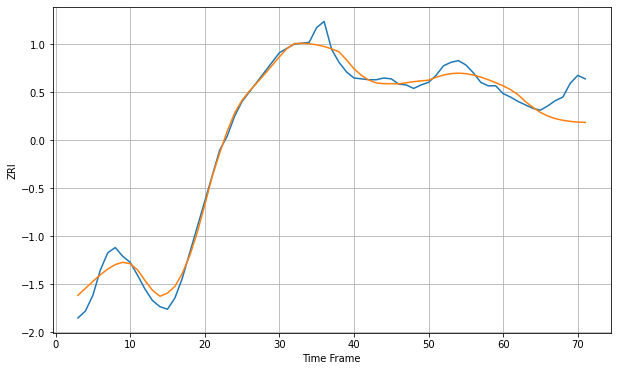

Wall time: 7.56 s
37211 10.388069472375015 27.147390358488163 [1203.9621413  1199.56537836 1193.73194321 1185.76959085 1179.14480653
 1173.40334593 1169.1935619  1166.27038552 1164.32375013 1163.06249535
 1162.29106628 1161.87861813]

Got an mse at 0.0098 in round 72 and stopped training



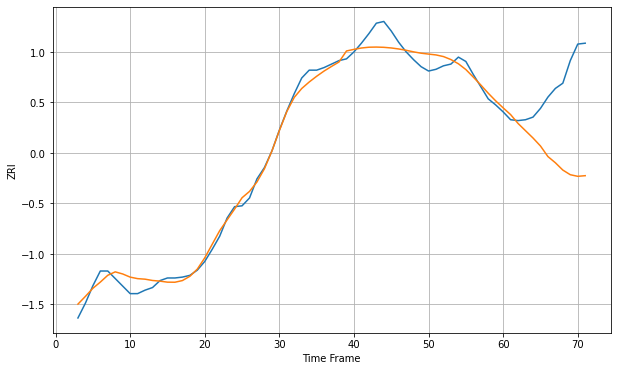

Wall time: 7.51 s
37214 10.411285137859226 85.73423066832788 [1149.62454588 1141.88823452 1131.68940403 1123.33103338 1114.99821821
 1105.81273038 1093.64276079 1086.48937714 1078.09313648 1072.7517013
 1070.91100163 1071.64444896]

Got an mse at 0.0098 in round 58 and stopped training



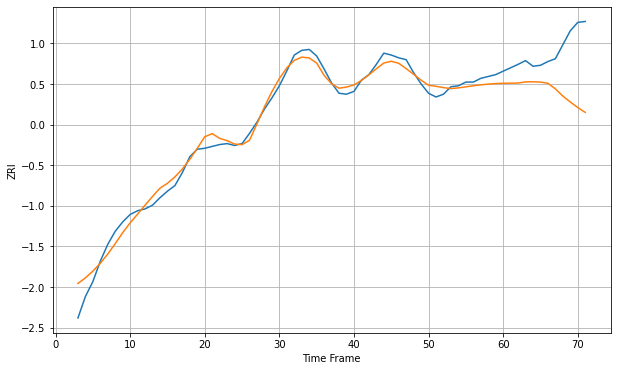

Wall time: 7.88 s
37221 9.00640672383834 50.198223235701505 [1334.68365585 1334.814228   1334.9605214  1336.20301609 1336.29030366
 1336.00881465 1334.68355781 1328.73619589 1321.03297549 1314.63301998
 1308.72980104 1303.50860586]

Got an mse at 0.0100 in round 105 and stopped training



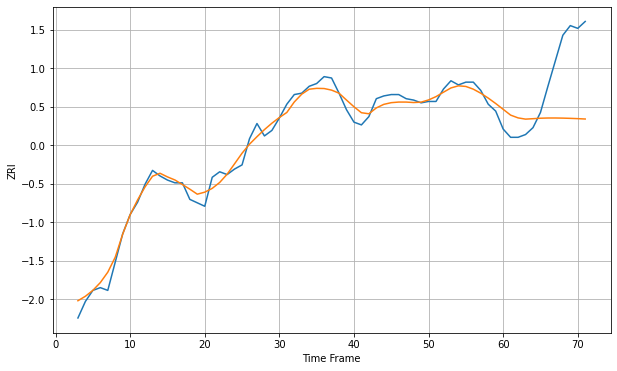

Wall time: 9.26 s
38104 5.549524185523921 41.35108590145247 [799.30727423 795.09830152 793.08559247 792.17989459 792.50091306
 792.84202452 792.99382535 793.00483771 792.911725   792.74856232
 792.53969036 792.27088082]

Got an mse at 0.0099 in round 296 and stopped training



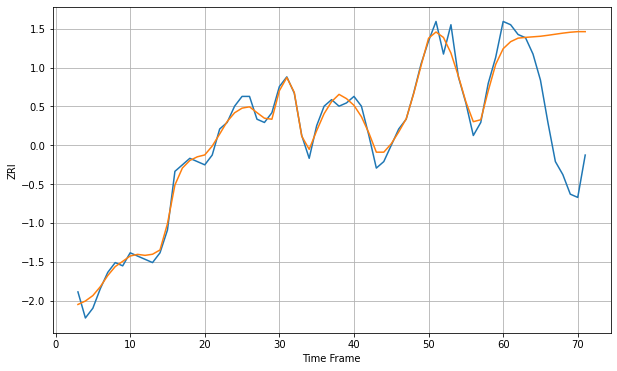

Wall time: 13.2 s
40391 2.577686108990643 30.17931498273878 [824.63417916 826.79319692 827.87563122 828.11182887 828.28712698
 828.46192823 828.758442   829.09107657 829.41779878 829.69799893
 829.87656354 829.87338632]

Got an mse at 0.0099 in round 102 and stopped training



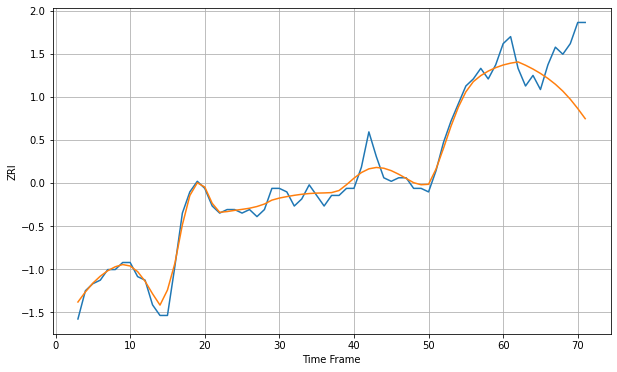

Wall time: 7.9 s
40502 2.494835233140732 12.828560657918926 [813.94900907 814.4729291  814.8209355  813.88298874 812.80176583
 811.56485865 810.14510795 808.49519658 806.5509351  804.25591414
 801.61393376 798.74872174]

Got an mse at 0.0100 in round 245 and stopped training



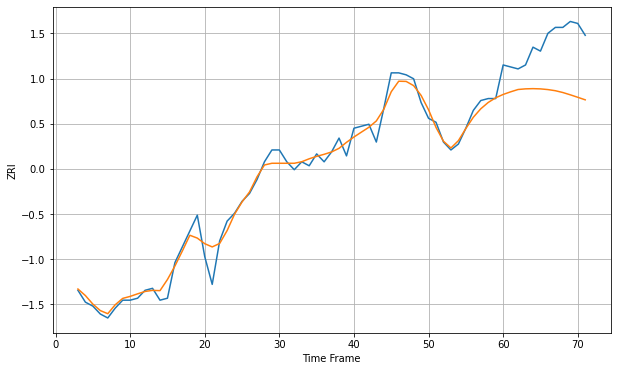

Wall time: 11.8 s
40515 4.743108622984157 26.142701086640617 [890.0803147  891.39876566 892.58251099 892.90665734 893.01404345
 892.89404503 892.54123842 891.9647943  891.05708948 889.89130149
 888.64413967 887.35380345]

Got an mse at 0.0100 in round 206 and stopped training



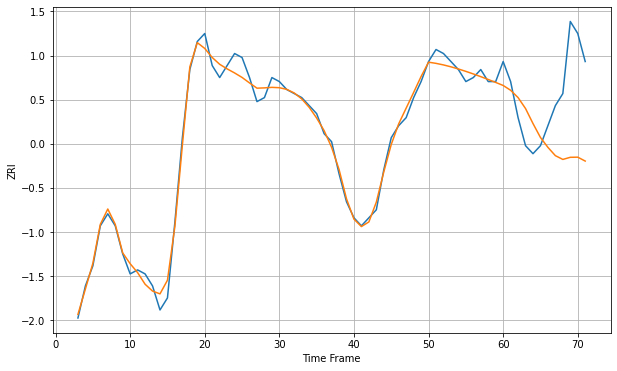

Wall time: 10.9 s
40517 1.9659121846512293 16.79961790256876 [875.03024305 873.83017977 872.00518808 869.27106888 865.52646875
 862.04876606 859.57879949 857.50824962 856.57007639 857.09882948
 857.13270083 856.15900829]

Got an mse at 0.0100 in round 50 and stopped training



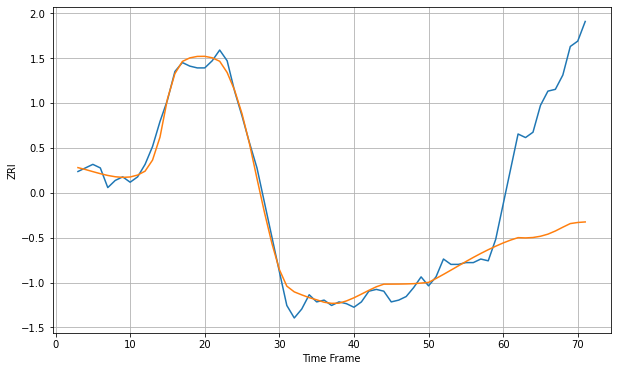

Wall time: 8.35 s
43055 4.940234843590531 76.43418056214728 [639.00558281 640.60607556 641.97563198 641.82302817 642.04999748
 642.7429012  643.92724395 645.69668351 647.82329465 649.84800217
 650.46021269 650.76281953]

Got an mse at 0.0099 in round 92 and stopped training



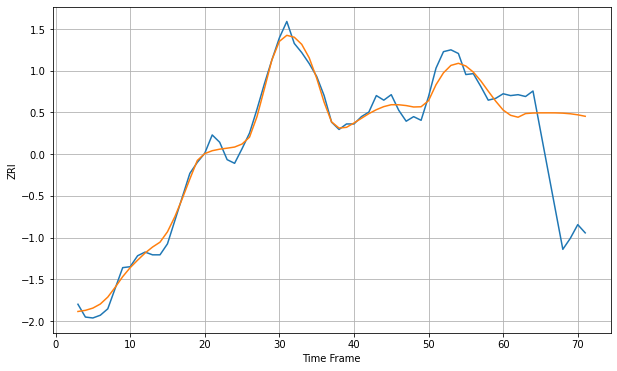

Wall time: 8.51 s
43201 9.56303729123339 86.18066336305485 [1093.21351558 1087.44186922 1085.36792363 1089.33687492 1089.95428233
 1090.12558503 1090.13992605 1090.09696512 1089.81023467 1089.13861182
 1088.00369051 1086.39338247]

Got an mse at 0.0099 in round 77 and stopped training



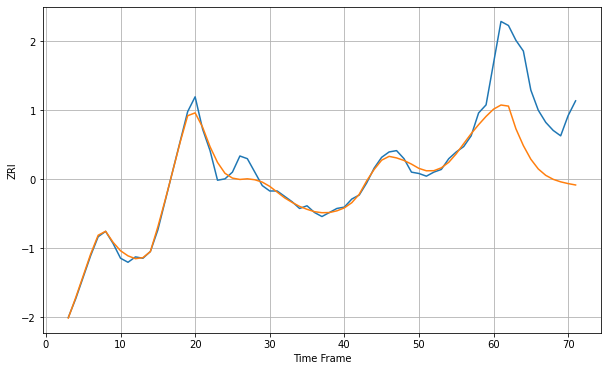

Wall time: 8.22 s
43202 4.837898643886034 52.38583376312223 [936.80296084 939.89753885 939.08314511 922.23830075 909.71471986
 899.60928408 892.35812783 887.61474342 884.66086874 882.79050923
 881.48720022 880.45944674]

Got an mse at 0.0099 in round 64 and stopped training



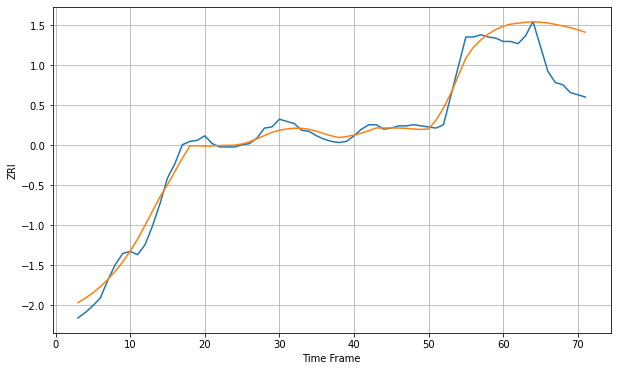

Wall time: 7.99 s
43204 7.374954711048864 39.893114378378996 [982.7380161  984.60635155 985.40891417 986.31648096 986.60960612
 986.36377127 985.68504822 984.31372553 982.97985742 981.43853295
 979.53920624 977.33180494]

Got an mse at 0.0100 in round 101 and stopped training



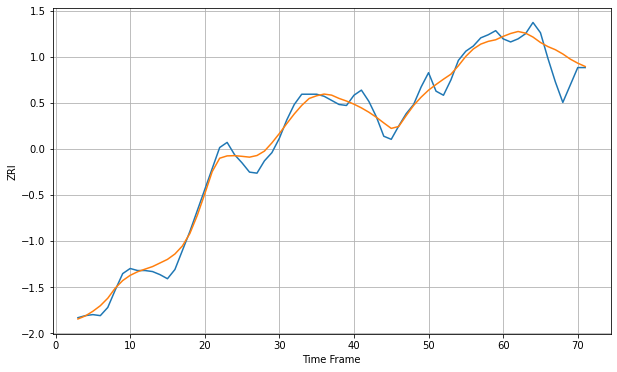

Wall time: 8.27 s
43205 8.53303390061199 19.206230444760855 [896.42038495 899.23653251 901.18826352 899.60540275 895.7573092
 890.49981967 886.45866975 883.41231417 879.25454564 874.24276644
 870.28445501 867.06156536]

Got an mse at 0.0100 in round 57 and stopped training



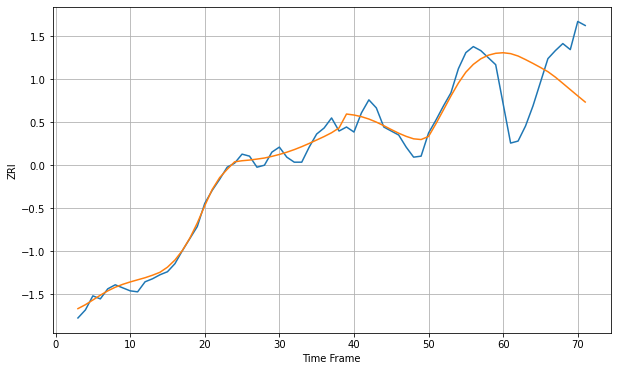

Wall time: 7.15 s
43206 8.783992472751963 57.25534484269098 [1000.88893605  999.99708719  997.62827344  994.07450578  990.2593538
  986.22937055  982.03663562  976.59075408  970.43201437  964.19309794
  957.96161309  951.84265147]

Got an mse at 0.0100 in round 192 and stopped training



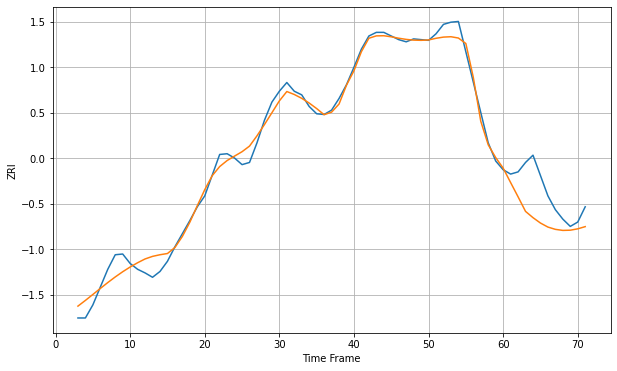

Wall time: 11 s
43212 12.380973552503923 42.017114232292585 [1082.18982575 1062.3559047  1042.7379198  1022.65890177 1014.04192415
 1006.63293181 1001.08508223  997.95221984  996.49614549  996.79055512
  998.65506173 1001.67953074]

Got an mse at 0.0100 in round 261 and stopped training



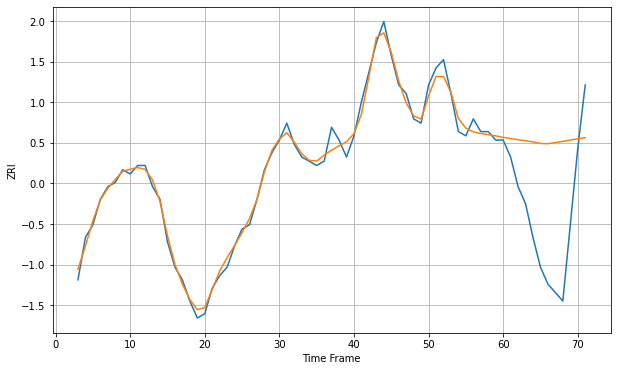

Wall time: 12.2 s
44035 1.709374086041254 22.465054199248023 [672.63181469 672.36701215 672.07070839 671.85388126 671.54472734
 671.20088414 671.14661659 671.3969428  671.69199872 672.009413
 672.31381025 672.57179197]


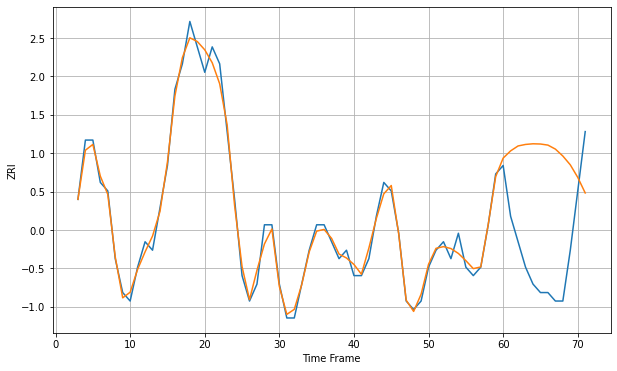

Wall time: 17.4 s
44052 1.0184720215897543 13.083000671173334 [619.87338896 620.72385508 621.30554957 621.48403021 621.56133783
 621.53460858 621.40639319 620.9347686  620.11828561 619.07639318
 617.59522334 615.7568961 ]

Got an mse at 0.0099 in round 55 and stopped training



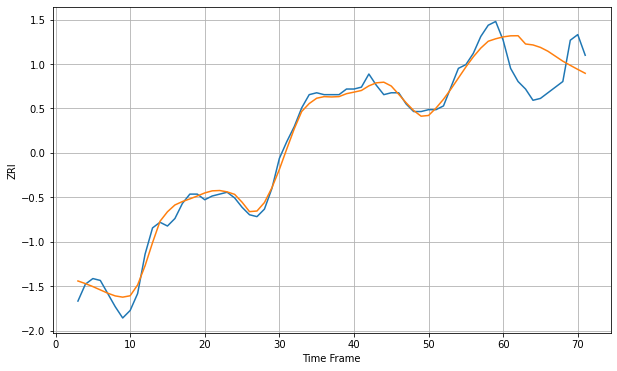

Wall time: 7.77 s
44102 4.460974966281475 19.535124029501613 [855.7828457  856.34621243 856.40056676 852.00301284 851.49255116
 850.17588923 848.14751258 845.4946912  842.84197069 840.61389439
 838.4614892  836.38169834]


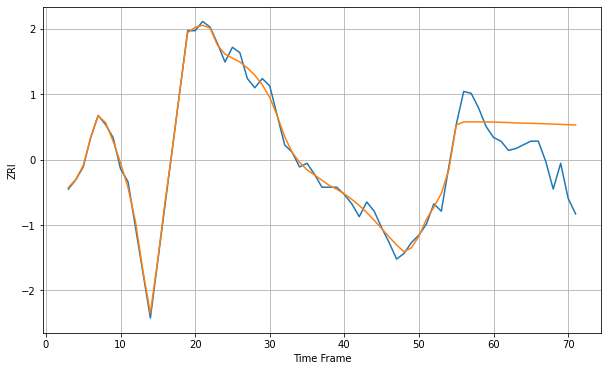

Wall time: 18.7 s
44103 4.552884665080462 24.072596832068662 [871.38910704 871.25524684 871.11686152 870.89613684 870.79023815
 870.6873664  870.57308829 870.42366626 870.26975011 870.11026011
 869.94419555 869.76953111]

Got an mse at 0.0098 in round 63 and stopped training



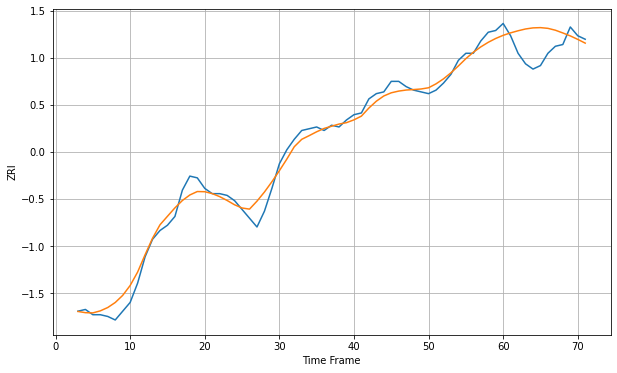

Wall time: 7.57 s
44107 4.949975456733444 12.880693508229266 [871.23582192 872.64923481 873.83570119 874.85769169 875.47810975
 875.62859053 875.21804595 874.15384806 872.5881358  870.91570162
 868.92815941 866.79081904]

Got an mse at 0.0100 in round 259 and stopped training



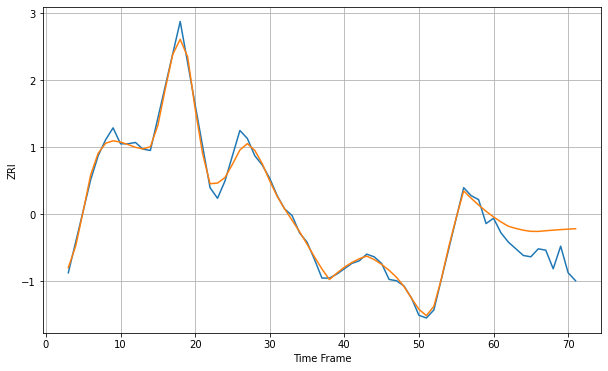

Wall time: 12.4 s
44108 4.508987145903194 20.74681985543787 [793.0019025  789.23258343 785.9623356  784.31486156 783.00698226
 782.15390563 782.1021001  782.60264457 783.05452261 783.4547797
 783.80680623 784.11689693]

Got an mse at 0.0099 in round 116 and stopped training



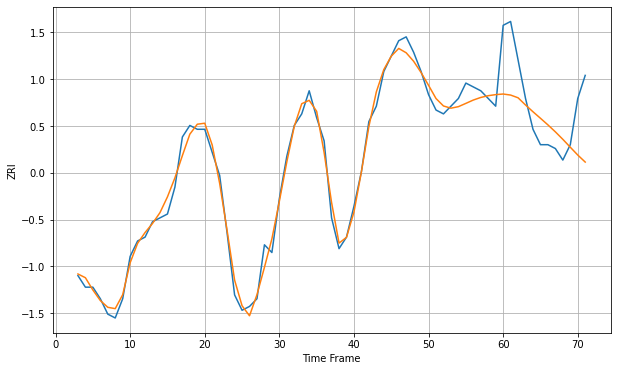

Wall time: 8.62 s
44109 2.3926909524698945 11.718366617991833 [720.15756178 719.88888548 719.18039835 717.30625067 715.54956632
 713.85979129 712.14407488 710.33275638 708.39132709 706.34374395
 704.3155818  702.48684964]

Got an mse at 0.0100 in round 148 and stopped training



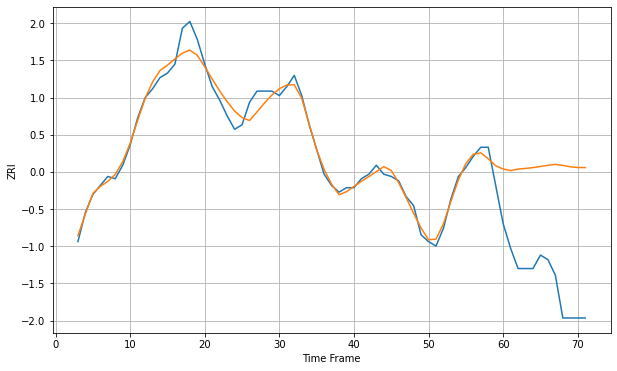

Wall time: 10.6 s
44110 4.0653893470829665 51.33825550963527 [734.29586276 733.64212152 734.2718405  734.57339333 734.95070298
 735.43669808 735.95688638 736.38199708 735.92304391 735.3053691
 735.00155606 734.95302112]

Got an mse at 0.0099 in round 105 and stopped training



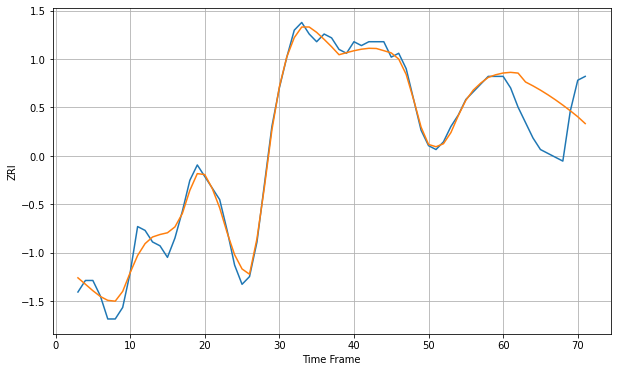

Wall time: 8.37 s
44111 2.3178167978146202 11.304887015353886 [761.87421139 762.04665283 761.85466664 759.54357604 758.53228752
 757.42421643 756.22024816 754.9251292  753.53988668 752.06929236
 750.52134389 748.74474963]

Got an mse at 0.0099 in round 209 and stopped training



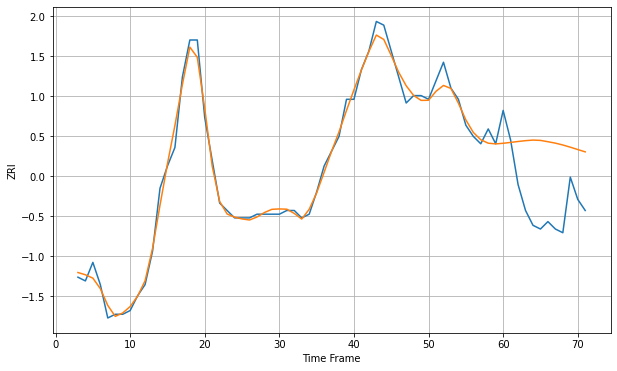

Wall time: 11.4 s
44112 2.233127080365266 17.62540737024479 [683.13355244 683.36759672 683.61530003 683.84222369 683.99575172
 683.91194439 683.55540216 683.17217399 682.67275613 682.082251
 681.44713322 680.8171792 ]

Got an mse at 0.0099 in round 168 and stopped training



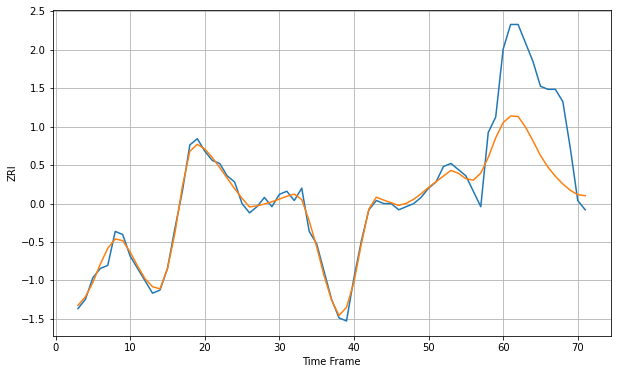

Wall time: 10.6 s
44118 2.697653425059956 23.42446913828412 [959.24226327 961.34470576 961.21958514 957.74529558 953.29174302
 948.58143194 944.84988926 941.83330247 939.36181877 937.30386289
 935.87843577 935.5615257 ]

Got an mse at 0.0099 in round 110 and stopped training



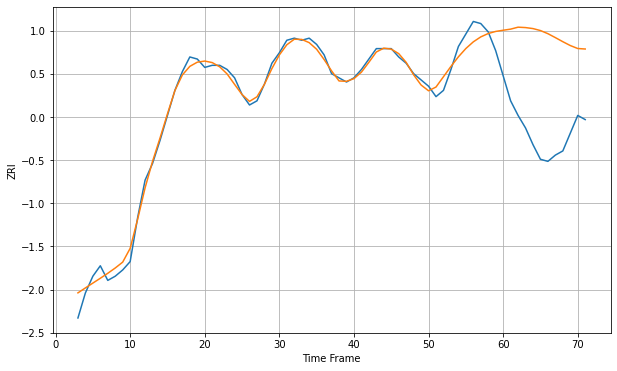

Wall time: 9.03 s
44120 3.6662246811309953 46.73873407245018 [862.79847366 863.32601905 864.2640712  864.07286823 863.59243097
 862.64513457 861.14933314 859.26386075 857.30951474 855.46967874
 854.0489336  853.8087616 ]

Got an mse at 0.0100 in round 336 and stopped training



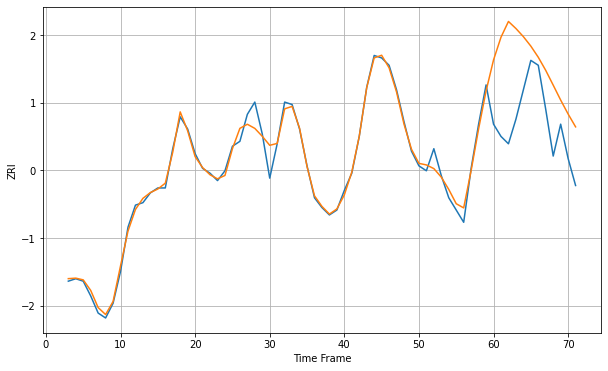

Wall time: 14.6 s
44133 3.07587306558642 27.03982977287803 [1038.17019121 1047.43799129 1053.86063776 1050.98962438 1047.67352382
 1043.81421763 1039.26721225 1033.91147307 1027.90743169 1021.82179468
 1016.13051559 1010.89945412]

Got an mse at 0.0100 in round 241 and stopped training



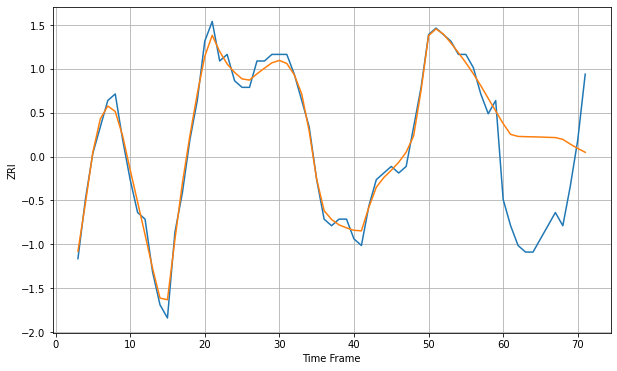

Wall time: 11.9 s
44646 1.3255904391711906 13.273520821856152 [645.49969198 643.8618169  643.5545922  643.51462748 643.49241892
 643.45806564 643.41619398 643.37721376 643.1052787  642.37987355
 641.73482998 641.14238052]

Got an mse at 0.0099 in round 167 and stopped training



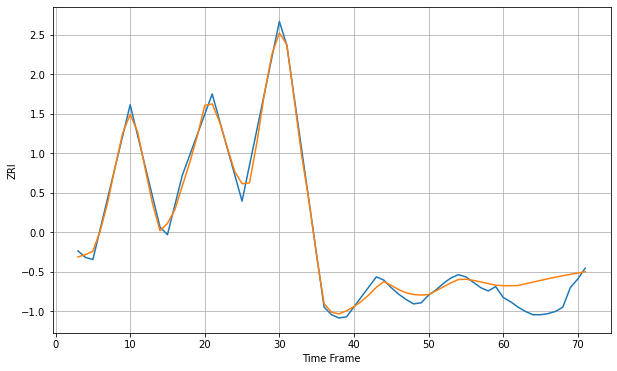

Wall time: 11.1 s
44720 6.045794354319477 23.057400178646063 [687.82380001 687.79944771 687.9953137  689.56553441 691.12824428
 692.69647343 694.24109655 695.67925335 697.02285415 698.29439418
 699.51877167 700.71959543]

Got an mse at 0.0100 in round 58 and stopped training



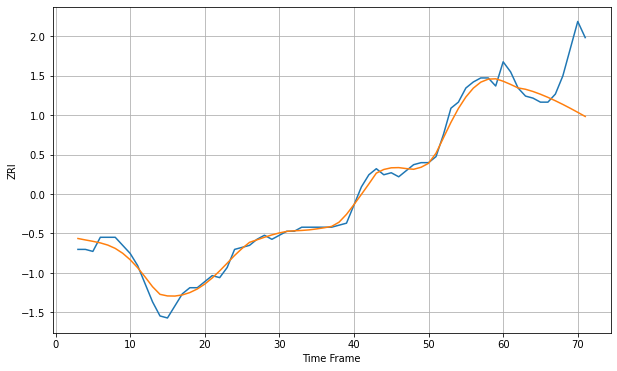

Wall time: 7.86 s
45205 3.6207086268139776 20.0340448064508 [680.37308809 678.79033929 677.05407476 676.38558913 675.28512868
 673.91822066 672.37366703 670.68659468 668.87359564 666.95294713
 664.95069519 662.89920732]

Got an mse at 0.0099 in round 59 and stopped training



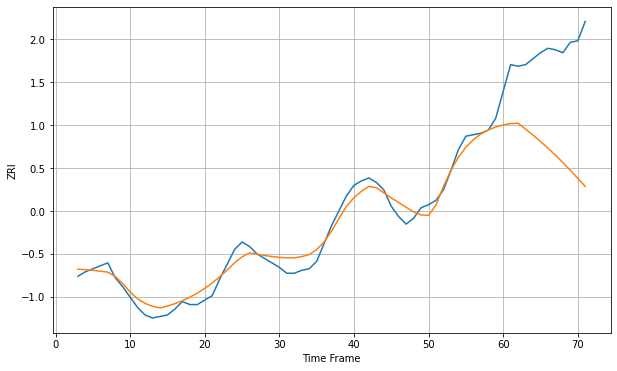

Wall time: 8.06 s
45211 5.966259063891555 67.47160970396538 [765.53766495 766.45819817 766.69779823 762.81804784 758.70234471
 754.43784228 749.99706177 745.30720393 740.33127679 735.10952946
 729.74878472 724.32632876]

Got an mse at 0.0099 in round 31 and stopped training



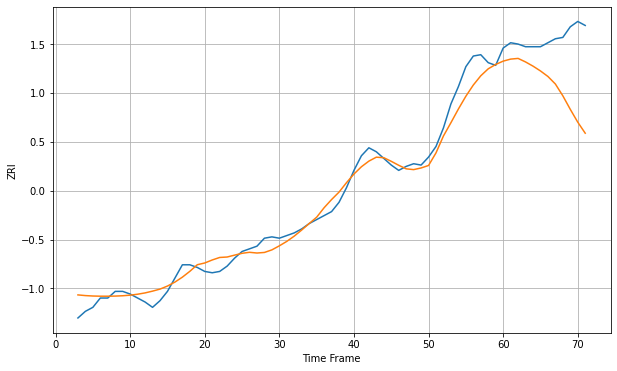

Wall time: 7.37 s
45212 8.19180254067738 41.76203321572855 [851.16063099 852.68743408 853.21427294 850.56389609 847.41208696
 843.79499958 839.63234627 833.96174112 825.09129018 814.89917715
 805.2634929  796.96652234]

Got an mse at 0.0099 in round 36 and stopped training



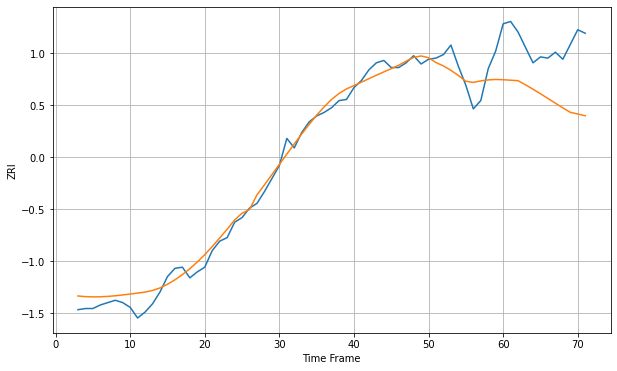

Wall time: 7 s
45219 9.230949912410116 47.31081356880515 [985.68099411 985.27741048 984.86769337 981.36256374 977.67307971
 973.81507031 969.82375618 965.81912854 961.88746315 958.06697894
 956.69701439 955.14990439]

Got an mse at 0.0098 in round 116 and stopped training



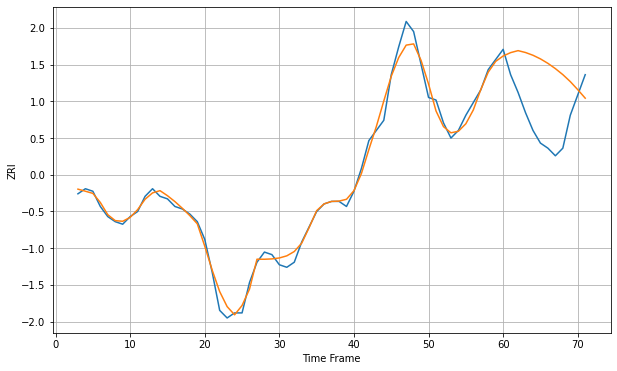

Wall time: 10 s
45405 2.8850434451393636 22.939284102259037 [621.37428403 622.70413405 623.48837221 622.74788498 621.65954854
 620.23098141 618.47049774 616.39379551 614.02300803 611.27199429
 608.0940709  604.7272456 ]

Got an mse at 0.0100 in round 150 and stopped training



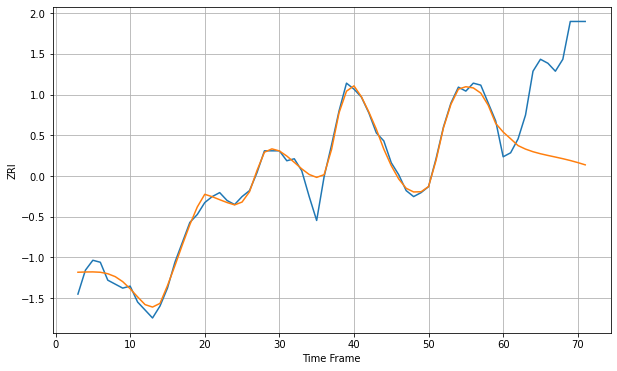

Wall time: 9.46 s
45840 4.232368512257447 46.55096001343299 [802.43590604 799.06923595 795.61133195 793.86162184 792.54595663
 791.52734472 790.67152392 789.86976673 789.0396872  788.12395742
 787.09328614 785.95219635]

Got an mse at 0.0100 in round 203 and stopped training



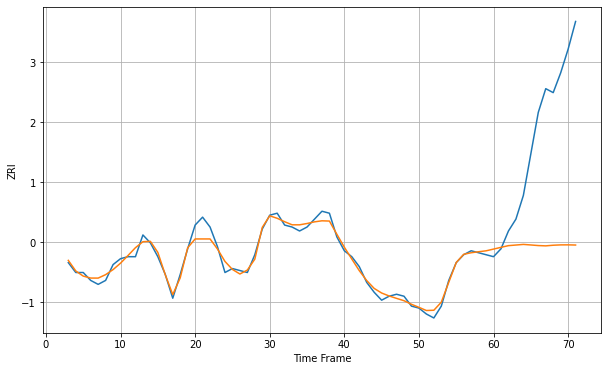

Wall time: 11.6 s
46143 2.853099972260524 64.52872340446305 [880.84781563 881.73452083 882.59210321 882.89777017 883.21388211
 882.93484588 882.63284572 882.48229121 882.80141675 882.97135583
 882.9919795  882.89987035]

Got an mse at 0.0100 in round 190 and stopped training



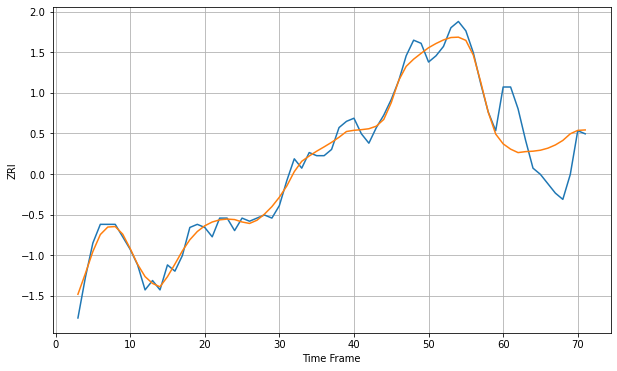

Wall time: 10.7 s
46201 2.80874464589284 12.661858567997815 [659.78556223 658.09151318 656.98115089 657.29794067 657.43612472
 657.7502643  658.40721321 659.44113029 660.88295308 663.00868118
 664.10073187 664.24582006]

Got an mse at 0.0099 in round 115 and stopped training



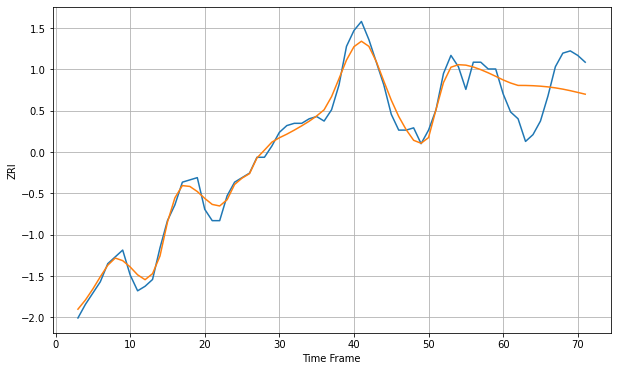

Wall time: 8.98 s
46203 3.994695956397135 15.45978683878739 [772.16941038 770.80609876 769.74715326 769.72510067 769.61562727
 769.41031038 769.09757266 768.66396255 768.10170487 767.42104032
 766.6584607  765.86822858]

Got an mse at 0.0099 in round 79 and stopped training



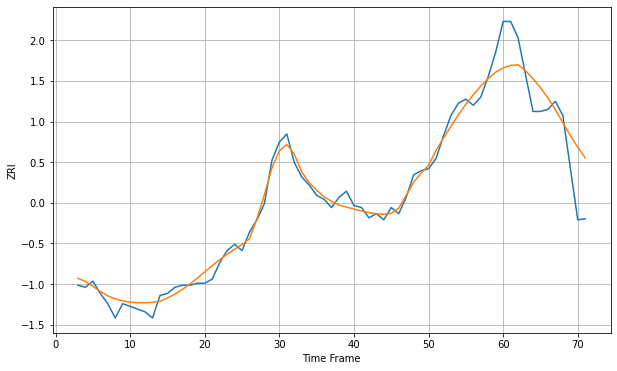

Wall time: 8.4 s
46208 3.8505367961709354 18.27570955239228 [851.27719399 852.47566936 852.82693087 849.92805353 845.9932857
 841.62363037 836.61815567 830.84664243 824.54157029 818.27886798
 812.5148383  807.31951843]

Got an mse at 0.0099 in round 199 and stopped training



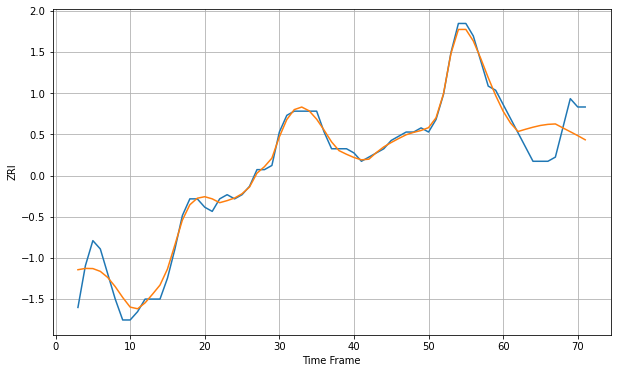

Wall time: 11.1 s
46219 2.2054130058334853 6.291066213808047 [657.98128916 655.11752223 653.12921988 653.66702901 654.15996827
 654.57995952 654.83722692 654.93967743 653.99949497 653.07902724
 652.14098789 651.14515675]

Got an mse at 0.0099 in round 120 and stopped training



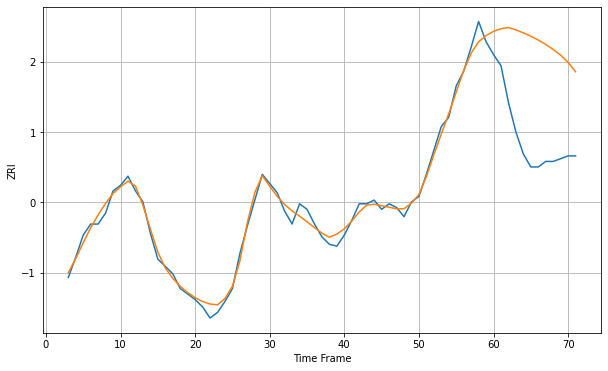

Wall time: 8.76 s
46312 3.5714080567427624 53.978204198206335 [918.64225076 920.03282026 920.74284225 919.39416396 917.81500454
 915.99342138 913.90908248 911.53060172 908.81185167 905.6890615
 901.73726899 896.69773789]

Got an mse at 0.0100 in round 225 and stopped training



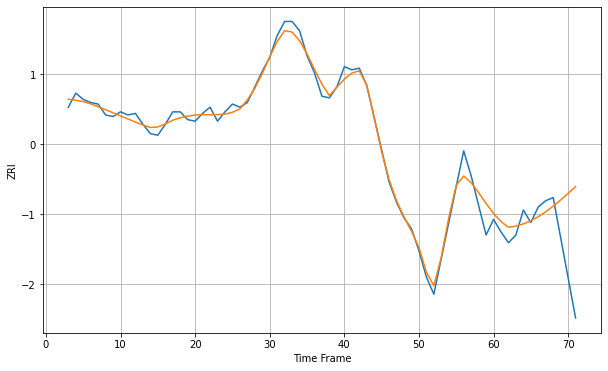

Wall time: 12.3 s
47374 4.949059053570901 30.29682816911587 [674.81038495 669.62476382 665.92799348 666.69260716 668.10842132
 670.14686538 672.76599938 675.90827656 679.500259   683.45510729
 687.67449286 692.0403042 ]

Got an mse at 0.0099 in round 158 and stopped training



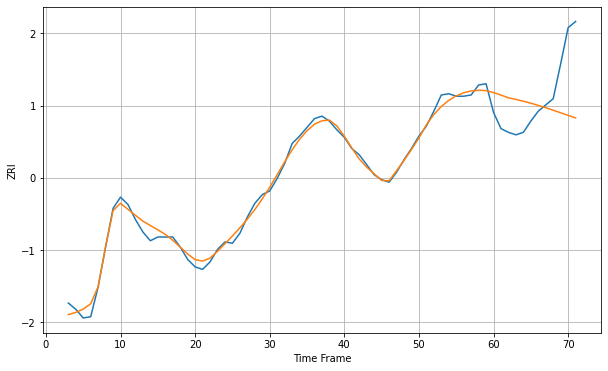

Wall time: 9.96 s
47401 4.377576985760874 36.49866860080975 [1329.9111171  1327.89912842 1325.70555464 1324.44936687 1323.00726592
 1321.39501002 1319.63146268 1317.7415692  1315.75683637 1313.712356
 1311.64267862 1309.57969007]

Got an mse at 0.0099 in round 100 and stopped training



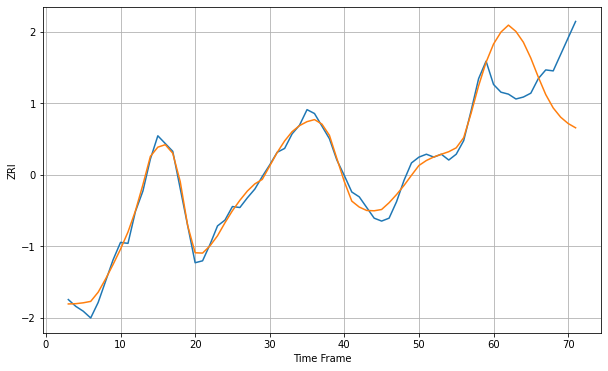

Wall time: 8.77 s
47408 7.184400642131623 62.036180270843566 [1435.70269037 1448.07193602 1455.22262909 1448.70766633 1437.56812485
 1421.17420275 1401.65258396 1383.55435336 1369.75699756 1360.21495552
 1353.69925837 1349.26120636]

Got an mse at 0.0100 in round 83 and stopped training



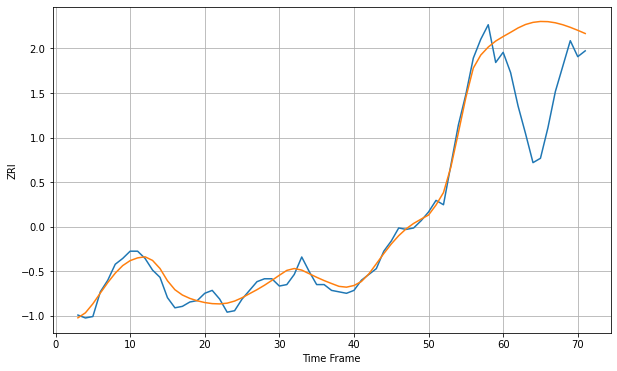

Wall time: 8.38 s
48186 6.047438114435415 55.23115318145988 [1007.86581996 1010.7706504  1013.79312362 1016.16203973 1017.61927379
 1018.24706264 1018.12224588 1017.33097083 1015.98189292 1014.20822629
 1012.15501034 1009.95681259]

Got an mse at 0.0100 in round 245 and stopped training



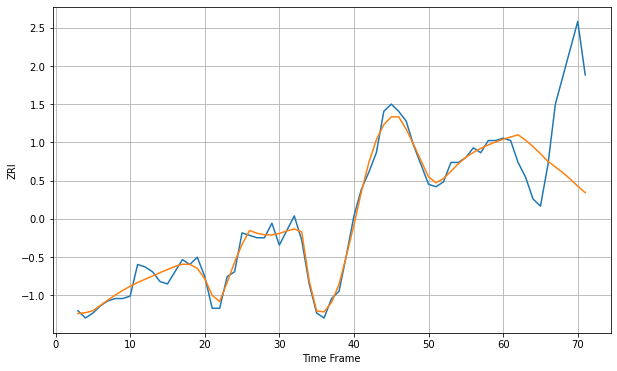

Wall time: 12.1 s
48195 3.1501061549411893 33.32619504235402 [859.53711495 860.48180562 861.35915562 859.16391872 856.529174
 853.57681551 850.47781055 848.14458118 845.77894119 843.13943815
 840.22630042 837.59029992]

Got an mse at 0.0099 in round 66 and stopped training



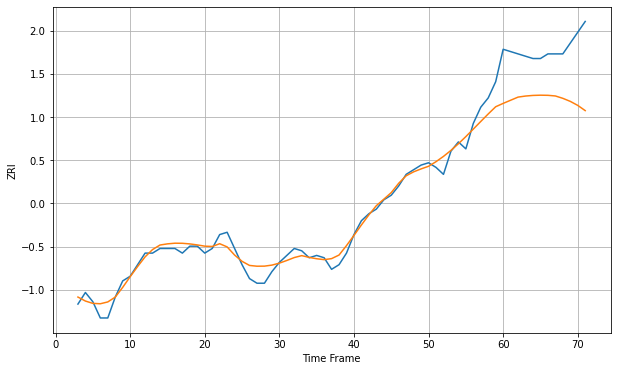

Wall time: 7.73 s
48235 3.6807583281314176 22.84538686300186 [734.63463236 735.99198603 737.34884354 737.80622878 738.07402673
 738.17334822 738.1170739  737.84091347 736.82056108 735.50095852
 733.77037446 731.51471927]

Got an mse at 0.0082 in round 271 and stopped training



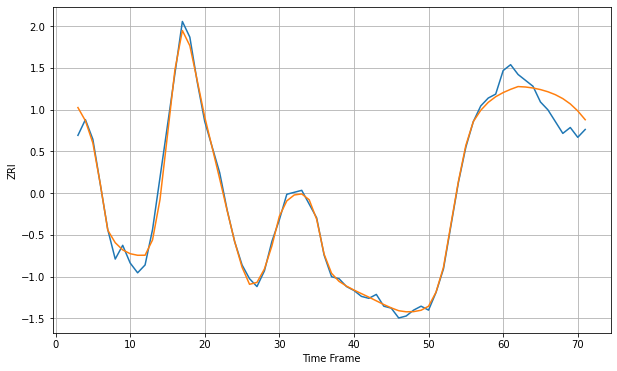

Wall time: 13.1 s
52001 3.621960929152741 10.445390985618138 [760.78458245 762.43997435 763.84603918 763.62456138 763.11405341
 762.31397217 761.20054669 759.70668284 757.7059136  755.01434913
 751.44643163 746.9643544 ]

Got an mse at 0.0100 in round 228 and stopped training



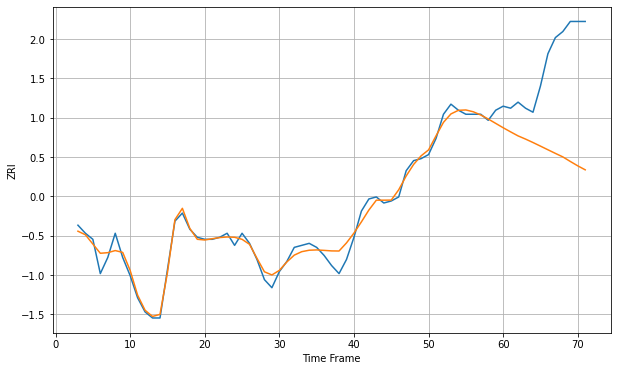

Wall time: 11.8 s
53140 3.716103224123281 47.12724217970437 [843.31481747 841.26381619 839.26981944 837.68989732 835.98376449
 834.20133683 832.39376083 830.60235877 828.85578231 826.59871501
 824.42641764 822.44727456]

Got an mse at 0.0100 in round 106 and stopped training



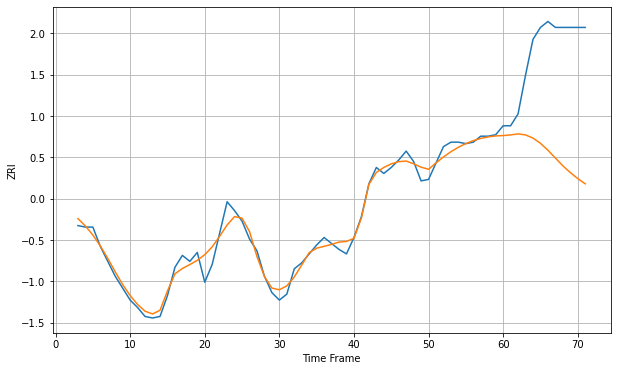

Wall time: 8.77 s
53143 5.3299884227265295 74.65575317187559 [865.43137205 865.87531844 866.52937453 865.86199031 863.7412994
 860.22995578 855.59557646 850.37074759 845.12814754 840.59070505
 836.53980146 833.03489851]

Got an mse at 0.0099 in round 422 and stopped training



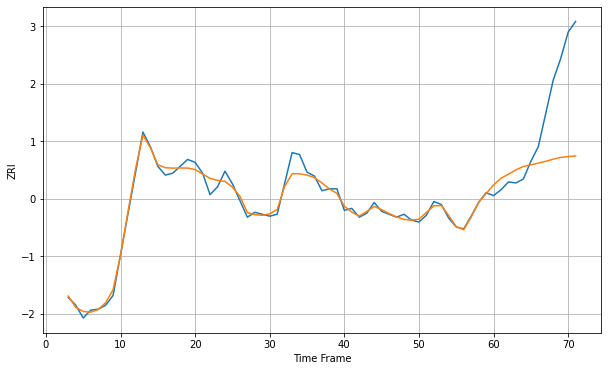

Wall time: 16.9 s
53202 5.857795436546542 67.75522746071529 [1131.83568346 1138.78234187 1142.88832635 1147.26560262 1150.87872532
 1152.44443875 1154.18981656 1156.11809835 1158.1982188  1160.09548323
 1160.94001204 1161.56129872]

Got an mse at 0.0100 in round 113 and stopped training



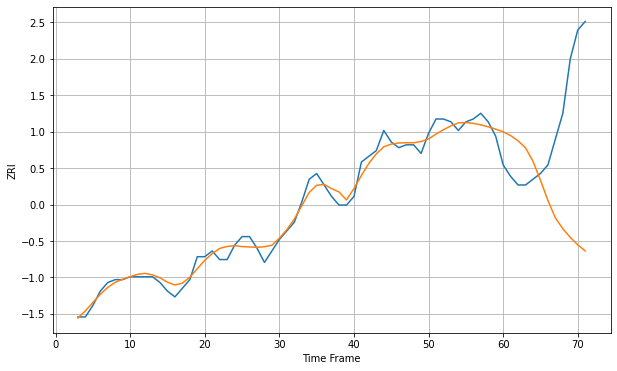

Wall time: 9.51 s
53204 2.6714123909751644 39.9884718740292 [709.5600265  708.21941084 706.38060169 703.95205109 699.26030879
 692.68223602 685.62921999 679.53845067 675.74299799 672.74501649
 670.14882521 668.01221178]

Got an mse at 0.0099 in round 91 and stopped training



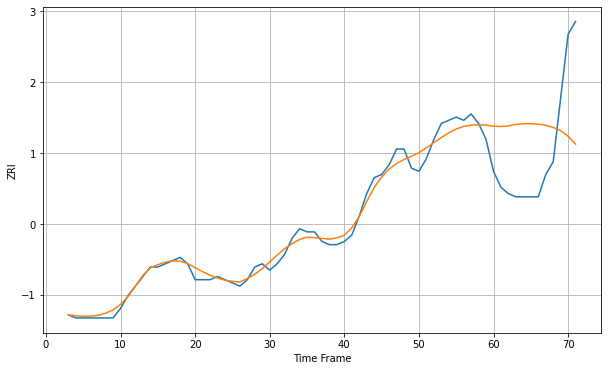

Wall time: 8.7 s
53206 2.279976388508757 22.480368032199824 [716.1733315  716.03811931 716.25613588 716.70721344 716.9166847
 716.91299967 716.80423343 716.42809381 715.75002026 714.75036362
 713.00814383 710.51242773]

Got an mse at 0.0097 in round 27 and stopped training



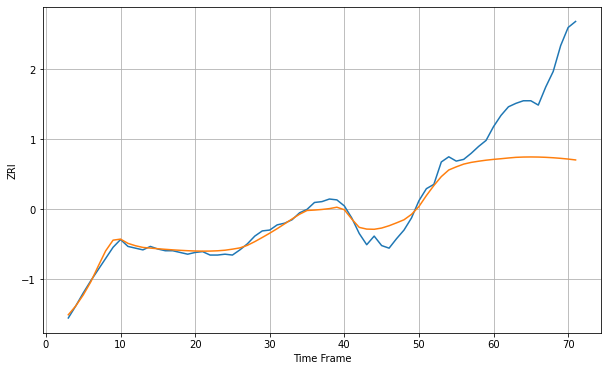

Wall time: 7.37 s
53207 8.931653224361034 94.19446619172936 [940.9953195  941.75803439 942.61979526 943.36285771 943.69753467
 943.80205996 943.69189725 943.38044351 942.88024691 942.2043913
 941.36753647 940.34194506]

Got an mse at 0.0100 in round 36 and stopped training



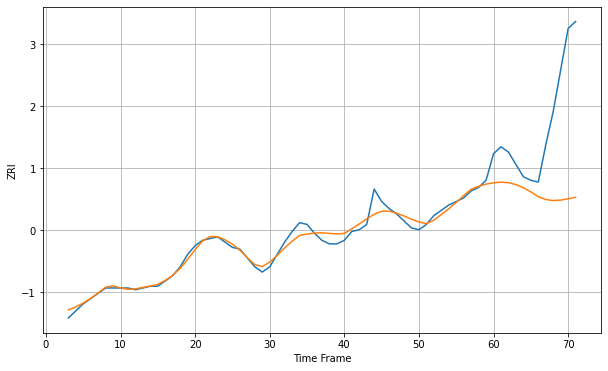

Wall time: 7.27 s
53208 3.321127493457536 49.513453728539744 [744.55913168 744.96873126 744.66667497 743.59496762 741.81512016
 739.43292813 736.73585695 735.09464572 734.53376024 734.7892493
 735.52605348 736.37692152]

Got an mse at 0.0100 in round 113 and stopped training



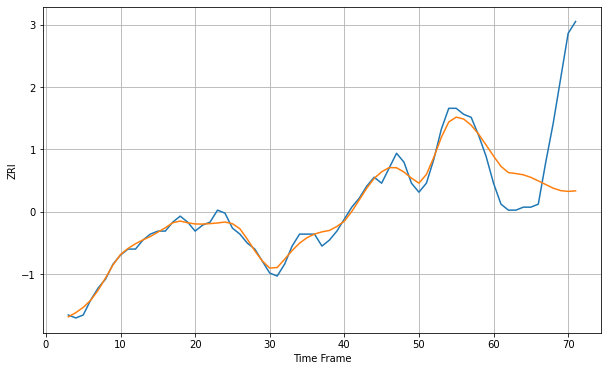

Wall time: 9.42 s
53209 2.1133546838666826 26.976390216769897 [708.07442328 704.60974924 702.52786577 702.21737103 701.80184365
 700.94700922 699.76902937 698.54889555 697.34711806 696.52826936
 696.25931405 696.43952264]

Got an mse at 0.0100 in round 113 and stopped training



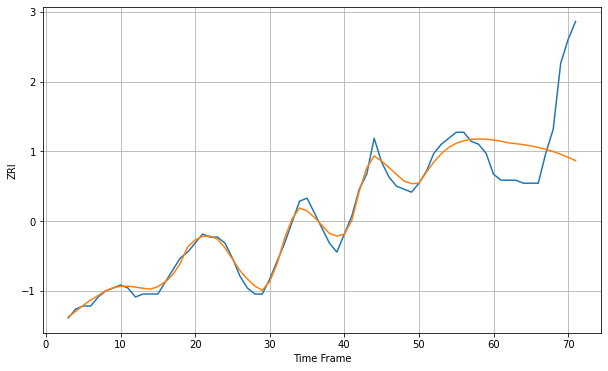

Wall time: 8.63 s
53210 2.2621977431188336 21.898391574760165 [757.43126607 757.00035368 756.48341863 756.20357226 755.86684247
 755.45593017 754.948856   754.32388124 753.56545745 752.67002524
 751.6474138  750.51355895]

Got an mse at 0.0099 in round 207 and stopped training



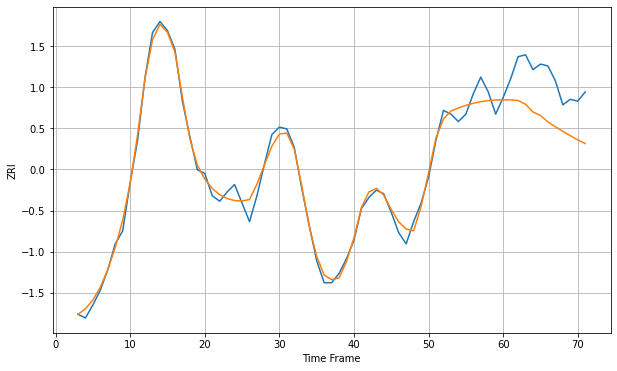

Wall time: 11.6 s
53211 4.286304476882813 22.4024197735973 [1180.74419534 1180.65696359 1180.33583516 1178.3576351  1174.15984708
 1172.25807823 1168.80329279 1166.20393407 1163.74782055 1161.35378539
 1159.10628978 1157.09385731]

Got an mse at 0.0100 in round 66 and stopped training



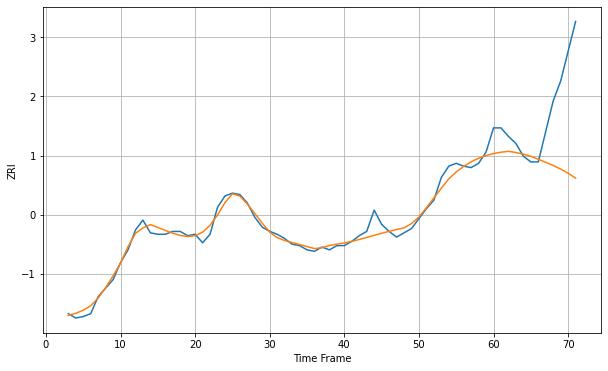

Wall time: 7.61 s
53212 4.251847198538478 47.23457004924877 [847.88112404 848.83554574 849.45009837 848.63934208 847.47196558
 845.95744041 843.87823554 841.70640606 839.47209471 836.96402593
 834.00408849 830.61105497]

Got an mse at 0.0099 in round 109 and stopped training



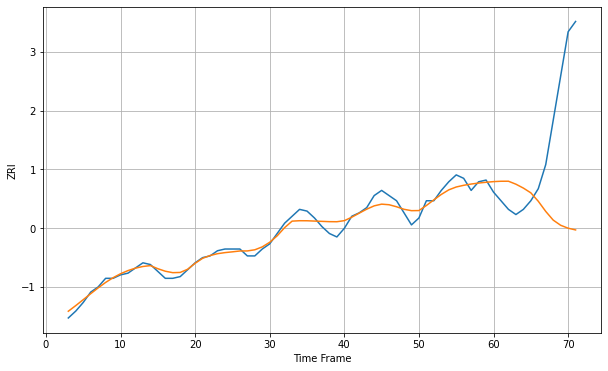

Wall time: 9.45 s
53215 3.5299956214666337 57.846227129809115 [759.09871127 759.31051903 759.32701272 757.60540995 755.34688606
 752.58978282 747.69975868 741.80642206 736.77348091 733.76987311
 732.07903014 731.07253782]

Got an mse at 0.0099 in round 108 and stopped training



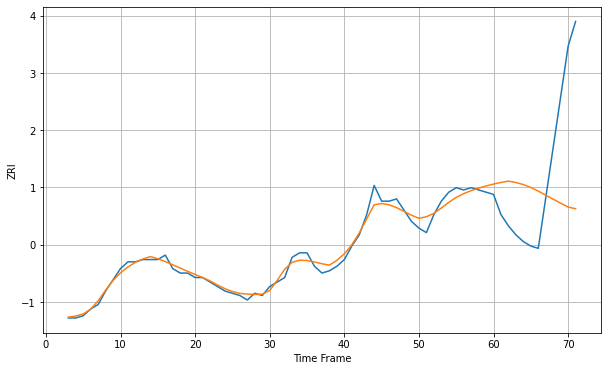

Wall time: 8.16 s
53216 2.532232227944478 38.73208854000307 [728.60258902 729.33084864 729.9170902  729.31428644 728.37217485
 727.09775275 725.46531675 723.68292162 721.86308038 720.0839168
 718.39549216 717.63475812]

Got an mse at 0.0100 in round 105 and stopped training



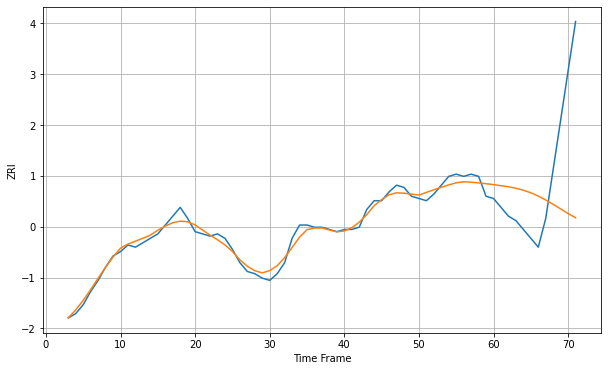

Wall time: 8.46 s
53218 2.5150948065622525 36.25804041367661 [731.2437065  730.78491078 730.29725133 729.62389459 728.74212199
 727.57892386 726.0973253  724.32277734 722.33441657 720.29564464
 718.17540114 716.28845882]

Got an mse at 0.0100 in round 293 and stopped training



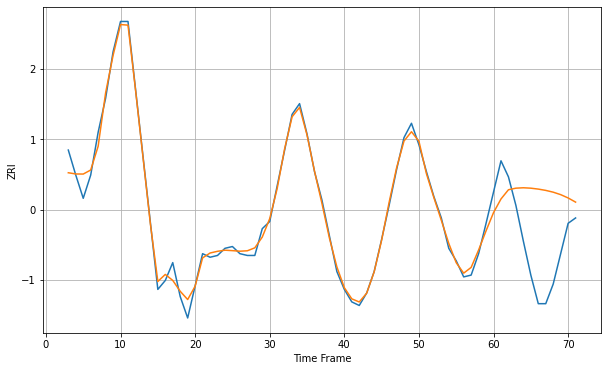

Wall time: 13.7 s
53403 3.923206189078128 36.688120654598045 [840.99320385 848.62368368 853.78712345 854.67153013 854.89460295
 854.66514451 854.15290965 853.42451038 852.42860494 851.04800594
 849.19260543 846.86289824]

Got an mse at 0.0098 in round 25 and stopped training



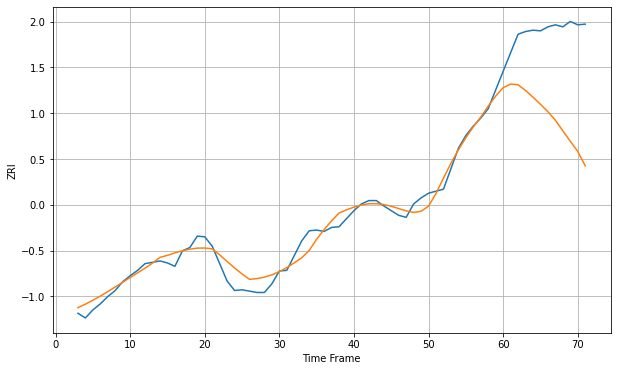

Wall time: 7.02 s
53590 13.593887070939287 132.4674092418348 [1120.30861701 1125.62089265 1124.63929303 1116.0980379  1106.1389028
 1095.50304971 1084.38491799 1071.72854081 1056.04840539 1040.36766676
 1025.27660538 1003.7664289 ]

Got an mse at 0.0100 in round 216 and stopped training



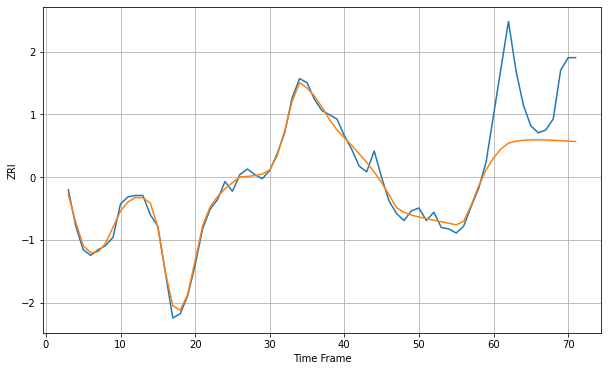

Wall time: 11.4 s
53703 4.586542448364908 45.99139839923911 [1298.87120475 1305.46927918 1309.58414004 1310.96611452 1311.67524215
 1311.94874292 1311.97436632 1311.85882189 1311.65003892 1311.3663007
 1311.07748159 1310.7407279 ]

Got an mse at 0.0099 in round 61 and stopped training



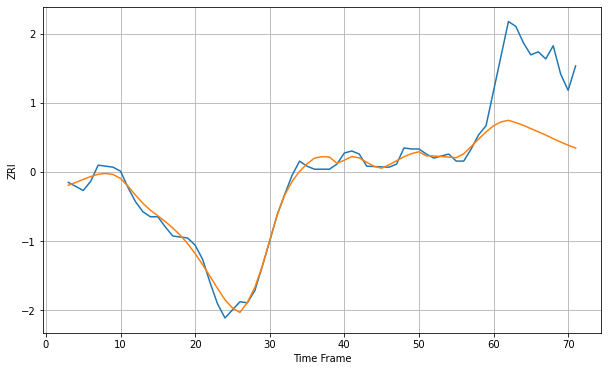

Wall time: 7.22 s
53704 6.539596076045851 76.53251507684605 [1097.95617548 1101.77524018 1103.32202691 1100.99703665 1098.3742645
 1095.11162419 1091.9754072  1088.76771825 1085.19525162 1081.84313242
 1078.75737346 1075.96422424]

Got an mse at 0.0100 in round 108 and stopped training



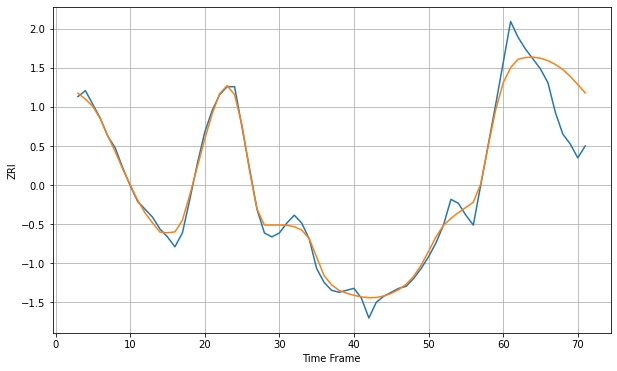

Wall time: 9.07 s
54220 3.6862152921536535 22.118856391596896 [678.91170437 686.66504521 690.87458439 691.74620164 691.94006399
 691.41813618 690.17651277 688.24823759 685.70366644 682.19171156
 678.14472351 673.85698037]


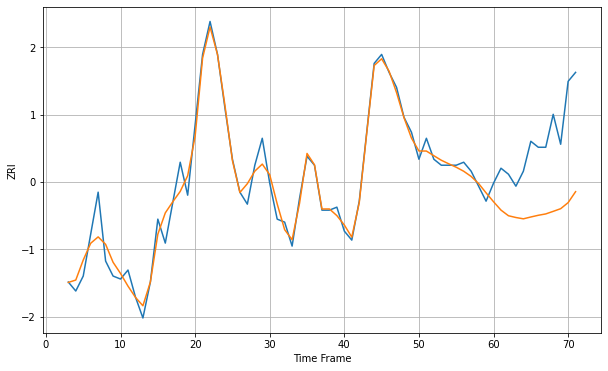

Wall time: 16.9 s
54601 3.991363862693616 24.455478769257414 [826.81527306 824.01666974 822.1343028  821.54442477 821.10498063
 821.71731806 822.28642185 822.74077401 823.59656724 824.49047712
 826.51285787 830.17051106]

Got an mse at 0.0099 in round 113 and stopped training



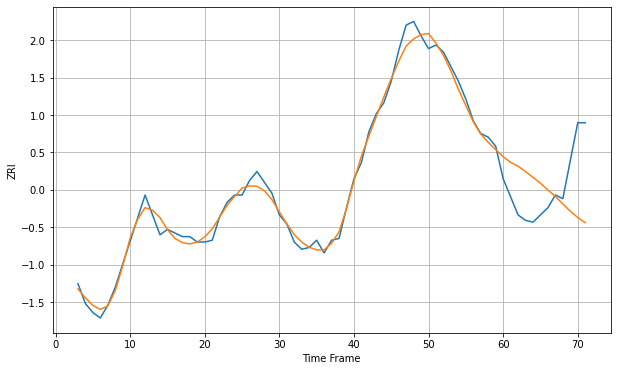

Wall time: 9.27 s
54901 4.027124207760349 28.25928637474541 [723.18538659 720.07920583 717.98387825 714.95784632 711.76723676
 708.52998783 704.74392971 701.25631473 697.05977158 693.05255488
 689.56840028 686.67639485]

Got an mse at 0.0099 in round 72 and stopped training



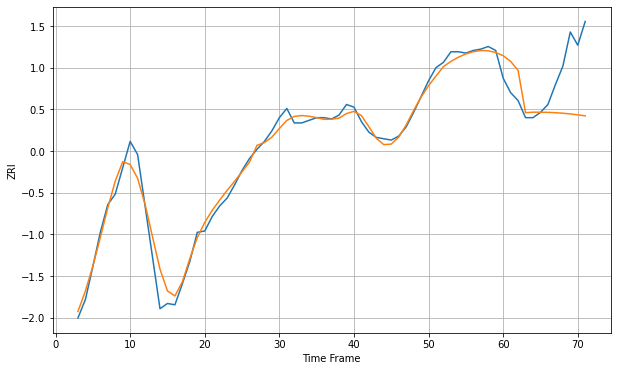

Wall time: 7.5 s
55101 7.022370600654845 35.29960464952175 [1333.05666243 1328.70740738 1321.9172741  1289.79031173 1290.15378056
 1290.14481386 1290.02839916 1289.77370296 1289.36958978 1288.82250871
 1288.15247005 1287.38793605]

Got an mse at 0.0100 in round 141 and stopped training



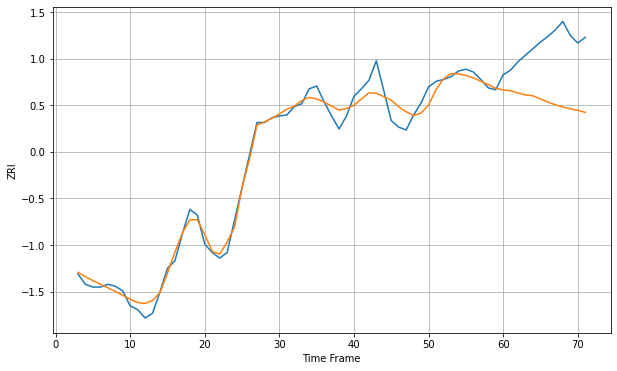

Wall time: 9.1 s
55104 10.190400366175082 62.83859980841829 [1301.78352958 1300.91482336 1298.5104084  1296.49892968 1295.51428735
 1292.14384483 1288.77703718 1285.91569521 1283.59007341 1281.65277287
 1279.92628147 1277.87553382]

Got an mse at 0.0099 in round 29 and stopped training



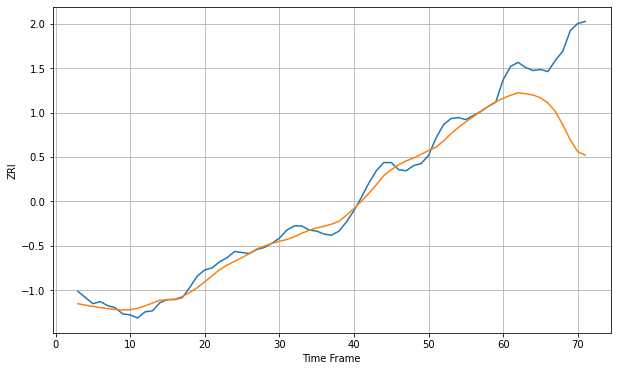

Wall time: 7.5 s
55106 7.365589685472603 68.846381810114 [1094.86661984 1097.82941423 1100.3160135  1099.37113091 1098.07036146
 1095.36433044 1090.29334707 1081.81782494 1068.88347821 1054.22159915
 1042.60516054 1039.25704734]

Got an mse at 0.0099 in round 106 and stopped training



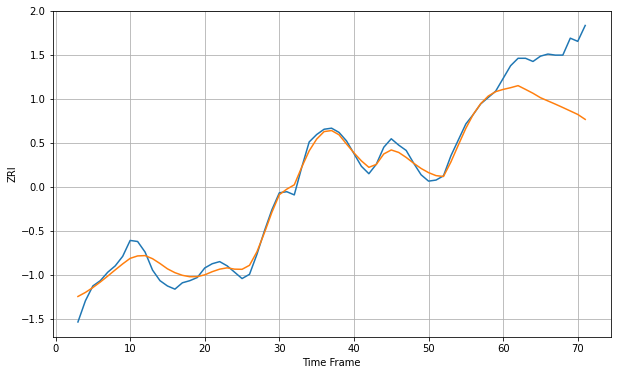

Wall time: 8.62 s
55306 7.482550674364422 48.66041808961634 [1301.60642296 1303.23932755 1305.17283525 1301.62041825 1297.9730449
 1293.79169211 1290.73681826 1287.70009481 1284.52189175 1281.26247426
 1277.98149809 1273.30672476]

Got an mse at 0.0099 in round 78 and stopped training



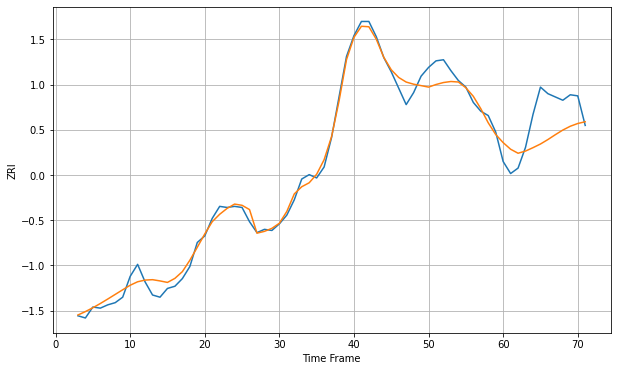

Wall time: 8.51 s
55401 7.993912104247211 28.544656133994188 [1646.27518705 1640.22913822 1636.55848697 1638.55903824 1641.6500134
 1644.99321768 1649.07512647 1653.53778597 1657.76173719 1661.23683914
 1663.74500621 1665.33254559]

Got an mse at 0.0100 in round 119 and stopped training



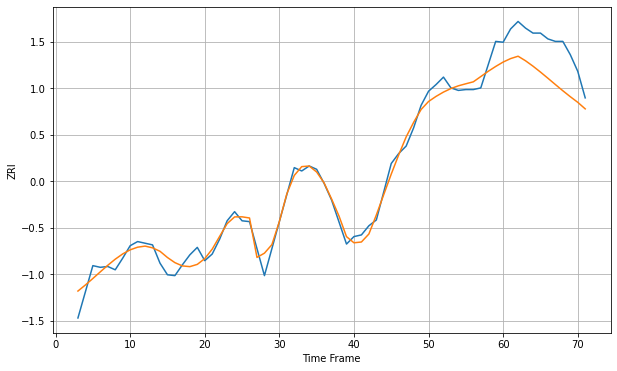

Wall time: 8.81 s
55403 11.146961005505197 42.35301540628467 [1316.13142412 1320.30454093 1323.15699427 1317.67250333 1311.1809533
 1304.09340474 1296.64204071 1289.06033704 1281.58560998 1274.42395109
 1267.65734859 1259.76364865]

Got an mse at 0.0100 in round 117 and stopped training



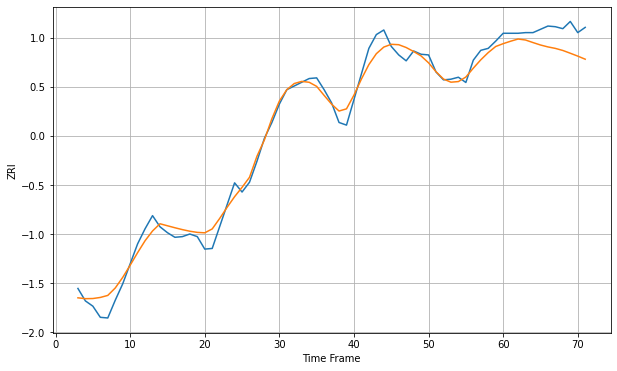

Wall time: 9.37 s
55404 14.3254111354295 29.70943052853933 [1345.14791494 1348.88663628 1352.2427719  1350.7292218  1346.83758414
 1343.13824679 1340.20486748 1337.94947342 1334.78913839 1330.55929262
 1326.19309774 1321.46224262]

Got an mse at 0.0099 in round 54 and stopped training



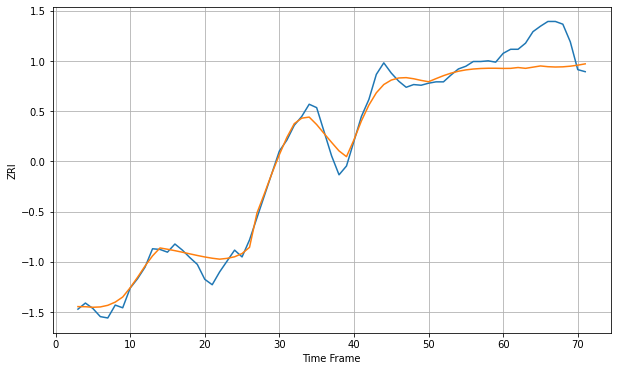

Wall time: 7.25 s
55407 13.487513258214378 44.64445436007511 [1360.79330171 1360.88726089 1362.11402828 1360.91611412 1362.66646803
 1364.44180068 1363.33391719 1362.87423099 1363.14240592 1364.08173298
 1365.58862155 1367.54505666]

Got an mse at 0.0099 in round 127 and stopped training



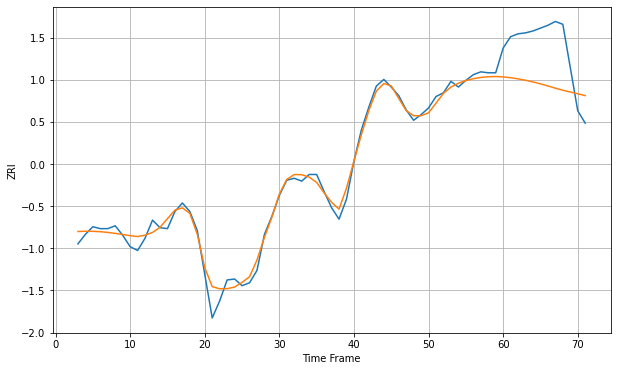

Wall time: 10.4 s
55408 7.690744126730835 49.556523707074646 [1515.68002893 1514.81239493 1513.60329922 1512.13255502 1510.36618067
 1508.36011413 1506.16001718 1503.80513368 1501.63569826 1499.77432185
 1497.88465042 1496.00596946]

Got an mse at 0.0100 in round 135 and stopped training



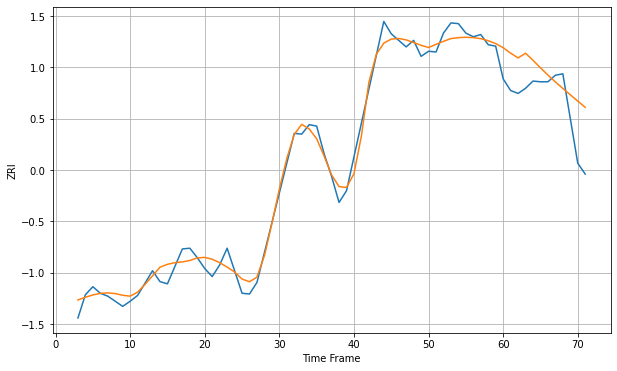

Wall time: 9.41 s
55411 13.074264851921894 48.098474864920185 [1584.91703889 1577.42538907 1570.82303682 1577.2492907  1567.59011126
 1557.23277426 1547.24472349 1537.82678778 1528.85619407 1520.10411535
 1511.4327859  1502.8638373 ]

Got an mse at 0.0098 in round 49 and stopped training



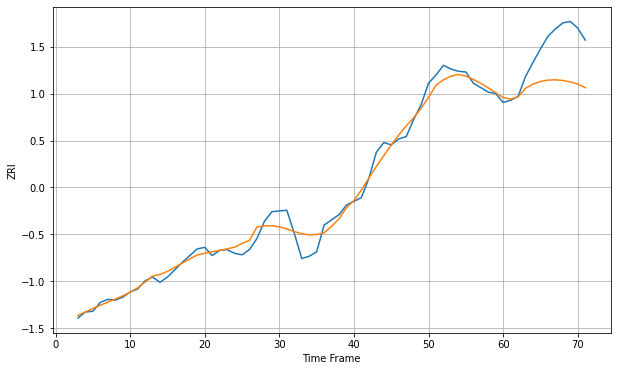

Wall time: 7.89 s
55413 11.493929921819536 52.916937030009976 [1515.62681137 1513.57853995 1516.39916862 1528.10492092 1533.67415044
 1537.26570738 1539.0999272  1539.46575752 1538.59987771 1536.67574096
 1533.83784362 1528.8876987 ]

Got an mse at 0.0100 in round 62 and stopped training



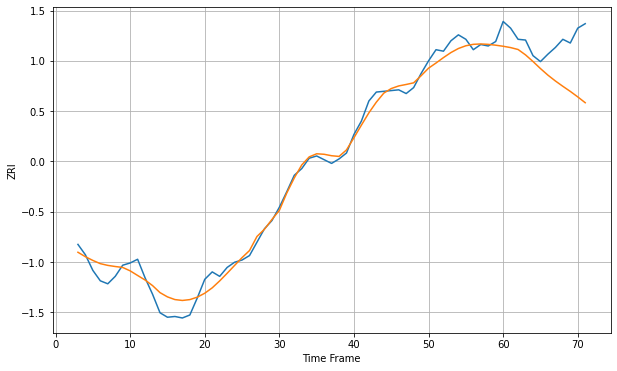

Wall time: 7.73 s
55414 12.29731788757722 52.80572461640315 [1565.63361607 1563.85548755 1561.28570318 1554.01999059 1545.13355755
 1535.61859831 1526.76570918 1518.92962026 1511.76496235 1504.88359275
 1497.51598581 1489.66710047]

Got an mse at 0.0100 in round 70 and stopped training



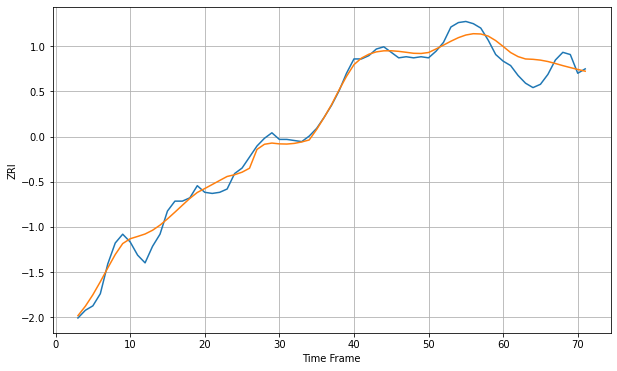

Wall time: 8.32 s
55416 7.808418021679013 14.944087301970313 [1538.32800509 1532.81325793 1529.10988732 1526.98259001 1526.65936551
 1525.9294047  1524.65545767 1522.87019407 1520.93454628 1519.17521997
 1517.45590137 1515.89130483]

Got an mse at 0.0100 in round 30 and stopped training



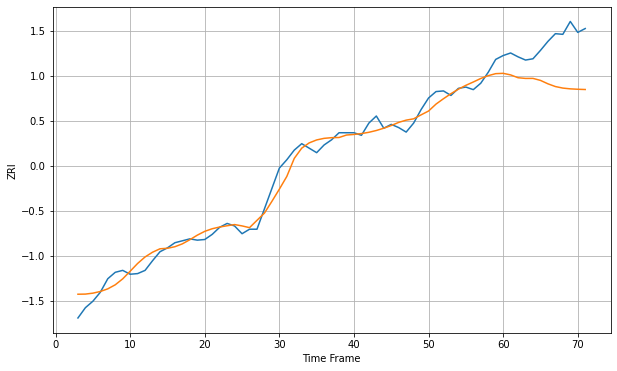

Wall time: 6.67 s
55418 13.480178659942165 66.30661337583135 [1315.35291239 1312.93648763 1308.52362048 1307.44532511 1307.49092661
 1304.38979294 1299.07580273 1294.82216461 1292.42836768 1291.2213394
 1290.60918671 1290.20652965]

Got an mse at 0.0099 in round 378 and stopped training



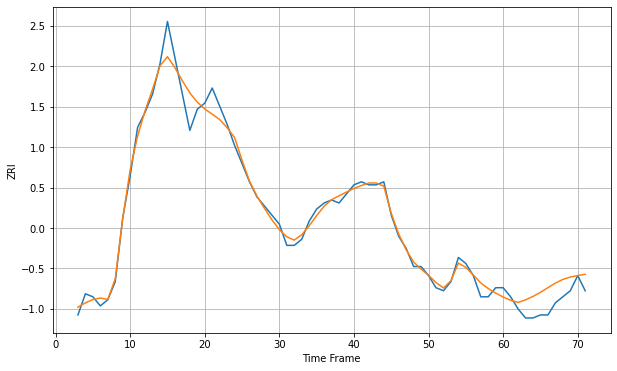

Wall time: 15.8 s
58103 3.120057057769466 5.512884057814784 [711.93151112 710.85354285 710.13861815 710.99622684 712.12059476
 713.4812796  715.01000165 716.52659638 717.73965863 718.51789422
 719.01815492 719.44425316]

Got an mse at 0.0099 in round 189 and stopped training



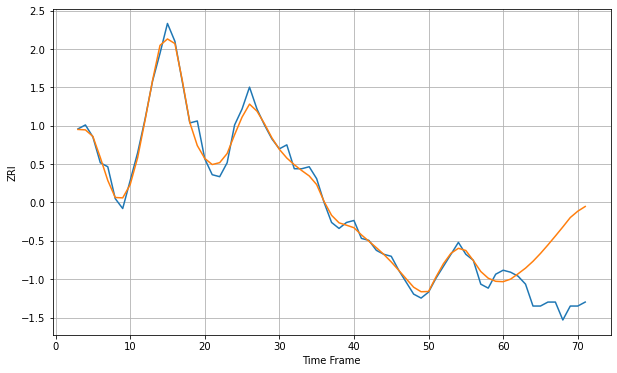

Wall time: 10.4 s
58104 3.723177964202214 31.596227228371554 [774.24283733 775.52313309 778.21026275 781.0523297  784.48165131
 788.41834351 792.708662   797.1797229  801.74447413 806.47542583
 809.64547946 812.02795793]

Got an mse at 0.0100 in round 206 and stopped training



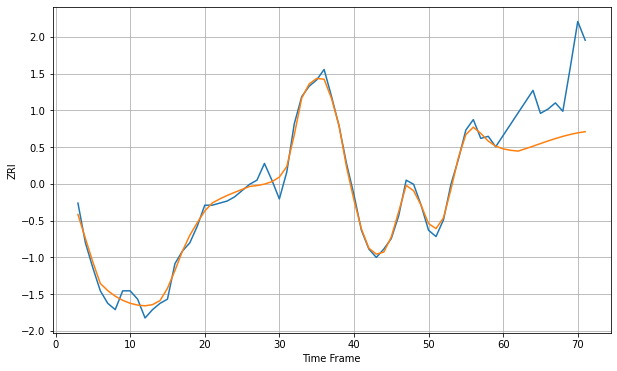

Wall time: 12.1 s
59601 3.4736983024529713 26.498304515127014 [838.99747193 838.30359903 837.91872002 839.05256683 840.26896969
 841.52040714 842.75188266 843.91497446 844.97284262 845.89596652
 846.65562915 847.22073309]

Got an mse at 0.0100 in round 292 and stopped training



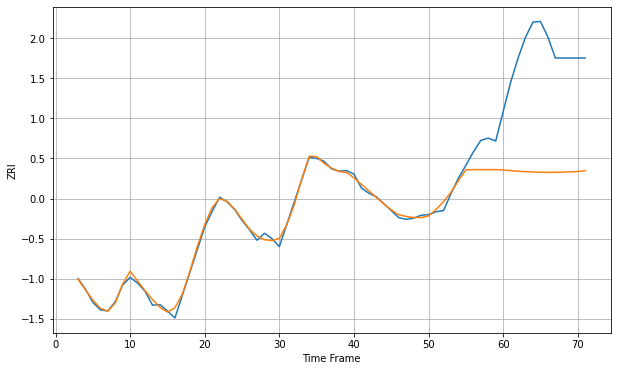

Wall time: 13 s
59718 13.568121320089825 205.25172774651833 [1414.07796108 1412.92820444 1411.75286521 1411.15639376 1410.63461424
 1410.21164323 1409.97747724 1410.02079323 1410.35124206 1410.86279797
 1411.38886831 1412.81265523]

Got an mse at 0.0099 in round 111 and stopped training



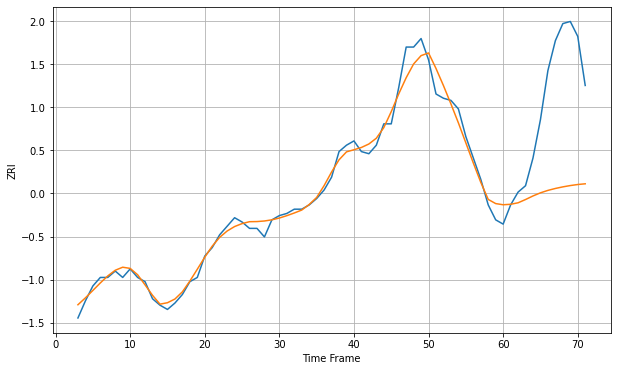

Wall time: 7.53 s
59801 4.185390372812173 48.584231516870716 [832.07553255 832.29844253 832.99384885 834.52669549 836.20521098
 837.6664902  838.80813497 839.7135681  840.45881152 841.07606983
 841.56486232 841.90175295]

Got an mse at 0.0099 in round 54 and stopped training



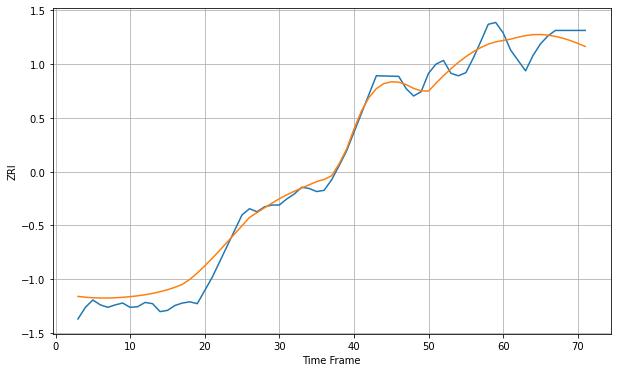

Wall time: 6.36 s
59901 19.84546265158271 26.262911514313064 [1171.59931818 1173.82536282 1176.94208807 1179.54651137 1181.10133744
 1181.3212211  1180.32740501 1178.31120948 1175.33269016 1171.49203574
 1166.93525638 1161.8429737 ]

Got an mse at 0.0100 in round 172 and stopped training



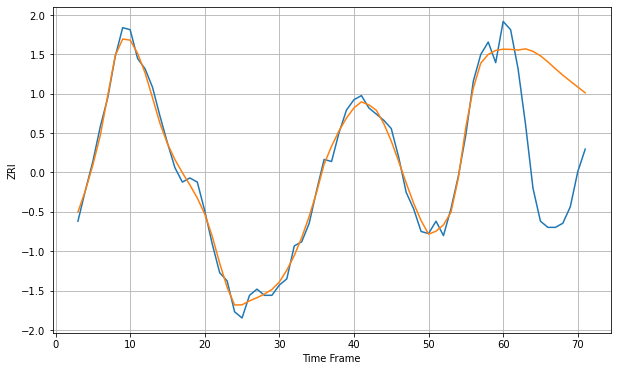

Wall time: 9.23 s
60085 3.7937926241574567 55.0042280138131 [1193.54147295 1193.4295627  1193.11308749 1193.70960677 1192.49116194
 1190.31984328 1187.34055716 1184.05658076 1180.91818014 1178.00194893
 1175.18743624 1172.34358173]

Got an mse at 0.0100 in round 137 and stopped training



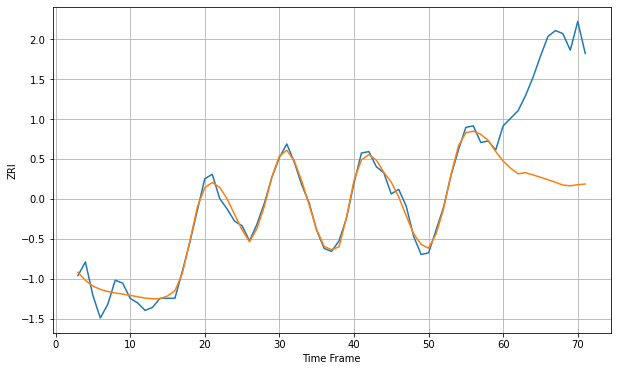

Wall time: 8.53 s
60201 5.037396217838734 77.83553297363228 [1529.70622015 1524.98123006 1521.32362688 1522.03221858 1520.54537674
 1519.02766415 1517.4315465  1515.72111369 1513.85420151 1513.3592782
 1514.09267713 1514.54008174]

Got an mse at 0.0100 in round 149 and stopped training



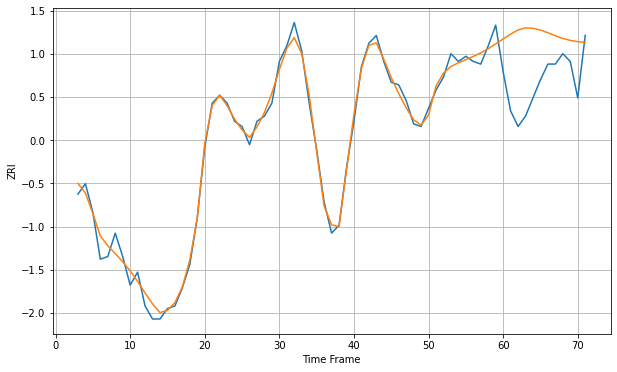

Wall time: 8.57 s
60202 3.1460119871767036 21.37159369943378 [1594.68210689 1596.53315441 1598.13112979 1598.91557435 1598.7635733
 1598.09170651 1597.0502059  1595.88277349 1594.85351139 1594.10231074
 1593.62170662 1593.33980963]


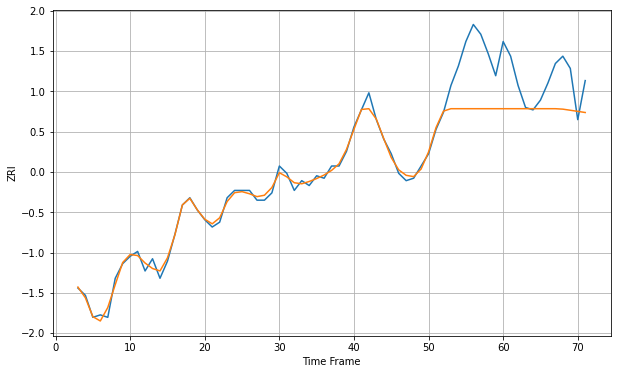

Wall time: 15.8 s
60402 8.529934931470605 15.067516302640152 [1279.48374811 1279.48374811 1279.48374811 1279.48374811 1279.48374811
 1279.48374811 1279.48374811 1279.48374811 1279.30263992 1278.84834559
 1278.39332902 1277.92593222]

Got an mse at 0.0099 in round 168 and stopped training



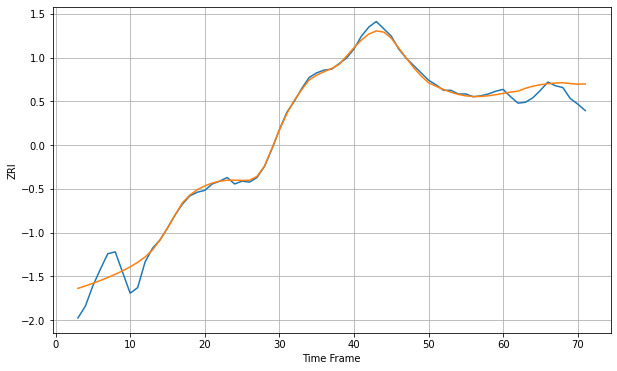

Wall time: 9.16 s
60540 9.288181306227301 13.704418696481936 [1639.63021333 1641.02394365 1642.05227064 1645.23488971 1647.50736535
 1649.09554093 1650.1977319  1650.92770469 1651.26752094 1650.29807724
 1649.63834178 1649.9815986 ]

Got an mse at 0.0099 in round 81 and stopped training



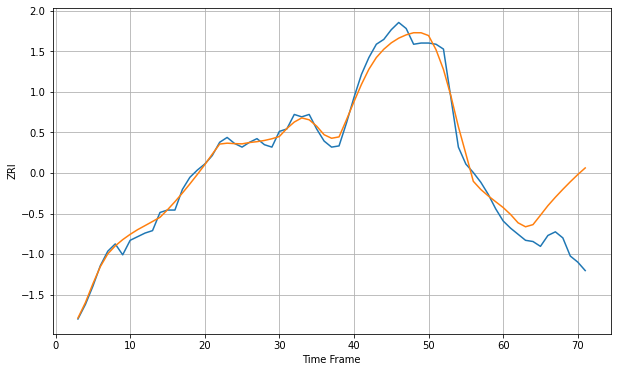

Wall time: 6.76 s
60563 6.526121050944192 41.36959687705881 [1374.09212778 1368.3304269  1361.45779836 1358.1800326  1359.95744155
 1367.7269713  1375.63238508 1382.58123428 1389.10603692 1395.36319663
 1401.29456259 1406.79797842]

Got an mse at 0.0100 in round 183 and stopped training



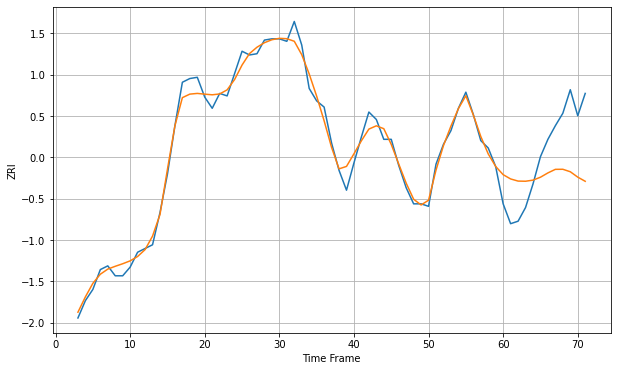

Wall time: 8.79 s
60601 6.779047553073894 40.29075835955399 [2081.52143046 2078.06780125 2076.34090078 2076.21415464 2077.10163858
 2079.45247678 2082.93173874 2085.80101359 2085.86378202 2083.86787154
 2079.52621123 2076.17252051]

Got an mse at 0.0099 in round 113 and stopped training



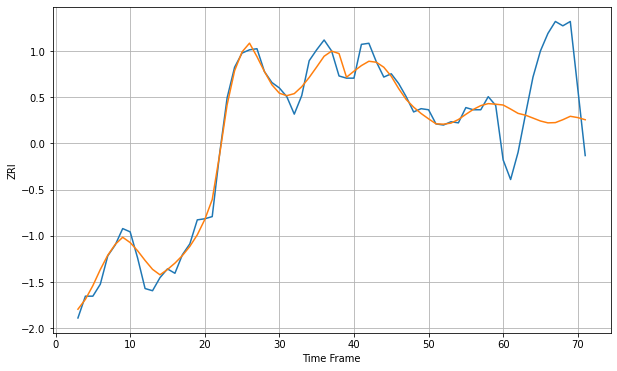

Wall time: 7.92 s
60605 9.249474117725551 61.68047514531328 [2038.35991024 2034.64981479 2030.68707097 2029.0113146  2026.37950352
 2023.69125922 2021.98846528 2022.21290116 2024.86738537 2028.00941915
 2026.83026872 2024.86018966]

Got an mse at 0.0099 in round 404 and stopped training



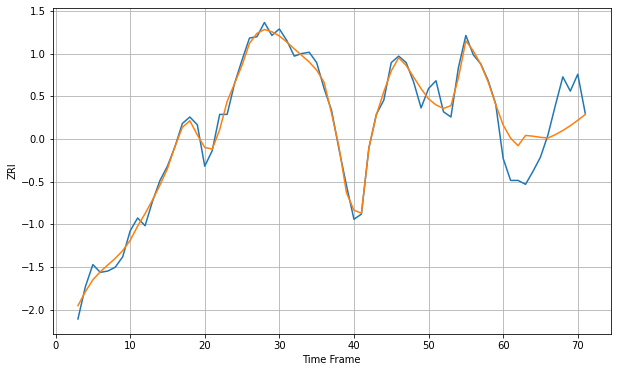

Wall time: 13.8 s
60606 6.390403019636045 27.473541987228515 [2190.80451199 2180.64081714 2174.80429084 2182.73354448 2182.17011619
 2181.2992751  2180.74402385 2183.39279966 2186.56854997 2190.27725978
 2194.45217066 2198.91192506]

Got an mse at 0.0100 in round 98 and stopped training



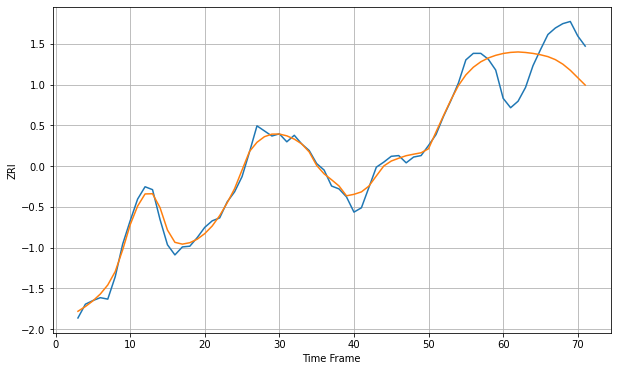

Wall time: 7.47 s
60607 10.06785591338819 52.93074813155387 [2035.84414262 2037.33352315 2037.94914628 2037.21595596 2035.93117748
 2034.05506792 2031.4970922  2027.33970309 2021.10634695 2012.67810296
 2002.45429018 1992.26726513]

Got an mse at 0.0100 in round 323 and stopped training



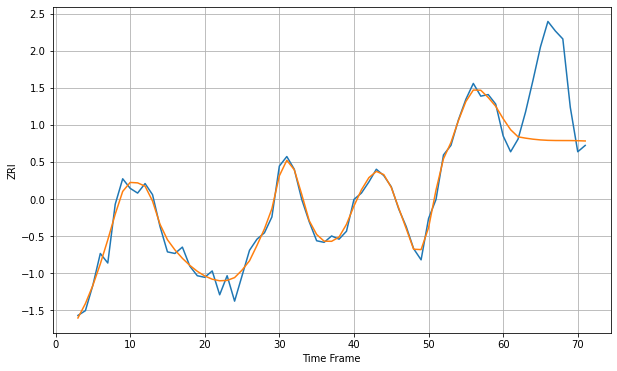

Wall time: 11.8 s
60608 4.788048329328855 41.14110225920245 [1518.81751878 1511.8857261  1507.40245286 1506.57918417 1505.92511196
 1505.46192521 1505.19449029 1505.08561614 1505.06327586 1505.04602575
 1504.96796334 1504.7937464 ]

Got an mse at 0.0099 in round 154 and stopped training



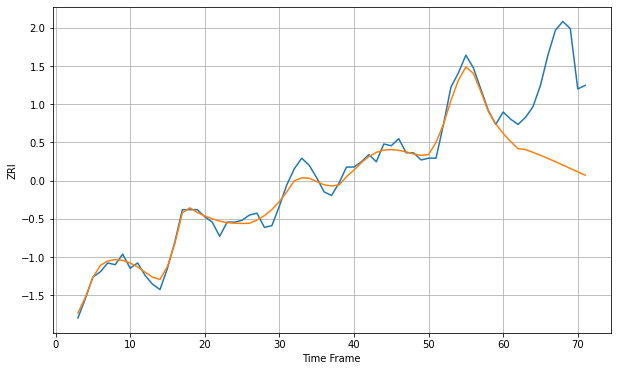

Wall time: 8.35 s
60609 4.181731476907387 49.472016346335735 [1280.96974697 1276.36747958 1272.33787648 1271.8371815  1270.27885513
 1268.62854978 1266.8782476  1265.03751065 1263.13614412 1261.21146217
 1259.29061796 1257.40082914]

Got an mse at 0.0100 in round 238 and stopped training



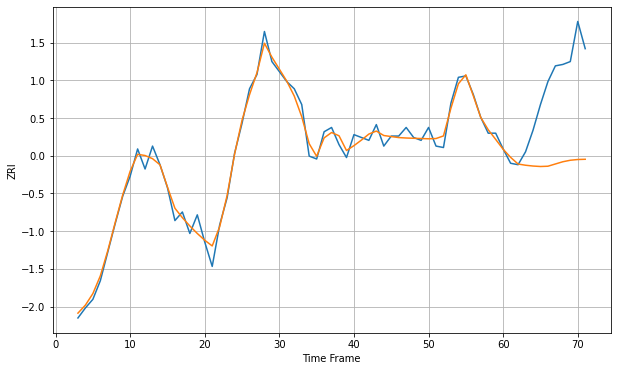

Wall time: 10.6 s
60610 5.18982168270423 54.304031655356376 [1918.78399017 1913.12883668 1908.48896994 1907.63144836 1907.06984185
 1906.74672105 1906.94119829 1908.50727162 1910.06385878 1911.10453169
 1911.62536315 1911.79571804]

Got an mse at 0.0100 in round 125 and stopped training



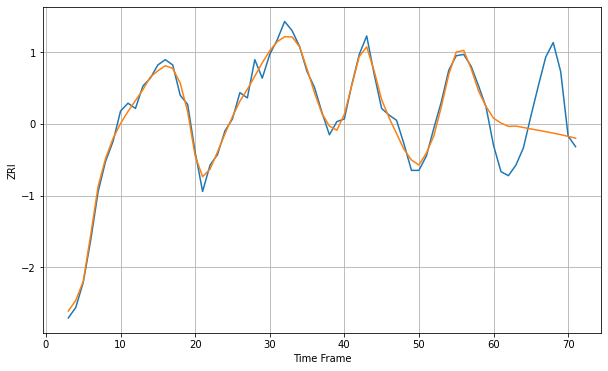

Wall time: 8.04 s
60611 5.420227569317995 36.26978978488955 [2159.5674562  2155.94671006 2153.40401213 2153.59561162 2152.53884673
 2151.47259387 2150.42474809 2149.37284921 2148.28079939 2147.11292972
 2145.83632034 2144.42230699]

Got an mse at 0.0098 in round 202 and stopped training



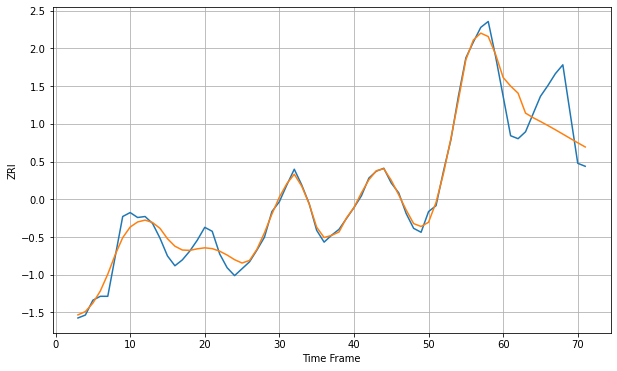

Wall time: 9.55 s
60612 8.496127883004402 38.0120991956798 [1674.13300306 1665.42108619 1658.19829436 1637.95755653 1633.40281546
 1629.44771708 1625.35209416 1621.07306046 1616.67333097 1612.23535195
 1607.8499254  1603.60540693]

Got an mse at 0.0098 in round 102 and stopped training



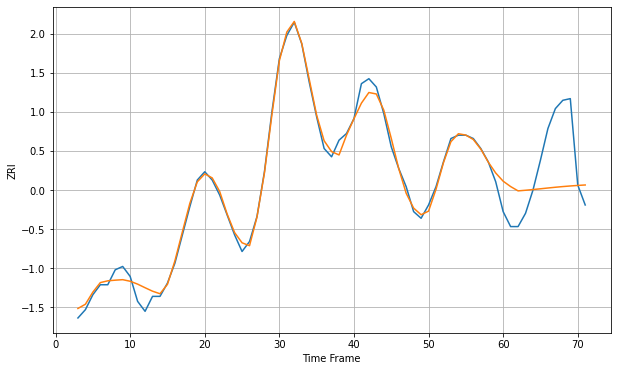

Wall time: 7.69 s
60613 4.175066880824804 30.265054392751107 [1706.31739024 1703.08558622 1700.48578356 1700.86235912 1701.28438705
 1701.740289   1702.21610149 1702.67016829 1703.07636437 1703.43953684
 1703.75887547 1704.03880547]

Got an mse at 0.0099 in round 120 and stopped training



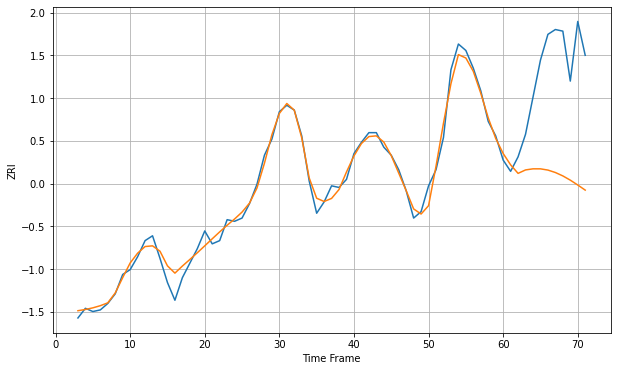

Wall time: 7.8 s
60614 4.960834475216162 65.36250059784498 [1876.06942895 1869.03169749 1863.73525095 1865.86964305 1866.54868391
 1866.54666725 1865.78023987 1864.26898962 1862.15797911 1859.52587179
 1856.51965251 1853.34478307]

Got an mse at 0.0094 in round 35 and stopped training



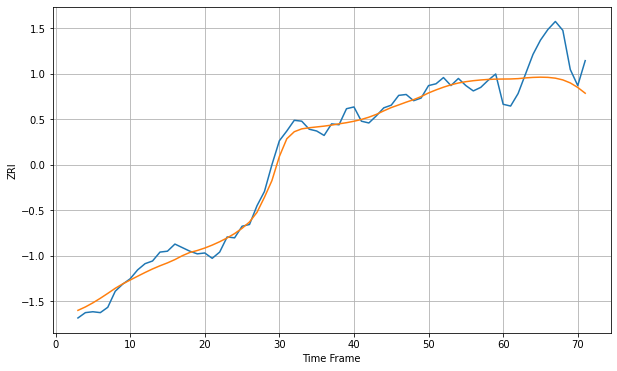

Wall time: 5.94 s
60615 9.029108682506209 36.55517181237572 [1532.34671602 1532.42766392 1532.79898174 1533.60993158 1534.18457696
 1534.4379186  1534.2259249  1533.31733972 1531.37149441 1527.97776153
 1522.88246867 1516.40967023]

Got an mse at 0.0100 in round 224 and stopped training



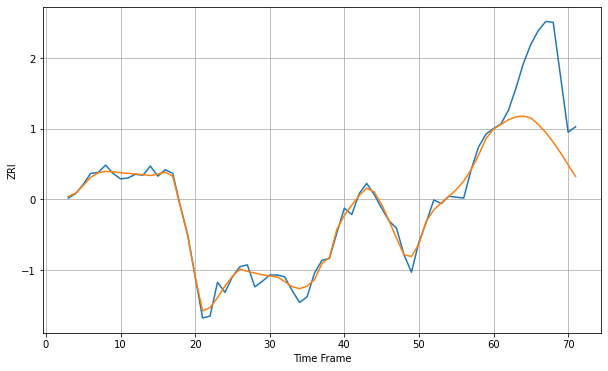

Wall time: 10.2 s
60616 7.078249229869312 73.17138720203062 [1662.47657799 1667.43966036 1672.59092496 1675.72912672 1676.5789635
 1674.50463546 1667.61622452 1658.71353264 1648.16262704 1636.2949918
 1623.30332574 1610.5986612 ]

Got an mse at 0.0099 in round 269 and stopped training



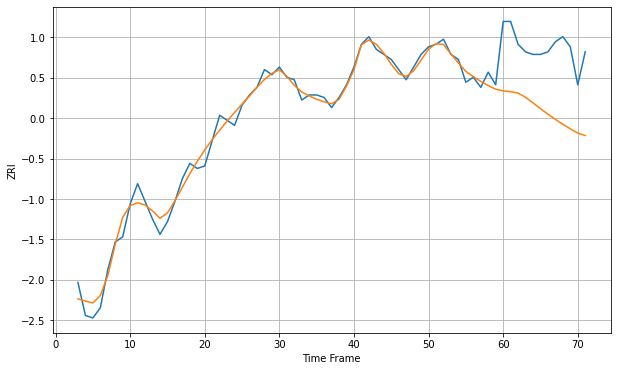

Wall time: 11.4 s
60617 3.197064446596882 26.24946868283562 [1137.62967643 1137.29207206 1136.74587806 1135.09082808 1132.87822949
 1130.61315934 1128.41665229 1126.35573888 1124.43791846 1122.6370042
 1120.95599946 1119.99899971]


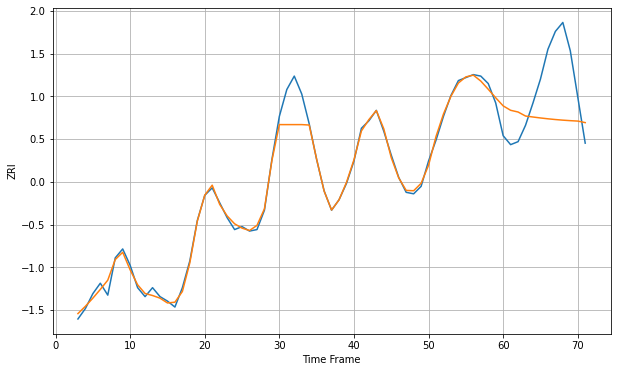

Wall time: 16.2 s
60618 6.480914877679012 35.07541946617921 [1635.03101852 1632.05508706 1630.90147487 1628.19964052 1627.54514288
 1626.91369894 1626.34240161 1625.85001495 1625.43772418 1625.09630086
 1624.81305813 1623.79166003]

Got an mse at 0.0099 in round 350 and stopped training



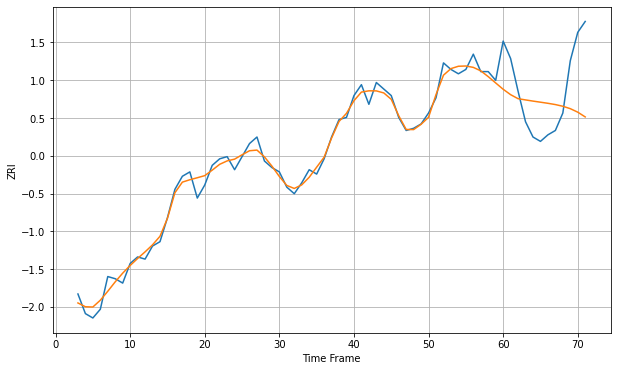

Wall time: 12.9 s
60619 3.2079219016094616 21.545116123665544 [1118.90734737 1116.42611643 1114.57857521 1114.01884617 1113.47660085
 1112.97482075 1112.46643872 1111.88039288 1111.10830849 1110.00094266
 1108.39770461 1106.21530258]

Got an mse at 0.0098 in round 104 and stopped training



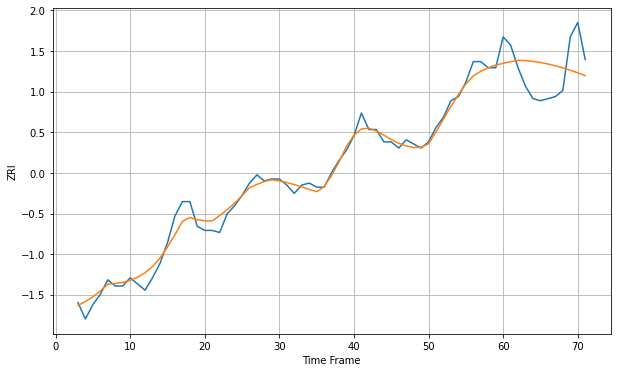

Wall time: 7.63 s
60620 3.820669305216147 14.771526395578475 [1163.17606066 1163.91457231 1164.62552226 1164.47362476 1164.10968879
 1163.55668932 1162.83460877 1161.9602509  1160.9477618  1159.809452
 1158.5567118  1157.20088208]

Got an mse at 0.0100 in round 217 and stopped training



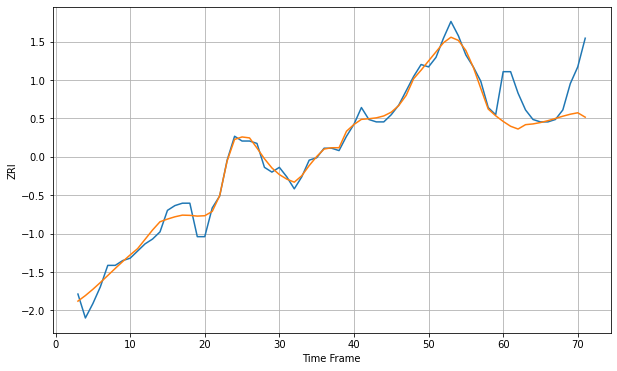

Wall time: 9.52 s
60621 3.2687816777121776 15.410229782144302 [1162.20300931 1160.17163983 1159.0182863  1160.84338094 1161.15137541
 1161.728112   1162.50765235 1163.42718799 1164.37559505 1165.20941364
 1165.81238667 1163.96797027]

Got an mse at 0.0099 in round 312 and stopped training



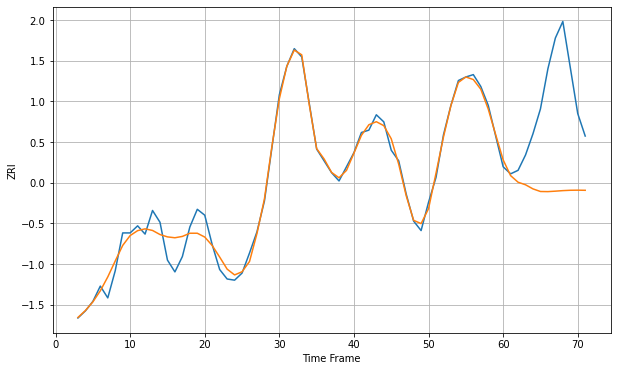

Wall time: 12.5 s
60622 8.195536825648434 78.04484544375029 [1780.84048267 1767.50481207 1761.91910597 1759.75022662 1756.26839975
 1754.06368825 1753.96303506 1754.34856742 1754.80537607 1755.10471353
 1755.18616604 1755.08078458]

Got an mse at 0.0099 in round 172 and stopped training



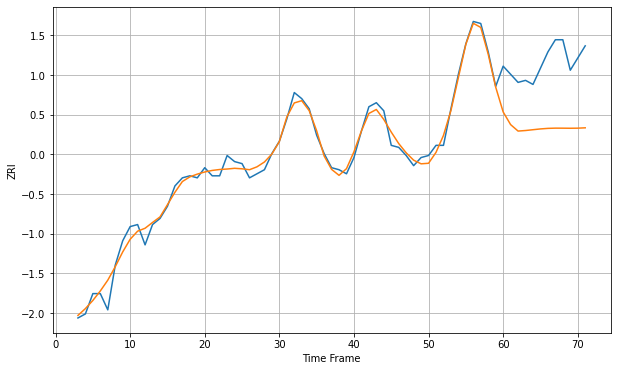

Wall time: 8.91 s
60623 3.6254047462571313 32.33472510227106 [1281.46730305 1275.21238688 1272.02975969 1272.30304289 1272.69874306
 1273.08611393 1273.35975382 1273.47034596 1273.45364643 1273.41495827
 1273.45912805 1273.63310573]

Got an mse at 0.0100 in round 246 and stopped training



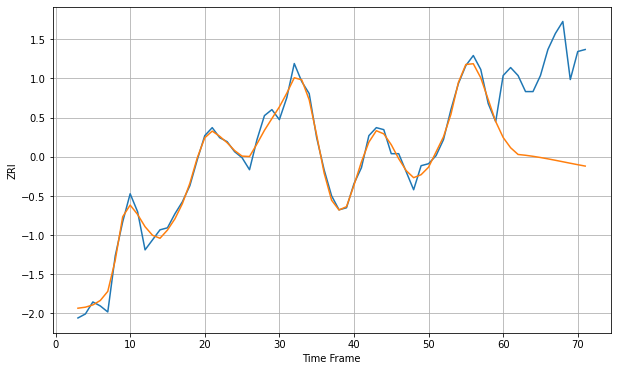

Wall time: 10.4 s
60624 3.6687341704600342 48.343136741068136 [1335.09861578 1329.97145846 1326.61440916 1326.20970849 1325.69497773
 1325.09254303 1324.42381871 1323.7103487  1322.97363034 1322.23412775
 1321.51007956 1320.81655145]

Got an mse at 0.0099 in round 119 and stopped training



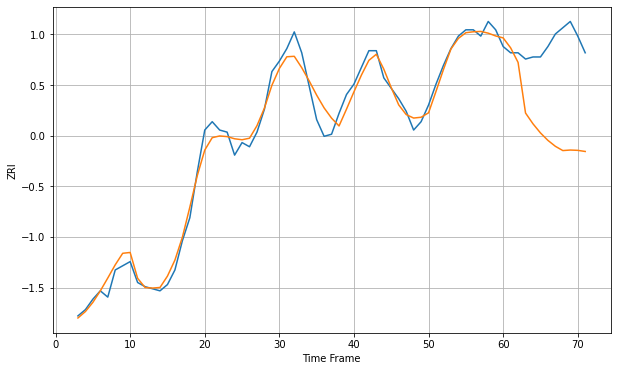

Wall time: 8.11 s
60625 4.970580681502501 41.283535319893915 [1550.13222604 1545.3831252  1538.3958793  1514.15590989 1508.98205838
 1504.62840377 1501.05483464 1498.21303563 1496.17382184 1496.42794622
 1496.28331974 1495.74119344]

Got an mse at 0.0100 in round 118 and stopped training



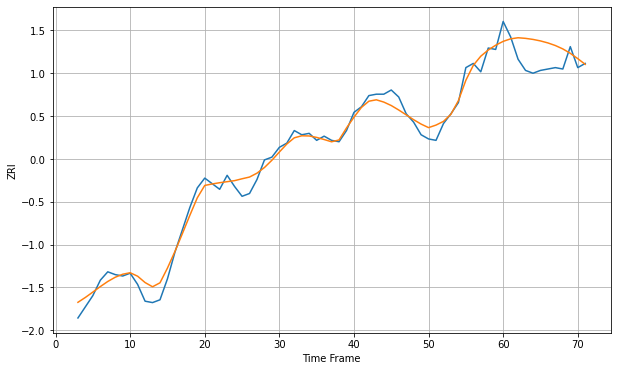

Wall time: 7.71 s
60626 6.127438099808704 15.446751364724085 [1376.76200222 1378.57264575 1379.35855711 1378.92089995 1378.16653639
 1377.09052392 1375.6558576  1373.79107086 1371.36661441 1368.23267575
 1364.43598858 1360.3403641 ]

Got an mse at 0.0099 in round 265 and stopped training



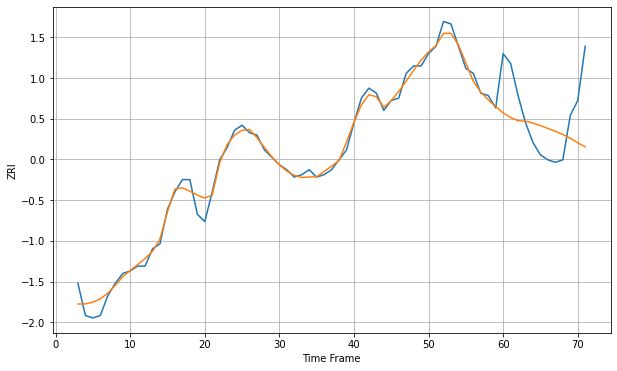

Wall time: 11 s
60628 3.034268728836331 17.847006954358406 [1178.00421283 1176.14851739 1174.81858527 1174.67750236 1173.87344027
 1172.84892257 1171.69512747 1170.53960205 1169.28997986 1167.7459003
 1165.90849974 1164.25266584]

Got an mse at 0.0100 in round 343 and stopped training



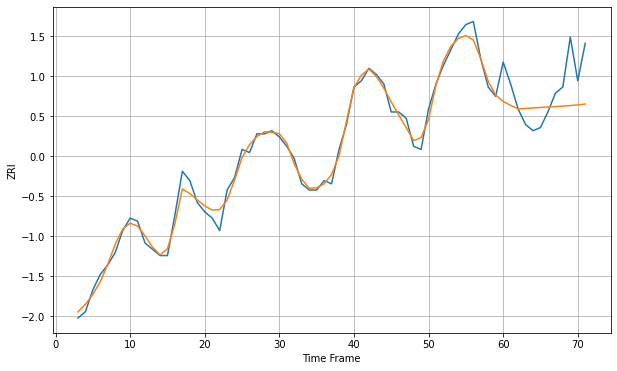

Wall time: 12.6 s
60629 2.33686134679564 10.433041538725059 [1217.35415018 1216.12451022 1215.02113157 1215.13590704 1215.28039739
 1215.45552689 1215.58703727 1215.72714669 1215.88540123 1216.0608831
 1216.25184322 1216.54720262]

Got an mse at 0.0098 in round 96 and stopped training



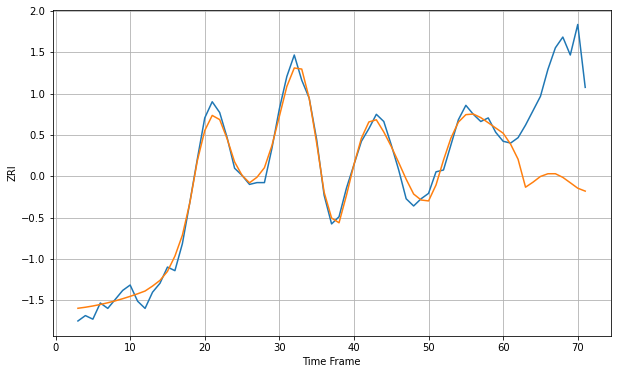

Wall time: 7.41 s
60630 4.6246990847509615 54.76827687127966 [1515.49441232 1509.37716675 1500.99784028 1485.44535693 1488.23898567
 1491.41891207 1492.92371252 1492.93820857 1490.91014728 1487.9221086
 1484.88250097 1483.26183985]

Got an mse at 0.0100 in round 388 and stopped training



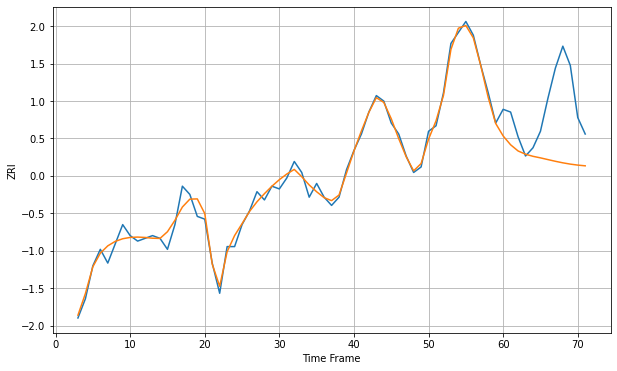

Wall time: 13.3 s
60632 2.526842375142374 21.502029303612396 [1314.29664296 1311.08065513 1308.83629823 1307.64484273 1306.88207043
 1306.31738917 1305.6885071  1305.07041836 1304.51106382 1304.04309638
 1303.68175761 1303.41907541]

Got an mse at 0.0099 in round 287 and stopped training



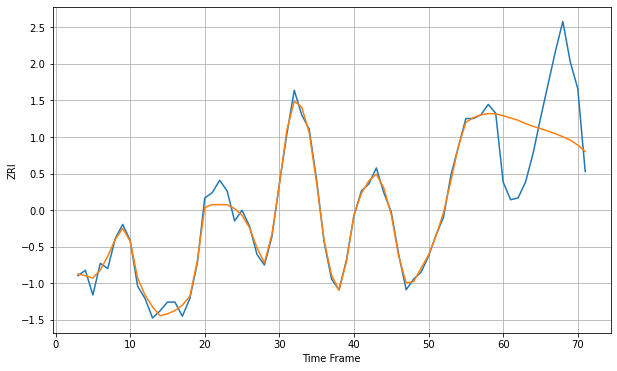

Wall time: 11.3 s
60634 4.043080507705714 37.752690736273536 [1584.62668544 1583.29232412 1582.03728832 1580.12786492 1578.64801636
 1577.30607101 1575.90564838 1574.36929997 1572.71276531 1570.77670366
 1567.94575992 1564.37923961]

Got an mse at 0.0099 in round 328 and stopped training



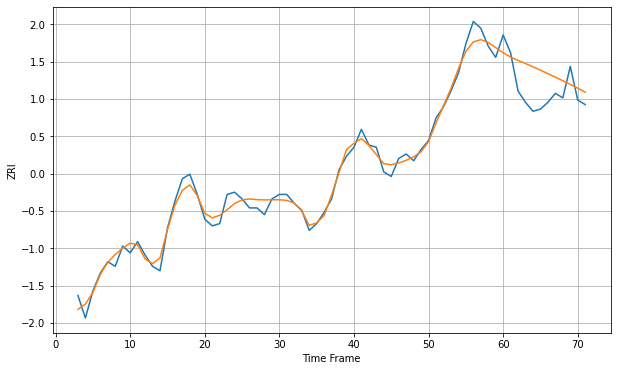

Wall time: 12.3 s
60636 3.4221178656395344 11.68632550249752 [1202.06369108 1200.15440201 1198.67224308 1197.26031478 1195.80305665
 1194.30746094 1192.77678182 1191.21354169 1189.61593629 1187.97560184
 1186.27829762 1184.50981353]

Got an mse at 0.0099 in round 160 and stopped training



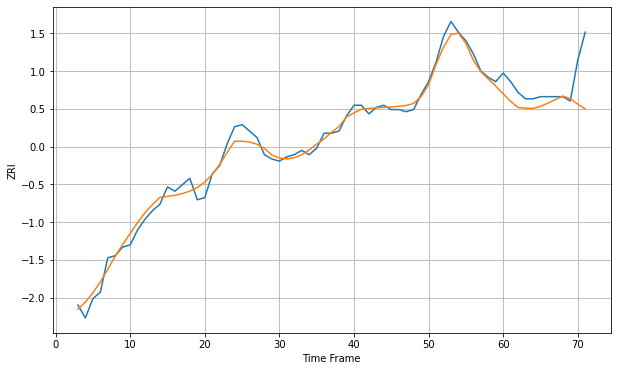

Wall time: 8.5 s
60637 3.431639965009292 12.881036844166124 [1204.34747634 1200.81204088 1197.97864014 1197.61817072 1197.52119333
 1198.46342078 1199.98642014 1201.67006231 1203.28129677 1202.09477576
 1199.51060988 1197.32956172]

Got an mse at 0.0100 in round 224 and stopped training



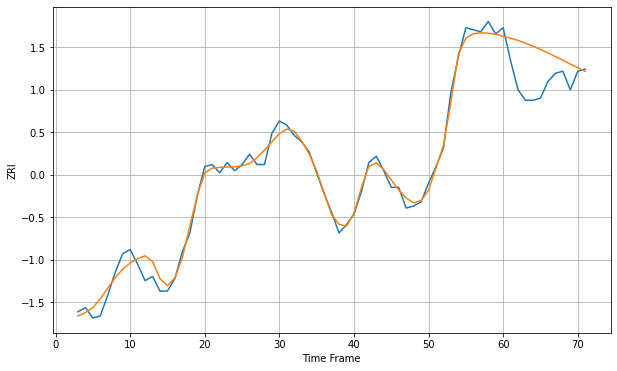

Wall time: 10.6 s
60639 3.827503264311798 16.191094438189275 [1381.93022007 1380.94852197 1379.87267115 1378.5527587  1377.10137227
 1375.52774347 1373.84962109 1372.09504692 1370.29831582 1368.4917356
 1366.69815664 1364.92817605]

Got an mse at 0.0099 in round 114 and stopped training



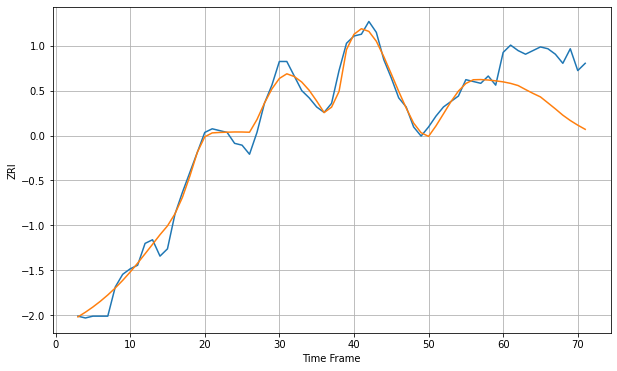

Wall time: 7.68 s
60640 5.002699107886681 27.5915228309851 [1487.79989469 1486.95932991 1485.78107402 1483.58025778 1481.46915375
 1479.52460384 1476.25096358 1472.94786476 1469.48322124 1466.54829922
 1463.99624247 1461.70597955]

Got an mse at 0.0100 in round 239 and stopped training



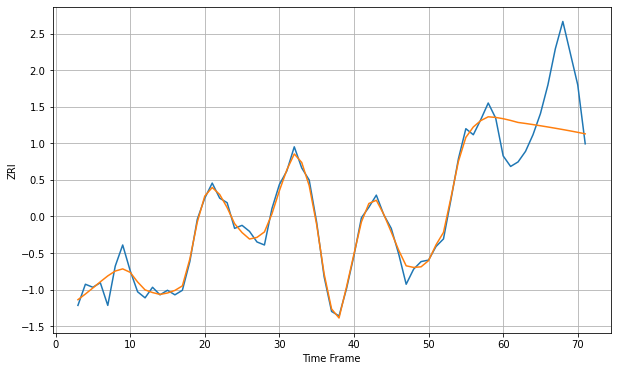

Wall time: 10.5 s
60641 5.020606287323792 35.38339788429453 [1557.61795826 1556.46905593 1555.13398206 1554.45905016 1553.72132
 1552.94124604 1552.1309434  1551.29480924 1550.43085284 1549.53270618
 1548.59178327 1547.59901652]

Got an mse at 0.0100 in round 253 and stopped training



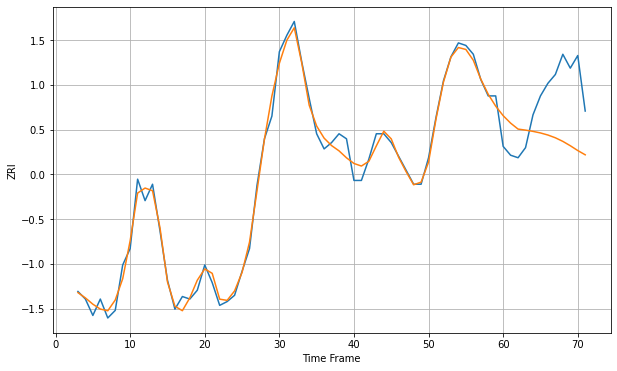

Wall time: 10.8 s
60642 6.604003580404282 43.39864322552224 [1968.35303908 1962.42698585 1957.70136591 1956.87785366 1955.89125095
 1954.64384172 1952.99966242 1950.80611022 1947.96054162 1944.51245674
 1940.70082836 1937.32219408]

Got an mse at 0.0099 in round 148 and stopped training



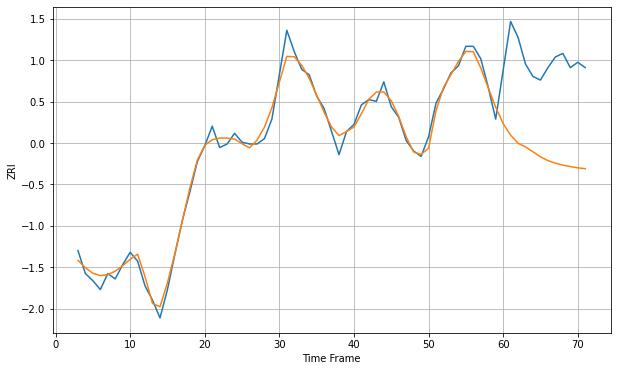

Wall time: 8.46 s
60644 4.391316437397734 53.66157899269604 [1232.48603478 1225.96917425 1221.39505976 1219.34931004 1216.57413847
 1213.77852782 1211.63712936 1210.19074827 1209.10380769 1208.24383717
 1207.56891804 1207.06881532]

Got an mse at 0.0095 in round 83 and stopped training



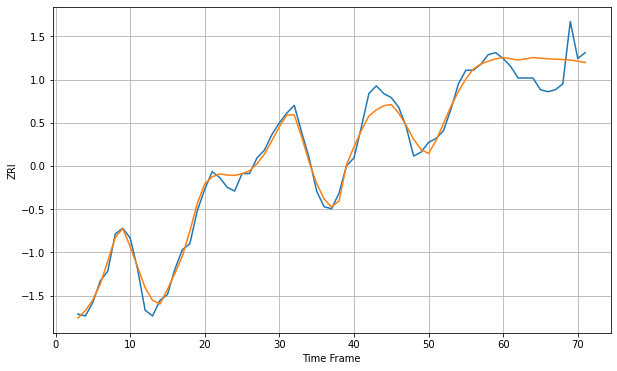

Wall time: 6.85 s
60645 4.4756130325862795 11.799081507509579 [1499.52059004 1498.87613073 1498.20281862 1498.80813418 1499.51285304
 1499.15046475 1498.86739748 1498.6584878  1498.4942904  1498.25312506
 1497.65214685 1496.94875027]

Got an mse at 0.0099 in round 130 and stopped training



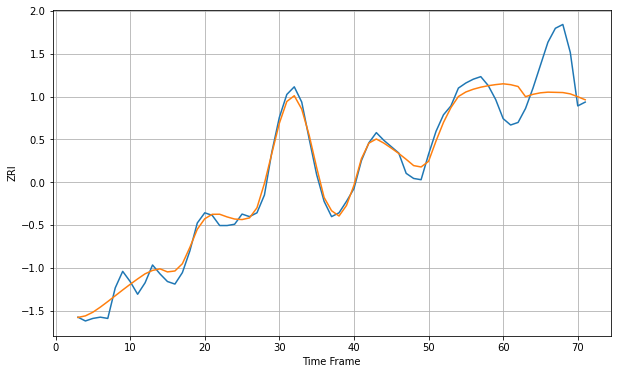

Wall time: 8.18 s
60647 6.437494106498175 30.525147228848176 [1638.37474307 1637.68788072 1636.25811746 1628.26197195 1630.10802327
 1631.28644817 1631.80410495 1631.65831803 1631.49945561 1630.44357313
 1628.21549722 1625.81829801]

Got an mse at 0.0100 in round 102 and stopped training



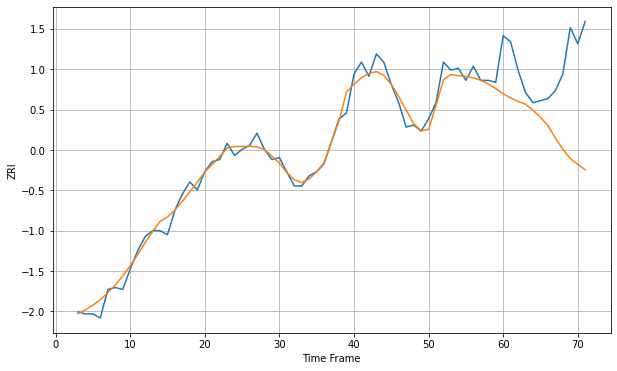

Wall time: 7.35 s
60649 4.145101348149895 37.678251265800924 [1092.4452742  1090.34018287 1088.63580944 1087.26066552 1084.28366264
 1080.80172856 1076.73182367 1070.60150092 1065.07364932 1060.49442248
 1057.67072447 1054.94299254]

Got an mse at 0.0100 in round 188 and stopped training



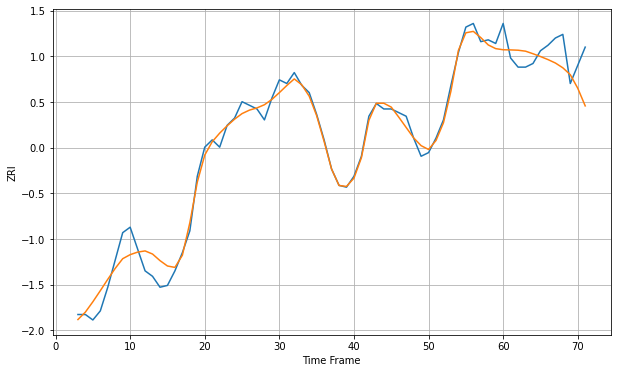

Wall time: 9.16 s
60651 5.580571735857726 13.676879475194074 [1360.54622713 1360.45779321 1360.29499379 1359.7675996  1358.35404325
 1356.82562478 1355.16449156 1353.26187855 1350.62559685 1346.84050618
 1339.4034178  1329.68844605]

Got an mse at 0.0100 in round 64 and stopped training



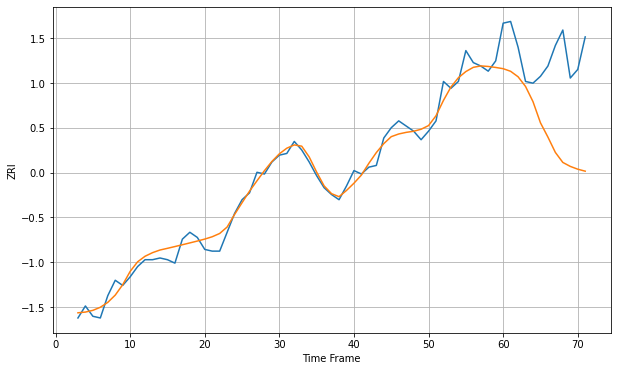

Wall time: 6.72 s
60653 4.7803299478843995 46.96988321968139 [1424.45413785 1422.92608057 1419.73810229 1414.08396795 1405.22073316
 1392.88454184 1384.54281088 1375.58642733 1369.74948607 1367.43470101
 1365.81047878 1364.64598528]


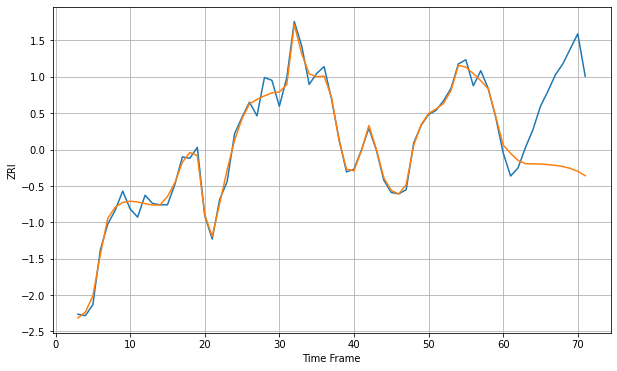

Wall time: 15.7 s
60654 5.07909667400494 56.86343656408221 [2134.70992881 2128.5796345  2123.4490216  2121.02385539 2120.96710267
 2120.76539348 2120.4040088  2119.83558306 2118.96341868 2117.6163562
 2115.49832993 2112.24593574]

Got an mse at 0.0099 in round 123 and stopped training



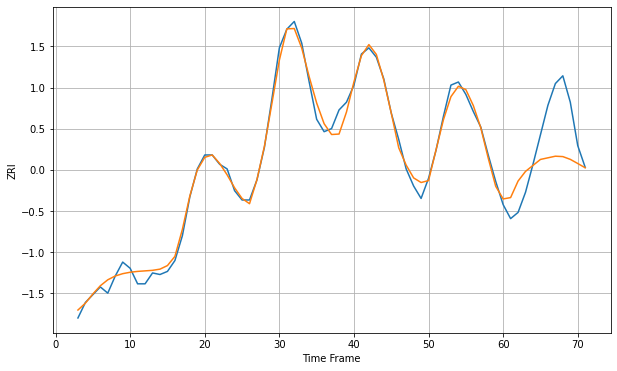

Wall time: 7.87 s
60657 4.611475463737852 26.722755953035218 [1726.67407049 1727.55789748 1738.19444188 1744.42806785 1748.27800495
 1752.12671428 1753.16850953 1754.20889242 1753.95462654 1752.17112017
 1749.5015653  1746.74880036]

Got an mse at 0.0100 in round 163 and stopped training



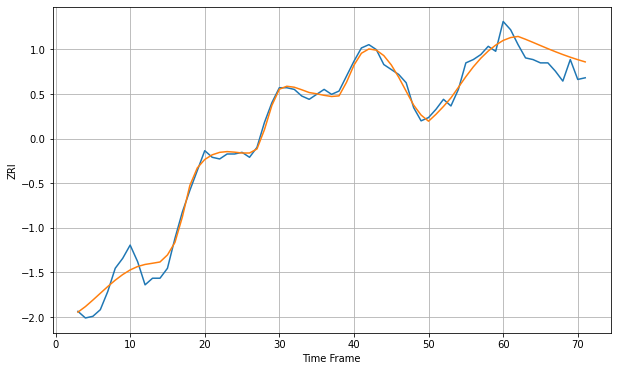

Wall time: 9.05 s
60660 5.094637041159022 10.109772857274928 [1400.55104436 1402.28349747 1402.96122544 1401.23877006 1399.3769319
 1397.46416658 1395.5710951  1393.74802628 1392.02671264 1390.42404669
 1388.94603774 1387.59123868]

Got an mse at 0.0099 in round 196 and stopped training



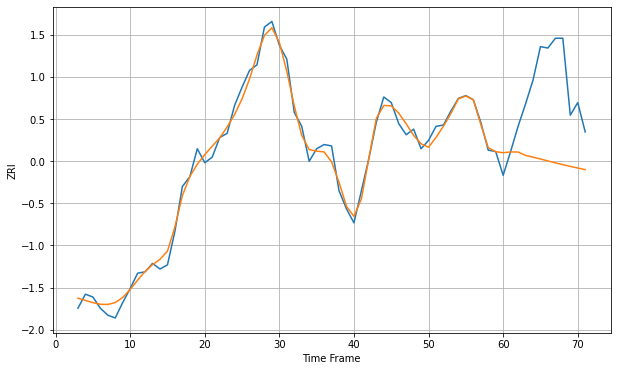

Wall time: 9.87 s
60661 5.564300419200629 56.50113633905776 [2067.20322799 2067.67972551 2067.6681361  2065.23892    2064.01103391
 2062.65956067 2061.26828868 2059.90853809 2058.61112149 2057.37801744
 2056.20478646 2055.09130022]


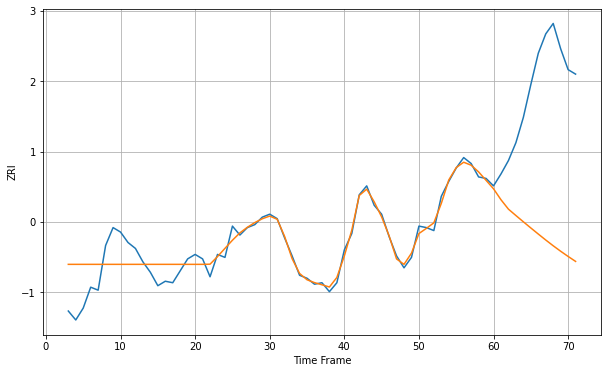

Wall time: 16 s
60804 10.545457492706866 101.66741280653052 [1359.03731243 1351.68698548 1345.37088961 1341.09857412 1336.88442398
 1332.74745884 1328.66916335 1324.667483   1320.80191069 1317.1220257
 1313.63423914 1310.30878154]

Got an mse at 0.0100 in round 47 and stopped training



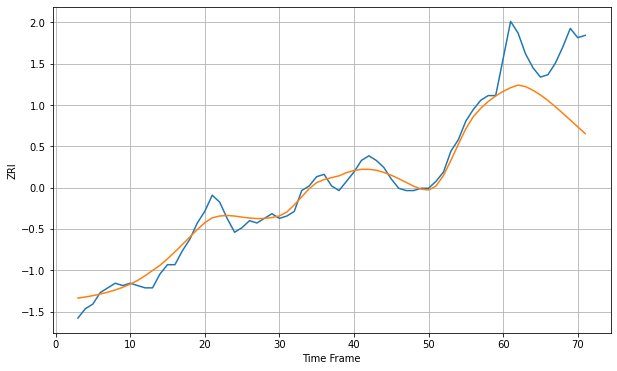

Wall time: 6.36 s
61104 3.716983147863779 25.850332177058544 [635.81427035 637.40295976 638.5535435  637.88109191 636.2991684
 634.28490084 631.88326161 629.19667328 626.35012769 623.43788238
 620.50879236 617.59318195]

Got an mse at 0.0099 in round 109 and stopped training



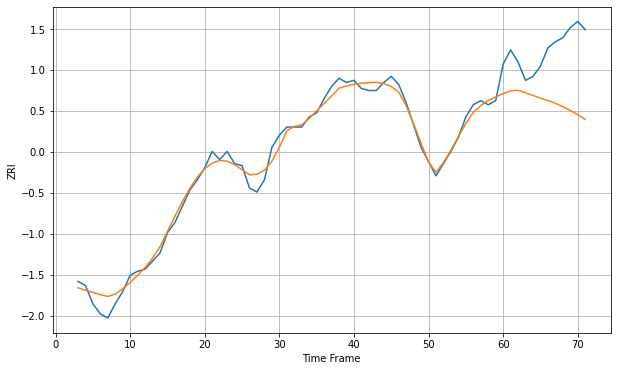

Wall time: 7.73 s
63104 3.733322475785932 28.362455875433138 [833.53912581 834.80362244 835.11752822 833.86186971 832.57602087
 831.23089888 830.04370921 828.6897378  827.0801791  825.22275954
 823.12177707 820.75442694]

Got an mse at 0.0098 in round 56 and stopped training



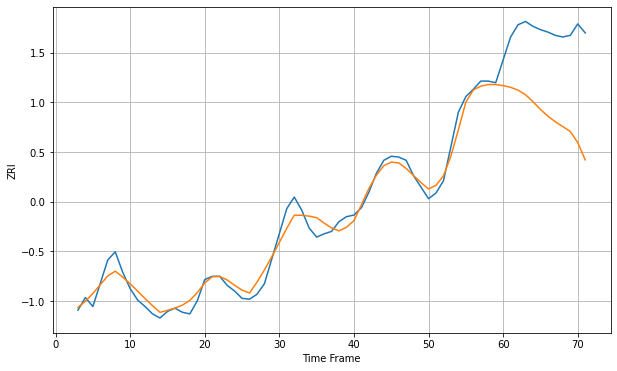

Wall time: 6.29 s
63105 10.862846345795342 104.18718265071332 [1198.49994217 1196.37212173 1192.9435748  1187.29150211 1178.85374969
 1169.35021981 1160.96738162 1154.16351326 1148.24587175 1142.25654754
 1128.723317   1107.58302464]

Got an mse at 0.0100 in round 364 and stopped training



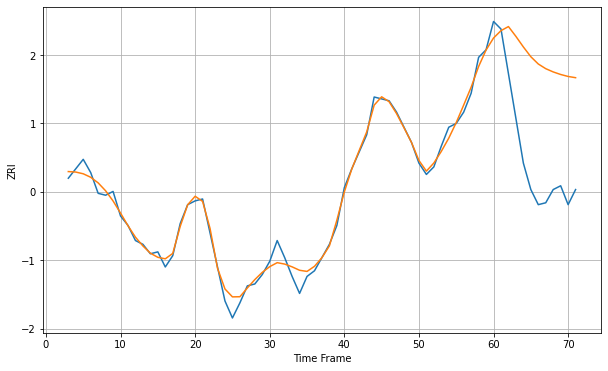

Wall time: 12.7 s
63107 3.8794886080277626 55.8067187640105 [785.24079095 789.13247357 791.2998449  786.10051983 780.50372003
 775.33488705 771.48016361 769.00029724 767.28327232 765.92513175
 764.88276794 764.22742121]

Got an mse at 0.0099 in round 96 and stopped training



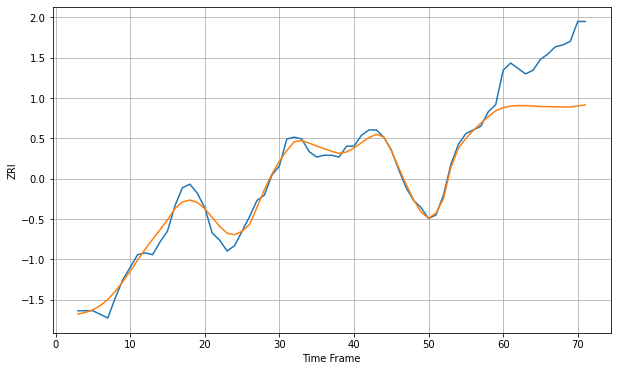

Wall time: 7.39 s
63108 4.268081883574462 31.032548634229318 [936.29180467 937.17391782 937.4716228  937.43637419 937.2734562
 936.92818281 936.91408289 936.78307355 936.71676228 936.71620385
 937.25341106 937.79942271]

Got an mse at 0.0100 in round 256 and stopped training



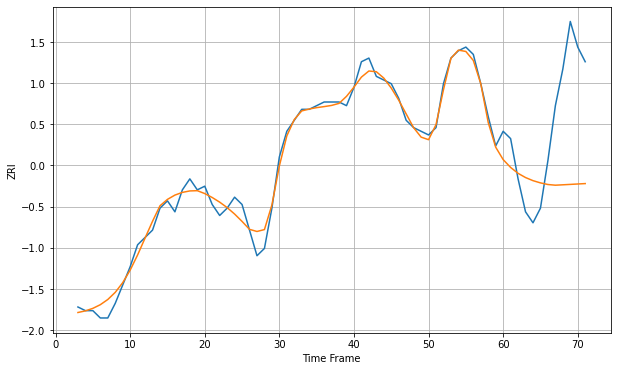

Wall time: 11 s
63109 2.299592896751771 23.084140672596046 [738.26840926 736.12277154 734.51078526 733.36217797 732.51306114
 731.90176152 731.46029285 731.27272092 731.37837941 731.48951945
 731.60213283 731.71288561]

Got an mse at 0.0100 in round 164 and stopped training



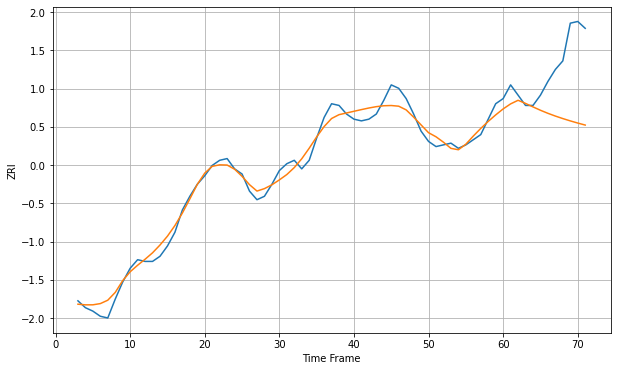

Wall time: 8.82 s
63110 4.79018170016573 32.16649435966714 [880.97135637 883.91375417 886.00685691 884.18005776 882.15537205
 880.19332533 878.40905816 876.80313454 875.3396263  873.98779109
 872.72869407 871.55059321]

Got an mse at 0.0100 in round 119 and stopped training



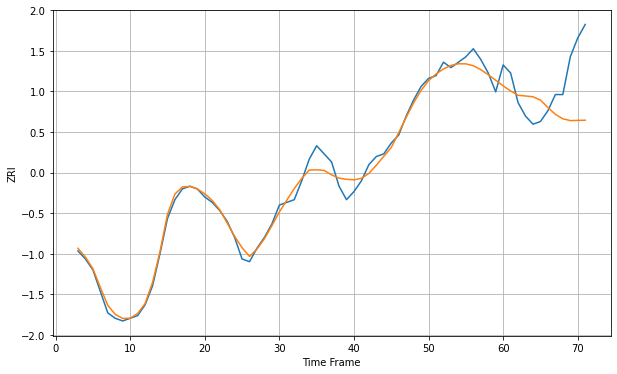

Wall time: 7.8 s
63111 2.7574656977530045 16.39955989099118 [683.23747591 681.34304107 679.71368108 679.47254186 679.17228874
 677.93594924 675.19339405 672.66360092 671.00151418 670.34719078
 670.40817658 670.48123784]

Got an mse at 0.0099 in round 211 and stopped training



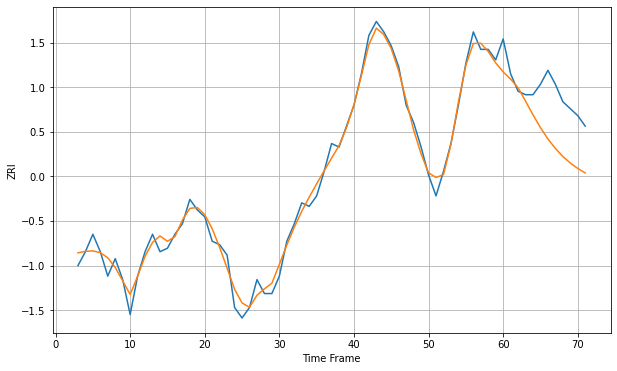

Wall time: 9.76 s
63112 2.5581931723951494 12.609194705340133 [771.53336268 769.47354852 767.00848247 763.17419788 759.22966016
 755.56922886 752.3328414  749.58899506 747.30648141 745.4227478
 743.86924338 742.57824914]

Got an mse at 0.0099 in round 186 and stopped training



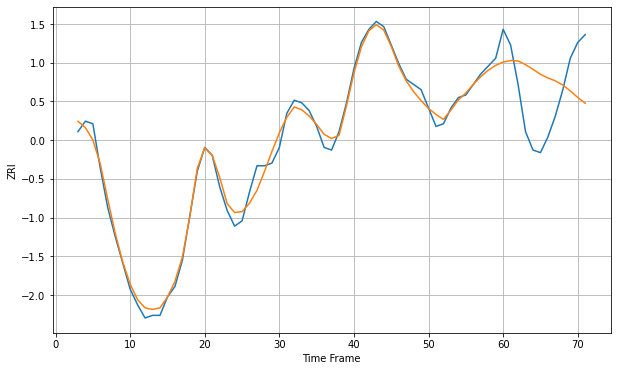

Wall time: 9.4 s
63113 2.893575256864312 19.84562971567377 [748.51074573 749.10832688 748.97060981 747.52228039 745.77444889
 743.85133658 742.48061761 741.34686316 739.77119826 737.54090455
 735.04748644 732.83558995]

Got an mse at 0.0100 in round 165 and stopped training



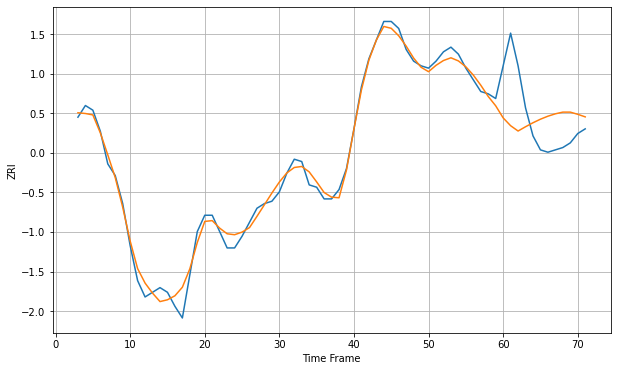

Wall time: 9.01 s
63115 3.4552854331832332 18.468096451251373 [658.70271921 655.35256523 653.07591011 654.904737   656.61831547
 658.14258178 659.42650564 660.44361245 661.16909138 661.16779735
 660.23497055 659.13702423]

Got an mse at 0.0099 in round 109 and stopped training



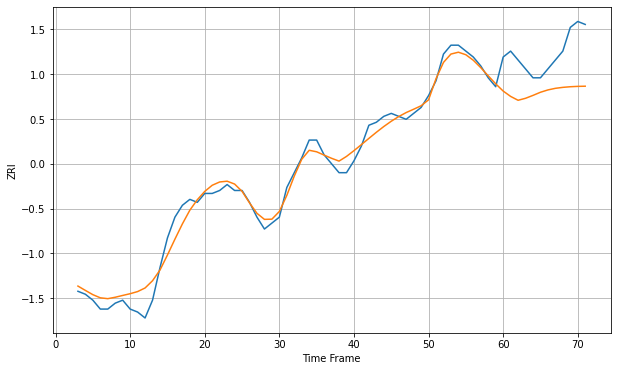

Wall time: 7.83 s
63116 3.3185933537834083 13.877450405796177 [690.53536435 688.72731866 687.4200045  688.09082196 689.06859584
 690.12249715 690.9101224  691.45217372 691.7755779  691.98523075
 692.10973113 692.16511318]

Got an mse at 0.0100 in round 69 and stopped training



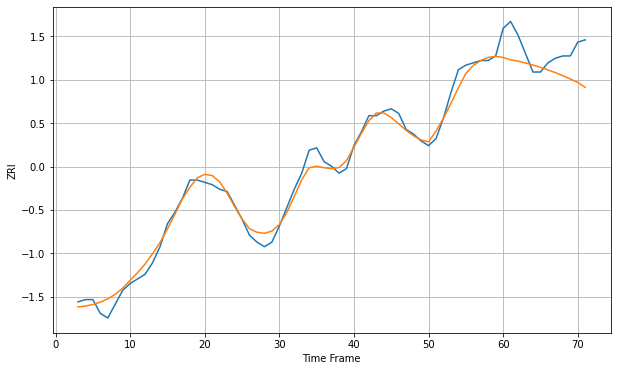

Wall time: 6.82 s
63118 3.3654858012797715 11.369127771112481 [732.34489363 731.31644785 730.7527557  729.93438017 729.02977023
 728.04556235 726.95293026 725.72699959 724.38531344 722.97195753
 721.5082887  719.34016043]

Got an mse at 0.0100 in round 87 and stopped training



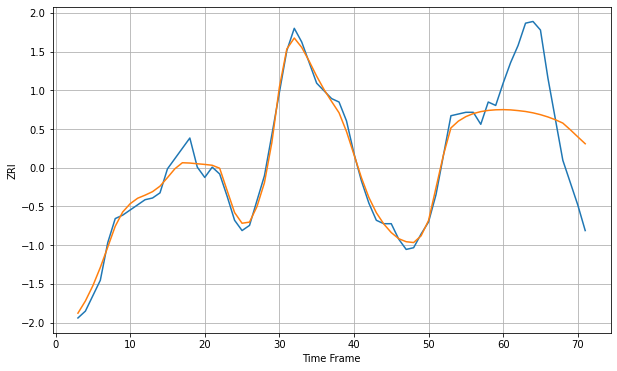

Wall time: 7.51 s
63130 4.528451628166229 37.035386180675864 [1029.55911162 1029.40633502 1028.99524298 1028.47239148 1027.68669924
 1026.6262625  1025.28649501 1023.66771811 1021.70127009 1017.82640362
 1013.7063297  1009.65824674]

Got an mse at 0.0098 in round 110 and stopped training



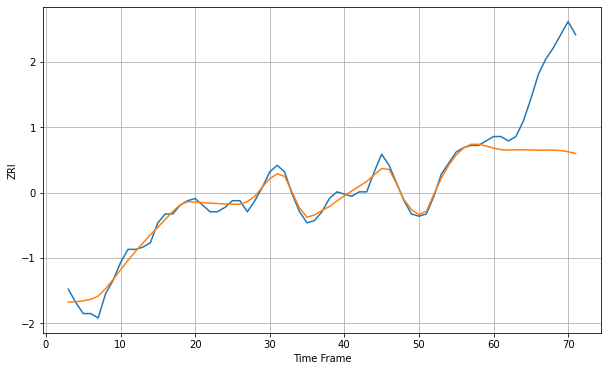

Wall time: 7.33 s
63139 3.010230081463922 35.22469920899655 [800.76262146 800.0856684  799.86946505 799.98558163 799.99526718
 799.91929214 799.84185968 799.85853151 799.87063831 799.66065908
 799.14362989 798.3243895 ]

Got an mse at 0.0099 in round 115 and stopped training



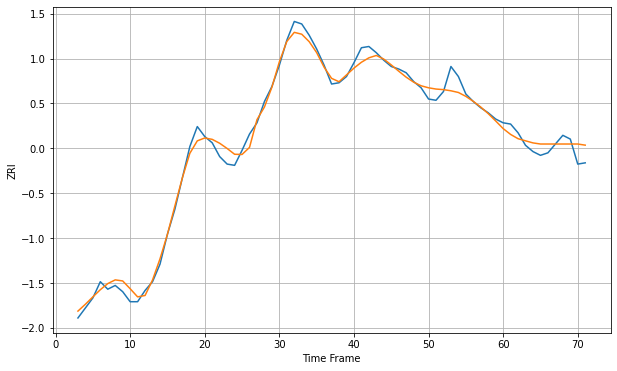

Wall time: 8.47 s
64111 6.22285245754269 8.297564333162006 [1006.37924533 1001.71005962  998.29465394  996.60106628  994.93240361
  994.0469203   994.0469203   994.0469203   994.0469203   994.0469203
  994.0469203   993.14108765]

Got an mse at 0.0100 in round 162 and stopped training



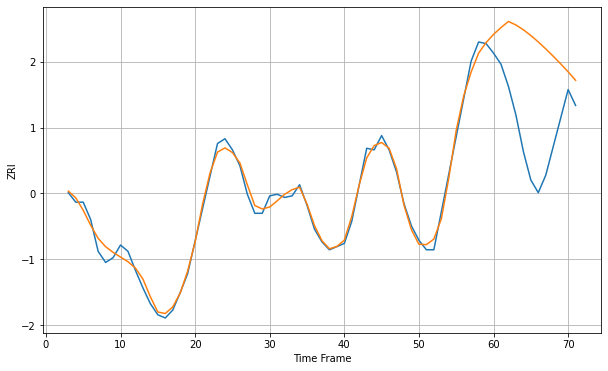

Wall time: 8.79 s
64801 4.035554352399103 57.6872925067853 [832.79116963 837.10569466 840.94544243 838.73953274 835.72153192
 832.0986617  828.03477117 823.65543388 819.04381823 814.23303499
 809.20109827 803.87318417]

Got an mse at 0.0099 in round 195 and stopped training



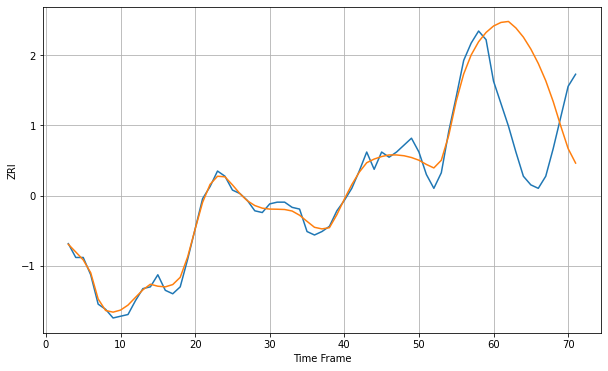

Wall time: 9.48 s
64804 4.256316882555733 56.023609629966394 [871.89486116 873.97959004 874.53368172 870.76976072 865.47878421
 858.58444518 850.23736704 840.26186638 828.19204222 814.20796368
 800.99957804 792.60654858]

Got an mse at 0.0100 in round 126 and stopped training



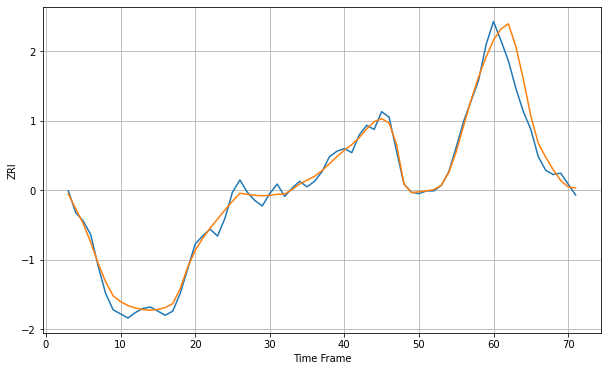

Wall time: 8.02 s
64834 4.807973545753976 15.407167721964115 [906.39084288 914.53510286 918.26614657 901.52570178 877.63966292
 850.73576223 830.87106481 820.63612611 811.51887209 803.65576589
 798.92864813 798.10941059]

Got an mse at 0.0099 in round 76 and stopped training



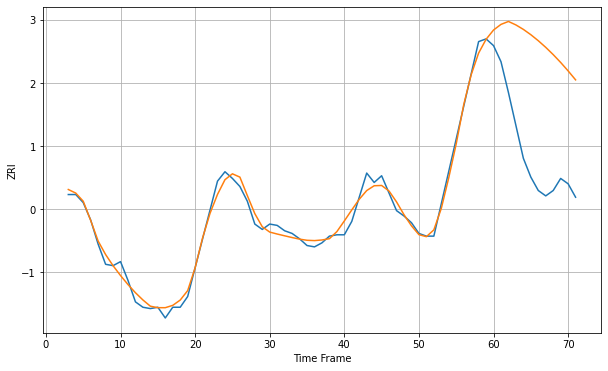

Wall time: 6.56 s
64836 4.9927216953693145 85.15457141602754 [876.62206586 880.82376255 883.00112079 880.41487282 877.08851665
 873.136116   868.65281608 863.69775202 858.29421282 852.44346719
 846.15135934 839.47775492]

Got an mse at 0.0098 in round 83 and stopped training



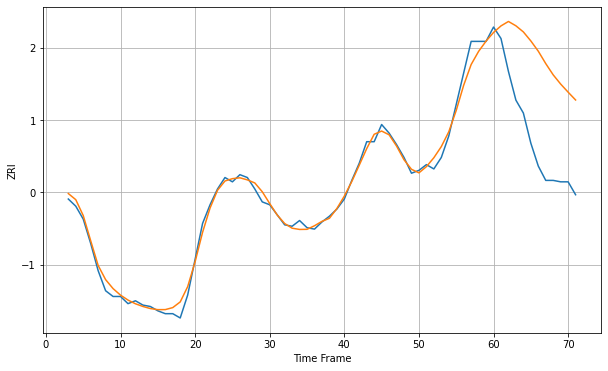

Wall time: 7.41 s
64870 4.504659747762715 60.35813140880908 [889.21668961 893.80682706 896.89906834 893.87199692 889.5984757
 883.31777799 876.15153868 867.49961594 859.63206519 853.21967975
 847.56372587 842.11225805]

Got an mse at 0.0099 in round 217 and stopped training



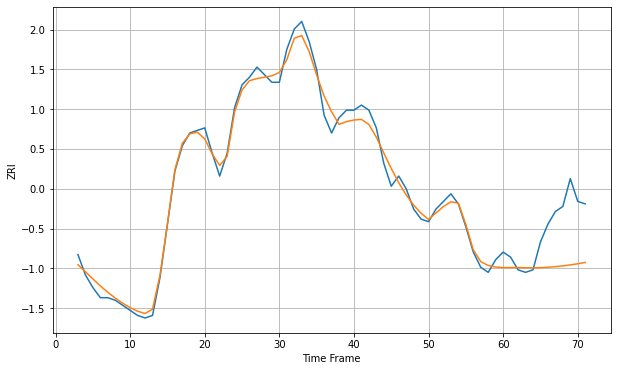

Wall time: 9.96 s
65201 3.2832919018350903 17.72652568344212 [779.88715386 779.86616487 779.9150681  779.80346393 779.78900853
 779.86409685 780.02181515 780.25654902 780.56428871 780.94275596
 781.39136623 781.9109883 ]

Got an mse at 0.0100 in round 398 and stopped training



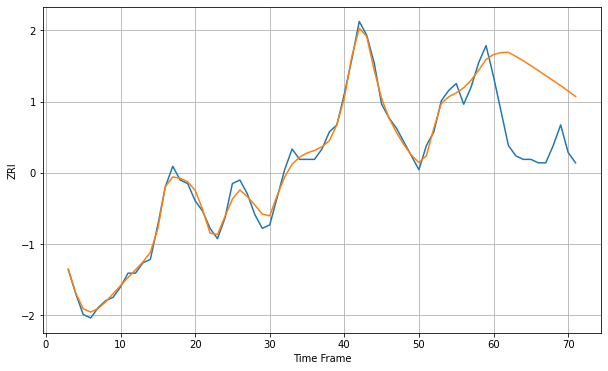

Wall time: 13.8 s
65202 2.0036583689241763 22.31592177021373 [796.41350029 796.95588572 797.03720755 795.84840022 794.59299854
 793.1919134  791.74238606 790.28481455 788.85437917 787.38384904
 785.84010822 784.21828991]

Got an mse at 0.0098 in round 161 and stopped training



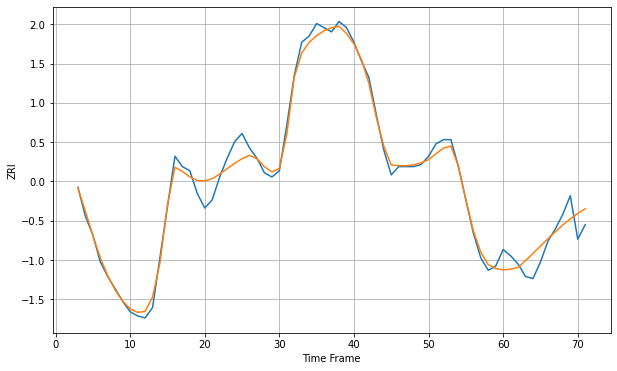

Wall time: 8.98 s
65203 4.07490853441758 8.01793433258405 [803.2399659  803.50564356 804.42321812 807.67668687 811.10704014
 814.64840501 818.18607669 821.61777604 824.85058026 827.80254545
 830.4095597  832.6355768 ]

Got an mse at 0.0100 in round 213 and stopped training



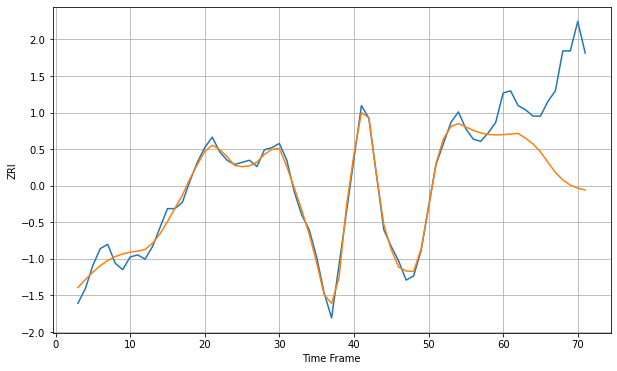

Wall time: 9.41 s
66061 3.529712331103469 43.14173614815786 [1006.15306046 1006.47876076 1006.75693291 1004.49073717 1001.76130003
  998.01267029  993.04983756  988.20082931  984.63845574  982.21251747
  980.75319584  979.88353981]

Got an mse at 0.0100 in round 151 and stopped training



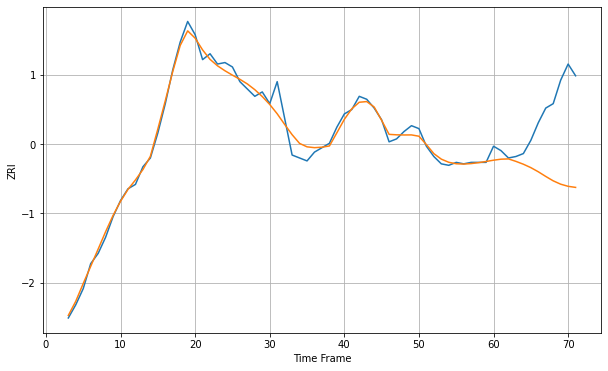

Wall time: 8.91 s
66213 4.886742919752052 45.02258627641748 [1022.48496481 1023.1759049  1023.37019756 1021.68772459 1019.75002077
 1017.42371766 1014.60134604 1011.42122384 1008.42693459 1006.14799776
 1004.69784931 1003.95592841]

Got an mse at 0.0092 in round 35 and stopped training



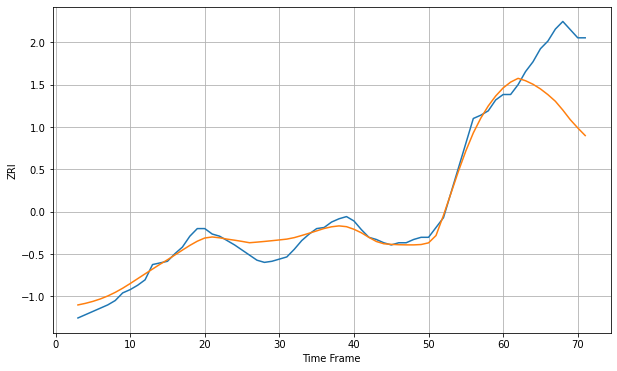

Wall time: 5.99 s
66214 7.890552328153154 55.643658402635126 [854.03036874 859.37002521 862.81780069 860.63835274 857.40353208
 853.12174425 847.87058568 841.7910396  833.72090415 824.88174131
 817.3520991  810.32891082]

Got an mse at 0.0099 in round 129 and stopped training



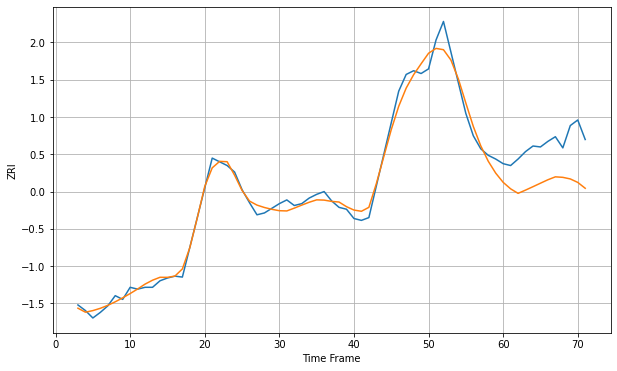

Wall time: 8.29 s
66215 8.256568558537875 43.47018621624169 [1011.93533916 1004.9388851  1000.0737748  1003.57476117 1007.24202828
 1010.99306256 1014.70610399 1017.8413092  1017.2984434  1015.58695855
 1011.85580284 1005.54154468]

Got an mse at 0.0098 in round 250 and stopped training



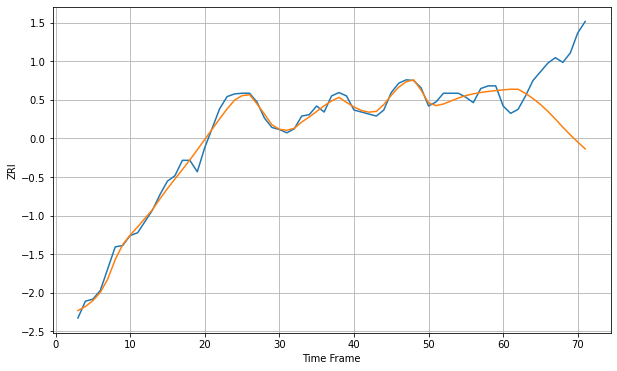

Wall time: 10.5 s
66223 9.088970017515342 94.0902275067228 [1430.04964208 1430.98414912 1430.95988471 1424.74884965 1417.15927717
 1408.22003513 1397.99743202 1386.61558876 1374.29190905 1362.96160679
 1352.26176788 1342.03734089]

Got an mse at 0.0098 in round 161 and stopped training



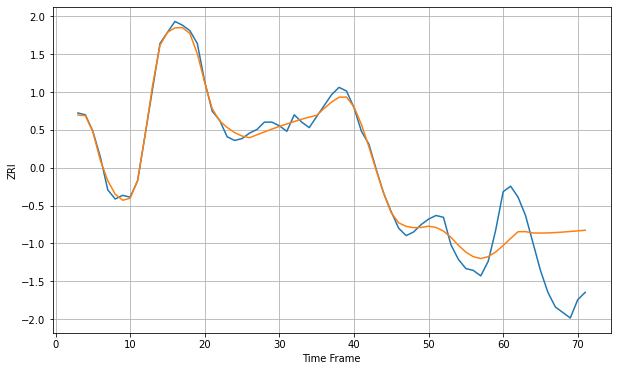

Wall time: 8.51 s
66502 4.086708028775623 31.615172833343006 [811.55710779 815.47919157 819.12091404 819.17052593 818.45005888
 818.39679039 818.4761411  818.66350989 818.93043935 819.24731985
 819.58594543 819.92168802]

Got an mse at 0.0100 in round 191 and stopped training



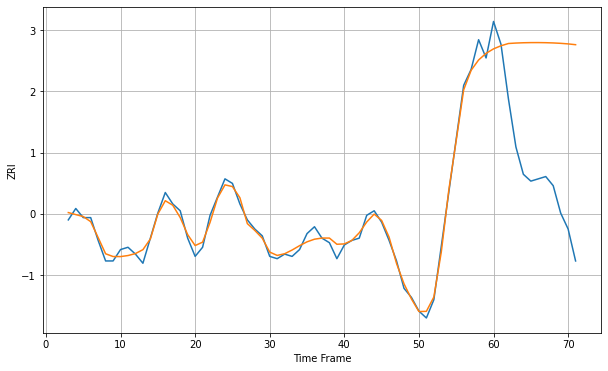

Wall time: 9.47 s
66614 2.6786639399186205 59.06806377680707 [932.98652242 934.34484642 935.33798136 935.53667974 935.66453877
 935.72965262 935.73749656 935.68992659 935.58435209 935.41310729
 935.16296155 934.81482365]

Got an mse at 0.0100 in round 385 and stopped training



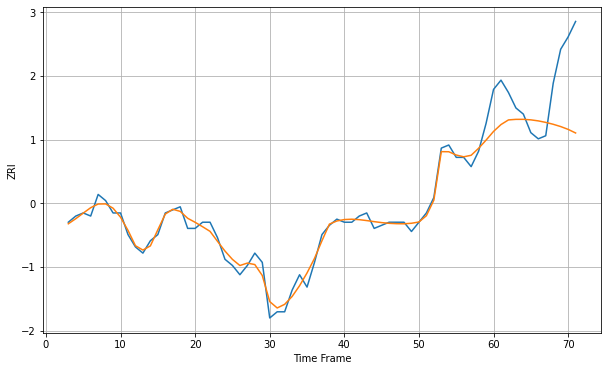

Wall time: 13.6 s
67218 2.163616724536892 17.222577735056827 [648.39415278 650.62246365 652.12479256 652.30359429 652.31184798
 652.14574062 651.81060011 651.32428983 650.71117732 649.97410033
 649.06171962 647.89664585]

Got an mse at 0.0100 in round 187 and stopped training



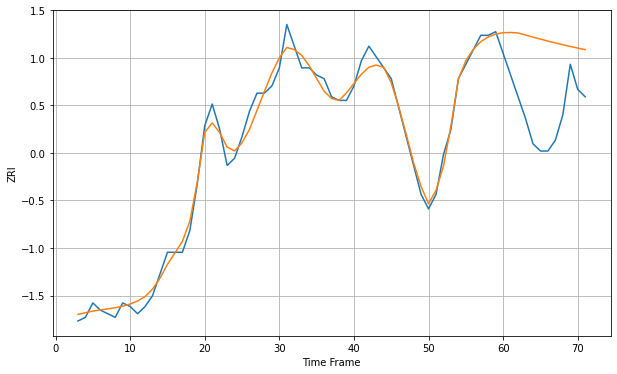

Wall time: 9.37 s
72205 2.500323079761141 20.804687458988766 [743.71953649 743.78123593 743.64966179 743.07523597 742.50436621
 741.94874715 741.4116942  740.89407563 740.39664901 739.92073163
 739.468234   739.0412247 ]

Got an mse at 0.0100 in round 141 and stopped training



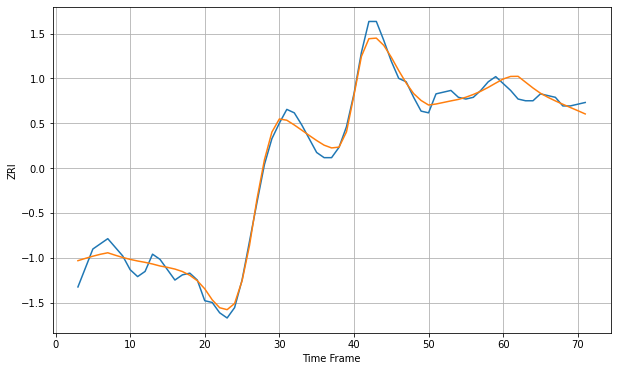

Wall time: 8.24 s
72712 5.045721944465905 6.343583292005252 [929.60994488 931.11299451 931.18051557 927.78675128 924.40974484
 921.36674269 919.00715958 916.91495362 914.97426203 913.10932479
 911.2631357  909.3591048 ]

Got an mse at 0.0099 in round 343 and stopped training



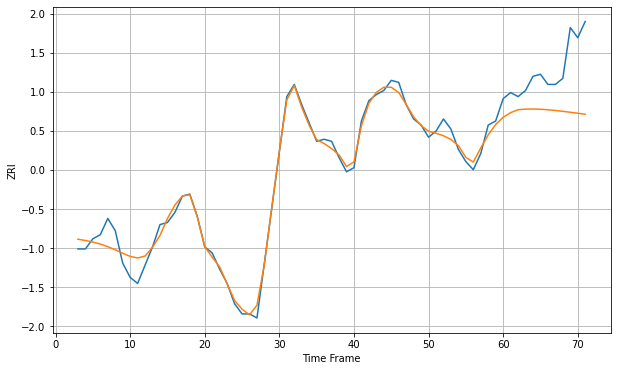

Wall time: 12.3 s
72764 4.190606301586806 23.552142331614316 [914.81642983 917.10096084 918.56145537 918.83473566 918.89337793
 918.77622674 918.52298032 918.17109515 917.75311849 917.29494533
 916.8149609  916.32378409]

Got an mse at 0.0098 in round 121 and stopped training



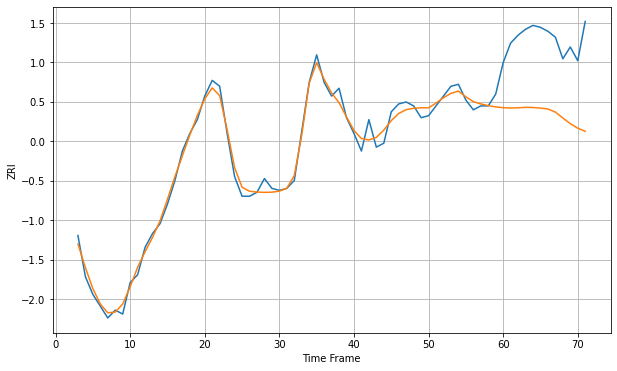

Wall time: 8.2 s
73071 3.693182962277665 38.478399403566925 [848.07935632 847.92438678 848.04776379 848.25296196 848.19903497
 847.88622429 847.40800995 845.85783981 842.84282951 839.96387033
 837.6470466  836.06265373]

Got an mse at 0.0100 in round 120 and stopped training



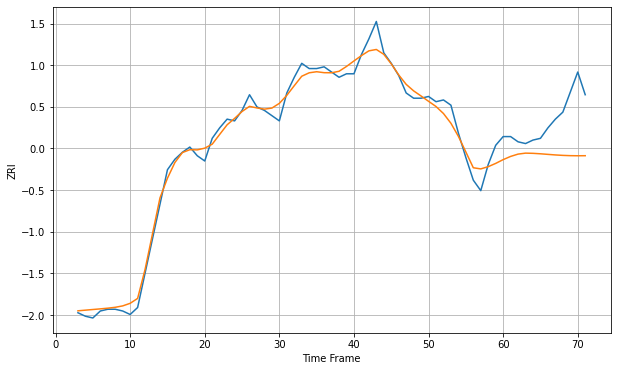

Wall time: 8.06 s
73159 5.108067187398156 23.525165181624896 [690.78668017 692.62069876 693.95391857 694.50797682 694.39599423
 694.13266591 693.7972355  693.47372059 693.21984647 693.06127916
 693.00152537 693.03261237]

Got an mse at 0.0095 in round 27 and stopped training



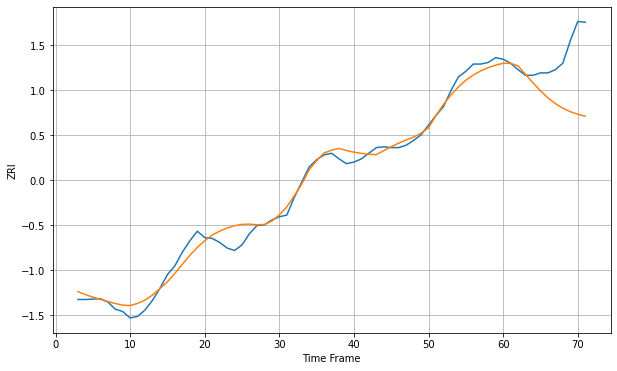

Wall time: 6.06 s
75001 10.584640597008306 58.674021072651605 [1290.93128437 1290.88412196 1287.77216779 1277.11255183 1266.63251076
 1256.76612661 1248.00912508 1240.75264576 1235.06572283 1230.74030618
 1227.48783592 1225.06785255]

Got an mse at 0.0100 in round 57 and stopped training



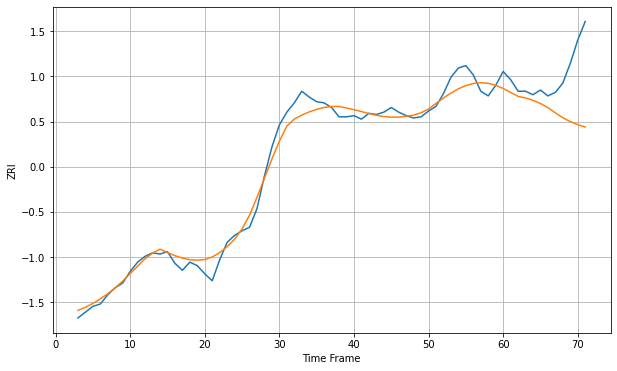

Wall time: 6.66 s
75010 8.173230158058413 38.604658151365186 [1254.36188456 1250.96561312 1247.54898514 1246.21204317 1244.20560907
 1241.43442574 1237.91338472 1233.39513067 1229.224219   1225.84884598
 1223.26499097 1221.25885922]

Got an mse at 0.0099 in round 62 and stopped training



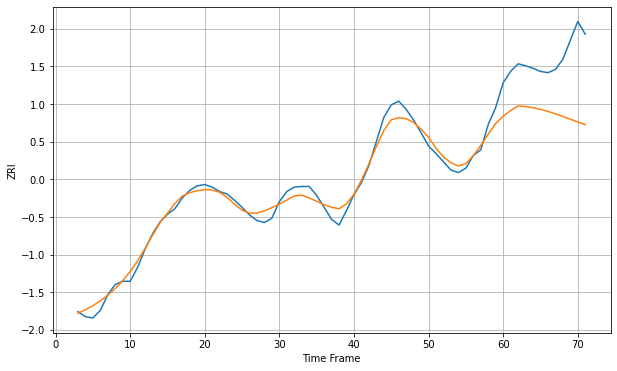

Wall time: 6.47 s
75013 11.796501257279314 91.67475388365163 [1409.1965392  1418.02248896 1425.41465079 1424.38462904 1422.56415793
 1419.98704054 1416.73055343 1412.9203045  1408.72740016 1404.35422061
 1400.00916511 1395.87677655]

Got an mse at 0.0099 in round 27 and stopped training



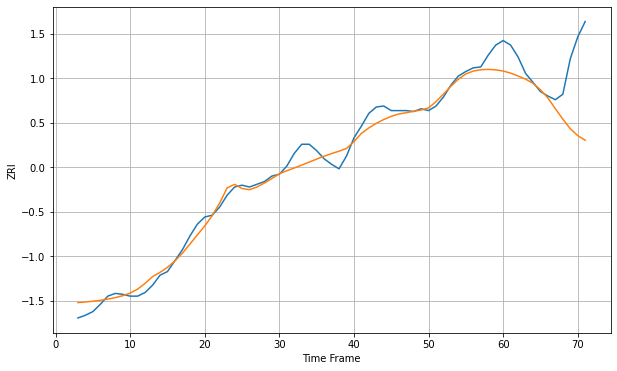

Wall time: 5.99 s
75024 9.662344709147366 56.39578635111176 [1342.50240483 1340.20967554 1337.04018914 1333.61461947 1328.98886032
 1321.90530329 1312.84764235 1301.04164291 1289.62334373 1279.06322911
 1271.4642256  1266.39226498]

Got an mse at 0.0100 in round 70 and stopped training



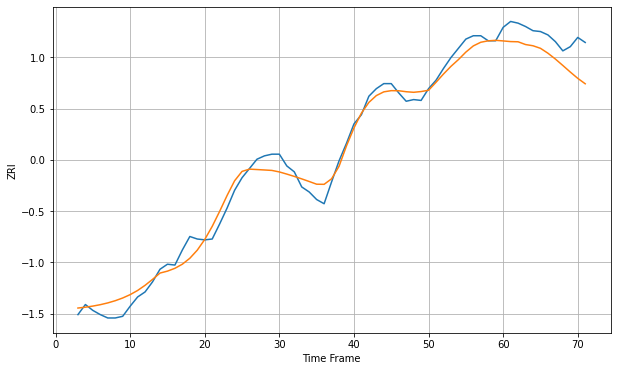

Wall time: 6.89 s
75039 11.742762753623834 28.01584805691819 [1521.83569922 1521.0416114  1520.81670707 1517.52680733 1516.07267874
 1513.04064071 1507.2272673  1500.26827336 1492.62100268 1484.77296421
 1477.29260264 1470.8224404 ]

Got an mse at 0.0099 in round 66 and stopped training



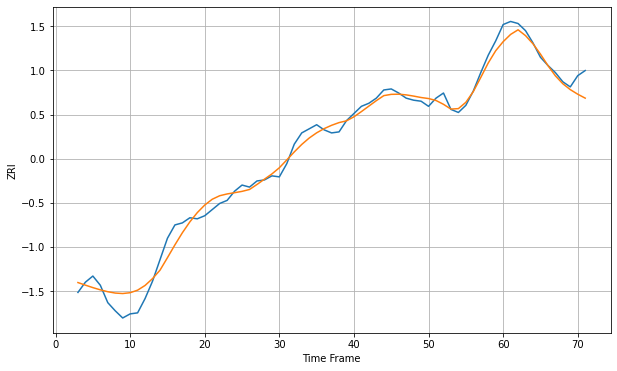

Wall time: 6.79 s
75050 9.160121065874854 11.519794496984382 [1188.2359736  1195.32848352 1199.84612279 1194.14292606 1186.15768064
 1176.06036184 1164.91031257 1154.85844595 1147.08100632 1141.33677842
 1136.83932879 1133.00243135]

Got an mse at 0.0099 in round 120 and stopped training



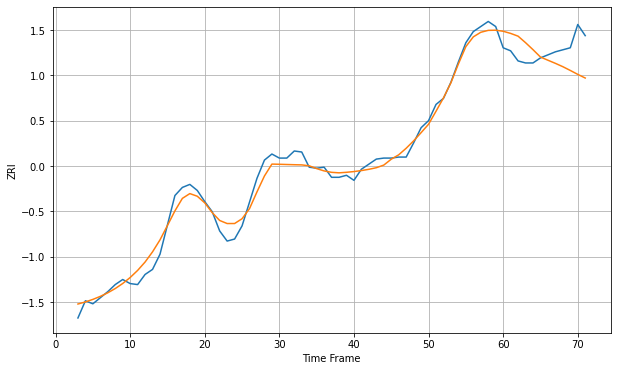

Wall time: 7.76 s
75052 8.27756464537736 23.90554107137698 [1136.3167162  1134.21143485 1131.47637068 1125.06155802 1118.13907127
 1110.85195421 1107.70060626 1104.62210849 1101.31490056 1097.59601236
 1093.72354277 1090.11599677]

Got an mse at 0.0095 in round 363 and stopped training



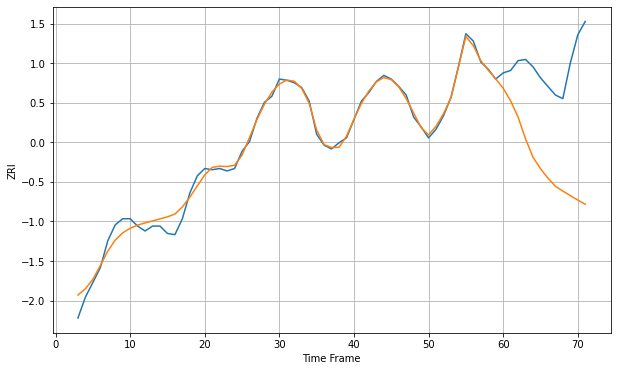

Wall time: 12.6 s
75056 5.56237696743164 85.12631945026266 [1350.51751123 1340.23090145 1326.99087454 1309.21266406 1294.2398522
 1284.90685704 1277.10474077 1270.51707544 1266.56773387 1262.857423
 1259.25326352 1255.85095375]

Got an mse at 0.0096 in round 25 and stopped training



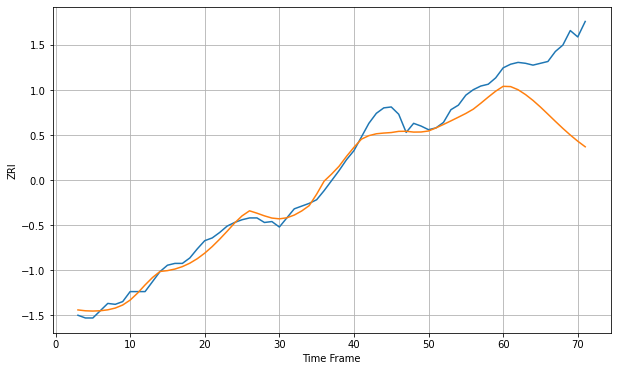

Wall time: 5.74 s
75063 10.510020671052946 76.30876298901211 [1220.68879953 1220.38434854 1216.95173955 1211.62026382 1205.19517822
 1197.90115081 1190.09289677 1182.17352268 1174.45841467 1167.14294711
 1160.35912892 1154.21901128]

Got an mse at 0.0099 in round 38 and stopped training



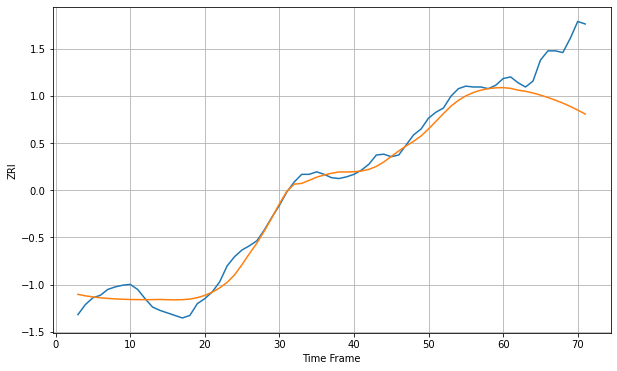

Wall time: 6.46 s
75067 10.690291393943417 58.95378229529932 [1202.21147724 1201.358784   1199.24344553 1197.84665288 1195.82970335
 1193.3176904  1190.47047315 1187.32752029 1183.81486278 1179.85606443
 1175.46798042 1170.79423763]

Got an mse at 0.0099 in round 107 and stopped training



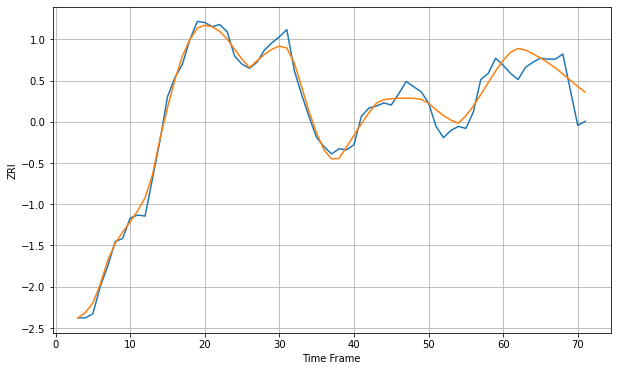

Wall time: 7.65 s
75070 8.299322575803126 19.50637107342957 [1565.92573035 1573.7903707  1577.51559287 1575.87791481 1572.23891458
 1568.12851295 1563.63993227 1558.41073684 1552.54562786 1546.325531
 1540.18576276 1534.58079902]

Got an mse at 0.0099 in round 45 and stopped training



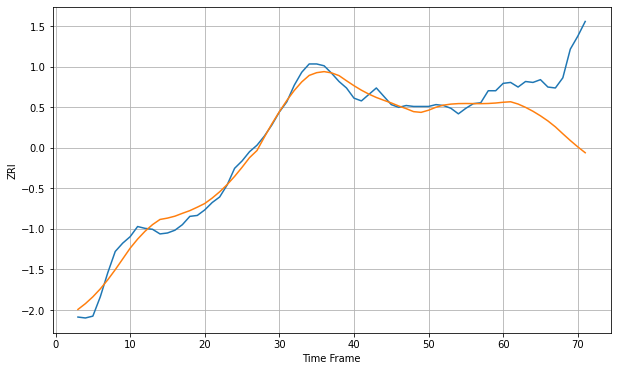

Wall time: 6.45 s
75074 9.23682479092111 68.05403107317387 [1237.52995541 1238.06738446 1235.6174312  1232.02484867 1227.77301214
 1222.84688057 1217.31613017 1210.89761799 1203.412428   1196.14131464
 1189.27398777 1182.89486733]

Got an mse at 0.0100 in round 42 and stopped training



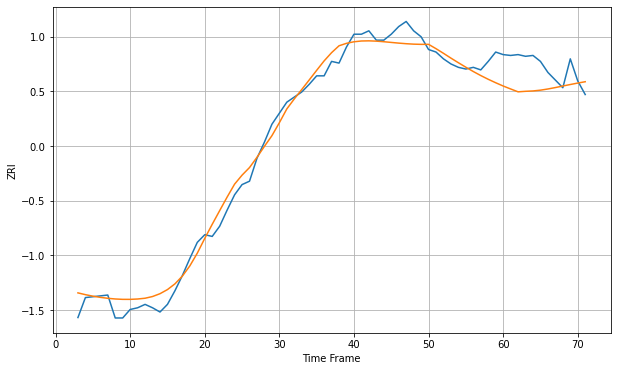

Wall time: 5.98 s
75081 13.130697959280049 30.327778206434246 [1260.0383872  1256.5654836  1253.18771145 1253.79798513 1254.21606378
 1255.13909361 1256.5294895  1258.21031416 1260.00518281 1261.78975027
 1263.49059922 1265.07084298]

Got an mse at 0.0097 in round 38 and stopped training



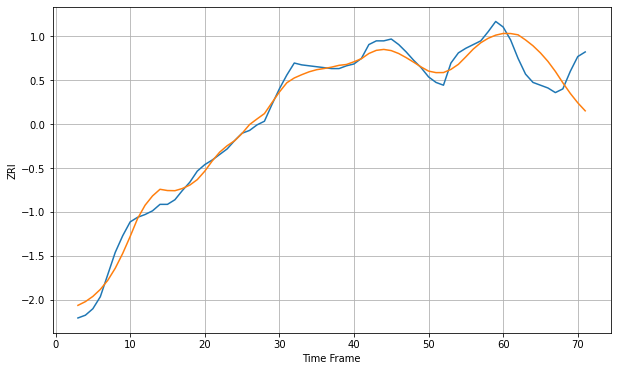

Wall time: 6.1 s
75093 9.271122261642743 33.481021741004824 [1403.02087466 1402.92936429 1401.54836218 1396.02315494 1389.68209122
 1381.94581064 1372.79633306 1361.90919201 1349.63086184 1338.12670938
 1327.95187069 1319.25885781]

Got an mse at 0.0099 in round 62 and stopped training



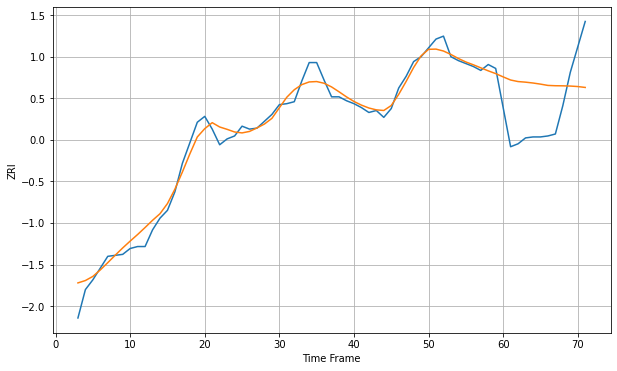

Wall time: 6.63 s
75201 9.5036265635759 50.63204815253097 [1669.36167147 1666.16944644 1664.58917094 1663.97686414 1663.10818096
 1661.97757407 1660.64560574 1660.32953976 1660.23148175 1659.99111094
 1659.50396609 1658.57578149]

Got an mse at 0.0099 in round 126 and stopped training



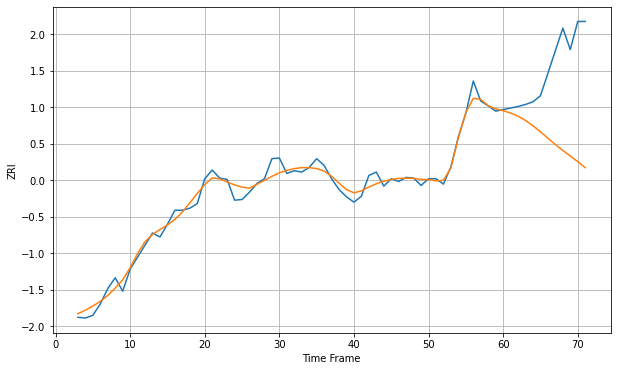

Wall time: 8.01 s
75202 10.555280908716657 123.93635040347587 [1605.66112251 1602.23487012 1597.46310023 1591.11331453 1583.21801449
 1574.14078229 1564.54872361 1555.15859699 1546.35032491 1537.98810491
 1529.57099222 1520.56353086]

Got an mse at 0.0097 in round 43 and stopped training



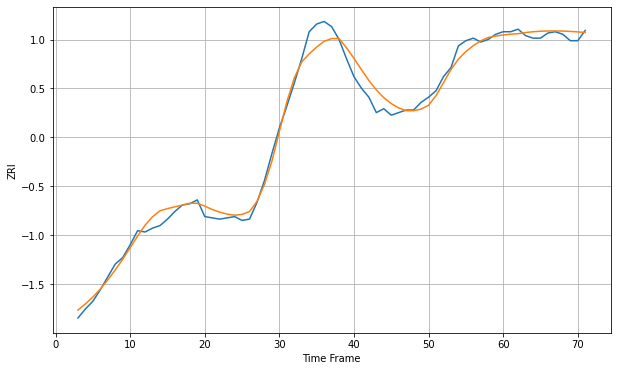

Wall time: 6.12 s
75204 7.420142689083542 4.014866362543383 [1507.47713912 1508.09659186 1508.45941386 1509.34971641 1509.98184674
 1510.38743998 1510.593545   1510.62447349 1510.50237455 1510.24706448
 1509.87530403 1509.39974091]

Got an mse at 0.0099 in round 43 and stopped training



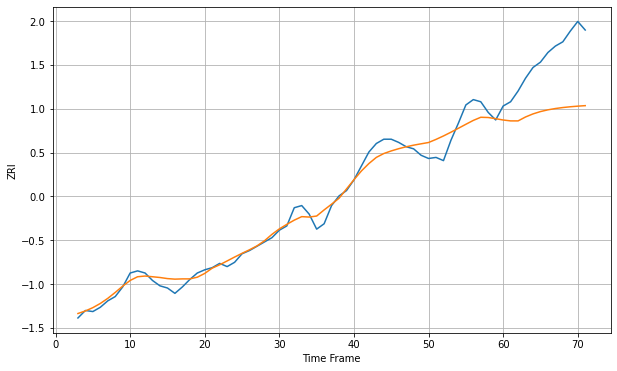

Wall time: 6.09 s
75206 8.401999737218249 52.34750936666054 [1368.94595462 1368.11462065 1368.09857819 1371.77434604 1374.63602478
 1376.81544947 1378.44803844 1379.66654188 1380.58972047 1381.30971154
 1381.88682416 1382.35459873]

Got an mse at 0.0100 in round 169 and stopped training



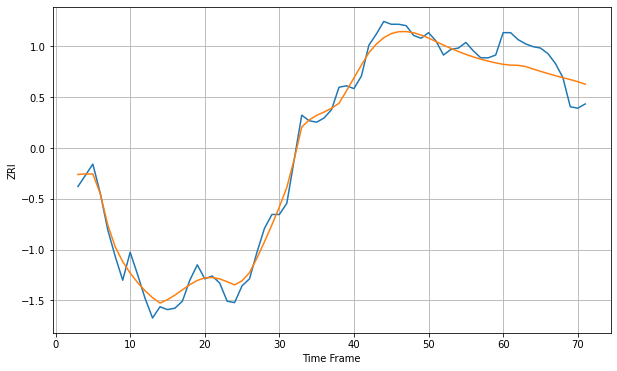

Wall time: 9.37 s
75214 7.026632141867794 16.833657431877743 [1212.34470983 1211.78709593 1211.64530353 1210.78891519 1209.02663603
 1207.37869578 1205.77120443 1204.24092113 1202.8275199  1201.45824548
 1199.95582828 1198.14554134]

Got an mse at 0.0099 in round 40 and stopped training



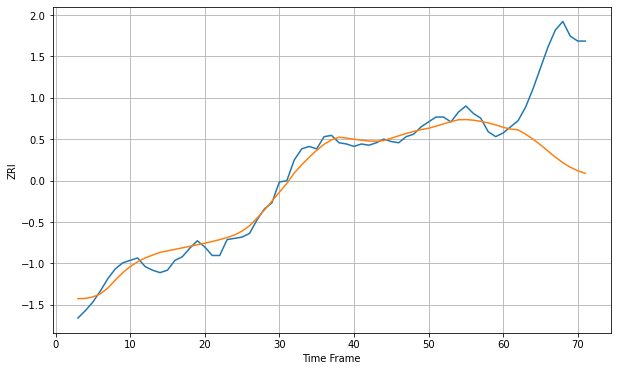

Wall time: 6.28 s
75219 7.212982465068228 77.28785297284752 [1449.60774232 1448.19263483 1447.52235431 1444.03887514 1439.97527679
 1435.33087552 1430.26942661 1425.27463571 1420.76883825 1417.04517282
 1414.17107137 1412.05438227]

Got an mse at 0.0095 in round 37 and stopped training



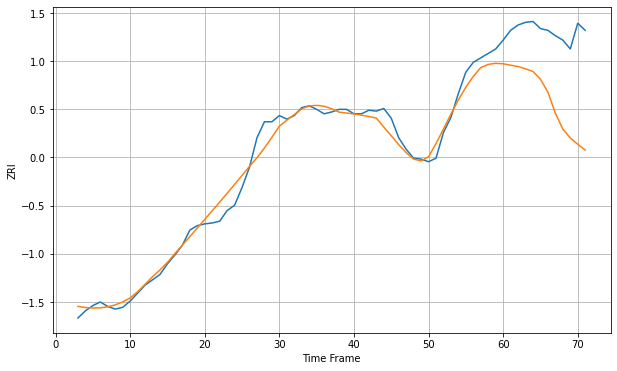

Wall time: 5.94 s
75235 10.802057299551551 83.15440894429368 [1432.35151607 1430.71888883 1429.23152272 1426.66987521 1423.61991559
 1414.91998212 1400.2789114  1376.62780276 1358.77576763 1348.73039939
 1341.63201379 1335.20349309]

Got an mse at 0.0093 in round 46 and stopped training



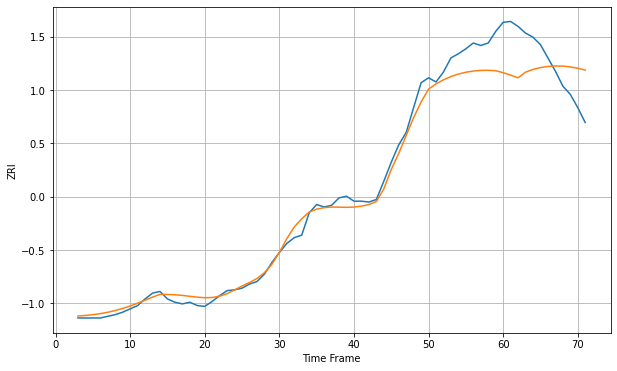

Wall time: 6.12 s
75243 13.45191112047566 45.044600202531655 [1109.16041206 1106.19438322 1102.98522683 1109.7961397  1113.06258221
 1115.32290866 1116.69507872 1117.2662155  1117.08020401 1116.1529367
 1114.52010932 1112.31032434]

Got an mse at 0.0099 in round 38 and stopped training



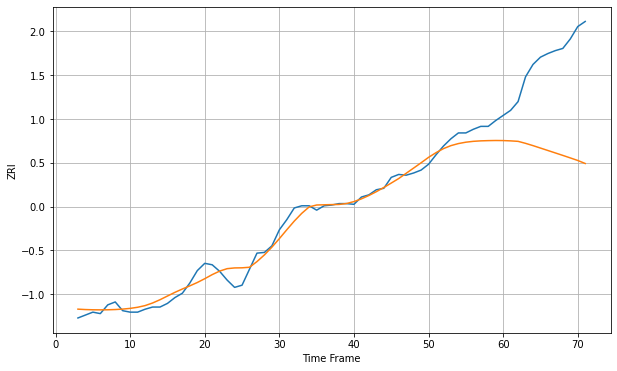

Wall time: 5.93 s
75244 10.991413222944624 129.0098789966163 [1349.49937477 1349.09752645 1348.44835462 1345.70701346 1342.57825022
 1339.23840962 1335.87276127 1332.51747769 1329.14159644 1325.70642067
 1322.19222904 1318.03784272]

Got an mse at 0.0099 in round 79 and stopped training



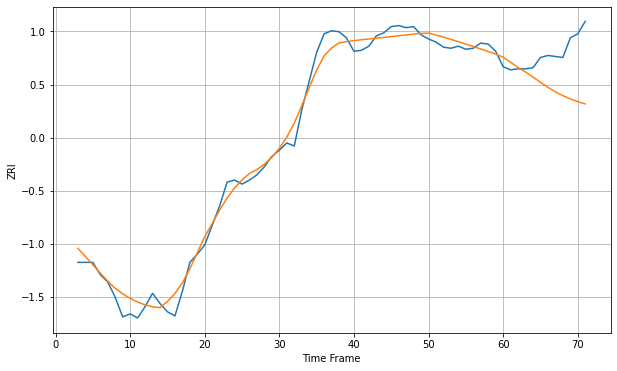

Wall time: 6.96 s
75248 9.67966244746673 39.36310977201729 [1272.26931394 1267.40588354 1262.29351903 1257.90950637 1253.03029405
 1247.93829661 1243.03844736 1238.66627457 1234.9364381  1231.7848925
 1229.10929487 1226.85702739]

Got an mse at 0.0100 in round 77 and stopped training



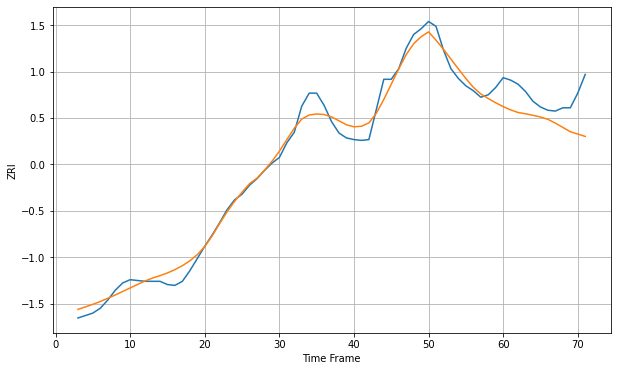

Wall time: 7.12 s
75287 11.38905233918252 35.468399101279786 [1132.45505098 1128.47819667 1125.23662144 1123.66599718 1121.81653733
 1119.72238371 1116.83713591 1112.18443041 1106.95567217 1101.64131336
 1098.80688683 1095.88410403]

Got an mse at 0.0099 in round 74 and stopped training



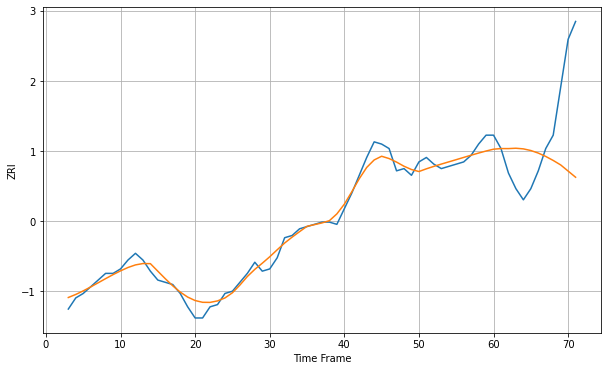

Wall time: 7.1 s
75703 3.36371030301373 30.412598398175657 [902.70389111 902.98665713 902.97839121 903.13555801 902.85072681
 902.11342469 900.96162242 899.45435138 897.65783663 895.65171211
 892.88985568 890.12863307]

Got an mse at 0.0099 in round 43 and stopped training



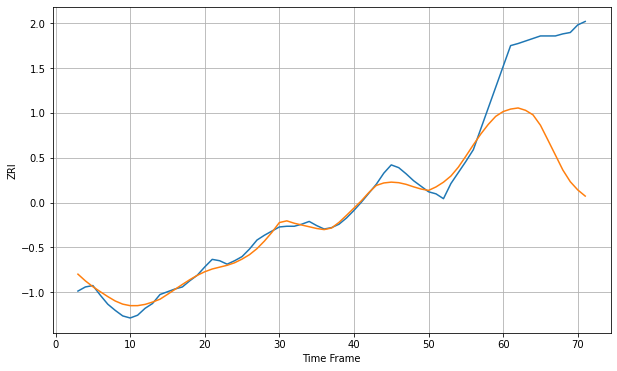

Wall time: 6.22 s
76006 11.713127258674508 163.39372792070105 [988.35481229 991.93871018 993.56707126 990.15247928 983.58845185
 968.49333747 947.0550464  925.38394032 903.62061164 886.60413565
 874.7194537  865.77895865]

Got an mse at 0.0100 in round 43 and stopped training



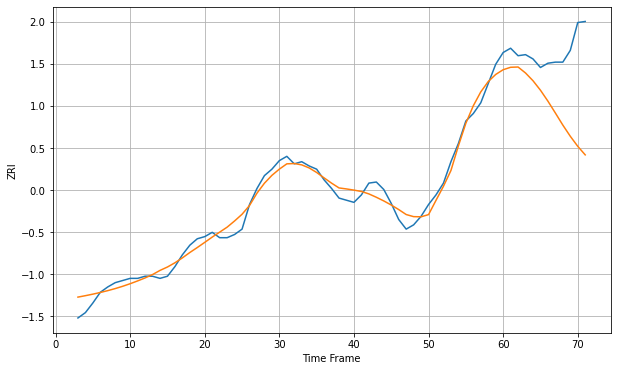

Wall time: 5.85 s
76010 7.730200939833442 60.66536666825163 [1075.92050658 1078.19891576 1078.44825452 1072.85499442 1065.63011321
 1056.77777476 1046.5553245  1035.47793722 1024.1963496  1013.74429428
 1004.36609154  996.36980178]

Got an mse at 0.0099 in round 134 and stopped training



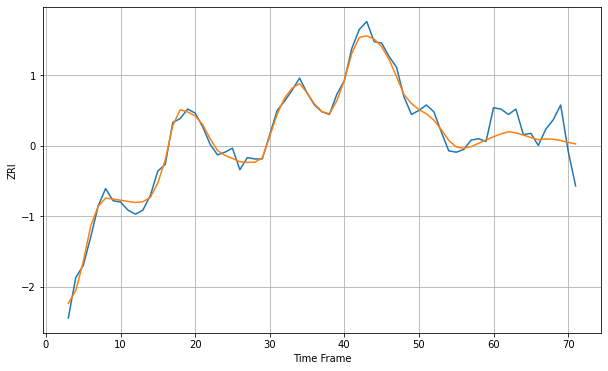

Wall time: 8.95 s
76012 4.841970548364328 16.500226418910632 [1206.48859527 1208.56708339 1210.21948519 1209.33712137 1207.70621697
 1205.89314423 1204.2684948  1204.79027589 1204.69481426 1203.65345069
 1202.28438217 1201.16161716]

Got an mse at 0.0099 in round 47 and stopped training



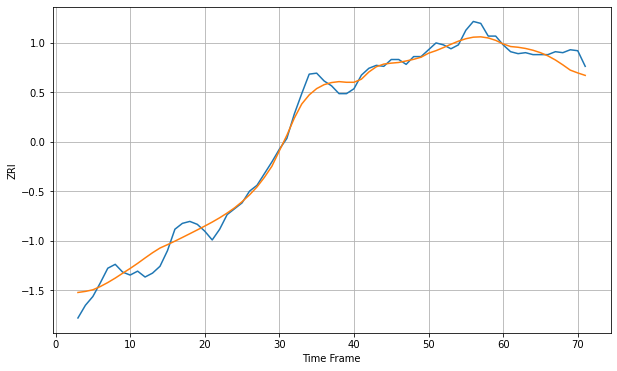

Wall time: 6.16 s
76015 10.034147138312486 10.744556217732637 [1280.93323566 1278.30013906 1277.56392618 1276.32312175 1274.49749665
 1272.00728575 1268.72442404 1264.53265358 1259.51436002 1254.10722819
 1251.23516251 1248.70525519]

Got an mse at 0.0098 in round 29 and stopped training



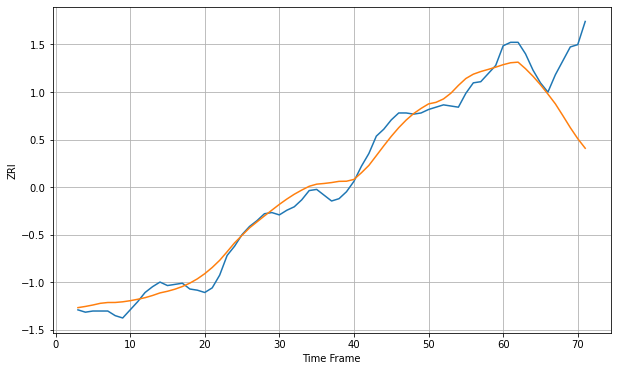

Wall time: 6.25 s
76017 8.990975006574097 47.74997155701233 [1057.67905166 1059.35050248 1059.87345311 1054.19532152 1047.69289384
 1040.34742074 1032.32271198 1023.85556647 1013.73610811 1003.3570004
  993.81041015  985.52929026]

Got an mse at 0.0100 in round 155 and stopped training



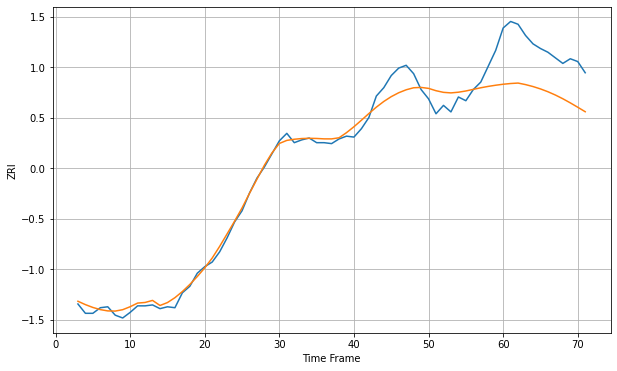

Wall time: 8.5 s
76039 10.96942703458631 50.004908637300474 [1239.67238227 1240.44984886 1240.94125025 1239.2938897  1237.20673472
 1234.66225638 1231.63567289 1228.11110191 1224.10652669 1219.69523947
 1215.00513341 1210.1907859 ]

Got an mse at 0.0100 in round 63 and stopped training



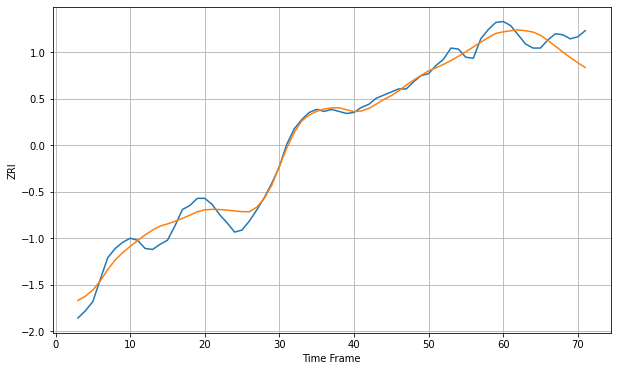

Wall time: 6.31 s
76051 8.842734365513298 16.902151775063388 [1396.83585255 1397.89081009 1398.74465311 1397.93339947 1396.6103547
 1393.53920605 1388.38390307 1382.8052786  1377.1579347  1371.7119783
 1366.62870452 1361.98362397]

Got an mse at 0.0099 in round 60 and stopped training



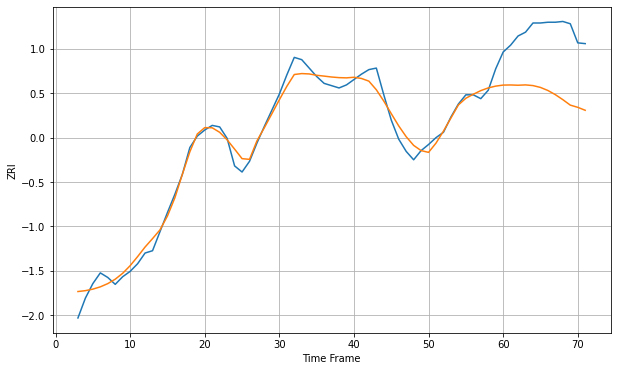

Wall time: 7.08 s
76107 11.816873663891423 82.06239631619331 [1289.74985293 1289.90745844 1289.55819094 1289.97793006 1289.10073448
 1286.68838269 1282.6637339  1277.20882542 1270.68276884 1263.5338277
 1260.65162677 1256.77008403]

Got an mse at 0.0100 in round 125 and stopped training



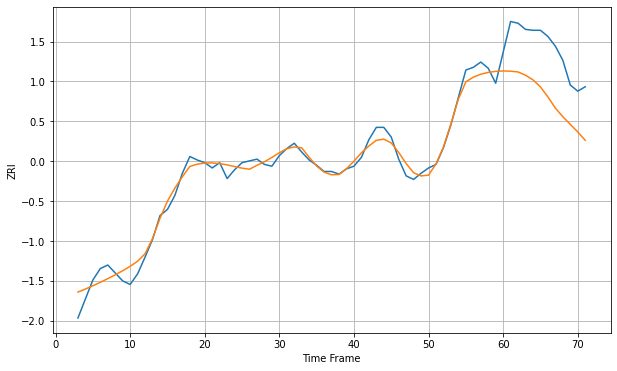

Wall time: 7.93 s
76108 9.277976497048531 56.374106918416324 [1133.92174193 1133.65718209 1132.77444505 1129.10221749 1123.84239442
 1115.81975246 1104.53040339 1091.85767216 1082.02851499 1073.39111049
 1064.83409287 1055.33680049]

Got an mse at 0.0099 in round 89 and stopped training



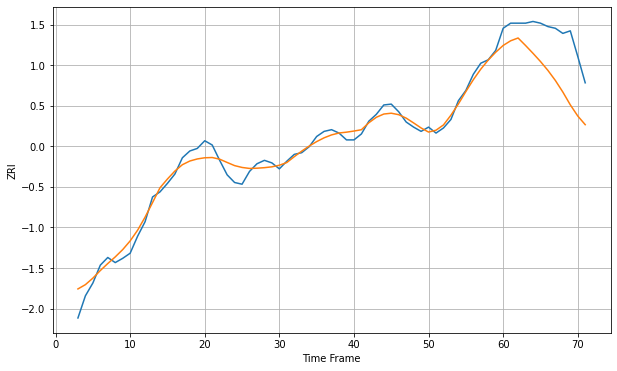

Wall time: 7.61 s
76116 9.349084734607285 51.00880497709626 [1184.82737403 1190.30403189 1193.60760736 1184.82337928 1175.63022875
 1166.02067423 1155.57099555 1143.73440571 1130.18156927 1115.16193636
 1102.05872033 1091.87621662]

Got an mse at 0.0099 in round 52 and stopped training



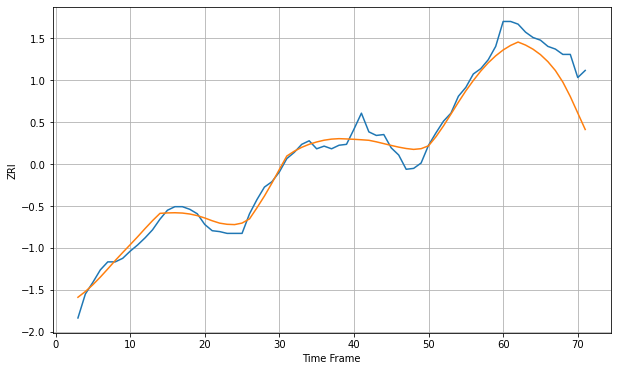

Wall time: 6.63 s
76132 9.684107600368302 32.731834253450145 [1292.97858421 1298.11098784 1301.90573003 1298.49571971 1293.87346262
 1287.76303129 1279.84277932 1269.90877968 1256.94781108 1240.6864775
 1222.20536941 1203.69156102]

Got an mse at 0.0099 in round 25 and stopped training



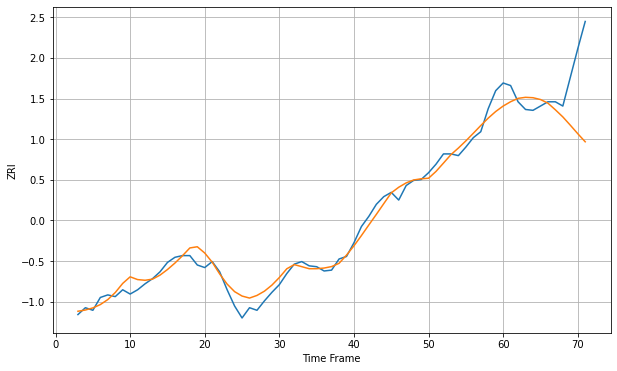

Wall time: 5.72 s
76133 9.719260170510719 53.729539786310085 [1040.0062394  1045.07387522 1049.01024117 1050.22523099 1049.76226573
 1047.659157   1043.41833914 1035.60999984 1027.29155894 1017.63372176
 1007.68218545  998.20502115]

Got an mse at 0.0098 in round 31 and stopped training



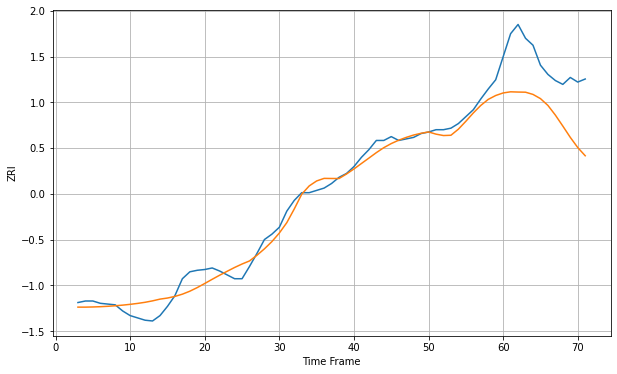

Wall time: 6.2 s
76137 11.904748814948618 68.64467391753787 [1258.8474119  1260.33010241 1260.01096892 1259.82245957 1256.93871932
 1251.47777912 1242.60985805 1229.99483515 1215.70657524 1201.02703422
 1187.7676138  1177.09074363]

Got an mse at 0.0100 in round 141 and stopped training



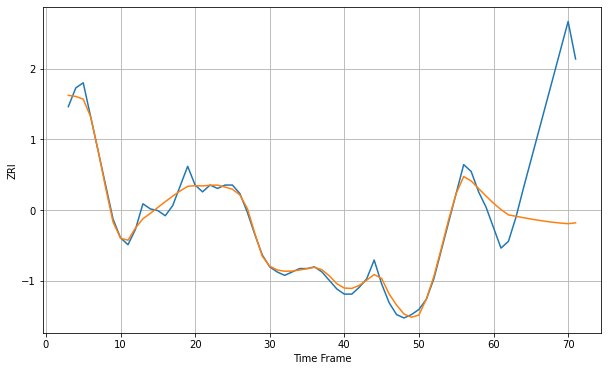

Wall time: 8.29 s
76522 3.929355333865031 65.00622883293232 [609.32968707 605.6176526  602.48441991 601.67562259 600.86278424
 600.08439772 599.35944191 598.70571947 598.14342194 597.68310359
 597.32694981 597.8328498 ]

Got an mse at 0.0099 in round 300 and stopped training



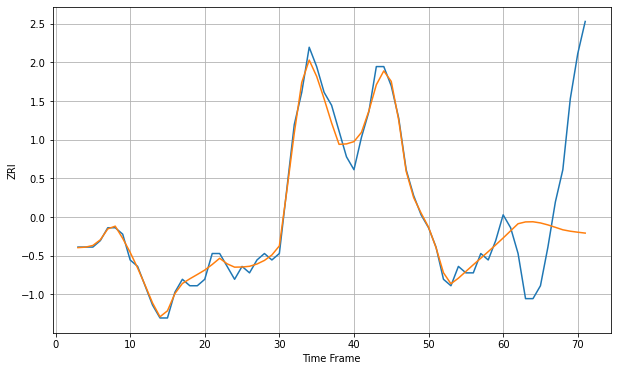

Wall time: 11.6 s
76543 1.233531170002174 15.25977140799435 [590.40821957 591.52260252 592.62083065 592.90239925 592.92485159
 592.74367437 592.4381463  592.06415959 591.68026016 591.46047108
 591.30549797 591.16691767]

Got an mse at 0.0099 in round 104 and stopped training



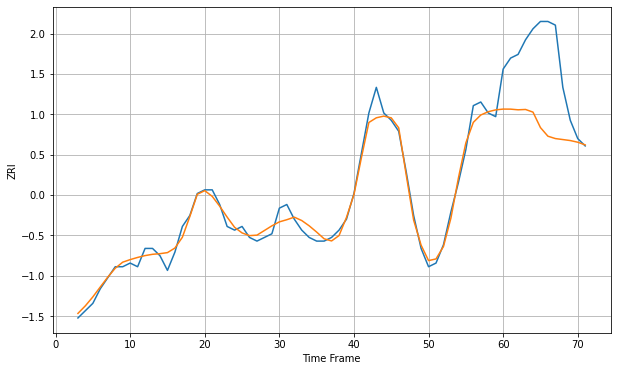

Wall time: 7.46 s
76549 2.1803778945317465 19.24096126945045 [678.06218758 678.04934393 677.86678935 677.96043323 677.23158498
 673.00731587 670.65544057 670.01029678 669.74137086 669.46673198
 669.01212918 668.27992668]


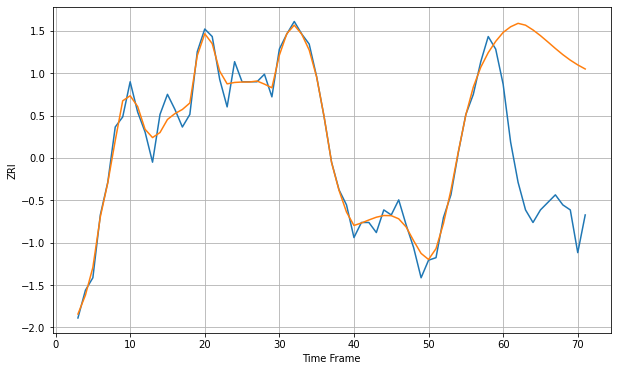

Wall time: 15.5 s
77004 4.168334980543842 62.030267694998805 [1418.64161818 1420.88227616 1422.25113492 1421.52110644 1419.62204113
 1417.35447638 1414.83559241 1412.25334387 1409.80175442 1407.6094544
 1405.71495361 1404.09004911]

Got an mse at 0.0100 in round 213 and stopped training



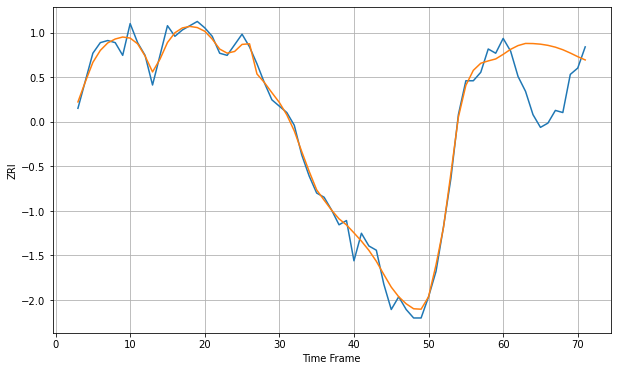

Wall time: 9.91 s
77006 3.965597915969641 23.70287182394152 [1421.46766221 1423.84160138 1425.61951788 1426.62213371 1426.56725564
 1426.28223812 1425.7284529  1424.86516798 1423.65238266 1422.10054864
 1420.38201703 1418.83846054]


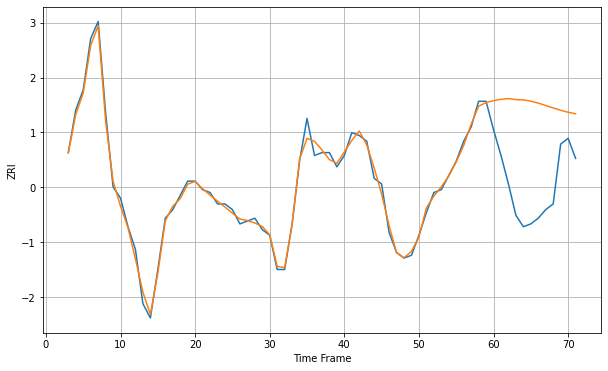

Wall time: 16.2 s
77007 1.9684722730464335 30.863739547214507 [1495.2246762  1495.68580431 1495.9480036  1495.59433464 1495.48131183
 1495.04163434 1494.35420008 1493.52016902 1492.65230256 1491.84719333
 1491.16273807 1490.61551734]

Got an mse at 0.0100 in round 211 and stopped training



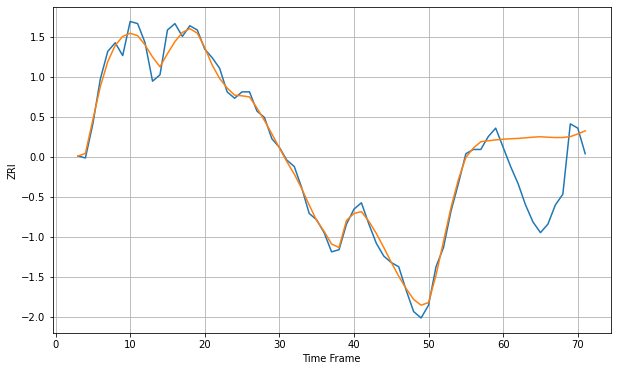

Wall time: 9.8 s
77019 3.9098933723395994 26.99721547066612 [1408.80386477 1409.02567659 1409.16210858 1409.46426742 1409.75703116
 1409.94845705 1409.73151987 1409.58604077 1409.61194337 1410.02067106
 1411.26042857 1412.72613446]

Got an mse at 0.0100 in round 291 and stopped training



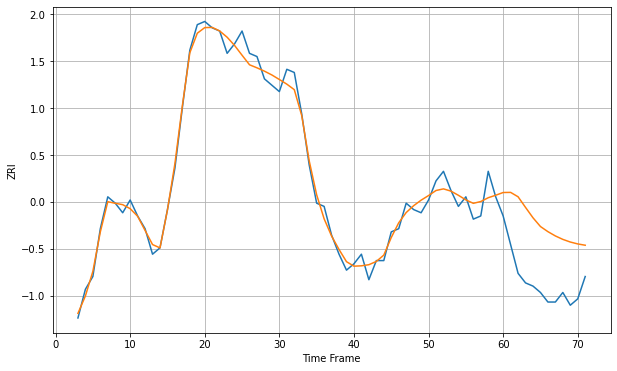

Wall time: 11.7 s
77027 2.999410670380864 18.988888083747046 [1439.35197768 1439.39001615 1438.01546648 1434.67889961 1431.42524029
 1428.68234161 1427.0728465  1425.7288608  1424.64951836 1423.82247075
 1423.2232865  1422.8154226 ]

Got an mse at 0.0099 in round 128 and stopped training



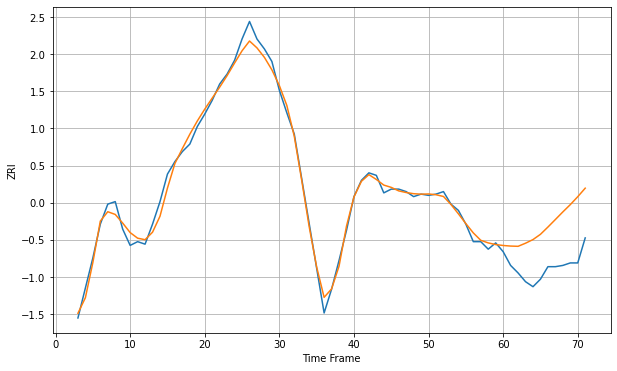

Wall time: 7.86 s
77042 5.456436708181434 35.55920714164525 [1168.94047676 1168.47421314 1168.27676769 1170.76079142 1173.65886886
 1177.87495573 1183.66595917 1189.6939383  1195.76036436 1201.59976118
 1207.93726619 1214.74406087]

Got an mse at 0.0099 in round 81 and stopped training



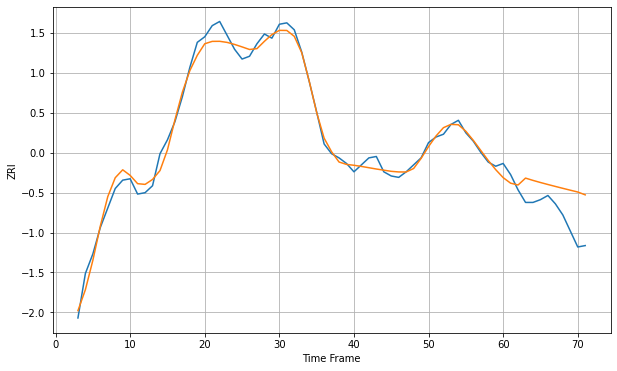

Wall time: 7.44 s
77054 5.412001821273702 20.800882030453597 [1243.82086456 1239.8286547  1238.52658644 1243.48153202 1241.82733588
 1240.31133873 1238.88027671 1237.49435363 1236.13203668 1234.7926575
 1233.49153264 1231.44752704]

Got an mse at 0.0099 in round 282 and stopped training



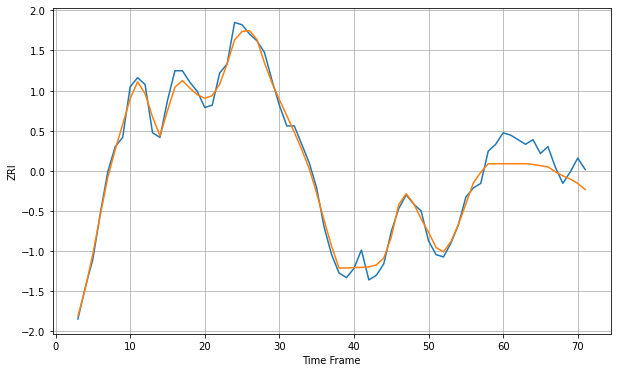

Wall time: 11.3 s
77056 3.7163286468001817 8.947483876834966 [1442.54778177 1442.54778177 1442.54778177 1442.54778177 1442.24543114
 1441.6925212  1441.17350733 1439.08999719 1437.27644626 1435.86799122
 1433.94118986 1431.29633335]

Got an mse at 0.0100 in round 222 and stopped training



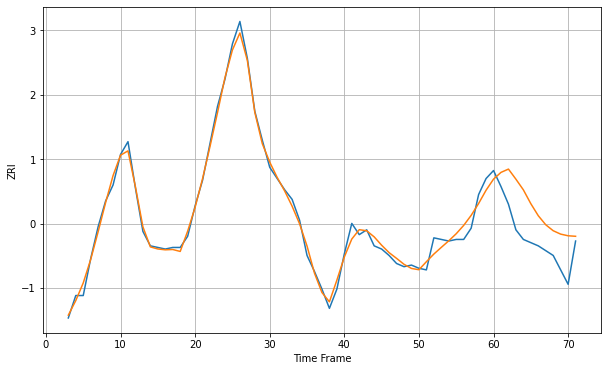

Wall time: 10.2 s
77057 4.097067443960534 21.231359964187508 [1434.62268648 1438.83999548 1440.8917025  1434.60122817 1427.93674746
 1419.30563614 1411.79283051 1406.15461172 1402.43207112 1400.31768962
 1399.28672901 1398.96650913]

Got an mse at 0.0099 in round 180 and stopped training



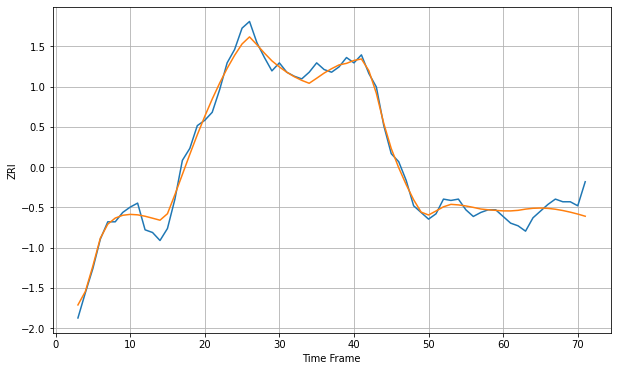

Wall time: 9.27 s
77063 5.898699890941325 10.948563694301713 [1266.17946547 1266.15856146 1266.58147048 1267.49748725 1268.12297094
 1268.3199821  1268.0663991  1267.41659042 1266.44770946 1265.22685024
 1263.7978321  1262.17843076]

Got an mse at 0.0100 in round 83 and stopped training



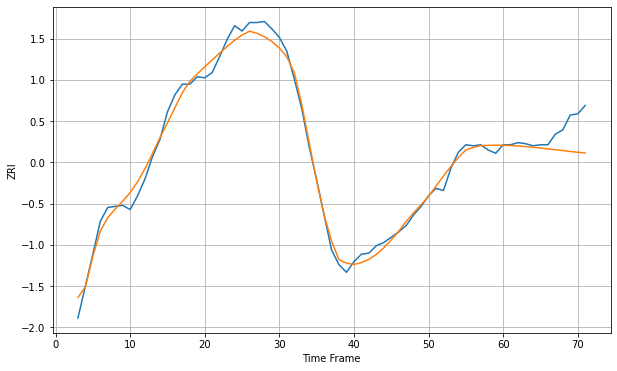

Wall time: 7.14 s
77077 7.691692998119947 20.662500871795732 [1189.49572254 1189.25630999 1188.89260021 1188.28597012 1187.60520631
 1186.86773724 1186.08993408 1185.28623831 1184.47112807 1183.66585266
 1182.91176514 1182.28616635]

Got an mse at 0.0099 in round 252 and stopped training



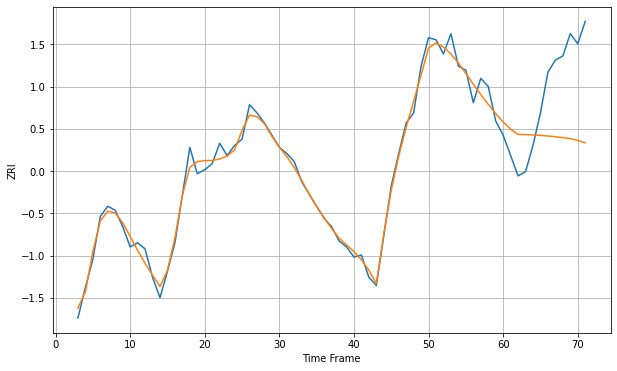

Wall time: 10.9 s
77090 4.057031994336712 33.71745045405275 [963.50314852 959.99840998 957.37207687 957.3056223  957.15277036
 956.92005972 956.61393124 956.2404684  955.80542648 955.31440472
 954.43576792 953.23808635]

Got an mse at 0.0100 in round 258 and stopped training



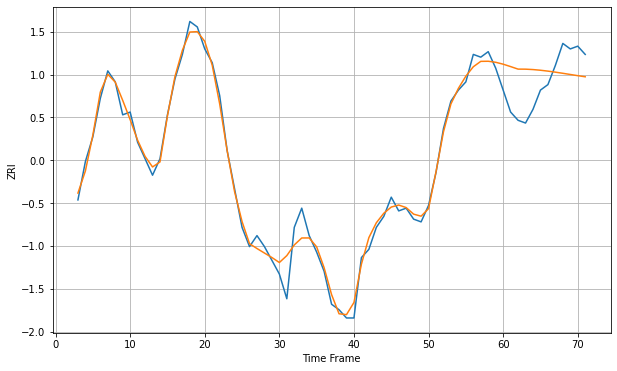

Wall time: 11.2 s
77098 3.565580464729986 12.16296644785786 [1501.4405964  1500.56236162 1499.64365966 1499.62650377 1499.48022987
 1499.23430923 1498.9125087  1498.53517545 1498.1211689  1497.68927537
 1497.25907767 1496.85111699]

Got an mse at 0.0098 in round 120 and stopped training



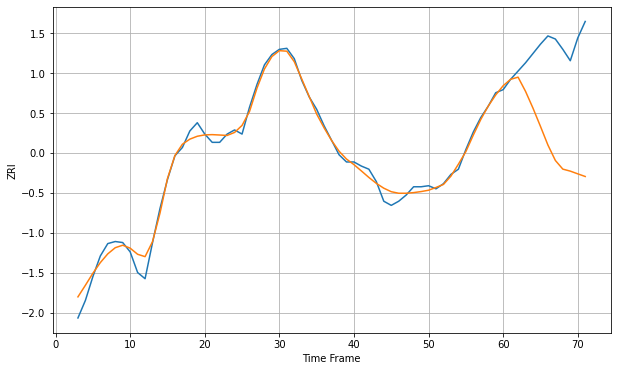

Wall time: 7.94 s
77380 6.991228307784904 91.09172098403513 [1420.78524721 1427.00187549 1429.08213935 1415.34892527 1399.07715694
 1381.47174992 1363.40903509 1348.45187292 1340.07110685 1338.13367429
 1335.50879992 1332.94651284]

Got an mse at 0.0099 in round 79 and stopped training



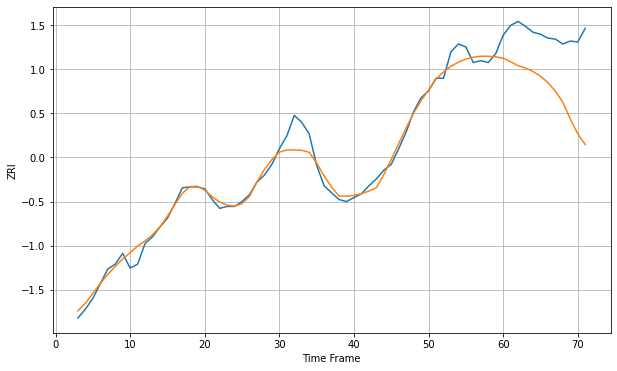

Wall time: 7.16 s
77429 9.217914892199271 62.529433792954464 [1207.48658957 1203.86059185 1199.85644518 1197.35820911 1193.87281663
 1189.0915452  1182.49902378 1173.79397572 1162.45545484 1145.40183493
 1130.24247798 1119.23029749]

Got an mse at 0.0099 in round 211 and stopped training



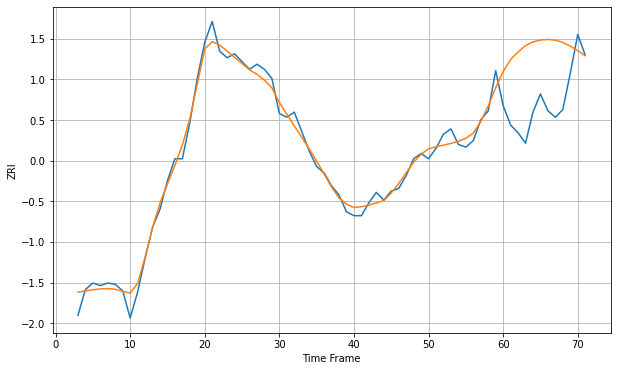

Wall time: 9.64 s
77494 6.621433105768878 47.75116845126743 [1281.28175575 1290.66487571 1296.40815291 1301.34615404 1304.22409452
 1305.67727437 1306.05878699 1305.54946442 1303.78359502 1300.92530383
 1297.42567817 1293.52116602]

Got an mse at 0.0099 in round 120 and stopped training



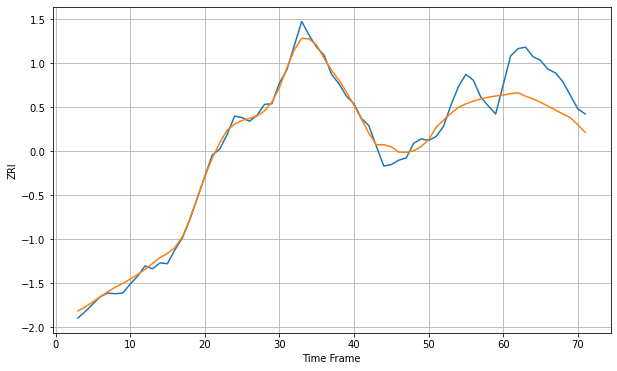

Wall time: 8.3 s
77550 11.94037311221839 47.04112050536418 [1165.72070747 1167.62000498 1168.87791532 1164.1761925  1160.49088689
 1155.86433289 1150.66097287 1145.29597263 1139.98402051 1134.9330642
 1125.40330168 1114.90647231]

Got an mse at 0.0100 in round 64 and stopped training



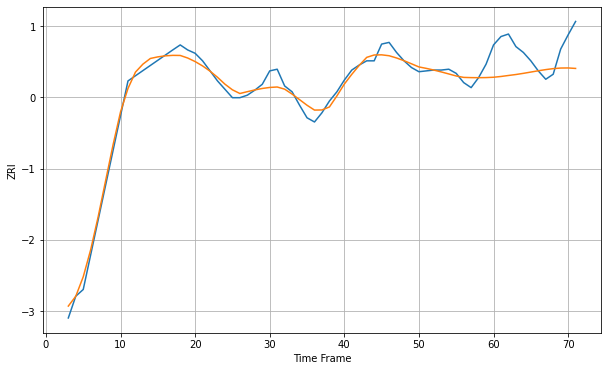

Wall time: 6.8 s
77584 8.382799700346764 33.56224827943221 [1402.40595663 1403.32106798 1404.5119463  1405.66548008 1407.05652501
 1408.58738278 1410.13483022 1411.51958903 1412.69961587 1413.39216107
 1413.49963296 1412.93768548]

Got an mse at 0.0100 in round 100 and stopped training



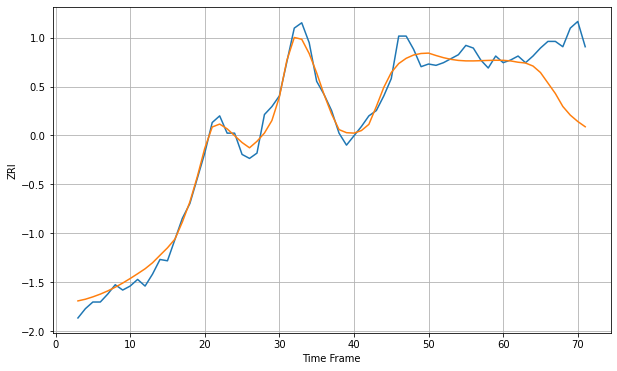

Wall time: 7.83 s
77598 7.376088134042545 39.28223100725045 [1122.77768099 1122.32907007 1121.34500613 1120.74310457 1118.4844584
 1113.61184722 1105.70861586 1097.79916175 1088.0734179  1081.56063955
 1076.77721617 1072.81578311]

Got an mse at 0.0099 in round 152 and stopped training



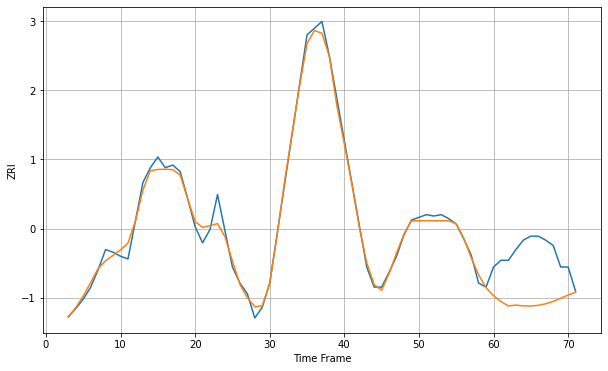

Wall time: 8.41 s
77840 5.0285685274641105 37.658083600125586 [847.53482213 843.2993503  839.92532194 840.57345034 840.02687559
 839.92677943 840.4224904  841.57465395 843.35427458 845.66851969
 848.06558276 850.17279567]

Got an mse at 0.0099 in round 130 and stopped training



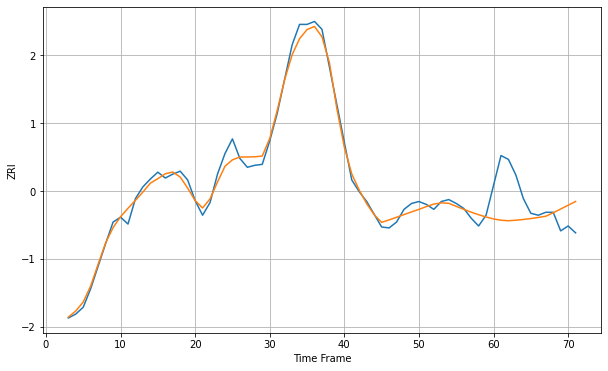

Wall time: 8.57 s
77845 6.817521395244947 34.24596164017509 [959.21277889 957.90024226 957.37206604 957.90884839 958.66707922
 959.61506652 960.72425117 961.96842256 965.51895871 969.34588888
 973.20583871 977.05004487]

Got an mse at 0.0100 in round 122 and stopped training



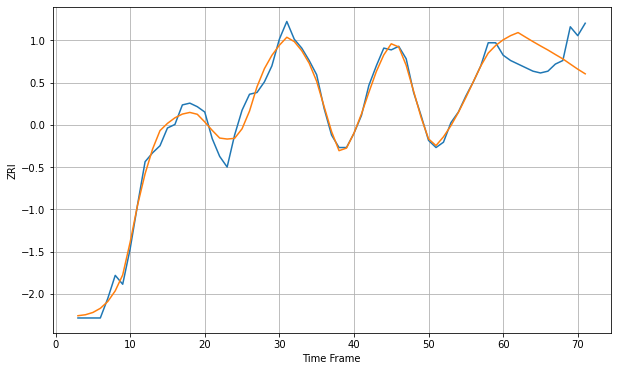

Wall time: 8.46 s
78130 4.828897437563417 16.256622952677173 [1154.65776346 1157.02543972 1158.74428423 1156.17817624 1153.65292466
 1151.24421314 1148.91558488 1146.38835644 1143.92685361 1141.00556646
 1138.13494292 1135.51356234]

Got an mse at 0.0100 in round 190 and stopped training



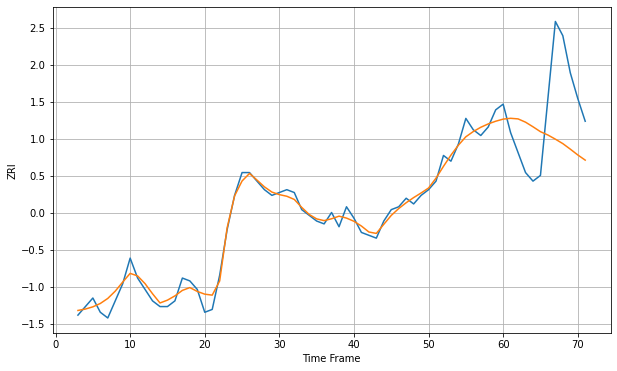

Wall time: 9.46 s
78201 2.6410203604483518 21.79591109917371 [886.74490987 887.03642753 886.82456272 885.67471849 884.0596209
 882.34322662 881.1714557  879.71897261 878.15093722 876.21827563
 874.19042533 872.36426493]

Got an mse at 0.0100 in round 150 and stopped training



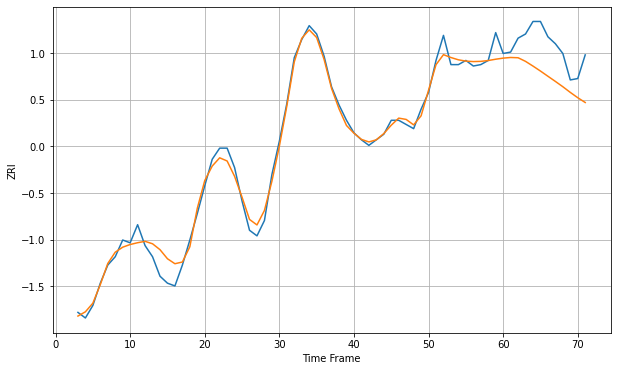

Wall time: 8.83 s
78209 6.59040732160045 23.190735512519918 [1248.65717524 1249.12438688 1248.9376914  1246.33559809 1242.9427761
 1239.38033972 1235.64347239 1231.93669308 1228.12429233 1224.04380356
 1220.22775772 1216.79163974]

Got an mse at 0.0099 in round 148 and stopped training



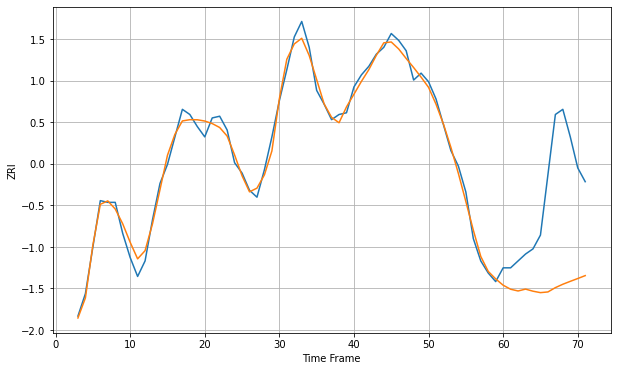

Wall time: 8.21 s
78210 4.585270945740148 59.05795102655537 [927.90588159 925.57545101 924.56275305 925.64371846 924.43217272
 923.59593539 923.99802775 926.49688223 928.46630794 930.15663679
 931.78892066 933.47491348]

Got an mse at 0.0099 in round 192 and stopped training



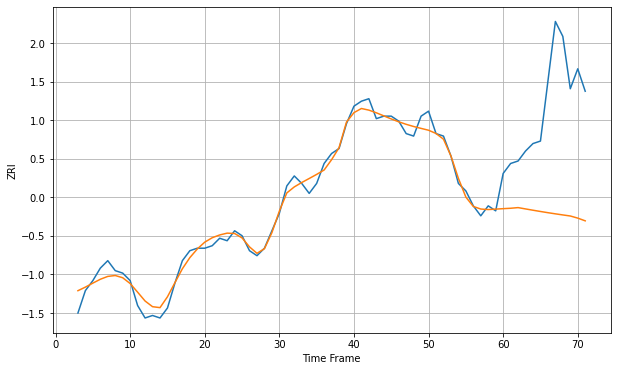

Wall time: 9.78 s
78212 3.23135575773813 46.28492340299118 [894.86992606 895.03049847 895.29475009 894.7644661  894.24574493
 893.73982964 893.25435742 892.79359333 892.35367515 891.92791545
 891.07900656 889.98315029]


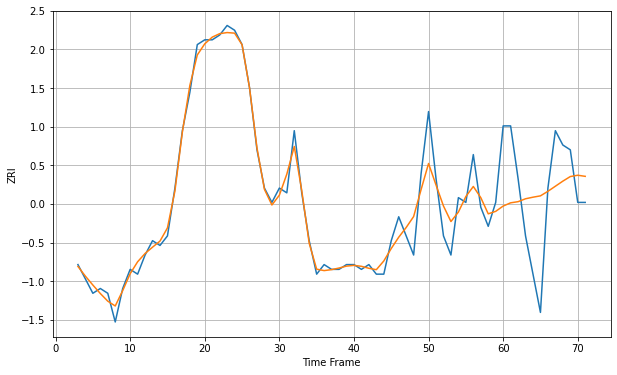

Wall time: 16 s
78213 2.8458106720824863 12.11805929439724 [922.23648927 922.91406897 923.1546518  923.76177703 924.09210954
 924.37142846 925.32461341 926.38434112 927.44618982 928.40705949
 928.6826133  928.45325251]

Got an mse at 0.0100 in round 64 and stopped training



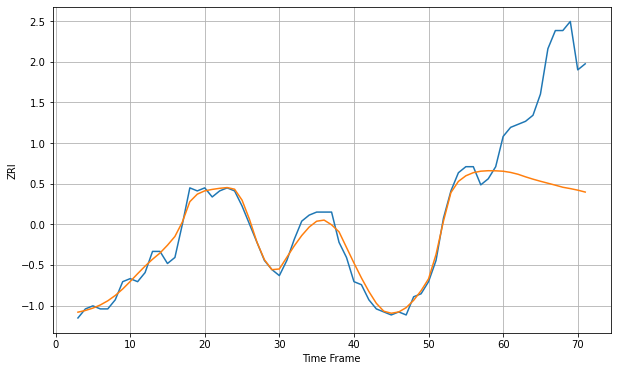

Wall time: 6.97 s
78216 2.605906886589311 36.445501410008035 [973.50112766 973.10672319 972.49556764 971.64741006 970.87823255
 970.18454974 969.53577426 968.89083793 968.20564516 967.76173529
 967.24935683 966.61675442]

Got an mse at 0.0100 in round 58 and stopped training



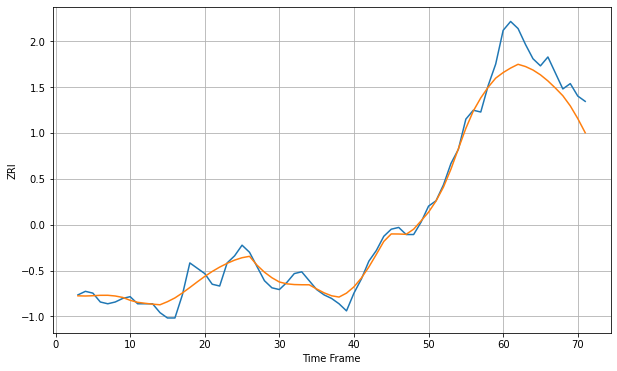

Wall time: 6.67 s
78229 4.790389884094329 15.21311144245962 [1039.21783615 1041.7606159  1043.87628653 1042.60522923 1040.64697407
 1037.94359828 1034.51263612 1030.50256027 1026.17740481 1020.44343814
 1013.34193247 1005.33578253]

Got an mse at 0.0100 in round 235 and stopped training



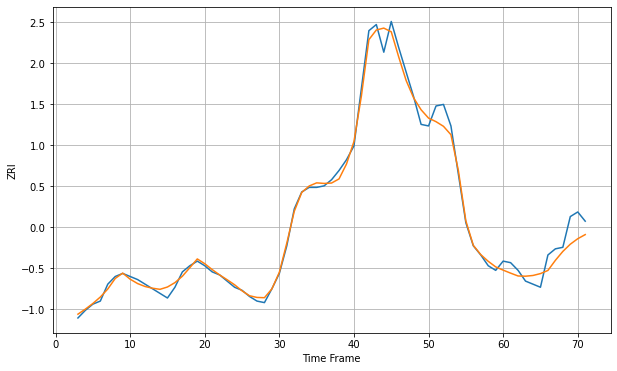

Wall time: 10.1 s
78233 4.424004768432424 9.49960831189187 [951.13731682 949.18529789 947.33424453 947.19025686 947.66297187
 948.88575404 950.92841472 957.50334925 963.31124098 968.01708902
 971.59329985 974.26994985]

Got an mse at 0.0100 in round 82 and stopped training



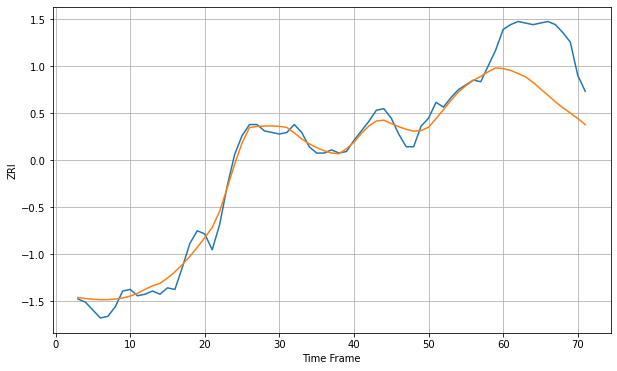

Wall time: 7.54 s
78240 5.781829186390965 37.28179061936905 [1088.29053969 1087.12495099 1085.17499857 1083.06460474 1079.62427245
 1075.53613881 1071.48257694 1067.27806226 1063.64486668 1060.2563076
 1056.82422768 1052.96210986]

Got an mse at 0.0097 in round 46 and stopped training



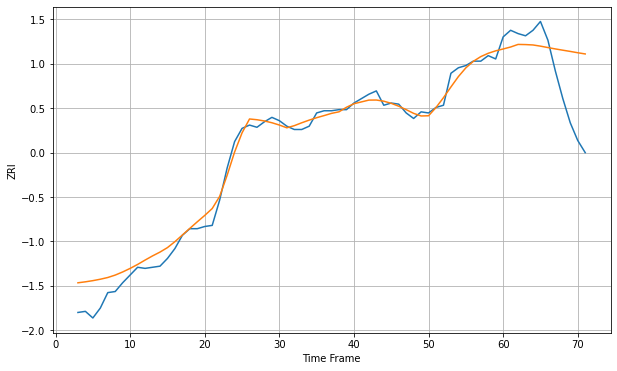

Wall time: 6.21 s
78249 9.901415318899936 42.936932970111435 [1142.0405675  1143.82796617 1146.17096306 1146.02984006 1145.68136648
 1144.61126544 1143.32651452 1142.07930751 1140.93372483 1139.81357436
 1138.62302862 1137.52863032]

Got an mse at 0.0100 in round 150 and stopped training



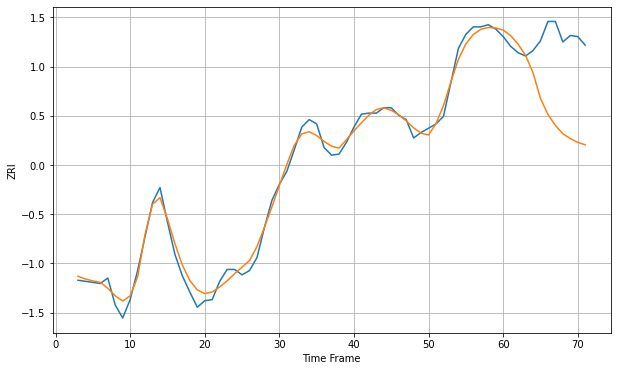

Wall time: 8.62 s
78256 6.92015875116826 67.54013102044267 [1240.05661251 1234.95958076 1226.95818078 1216.63247063 1200.56174523
 1176.65141268 1161.85994439 1151.61183311 1143.8789181  1139.33664317
 1135.84067642 1133.62299008]

Got an mse at 0.0100 in round 167 and stopped training



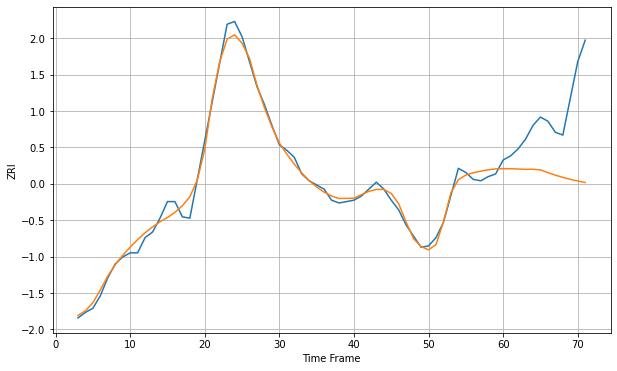

Wall time: 9.12 s
78521 4.830540633427755 48.23165588022574 [755.74855022 755.73851229 755.51400986 755.27506453 755.33099126
 754.87396449 752.88506764 751.08654512 749.48403267 748.0714805
 746.84060607 745.78388088]

Got an mse at 0.0100 in round 110 and stopped training



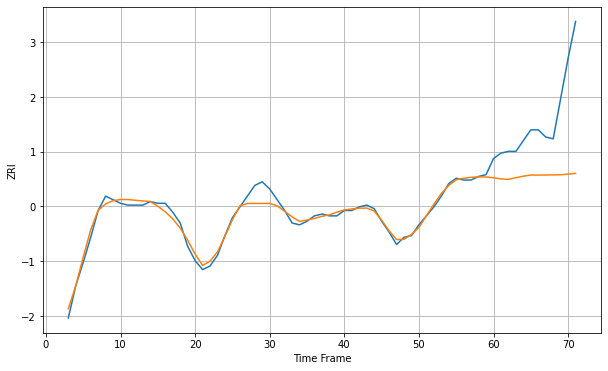

Wall time: 7.91 s
78550 3.1938278274579184 37.07442088112488 [766.27225667 765.6182007  765.36169505 766.33025448 767.14815836
 767.77941384 767.75347311 767.80099465 767.87881878 767.94712415
 768.30285993 768.68145297]

Got an mse at 0.0100 in round 111 and stopped training



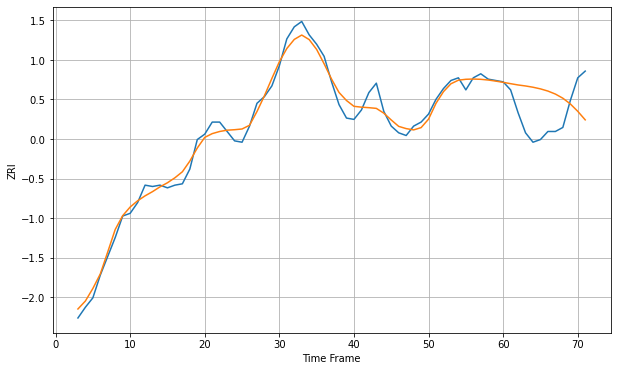

Wall time: 7.66 s
78613 6.2026532984277 27.209571971600138 [1297.63716585 1296.62995607 1295.67093076 1294.92744861 1293.98441985
 1292.7581055  1291.12405461 1288.89415429 1285.80134056 1281.55017677
 1276.03607084 1269.66668276]

Got an mse at 0.0100 in round 109 and stopped training



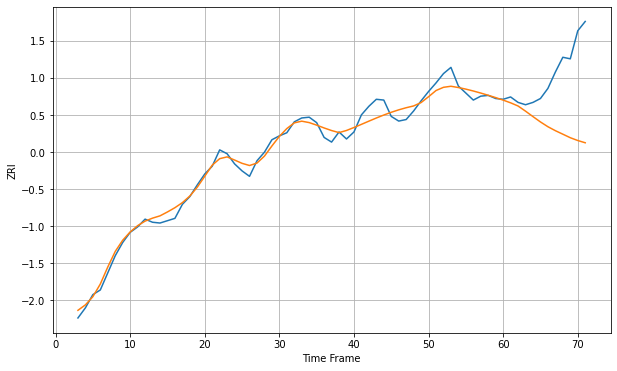

Wall time: 8.04 s
78660 9.467640217621392 78.37161820542721 [1285.93467047 1282.45726113 1278.37528174 1271.74096355 1264.73348238
 1257.89309476 1251.75035079 1246.65745387 1242.16155806 1237.61619405
 1234.03455335 1231.12630283]

Got an mse at 0.0100 in round 83 and stopped training



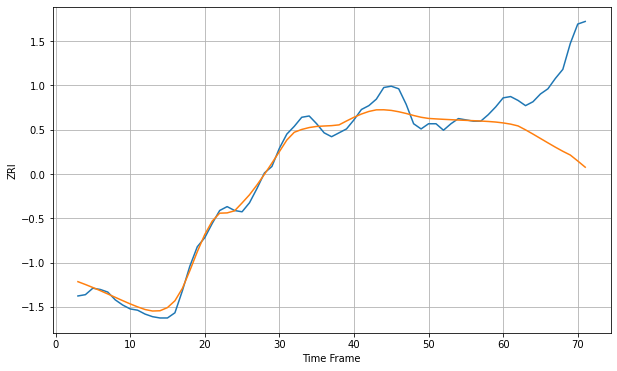

Wall time: 7.04 s
78664 6.641472278766292 60.00303410204424 [1154.64908132 1153.71734685 1152.3210949  1149.29435112 1146.02623737
 1142.63626879 1139.25237337 1135.9070297  1132.74219176 1129.84650839
 1125.24710646 1120.45726299]

Got an mse at 0.0100 in round 35 and stopped training



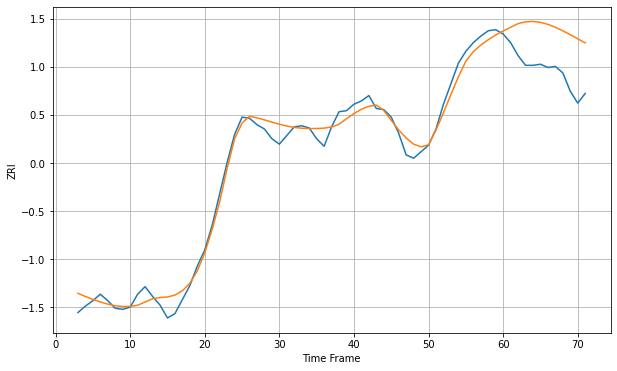

Wall time: 6.01 s
78666 8.808465896179383 39.54548202525889 [1148.81701242 1152.23257447 1155.62154726 1157.27512755 1157.62184086
 1156.78601378 1154.92685991 1152.245305   1148.97276093 1145.34304054
 1141.55931727 1137.77361148]

Got an mse at 0.0098 in round 94 and stopped training



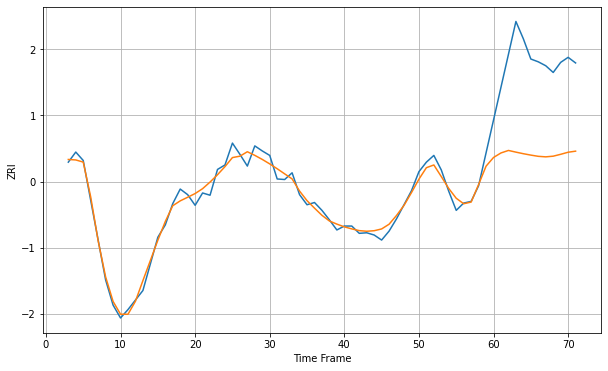

Wall time: 7.37 s
78701 11.841425583726503 166.05166117010975 [2157.34632322 2165.43223754 2169.87903803 2166.88257908 2164.06038065
 2161.58003276 2159.40101771 2158.46169222 2159.65044008 2162.99435788
 2166.69385719 2168.60562504]

Got an mse at 0.0099 in round 76 and stopped training



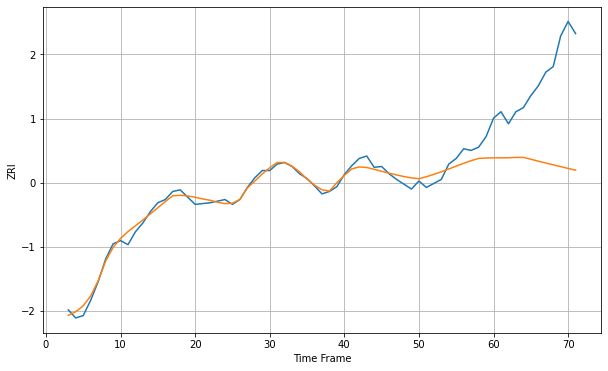

Wall time: 7.26 s
78702 7.980769073617641 110.05815148702101 [1580.72922241 1580.74072948 1580.81781966 1581.33123625 1581.27938073
 1579.01754514 1576.61602068 1574.31145463 1572.06591747 1569.84283467
 1567.61943134 1565.39998718]

Got an mse at 0.0098 in round 25 and stopped training



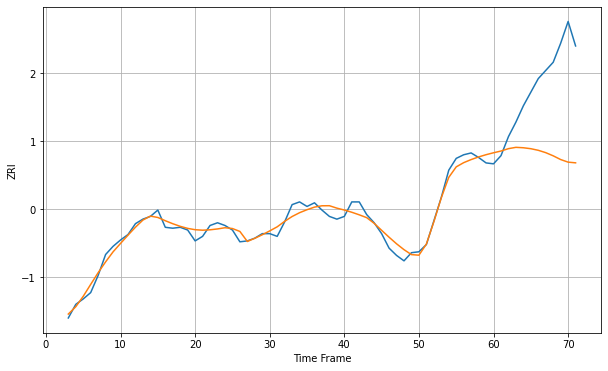

Wall time: 5.92 s
78703 7.064148372721084 86.32201286510019 [1825.18938457 1827.10716755 1829.72624827 1831.19025755 1830.71776461
 1829.67201048 1827.91709393 1825.31187189 1821.82635285 1817.71231048
 1814.85467745 1814.09782669]

Got an mse at 0.0099 in round 169 and stopped training



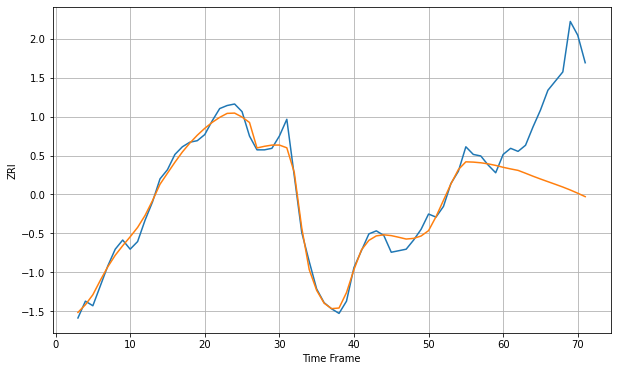

Wall time: 8.91 s
78704 5.333609637880802 63.34635580813156 [1523.57464639 1522.52533537 1521.56587208 1519.6968889  1517.75723018
 1515.93103732 1514.18248371 1512.44570948 1510.66795155 1508.73317971
 1506.61918804 1504.38060455]

Got an mse at 0.0099 in round 120 and stopped training



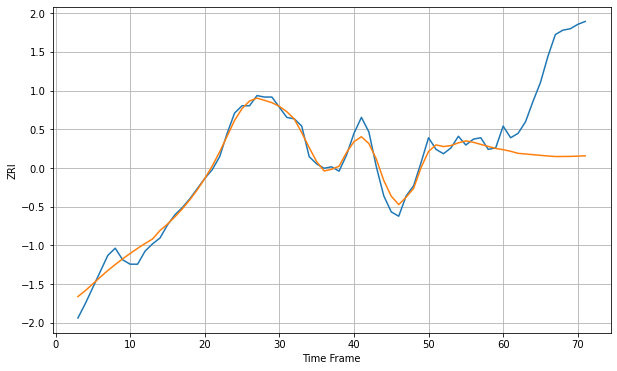

Wall time: 7.87 s
78705 5.571625463945495 63.67345884207588 [1524.79867161 1523.68646746 1522.26150628 1521.82209581 1521.3600537
 1520.89829004 1520.45118397 1520.07728544 1520.10128061 1520.18566926
 1520.33510993 1520.56415119]

Got an mse at 0.0100 in round 40 and stopped training



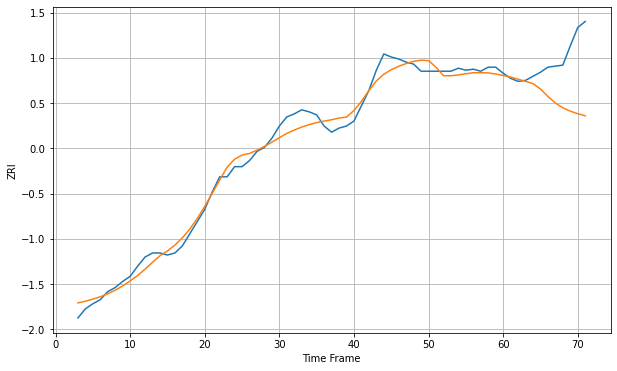

Wall time: 6.44 s
78728 8.368414498536689 44.92283341755669 [1221.85082544 1220.24573609 1218.14192516 1216.02949285 1213.80282557
 1208.44840058 1201.18682633 1194.69653958 1189.96044943 1186.67444414
 1184.17721704 1182.09612186]

Got an mse at 0.0098 in round 78 and stopped training



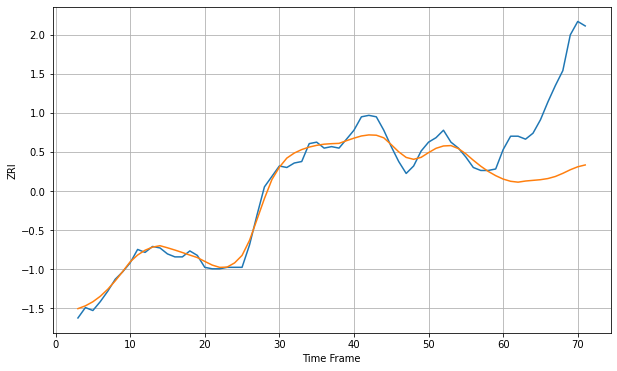

Wall time: 6.98 s
78729 5.2024739234292285 59.99841349754623 [1200.22549416 1198.73000722 1198.14841587 1198.9133353  1199.35958164
 1199.80432155 1200.57483946 1201.9653295  1204.06896348 1206.47950806
 1208.46885729 1209.69741103]

Got an mse at 0.0098 in round 124 and stopped training



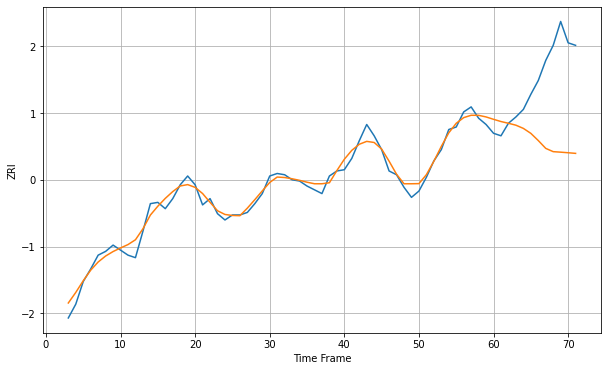

Wall time: 7.93 s
78735 5.635891640570671 58.953098302129554 [1539.12102406 1537.35244913 1535.96424953 1534.43795182 1531.8902129
 1527.94007088 1522.21397617 1515.9846518  1513.37513198 1512.97309024
 1512.51119697 1512.01126968]


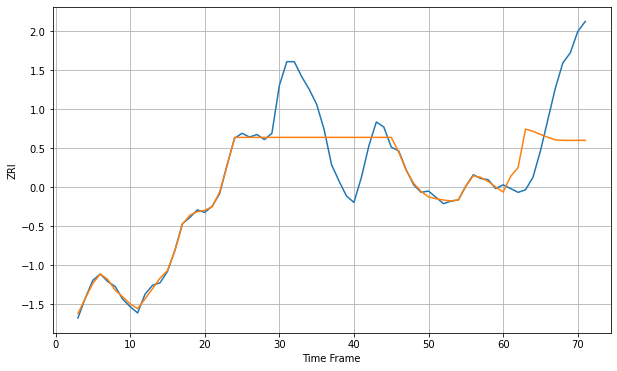

Wall time: 16 s
78741 19.43203013055969 51.12972041205263 [1273.22740598 1285.68701596 1292.69048092 1323.32524429 1321.55847451
 1319.1128425  1316.80498482 1314.7177043  1314.37639013 1314.34223268
 1314.37550015 1314.37917031]

Got an mse at 0.0099 in round 51 and stopped training



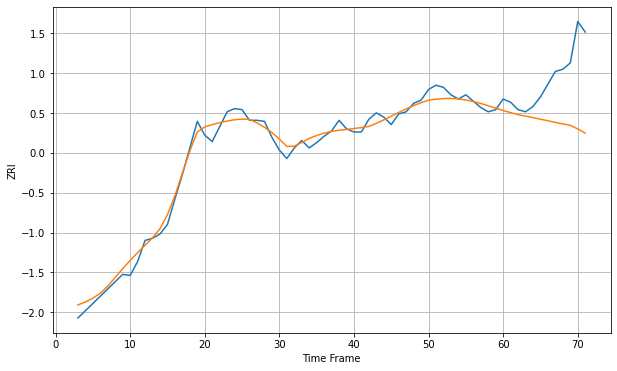

Wall time: 6.31 s
78744 6.840878804638579 49.6952883935265 [1272.2483485  1270.22447033 1268.3126896  1266.99096029 1265.51809756
 1264.0010919  1262.57050259 1261.03280246 1259.56487133 1258.25545957
 1254.91707261 1250.94770102]

Got an mse at 0.0099 in round 55 and stopped training



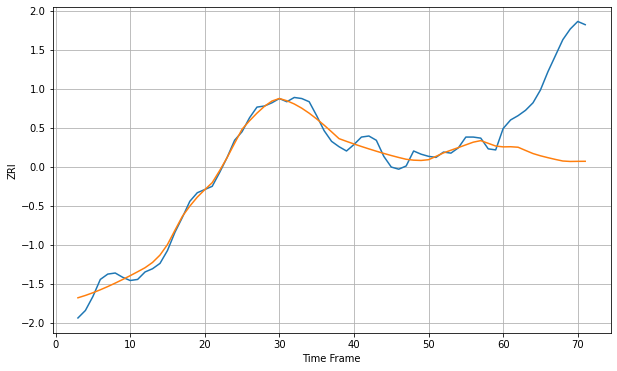

Wall time: 7.02 s
78745 6.694832399301268 84.94434713874467 [1266.83889891 1266.96861623 1266.50942416 1263.51630451 1260.60789729
 1258.50943387 1256.75299465 1255.11988525 1253.63251503 1253.2162335
 1253.32776285 1253.37386792]

Got an mse at 0.0098 in round 94 and stopped training



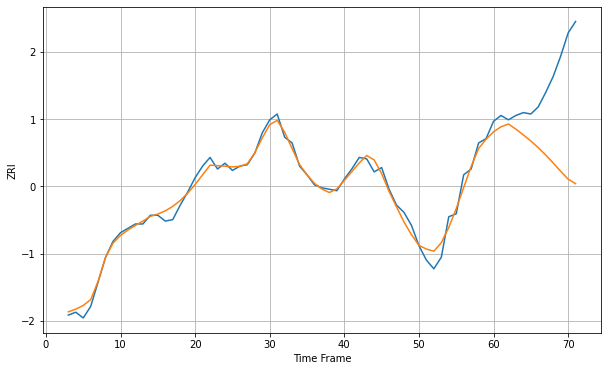

Wall time: 7.46 s
78746 4.421562094629437 54.90010563976861 [1547.69049441 1551.18339879 1553.10966256 1549.50449236 1545.59329073
 1541.35208648 1536.72460957 1531.64671601 1526.14397756 1520.45201848
 1514.97608352 1511.8632997 ]

Got an mse at 0.0100 in round 84 and stopped training



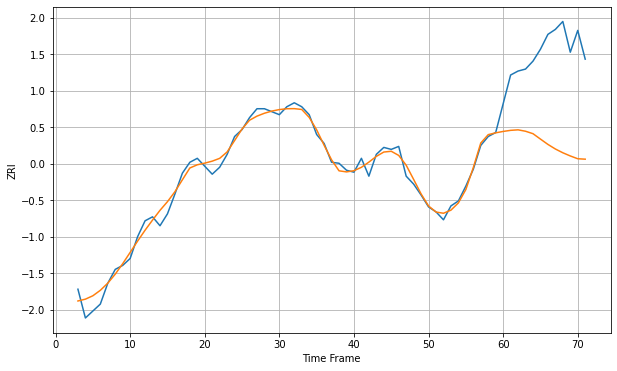

Wall time: 7.02 s
78748 7.021528779377505 94.5022058113752 [1314.10401608 1315.19971836 1315.71715728 1314.29384592 1311.82745303
 1306.39594325 1301.02285766 1296.39681565 1292.59098869 1289.37979413
 1286.56951614 1286.12644819]

Got an mse at 0.0097 in round 46 and stopped training



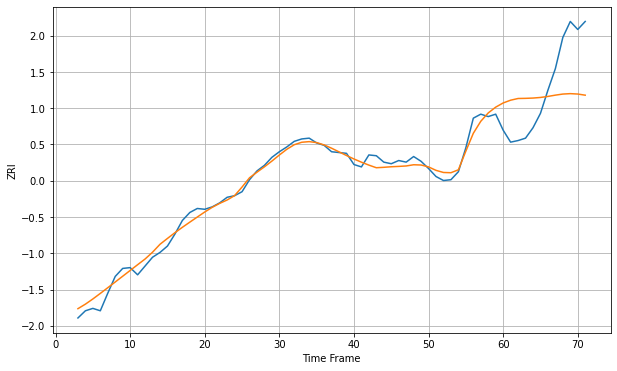

Wall time: 6.83 s
78749 7.900962007268052 57.958723781083705 [1307.03006607 1310.48656731 1312.61762331 1312.80122441 1313.1602082
 1313.91027078 1315.19620959 1316.81216389 1318.16805769 1318.69397686
 1318.19065154 1316.76780207]

Got an mse at 0.0100 in round 77 and stopped training



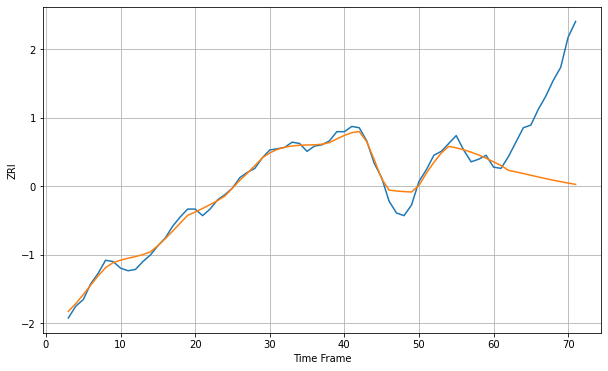

Wall time: 6.61 s
78750 5.250279496326871 65.2275602574957 [1280.01299137 1277.22375214 1273.53262328 1272.33774983 1271.08518647
 1269.79029008 1268.48440876 1267.21312241 1266.01205611 1264.89020621
 1263.83681644 1262.83554764]

Got an mse at 0.0099 in round 175 and stopped training



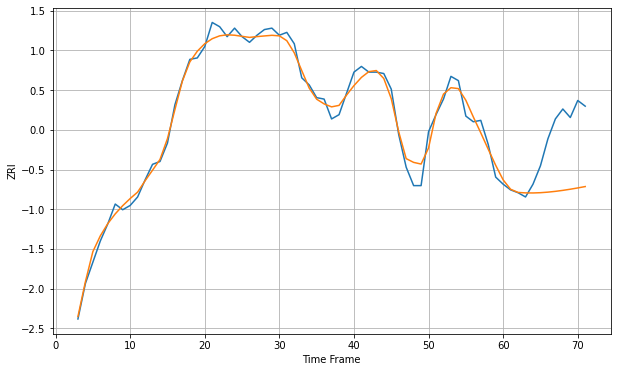

Wall time: 9.65 s
78751 5.937975352005271 37.95660687759556 [1367.04253114 1360.42097995 1358.19368036 1357.86901922 1357.82271352
 1358.01245314 1358.4012031  1358.9571119  1359.65245701 1360.46229923
 1361.36331969 1362.33313966]

Got an mse at 0.0096 in round 25 and stopped training



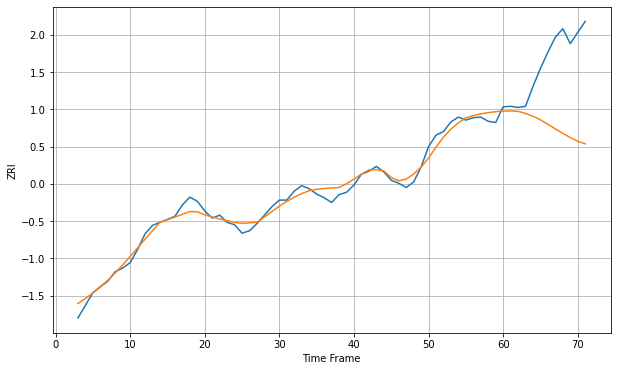

Wall time: 5.64 s
78752 10.769726218996452 121.3128022014177 [1339.98262292 1340.24275815 1339.53312467 1336.10845744 1331.45073235
 1325.38925962 1318.13628176 1310.37944369 1302.89476003 1296.06671529
 1289.86631995 1285.46377171]

Got an mse at 0.0100 in round 62 and stopped training



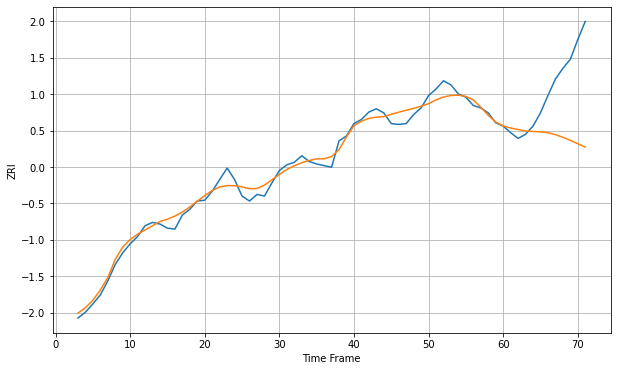

Wall time: 7.23 s
78753 8.57207554212949 72.57425171476396 [1146.07670098 1143.66025522 1141.83197072 1140.03452467 1139.3768555
 1139.10906243 1137.9268655  1135.57901128 1132.39570845 1128.66288337
 1124.60960861 1120.49040869]

Got an mse at 0.0099 in round 35 and stopped training



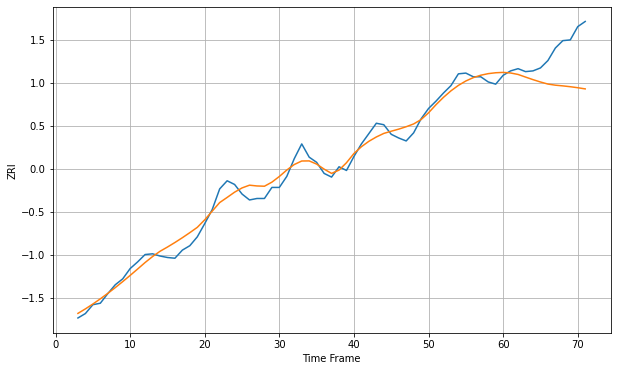

Wall time: 6.02 s
78754 11.306667519125169 47.61471899910724 [1240.94312704 1240.13800826 1238.16599777 1234.60996952 1231.13179768
 1227.94743169 1225.12954838 1223.62739924 1222.6669481  1221.52932098
 1220.17366727 1218.57372767]

Got an mse at 0.0099 in round 158 and stopped training



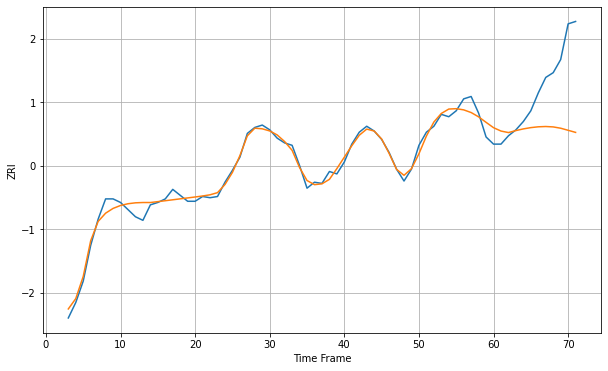

Wall time: 8.66 s
78757 5.288249824726918 45.76385857186126 [1273.80147937 1270.97522723 1269.70510706 1271.3618457  1272.78230863
 1273.85821524 1274.54188835 1274.78074342 1274.44738766 1273.3540184
 1271.61036477 1269.84872433]

Got an mse at 0.0100 in round 51 and stopped training



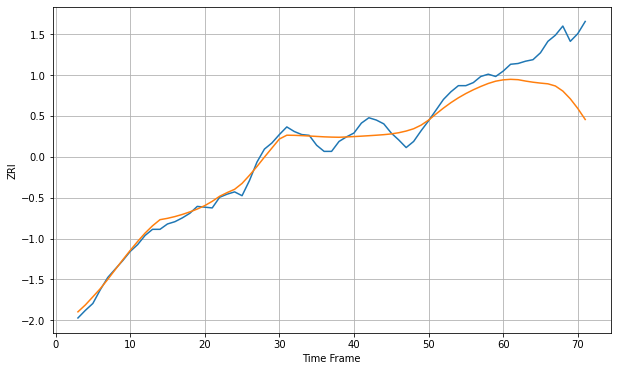

Wall time: 6.65 s
78758 9.989847479593223 64.86591996218456 [1321.59976639 1322.28237135 1321.82394651 1320.01831862 1318.51136604
 1317.3542815  1316.3969966  1313.58048767 1306.94084431 1296.80937961
 1284.21654258 1269.72714389]

Got an mse at 0.0099 in round 48 and stopped training



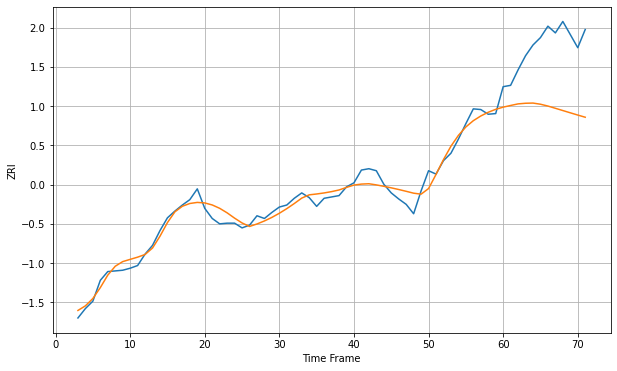

Wall time: 6.49 s
78759 11.914377728708546 96.38715110773265 [1497.55695378 1500.05067617 1502.40993411 1503.34938916 1503.62819231
 1501.91335444 1499.19019498 1495.87141021 1492.50789401 1489.14097311
 1485.81314901 1482.56472548]

Got an mse at 0.0098 in round 66 and stopped training



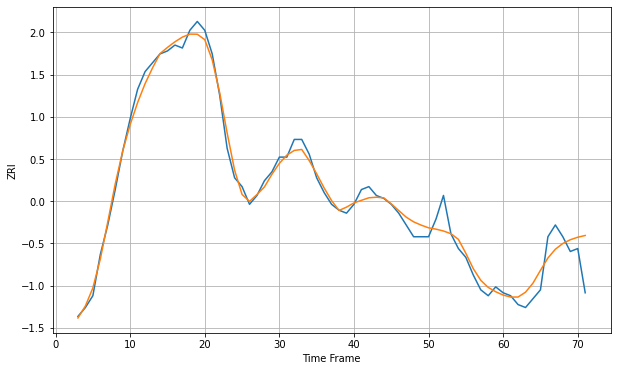

Wall time: 6.78 s
79912 2.9120098225892397 7.296228532772207 [967.21884194 966.54900838 966.55589297 968.20142739 971.27244726
 975.61041579 979.79041731 982.77715638 984.71557504 985.9834392
 986.83337845 987.43058569]

Got an mse at 0.0100 in round 178 and stopped training



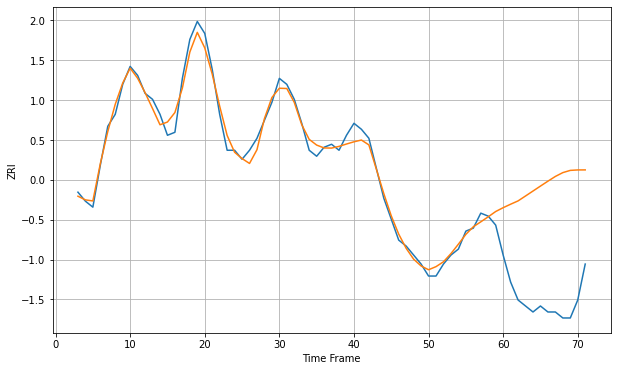

Wall time: 9.55 s
79936 2.6864660021919105 38.96264315104398 [913.8237652  914.98160816 916.09014904 917.73057433 919.38327237
 921.03807654 922.67378417 924.25767633 925.53380136 926.27613514
 926.42646471 926.44016567]

Got an mse at 0.0097 in round 29 and stopped training



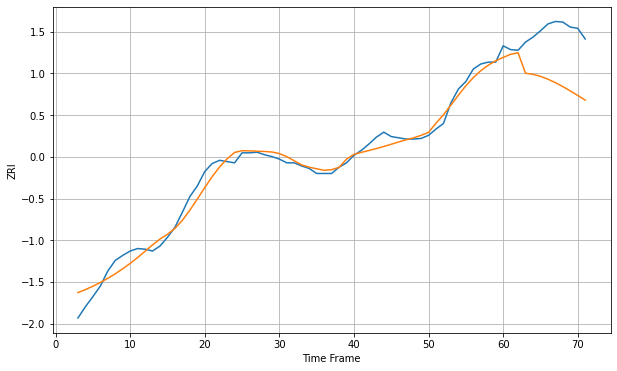

Wall time: 5.6 s
80021 12.99108514949866 77.008052483735 [1598.5228014  1603.47851601 1605.97077589 1573.20424569 1571.55367309
 1568.29913012 1563.75316639 1558.19777056 1551.87179296 1544.98423259
 1537.72934925 1530.2894479 ]

Got an mse at 0.0095 in round 32 and stopped training



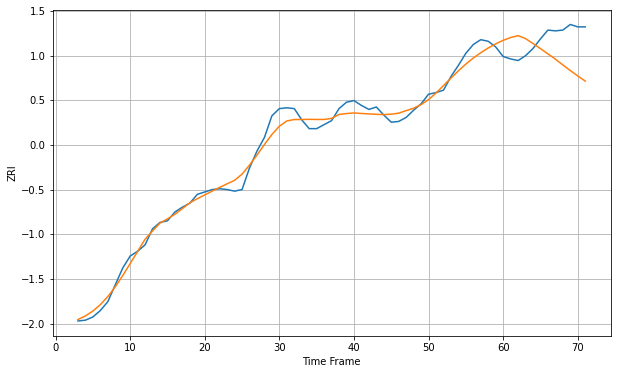

Wall time: 6.53 s
80027 9.310382391654556 39.13245337726019 [1634.23223933 1637.67020892 1640.07474209 1636.31153271 1630.28952572
 1623.85591074 1617.30946155 1610.75818301 1603.52882436 1596.47322247
 1589.77874684 1583.33866351]

Got an mse at 0.0099 in round 158 and stopped training



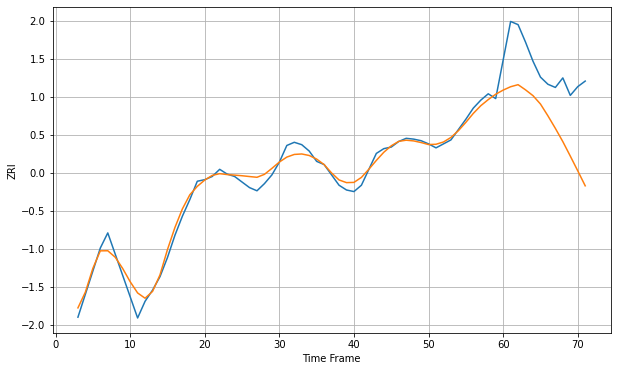

Wall time: 9.03 s
80033 8.993753873291135 73.91270031908866 [1292.65439667 1296.89335352 1299.48444311 1292.96306444 1285.66457638
 1275.15432004 1260.29776775 1244.4917928  1227.84183225 1209.65746979
 1191.11119392 1172.25244406]

Got an mse at 0.0098 in round 39 and stopped training



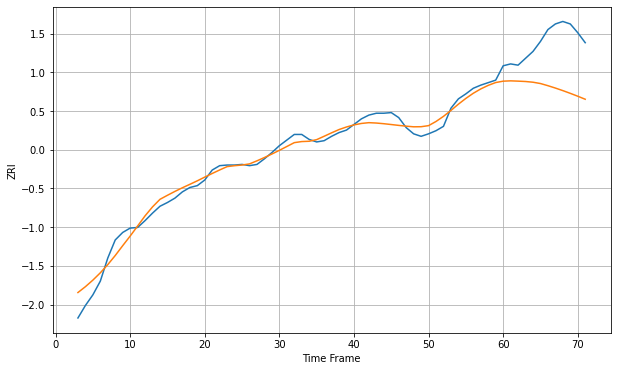

Wall time: 6.72 s
80111 12.304181063662218 77.55042033453425 [1594.34720682 1594.86346806 1594.40258911 1593.82331292 1592.66945321
 1590.57630653 1587.11742136 1583.32759535 1579.2282869  1574.85294944
 1570.24530179 1565.39474928]

Got an mse at 0.0098 in round 40 and stopped training



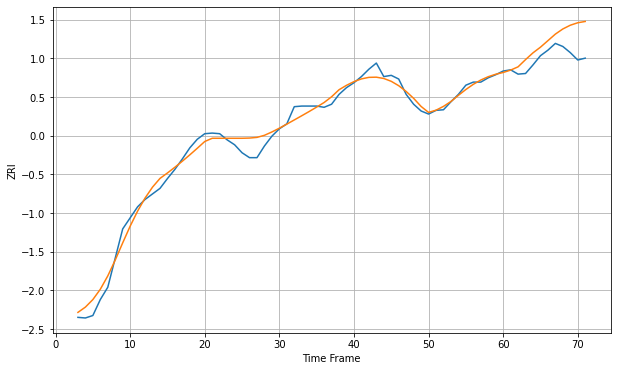

Wall time: 5.93 s
80112 12.56696537325576 31.295932446411765 [1782.6585465  1786.55552128 1791.87571741 1803.59828289 1814.64832202
 1823.85499724 1834.4850545  1845.15837902 1853.52114521 1859.62593462
 1863.62323145 1865.73393342]

Got an mse at 0.0098 in round 27 and stopped training



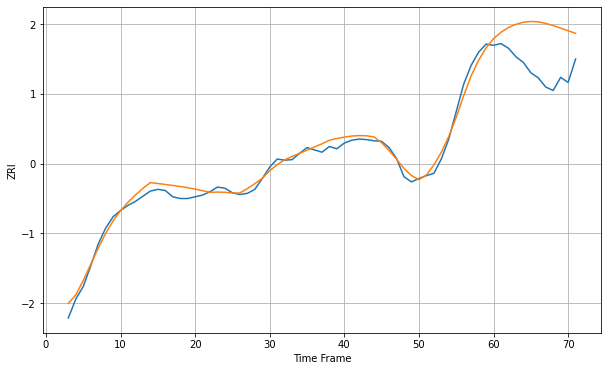

Wall time: 6.18 s
80120 10.689962466621221 76.67207567837313 [1680.64506753 1691.8102241  1700.22483973 1705.67187888 1709.3840614
 1710.70617609 1710.04049785 1707.28980189 1703.48757976 1699.06766605
 1694.45340256 1689.98808214]

Got an mse at 0.0100 in round 73 and stopped training



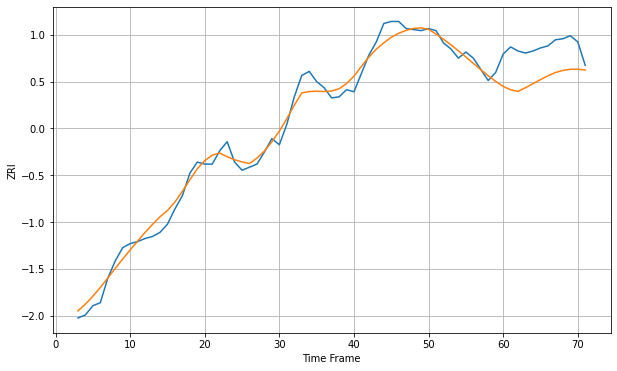

Wall time: 7.04 s
80124 8.796203239216014 31.848154912341986 [1589.29002473 1585.94196495 1584.3539453  1588.04300719 1591.94354783
 1595.91752849 1599.69707887 1602.90301255 1604.95399447 1606.05831663
 1606.18489756 1605.34176367]

Got an mse at 0.0100 in round 69 and stopped training



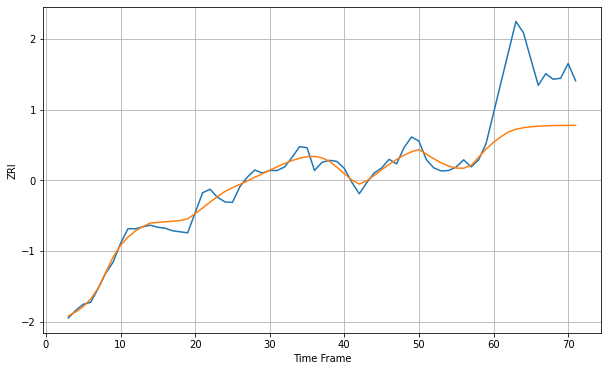

Wall time: 7 s
80129 13.725202537856578 127.35121011652303 [1884.42779306 1895.68188163 1905.12108326 1910.32251661 1913.37576224
 1915.23492702 1916.40204042 1917.14485957 1917.58672755 1917.85042734
 1918.03323484 1918.20716519]

Got an mse at 0.0099 in round 187 and stopped training



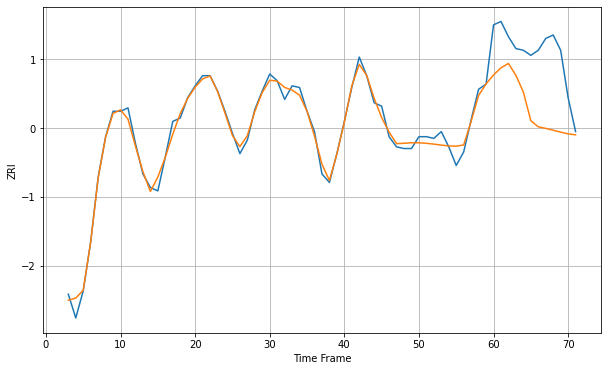

Wall time: 9.16 s
80202 3.91043376345764 35.38572092232166 [2005.45536839 2009.65390064 2012.20441119 2005.23340059 1995.33369789
 1978.44466324 1974.81372778 1973.90229465 1972.80183199 1971.6902289
 1970.66545043 1970.0834373 ]

Got an mse at 0.0095 in round 37 and stopped training



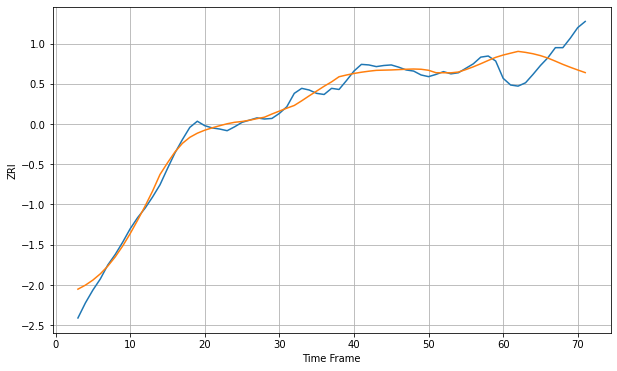

Wall time: 6.14 s
80203 12.745881787152854 51.606268428966274 [1607.74337181 1611.09503281 1614.32262283 1612.52852521 1610.07819991
 1606.72383229 1602.29905603 1596.78759525 1591.0333433  1585.82708306
 1580.94624958 1576.24589208]

Got an mse at 0.0099 in round 68 and stopped training



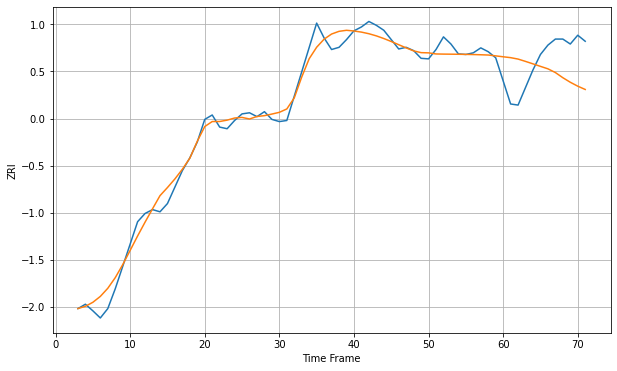

Wall time: 6.84 s
80204 16.60928622591261 64.81858114735769 [1847.80475064 1846.21836206 1843.63279058 1839.38808897 1834.93536908
 1830.39082121 1825.92110807 1819.14232766 1809.76719381 1801.49262658
 1794.37504704 1788.38477205]

Got an mse at 0.0098 in round 53 and stopped training



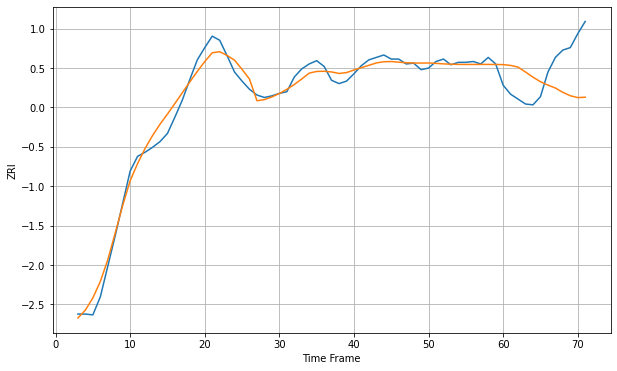

Wall time: 6.64 s
80205 10.149254927092999 49.077758579937345 [1670.19546433 1669.23853035 1667.15190171 1661.10777301 1654.85936192
 1649.27166448 1645.16830537 1641.57628077 1636.28518166 1632.12249004
 1629.85890421 1630.33846541]

Got an mse at 0.0100 in round 35 and stopped training



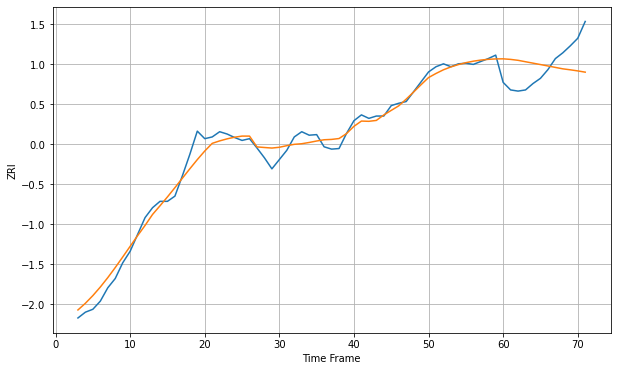

Wall time: 6.3 s
80210 14.283006531241645 45.574924176882526 [1640.59575056 1639.63463624 1638.03496981 1635.58434945 1633.16063389
 1630.74883962 1628.31707888 1625.82635567 1623.35744916 1621.69424097
 1619.79136889 1617.63176463]

Got an mse at 0.0098 in round 36 and stopped training



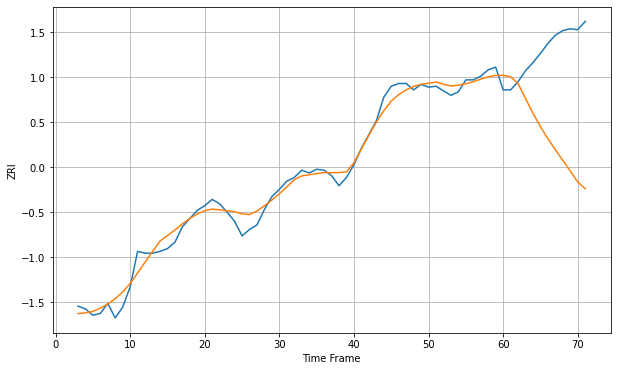

Wall time: 6 s
80211 9.382252370088345 109.44674404113874 [1710.03387927 1708.36170777 1701.03038931 1684.49384471 1668.36371941
 1653.66344052 1640.41998938 1628.32607488 1616.76412897 1604.98459324
 1593.06151366 1585.62975267]

Got an mse at 0.0099 in round 34 and stopped training



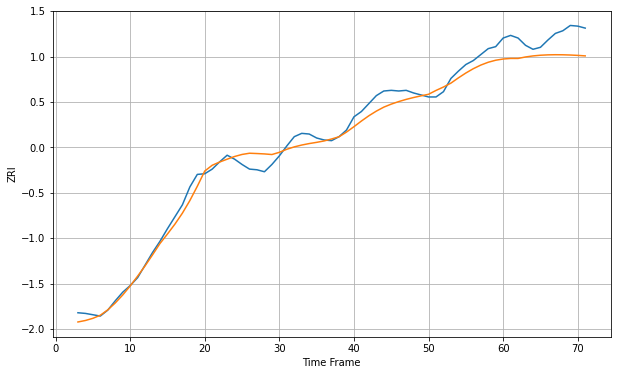

Wall time: 6.56 s
80214 12.831928444279944 31.991583897175243 [1290.32834807 1291.19749662 1291.18612555 1293.40688865 1294.99136054
 1296.02337619 1296.59801125 1296.8020749  1296.70431731 1296.35484966
 1295.78971371 1295.03651857]

Got an mse at 0.0099 in round 26 and stopped training



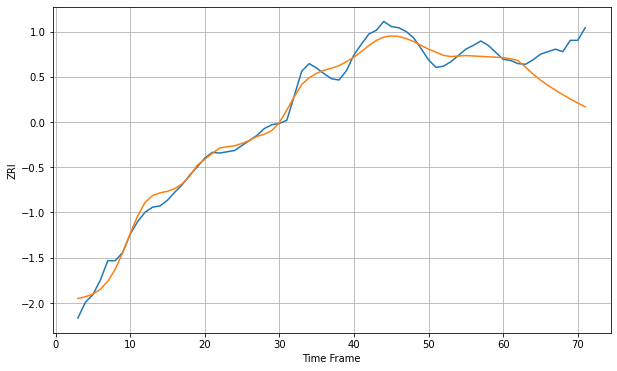

Wall time: 5.4 s
80218 13.95112373146031 63.49334429722308 [1429.57862354 1427.75159735 1424.83386351 1414.43903157 1403.49216529
 1393.82672648 1385.39514797 1377.95944613 1370.75998178 1363.84970474
 1357.4489659  1351.42616867]

Got an mse at 0.0100 in round 25 and stopped training



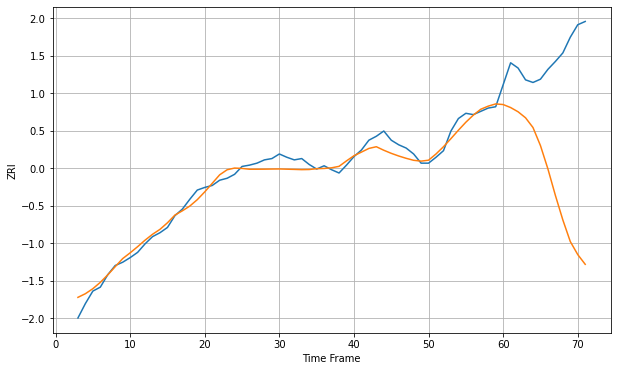

Wall time: 6.37 s
80226 11.486717681034285 207.0853841946412 [1456.3562698  1451.78138752 1445.32169085 1436.17918639 1421.30314208
 1393.80436415 1358.18504288 1317.92965518 1280.50232851 1247.51378899
 1227.62246581 1212.79577737]

Got an mse at 0.0099 in round 54 and stopped training



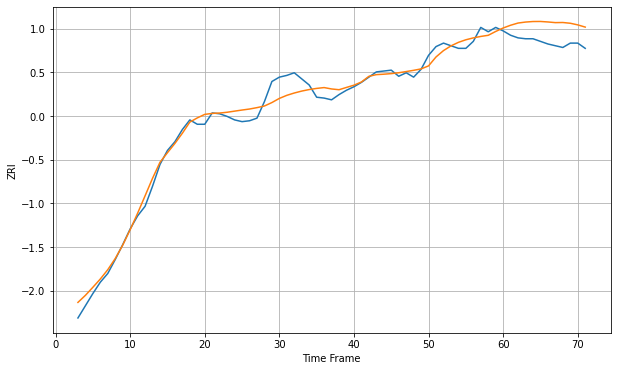

Wall time: 6.52 s
80229 9.685909135776427 21.23720939590495 [1412.31299127 1415.48488347 1418.00469934 1419.12624773 1419.73907802
 1419.80640737 1419.23755163 1418.48021369 1418.61763653 1417.7581147
 1415.89750244 1413.3489524 ]

Got an mse at 0.0095 in round 29 and stopped training



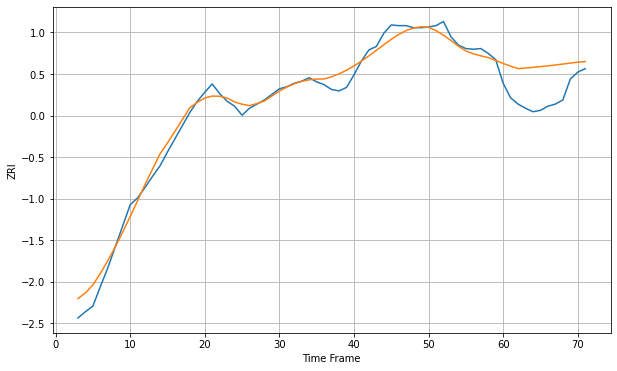

Wall time: 5.79 s
80231 12.131652664809573 47.42165084051007 [1352.4970118  1348.65265858 1345.12707888 1345.97162892 1346.92095264
 1347.97202863 1349.11813782 1350.34951792 1351.6541031  1353.01825725
 1354.42741726 1355.21445827]

Got an mse at 0.0098 in round 37 and stopped training



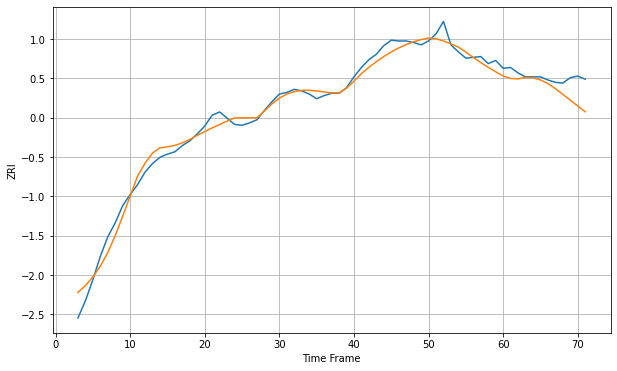

Wall time: 6.28 s
80233 10.368496359720734 19.819796052423463 [1411.16169077 1407.98407628 1407.37526964 1409.25260386 1408.73233859
 1406.04695422 1401.57335333 1394.93037359 1387.58177063 1380.09876003
 1372.63571081 1365.22650453]

Got an mse at 0.0098 in round 81 and stopped training



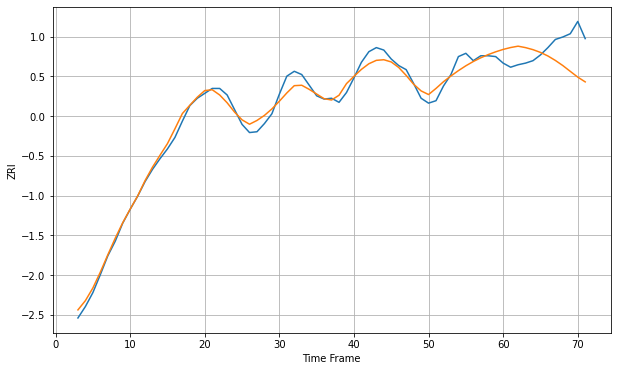

Wall time: 6.92 s
80237 8.470780259956635 33.5342397296504 [1464.77551745 1467.08222956 1468.74790941 1466.97963203 1464.48662211
 1461.12693031 1456.73555478 1451.27132598 1445.00491259 1437.89283374
 1430.88414313 1425.02651439]

Got an mse at 0.0098 in round 95 and stopped training



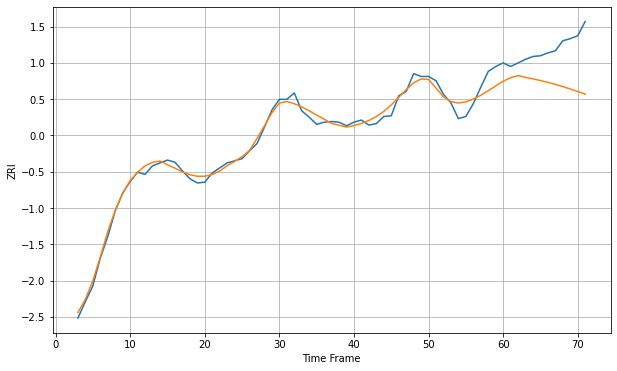

Wall time: 7.94 s
80301 9.056376523948494 52.81670894114903 [1737.37186762 1742.23796814 1745.28140777 1742.73581404 1740.66615858
 1738.33443534 1735.75189998 1732.91348696 1729.81507801 1726.47509429
 1722.95391066 1719.3581216 ]

Got an mse at 0.0098 in round 46 and stopped training



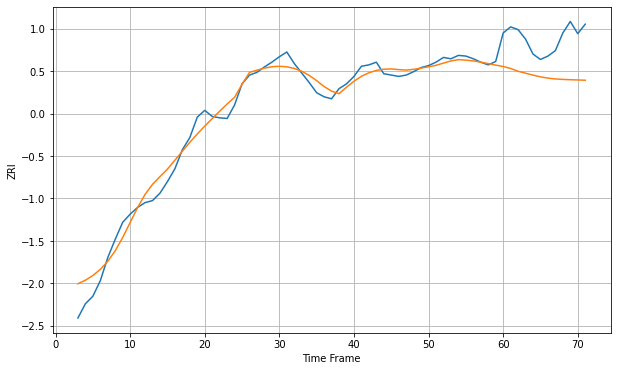

Wall time: 6.15 s
80401 14.737848647741515 58.03889349282909 [1547.6362373  1544.77539222 1540.57703826 1537.79992949 1534.91660937
 1532.39143244 1530.50844426 1529.2966461  1528.58732709 1528.15107198
 1527.79424315 1527.38709199]

Got an mse at 0.0099 in round 102 and stopped training



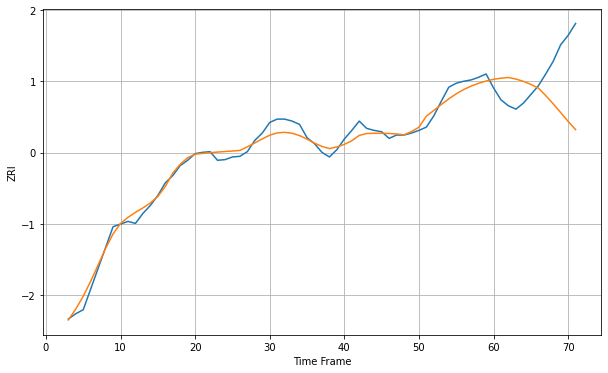

Wall time: 7.6 s
80503 10.42465719544887 73.19777845787901 [1407.89521936 1409.65629303 1410.64553579 1408.30363512 1404.90407723
 1400.29603184 1394.80852855 1383.37278559 1371.02787383 1357.93035236
 1344.5540651  1332.20972319]

Got an mse at 0.0098 in round 63 and stopped training



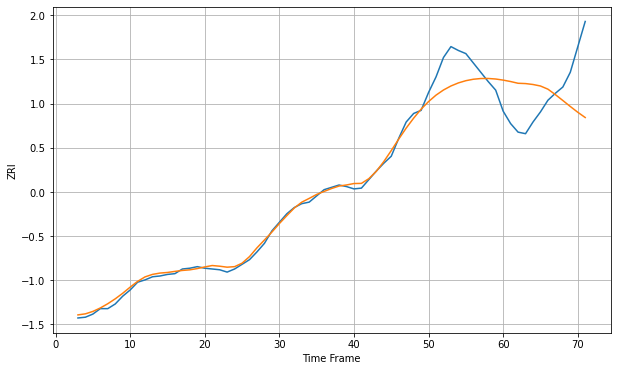

Wall time: 6.73 s
80904 12.812617602531537 58.33713393748833 [1014.92005879 1013.07446466 1010.84950137 1010.46005074 1009.2715683
 1007.3416392  1003.26640614  996.25403938  988.69518211  981.00337603
  973.5849878   966.79159435]

Got an mse at 0.0099 in round 92 and stopped training



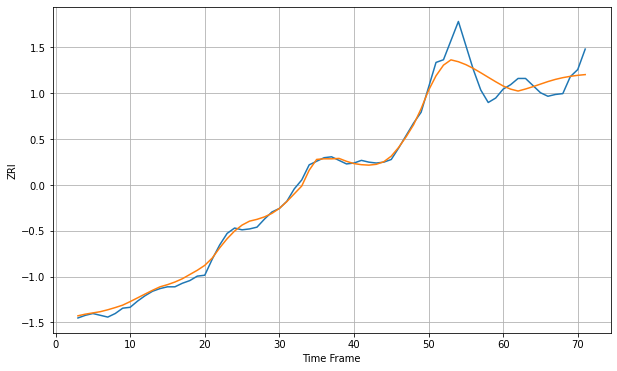

Wall time: 7.15 s
80915 10.006437633589197 13.588419930425403 [951.55780363 948.00776188 945.86000624 948.15645478 950.76802685
 953.64541942 956.48409119 958.94426747 960.89361606 962.38225162
 963.50462083 964.32859298]

Got an mse at 0.0099 in round 47 and stopped training



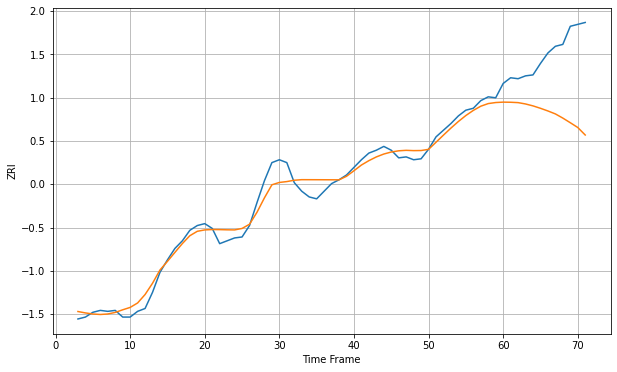

Wall time: 6.45 s
84047 9.394954785903007 68.53999489404637 [1099.43976054 1099.30756357 1098.92772036 1097.51331024 1095.50820527
 1092.98067551 1090.18104167 1087.07572261 1082.69857163 1077.84659142
 1072.84955603 1064.96522282]

Got an mse at 0.0099 in round 108 and stopped training



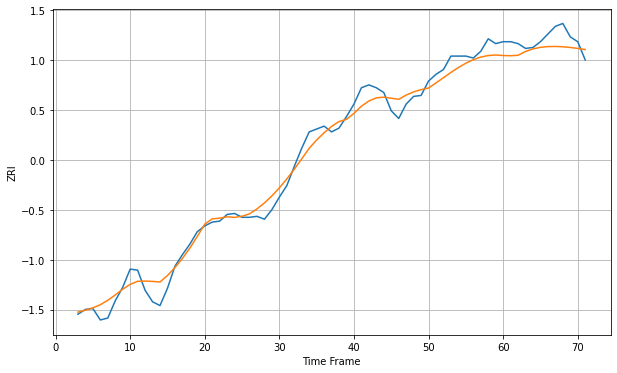

Wall time: 7.54 s
84095 10.782687464749316 13.244777969730277 [1322.58152285 1322.3752946  1322.8328616  1326.81922516 1329.49508564
 1331.11183883 1331.90010905 1332.04737867 1331.70214507 1330.98387667
 1329.99075988 1328.80434069]

Got an mse at 0.0100 in round 37 and stopped training



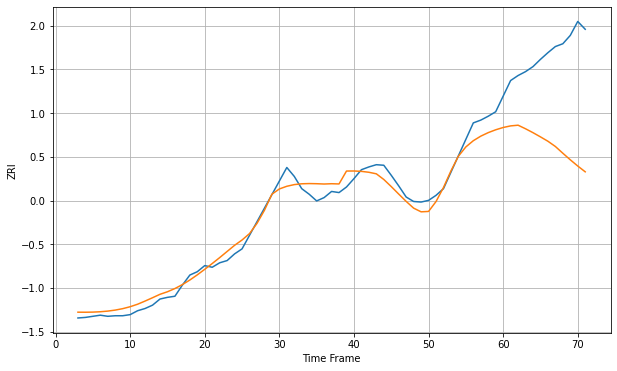

Wall time: 6.44 s
84102 15.888792263729156 168.35447910714942 [1062.75683145 1065.62885897 1066.87627017 1060.47671927 1053.46182332
 1045.93388698 1038.10286129 1028.69000586 1016.57582121 1004.79385403
  993.63268121  983.23791674]

Got an mse at 0.0097 in round 22 and stopped training



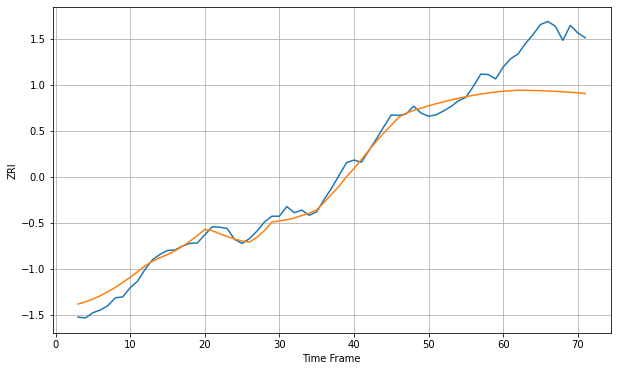

Wall time: 5.66 s
84103 19.546458558071997 124.0789265623781 [1339.85090155 1341.12759239 1342.20793153 1342.04845471 1341.63726554
 1341.05220333 1340.344419   1339.53190606 1338.6055768  1337.53950798
 1336.2990506  1334.84530615]

Got an mse at 0.0100 in round 48 and stopped training



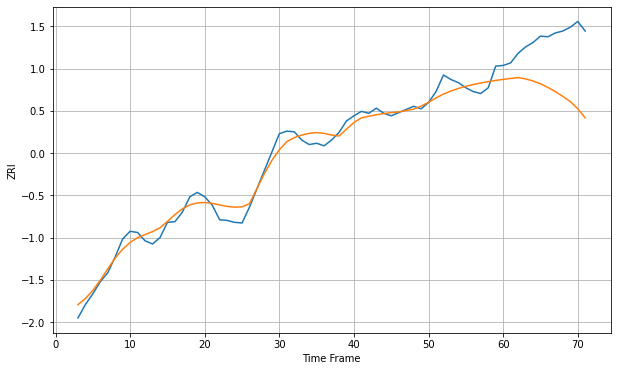

Wall time: 6.65 s
84106 13.34637337377066 86.78687454785646 [1241.19385766 1242.61377033 1244.00188075 1241.9356878  1238.65183956
 1234.18490857 1228.58278331 1221.9674733  1214.53336682 1206.5089713
 1195.10005593 1180.85446523]

Got an mse at 0.0095 in round 45 and stopped training



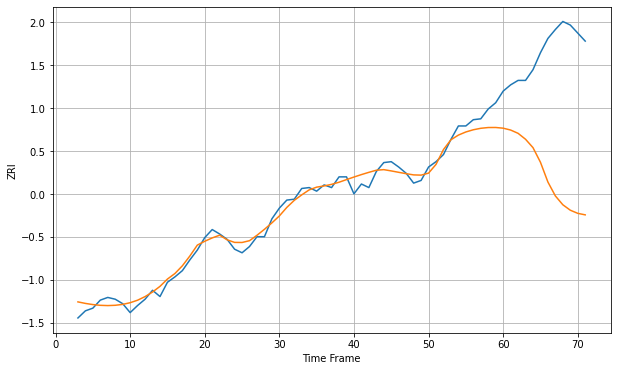

Wall time: 6.38 s
84119 8.840109742959486 146.9314484156241 [993.51144499 991.43205176 987.76223721 981.10449    971.72047327
 955.35595319 933.21060086 917.63542196 907.76617504 901.6662821
 898.16423252 896.45868642]

Got an mse at 0.0098 in round 48 and stopped training



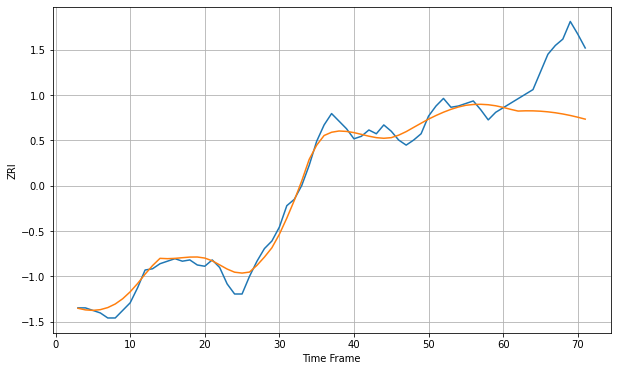

Wall time: 6.37 s
84403 6.923723810285019 43.846600632807146 [888.89588547 887.3584777  885.98922862 886.18313725 886.15105479
 885.8824619  885.3760402  884.63589296 883.6699307  882.49086656
 881.11920487 879.58706668]

Got an mse at 0.0099 in round 64 and stopped training



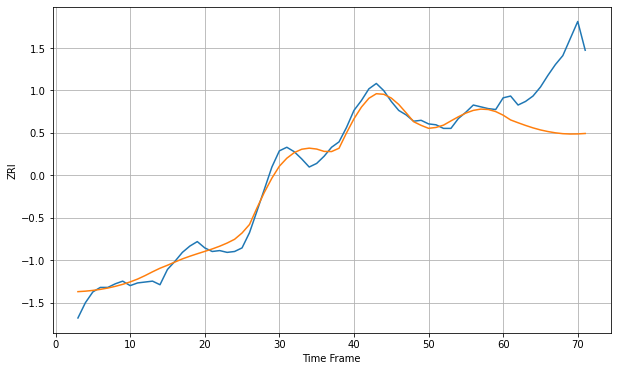

Wall time: 6.65 s
85008 9.273654335247196 69.80860419358702 [1034.71149126 1029.39615162 1026.27389755 1023.3006432  1020.5864172
 1018.28241076 1016.48554215 1015.05754443 1014.11473418 1013.73840731
 1013.84580257 1014.33632996]

Got an mse at 0.0098 in round 39 and stopped training



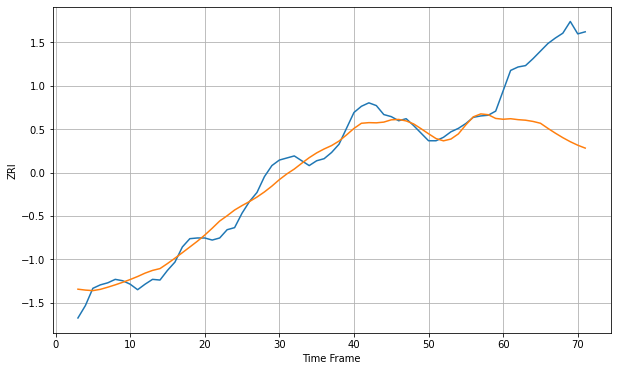

Wall time: 6.28 s
85014 15.12236557819055 122.47314873471872 [1153.17905771 1153.95933287 1152.60080273 1151.80941581 1150.04260453
 1147.39511251 1139.9794398  1132.99783817 1126.48001769 1120.61646339
 1115.53874845 1111.34881907]

Got an mse at 0.0100 in round 22 and stopped training



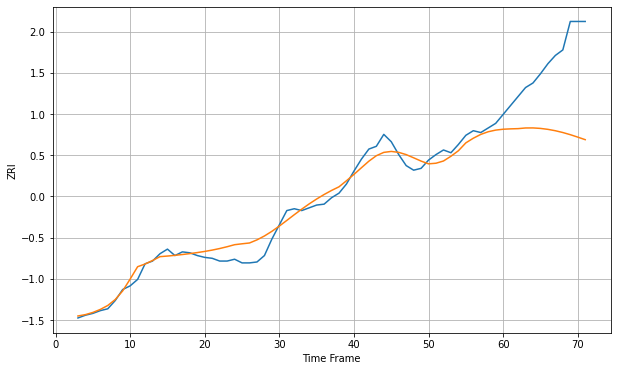

Wall time: 5.37 s
85015 9.747715195891272 80.42530293515698 [930.60440732 931.00777209 931.25452513 931.97407446 932.02510682
 931.50184009 930.4710332  928.96801569 927.017518   924.66784131
 922.02015183 919.22713143]

Got an mse at 0.0098 in round 60 and stopped training



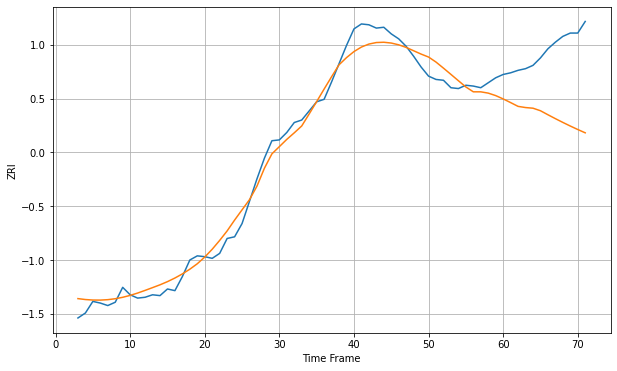

Wall time: 7.12 s
85016 13.042705441182811 83.11466024883518 [1288.50118155 1284.05172095 1279.48517841 1278.05795816 1277.27809601
 1274.21889225 1269.37644579 1264.66817737 1260.11966804 1255.74610278
 1251.55495933 1247.5483815 ]

Got an mse at 0.0099 in round 52 and stopped training



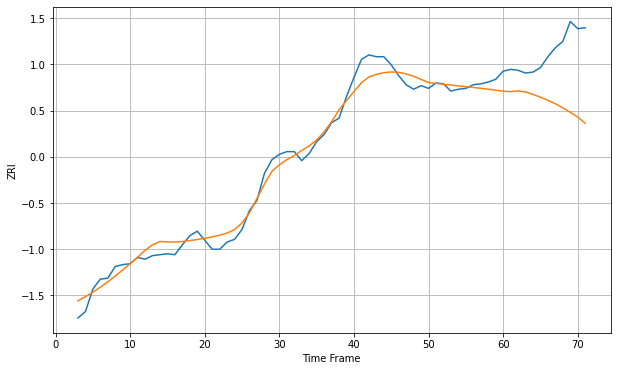

Wall time: 6.22 s
85018 10.604353704874605 62.01347034444029 [1192.80841234 1192.39165306 1193.13894627 1192.0897018  1189.31476781
 1186.17438973 1182.78494393 1178.93663273 1174.47336417 1169.48210177
 1164.24107274 1157.35964817]

Got an mse at 0.0099 in round 87 and stopped training



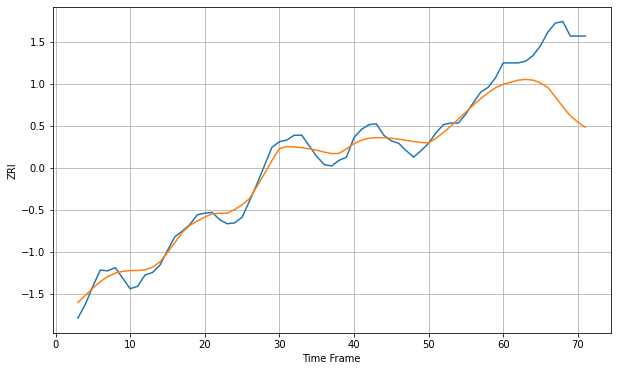

Wall time: 7.63 s
85020 10.53207091146853 72.23266074042175 [1091.6005754  1094.20889428 1096.717439   1097.68338503 1096.76342088
 1093.38077964 1087.71018353 1076.07662177 1063.93502643 1052.89799071
 1045.03069139 1038.84523503]

Got an mse at 0.0098 in round 53 and stopped training



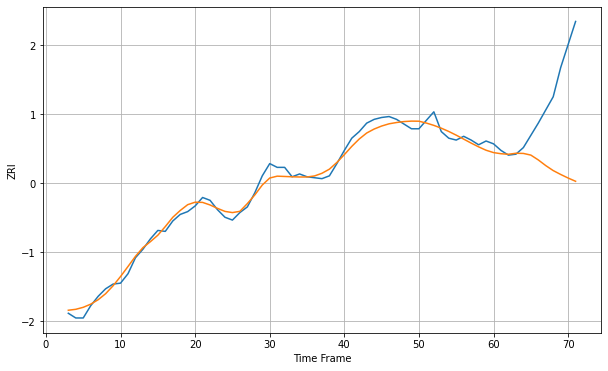

Wall time: 6.73 s
85027 6.519141463334434 78.30764202904571 [1014.69294112 1013.49732496 1012.91161645 1013.99321025 1013.80885561
 1012.04591716 1006.90776868 1000.88805095  995.58829641  991.47270286
  987.66842348  984.20168866]

Got an mse at 0.0099 in round 58 and stopped training



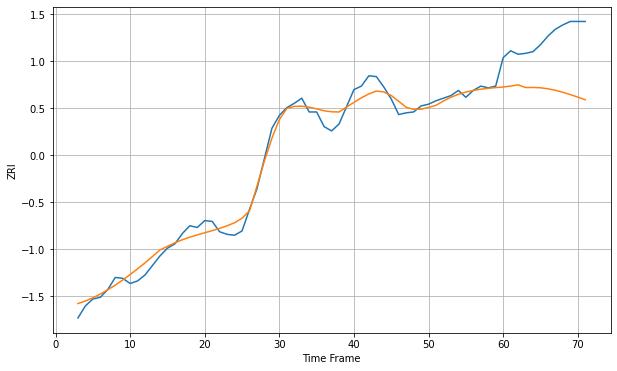

Wall time: 6.2 s
85032 9.540831786883809 63.179754577595666 [1158.96612137 1160.04460499 1161.43300212 1158.34618202 1158.44956391
 1158.05066873 1156.91862075 1155.13785188 1152.8397322  1150.17314167
 1147.25729591 1144.1708641 ]

Got an mse at 0.0098 in round 53 and stopped training



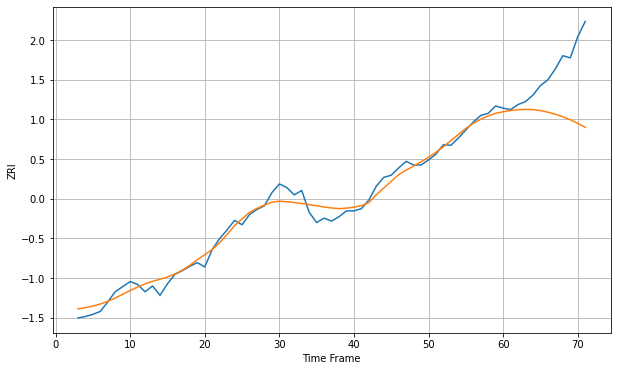

Wall time: 6.63 s
85044 10.24087742229435 68.9441738832086 [1345.11330062 1346.73497701 1347.92868166 1348.36539041 1348.04543637
 1346.68714506 1344.51145327 1341.65352356 1338.27336669 1334.16481695
 1329.14124475 1323.82913816]

Got an mse at 0.0097 in round 35 and stopped training



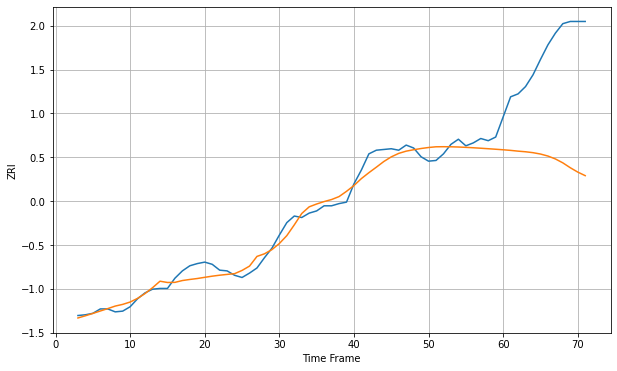

Wall time: 6.13 s
85201 11.317037357818544 148.6559765633524 [1029.58414954 1028.75295912 1027.70922774 1026.86214024 1025.62008132
 1023.7707676  1021.01068684 1017.06392569 1011.69540039 1005.01925635
  999.08461274  994.19986957]

Got an mse at 0.0100 in round 53 and stopped training



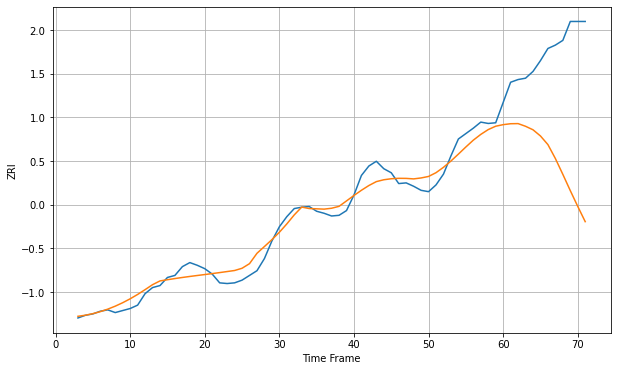

Wall time: 6.27 s
85204 13.82848521482063 170.14561597728706 [1114.21241239 1115.59083251 1115.7777786  1111.80965895 1106.6385941
 1097.47918584 1084.69076669 1064.0743938  1040.65670597 1016.54580661
  993.19350518  970.61717382]

Got an mse at 0.0099 in round 17 and stopped training



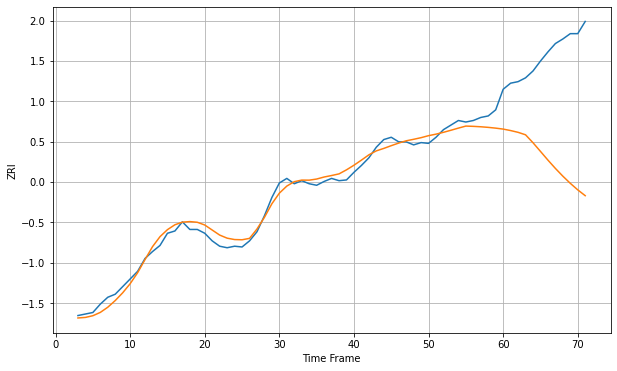

Wall time: 6.02 s
85224 8.841963458910707 144.8722097591936 [1128.7348635  1126.80886995 1124.48658624 1121.25600604 1110.83378572
 1099.48254115 1088.053994   1077.14048971 1066.95682182 1057.5602203
 1048.97282273 1041.32368344]

Got an mse at 0.0100 in round 64 and stopped training



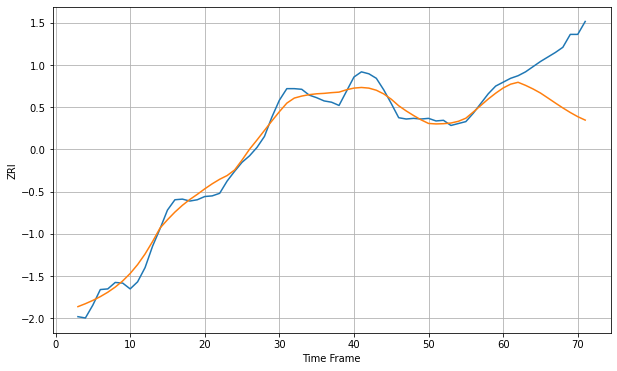

Wall time: 6.64 s
85251 12.960945797513444 80.30367703400697 [1384.99666568 1390.91921491 1393.84570931 1389.10124206 1383.56607301
 1377.23746058 1369.5388169  1361.75005158 1354.17593287 1347.0739013
 1340.62513194 1335.30262787]

Got an mse at 0.0099 in round 61 and stopped training



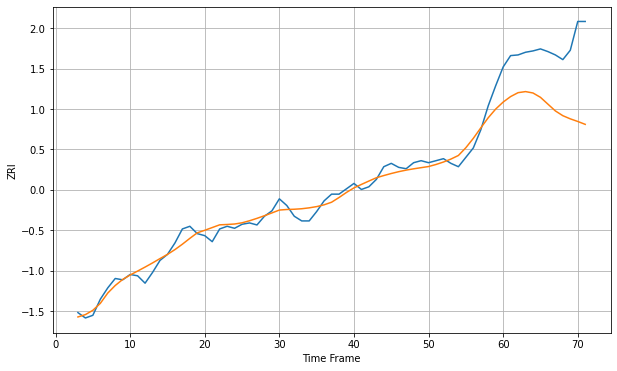

Wall time: 6.37 s
85260 11.432781427636858 90.80897838615414 [1480.56636016 1488.78564127 1494.61637524 1496.2276334  1494.14190979
 1487.6634845  1477.4754183  1467.35350508 1460.22103118 1455.49960872
 1451.59748248 1447.27120291]

Got an mse at 0.0100 in round 66 and stopped training



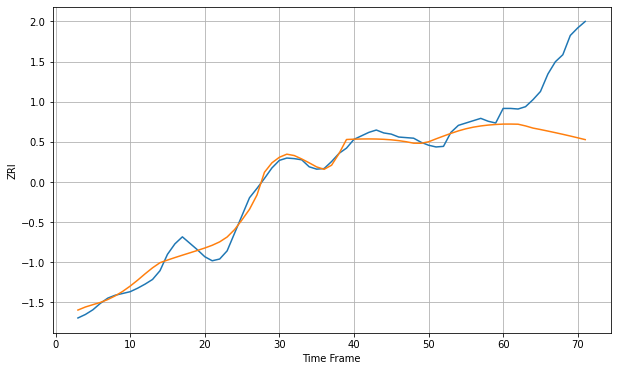

Wall time: 7.11 s
85281 12.52861931463351 115.0592418410372 [1200.16746681 1200.21909229 1199.97524557 1197.03449517 1193.34984413
 1190.86165802 1188.19787067 1185.46271715 1182.65145326 1179.7235866
 1176.67565423 1173.56537232]

Got an mse at 0.0096 in round 34 and stopped training



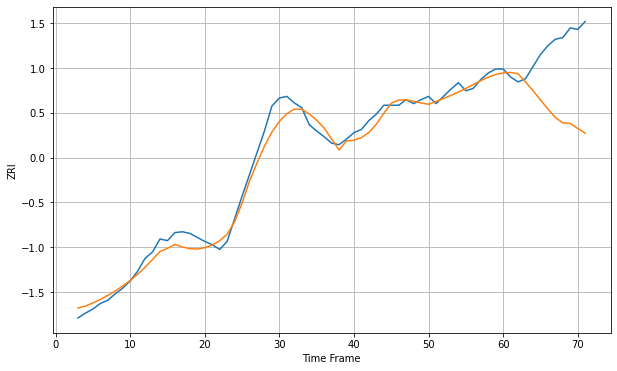

Wall time: 5.97 s
85282 11.16218085714108 81.37317717355047 [1202.19960858 1202.7149431  1201.15670838 1190.79879607 1180.13638508
 1168.62832702 1157.31420389 1146.72092908 1140.19254879 1139.36955673
 1133.16680359 1127.42890531]

Got an mse at 0.0098 in round 50 and stopped training



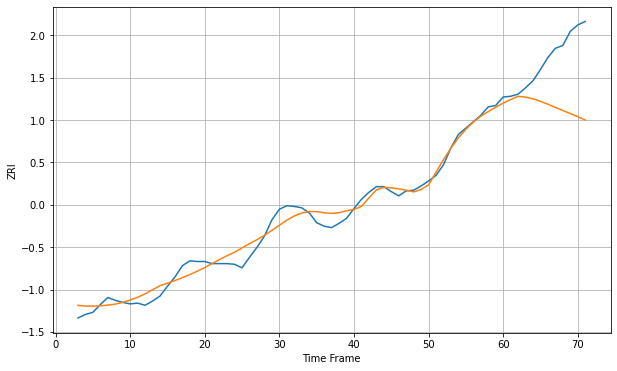

Wall time: 6.59 s
85283 11.48844516206231 77.86405194495113 [1198.29884408 1203.36205019 1207.99065989 1206.90855334 1204.42834784
 1200.93951107 1196.8022675  1192.30134448 1187.8348613  1183.57137746
 1179.10484396 1174.4245224 ]

Got an mse at 0.0097 in round 45 and stopped training



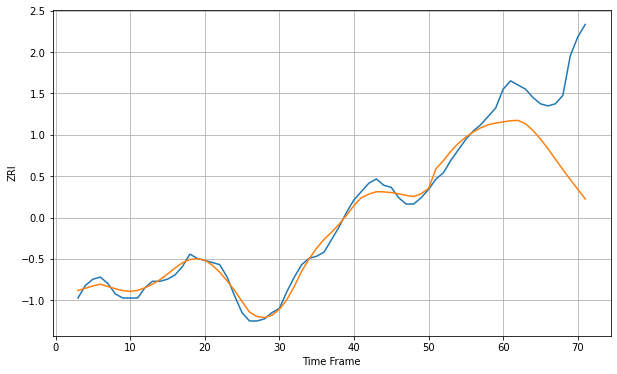

Wall time: 6.03 s
85705 3.229187971780843 40.71376074689102 [703.35344221 703.89908131 704.06020014 702.44993815 699.22499539
 695.17272525 690.50117632 685.51121673 680.53687209 675.72440463
 671.08266055 666.46097235]

Got an mse at 0.0098 in round 88 and stopped training



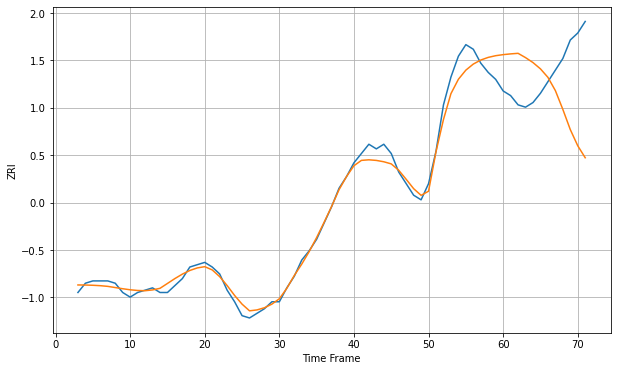

Wall time: 7.39 s
85716 3.8039844551623303 28.60453717655125 [763.67961478 764.00334248 764.24539718 762.39522949 760.25587113
 757.53943348 753.88051414 748.15210687 740.05386722 731.33220157
 724.3386166  719.17294451]

Got an mse at 0.0099 in round 90 and stopped training



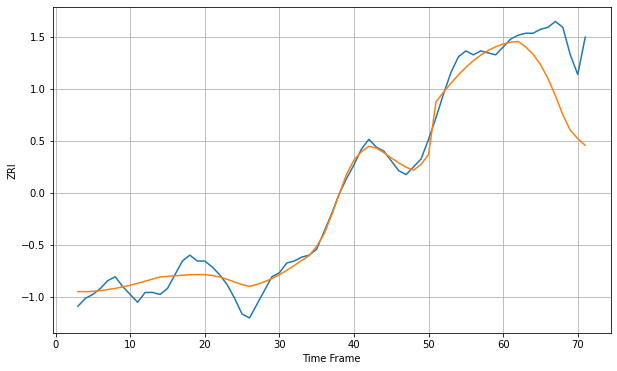

Wall time: 7.74 s
85719 5.658214653026338 29.096313706776442 [808.4936367  809.43485856 809.78535828 807.11405215 803.33416428
 798.0814936  791.0333069  782.23889151 772.47593471 764.55984718
 760.31319446 756.92508325]

Got an mse at 0.0096 in round 34 and stopped training



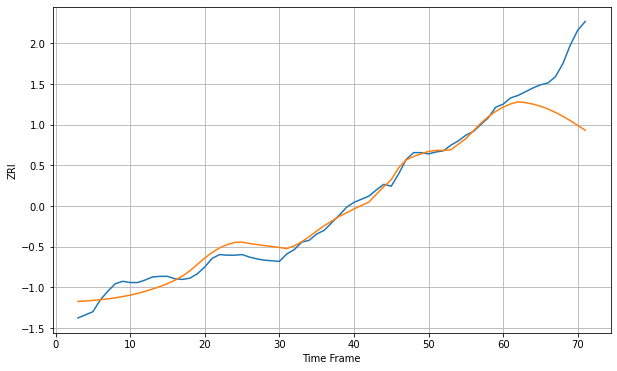

Wall time: 6.09 s
86314 13.41563361484409 83.37924921167195 [1065.20588882 1070.39237221 1073.69488415 1072.43569568 1070.08741792
 1066.68703884 1062.24512002 1056.80715814 1050.47441205 1043.40977183
 1035.82583114 1027.95491098]

Got an mse at 0.0100 in round 85 and stopped training



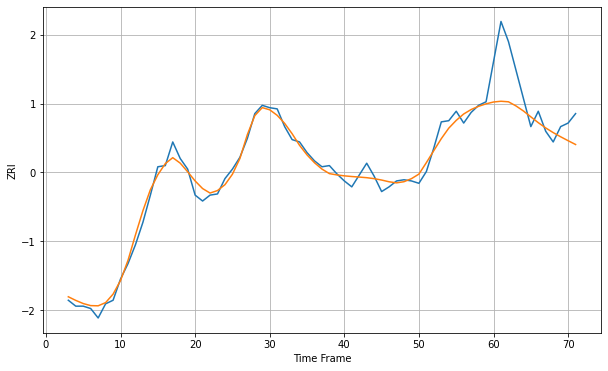

Wall time: 7.4 s
87111 5.842010650635186 29.70525856505367 [917.823241   918.45867537 917.99545646 914.54415896 910.26930572
 905.26574832 900.32734768 895.8472069  891.91938842 888.37942495
 885.05452598 881.83914896]

Got an mse at 0.0098 in round 47 and stopped training



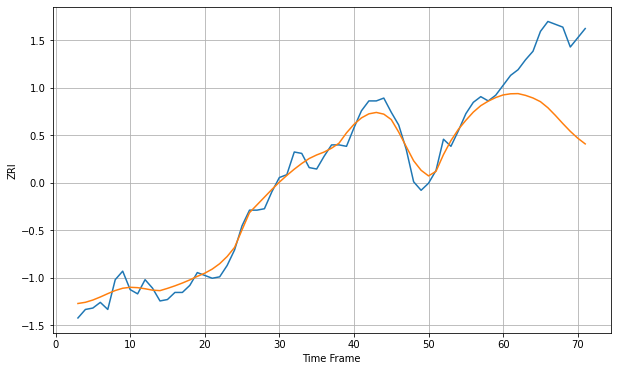

Wall time: 6.07 s
89030 6.6826263602649245 51.85040689138212 [866.21191505 867.01957392 867.14936158 865.90320489 864.06307197
 861.46148698 857.16929779 851.79177736 846.03090211 840.55436941
 835.73594906 831.69744295]

Got an mse at 0.0099 in round 46 and stopped training



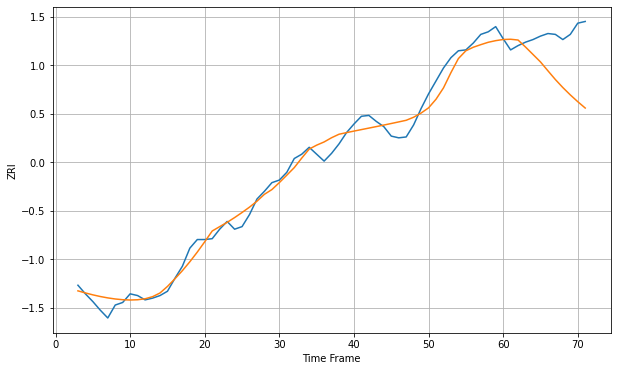

Wall time: 6.86 s
89052 11.308169079671233 51.99149921630098 [1463.06895237 1463.3617432  1462.45511158 1454.32306413 1445.72052661
 1437.0867915  1426.78014621 1416.62482702 1407.33966069 1398.81762093
 1390.92997714 1383.56129849]

Got an mse at 0.0100 in round 61 and stopped training



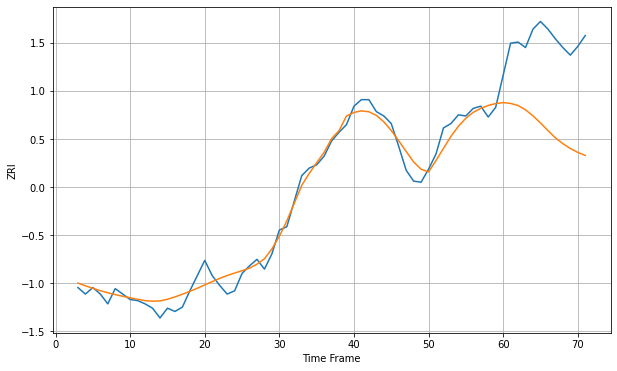

Wall time: 6.77 s
89101 8.887860088619764 81.37066233943277 [876.27967284 875.53651689 873.62781203 869.66017969 864.12042938
 857.57285152 850.57969707 843.86901567 838.53628309 834.04894415
 830.44986207 827.65619051]

Got an mse at 0.0099 in round 40 and stopped training



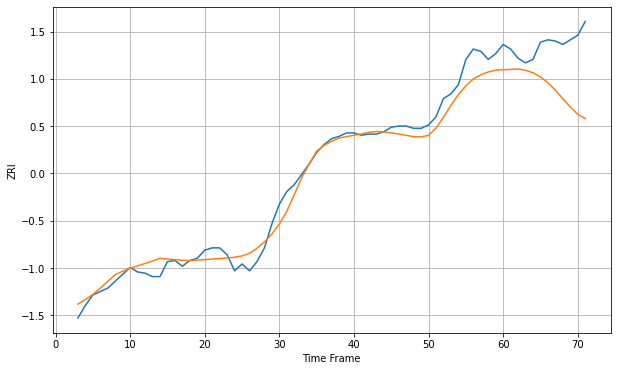

Wall time: 6.5 s
89108 9.619109304028012 43.48551715762026 [1065.00373304 1065.25273779 1065.62435491 1064.5638544  1062.36626856
 1058.79198243 1053.68907124 1047.18917228 1039.85376285 1032.54550887
 1026.25092226 1022.59097587]

Got an mse at 0.0098 in round 50 and stopped training



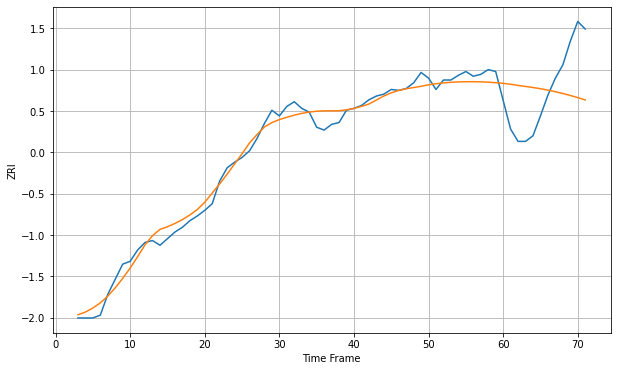

Wall time: 6.41 s
89117 8.800325454157885 49.57740406231793 [1274.49022039 1273.50991921 1272.25871455 1271.19001656 1270.05926879
 1268.78472569 1267.29840462 1265.60305639 1263.71236337 1261.63396638
 1259.37392243 1256.92142367]

Got an mse at 0.0100 in round 195 and stopped training



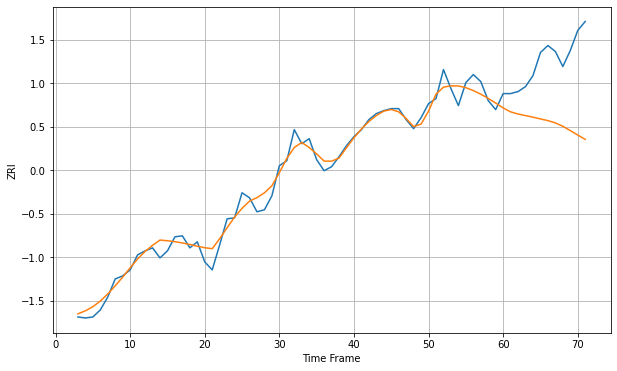

Wall time: 9.08 s
89119 8.786050029910225 66.7091950194603 [1117.65797713 1113.77893425 1111.60113891 1110.04815408 1108.46709067
 1106.66745562 1105.03396501 1102.72714345 1099.36766765 1095.06384381
 1090.59734607 1086.29975606]

Got an mse at 0.0100 in round 29 and stopped training



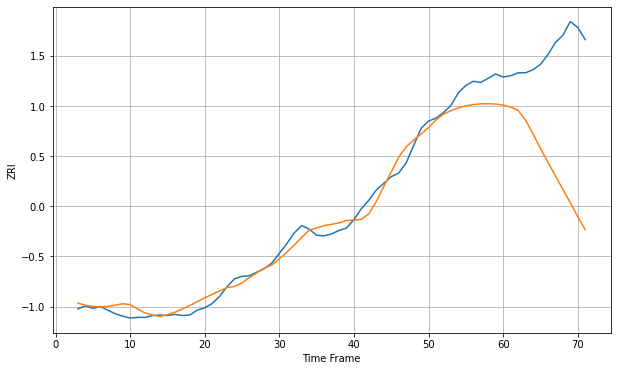

Wall time: 5.92 s
89502 17.177756655660932 199.60395387634514 [1017.45659085 1014.24159991 1008.94122103  992.59637197  970.10639533
  945.70131861  922.90464623  900.50018413  877.98712658  855.99013002
  832.76402112  811.12343553]

Got an mse at 0.0099 in round 151 and stopped training



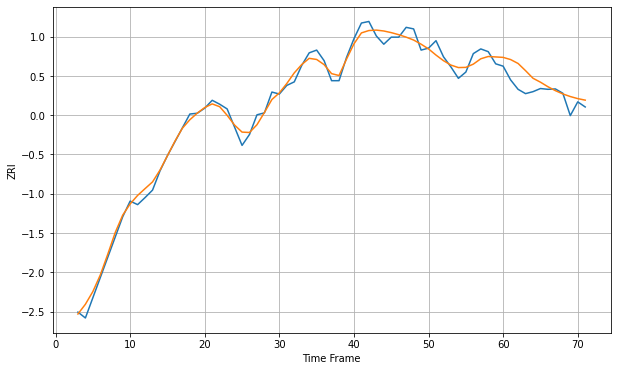

Wall time: 8.49 s
90001 17.161680500987163 35.59678489618806 [2357.41296294 2351.87202016 2341.92677478 2323.61426622 2304.19874144
 2294.18576783 2282.63251188 2272.59616965 2264.25302428 2257.58858189
 2252.31211873 2248.39665071]

Got an mse at 0.0100 in round 237 and stopped training



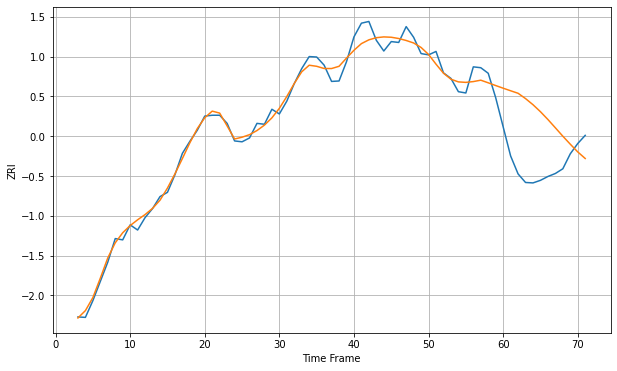

Wall time: 10.3 s
90002 18.488162735482277 130.0088671716475 [2333.18673637 2327.1750725  2321.33135504 2308.88611611 2294.61931938
 2278.25485474 2260.05278998 2240.65582172 2221.06911361 2202.35320929
 2184.37862    2169.00390231]

Got an mse at 0.0098 in round 44 and stopped training



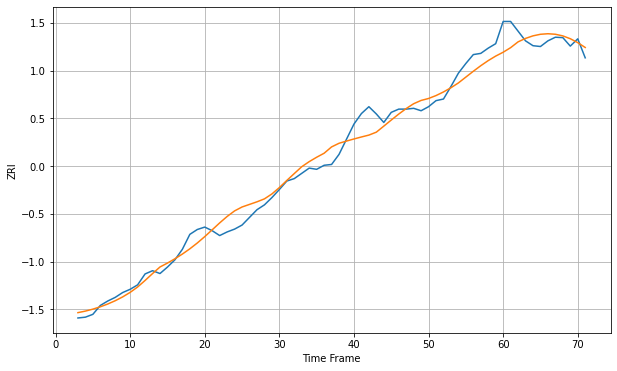

Wall time: 6.65 s
90003 25.897996493301548 33.81550237157905 [2063.81643034 2075.14111038 2089.51439637 2098.06259922 2104.39417798
 2108.27806387 2109.62214691 2108.32568288 2104.24679306 2097.28934869
 2087.5764359  2075.6051245 ]

Got an mse at 0.0099 in round 54 and stopped training



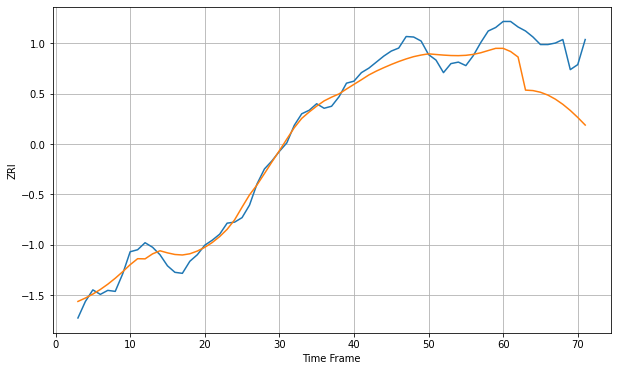

Wall time: 6.24 s
90004 20.054819242293103 104.28387870456224 [2230.40007294 2224.08393847 2213.12828562 2147.16602445 2146.21635271
 2142.91328062 2137.25280399 2129.11962198 2118.8472146  2106.6072349
 2092.67382714 2077.5332912 ]

Got an mse at 0.0097 in round 37 and stopped training



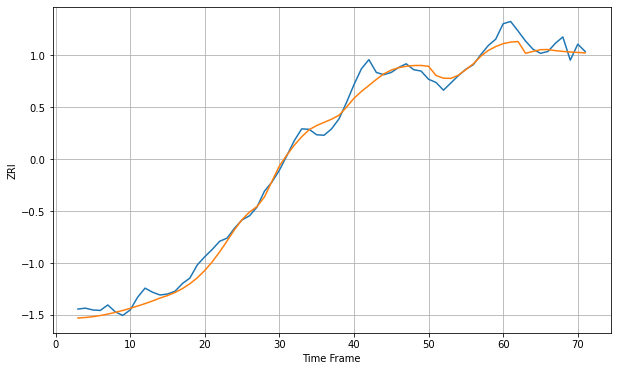

Wall time: 6.62 s
90006 18.1922430072242 24.60478565075629 [2160.21017467 2163.67573522 2164.91679677 2139.09634917 2143.11919964
 2147.03803899 2147.29588163 2144.89573497 2143.18542304 2141.93026157
 2140.91462493 2139.95194647]

Got an mse at 0.0100 in round 95 and stopped training



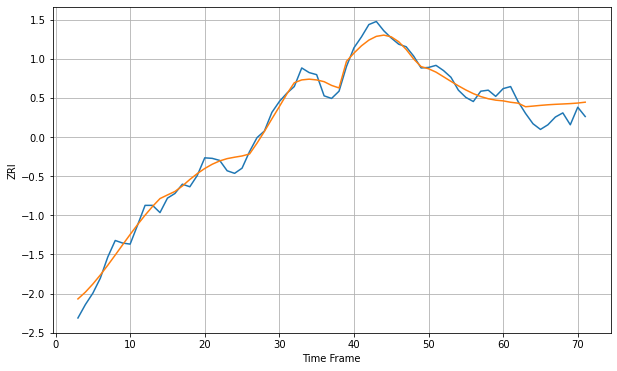

Wall time: 7.27 s
90007 15.739062195499361 28.750713335053614 [2227.27985163 2224.5954677  2222.85723663 2215.92082254 2217.18336732
 2218.55491439 2219.72724711 2220.59323252 2221.27260558 2222.0065376
 2223.07208739 2224.74544168]

Got an mse at 0.0100 in round 104 and stopped training



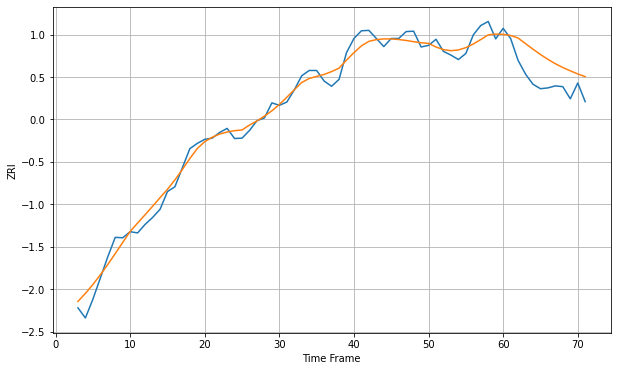

Wall time: 7.6 s
90011 21.23124502583355 59.776721383932724 [2391.16027158 2388.42233274 2382.17333228 2368.23491156 2354.53587332
 2341.46591995 2329.4192335  2318.65984787 2309.26493768 2301.15098281
 2293.46230884 2286.72094833]

Got an mse at 0.0099 in round 33 and stopped training



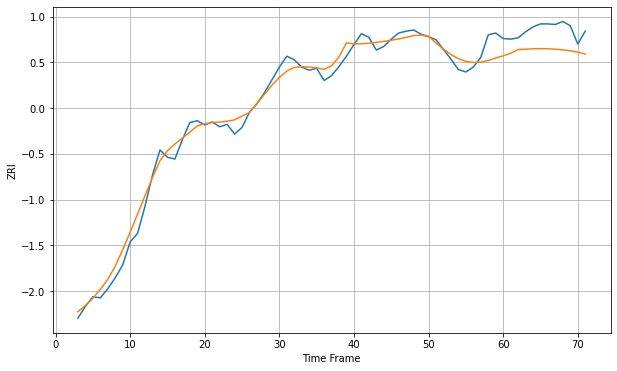

Wall time: 6.24 s
90012 15.179688915877122 34.47702676771011 [2385.5088619  2389.70477278 2395.89775188 2396.41812936 2397.06682749
 2397.39869848 2397.1300443  2396.41743227 2395.28566742 2393.76943932
 2391.66802667 2388.43849642]

Got an mse at 0.0100 in round 185 and stopped training



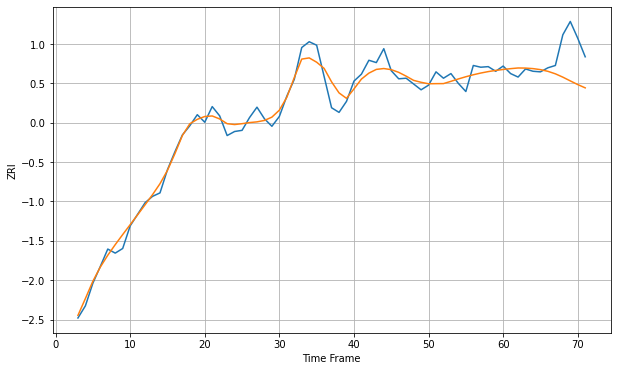

Wall time: 8.85 s
90015 15.269281299888393 46.36041014793426 [2517.10585854 2518.5033264  2519.67878547 2519.48844243 2518.60165648
 2516.82676125 2513.91303838 2509.58546372 2503.85987908 2497.36634842
 2491.03260063 2485.35499723]

Got an mse at 0.0099 in round 45 and stopped training



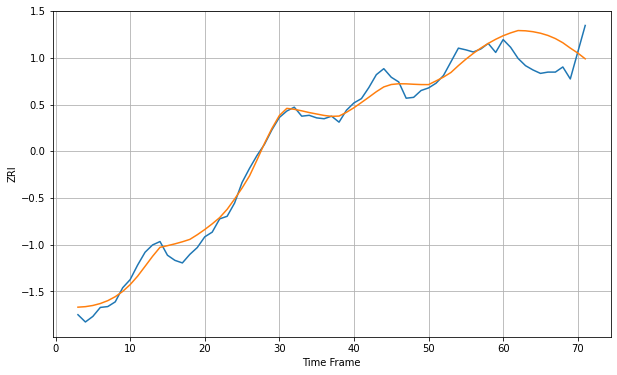

Wall time: 6.69 s
90016 20.886866259397536 68.85258117375835 [2367.99881499 2374.63171106 2380.1158655  2379.5199641  2377.40814381
 2373.90714394 2368.68644361 2361.36582123 2351.61592751 2339.15451964
 2327.59747079 2314.02891512]

Got an mse at 0.0098 in round 56 and stopped training



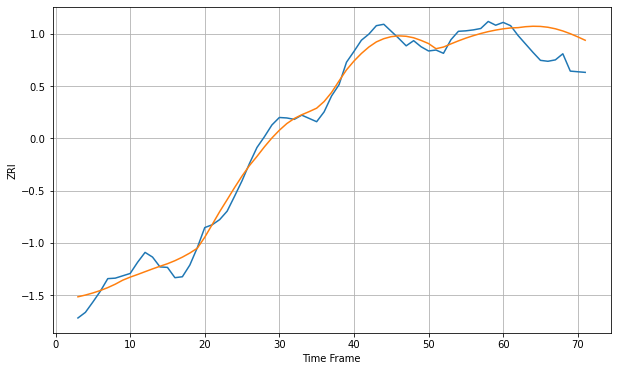

Wall time: 6.58 s
90018 20.693177041136714 56.92981734281608 [2240.28943416 2242.12166157 2242.81774125 2244.83486693 2245.76956572
 2245.42310304 2243.64220646 2240.3805484  2235.72470671 2229.88495266
 2223.15777468 2215.87078316]

Got an mse at 0.0095 in round 36 and stopped training



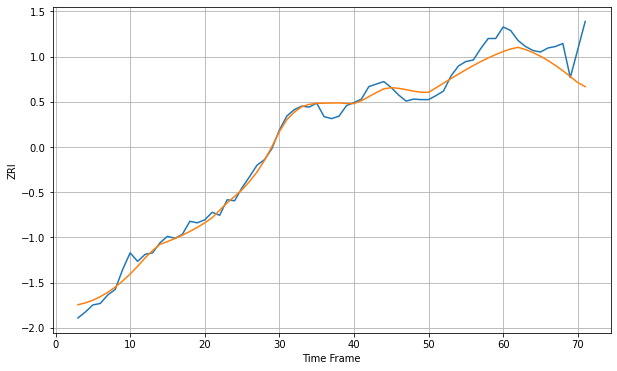

Wall time: 6.59 s
90019 15.853769707982478 50.32282926781671 [2280.04111061 2284.99324281 2288.32748887 2283.91004236 2277.86229036
 2270.59062124 2262.03871173 2252.28637428 2241.52883194 2230.01776936
 2217.99484163 2209.85751873]

Got an mse at 0.0100 in round 151 and stopped training



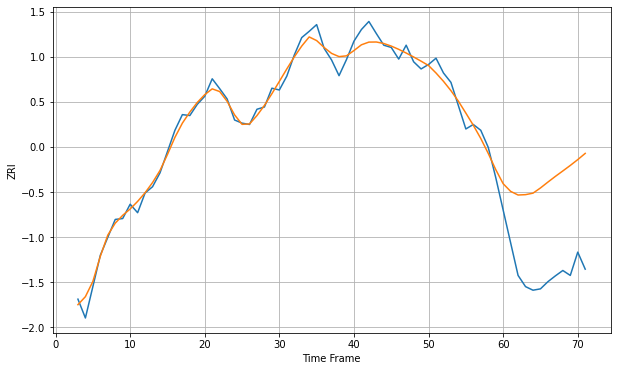

Wall time: 8.76 s
90022 18.34204294684578 205.47877767387246 [2219.79605251 2202.70680482 2194.53021057 2195.33455127 2198.64606922
 2210.27075886 2223.3864949  2236.1098124  2248.25603671 2260.57806795
 2273.57098278 2287.4598138 ]


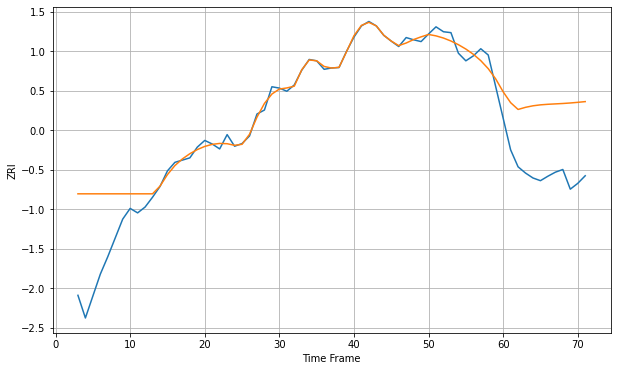

Wall time: 15.4 s
90023 66.95225121160176 151.6300611520726 [2224.72963491 2200.47628084 2185.25920196 2190.03390878 2193.4217131
 2195.55167687 2196.81140899 2197.69104092 2198.5923015  2199.73322474
 2201.15813704 2202.79980173]

Got an mse at 0.0100 in round 33 and stopped training



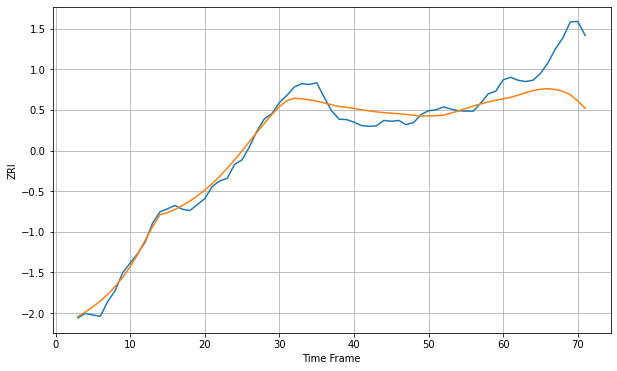

Wall time: 6.64 s
90024 19.503503798741228 104.72907586714395 [2913.91483694 2917.69105568 2922.79101174 2928.38151819 2933.42343539
 2936.91990943 2938.04217775 2936.35174225 2931.82222877 2923.75201874
 2909.01980917 2891.86925806]

Got an mse at 0.0100 in round 35 and stopped training



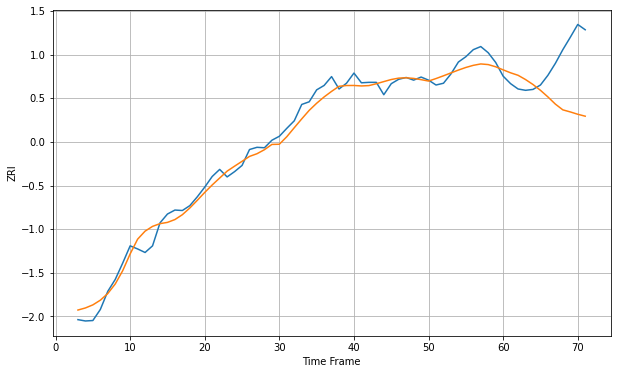

Wall time: 6 s
90025 20.32673612118047 108.08100253531568 [3016.29302398 3009.57324136 3003.97976109 2994.3550493  2983.11605597
 2969.99570194 2955.01442249 2938.76509258 2925.75977576 2921.08112852
 2915.79761367 2911.40792429]

Got an mse at 0.0099 in round 32 and stopped training



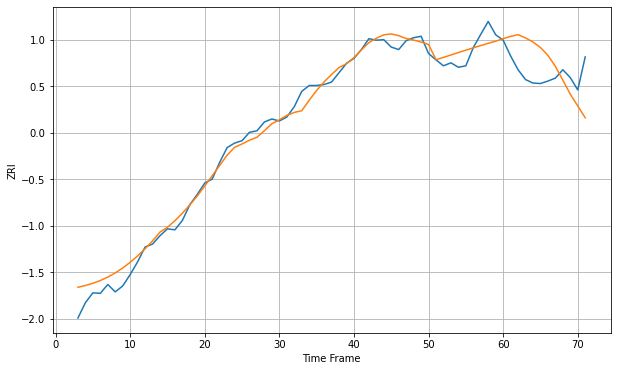

Wall time: 6.23 s
90026 19.795724107888123 62.7726005745036 [2476.03715159 2480.6717382  2484.27873329 2477.58079225 2469.25469334
 2458.11811228 2442.27741351 2419.9181706  2391.85250958 2363.2858342
 2339.47955563 2315.53703603]

Got an mse at 0.0099 in round 63 and stopped training



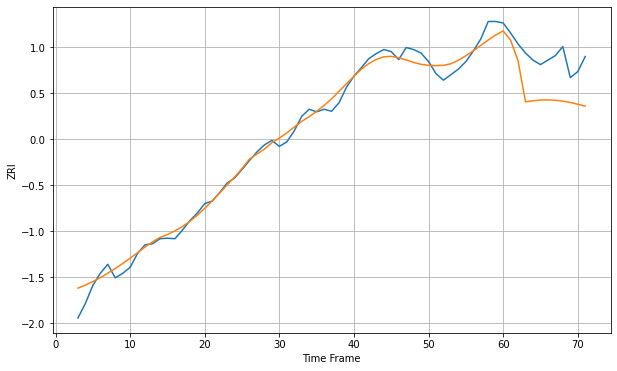

Wall time: 6.66 s
90027 16.706809531027414 73.67146024608097 [2344.17996874 2325.7781089  2284.31699306 2202.80838398 2204.84743792
 2206.24650262 2206.6553743  2205.94146638 2204.16077717 2201.47195877
 2198.07769971 2194.18794723]

Got an mse at 0.0092 in round 22 and stopped training



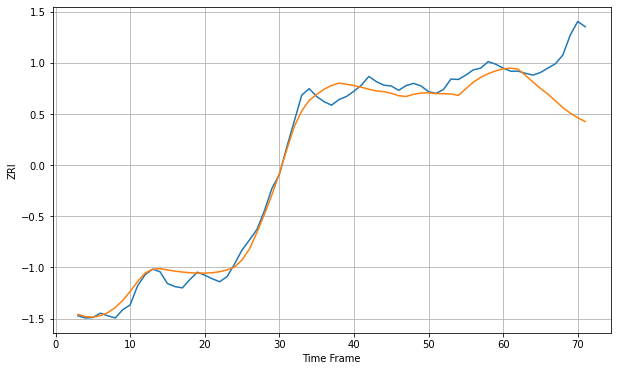

Wall time: 5.63 s
90028 20.99976247843856 113.71063866031483 [2420.34536232 2421.97319057 2419.85583213 2405.19399918 2390.04048545
 2375.48149946 2362.29965827 2347.12192845 2331.5467984  2318.74268626
 2308.20150245 2299.48583373]

Got an mse at 0.0098 in round 47 and stopped training



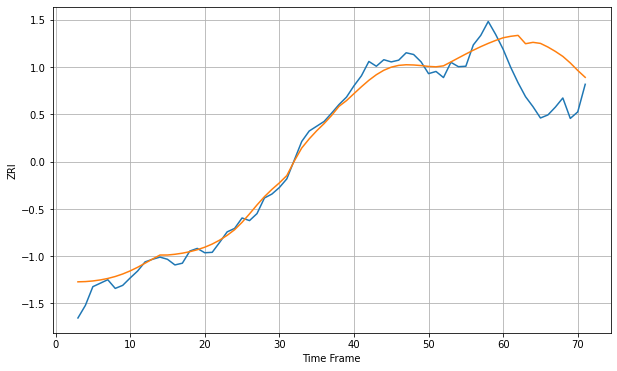

Wall time: 6.54 s
90029 21.76684375348829 115.22767982480329 [2457.50079724 2460.82197359 2463.0034611  2443.81789041 2446.96123998
 2444.56057588 2436.17168381 2426.12465926 2414.64999925 2399.57338069
 2382.28661024 2366.47217716]

Got an mse at 0.0099 in round 247 and stopped training



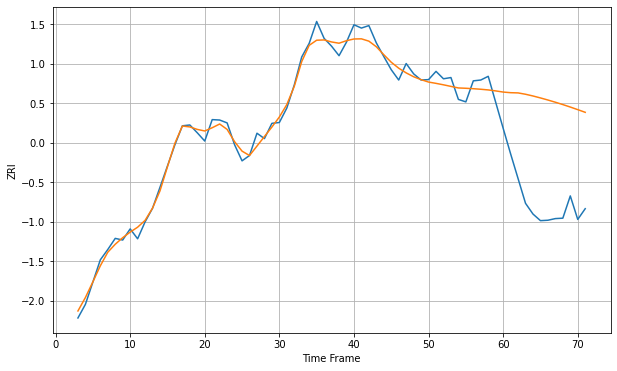

Wall time: 10.7 s
90031 18.682616448249387 245.92209518592637 [2449.84009614 2448.28673424 2447.75927735 2444.49185637 2440.30827843
 2435.58114359 2430.51250274 2425.15575387 2419.48680409 2413.48029694
 2407.17225792 2400.70203434]

Got an mse at 0.0095 in round 57 and stopped training



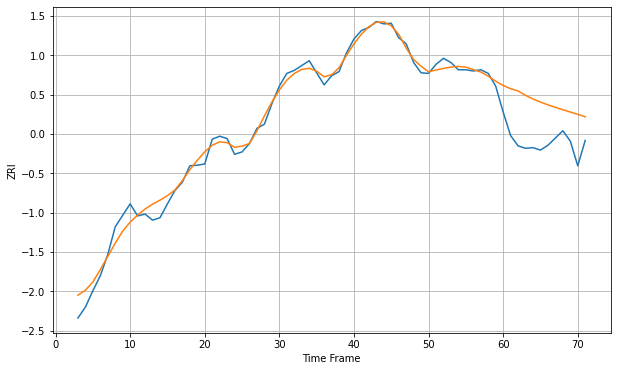

Wall time: 6.48 s
90032 12.869445458856623 68.39093288283559 [2059.99717119 2054.75423271 2050.83423138 2043.67017337 2037.68584361
 2032.5281516  2027.94546441 2023.75939597 2019.83096531 2016.0310979
 2012.2123258  2008.17883385]

Got an mse at 0.0099 in round 66 and stopped training



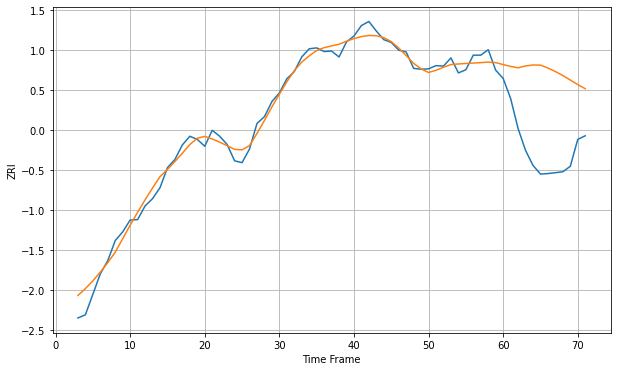

Wall time: 7.17 s
90033 18.262204616512022 176.19295417410328 [2292.37376229 2288.35655266 2285.18148263 2289.41262368 2291.41862346
 2291.15098055 2284.76452788 2277.13656237 2268.25517219 2258.41502662
 2248.42655341 2239.40871479]

Got an mse at 0.0099 in round 48 and stopped training



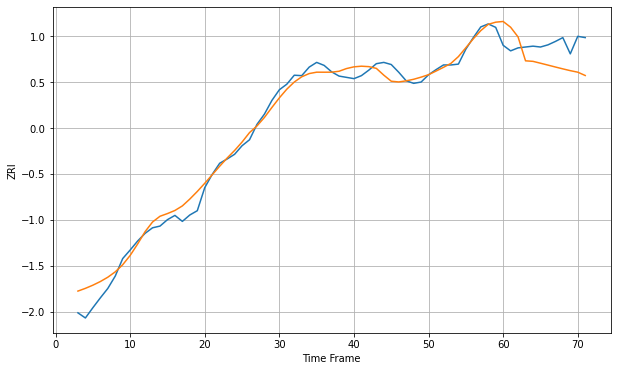

Wall time: 6.09 s
90034 21.800634959752262 56.395315249390485 [2673.78042474 2660.31657009 2637.55478494 2581.69441315 2580.44667795
 2576.11806285 2571.71072152 2567.21974444 2562.86242967 2558.69063131
 2555.11772969 2547.35744995]

Got an mse at 0.0097 in round 34 and stopped training



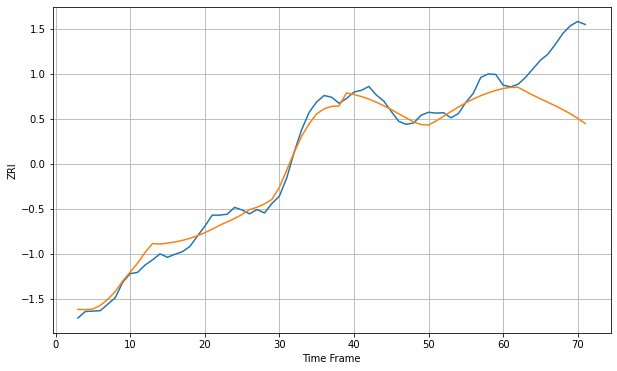

Wall time: 6.55 s
90035 20.682881008966053 136.18546614414257 [2923.28095104 2925.83116815 2926.10662226 2916.6116578  2907.68625934
 2899.30014494 2891.19058689 2882.9604423  2874.19794419 2864.62149866
 2853.8414914  2841.98411022]

Got an mse at 0.0100 in round 64 and stopped training



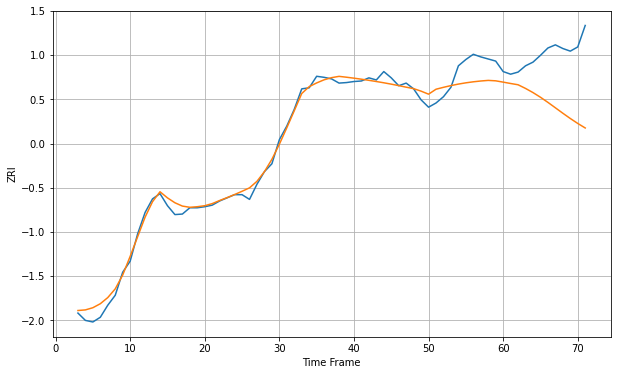

Wall time: 6.99 s
90036 18.035063081322114 103.91216103052844 [2540.85439776 2538.23629117 2535.80480393 2528.79819057 2520.88833212
 2511.98433382 2502.18754364 2491.85741582 2481.46356015 2471.41591514
 2461.97204454 2453.32264823]

Got an mse at 0.0100 in round 186 and stopped training



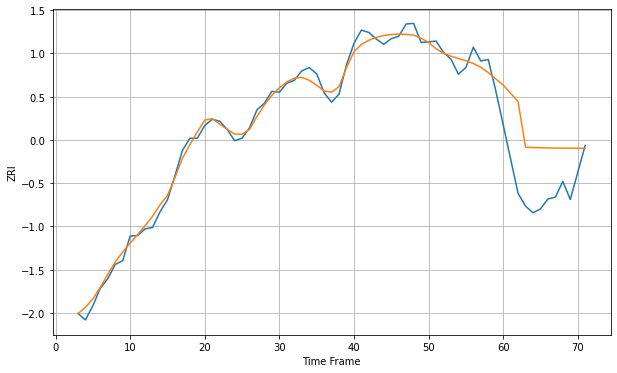

Wall time: 9.33 s
90037 15.455972338742868 114.0510055901099 [2314.17620769 2296.96235483 2279.50233106 2182.97482302 2182.54129998
 2182.05674985 2181.63824944 2181.34829456 2181.17986498 2181.08471111
 2181.01593208 2180.95314646]

Got an mse at 0.0099 in round 132 and stopped training



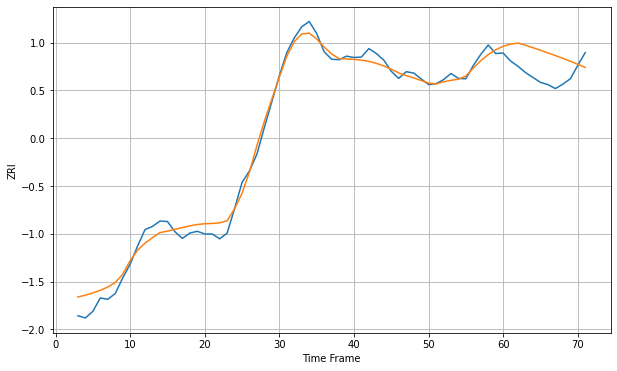

Wall time: 8.36 s
90038 19.081967561606135 53.66680187916415 [2452.16846036 2457.04675928 2459.43021277 2454.44457829 2448.99520732
 2443.19032774 2437.37497862 2431.32296651 2425.00609852 2418.43882733
 2411.63636266 2404.61834527]

Got an mse at 0.0100 in round 256 and stopped training



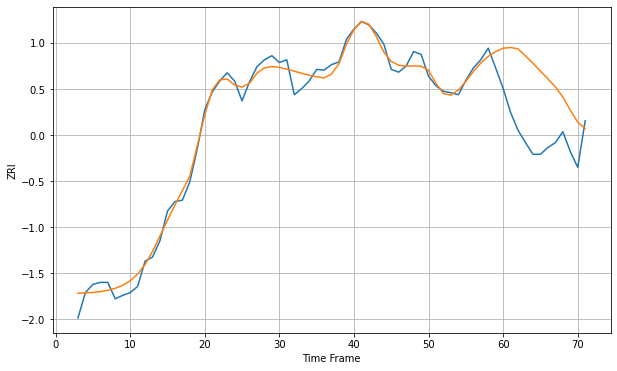

Wall time: 10.6 s
90039 12.618313976817607 92.4280239443118 [2508.01763386 2508.9716313  2507.02582544 2496.710253   2485.79819078
 2474.56795015 2463.1312463  2451.4707621  2436.5882348  2417.55018678
 2400.00419848 2390.59729194]

Got an mse at 0.0100 in round 93 and stopped training



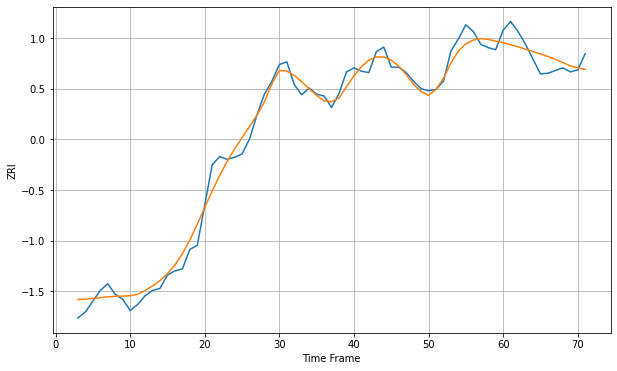

Wall time: 7.62 s
90041 14.784627422089292 19.841886787203038 [2183.45141601 2180.32775    2177.30175987 2173.69796178 2170.24262242
 2166.75057363 2162.95286149 2158.72207158 2154.01750468 2148.86950768
 2146.23097129 2143.70822008]

Got an mse at 0.0099 in round 70 and stopped training



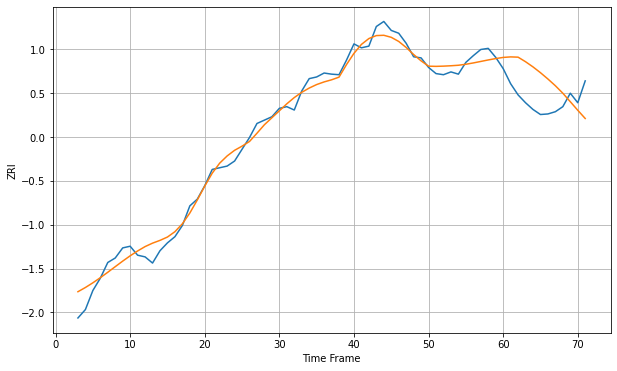

Wall time: 6.77 s
90042 15.71123848003545 54.326530656032034 [2188.83914431 2189.78496626 2189.31139897 2181.19102889 2171.94209948
 2161.61357092 2150.34667617 2138.30786106 2124.96057738 2109.85649904
 2094.5990199  2079.8972222 ]

Got an mse at 0.0098 in round 23 and stopped training



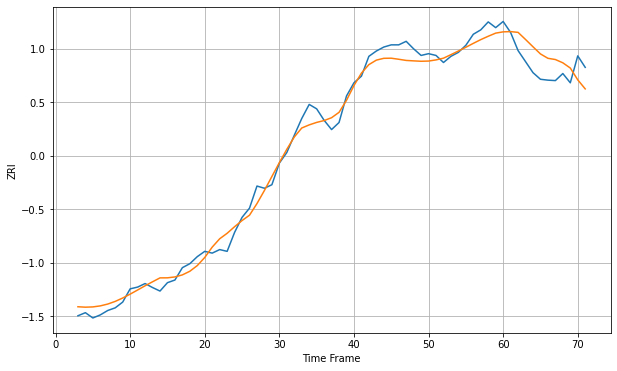

Wall time: 6.09 s
90043 20.32270354967055 44.055875297092946 [2264.4373598  2265.0132115  2263.30380588 2247.1664265  2230.62658717
 2214.43264634 2204.53087788 2201.73083307 2194.30107627 2182.47760866
 2155.70435403 2135.18729285]

Got an mse at 0.0099 in round 61 and stopped training



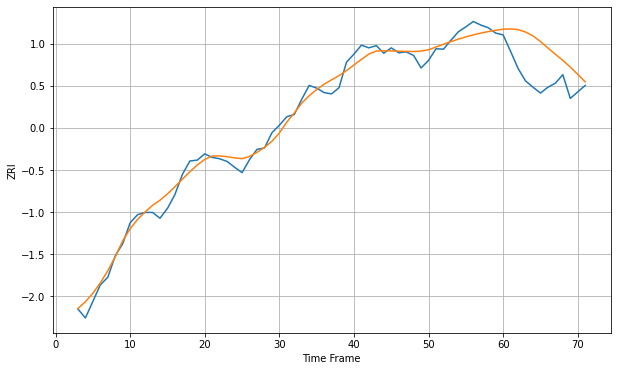

Wall time: 6.5 s
90044 17.909996022656152 75.3005278598705 [2225.61017094 2226.31706661 2224.88042804 2219.46333765 2210.71362959
 2198.18142403 2183.6778237  2169.66555576 2156.05351474 2141.00115167
 2124.67197504 2107.98338809]

Got an mse at 0.0098 in round 30 and stopped training



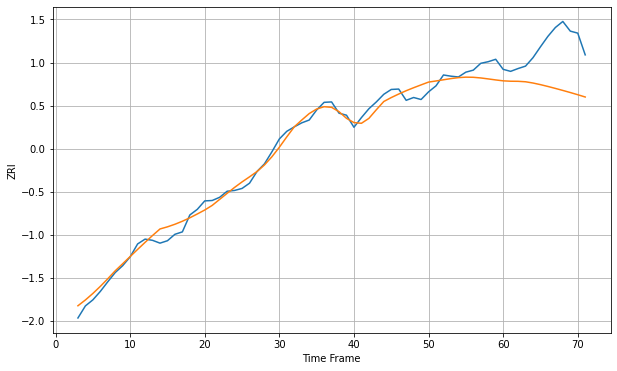

Wall time: 6.08 s
90045 18.98372417651557 108.88763846041205 [2565.4205791  2564.45492222 2564.25412221 2563.11087215 2559.99418315
 2555.98062649 2551.45197659 2546.60887356 2541.56424516 2536.34894977
 2530.93057665 2525.23771596]

Got an mse at 0.0094 in round 51 and stopped training



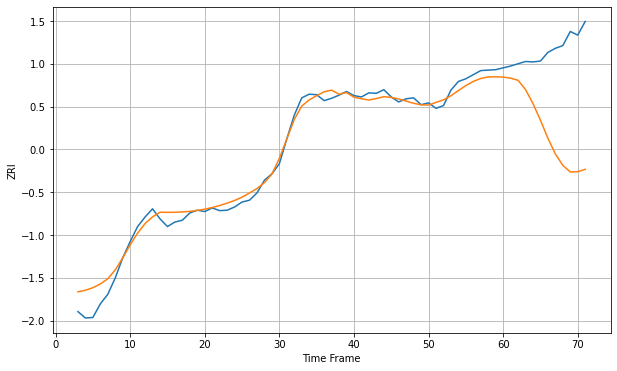

Wall time: 6.32 s
90046 19.45914549747377 200.40369478607698 [2479.71306091 2477.35518319 2472.61946342 2452.23392907 2421.4543102
 2384.81476168 2345.16923447 2310.68113972 2285.57539795 2271.06428263
 2271.63638189 2276.93143566]

Got an mse at 0.0100 in round 39 and stopped training



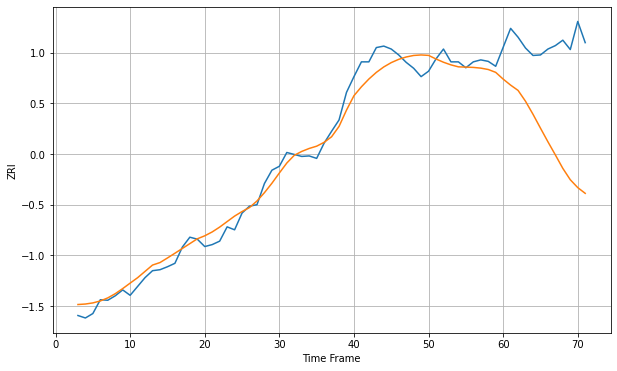

Wall time: 6.38 s
90047 21.850984541970398 205.5189875508487 [2056.99904995 2044.75918764 2034.00921049 2011.9140293  1985.6147085
 1957.45404164 1929.75336806 1903.01870161 1875.69497332 1852.65671119
 1836.66875229 1825.03994855]

Got an mse at 0.0100 in round 80 and stopped training



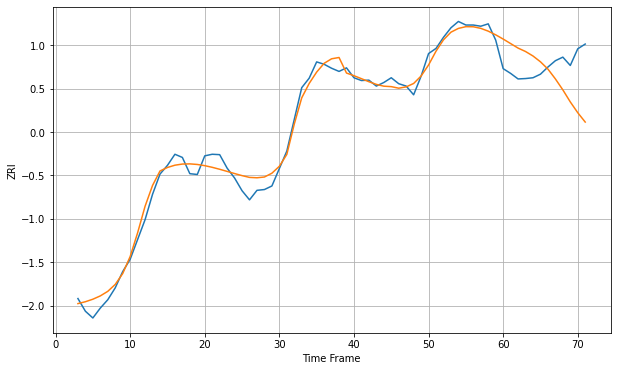

Wall time: 6.96 s
90048 21.780705110350727 94.87845352704971 [2902.6313323  2891.24313575 2879.85194884 2871.21260134 2859.90110057
 2845.26742362 2826.90600282 2802.11490161 2774.4969072  2744.06001969
 2716.81184691 2693.24307767]

Got an mse at 0.0099 in round 31 and stopped training



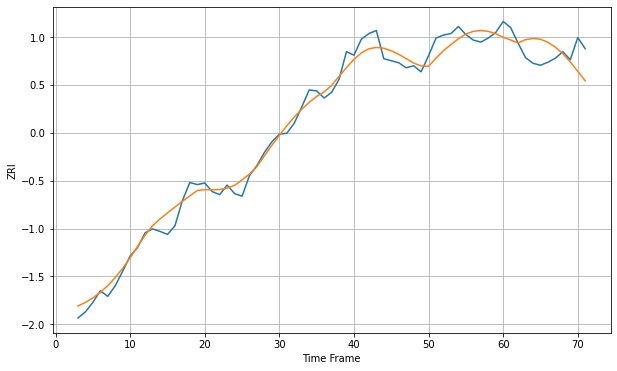

Wall time: 6.06 s
90061 18.84613138288 39.40858293312751 [2214.69430933 2209.22959566 2203.54032524 2209.85954591 2212.39180879
 2210.66051872 2204.6762165  2194.9338908  2182.18955343 2165.40634635
 2147.10171307 2128.10978885]

Got an mse at 0.0098 in round 44 and stopped training



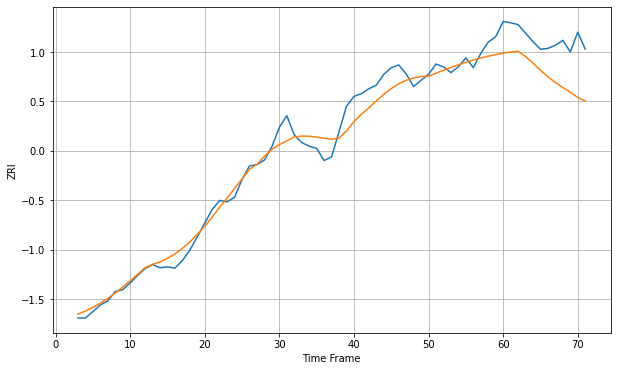

Wall time: 5.88 s
90062 25.21710711455288 83.94927078182887 [2056.23006041 2058.78143711 2060.53551525 2048.92456811 2034.12603589
 2018.23781318 2003.72302481 1991.07325703 1979.7733798  1969.32748765
 1957.64188819 1949.49215826]

Got an mse at 0.0099 in round 73 and stopped training



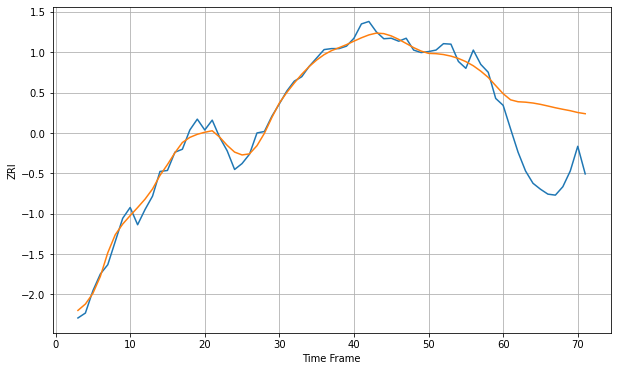

Wall time: 7.18 s
90063 15.37144544999715 133.03760836529423 [2294.53806167 2282.14764563 2278.264648   2277.42014058 2275.68402377
 2272.99172228 2269.60876516 2266.08173992 2262.9912787  2260.10446977
 2256.4599883  2254.02759467]

Got an mse at 0.0100 in round 273 and stopped training



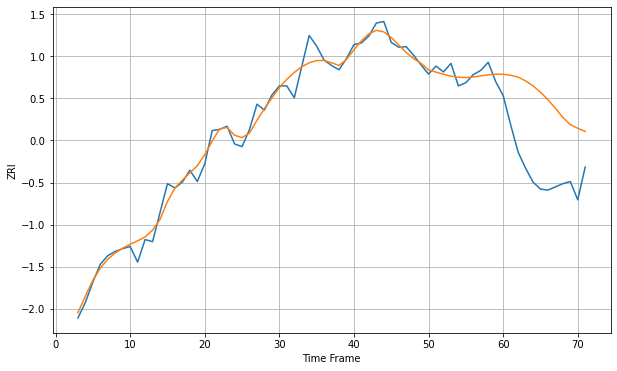

Wall time: 11.3 s
90065 16.489899482879533 135.02232579033821 [2423.59533279 2421.83180827 2418.4119888  2411.42108599 2402.1213631
 2390.37460443 2376.32439868 2360.41232303 2343.38452485 2329.91607124
 2323.18875077 2317.21803184]

Got an mse at 0.0098 in round 44 and stopped training



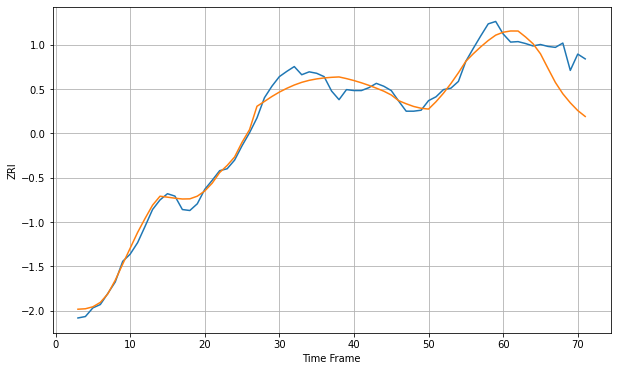

Wall time: 6.08 s
90066 17.475419885114494 66.46650985155775 [2710.52942202 2713.14886546 2713.07294785 2700.7179493  2686.67306152
 2665.68780043 2635.53055985 2605.92302479 2582.2897413  2563.46577034
 2547.32488448 2534.98182388]

Got an mse at 0.0100 in round 100 and stopped training



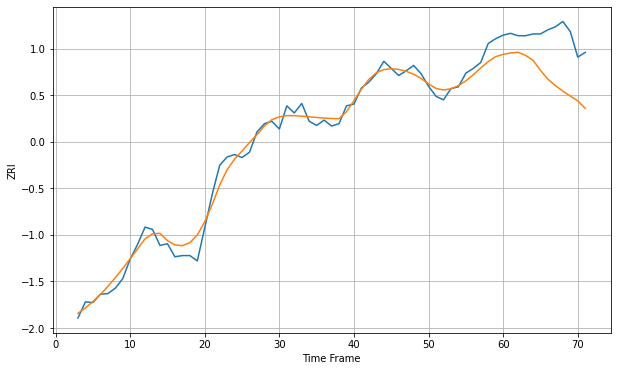

Wall time: 7.6 s
90068 14.788180264533713 74.28192124540462 [2393.63685058 2395.96322889 2397.16507828 2391.998658   2383.77308921
 2366.65755083 2351.87219969 2341.00047494 2331.86987448 2323.4863771
 2315.39217545 2302.82922209]

Got an mse at 0.0098 in round 60 and stopped training



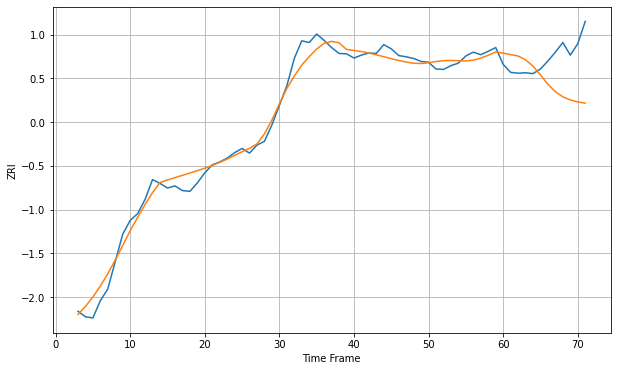

Wall time: 6.42 s
90069 21.489165205929087 92.39209451147002 [2736.70408427 2733.22681401 2729.90717191 2720.91704951 2705.87394819
 2684.8418197  2662.53776349 2645.00803041 2632.86975471 2625.31113555
 2620.72541832 2617.82832124]

Got an mse at 0.0100 in round 115 and stopped training



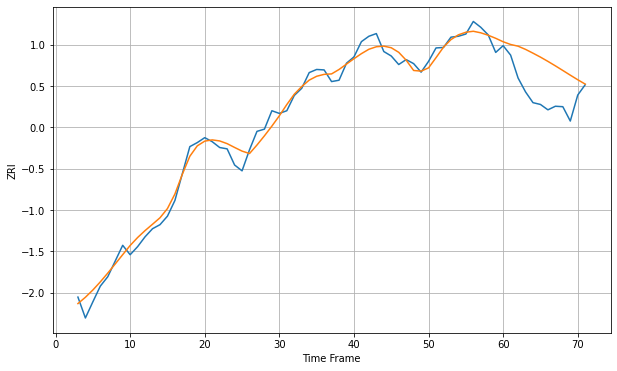

Wall time: 8.23 s
90220 18.87506547248135 79.51650704983454 [2195.76804411 2189.69400968 2185.90475345 2178.75938095 2170.31883237
 2161.52536288 2152.02083918 2142.05667666 2131.7384187  2121.29395054
 2111.06273738 2101.34957207]

Got an mse at 0.0100 in round 170 and stopped training



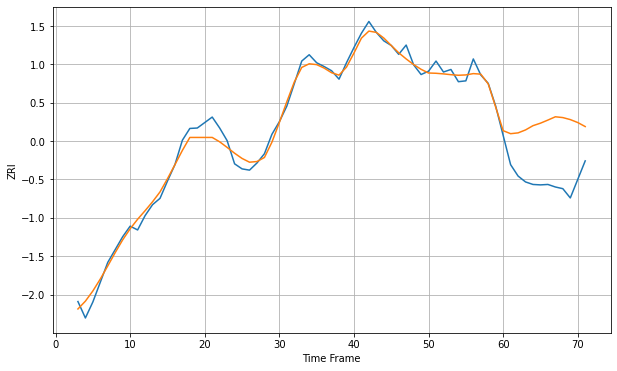

Wall time: 9.02 s
90221 17.93837675835799 132.71224972832172 [2160.73740382 2153.54866947 2155.47119877 2162.47177012 2172.58245747
 2178.48173032 2185.90135474 2193.69045842 2191.79099766 2187.02508148
 2180.01929378 2170.47729521]

Got an mse at 0.0100 in round 25 and stopped training



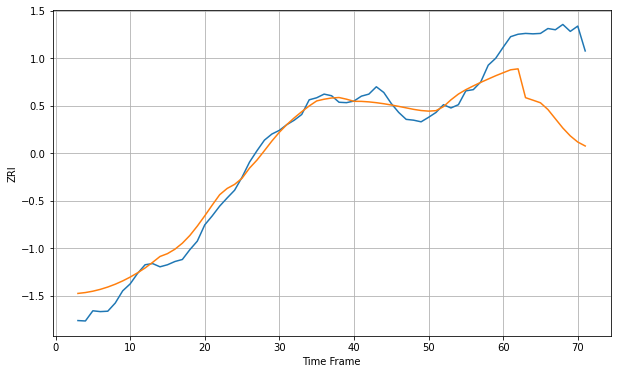

Wall time: 6.01 s
90232 27.36589566755662 193.95611535126008 [2735.45277134 2742.66926521 2745.05042514 2674.25770917 2668.08524399
 2661.70935415 2645.22927297 2622.41891244 2599.73206063 2580.39439188
 2565.35579203 2555.64784644]

Got an mse at 0.0100 in round 74 and stopped training



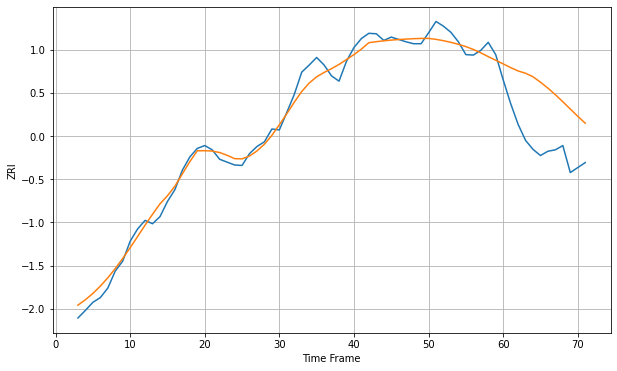

Wall time: 6.74 s
90247 18.303624115696117 116.74673729066214 [2334.47721913 2326.62503848 2319.55865184 2314.68565005 2307.21967378
 2295.85069844 2283.2358507  2269.38782962 2254.5265202  2239.12036341
 2223.81603096 2209.29913813]

Got an mse at 0.0100 in round 73 and stopped training



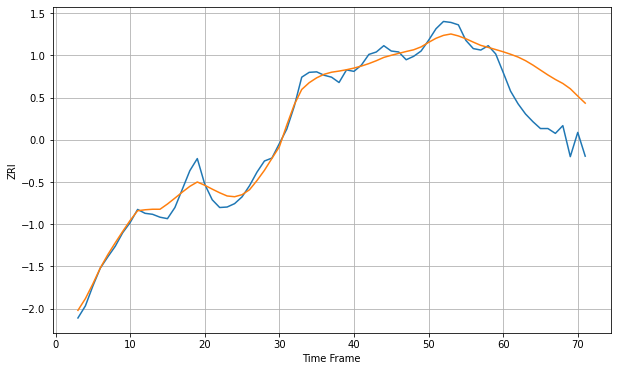

Wall time: 6.77 s
90250 16.39543432807605 102.76358307972625 [2317.4528353  2312.29683264 2306.54175453 2299.06818597 2289.88634573
 2279.70418485 2269.59178798 2260.28403567 2252.03969955 2241.14395046
 2226.02992263 2211.42192925]

Got an mse at 0.0099 in round 51 and stopped training



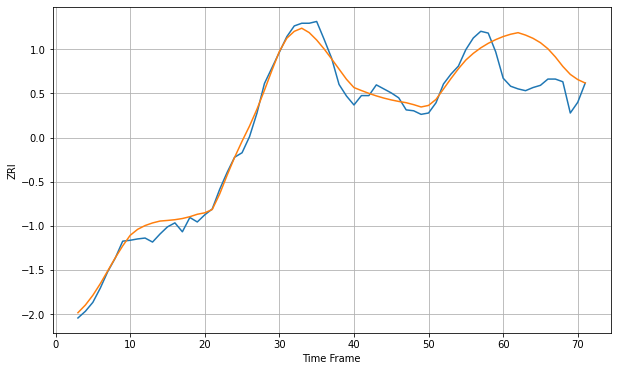

Wall time: 6.56 s
90254 19.748887720435725 88.1129691049912 [2782.18350269 2787.38609019 2790.9177926  2785.50392941 2778.28702025
 2768.44264101 2754.88213523 2736.55061921 2715.33172847 2697.4802007
 2685.87289405 2678.14508255]

Got an mse at 0.0099 in round 208 and stopped training



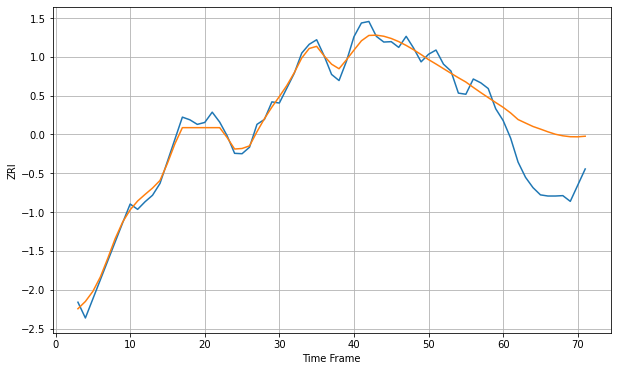

Wall time: 9.95 s
90255 20.46021983273123 137.05182087345793 [2293.70786363 2278.98825114 2261.66316123 2252.47868225 2243.44390953
 2236.60750669 2229.46956221 2223.12399206 2218.98064911 2216.58942479
 2216.33594399 2217.89448266]

Got an mse at 0.0099 in round 217 and stopped training



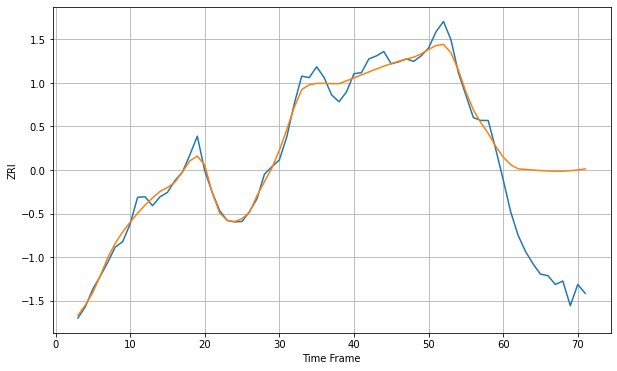

Wall time: 9.83 s
90260 17.331591303127862 199.66508714401024 [2446.66108777 2431.43183493 2422.84995092 2421.6155968  2420.37711365
 2419.28693816 2418.48175394 2418.05134375 2418.02502539 2419.00335822
 2420.5053319  2422.67259045]

Got an mse at 0.0100 in round 170 and stopped training



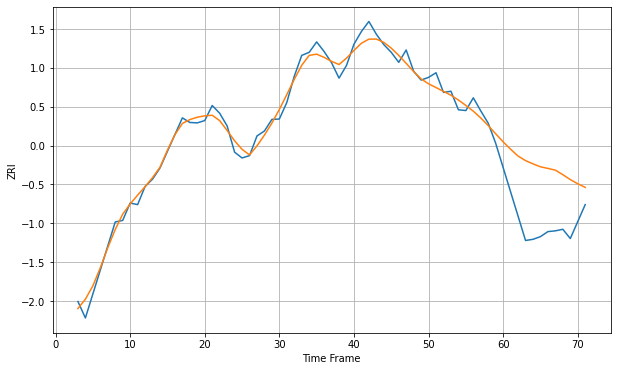

Wall time: 8.9 s
90262 20.158978885296463 147.67715181151863 [2235.79986242 2216.57564171 2198.97947238 2187.13651017 2178.6526464
 2171.06590777 2166.89277722 2162.35283851 2150.69412986 2137.92772122
 2127.11432396 2117.74434115]

Got an mse at 0.0099 in round 69 and stopped training



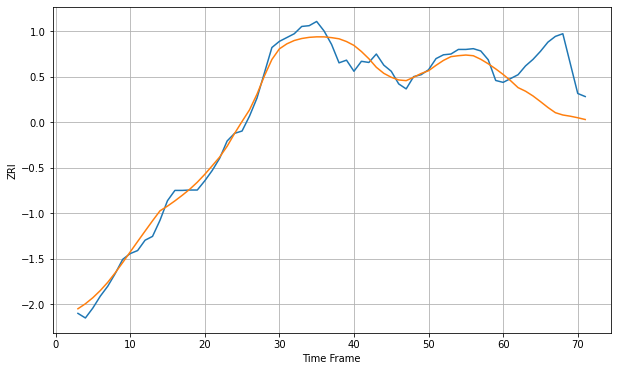

Wall time: 7.14 s
90266 23.790045114039994 119.87009790377145 [2891.66386183 2875.36770109 2857.29387166 2847.95520687 2835.5848186
 2820.8338118  2805.51564101 2791.90765748 2785.85459146 2782.69957045
 2778.6867964  2774.06335558]

Got an mse at 0.0099 in round 157 and stopped training



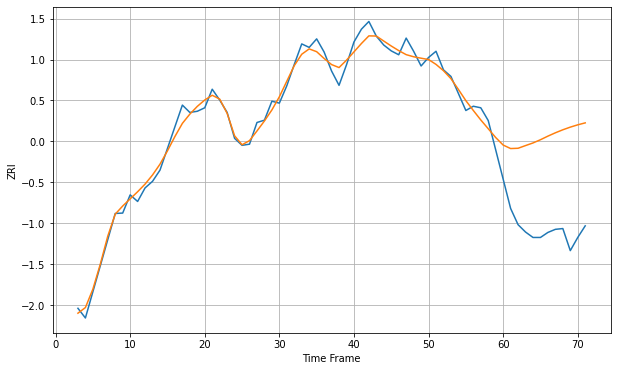

Wall time: 8.79 s
90270 20.244221382876493 239.84679952518982 [2235.73722734 2226.70233455 2227.42186838 2234.36625383 2241.15222851
 2249.46771863 2258.78721862 2267.39366775 2275.16394513 2282.02927948
 2287.97089474 2293.01844019]

Got an mse at 0.0100 in round 59 and stopped training



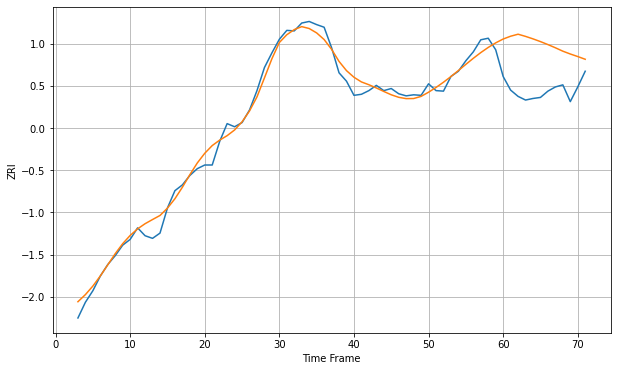

Wall time: 6.79 s
90277 15.586379153702605 90.65282451922572 [2713.46744186 2718.83041282 2722.66885281 2718.51789247 2713.79298255
 2708.56365067 2702.88176418 2696.78191438 2690.28850655 2684.90165254
 2680.05009357 2674.84158785]

Got an mse at 0.0100 in round 56 and stopped training



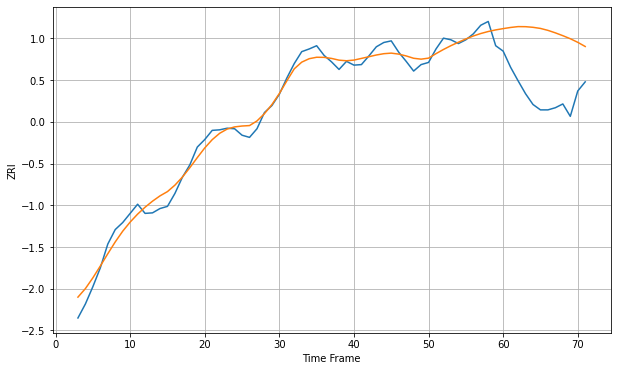

Wall time: 6.43 s
90278 15.899734933278404 117.7297558471544 [2539.71297205 2541.88152693 2543.46363298 2543.31445536 2542.15926384
 2540.08733453 2536.49288932 2531.85603947 2526.63690048 2520.97006693
 2514.30732995 2506.58398714]

Got an mse at 0.0099 in round 176 and stopped training



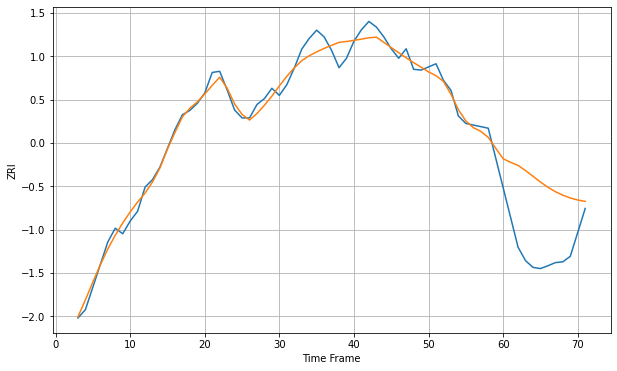

Wall time: 9.27 s
90280 21.823698860339597 170.61245965489044 [2281.6529078  2272.69538201 2264.90537156 2251.85833066 2237.33540039
 2222.8333829  2209.63929588 2198.45790571 2189.46487106 2182.52917197
 2177.4070944  2173.84727267]

Got an mse at 0.0098 in round 44 and stopped training



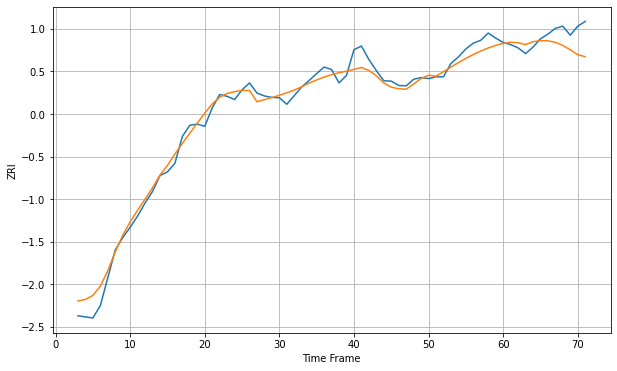

Wall time: 5.95 s
90291 24.445093485755834 43.92685902921076 [3182.204568   3185.71888151 3184.0907889  3179.14601938 3187.08041785
 3189.95370654 3189.55052769 3185.28162326 3176.73712774 3164.41406722
 3151.07522803 3145.70999044]

Got an mse at 0.0099 in round 37 and stopped training



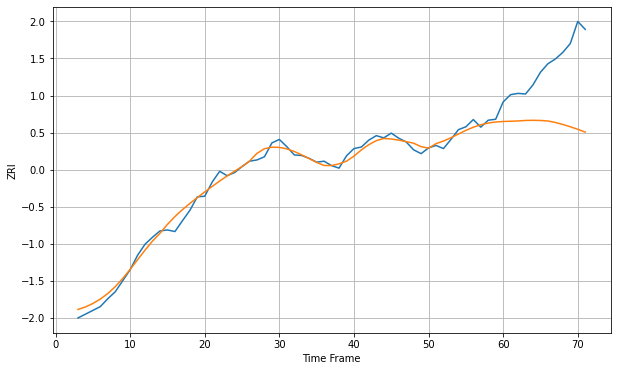

Wall time: 6.96 s
90292 16.868646894124804 199.93953499657854 [3129.90488134 3130.76422553 3131.56693824 3133.18234377 3133.67312645
 3133.09610264 3131.52768207 3126.7417501  3120.49061045 3113.25514224
 3105.18085745 3096.36804272]

Got an mse at 0.0099 in round 88 and stopped training



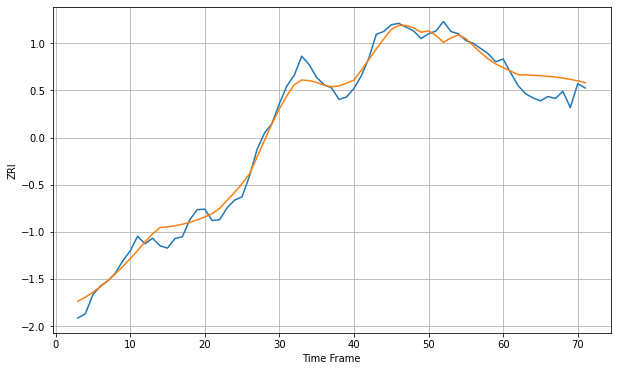

Wall time: 7.27 s
90301 20.05037962498133 36.26421978070046 [2158.86347365 2151.57462866 2144.03962571 2143.43714402 2142.74515732
 2141.84151081 2140.61561858 2138.97410929 2136.8469962  2134.19484897
 2131.00574681 2127.27644865]

Got an mse at 0.0099 in round 198 and stopped training



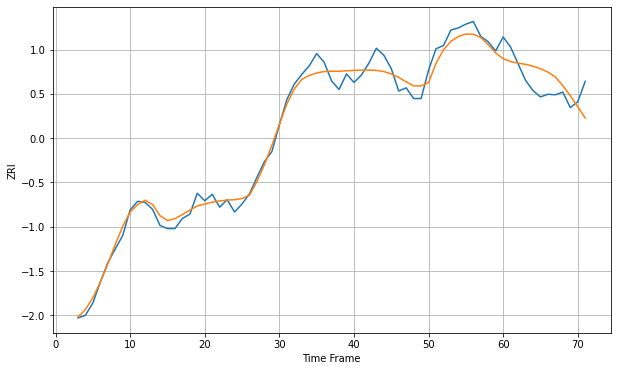

Wall time: 9.43 s
90302 16.57100229608508 36.88286515098747 [2284.36907489 2279.15741564 2276.10696481 2273.8955816  2270.4354086
 2265.63958489 2259.35972253 2250.28983536 2234.14638598 2215.30755868
 2194.70676887 2173.64714147]

Got an mse at 0.0099 in round 137 and stopped training



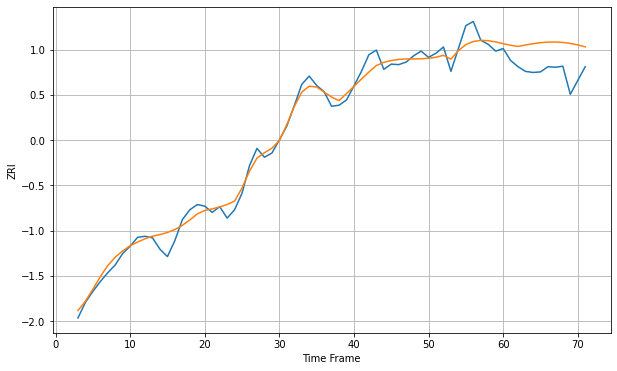

Wall time: 7.94 s
90303 16.18927599965576 52.94389343863163 [2061.35438011 2058.24277268 2055.98379937 2058.80441666 2061.25843743
 2063.152946   2064.30370985 2064.52689599 2063.68929929 2061.79077474
 2058.93378558 2055.21414827]

Got an mse at 0.0099 in round 124 and stopped training



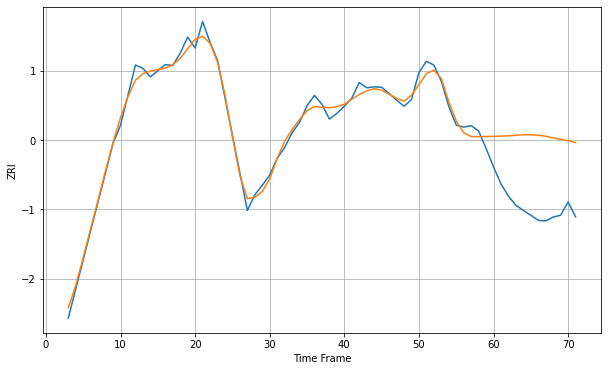

Wall time: 7.85 s
90304 13.89023607685926 148.88328329210236 [2519.48449514 2519.90553331 2520.63815165 2521.81219596 2522.64163832
 2522.75645652 2521.83741584 2519.65655974 2516.02847941 2513.2116601
 2510.74871091 2506.18847465]

Got an mse at 0.0100 in round 116 and stopped training



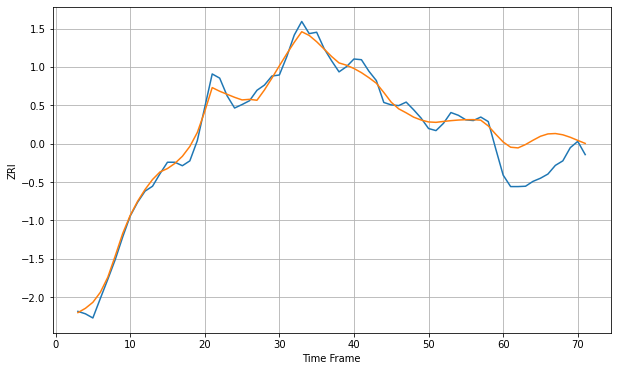

Wall time: 7.97 s
90404 20.618726436560955 94.21874434512631 [3129.31883106 3114.22744711 3112.31821239 3121.97231772 3134.25933864
 3145.69025047 3152.49529756 3153.59813091 3149.97917147 3142.82201924
 3133.8580997  3125.1658028 ]

Got an mse at 0.0099 in round 114 and stopped training



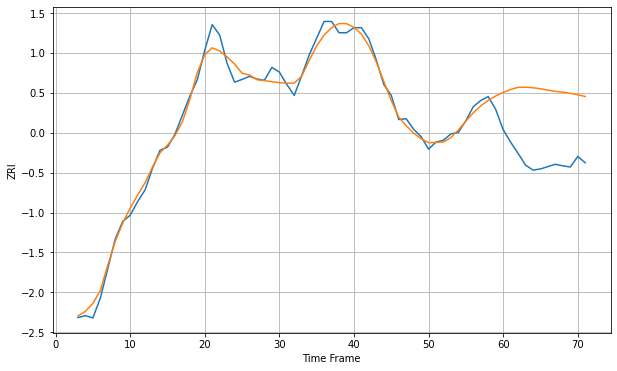

Wall time: 7.62 s
90405 19.501063204146682 178.68727483766864 [3081.69547543 3089.06128208 3094.80360243 3095.05547213 3093.67461486
 3091.12540344 3087.59393676 3084.30820121 3082.3903963  3079.32339696
 3075.61439181 3071.28540201]

Got an mse at 0.0098 in round 25 and stopped training



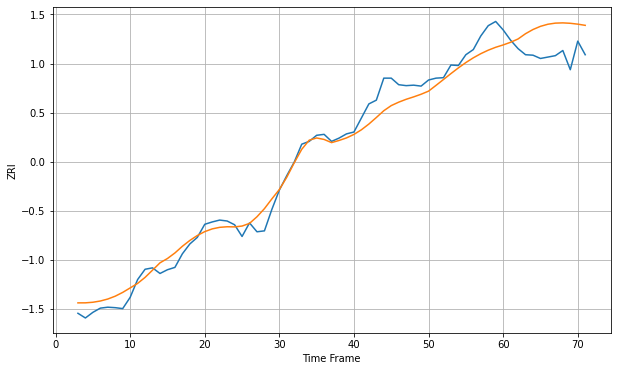

Wall time: 5.8 s
90501 25.59577125942299 57.36476245035715 [2118.87940276 2124.58686046 2131.65065446 2142.88571147 2151.8215768
 2158.58552955 2163.09634326 2165.4524985  2165.98135572 2165.1139202
 2163.24984474 2160.71569728]

Got an mse at 0.0099 in round 81 and stopped training



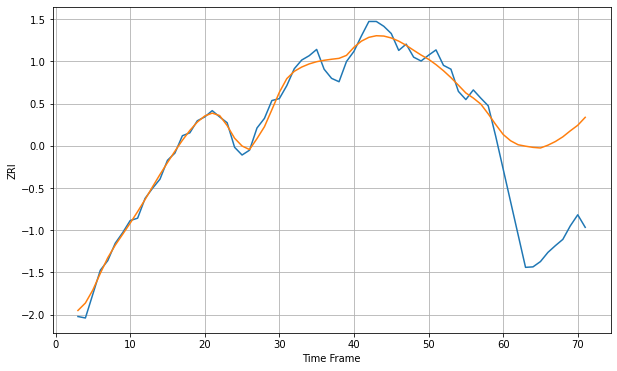

Wall time: 6.98 s
90640 16.83359350867224 204.6763552301285 [2216.66515415 2203.55431533 2195.32617625 2192.30888322 2189.85794436
 2188.59357319 2194.38238858 2201.97207717 2211.70159395 2224.15975275
 2235.68424524 2252.15587786]

Got an mse at 0.0100 in round 169 and stopped training



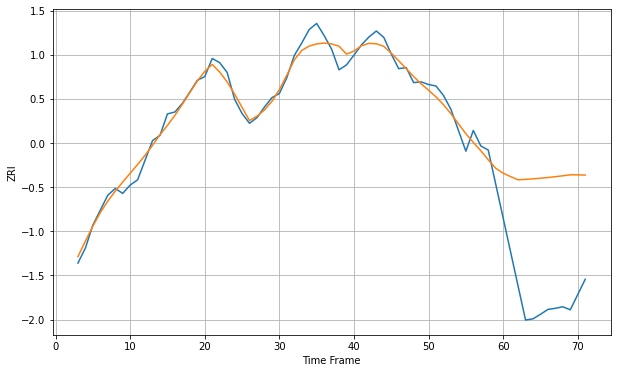

Wall time: 8.7 s
90723 22.881593736325005 317.9073997508721 [2359.5425843  2350.51840164 2342.05188457 2343.19804389 2344.59011736
 2346.24106709 2348.15158482 2350.30947767 2352.69093819 2355.26288814
 2355.19276421 2354.58968637]

Got an mse at 0.0096 in round 33 and stopped training



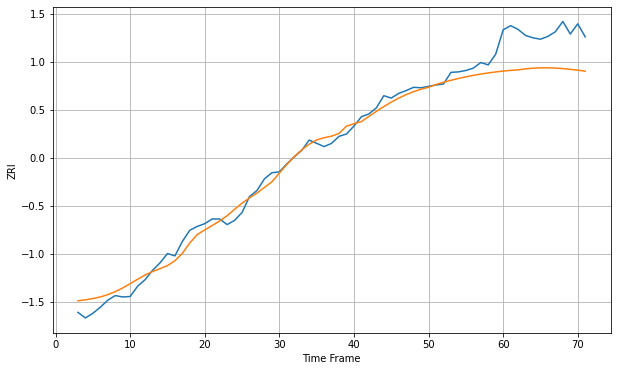

Wall time: 6.03 s
90731 16.64426820825485 81.29107875845575 [2023.79307971 2025.21509049 2026.31682379 2028.50517798 2029.96586111
 2030.68938963 2030.7262204  2030.15640376 2029.06843424 2027.5485694
 2025.67620125 2023.52178465]

Got an mse at 0.0098 in round 71 and stopped training



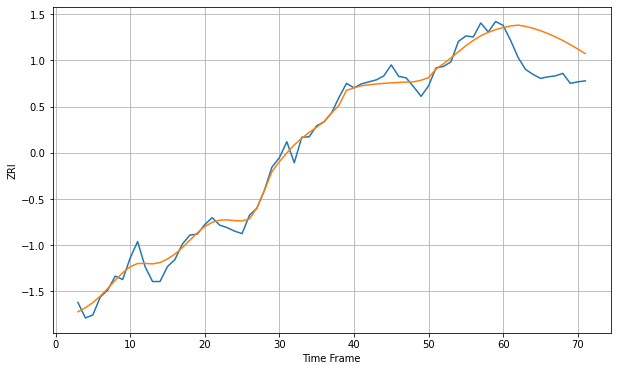

Wall time: 6.95 s
90744 16.9305669256249 71.55967077528496 [2218.78834679 2221.92251459 2223.71323854 2221.13717266 2217.37781593
 2212.54621466 2206.7727721  2200.19881944 2192.84172502 2184.65027266
 2175.81595388 2166.62623375]

Got an mse at 0.0095 in round 28 and stopped training



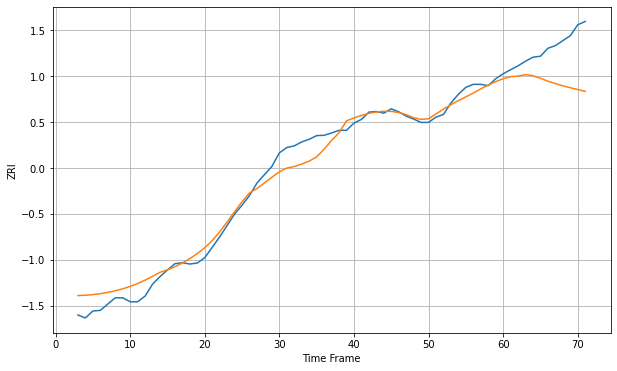

Wall time: 6.2 s
90802 32.25152441495571 115.52763906793233 [2003.10126912 2009.06781093 2010.97976544 2015.41689215 2012.07031538
 2004.25853134 1995.59281888 1988.2014996  1981.57909432 1975.72546407
 1970.25993016 1964.84342863]

Got an mse at 0.0100 in round 39 and stopped training



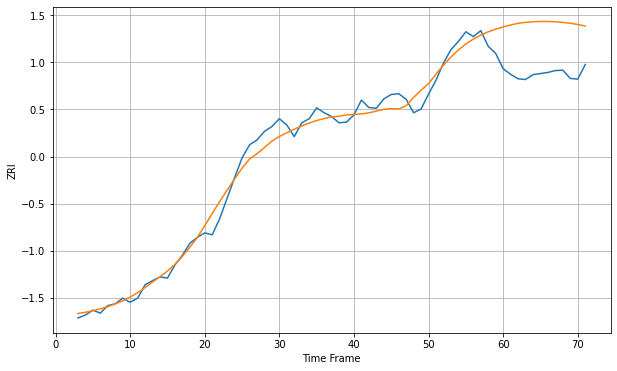

Wall time: 6.29 s
90803 26.137912222317723 135.7928458580517 [2212.9800013  2218.08663242 2222.59296356 2225.14806656 2226.79195487
 2227.5790593  2227.56016671 2226.7600967  2225.17864762 2222.78895193
 2219.53515925 2215.33304588]

Got an mse at 0.0093 in round 20 and stopped training



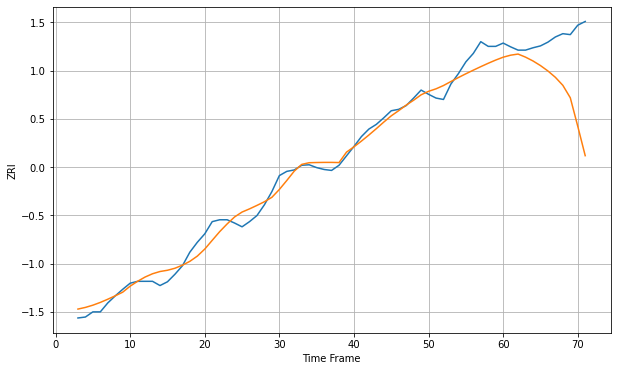

Wall time: 5.66 s
90804 19.479513269476687 120.10105714277321 [1926.94049194 1931.24141122 1933.63931973 1927.08553956 1918.94584624
 1909.14994583 1897.65063573 1884.12439809 1867.1164561  1840.63145681
 1780.06100881 1717.38664442]

Got an mse at 0.0096 in round 22 and stopped training



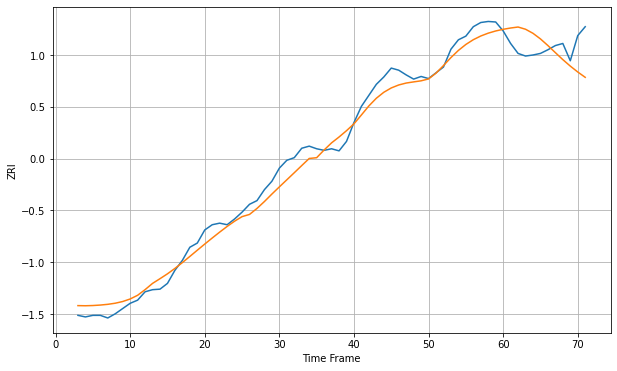

Wall time: 5.74 s
90805 19.797933650192633 44.70125955888851 [1971.02246292 1973.50697544 1975.38635961 1971.15785121 1963.37954011
 1952.69749092 1940.02252279 1926.49513043 1913.15698594 1900.7916703
 1889.55307389 1879.3657067 ]

Got an mse at 0.0099 in round 27 and stopped training



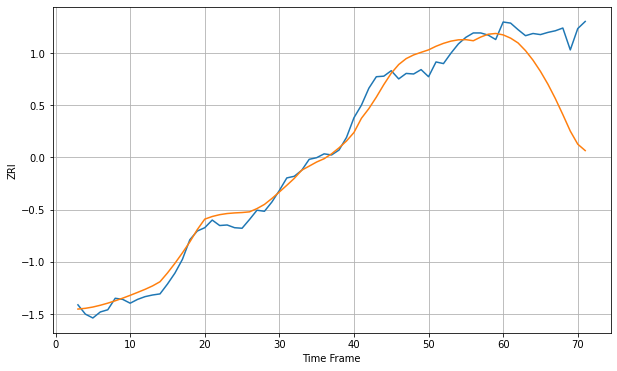

Wall time: 5.94 s
90806 18.860304293161985 122.9115785261583 [1918.49676033 1912.52134585 1903.72233745 1889.63748152 1872.23882556
 1851.76484009 1828.35328235 1801.93075903 1772.80496707 1742.62376981
 1718.6952421  1706.98895961]

Got an mse at 0.0090 in round 29 and stopped training



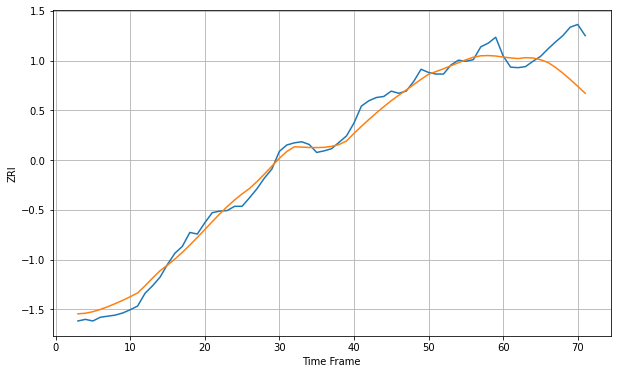

Wall time: 6.08 s
90807 15.970240292959536 60.23101978415388 [1901.79952256 1900.31174471 1899.00208218 1900.7216316  1900.03512082
 1896.98961405 1891.79800419 1882.6316174  1871.75856478 1859.75793595
 1846.99733958 1833.98770773]

Got an mse at 0.0094 in round 24 and stopped training



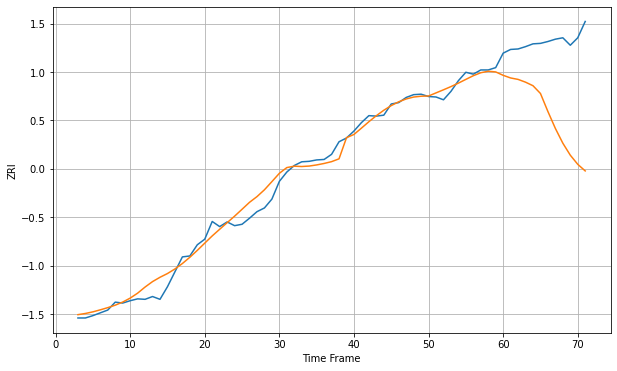

Wall time: 6.09 s
90813 17.403559820285626 177.49426639436535 [1807.50907617 1801.81537375 1798.73159293 1792.79337443 1785.1662848
 1768.55368781 1729.80548586 1693.55177749 1661.91556668 1636.18582148
 1616.58509201 1602.4223281 ]

Got an mse at 0.0098 in round 52 and stopped training



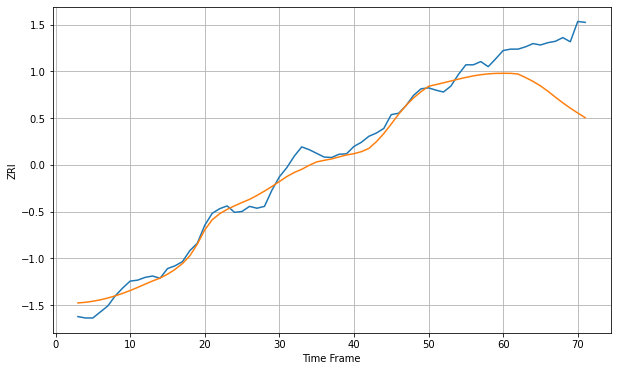

Wall time: 6.46 s
90814 19.288960701108973 120.99189729860832 [1921.63434283 1921.48945836 1919.97831068 1912.38153055 1904.11601617
 1894.37127399 1882.80857028 1869.85485771 1857.52570227 1846.08521117
 1835.4702255  1825.41866718]

Got an mse at 0.0100 in round 58 and stopped training



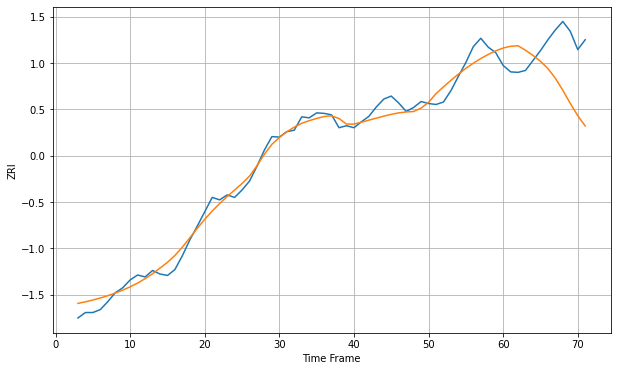

Wall time: 6.79 s
90815 17.140199644721104 96.17076386456253 [1942.30331531 1945.75505818 1946.8502367  1937.63811541 1927.3526323
 1915.43284104 1900.67348833 1881.0651529  1856.715111   1830.19526158
 1805.35957173 1784.57244015]

Got an mse at 0.0100 in round 105 and stopped training



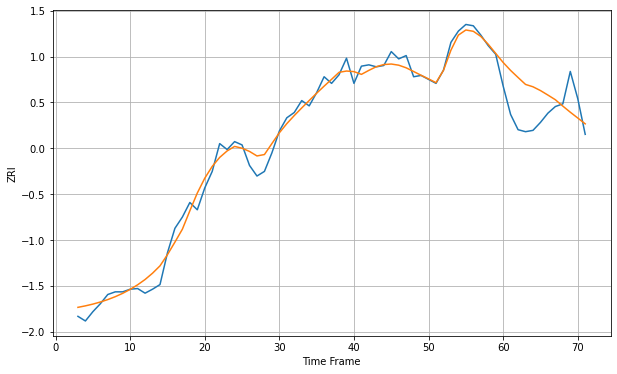

Wall time: 7.89 s
91016 13.26430283397909 49.52092168595769 [2275.56811598 2263.53444401 2252.85980201 2242.41088587 2238.84121974
 2233.12537489 2226.31542421 2219.25680752 2209.65403672 2200.41654411
 2191.67330751 2182.85336808]

Got an mse at 0.0099 in round 111 and stopped training



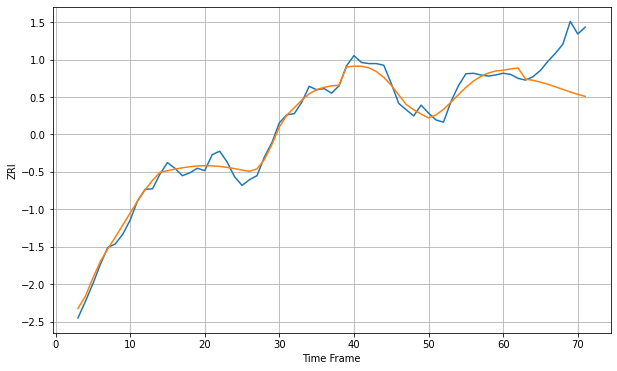

Wall time: 7.8 s
91101 12.17726119230791 66.88981038262837 [2157.32134896 2159.57917515 2161.2467005  2141.79991884 2139.5391109
 2136.42312309 2132.59303057 2128.2606455  2123.68080743 2119.12951745
 2114.90665867 2111.36411743]

Got an mse at 0.0100 in round 94 and stopped training



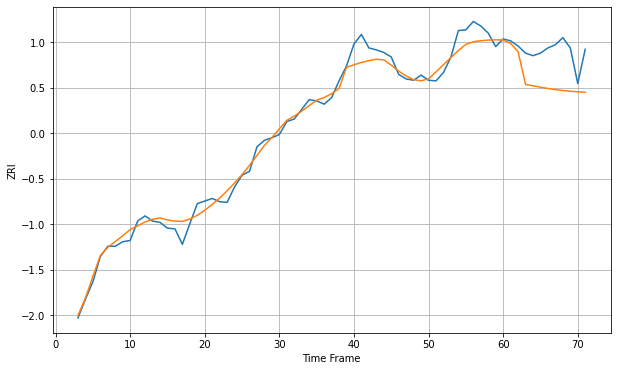

Wall time: 7.31 s
91104 14.272021127314025 51.59484729837129 [2062.42204305 2056.92001712 2044.17813025 1993.57325624 1991.35831251
 1989.23642312 1987.26726217 1985.53979924 1984.13141804 1983.04339199
 1982.15786861 1981.42599789]


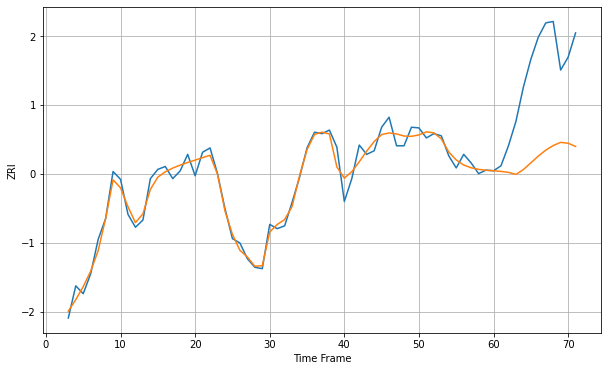

Wall time: 15.8 s
91105 11.704672879877316 122.75195655644963 [2644.09529062 2643.10750956 2641.84608347 2638.93168653 2645.6505414
 2655.11230123 2664.55209226 2672.86914817 2679.34710925 2683.77655731
 2682.58782714 2678.08608433]

Got an mse at 0.0100 in round 90 and stopped training



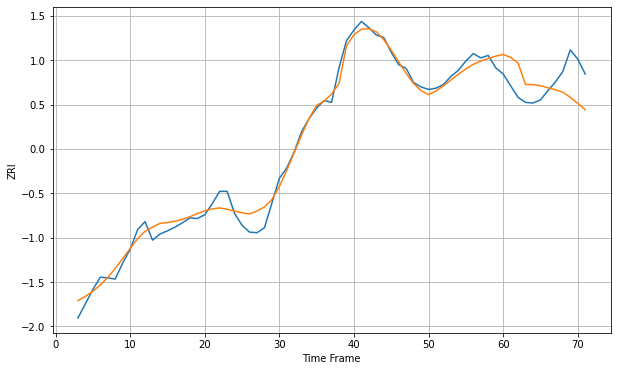

Wall time: 7.77 s
91106 13.869067931624691 44.859001525707534 [2228.61747084 2223.84393845 2214.82682678 2180.00825017 2179.6793468
 2178.08006008 2174.60389547 2171.3614814  2167.58709404 2159.19225125
 2149.39289551 2139.11558828]

Got an mse at 0.0099 in round 73 and stopped training



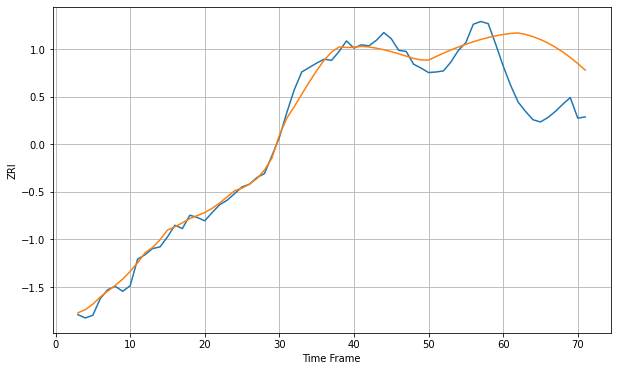

Wall time: 6.94 s
91107 15.984531628703548 113.0072417345183 [2227.5240036  2229.41517081 2230.33883473 2227.57262989 2223.62984315
 2218.50547605 2212.19810862 2204.70202629 2196.00957201 2186.13906243
 2175.20220738 2163.49371813]

Got an mse at 0.0100 in round 47 and stopped training



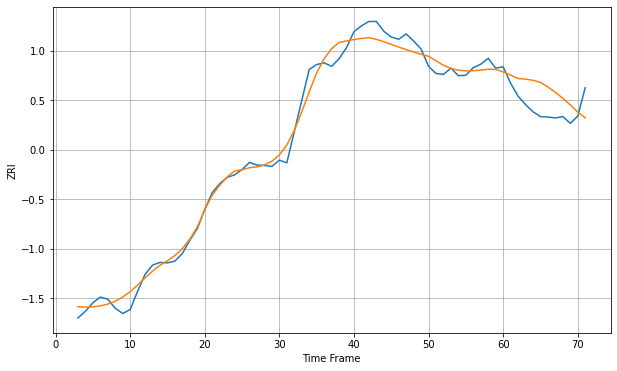

Wall time: 6.57 s
91205 20.65250526602354 51.77298678467092 [2343.47861901 2336.17677725 2328.54649778 2327.26602073 2324.63866628
 2319.99286269 2309.50516464 2297.53881602 2284.15725506 2269.31965132
 2253.20515826 2240.26896569]

Got an mse at 0.0100 in round 39 and stopped training



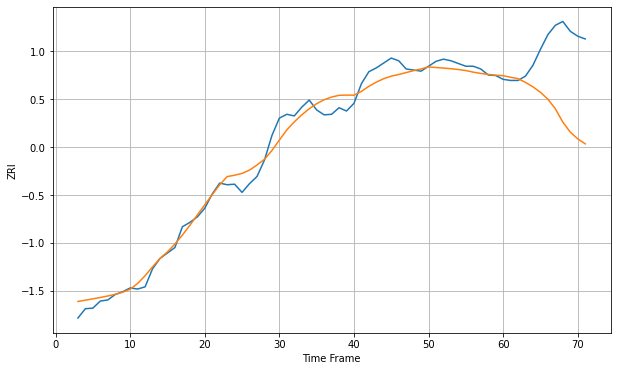

Wall time: 6.53 s
91355 17.59345669737167 124.4219275244563 [2230.70646251 2227.80812545 2225.26230902 2218.32181493 2210.24817531
 2200.24424117 2187.61942696 2169.99819054 2145.61304156 2127.33619975
 2115.06196663 2105.85970198]

Got an mse at 0.0100 in round 35 and stopped training



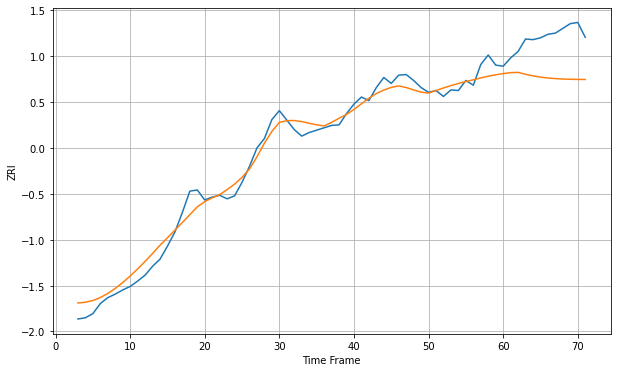

Wall time: 5.75 s
91367 16.305042564709197 68.05181558495921 [2261.6185617  2263.17744361 2263.6531843  2260.42468475 2257.7364215
 2255.67872227 2254.19093913 2253.15391127 2252.45363397 2251.99911944
 2251.7766709  2251.68094038]

Got an mse at 0.0098 in round 49 and stopped training



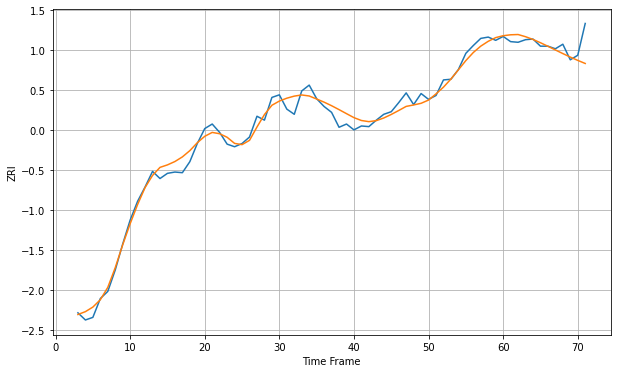

Wall time: 6.81 s
91505 11.627155447703151 19.146949679071003 [2336.11684741 2337.53787292 2337.96078221 2334.60690037 2330.34136435
 2325.32275896 2319.84300474 2314.1909113  2308.59312384 2303.19854309
 2298.09518348 2293.33189442]

Got an mse at 0.0099 in round 63 and stopped training



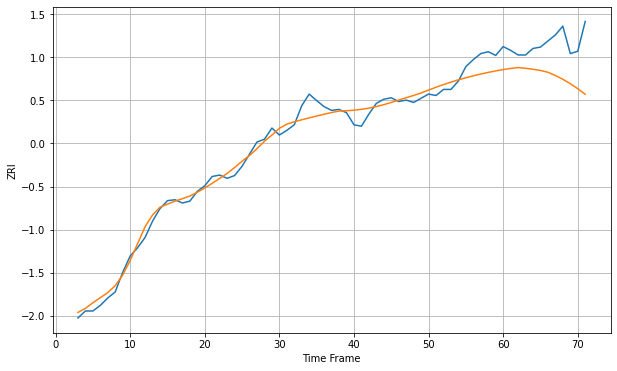

Wall time: 6.61 s
91601 18.534817639592838 76.51773804163894 [2301.64533979 2304.03067941 2305.94152542 2304.36723018 2302.33920841
 2299.74731354 2295.85085057 2288.95111729 2280.78944163 2271.29282712
 2260.50994861 2248.67683939]

Got an mse at 0.0098 in round 21 and stopped training



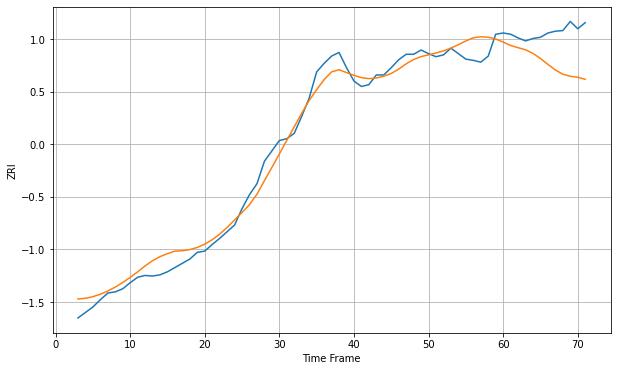

Wall time: 6.33 s
91730 18.452873407427248 56.23849125428749 [1690.03939364 1684.48088891 1680.83965918 1677.39092187 1671.4325591
 1663.10957828 1653.3711281  1644.10032505 1637.25830437 1633.76795145
 1632.21900708 1628.78762997]

Got an mse at 0.0097 in round 37 and stopped training



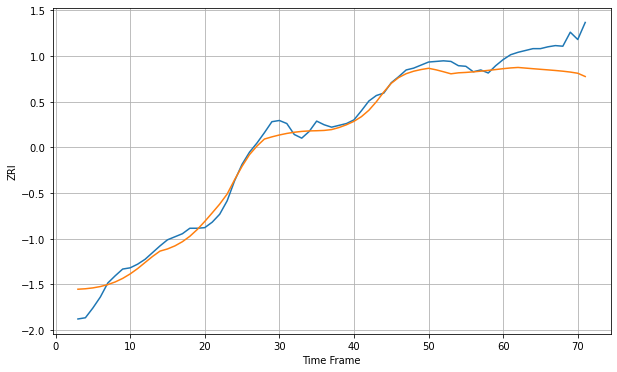

Wall time: 6.07 s
91764 14.650674285314812 45.101174528296305 [1646.10100447 1647.31171649 1648.10423859 1647.06115005 1646.0473677
 1645.07551216 1644.12079667 1643.12102699 1641.97369961 1640.52943318
 1638.5895307  1633.24624086]

Got an mse at 0.0100 in round 108 and stopped training



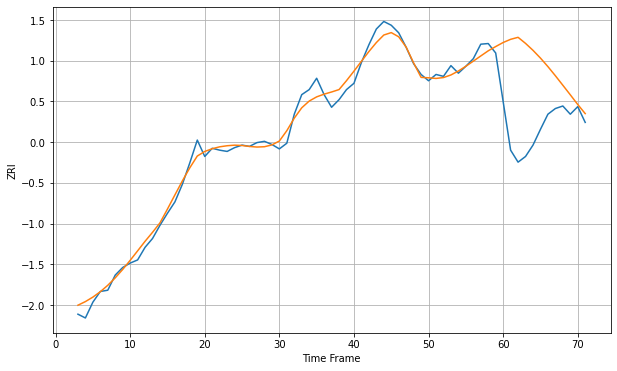

Wall time: 8.02 s
91766 12.174413570274686 114.33710997114633 [2080.6394374  2085.69130277 2088.87554344 2079.23860588 2068.2424242
 2055.9543787  2042.44231987 2027.96492908 2012.90976709 1997.765153
 1982.35712483 1967.94693834]

Got an mse at 0.0097 in round 45 and stopped training



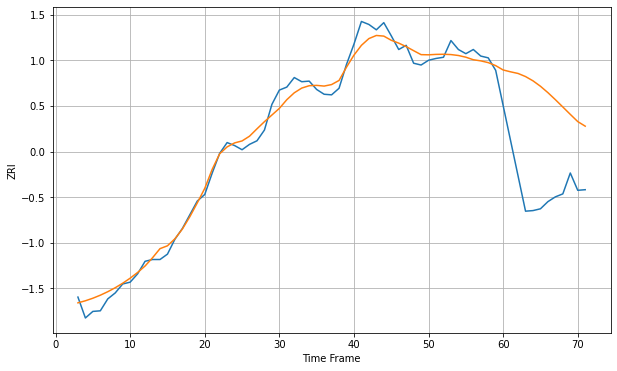

Wall time: 6.24 s
91776 14.995657320141717 158.7081232832962 [2205.69576401 2202.57790025 2199.83886801 2194.65623879 2187.49706068
 2178.3980262  2167.68618936 2155.92055074 2143.64486934 2131.28115462
 2119.1729172  2111.49397373]

Got an mse at 0.0100 in round 65 and stopped training



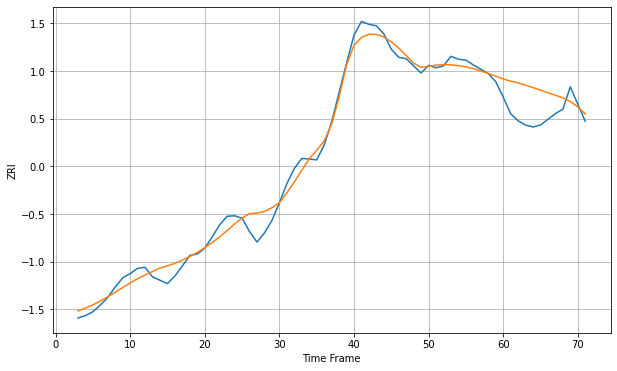

Wall time: 6.92 s
91801 19.55943048603915 56.18124628971904 [2198.65760525 2193.86177866 2190.45455405 2185.61153556 2180.53180847
 2175.25533219 2169.73931304 2164.47888725 2158.88540375 2151.24830114
 2140.39471562 2125.35644321]

Got an mse at 0.0098 in round 46 and stopped training



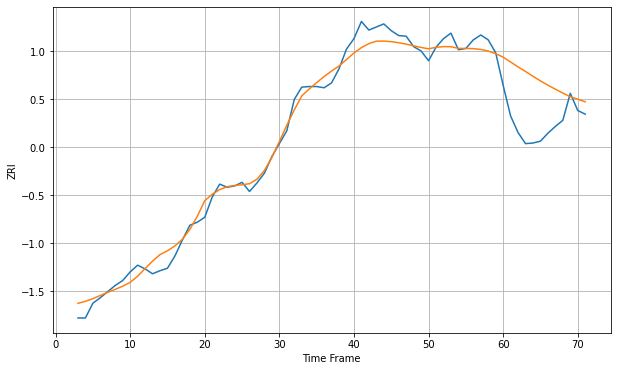

Wall time: 6.59 s
91803 15.747199920544892 75.8765359310275 [2090.80351703 2082.98315686 2074.96496035 2067.5515061  2059.6982771
 2052.18028869 2045.19479476 2038.63862326 2032.35629161 2026.50547651
 2022.36672835 2018.17342002]


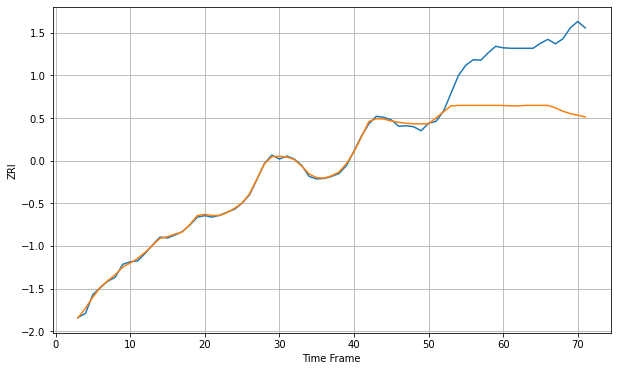

Wall time: 15.9 s
91913 30.69943756790827 140.04282952036357 [2126.81586666 2126.27184893 2126.05887279 2127.02840158 2127.02840158
 2127.02840158 2127.02840158 2122.05263407 2115.35131169 2110.44355277
 2107.28642663 2103.99151051]

Got an mse at 0.0099 in round 27 and stopped training



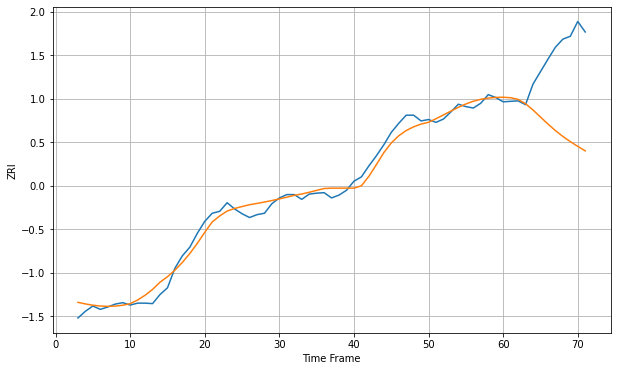

Wall time: 5.81 s
92008 15.637756349375355 152.90388069224224 [2054.60314456 2053.50629143 2050.10623822 2040.96197872 2027.9460914
 2013.26343031 1998.56669748 1984.88970794 1972.63910203 1961.75146679
 1951.85814799 1942.44508873]

Got an mse at 0.0100 in round 26 and stopped training



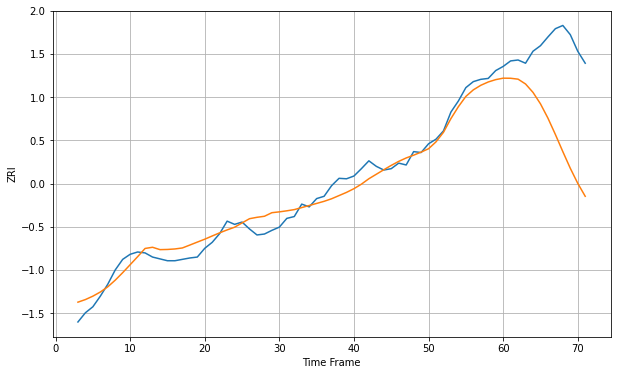

Wall time: 6.24 s
92101 21.635003694053317 191.19469167396886 [2314.50861652 2314.32693605 2312.37701871 2301.91084965 2283.6692354
 2258.84547088 2227.80697803 2192.26704875 2154.9613409  2118.83748173
 2086.12811053 2057.98921854]

Got an mse at 0.0094 in round 24 and stopped training



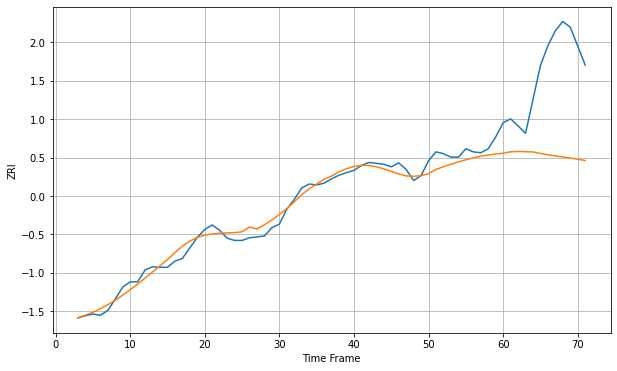

Wall time: 6.01 s
92103 16.424848395103197 205.55384299277623 [1977.92744163 1981.13526152 1982.03361    1981.42465834 1980.8780495
 1977.44943645 1974.52491687 1971.94180853 1969.46436257 1966.94317547
 1964.2870314  1961.43980817]

Got an mse at 0.0099 in round 28 and stopped training



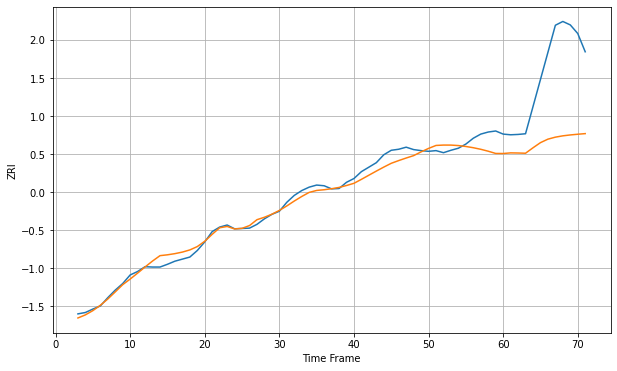

Wall time: 6.06 s
92104 20.472606500922165 220.46930213768786 [1755.63642726 1757.45253525 1757.08701049 1756.41670349 1772.21668598
 1787.16361923 1797.30073091 1803.1100004  1806.92834685 1809.54618009
 1811.57340655 1813.37389915]

Got an mse at 0.0099 in round 40 and stopped training



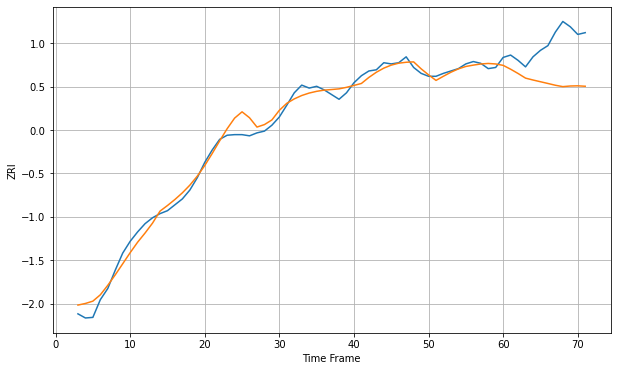

Wall time: 6.25 s
92108 12.72356437220553 68.57539091102231 [1987.52671048 1981.03471203 1973.748815   1965.88794405 1962.69895007
 1959.75518013 1956.81205799 1953.78397987 1951.45712083 1952.52970119
 1952.82542578 1952.10038854]

Got an mse at 0.0097 in round 43 and stopped training



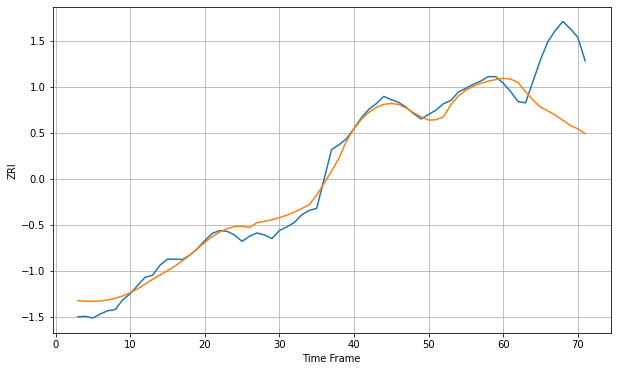

Wall time: 6.36 s
92117 21.807034996566927 157.09731910099904 [2183.76720405 2181.8989899  2173.61596585 2150.46280405 2129.60557543
 2112.6254138  2102.98259026 2092.16794146 2080.02467187 2066.69068753
 2058.40378558 2046.82627557]

Got an mse at 0.0092 in round 274 and stopped training



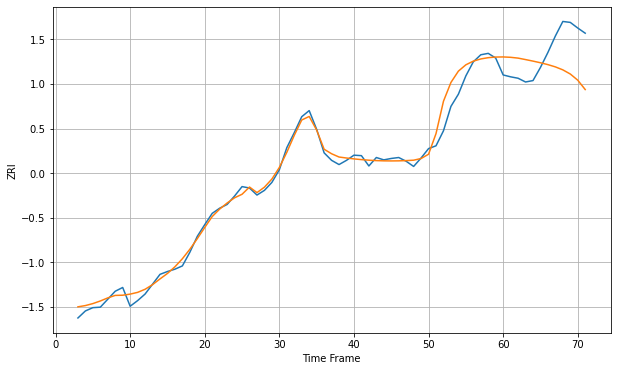

Wall time: 11.3 s
92122 16.408266128833265 72.84888315137712 [2450.38593293 2449.60108447 2447.88504764 2444.77237278 2441.50465065
 2437.98897113 2434.00699065 2429.17268169 2422.85327311 2413.98773391
 2400.82667636 2380.89455241]

Got an mse at 0.0094 in round 21 and stopped training



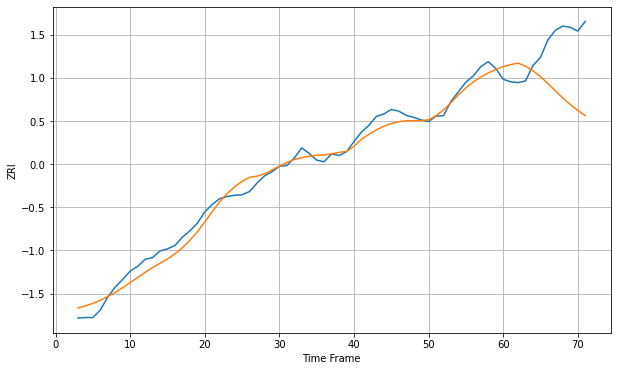

Wall time: 5.74 s
92123 19.56555145292888 125.68797300062079 [2290.05002024 2294.925028   2298.58870885 2291.1401364  2280.31925692
 2266.2535584  2249.76554814 2232.32481312 2215.40488533 2199.87339178
 2185.93928837 2173.39882604]

Got an mse at 0.0095 in round 60 and stopped training



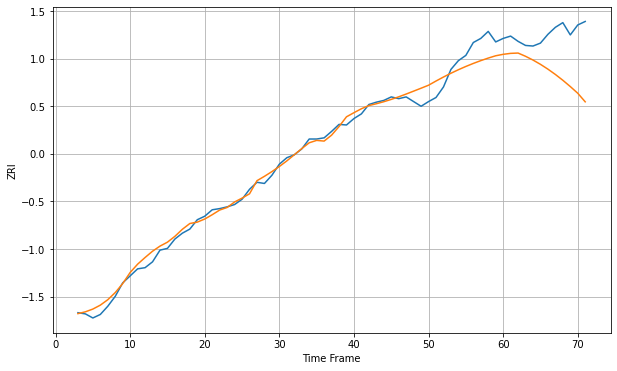

Wall time: 6.58 s
92126 14.431990100658847 73.19848678247433 [2058.81469521 2060.45105742 2061.00029893 2055.44901455 2049.03190773
 2041.70511532 2033.47639186 2024.38611076 2014.45537838 2003.70389768
 1992.28237097 1977.60925259]

Got an mse at 0.0098 in round 50 and stopped training



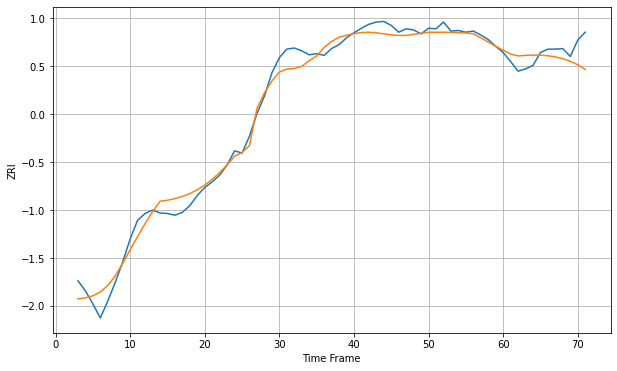

Wall time: 6.82 s
92128 17.074446801241006 27.14191361666176 [2164.03709074 2157.35458193 2153.99309316 2154.93506538 2155.45844068
 2155.32449531 2154.31298062 2152.25174749 2149.00452838 2144.46483167
 2138.39296117 2129.98781077]

Got an mse at 0.0097 in round 34 and stopped training



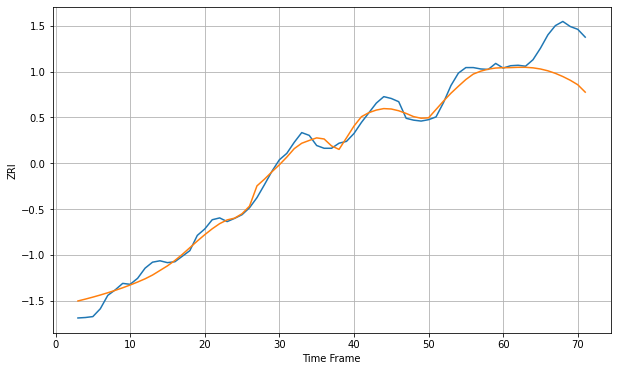

Wall time: 5.6 s
92130 16.81473317565889 79.41777091056426 [2577.73656003 2577.94106509 2578.56458761 2578.58370184 2577.43204481
 2574.94180182 2570.97952962 2565.49584982 2558.57814044 2550.47447538
 2540.82296491 2524.74320222]


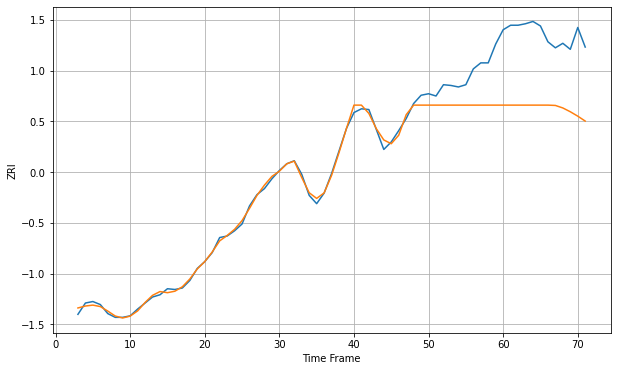

Wall time: 16.4 s
92410 18.370229650874457 99.30798390903415 [1226.88695702 1226.88695702 1226.88695702 1226.88695702 1226.88695702
 1226.88695702 1226.88695702 1226.45712729 1223.11922886 1218.07912101
 1212.23106728 1205.69270232]

Got an mse at 0.0097 in round 31 and stopped training



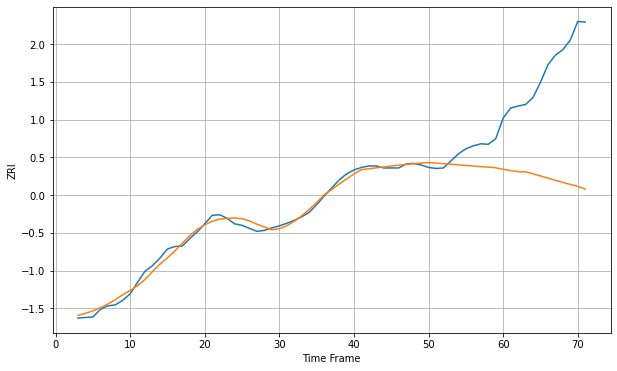

Wall time: 6.31 s
92507 15.697371519649957 223.5861467601611 [1416.22994481 1413.72322196 1411.61092384 1411.18987529 1407.49960948
 1403.12160986 1398.74247977 1394.42440381 1390.227925   1386.23899101
 1382.54657424 1377.16629711]

Got an mse at 0.0099 in round 51 and stopped training



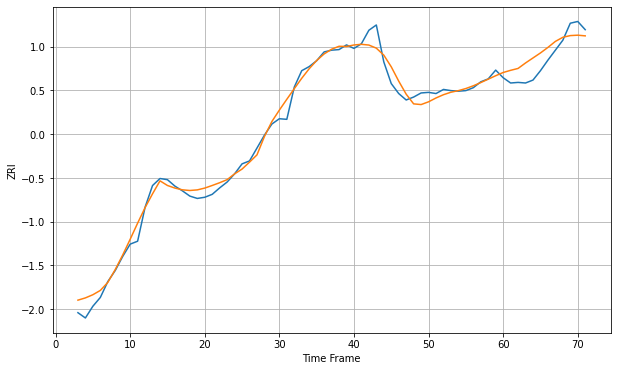

Wall time: 6.43 s
92602 13.923101770829286 23.181765390753565 [2481.91819469 2485.609592   2488.8349296  2498.1865808  2506.72716665
 2515.27524201 2524.71270301 2534.97669758 2541.97093581 2544.89252661
 2545.59566699 2544.42997839]

Got an mse at 0.0100 in round 141 and stopped training



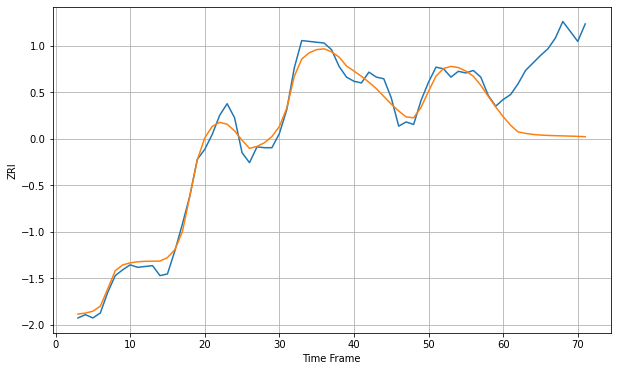

Wall time: 8.43 s
92603 10.706451174075651 99.37776118650066 [2873.33716522 2863.02289342 2855.01470314 2853.25612958 2851.9707774
 2851.23090966 2850.78125022 2850.47956923 2850.23163881 2849.97008707
 2849.64786464 2849.23487601]

Got an mse at 0.0091 in round 37 and stopped training



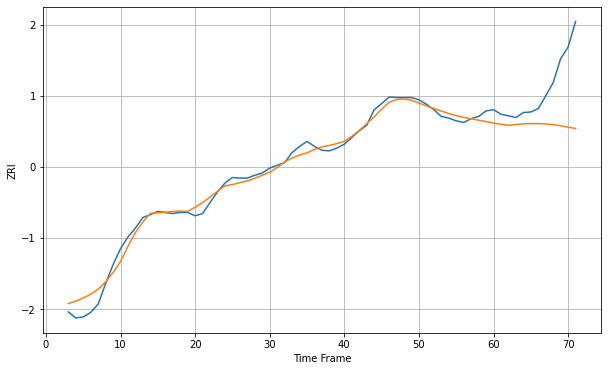

Wall time: 5.93 s
92612 12.3226163330947 83.598391328314 [2388.07823056 2385.80765939 2383.85628806 2385.31806314 2386.60468653
 2387.12438945 2387.0814572  2386.38483157 2385.02813628 2383.08957649
 2380.743864   2378.21205643]

Got an mse at 0.0093 in round 36 and stopped training



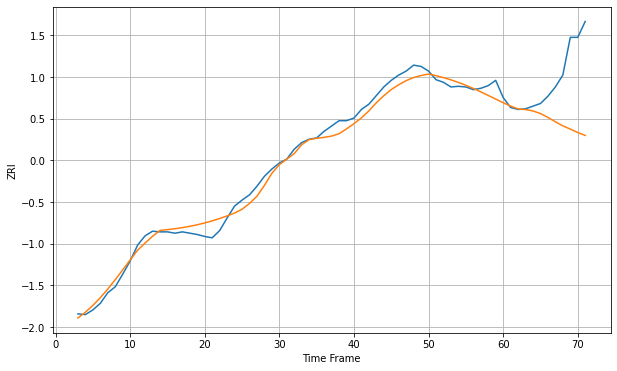

Wall time: 6.14 s
92618 11.38823794957722 81.45323903406612 [2093.22531059 2088.12314162 2083.7761913  2082.91570864 2080.77857834
 2076.81967914 2071.02975677 2064.38081626 2058.24017367 2053.34673553
 2048.10959086 2043.79629634]

Got an mse at 0.0099 in round 161 and stopped training



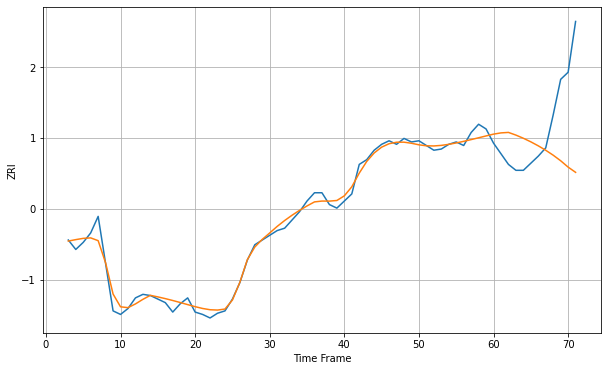

Wall time: 9.04 s
92620 5.481277261046052 51.487794144779706 [1924.62535492 1925.67106632 1926.08295908 1923.80850549 1921.12644676
 1918.09526835 1914.71476742 1910.96511665 1906.78979875 1902.08563074
 1896.71078179 1892.28856134]

Got an mse at 0.0095 in round 22 and stopped training



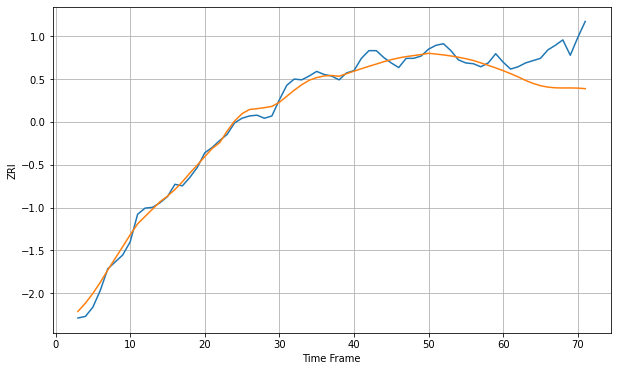

Wall time: 6.01 s
92626 8.958593979973243 46.64050861839609 [2197.96140194 2194.06532598 2189.94858306 2185.29057794 2181.38412404
 2178.42559098 2176.52281743 2175.61717281 2175.42050267 2175.45949753
 2175.25796775 2174.51811565]

Got an mse at 0.0100 in round 41 and stopped training



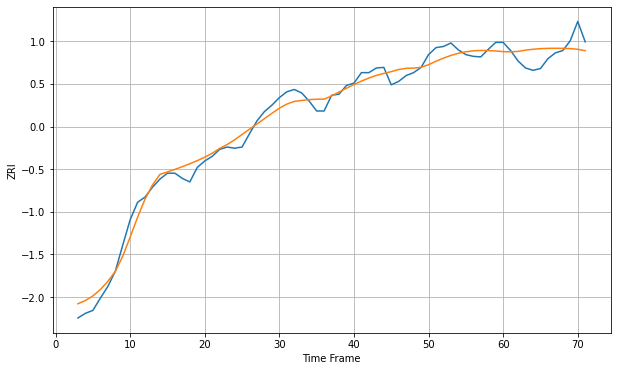

Wall time: 6.19 s
92627 15.070809187395943 24.239605968475498 [2298.12273099 2297.77422301 2298.47699177 2300.66881935 2302.21070877
 2303.20446688 2303.73931491 2303.89624515 2303.74864225 2303.359942
 2302.12909606 2299.77927181]

Got an mse at 0.0097 in round 41 and stopped training



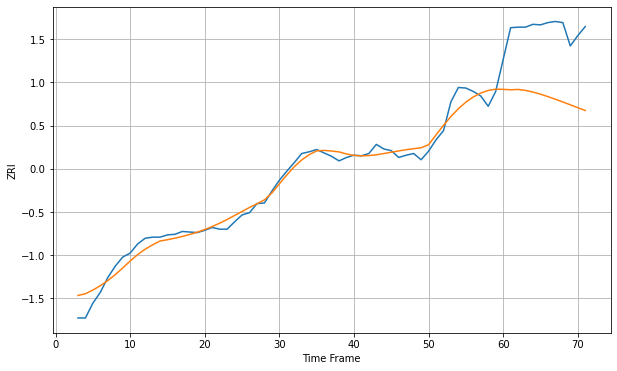

Wall time: 6.36 s
92647 14.78052553851711 119.5201826060328 [2122.74326356 2121.96522304 2122.56998389 2120.86983218 2117.97314323
 2114.23525737 2109.95009551 2105.32721958 2100.50158107 2095.55866116
 2090.55778549 2085.54603408]

Got an mse at 0.0100 in round 55 and stopped training



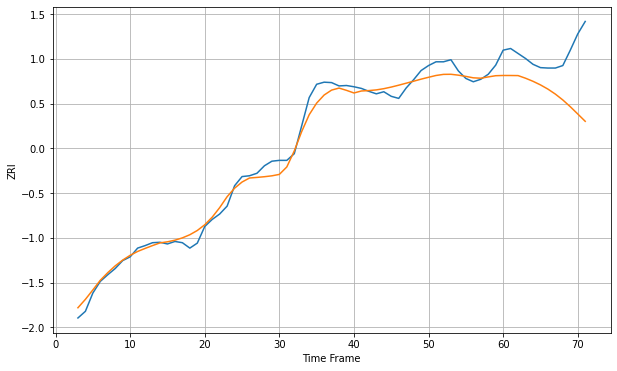

Wall time: 6.57 s
92648 19.270478526618756 109.13042569304334 [2309.10097252 2309.0698941  2308.8443128  2302.52763621 2295.12730948
 2286.4898956  2276.34721983 2264.34382758 2250.20147433 2234.02565406
 2216.54060301 2198.91828191]

Got an mse at 0.0100 in round 172 and stopped training



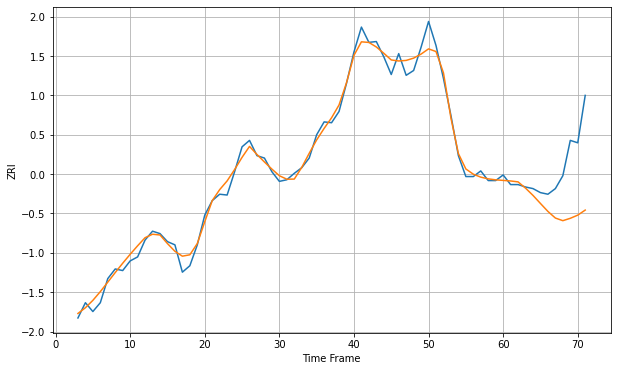

Wall time: 8.96 s
92651 9.804165517055633 59.95713277289575 [2560.20038665 2559.50889626 2558.3601264  2550.58034813 2541.5484438
 2531.49945354 2521.59435459 2513.37125966 2510.09163213 2513.03466269
 2516.98381749 2523.26273327]

Got an mse at 0.0099 in round 44 and stopped training



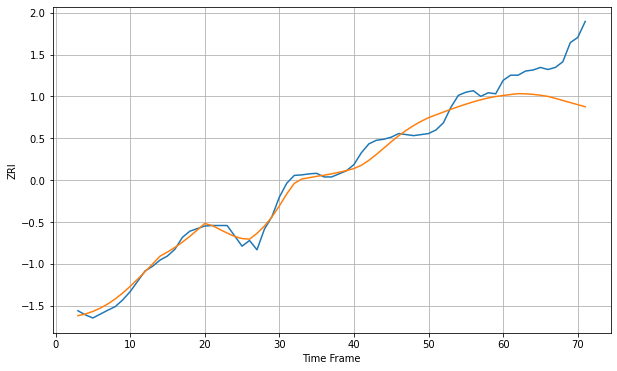

Wall time: 6.55 s
92656 14.481966176183839 81.71405052415146 [2235.75733853 2237.50786385 2239.23802689 2238.9237691  2237.90032209
 2236.21095726 2233.92182017 2230.13649111 2226.09520711 2221.99082505
 2217.91387407 2213.93900478]

Got an mse at 0.0100 in round 39 and stopped training



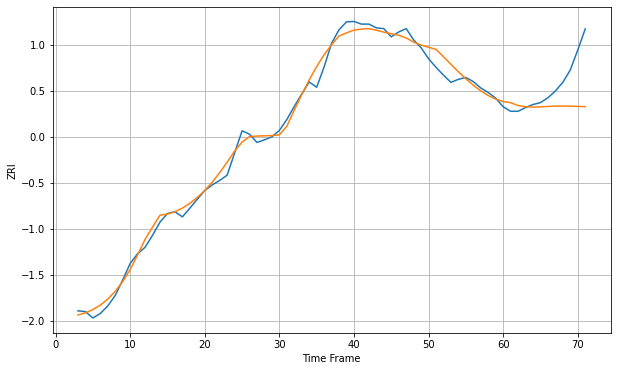

Wall time: 6.13 s
92660 20.149165050056908 82.54853299934604 [2886.80605952 2883.91700266 2876.20812135 2873.03990267 2872.12552609
 2872.74239254 2873.90950516 2874.81747111 2875.05218085 2874.66740467
 2873.98018409 2873.23990125]

Got an mse at 0.0099 in round 80 and stopped training



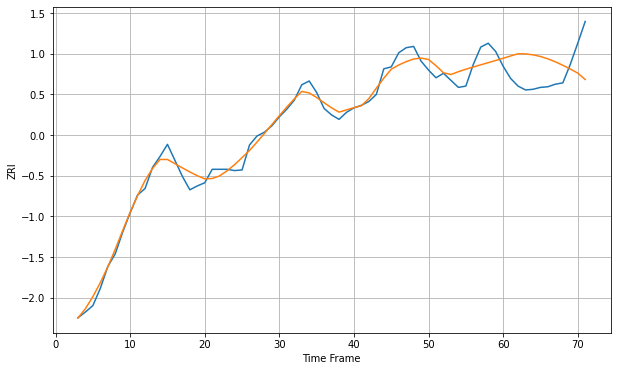

Wall time: 6.63 s
92663 13.040567285370642 47.14035093575684 [2327.49148491 2331.08721024 2334.50218856 2334.29258058 2332.88272031
 2330.27447941 2326.57522948 2321.94587434 2316.57354961 2310.6585095
 2304.39605083 2294.33488448]

Got an mse at 0.0100 in round 67 and stopped training



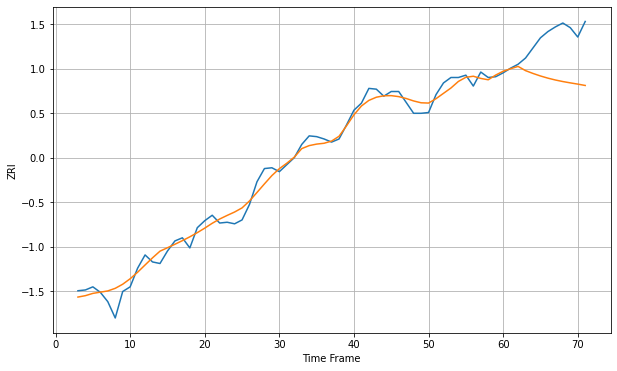

Wall time: 7.32 s
92672 10.540907734378878 52.51777954981864 [2234.01754877 2237.25463202 2240.24467271 2234.84065519 2231.19370282
 2227.95511804 2225.156262   2222.78660199 2220.79634003 2219.0895985
 2217.50244774 2215.75499938]

Got an mse at 0.0099 in round 61 and stopped training



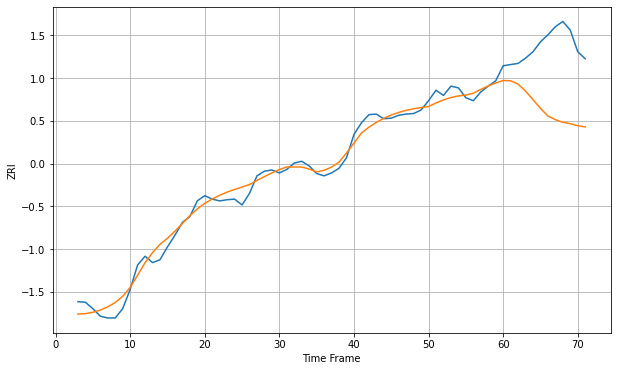

Wall time: 7.01 s
92673 13.162200639805842 114.01937333451541 [2212.55190997 2212.22982049 2206.4487386  2194.57514076 2179.78592091
 2164.91814971 2151.72168187 2145.37951291 2140.98681783 2138.55631817
 2134.98598864 2133.04147585]

Got an mse at 0.0100 in round 177 and stopped training



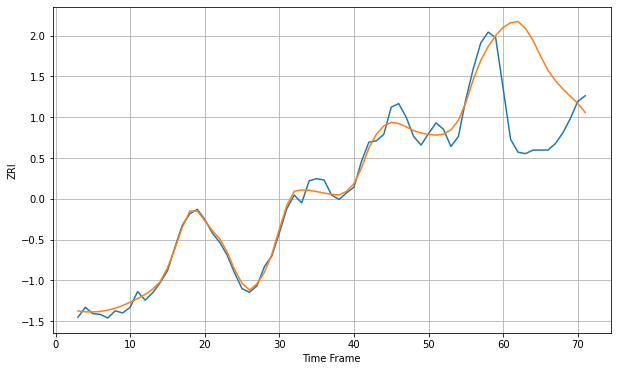

Wall time: 9.06 s
92677 11.052103873047542 117.12596670790369 [2481.74260549 2488.14134914 2489.96195353 2480.11113617 2463.57183312
 2441.78237166 2421.76051647 2407.06705034 2395.53825352 2385.21820941
 2375.35876907 2362.53949851]

Got an mse at 0.0099 in round 100 and stopped training



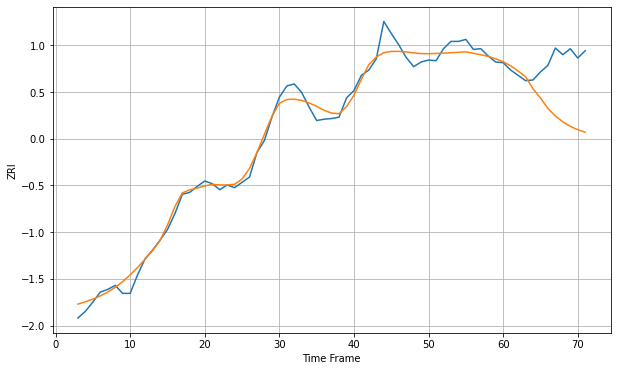

Wall time: 7.98 s
92691 13.08322473620864 74.69408077030832 [2117.39676458 2111.29971749 2103.55814228 2094.95929213 2076.81907078
 2062.86322655 2047.18594886 2035.82398295 2027.06322603 2020.26611192
 2015.12081198 2011.3984794 ]

Got an mse at 0.0099 in round 51 and stopped training



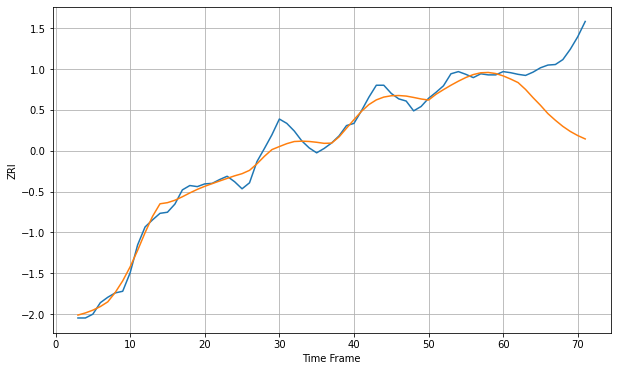

Wall time: 6.18 s
92692 14.908154181849184 109.33330069417272 [2174.16853093 2168.38272527 2161.88147153 2149.32524388 2134.31870606
 2120.24943504 2104.94339746 2092.71647181 2081.54486934 2072.21605994
 2064.66256453 2058.48181373]

Got an mse at 0.0099 in round 66 and stopped training



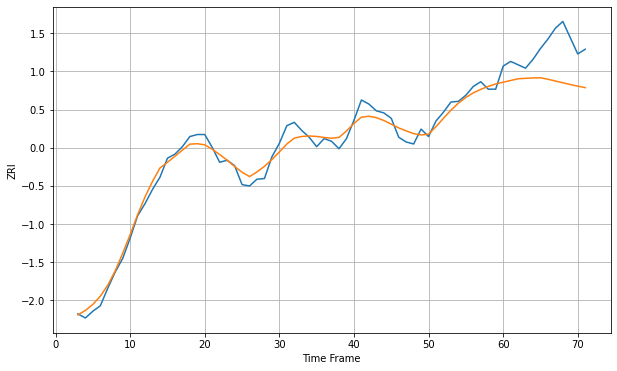

Wall time: 7.01 s
92707 11.513231774201284 52.19572442925081 [2167.28678568 2169.80935381 2172.34735746 2172.98972444 2173.52389423
 2173.83256296 2171.6888303  2169.02311378 2166.40631797 2163.87501972
 2161.4693737  2159.23167698]

Got an mse at 0.0097 in round 65 and stopped training



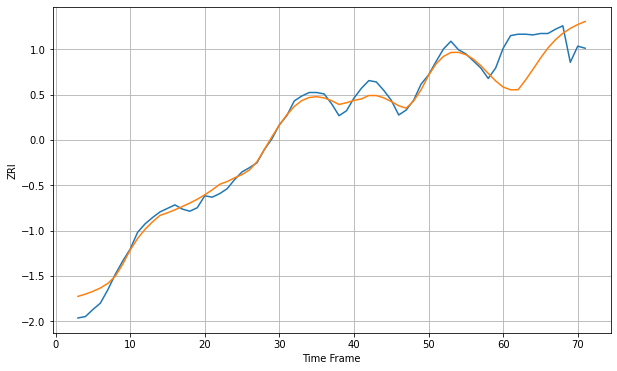

Wall time: 6.61 s
92780 11.159236731324166 48.857917789448116 [2083.75556756 2079.81648106 2079.91083021 2093.74747592 2109.11416141
 2124.90869591 2139.29822246 2151.08178471 2160.23047304 2167.28518686
 2172.7937516  2177.14293225]

Got an mse at 0.0097 in round 34 and stopped training



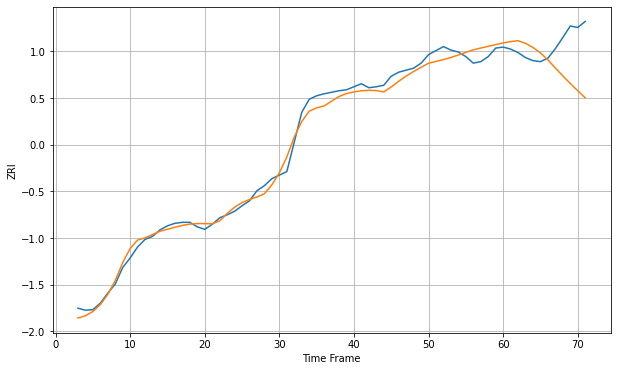

Wall time: 6.27 s
92782 13.946644445586537 71.93542771391462 [2407.19581486 2409.8343883  2411.73536244 2406.36803274 2398.24804717
 2387.37700789 2373.36156716 2357.28228159 2341.62755498 2326.5585175
 2311.98253836 2297.92139616]

Got an mse at 0.0097 in round 19 and stopped training



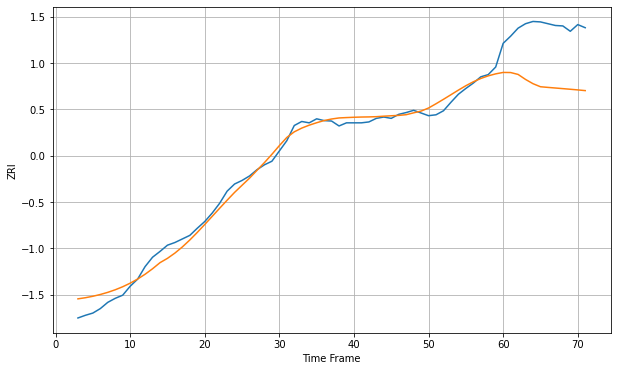

Wall time: 5.65 s
92805 16.762848603048983 127.61029785704932 [1957.85538188 1957.6245004  1953.41541306 1942.20514037 1932.66542359
 1925.81793914 1924.35706593 1922.96951836 1921.594432   1920.19239813
 1918.72683538 1917.15871536]

Got an mse at 0.0094 in round 20 and stopped training



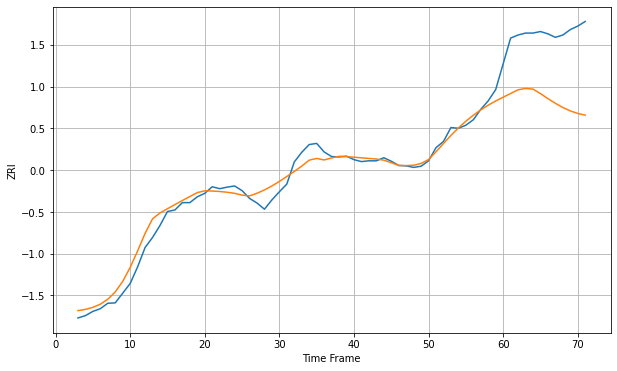

Wall time: 5.89 s
92806 21.137780140959226 173.39417863095005 [2182.25026815 2191.84784559 2201.54411202 2204.90818992 2203.30646795
 2191.50011231 2178.771635   2166.55645603 2155.74748453 2146.96334749
 2140.41374286 2135.94817699]

Got an mse at 0.0098 in round 26 and stopped training



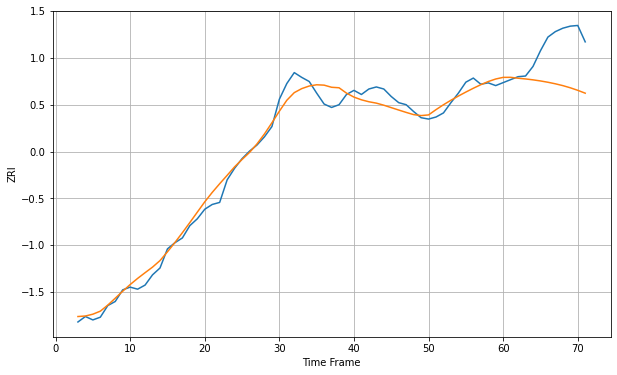

Wall time: 6.15 s
92832 13.282284975510084 59.51191694755365 [1963.02038369 1963.09262672 1961.77723571 1960.72854084 1959.40960445
 1957.80230403 1955.87693752 1953.60331825 1950.95514133 1947.77958397
 1944.06348535 1939.87431022]

Got an mse at 0.0098 in round 34 and stopped training



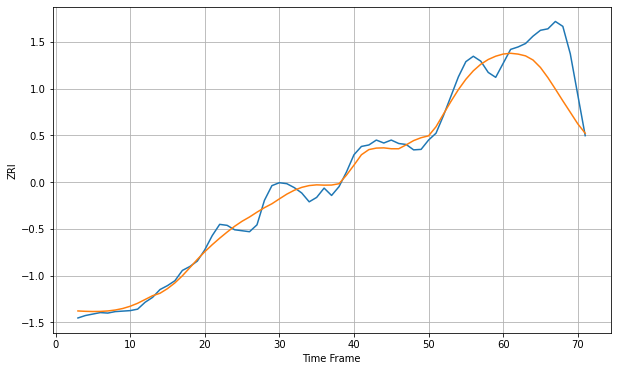

Wall time: 6.1 s
93001 17.873268637649485 81.25716713954553 [2222.48860746 2224.07495865 2222.41704674 2218.80773441 2210.39257735
 2195.10096558 2174.34844955 2151.03046357 2127.0100216  2103.70878825
 2080.19117368 2060.87721284]

Got an mse at 0.0097 in round 52 and stopped training



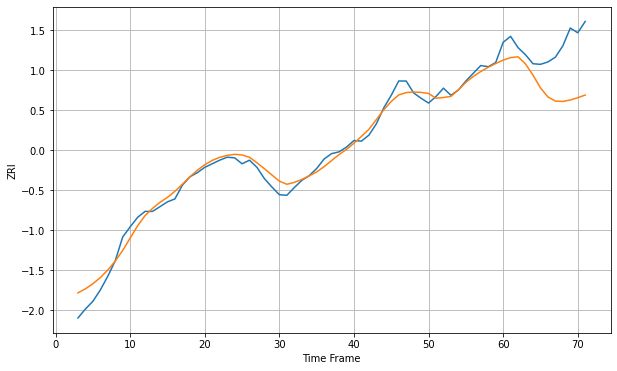

Wall time: 6.79 s
93010 13.397948981999296 73.00580539015402 [2053.07616567 2057.30400823 2058.62057074 2046.54469879 2027.90103579
 2006.4907377  1991.21643297 1984.28010803 1983.64907292 1986.06377309
 1989.95968008 1994.4382819 ]

Got an mse at 0.0096 in round 37 and stopped training



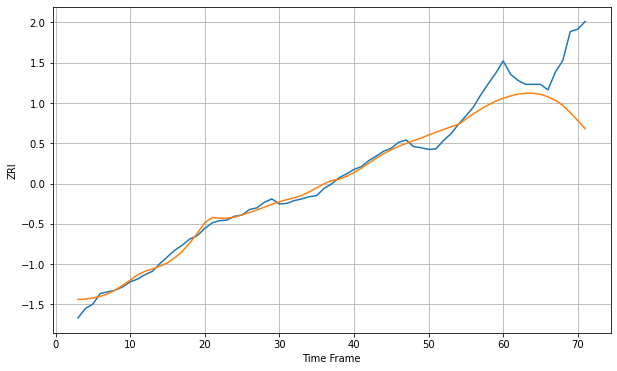

Wall time: 6.01 s
93030 13.717215290210792 92.22578015599166 [1846.03396382 1850.13379396 1853.37614587 1855.02892965 1855.0365142
 1853.08023469 1848.58414193 1842.25148118 1833.10023498 1820.33721874
 1805.74017065 1791.22690248]

Got an mse at 0.0100 in round 185 and stopped training



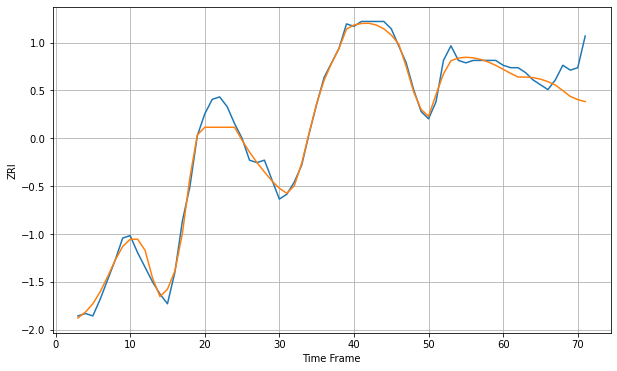

Wall time: 9.05 s
93304 3.699042122113979 9.869245514973814 [879.32511971 877.6737546  876.18412666 876.1431399  875.93842919
 875.30827957 874.25901285 872.86204107 870.59801503 868.20722828
 866.88670156 866.08245966]

Got an mse at 0.0099 in round 103 and stopped training



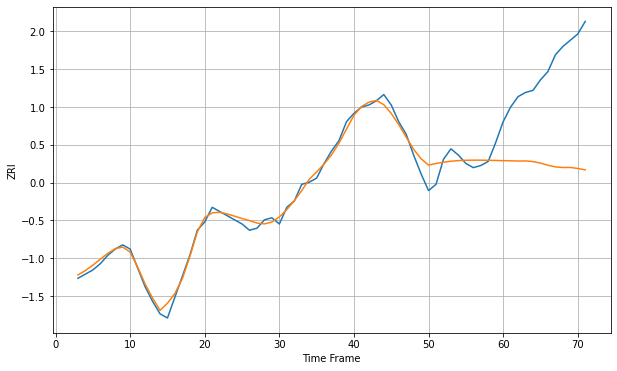

Wall time: 7.86 s
93305 3.463413738135647 47.3803763509509 [784.34905385 784.26846403 784.16431223 784.20425263 783.88919226
 783.18197901 782.15268746 781.36425389 781.05733416 781.08650393
 780.60780944 779.92839596]

Got an mse at 0.0100 in round 131 and stopped training



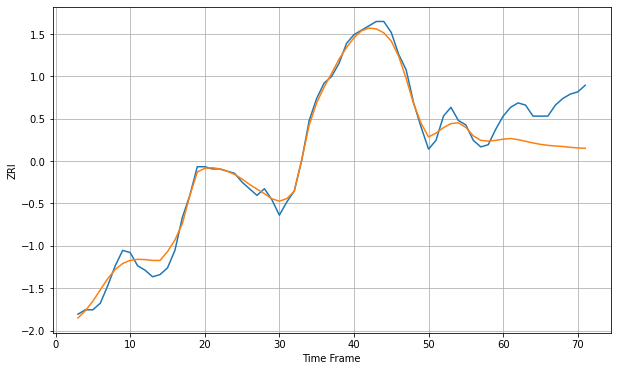

Wall time: 8.1 s
93307 3.4084388925208207 18.756923074626343 [858.51775581 858.82330258 858.29973122 857.56588726 856.8143457
 856.17387868 855.71022699 855.42715666 855.19250064 854.83400507
 854.53377775 854.37532923]

Got an mse at 0.0099 in round 118 and stopped training



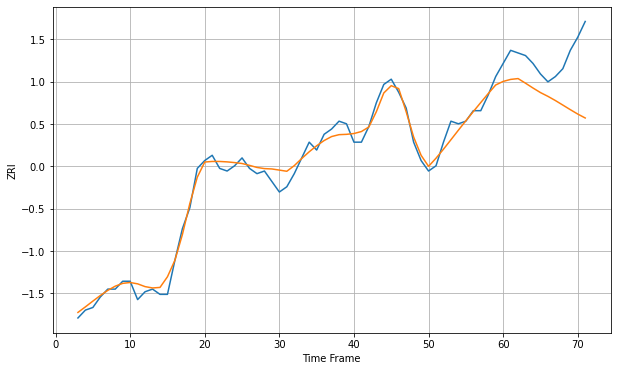

Wall time: 7.92 s
93308 3.0666866245846878 17.18127415527744 [848.15010268 848.91695714 849.23417604 847.46895778 845.6369989
 843.90326299 842.4625686  840.86651285 839.13654224 837.39417089
 835.70920349 834.21627876]

Got an mse at 0.0099 in round 49 and stopped training



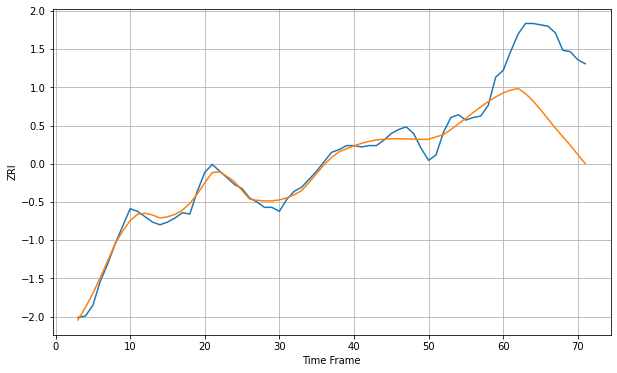

Wall time: 6.69 s
93309 5.539212234318847 59.25543811228465 [1022.24028061 1024.30872262 1025.60077508 1021.69905887 1016.34435875
 1009.86190311 1002.90864979  996.05705393  989.53358943  983.33078975
  976.27856833  969.60528528]

Got an mse at 0.0100 in round 27 and stopped training



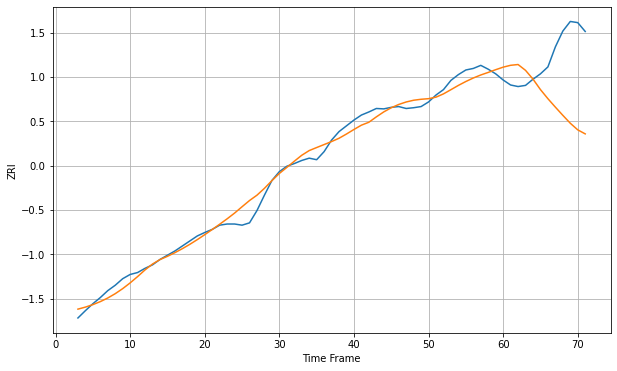

Wall time: 5.83 s
93906 19.609468440008225 160.0761893133182 [1802.32607744 1807.17551682 1809.1788105  1794.01645488 1771.29192824
 1744.08586031 1720.4227932  1698.50097977 1677.24929428 1656.70706054
 1639.51154711 1629.05275413]


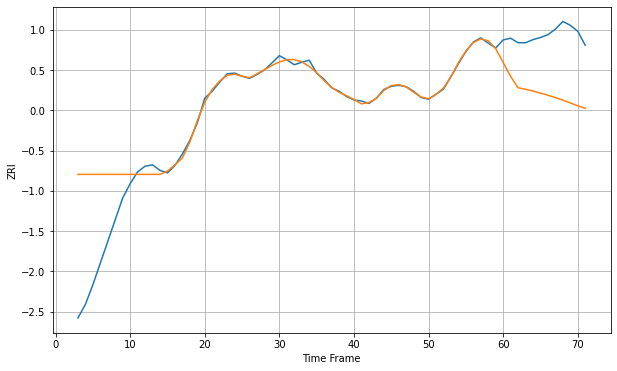

Wall time: 16.4 s
94010 96.92482227054656 169.59321918180436 [2656.52168837 2616.47457635 2583.88089533 2579.63860963 2574.48518925
 2568.73829949 2562.50170885 2555.75056758 2548.44028384 2540.56652209
 2532.17371751 2525.12401196]

Got an mse at 0.0098 in round 84 and stopped training



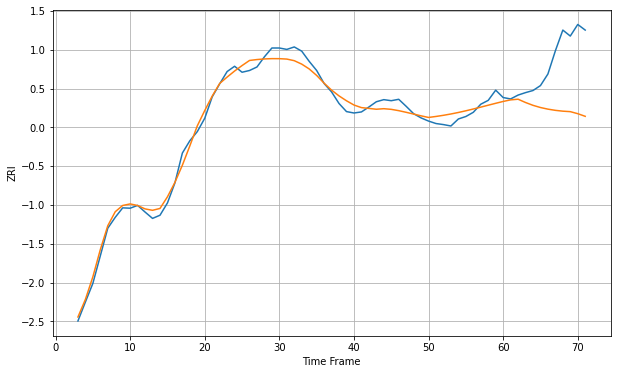

Wall time: 6.99 s
94025 20.0849141530573 149.93150081098835 [3325.87234802 3330.33726542 3332.22722398 3322.86913782 3314.83337045
 3308.61607244 3303.96359947 3300.5559709  3298.20463493 3296.83251118
 3291.05451482 3283.53635087]

Got an mse at 0.0099 in round 91 and stopped training



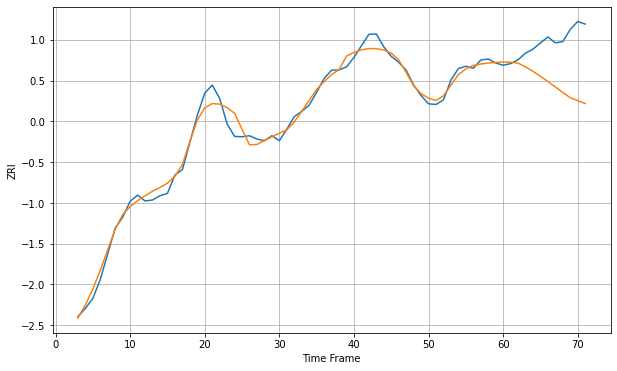

Wall time: 7.5 s
94040 22.315329598795525 140.30303761093379 [3396.02629086 3395.39553289 3392.58368238 3381.02504562 3367.50300576
 3352.45972796 3336.42820331 3319.9168676  3303.43170002 3287.37575553
 3278.57834969 3269.74694002]

Got an mse at 0.0100 in round 431 and stopped training



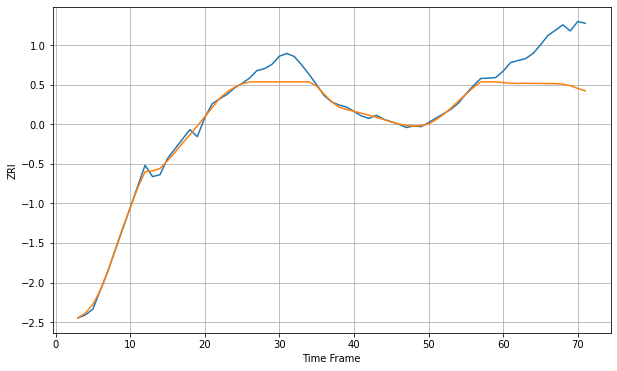

Wall time: 14 s
94061 25.718159422901106 149.11927550104804 [3014.51340413 3012.24506243 3011.45592734 3012.08285114 3011.82743589
 3011.62699106 3011.45142968 3010.94778462 3009.24634632 3004.30208957
 2995.48842575 2987.39278923]

Got an mse at 0.0099 in round 47 and stopped training



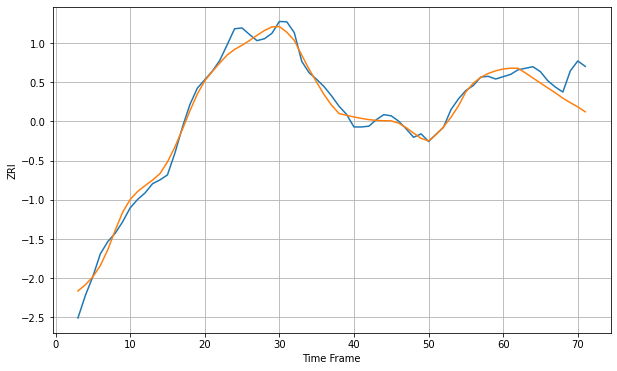

Wall time: 6.28 s
94066 20.859284913078348 56.69627554333962 [2857.12583224 2859.19561497 2858.9403527  2846.59422311 2833.56685466
 2820.49896248 2807.70744759 2794.90392685 2781.11177711 2769.40725852
 2758.34877802 2745.4787212 ]


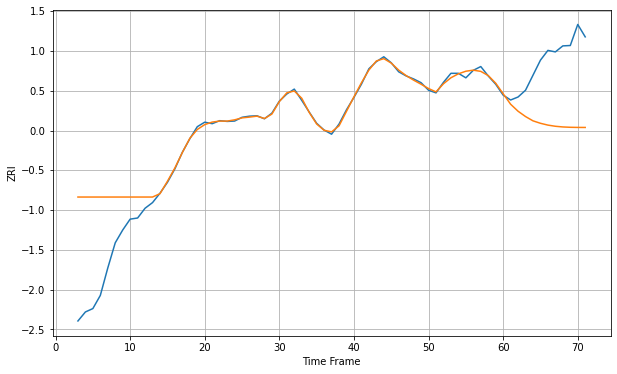

Wall time: 16.1 s
94085 86.43678993084866 172.04182658115627 [2964.61902466 2936.76295604 2918.09585911 2903.95662171 2892.5361561
 2886.03279771 2881.20721778 2878.09482148 2876.29925761 2875.38939906
 2875.02312659 2874.95534346]

Got an mse at 0.0099 in round 57 and stopped training



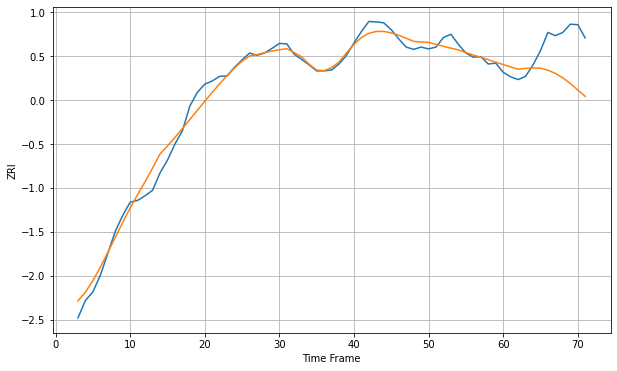

Wall time: 6.48 s
94086 18.317307380500036 81.64103248499087 [2916.80744828 2911.73625515 2906.65436969 2908.43190871 2909.35740718
 2908.98726321 2904.47960553 2897.51191113 2887.7708616  2875.34844719
 2861.38119644 2847.28160461]

Got an mse at 0.0098 in round 49 and stopped training



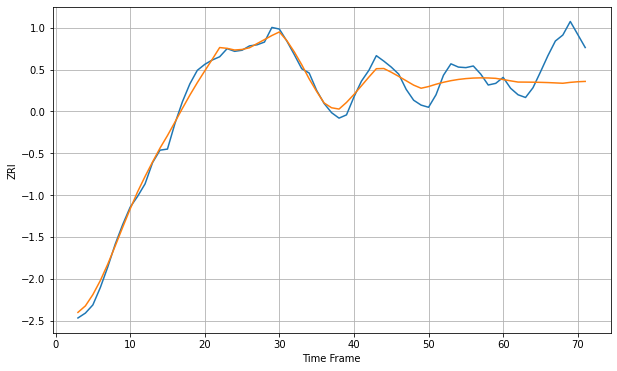

Wall time: 6.55 s
94087 14.79156215204349 59.403479720749694 [2713.06246917 2710.64998981 2708.4059079  2708.32714584 2708.16798257
 2707.89204927 2707.46312644 2706.85670347 2706.20941396 2707.86462147
 2708.99522207 2709.61605666]

Got an mse at 0.0100 in round 99 and stopped training



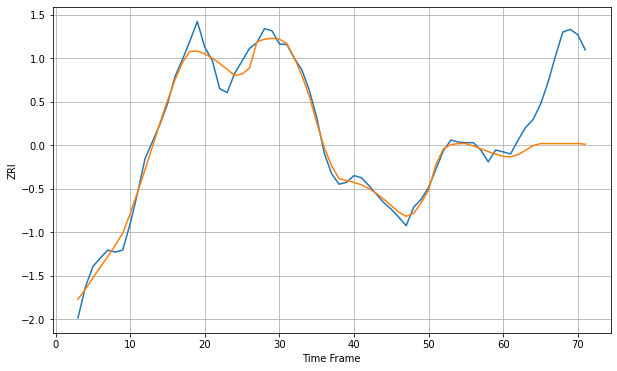

Wall time: 7.62 s
94103 14.04935553652423 107.78962872293317 [3480.24120154 3479.50175139 3482.95267727 3489.41867551 3496.41017384
 3499.6785762  3499.6785762  3499.6785762  3499.6785762  3499.6785762
 3499.6785762  3498.76747276]

Got an mse at 0.0099 in round 84 and stopped training



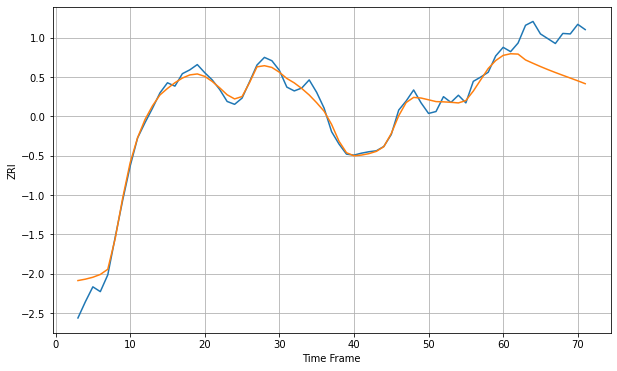

Wall time: 6.74 s
94105 17.352527713803774 75.79083571303497 [3990.17137189 3993.57396017 3992.90488987 3980.67971548 3973.69455051
 3966.90612263 3960.47984619 3954.41294802 3948.59977232 3942.88409779
 3937.09901257 3931.09664184]

Got an mse at 0.0099 in round 63 and stopped training



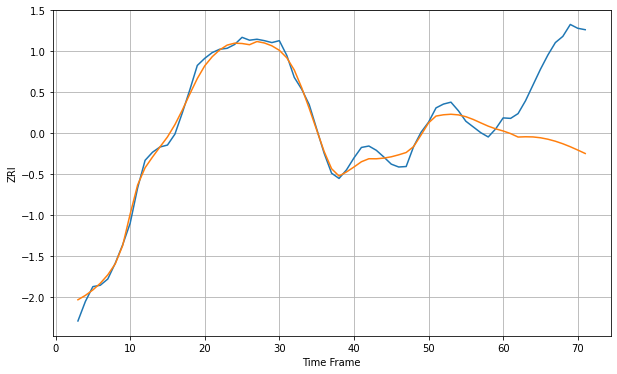

Wall time: 6.69 s
94107 15.150053650617833 174.56009260409354 [3822.5691071  3817.08083782 3809.85067137 3810.40257707 3810.07756203
 3808.33283935 3805.28394102 3801.05501477 3795.75431332 3789.51037607
 3782.56674518 3775.33683294]

Got an mse at 0.0099 in round 88 and stopped training



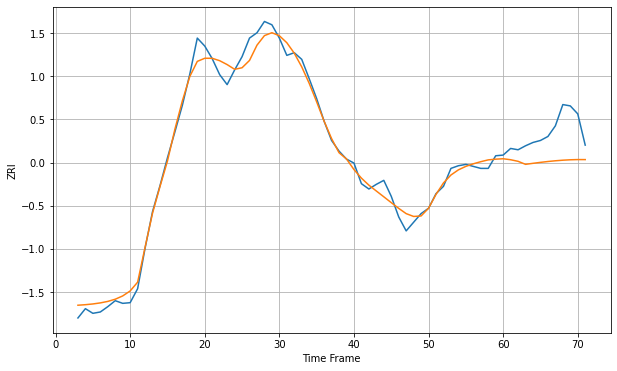

Wall time: 7.27 s
94109 13.085727814971321 46.921558343797344 [3377.48573166 3376.02791443 3373.62907493 3369.08468663 3370.62986455
 3372.06058578 3373.34336086 3374.44363198 3375.32420049 3375.94443158
 3376.26051289 3376.22679018]

Got an mse at 0.0099 in round 57 and stopped training



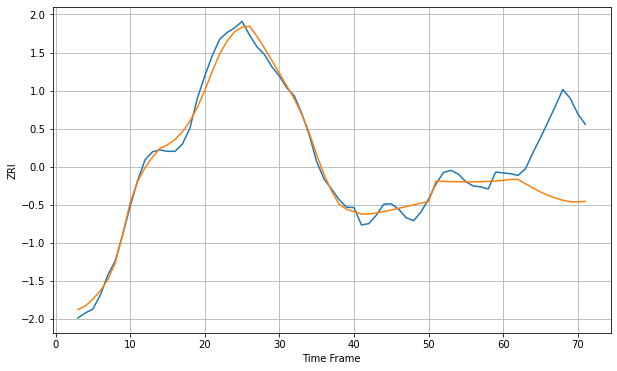

Wall time: 6.87 s
94110 17.826117233543133 160.0444383091189 [3850.14129176 3852.67488536 3852.57637547 3842.30456554 3832.06815726
 3823.03709254 3815.20150292 3808.56036085 3803.36809563 3799.69134684
 3799.28078576 3800.65102973]

Got an mse at 0.0098 in round 32 and stopped training



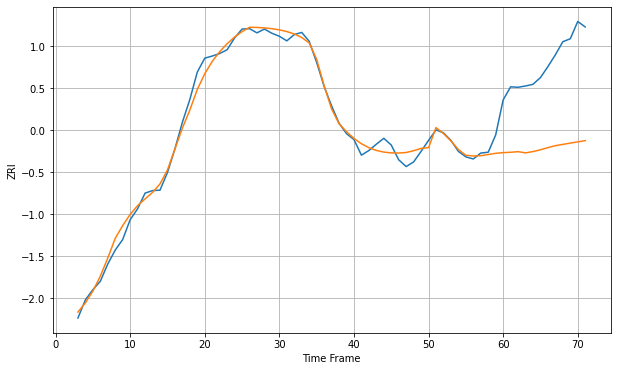

Wall time: 6.47 s
94115 16.599853767298313 204.30349205555945 [3431.05766623 3431.84900095 3433.29323789 3430.41794058 3433.52897153
 3437.79432119 3442.8782561  3447.5236502  3450.56856168 3453.5663406
 3456.52216427 3459.43392736]

Got an mse at 0.0099 in round 55 and stopped training



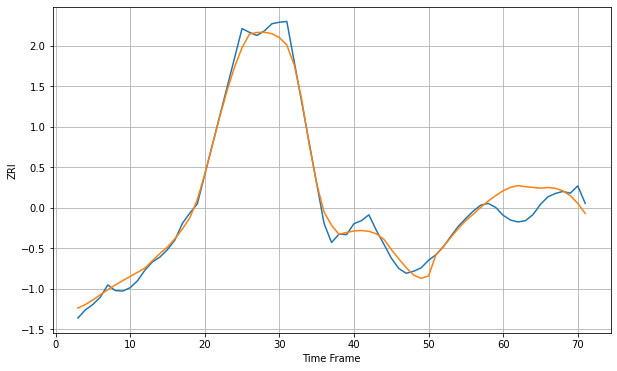

Wall time: 6.18 s
94158 31.360780643887523 85.65152609619187 [3999.87701806 4013.31021367 4019.9617433  4015.56243851 4012.81925233
 4010.04849069 4012.38326295 4009.35578472 3999.46456012 3980.48449039
 3950.16291476 3910.43853962]

Got an mse at 0.0098 in round 59 and stopped training



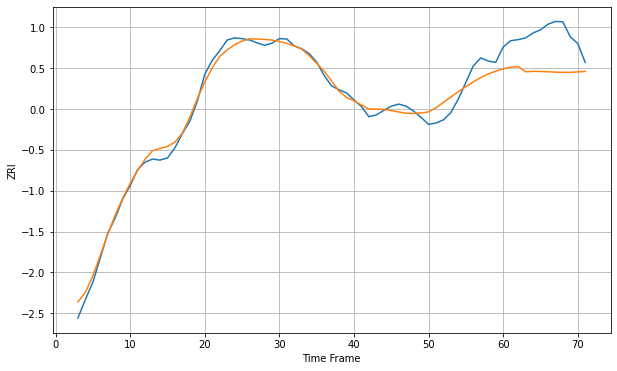

Wall time: 6.76 s
94401 21.977259368121373 103.52880315505696 [2798.68904642 2803.42977065 2805.29079422 2790.34028209 2791.60318553
 2791.16237962 2790.27004945 2789.29468999 2788.62859857 2788.63457677
 2789.9719632  2791.27536988]

Got an mse at 0.0087 in round 42 and stopped training



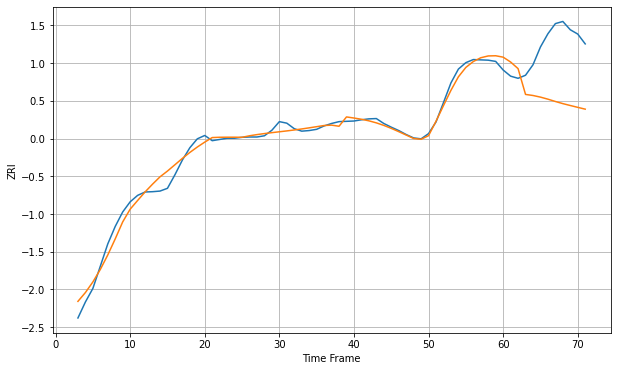

Wall time: 6.37 s
94403 20.1175618815329 180.09541829649984 [3120.82520936 3105.0010738  3083.5270826  2999.56510761 2996.06225485
 2990.78914916 2984.09393334 2976.56177819 2969.62361408 2963.46702491
 2957.49492268 2951.59419748]

Got an mse at 0.0098 in round 48 and stopped training



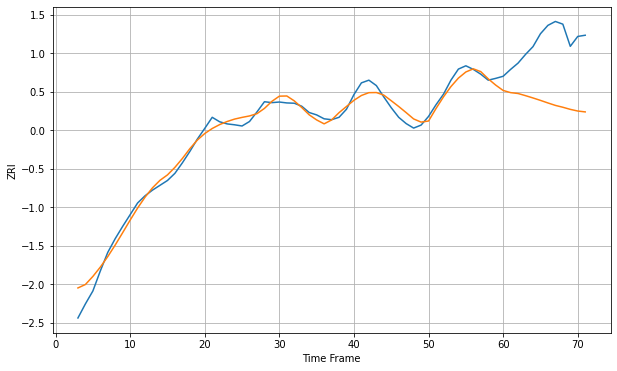

Wall time: 6.51 s
94404 25.584805443681248 206.3279413966114 [3101.61511726 3094.38386057 3091.47336646 3084.27124811 3076.61409398
 3068.52132067 3059.93569194 3051.78539646 3045.57939526 3038.52520109
 3032.95330853 3030.03583169]

Got an mse at 0.0100 in round 42 and stopped training



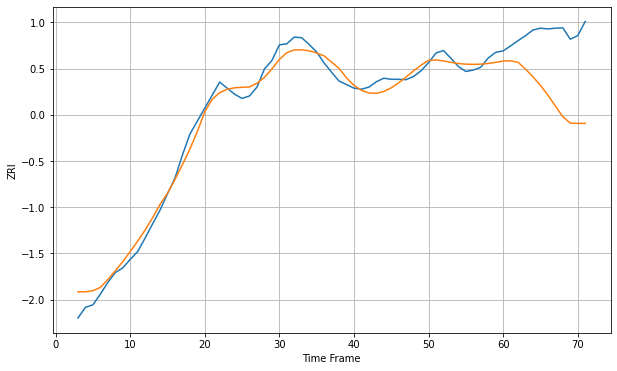

Wall time: 6.6 s
94501 24.83416238227116 183.52330104169693 [2590.45523103 2591.0365637  2586.95321292 2567.6338379  2545.97519817
 2521.82600255 2494.31992686 2463.52197505 2433.32406399 2415.5144076
 2414.61834511 2414.64480979]

Got an mse at 0.0098 in round 32 and stopped training



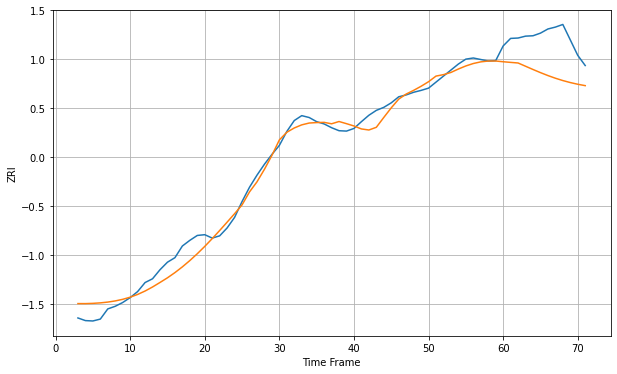

Wall time: 5.57 s
94509 24.082998407249477 97.02338053662427 [1905.08400132 1903.34018748 1901.74643842 1893.12580235 1884.51391776
 1876.18869225 1868.40075299 1861.3412269  1855.12496057 1849.79061787
 1845.31312742 1841.62183798]

Got an mse at 0.0099 in round 86 and stopped training



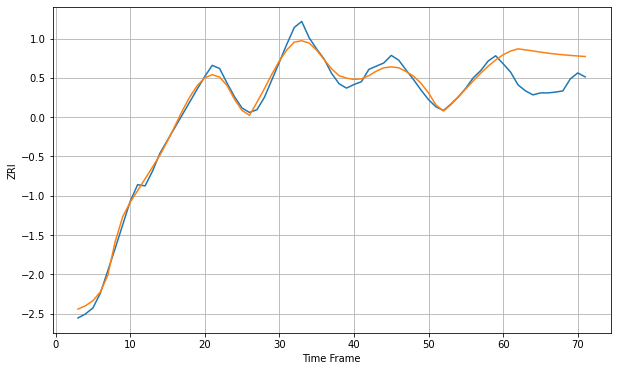

Wall time: 7.5 s
94530 15.411128697764747 81.51672631402771 [2473.66928967 2482.84938439 2488.37294627 2485.83306804 2483.12754397
 2480.15770473 2477.58907436 2475.39939256 2473.54039509 2471.94565315
 2470.53884877 2469.24304217]

Got an mse at 0.0096 in round 62 and stopped training



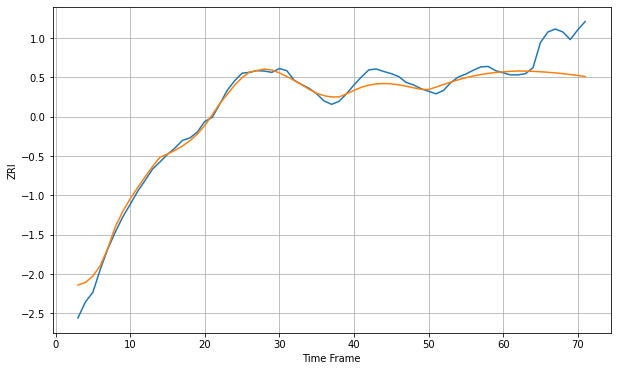

Wall time: 6.72 s
94538 18.235467412970273 76.77048342312735 [2460.2963497  2461.43934912 2462.24273839 2461.9360936  2461.33329929
 2460.43502161 2459.23950878 2457.74760771 2455.96968169 2453.92900002
 2451.65154198 2449.12941503]

Got an mse at 0.0100 in round 43 and stopped training



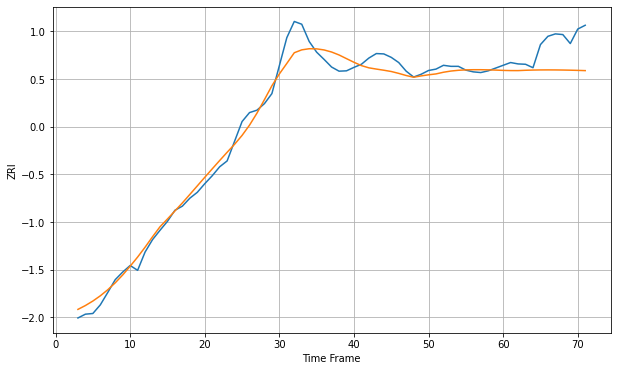

Wall time: 6.45 s
94541 28.771167502544465 79.23906823260657 [2369.22525423 2368.69676407 2368.63167759 2369.58437113 2370.22465907
 2370.57997252 2370.68456942 2370.57545819 2370.28826529 2369.85304993
 2369.29061066 2368.61006369]

Got an mse at 0.0099 in round 93 and stopped training



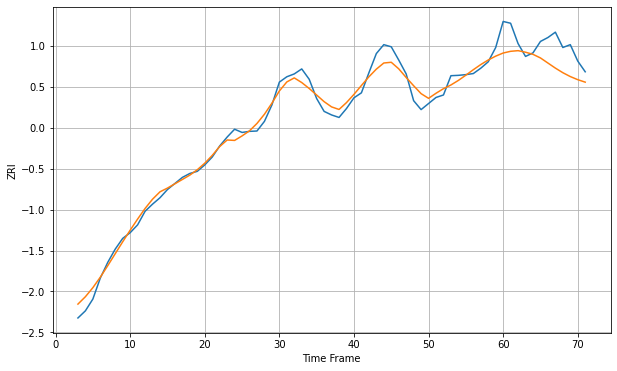

Wall time: 7.42 s
94549 21.584187842824903 63.56620925436987 [2729.5508124  2734.36720739 2736.17335759 2731.82409278 2725.86511882
 2715.77259956 2701.50245986 2687.28829582 2674.41733982 2663.59143133
 2654.86538801 2647.91325916]

Got an mse at 0.0096 in round 26 and stopped training



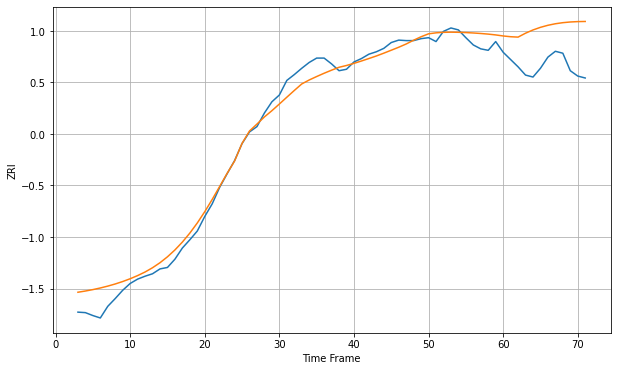

Wall time: 5.5 s
94565 22.106818085800533 80.9525541837376 [2037.53709049 2035.9718544  2035.17461084 2043.22170504 2049.90833253
 2055.31209212 2059.52961172 2062.6768121  2064.88735976 2066.30800869
 2067.09086275 2067.38368615]

Got an mse at 0.0098 in round 212 and stopped training



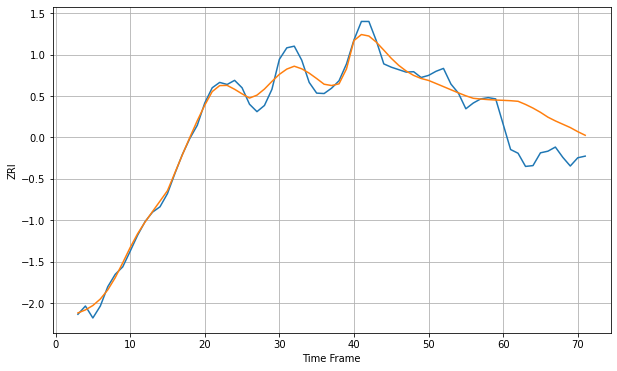

Wall time: 9.92 s
94568 20.66751966316696 99.08349964150032 [2762.46167675 2761.57533865 2760.14906079 2752.51357835 2743.65099178
 2733.41064087 2721.62742212 2712.52333471 2704.4444394  2696.35957338
 2686.43632263 2677.6146779 ]

Got an mse at 0.0098 in round 31 and stopped training



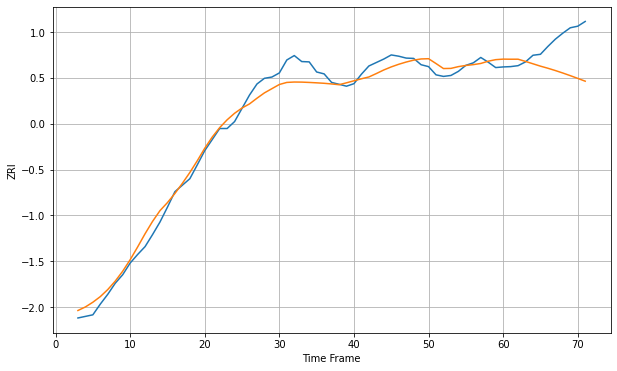

Wall time: 6.17 s
94603 30.49150830691471 100.17198516074114 [2402.73403544 2402.42972144 2402.49625209 2395.43479679 2387.94596472
 2380.47369607 2373.82988057 2366.55486769 2358.71456228 2350.40498628
 2341.74203722 2332.85190541]

Got an mse at 0.0099 in round 41 and stopped training



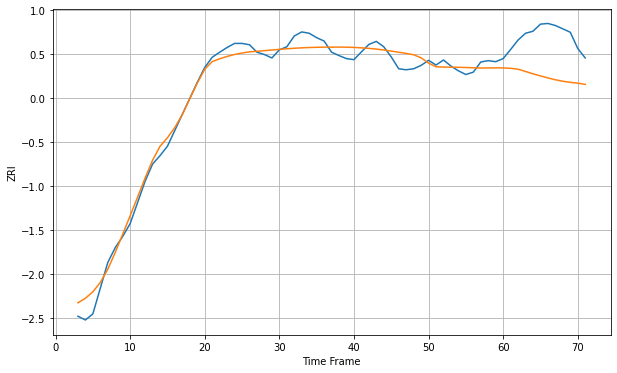

Wall time: 6.28 s
94608 25.80709951539037 121.6761905794188 [2771.54091776 2770.34055575 2767.66901846 2761.02800055 2754.03815126
 2748.01001331 2741.81847318 2736.50681959 2732.11020196 2728.7861194
 2726.44904326 2722.84191211]

Got an mse at 0.0097 in round 35 and stopped training



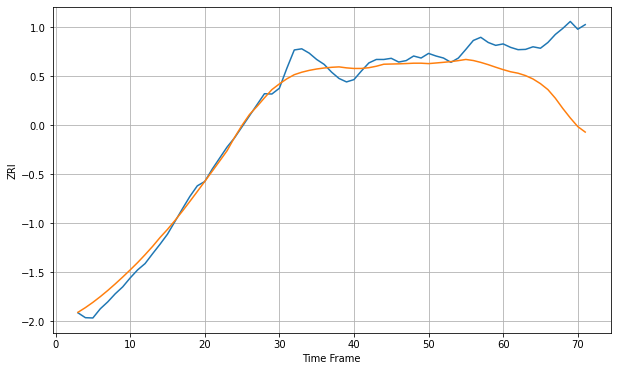

Wall time: 6.25 s
94621 35.456126724192764 219.29532315668462 [2441.67650385 2434.27353667 2429.21322861 2420.96280455 2409.25912609
 2392.98594833 2372.32636024 2342.25460299 2306.69712422 2273.84775249
 2243.91792848 2224.77943572]

Got an mse at 0.0099 in round 53 and stopped training



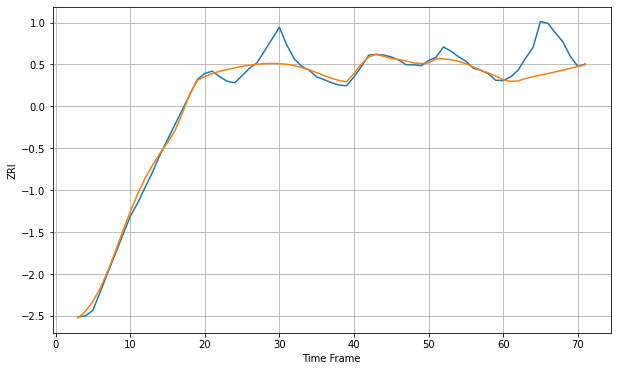

Wall time: 6.53 s
94703 25.387003125546475 85.99097160749307 [2765.57435114 2760.26447424 2761.6757029  2769.58184056 2775.02226724
 2779.94007911 2784.71155089 2789.81395622 2795.2822704  2801.12361613
 2806.5407705  2811.85267522]

Got an mse at 0.0099 in round 44 and stopped training



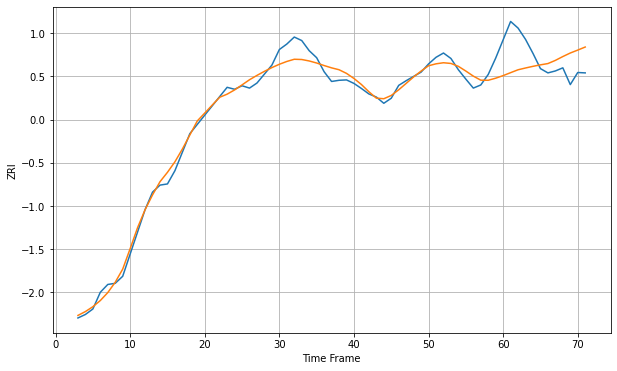

Wall time: 6.34 s
94801 20.22916552648953 70.81493221687347 [2236.06676357 2243.59521232 2251.02239439 2255.58736977 2259.87140213
 2263.65355287 2266.95255509 2275.1065933  2284.95437572 2294.04362261
 2301.54604811 2309.38776442]

Got an mse at 0.0100 in round 70 and stopped training



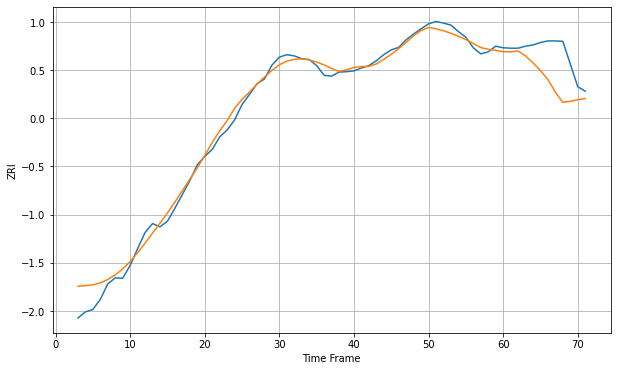

Wall time: 7.08 s
94806 20.960767016399064 73.67397628585195 [2135.45393413 2134.92207635 2137.26174587 2125.07022161 2107.7756174
 2089.01576261 2066.66851459 2035.52233135 2010.34662318 2012.85960302
 2016.98823447 2019.77026304]

Got an mse at 0.0099 in round 26 and stopped training



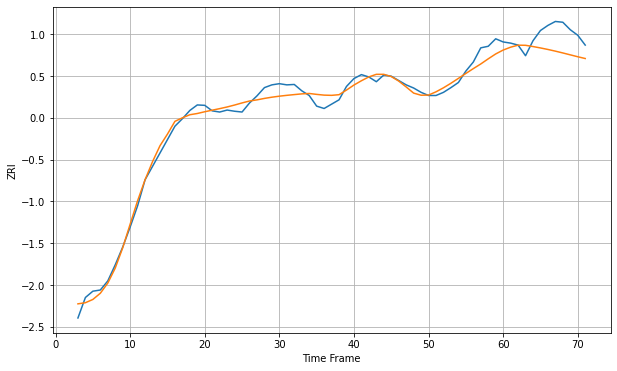

Wall time: 5.81 s
94901 17.81547626379765 47.52777187137867 [2614.38145629 2621.6803536  2626.81510104 2626.47342827 2623.30515574
 2619.77739763 2615.89075077 2611.63316811 2607.03361048 2602.21773168
 2597.41904775 2592.91069882]

Got an mse at 0.0100 in round 42 and stopped training



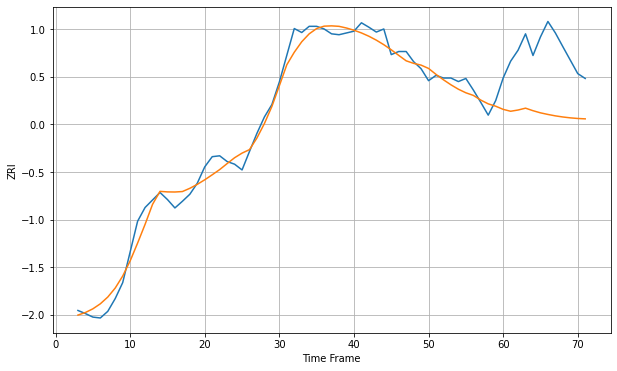

Wall time: 6.25 s
94903 21.855842512142186 144.367640031987 [2576.10672474 2571.79902681 2574.61394978 2578.80737907 2573.06540025
 2568.2262467  2564.58830731 2561.38029153 2558.84628438 2556.87493267
 2555.45973249 2554.60318702]


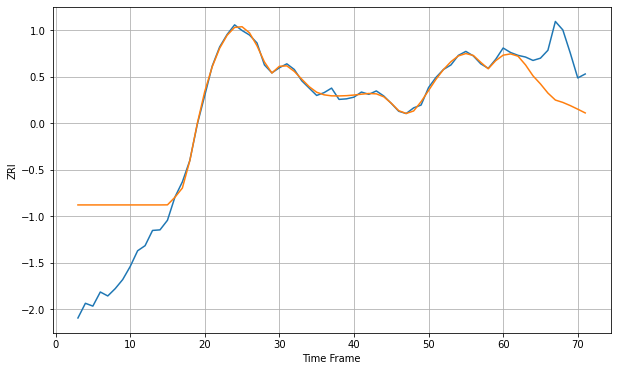

Wall time: 15.6 s
95008 62.26625675706491 71.41646097632447 [2618.32657157 2620.57183377 2616.44847313 2601.07401697 2581.75156427
 2567.43736229 2551.23506097 2538.88174207 2534.66017188 2529.0276752
 2522.68001506 2516.05823843]

Got an mse at 0.0099 in round 34 and stopped training



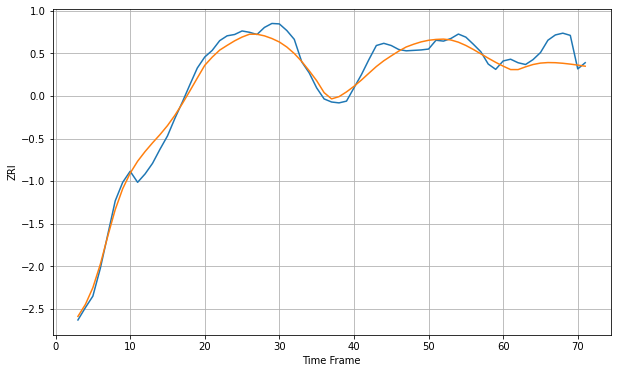

Wall time: 6.22 s
95014 21.84638656424097 37.86028546505428 [3197.27501518 3189.49286277 3189.46992189 3195.67176307 3200.95165164
 3204.19056642 3205.38431655 3205.07061526 3203.78008238 3201.88418308
 3199.61950747 3197.13566939]

Got an mse at 0.0094 in round 82 and stopped training



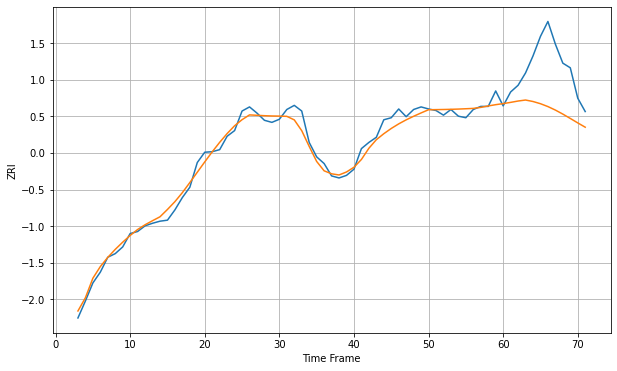

Wall time: 6.91 s
95050 13.620175723920287 89.21715563750472 [2680.38512898 2682.81676551 2685.43074319 2687.38629816 2684.52084396
 2680.24753071 2674.66677981 2667.86111349 2660.04872028 2651.59360306
 2642.95522407 2634.59861017]

Got an mse at 0.0100 in round 33 and stopped training



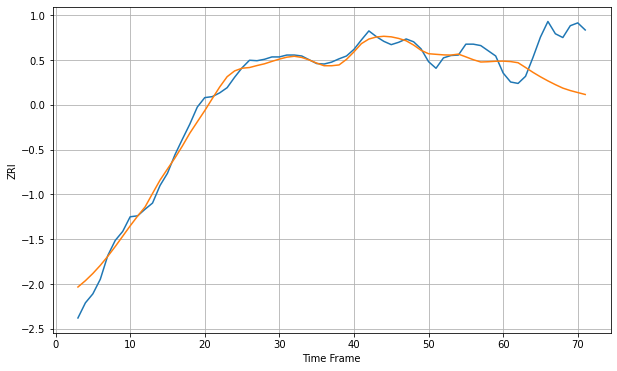

Wall time: 6.37 s
95051 18.90436971978096 96.05198608419802 [2828.13220058 2827.18858586 2824.74751741 2814.72434299 2804.38097863
 2794.97903712 2786.35865343 2778.41335159 2771.08378355 2765.89061033
 2761.70332695 2757.6028261 ]

Got an mse at 0.0096 in round 34 and stopped training



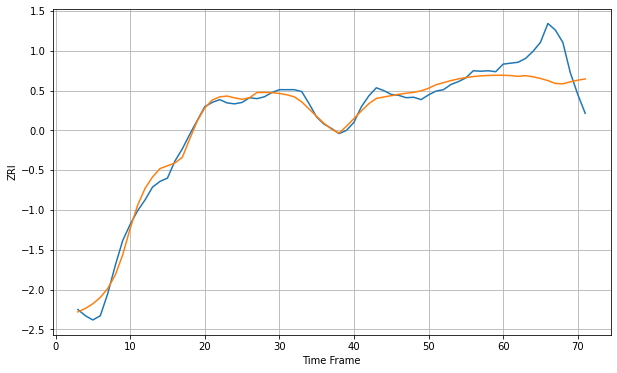

Wall time: 6.04 s
95112 14.529914543086862 66.92677884799885 [2559.48123262 2558.81257139 2557.21501089 2558.70192198 2556.29497686
 2552.74860779 2548.09461412 2542.10333975 2541.38579527 2545.51603942
 2549.00956973 2551.7185975 ]

Got an mse at 0.0099 in round 72 and stopped training



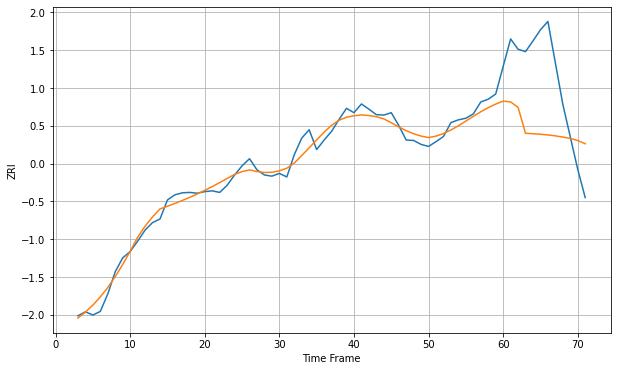

Wall time: 7.07 s
95116 18.788579643835458 174.88813213976596 [2553.16360747 2551.16109568 2537.54277921 2472.17568963 2470.8637764
 2469.60202085 2467.95148339 2465.61712521 2462.61844121 2459.1975138
 2453.82277103 2445.72114678]

Got an mse at 0.0099 in round 48 and stopped training



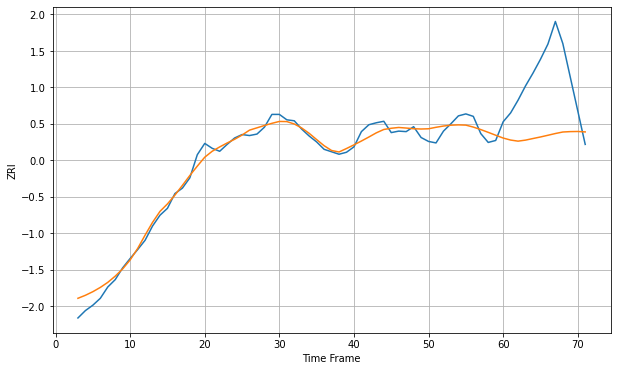

Wall time: 6.26 s
95117 14.98547790240272 128.84367526655018 [2518.92508591 2514.83615681 2512.60025743 2514.71919747 2517.93585408
 2521.08737605 2524.56270721 2528.11385664 2531.19158692 2532.0001443
 2532.26471085 2531.38658414]

Got an mse at 0.0098 in round 55 and stopped training



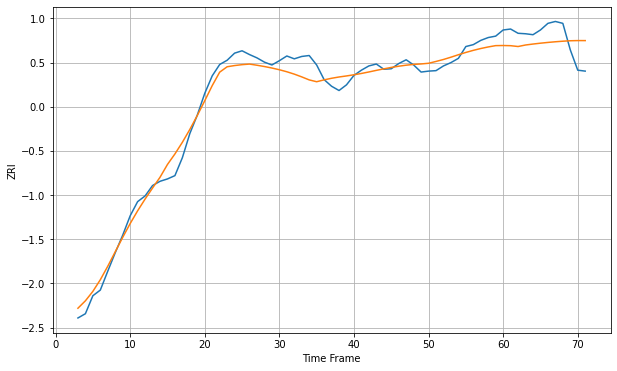

Wall time: 6.81 s
95123 20.227426035107577 38.9280450113621 [2765.13107393 2764.77346021 2763.01942158 2766.22768414 2768.25142908
 2770.06206418 2771.66697995 2773.06731515 2774.25486568 2775.20721539
 2775.58038779 2775.53666876]

Got an mse at 0.0100 in round 36 and stopped training



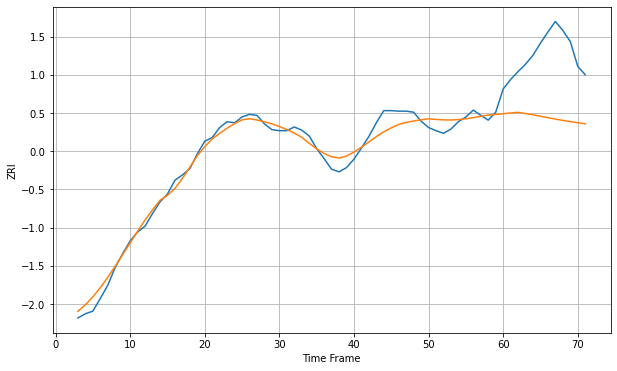

Wall time: 5.94 s
95128 14.805273628252221 124.38283043045479 [2540.08872408 2541.53816403 2542.7742007  2540.58952936 2538.07054336
 2535.37311864 2532.64162813 2529.9891006  2527.49385316 2525.1938667
 2523.08296937 2521.11726932]

Got an mse at 0.0098 in round 52 and stopped training



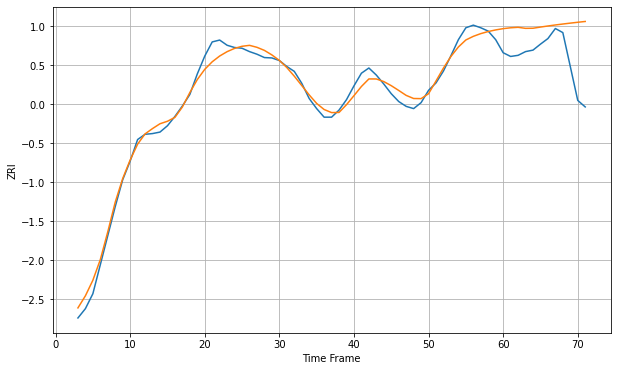

Wall time: 6.45 s
95134 20.11731668951549 106.90272403516165 [3164.62656086 3166.94724748 3168.20865453 3165.43885205 3165.71931203
 3168.8621552  3171.77479536 3174.49057003 3177.03916349 3179.44550288
 3181.72943995 3183.90572544]

Got an mse at 0.0099 in round 37 and stopped training



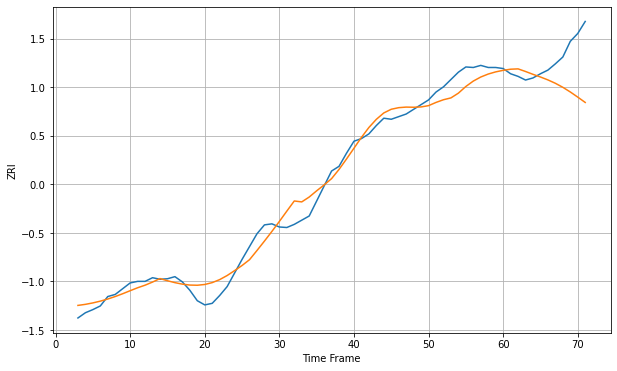

Wall time: 5.98 s
95207 20.891079340724712 67.01425285970728 [1236.54779462 1238.6891073  1239.34076774 1234.35115244 1228.9010341
 1223.81293137 1218.23881617 1211.77411861 1204.10156695 1195.17552801
 1185.33779832 1175.15189919]

Got an mse at 0.0097 in round 35 and stopped training



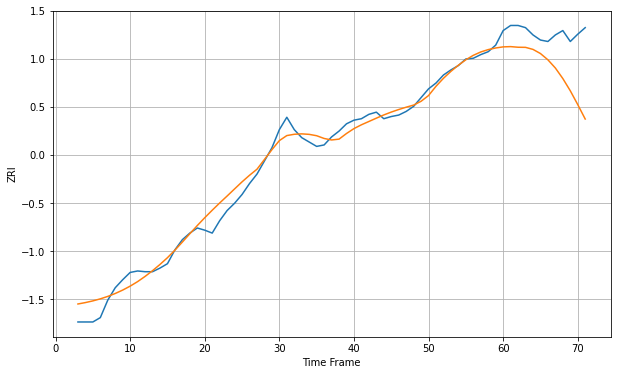

Wall time: 6.01 s
95608 12.81343277423002 58.018609012453155 [1423.60260485 1423.96601656 1423.11440258 1422.95735553 1420.14250854
 1414.46456622 1405.84864905 1394.57483459 1380.12863011 1363.3431532
 1344.36084486 1324.55954453]

Got an mse at 0.0096 in round 38 and stopped training



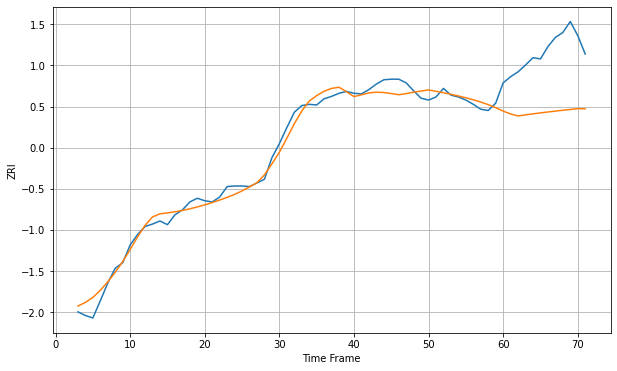

Wall time: 6.13 s
95678 12.227917451805967 99.20542589178882 [1654.95359499 1650.35028331 1647.06276781 1648.87145546 1650.53050969
 1652.07755903 1653.54855278 1654.97129086 1656.35902779 1657.70416824
 1658.97509015 1658.72095807]

Got an mse at 0.0093 in round 23 and stopped training



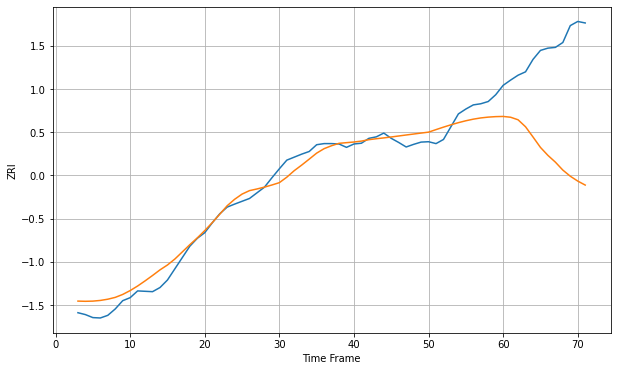

Wall time: 6.05 s
95816 26.86213272973722 285.5156850706474 [1409.26464353 1407.14594271 1400.36441022 1381.79680395 1354.66798746
 1326.85727164 1305.67593716 1287.66852881 1266.54171192 1250.21109341
 1237.26090173 1226.66629951]

Got an mse at 0.0099 in round 51 and stopped training



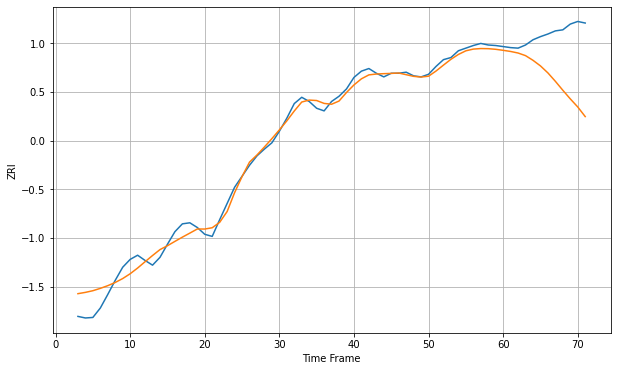

Wall time: 7.15 s
95826 16.401414506093253 96.89944346603572 [1432.8184316  1430.63057536 1427.66004973 1422.65585251 1413.72024978
 1403.02686108 1389.60074719 1373.54902255 1356.43678968 1339.96041348
 1324.48869645 1306.10906348]

Got an mse at 0.0098 in round 17 and stopped training



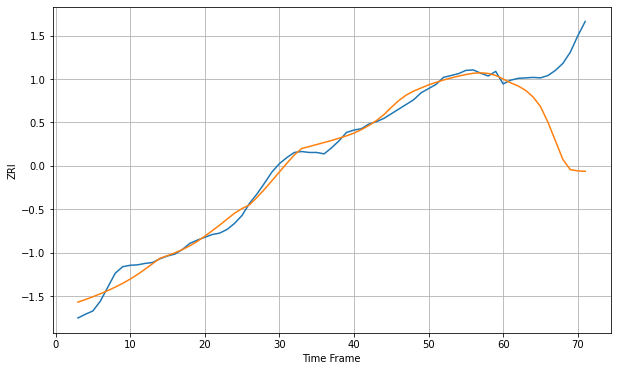

Wall time: 5.27 s
95831 15.099161415860415 166.38757023124316 [1545.67354468 1537.4312261  1530.69005708 1521.27090367 1507.33313947
 1486.54846327 1453.11902079 1413.1814941  1373.2672701  1351.15413906
 1348.48774302 1347.61550042]

Got an mse at 0.0095 in round 35 and stopped training



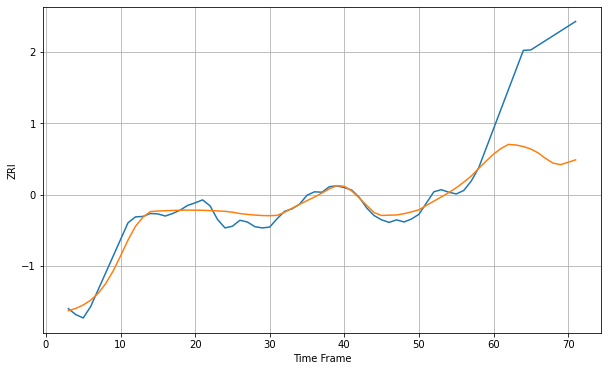

Wall time: 6.31 s
95928 18.019653630631403 242.42316685384833 [1425.6748515  1438.94122371 1448.61792616 1447.19892262 1443.57470438
 1437.80453242 1428.37760835 1415.28663534 1404.40368842 1400.976279
 1406.45698415 1412.19006534]

Got an mse at 0.0100 in round 42 and stopped training



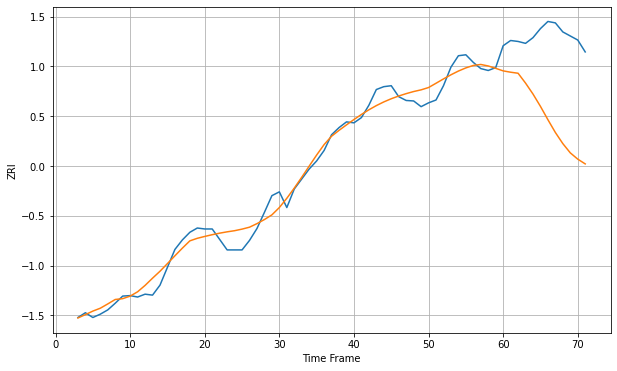

Wall time: 6.17 s
96150 20.68526391841415 179.9104371711895 [1646.17400464 1643.38857189 1641.20760652 1620.51472608 1597.49980256
 1571.58024596 1543.57889254 1516.71058991 1493.34520976 1473.92362227
 1460.72382065 1450.72460973]

Got an mse at 0.0099 in round 72 and stopped training



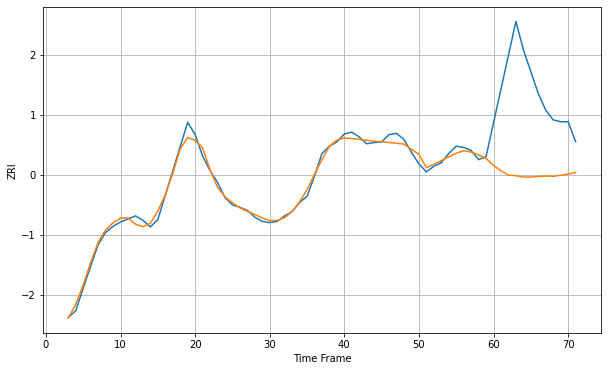

Wall time: 6.93 s
96826 7.7191648242368425 145.5099169440305 [1518.6679671  1509.6704945  1502.72682254 1501.74492504 1499.56796983
 1499.4995698  1500.41102094 1501.11216645 1500.79132653 1502.49883287
 1504.39724452 1506.93582878]

Got an mse at 0.0098 in round 39 and stopped training



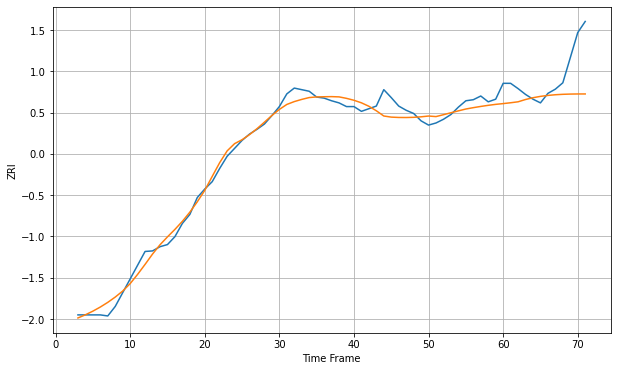

Wall time: 6.21 s
97030 14.46255142908635 58.68040911886414 [1358.64445474 1360.23981372 1362.05261053 1366.39238735 1369.77120041
 1372.30441181 1374.13604078 1375.40239486 1376.21324431 1376.66918997
 1376.8694325  1376.89209357]

Got an mse at 0.0095 in round 26 and stopped training



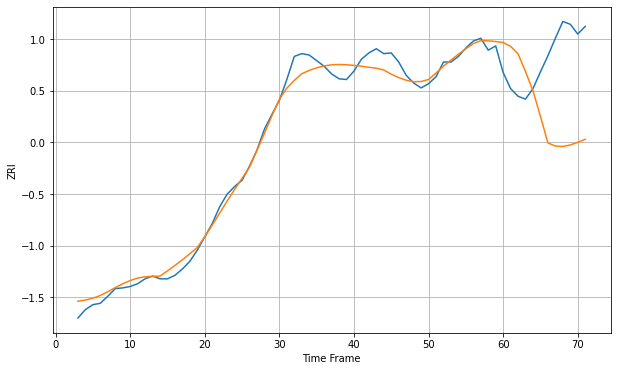

Wall time: 5.64 s
97035 13.039059979604222 117.56601096926785 [1595.7850612  1590.43017129 1579.6494857  1554.17654545 1526.7507171
 1490.37513389 1452.27191425 1447.82132496 1447.25180593 1449.45685688
 1453.22158007 1457.4437519 ]

Got an mse at 0.0099 in round 61 and stopped training



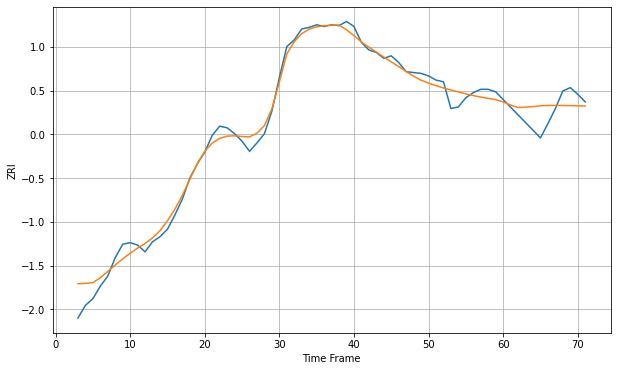

Wall time: 6.89 s
97062 10.748008925881928 18.59666474015817 [1443.92110561 1440.21198584 1437.28141196 1437.73610722 1438.29070546
 1439.2964982  1439.75812518 1439.72355372 1439.64239653 1439.50939956
 1439.32199487 1439.07943654]

Got an mse at 0.0099 in round 97 and stopped training



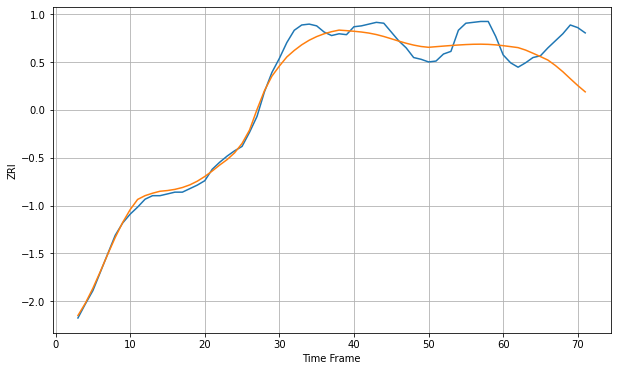

Wall time: 7.16 s
97070 11.109642723315957 37.144709822681385 [1363.4835098  1362.40461104 1361.26874548 1358.51199539 1354.87675684
 1351.09595302 1347.11716072 1340.97813888 1333.89143188 1325.96452148
 1318.20877866 1311.01564497]

Got an mse at 0.0095 in round 38 and stopped training



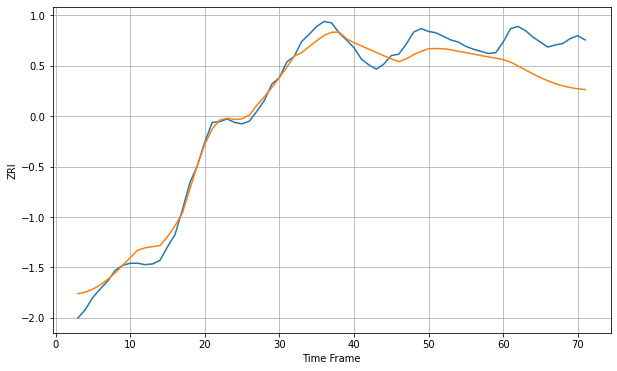

Wall time: 6.46 s
97124 14.775548469171534 56.36244426796519 [1485.38802142 1481.7924642  1476.34738536 1470.78669364 1465.26242151
 1460.09511561 1455.50172414 1451.59808876 1448.43360419 1446.01216483
 1444.29705169 1443.21646486]

Got an mse at 0.0098 in round 75 and stopped training



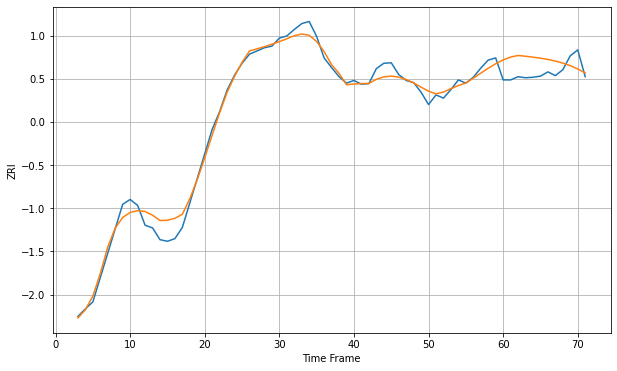

Wall time: 6.75 s
97209 14.91425870819006 31.621862603814293 [1764.4032323  1769.55943333 1772.60815659 1771.11349207 1769.45235368
 1767.51822877 1765.14855451 1762.16385668 1758.36393238 1753.51608339
 1747.39877642 1740.01787785]

Got an mse at 0.0098 in round 74 and stopped training



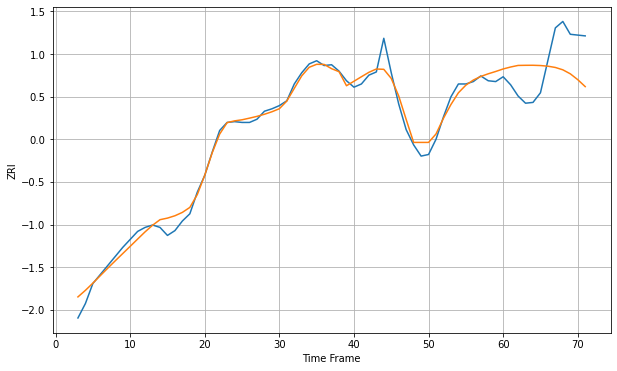

Wall time: 6.84 s
97214 9.931812776550535 44.01555387895961 [1589.72915308 1592.16534142 1594.13245266 1594.29287371 1594.33729309
 1594.01030896 1593.18623407 1591.58835166 1588.66907568 1583.67941934
 1576.3801292  1567.69904404]

Got an mse at 0.0098 in round 53 and stopped training



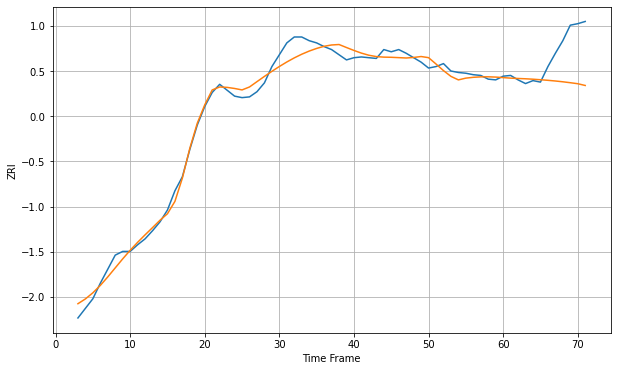

Wall time: 6.48 s
97229 10.468283554926412 45.70093236260522 [1441.07912683 1440.34583616 1439.89505516 1439.48862885 1438.90846999
 1438.20588472 1437.40470524 1436.48997939 1435.4183893  1434.1656167
 1432.81029285 1430.43104129]

Got an mse at 0.0099 in round 118 and stopped training



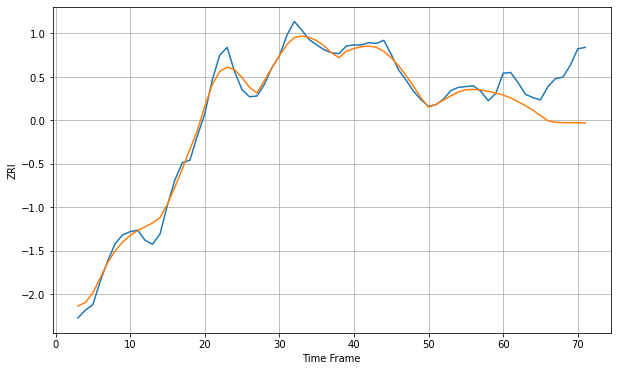

Wall time: 7.79 s
97239 9.957156650738046 54.07997176852574 [1609.15292614 1605.56406421 1600.78124644 1595.65650867 1589.84008394
 1583.03637027 1576.53275895 1574.50949273 1574.00660965 1573.90979848
 1573.95258016 1573.57763726]

Got an mse at 0.0099 in round 125 and stopped training



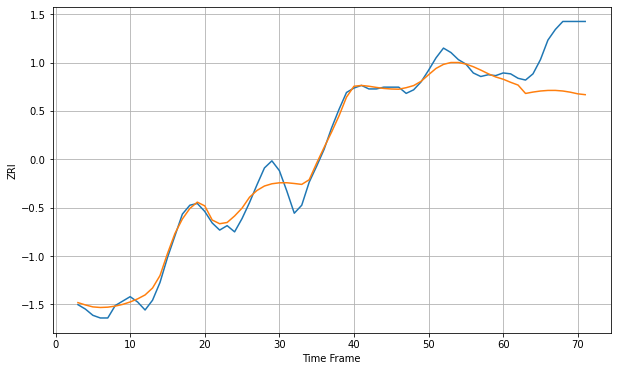

Wall time: 8.04 s
97401 10.014110348224767 54.732786420588205 [1273.96060271 1270.47779252 1267.35134428 1257.89711383 1259.47517104
 1260.65720492 1261.31603634 1261.34258278 1260.67903915 1259.33753791
 1257.48944694 1256.53931374]

Got an mse at 0.0099 in round 20 and stopped training



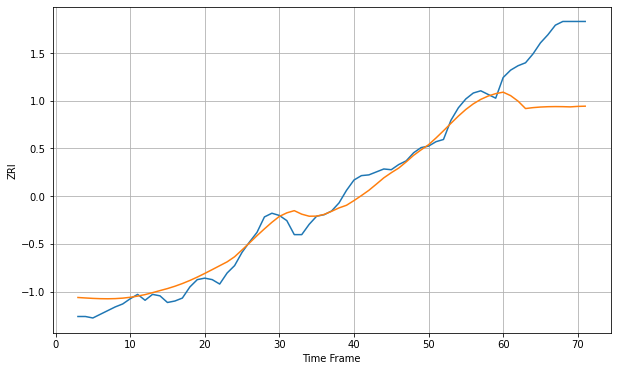

Wall time: 5.41 s
97402 14.363381918811958 89.22372129212228 [1127.13124356 1122.45500118 1114.99010145 1104.93360009 1106.1806551
 1106.9844085  1107.43434852 1107.59080119 1107.49195059 1107.19697021
 1107.86023489 1108.14390686]

Got an mse at 0.0099 in round 118 and stopped training



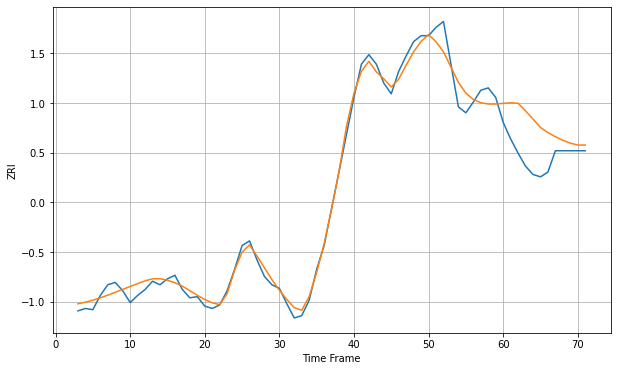

Wall time: 7.85 s
97477 7.6164445448235 29.517698124550165 [1085.96986296 1086.40955855 1086.07941897 1079.60634196 1072.75853854
 1065.60393005 1061.32512875 1057.82838494 1054.82219303 1052.41591846
 1050.78960108 1050.8238417 ]

Got an mse at 0.0100 in round 55 and stopped training



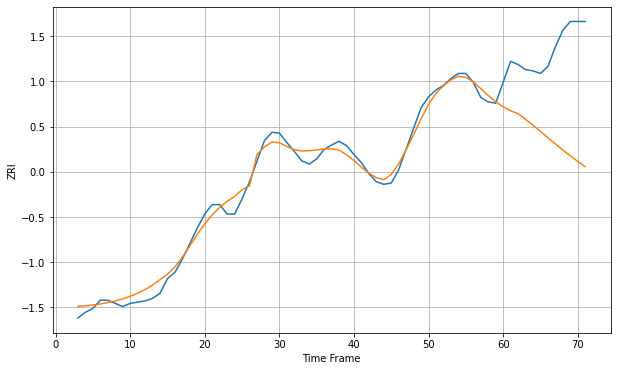

Wall time: 6.46 s
97501 11.776603267829897 145.3818718558666 [1097.36960398 1091.08221925 1086.48058504 1077.57473    1068.16937263
 1058.43279096 1048.55805653 1038.73711168 1029.13446786 1019.87521484
 1011.05716598 1002.78309469]

Got an mse at 0.0099 in round 83 and stopped training



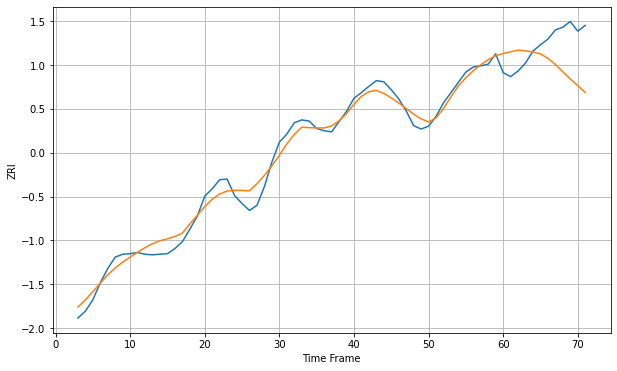

Wall time: 7.68 s
98004 15.544342164066324 64.12758769315542 [2293.65859718 2296.63510703 2299.539741   2298.40132743 2296.37093705
 2292.87741204 2285.30549984 2274.35994198 2261.45136344 2248.83215371
 2237.34973751 2225.14774073]

Got an mse at 0.0098 in round 70 and stopped training



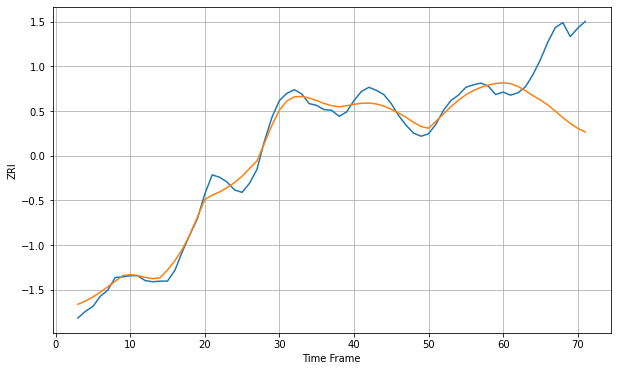

Wall time: 6.89 s
98005 13.630671134672319 109.16154253242823 [1975.49536573 1974.00059545 1969.40745134 1962.15130841 1954.06533055
 1947.05455222 1938.5302486  1928.34328854 1917.82694864 1908.17011984
 1900.13521661 1893.98280342]

Got an mse at 0.0098 in round 31 and stopped training



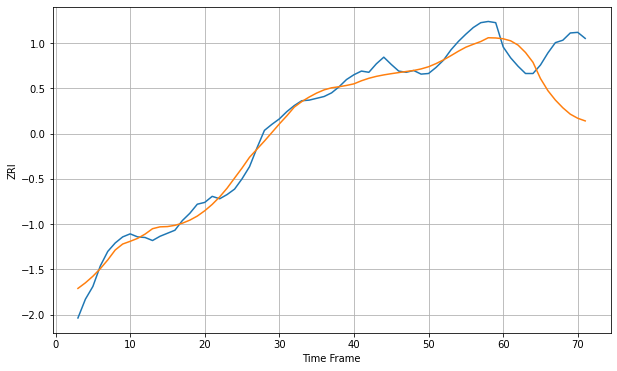

Wall time: 6.08 s
98012 15.719794355176221 84.81874251366361 [1790.40763465 1787.05327409 1779.90409866 1767.65370671 1751.47911325
 1724.75076922 1704.64975153 1689.13110359 1676.37000965 1665.78253391
 1659.03015886 1654.65662097]

Got an mse at 0.0100 in round 165 and stopped training



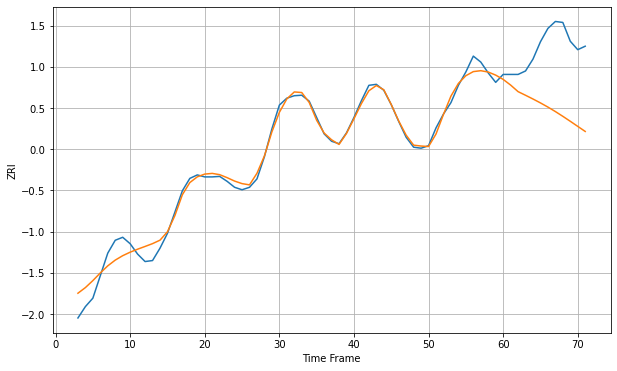

Wall time: 8.44 s
98029 16.22954443772913 129.12809725680833 [2110.98199155 2099.52690225 2086.24967645 2078.89484945 2071.34656327
 2063.4589926  2055.0430614  2046.0001349  2036.37429549 2026.32525039
 2016.06683134 2005.81145515]

Got an mse at 0.0097 in round 52 and stopped training



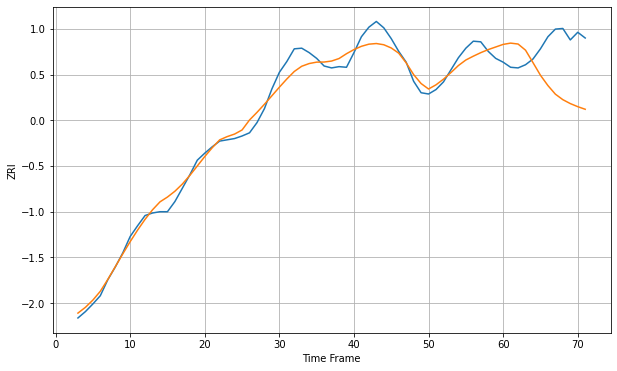

Wall time: 6.45 s
98034 14.666327105607415 76.91680806933267 [1859.96362034 1861.963724   1860.53985964 1850.86505033 1831.30702613
 1811.4759597  1795.28681731 1781.75118055 1773.09300437 1766.95224735
 1762.09502896 1758.00359701]

Got an mse at 0.0098 in round 64 and stopped training



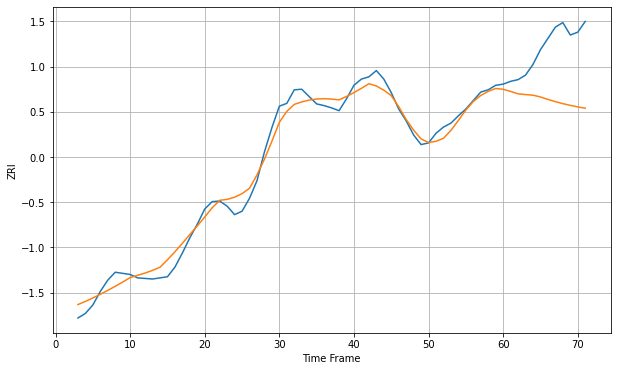

Wall time: 6.72 s
98052 15.983250552925838 99.36596843622463 [2111.90652414 2108.17733712 2103.88140293 2102.56537624 2101.43011495
 2098.36306585 2093.96873346 2090.00800391 2086.51006847 2083.44618112
 2080.75257652 2078.35080086]

Got an mse at 0.0098 in round 46 and stopped training



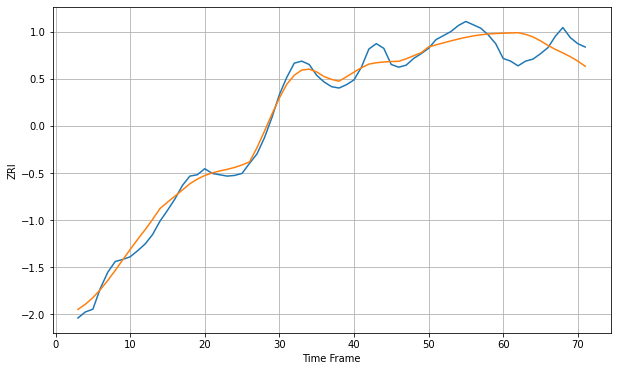

Wall time: 6.23 s
98056 12.478165749981041 32.59803146807799 [1671.53541775 1671.91384523 1672.28372689 1669.83103976 1666.00665536
 1660.20607884 1653.434815   1647.49982258 1642.25608116 1636.65935525
 1630.07877826 1622.35682511]

Got an mse at 0.0099 in round 25 and stopped training



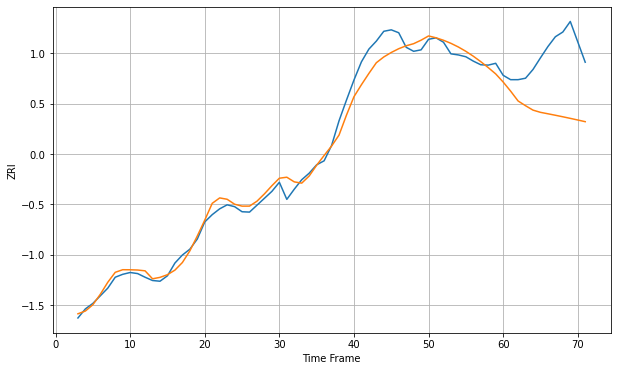

Wall time: 6.15 s
98101 27.18494879415891 164.36275485847617 [2549.562667   2524.55296579 2497.48982632 2484.41546256 2472.30905845
 2466.23938985 2462.26878005 2458.20385886 2453.99623174 2449.63746238
 2445.1447105  2440.54722256]

Got an mse at 0.0099 in round 84 and stopped training



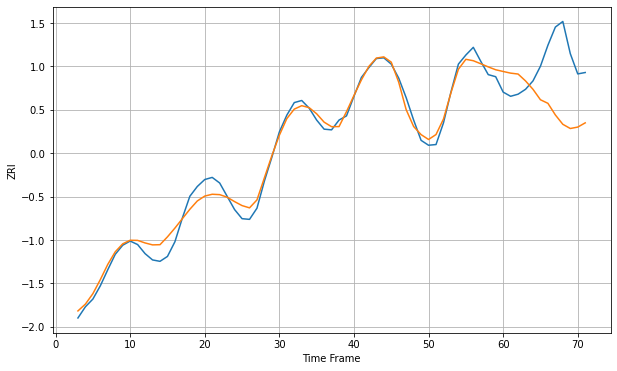

Wall time: 7.18 s
98102 11.788555997543344 77.53032095169227 [2021.47907663 2019.12184915 2017.82062928 2007.97660278 1995.97814018
 1981.03565579 1975.95797637 1959.30464425 1945.94719222 1939.93997021
 1941.96498082 1948.00582319]

Got an mse at 0.0098 in round 34 and stopped training



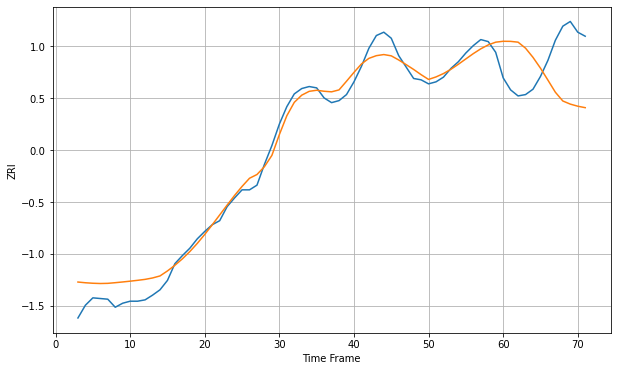

Wall time: 6.34 s
98103 18.236217013689732 81.56041494684203 [1945.46859143 1945.32431225 1944.14320205 1935.18078262 1921.48561534
 1905.42550155 1887.57013688 1869.48019708 1856.44818045 1851.79914084
 1848.68617285 1846.49857147]

Got an mse at 0.0099 in round 56 and stopped training



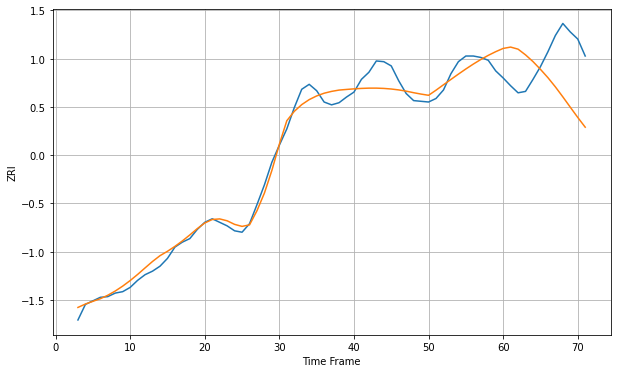

Wall time: 6.46 s
98105 13.7886422918279 72.40132797089558 [1860.7153936  1862.63327553 1859.69450243 1851.62001182 1842.10846847
 1831.18022441 1819.42250595 1806.38721662 1792.27793924 1777.67711882
 1763.21183275 1749.42551424]

Got an mse at 0.0098 in round 98 and stopped training



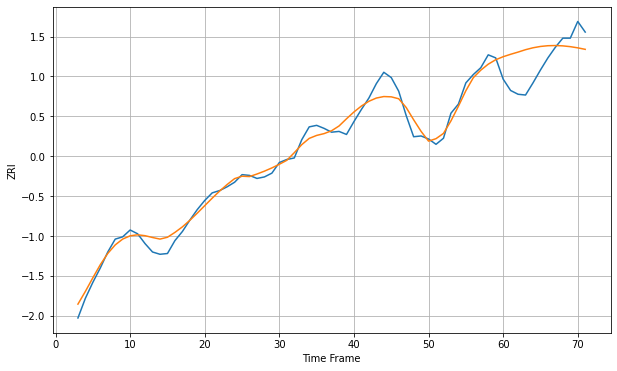

Wall time: 7.43 s
98107 11.0070939007323 35.52034605603367 [1965.51226608 1968.70565116 1971.61998555 1974.78331212 1977.2916298
 1979.04345762 1980.017585   1980.25337844 1979.81662977 1978.77692991
 1977.21507923 1975.24019846]

Got an mse at 0.0098 in round 53 and stopped training



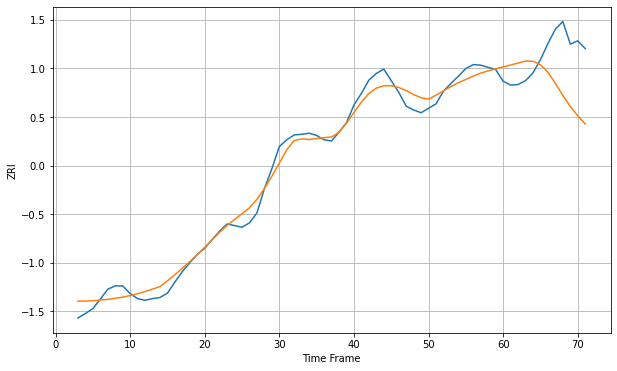

Wall time: 6.52 s
98109 16.436857346581736 84.19017082752235 [2085.88324045 2089.25295578 2092.84475936 2096.48496577 2095.99272603
 2089.70228684 2076.19142208 2056.28847914 2034.18971083 2014.24995668
 1997.53130653 1982.70929391]

Got an mse at 0.0098 in round 75 and stopped training



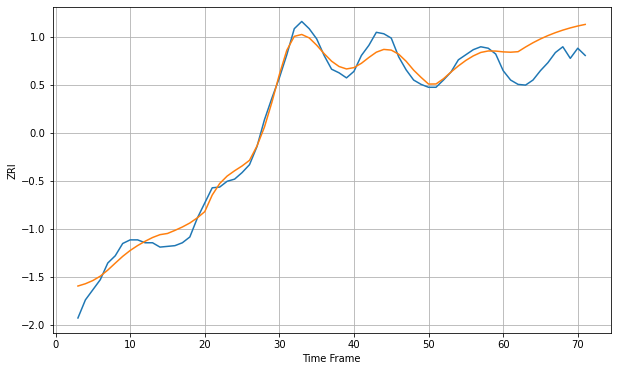

Wall time: 6.65 s
98115 13.179728472080372 39.58429723167554 [1863.95878893 1863.48956481 1864.20553158 1870.65607972 1876.5794493
 1881.84418076 1886.4625216  1890.50473201 1894.03630399 1897.09987057
 1899.72086185 1901.91790498]

Got an mse at 0.0098 in round 55 and stopped training



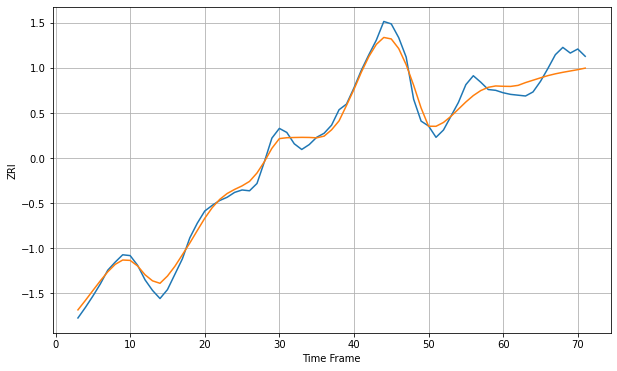

Wall time: 6.73 s
98119 10.21085618312852 17.667611838666765 [1899.97933871 1899.82269194 1901.10832709 1904.55642493 1907.46887951
 1910.40074036 1913.14134482 1915.37439022 1917.23408953 1918.87080057
 1920.50495529 1922.39685089]

Got an mse at 0.0098 in round 49 and stopped training



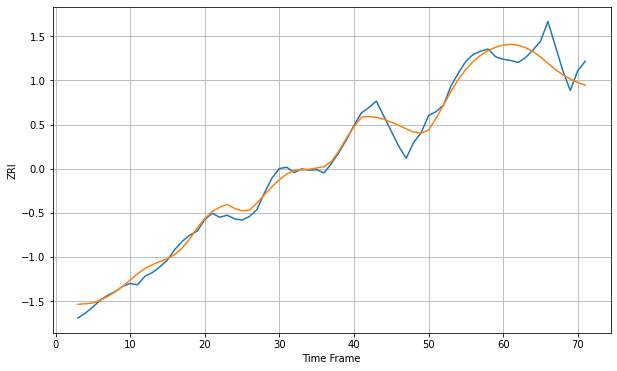

Wall time: 6.17 s
98121 20.34159486278408 46.41119227629528 [2346.95404394 2348.72650356 2346.66165585 2340.42826275 2330.96934579
 2317.72224767 2302.07409009 2286.77998388 2273.73321246 2263.24918903
 2254.87244002 2248.07094092]

Got an mse at 0.0100 in round 99 and stopped training



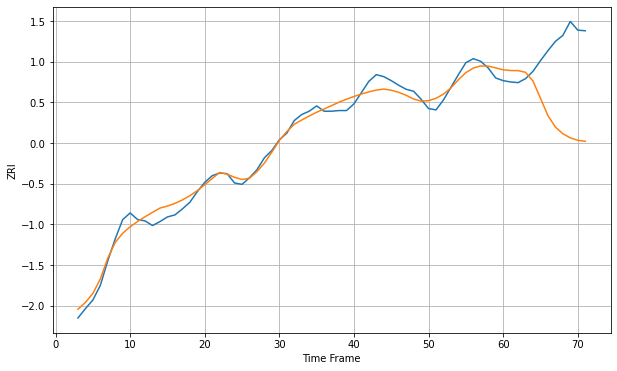

Wall time: 7.64 s
98122 11.228535208550023 107.28066736223013 [1905.27945095 1904.21227176 1904.05147936 1901.48783478 1888.31410998
 1862.58675043 1836.4125578  1819.24230556 1809.14398054 1802.93765054
 1799.22756482 1797.73566366]

Got an mse at 0.0099 in round 40 and stopped training



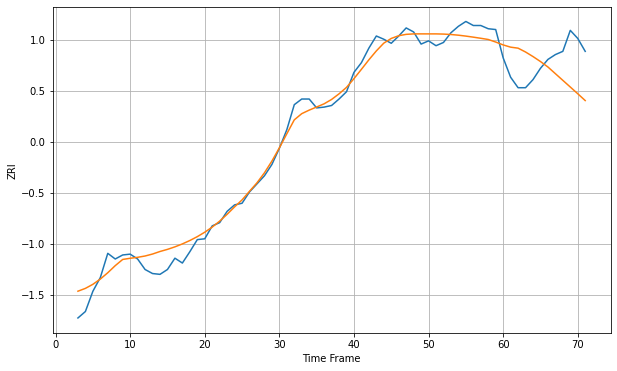

Wall time: 6.19 s
98133 13.123225435890987 42.938306973012565 [1746.97679172 1744.20240816 1742.95551091 1738.2116707  1732.56957939
 1726.42236156 1719.65820707 1711.38628176 1703.117925   1694.85784454
 1686.55126678 1678.09778852]

Got an mse at 0.0099 in round 42 and stopped training



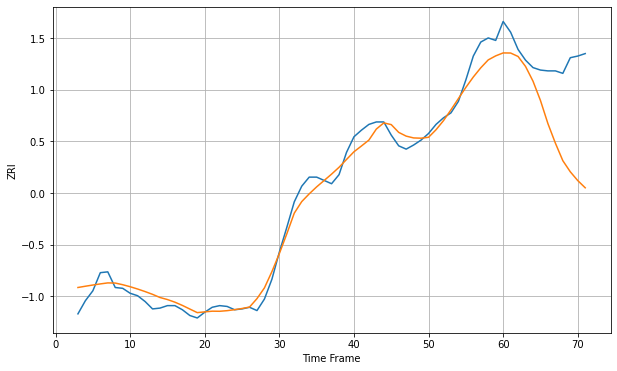

Wall time: 6.46 s
98201 12.936859490537806 89.19988768343431 [1455.80505836 1455.68978089 1451.49834552 1439.38975922 1421.54321571
 1398.07761644 1370.0142635  1346.30735061 1324.98106887 1311.48773059
 1300.81821097 1292.05852081]

Got an mse at 0.0096 in round 37 and stopped training



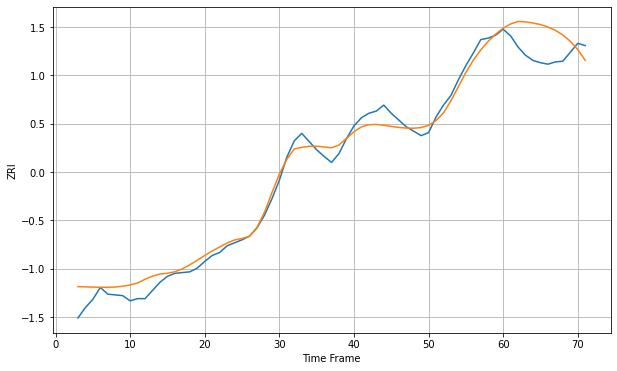

Wall time: 5.99 s
98203 13.143640154850216 35.15421175435035 [1542.33599783 1548.05193282 1551.37977094 1550.83497306 1549.35122304
 1547.19408156 1544.0067336  1539.43473581 1533.15352046 1524.79073565
 1513.69868856 1499.06704084]

Got an mse at 0.0100 in round 75 and stopped training



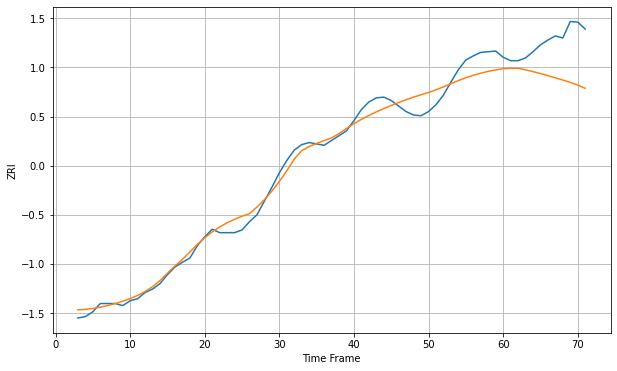

Wall time: 7.09 s
98204 14.200737593114894 55.63471553504818 [1425.33681563 1425.93487833 1426.00450304 1423.70587939 1421.11553483
 1418.28393894 1415.26947966 1412.12630178 1408.87068163 1405.4190638
 1401.53336778 1396.87882896]

Got an mse at 0.0093 in round 24 and stopped training



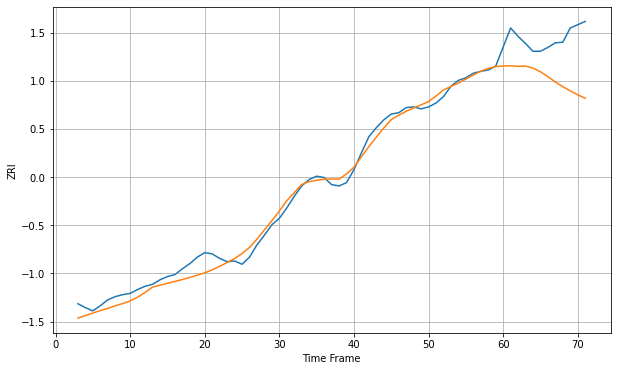

Wall time: 5.58 s
98405 11.638388850959002 67.68845982454825 [1243.19174372 1243.57802374 1242.82008258 1243.10785988 1239.91872586
 1234.36065533 1226.82588387 1218.40557372 1211.40106102 1204.68663802
 1198.67156501 1193.44974578]

Got an mse at 0.0097 in round 21 and stopped training



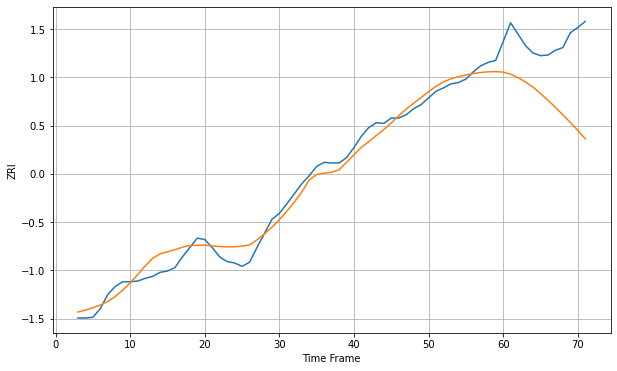

Wall time: 5.91 s
98409 14.384589545786804 97.68984403429108 [1248.50824641 1245.43344313 1240.29045096 1233.69606113 1226.07089744
 1216.67921044 1206.66382143 1195.96446596 1184.82703945 1173.50634218
 1161.72919514 1149.1476034 ]

Got an mse at 0.0097 in round 22 and stopped training



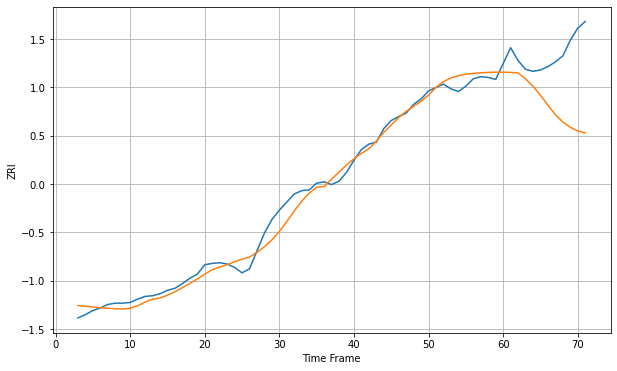

Wall time: 5.49 s
98444 12.207650843361776 86.72138763147662 [1236.72195425 1236.37081422 1235.61788838 1226.80957776 1215.82480092
 1202.57663585 1187.81786242 1173.61127488 1162.85580753 1154.90855926
 1149.41225417 1146.72385662]

Got an mse at 0.0099 in round 44 and stopped training



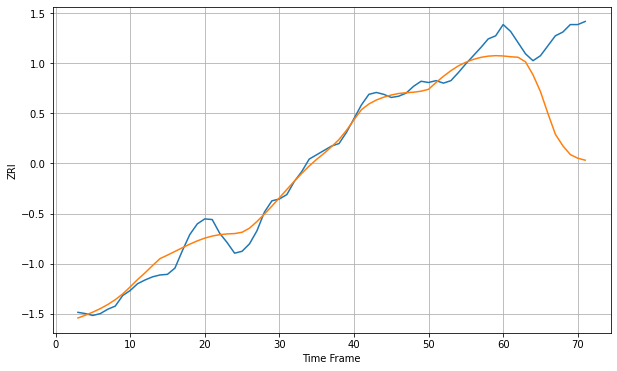

Wall time: 6.47 s
98466 15.009309340506558 134.7966337150443 [1360.63554318 1359.33423002 1358.53564504 1351.12211875 1330.38554024
 1303.39888752 1268.33307582 1234.93774846 1216.41342672 1202.35416278
 1196.45294075 1193.26241918]

Got an mse at 0.0099 in round 49 and stopped training



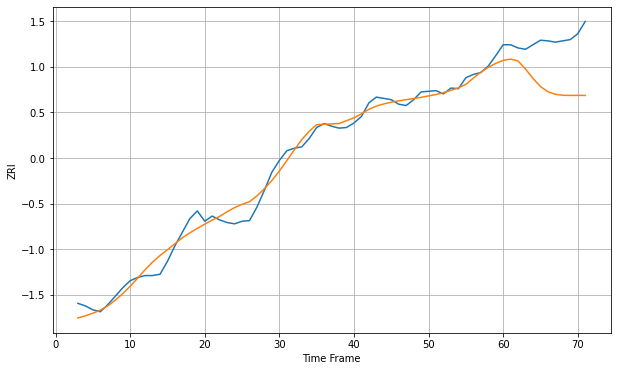

Wall time: 6.39 s
98498 12.521007820225655 70.53245498636045 [1378.86235538 1380.68988187 1377.89109953 1365.50644423 1350.82859019
 1338.34408887 1330.33490981 1326.31436254 1324.82877924 1324.58672482
 1324.68904778 1324.57834933]

Got an mse at 0.0100 in round 72 and stopped training



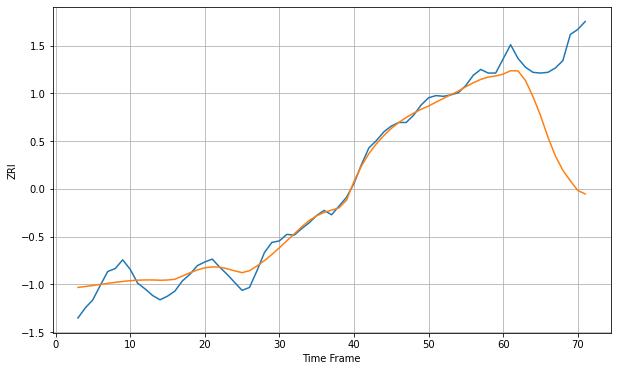

Wall time: 6.91 s
98499 13.285256824697962 128.46072205191015 [1278.533005   1283.25818215 1282.91510585 1269.58904904 1247.65850484
 1221.81530789 1191.93831468 1165.96511316 1146.23253795 1131.79675714
 1118.49274649 1113.68089216]

Got an mse at 0.0097 in round 46 and stopped training



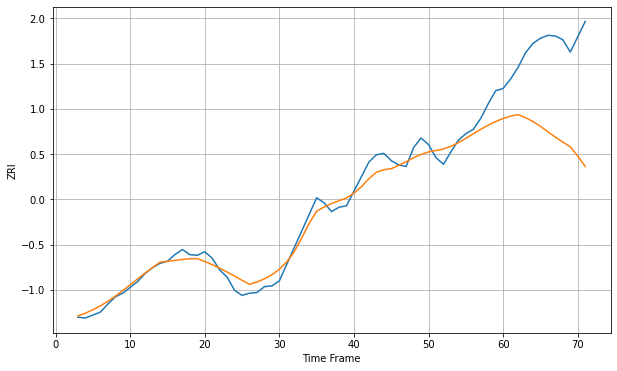

Wall time: 6.59 s
99207 13.197046280297567 123.28591383305192 [987.88177798 991.08976043 993.05513076 988.98999897 983.65201557
 977.02099692 969.61009842 962.24252036 955.37949438 949.0438621
 936.40750908 921.99155549]


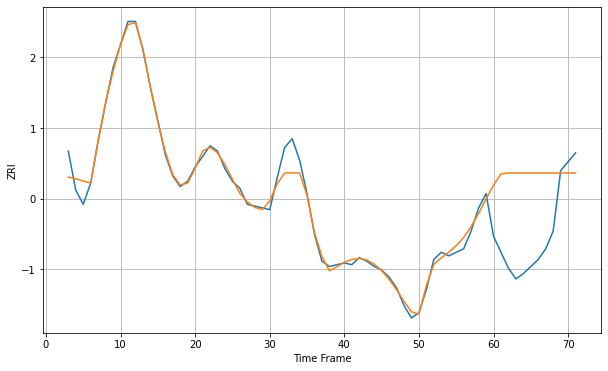

Wall time: 15.5 s
99501 4.75811357496908 41.46728086469964 [1271.80551686 1278.14299572 1278.67371312 1278.67371312 1278.67371312
 1278.67371312 1278.67371312 1278.67371312 1278.67371312 1278.67371312
 1278.67371312 1278.67371312]

Got an mse at 0.0099 in round 186 and stopped training



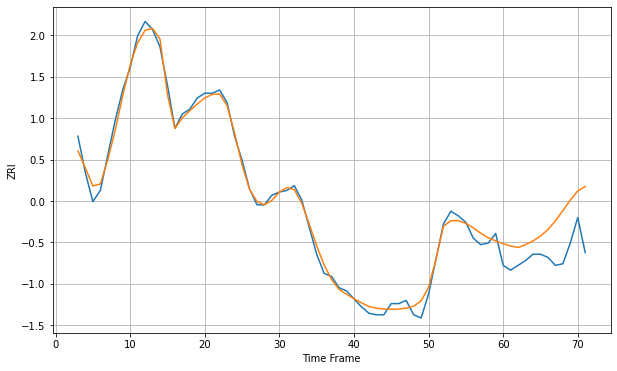

Wall time: 9.47 s
99504 4.107388702759276 21.894823426961246 [1429.62353849 1428.17153253 1427.19953115 1429.00117479 1431.28249765
 1434.32786504 1438.46464531 1443.87715914 1450.30081583 1456.90058493
 1462.67988896 1465.49091091]

Got an mse at 0.0099 in round 180 and stopped training



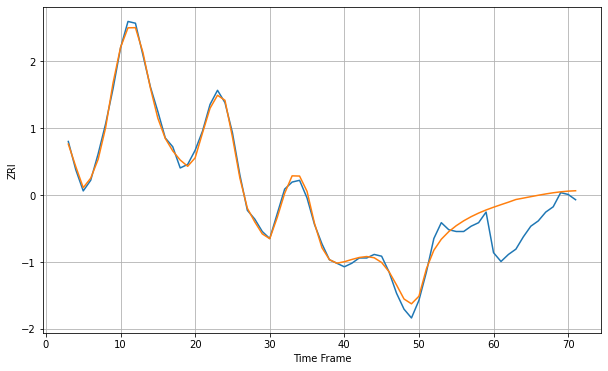

Wall time: 9.17 s
99508 3.2264442363658077 19.445319779822967 [1281.74620188 1283.20026125 1284.61154836 1286.12534114 1286.92202679
 1287.73231928 1288.52985143 1289.27763977 1289.93662012 1290.47157553
 1290.8580335  1291.08786297]

Got an mse at 0.0100 in round 138 and stopped training



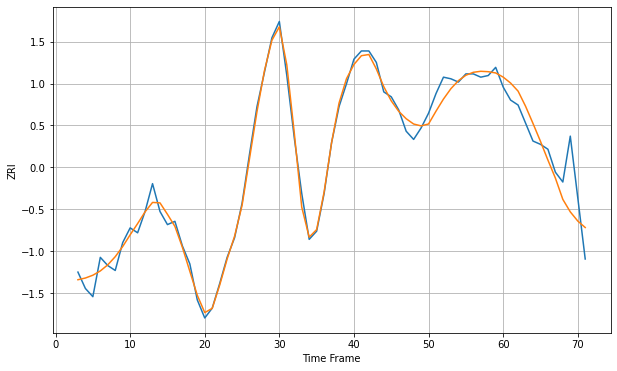

Wall time: 8.31 s
99654 5.063005345085621 16.63861245499401 [1335.04479772 1331.39782996 1326.48074092 1317.27718694 1306.75271813
 1295.83832557 1284.38698921 1273.40582034 1260.39934597 1252.76770545
 1247.18640425 1243.22484675]


In [13]:
score_dict = {"zip":[], "RMSE_train":[], "RMSE_pure":[], "forecast":[]};
with tf.device('/cpu:0'):
    for ZONE in zip_ids:
        %time M_train, M_pure, forecast = NN_test(ZONE, termination=0.01, plot=True);
        print(ZONE, M_train, M_pure, forecast);

        score_dict["zip"].append(ZONE);
        score_dict["RMSE_train"].append(M_train);
        # score_dict["RMSE_test"].append(M_test);
        score_dict["RMSE_pure"].append(M_pure);
        score_dict["forecast"].append(forecast);

In [14]:
print(len(score_dict["RMSE_pure"]),\
      sum(score_dict["RMSE_pure"])/len(score_dict["RMSE_pure"]));

rmse = sum(score_dict["RMSE_pure"])/len(score_dict["RMSE_pure"]);

1301 64.5048135624907


In [15]:
test = pd.DataFrame(score_dict);
test.head()

,zip,RMSE_train,RMSE_pure,forecast
0,1013,7.515020,27.838497,"[1120.5420306633982, 1116.926133292407, 1115.1..."
1,1020,7.105429,32.225288,"[1135.567775834989, 1132.9906941698885, 1132.0..."
2,1040,6.106690,38.877395,"[1112.0164998167058, 1109.80385045384, 1105.89..."
3,1085,7.395466,59.979956,"[1150.4220293740316, 1146.266039219794, 1143.3..."
4,1104,7.605918,56.631651,"[1118.88408753319, 1116.6280669970577, 1111.67..."


In [16]:
test.to_csv('NN_featureonly_window_1_{:.2f}.csv'.format(rmse), index = False)